# Import

In [294]:
import numpy as np
import cmath
import glob2
import re
import os
import shutil
import seaborn as sns
import copy
import csv
import pickle

import time
from time import sleep

import random
from random import choice

import string
from string import ascii_lowercase, digits

import matplotlib as mpl
import matplotlib.pyplot as plt 
from importlib import reload
from matplotlib.collections import LineCollection
from matplotlib import rc 
from matplotlib import ticker
from matplotlib import gridspec
from matplotlib import cm  #colormap
from matplotlib import colors
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)
from matplotlib.patches import Polygon
from matplotlib.patches import Rectangle

%matplotlib inline
#%matplotlib widget

from IPython.display import Markdown as md

import seaborn as sns


import scipy
import scipy.linalg as linalg
from scipy.optimize import curve_fit
from scipy.optimize import minimize
from scipy.ndimage import gaussian_filter,gaussian_filter1d
from scipy.signal import savgol_filter
from scipy.interpolate import interp1d
from scipy.interpolate import interp2d
from scipy.interpolate import splrep
from scipy.interpolate import splev
from scipy.optimize import leastsq
from scipy.signal import find_peaks
from scipy.interpolate import UnivariateSpline


import sklearn
from sklearn.mixture import GaussianMixture
from sklearn import linear_model

import importlib
from importlib import reload

# Specify path to your working folder

In [297]:
path = r'C:\Users\Simon Geisert\Nextcloud2\GFQ_coupler'
url_to_GFQ_folder = path

In [298]:
#------------------------------------------------------------------------------------
# Paths to the qkit and fluxonium classes

import sys 
# for fluxonium
sys.path.append(path + r'\XXX__Python__Side-Packages\fluxonium') 
# for qkit 
sys.path.append(path + r'\XXX__Python__Side-Packages\qkit-master')
# for 4 nodes GFQ 
sys.path.append(path + r'\XXX__Python__Side-Packages\4-nodes-GFQ')


#------------------------------------------------------------------------------------
###qkit
import qkit

from qkit.storage.store import Data
from qkit.analysis.resonator import Resonator
from qkit.analysis.CurveXtractor import CurveXtractor
from qkit.analysis.circle_fit.circle_fit_2019 import circuit
from qkit.analysis.circle_fit.circle_fit_2019.circuit import reflection_port
from qkit.analysis.iq_cloud_analysis import IQCloudAnalysis

#------------------------------------------------------------------------------------
###fluxonium
import source

from source import coupled_fluxonium as CoupFlx
from source import eigenstates_coupled_fluxonium as EgCoupFlx

from source import fluxonium as Flx
from source import fit_fluxonium as FitFlx
from source import eigenstates_fluxonium as EgFlx
from source import special

#------------------------------------------------------------------------------------

###4 nodes GFQ
import source_4erGFQ

from source_4erGFQ import four_nodes_GFQ_with_Rout as fourNdGFQ
from source_4erGFQ import fit__four_nodes_GFQ_with_Rout as fit__fourNdGFQ

##------------------------------------------------------------------------------------
## For measurments with presto import the following classes
##General Presto Class
#from qkit.measure.presto._base import Base
#
## Resonator Sweep
#import qkit.measure.presto.sweep as presto_sweep
##AC Stark
#import qkit.measure.presto.stark_shift as presto_stark_shift
##IQ Clouds
#import qkit.measure.presto.IQ_cloud as presto_IQ_cloud
## Quanutm Jumps
#import qkit.measure.presto.quantum_jumps as presto_quantum_jumps
## Yoko Coil
#import qkit.measure.presto.sweep_coil_yoko as presto_sweep_coil_yoko


##--------------------------------------------------------------------------------------
# To write Plots like latex

# plt.rcParams.update({
#     "font.family":"serif",
#     "font.serif":"Times New Roman",
#     "mathtext.fontset": "stix",
#     "text.usetex": True,
#  })

# ##---------------------------------------------------------------------------------------
# colors

black = '#000000'
white = '#ffffff'

brown = '#947139'
darkgreen = '#6E692A'
green = '#00A76D'
lightgreen ='#A6CE42'

darkblue = '#0071BC'
lightblue = '#00C0F3'

purple='#A066AA'
lightpurple = '#9F184C'
pink = '#F6979F'
red = '#ED1C1A'
orange = '#F7931D'
gold = '#FFCB04'
yellow = '#FFF200'
lightyellow = '#FFFCD5'

darkgrey='#6D6E70'
lightgrey='#9D9FA1'

    
h = 6.62607015*10**(-34)
hbar = h/2/np.pi
kb = 1.380649*10**(-23)
phi_0 = 2.067833848 * 1e-15
el = 1.602176634 *1e-19

# qR7 coupling (with bG1 & qS16)

In [299]:
Qubit_Name = 'qR7'

data_dir = url_to_GFQ_folder
cooldown_dir = '\\CS_BF_TH__2024_03_07__qR7_bG1_qS16__Coupling__Isolation__Paper2'
measurement_dir = '\\Messdaten\\'

In [300]:
TextSize_random_plots = 20

## Readout-Fit from Flux Sweep

In [301]:
measurement_files = '\\S9VKZW_2D_GFQ_qR7_x_FS__fvna_6p39_6p59_GHz__Pvna_m50_dBm__I_m4p0_to_4p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

File=[]
for i in range(0,len(LoadFiles)):
    File.append(LoadFiles[i])
    
    h5 = Data(File[i])
    f_vna = h5.data.frequency[:]
    current = h5.data.current[:]
    phase = h5.data.phase[:]
    amp = h5.data.amplitude[:]

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/3355663590.py:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(current, f_vna*1e-9, phase.T)


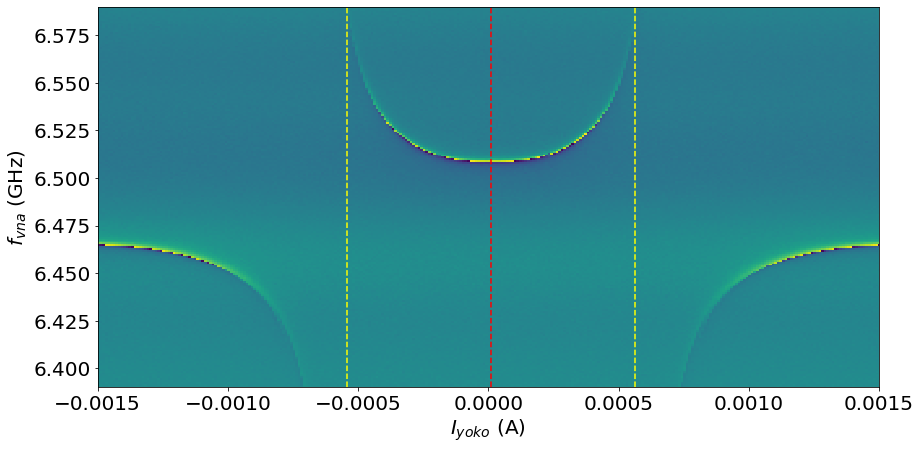

In [302]:
%matplotlib inline
#%matplotlib widget

fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current, f_vna*1e-9, phase.T)

ax.set_xlim([-0.0015,0.0015])

ax.axvline(x=-0.000541,color='yellow',ls='--')
ax.axvline(x=0.000565,color='yellow',ls='--')
ax.axvline(x=1.12*1e-5,color='red',ls='--')

ax.set_xlabel(r'$I_{yoko}$ (A)', fontsize=TextSize_random_plots)
ax.set_ylabel(r'$f_{vna}$ (GHz)', fontsize=TextSize_random_plots)
ax.tick_params(axis='both', which='major', labelsize=TextSize_random_plots)

plt.show()

In [303]:
def cost_function(x,amp,phase):
    imag = x[0]
    real = x[1]
    return np.abs((np.sqrt(real**2+imag**2)-amp))*10 + np.abs(np.arctan2(imag,real)-phase)*10


def FKT__find_nearest_index(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx

idx = FKT__find_nearest_index(current, 1.12*1e-5)

phase_at_idx = phase[idx,:]
amp_at_idx = amp[idx,:]

In [304]:
minimize__max_iterations = 2000
minimize_tolerance = 1e-4 #Absolute error in xopt between iterations that is acceptable for convergence.

Sij=np.zeros(len(amp_at_idx)).astype(complex)

for i in range(0,len(phase_at_idx)):
    
    x0=[0.6,0.6]
    bounds=((-3,3),(-3,3))
    res = minimize(cost_function,x0,args=(amp_at_idx[i],phase_at_idx[i]),
                   bounds = bounds, method = 'Nelder-Mead',
                   options={'maxiter':minimize__max_iterations, 'xatol':minimize_tolerance})
  
    imag = res.x[0]
    real = res.x[1]
    Sij[i] = real + 1j * imag
    
    print('')
    print('')
#    print('Sij',Sij[i], real, np.real(Sij[i]), imag, np.imag(Sij[i]))
#    print('amp',np.sqrt(real**2+imag**2), np.sqrt(np.real(Sij[i])**2+np.imag(Sij[i])**2),amp_at_idx[i])
#    print('Hallo',res.x)
    print('')
    print('')

    
reSij = np.real(Sij)
imSij = np.imag(Sij) 
absSij = np.sqrt(reSij**2+imSij**2)
absSij_dB = 20*np.log10(absSij)
argSij = np.arctan2(imSij,reSij)

print('')    
print('fertig')  


































































































































































































































































































































































































































































































































































































































































































































































































































fertig


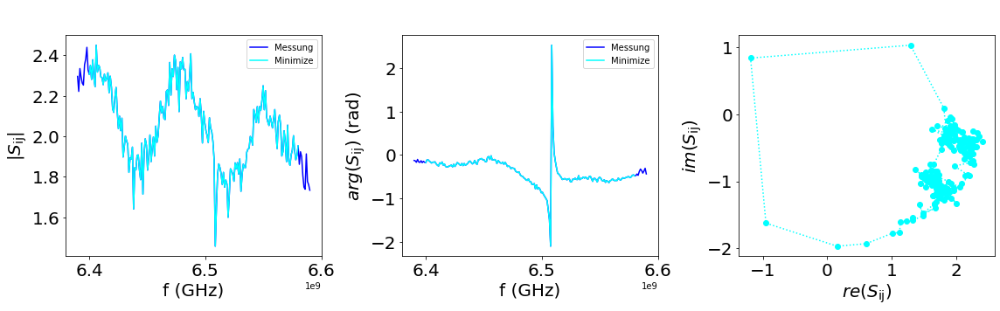

In [305]:
fig,ax = plt.subplots(1,3,figsize = (16,5))
fig.suptitle('   ', fontsize=20, ha='left',x=0.05)

b=10
t=-10
ax[0].plot(f_vna, amp_at_idx, color='blue', label='Messung')
ax[0].plot(f_vna[b:t], absSij[b:t], color='cyan', label='Minimize')
ax[0].set_xlabel(r'f (GHz)', fontsize=TextSize_random_plots)
ax[0].set_ylabel(r'$|S_{\rm ij}|$', fontsize=TextSize_random_plots)
ax[0].tick_params(axis='both', which='major', labelsize=TextSize_random_plots)
ax[0].legend()
    
ax[1].plot(f_vna, phase_at_idx, color='blue', label='Messung')
ax[1].plot(f_vna[b:t], argSij[b:t] , color='cyan', label='Minimize')
ax[1].set_xlabel(r'f (GHz)', fontsize=TextSize_random_plots)
ax[1].set_ylabel(r'$arg(S_{\rm ij})$ (rad)', fontsize=TextSize_random_plots)
ax[1].tick_params(axis='both', which='major', labelsize=TextSize_random_plots)
ax[1].legend()
    
ax[2].plot(reSij[b:t], imSij[b:t],ls=':',marker='o', color='cyan')
ax[2].set_xlabel(r'$re(S_{\rm ij})$', fontsize=TextSize_random_plots)
ax[2].set_ylabel(r'$im(S_{\rm ij})$', fontsize=TextSize_random_plots)
ax[2].tick_params(axis='both', which='major', labelsize=TextSize_random_plots)

plt.tight_layout()
plt.show()

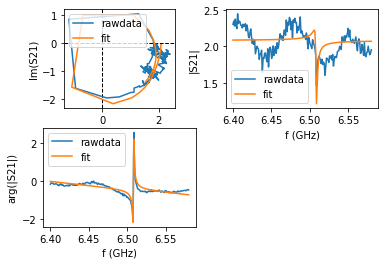



{'delay': 6.56464218886717e-10, 'delay_remaining': -1.1735607988162304e-10, 'a': 2.0806468586646774, 'alpha': 1.2472717732214105, 'theta': -1.7038078839194497, 'phi': 0.19051299644893271, 'fr': 6508169495.808891, 'Ql': 2978.0350827369057, 'Qc': 3681.68186508656, 'Qc_no_dia_corr': 3615.0700123034976, 'Qi': 15581.934050905293, 'Qi_no_dia_corr': 16899.866590540794, 'fr_err': 179864.97439838416, 'Ql_err': 608.9758917898263, 'absQc_err': 343.96887095416673, 'phi_err': 0.1413455353095596, 'Qi_err': 14525.87949330646, 'Qi_no_dia_corr_err': 16340.147204685472, 'chi_square': 0.024481011159120776}

fr_q1_mean= 6.508 GHz
Df_q1_mean= 2.185 MHz


In [306]:
fit = reflection_port(f_data = f_vna[b:t], z_data_raw = Sij[b:t])
fit.autofit()
    
fr_q1 = fit.fitresults['fr']
Qi_q1 = fit.fitresults['Qi']
Qc_q1 = fit.fitresults['Qc']
Ql_q1 = fit.fitresults['Ql']

fit.plotall()

print('')
print('')
print(fit.fitresults)
print('')
Df_q1 = fr_q1/Ql_q1
Df_q1_mean = np.mean(Df_q1)
fr_q1_mean = np.mean(fr_q1)
print('fr_q1_mean= {} GHz'.format(np.round(fr_q1_mean*1e-9,3)))
print('Df_q1_mean= {} MHz'.format(np.round(Df_q1_mean*1e-6,3)))

## Flux-Sweep

### coil1: Rough

In [307]:
measurement_files = '\\S9VKZW_2D_GFQ_qR7_x_FS__fvna_6p39_6p59_GHz__Pvna_m50_dBm__I_m4p0_to_4p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs_rough = h5.data.frequency[:]
    current__fs_rough = h5.data.current[:]
    phase__fs_rough = h5.data.phase[:]
    amp__fs_rough = h5.data.amplitude[:]
    

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/4289846256.py:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(current__fs_rough, f_vna__fs_rough*1e-9, phase__fs_rough.T)


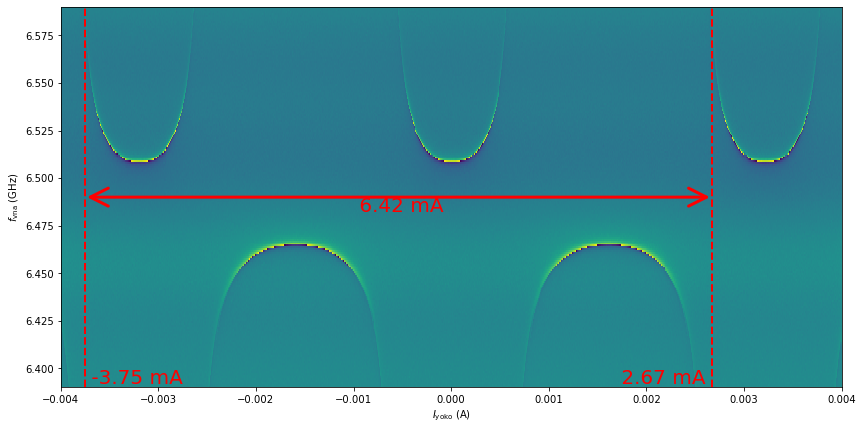

I0__q1 = 3.21 mA


In [308]:
#%matplotlib widget
%matplotlib inline


fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current__fs_rough, f_vna__fs_rough*1e-9, phase__fs_rough.T)

I_ss_low__fs = -0.00375
ax.axvline(x=I_ss_low__fs,color='red',ls='--',lw=2)
ax.text(s=' {} mA'.format(round(I_ss_low__fs*1e3,3)), x=I_ss_low__fs, y=ax.get_ylim()[0], ha='left', va='bottom', color ='red',
        size=20)

I_ss_up__fs = 0.00267
ax.axvline(x=I_ss_up__fs,color='red',ls='--',lw=2)
ax.text(s=' {} mA '.format(round(I_ss_up__fs*1e3,3)), x=I_ss_up__fs, y=ax.get_ylim()[0], ha='right', va='bottom', color ='red',
        size=20)

Anzahl_Perioden = 2
I0_q1 = (I_ss_up__fs - I_ss_low__fs)/Anzahl_Perioden


ax.annotate(xy=(I_ss_low__fs,np.mean(ax.get_ylim())),xytext=(I_ss_up__fs,np.mean(ax.get_ylim())), text='', arrowprops=dict(arrowstyle='<->,head_length=1.8,head_width=0.9',
                                        lw=3,color='red'))
ax.text(s=' {} mA'.format(round(I0_q1*1e3*Anzahl_Perioden,5)), x=I_ss_low__fs+I0_q1/2*Anzahl_Perioden, y=np.mean(ax.get_ylim()), ha='center', va='top', color ='red',
        size=20)

#ax.set_xlim([0,0.34*1e-3])

ax.set_xlabel(r'$I_{\rm yoko}$ (A)')
ax.set_ylabel(r'$f_{\rm vna}$ (GHz)')
plt.show()

print('I0__q1 = {} mA'.format(I0_q1*1e3))

In [310]:
with open('f_vna__fs_rough_q1_coil1.pkl', 'wb') as f:
    pickle.dump(f_vna__fs_rough , f)  
with open('current__fs_rough_q1_coil1.pkl', 'wb') as f:
    pickle.dump(current__fs_rough , f)
with open('phase__fs_rough_q1_coil1.pkl', 'wb') as f:
    pickle.dump(phase__fs_rough, f)

### coil1: Fine

In [ ]:
#data_dir = 'C:\\Users\\soere\\Soeren\\GFQ\\Messungen'
#cooldown_dir = '\\CS_BF_TH__2023-02-08_*'
#measurement_dir = '\\Messdaten\\qO19'

measurement_files = '\\S9VKZW_2D_GFQ_qR7_x_FS__fvna_6p39_6p59_GHz__Pvna_m50_dBm__I_m4p0_to_4p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

f_vna__fs, current__fs, phase__fs, amp__fs = [],[],[],[]
for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs.append(h5.data.frequency[:])
    current__fs.append(h5.data.current[:])
    phase__fs.append(h5.data.phase[:])
    amp__fs.append(h5.data.amplitude[:])

#### Extract Points

In [ ]:
Extract_Points = False
kk = 0

In [ ]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(current__fs[kk],f_vna__fs[kk], phase__fs[kk].T)

    xtract.set_points()

In [ ]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)

    
else:
    
    x0__fs = [-0.0015876323528052892,-0.001429147386547302,-0.001259342065556601,-0.001112177454031327,-0.0010216146161696202,-0.0009310517783079125,-0.0008857703593770595,-0.0008518092951789189,-0.000806527876248065,-0.0007725668120499261,-0.0007499261025844988,-0.0007386057478517855,-0.0007159650383863582]
    y0__fs = [6464826564.680261,6463971887.886173,6461835195.900952,6457134473.533468,6451579074.371895,6445596336.813278,6439186260.857617,6431921508.107868,6425511432.152207,6418246679.402458,6411836603.446797,6404571850.697048,6395597744.359123]
    
    x1__fs = [-0.0005348393626629444,-0.0005235190079302312,-0.0005008782984648047,-0.00047823758899937733,-0.0004669172342666641,-0.0004442765248012367,-0.00041031546060309784,-0.00033107297747410336,-0.00021786943014696913,-0.00010466588281983578,-2.7826902254156696e-06,0.0001217412118344318,0.00023494475916156516,0.00033682795175598614,0.00039342972541955325,0.0004387111443504071,0.0004839925632812601,0.0005179536274794007,0.0005405943369448272,0.0005519146916775405,0.0005632350464102546]
    y1__fs = [6584481315.852598,6574652532.720585,6564823749.588572,6555849643.250646,6547730213.706809,6539183445.765927,6529782001.030958,6520380556.295989,6512688465.149196,6507987742.781711,6507560404.384667,6509269757.972843,6512261126.7521515,6519098541.1048565,6526363293.854606,6534482723.398443,6543884168.133412,6552858274.471337,6562259719.206306,6570806487.147188,6582771962.264421]

    x2__fs = [0.0007217200126682409,0.0007556810768663816,0.000778321786331808,0.0008462439147280884,0.0009028456883916555,0.0009594474620552218,0.0010952917188477825,0.0012650970398384838,0.0014349023608291843,0.0016386687460180254]
    y2__fs = [6392179037.182771,6402862497.108872,6414400633.8290615,6427648124.137427,6438758922.460573,6447733028.798498,6455852458.342336,6462262534.2979965,6463971887.886173,6464826564.680261] 

   
x__q1_fs = [x0__fs, x1__fs, x2__fs]
y__q1_fs = [y0__fs, y1__fs, y2__fs]


for i in range (0,len(x__q1_fs)):
    x__q1_fs[i] = np.array(x__q1_fs[i])
    y__q1_fs[i] = np.array(y__q1_fs[i])
    idx_sort = np.argsort(x__q1_fs[i])
    x__q1_fs[i] = x__q1_fs[i][idx_sort]
    y__q1_fs[i] = y__q1_fs[i][idx_sort]

#### Plot

In [ ]:
#%matplotlib widget
%matplotlib inline

fig, ax = plt.subplots(1,1, figsize = (14,7))

kk = 0
ax.pcolor(current__fs[kk], f_vna__fs[kk], phase__fs[kk].T,shading='auto')


if True:
    I_ss__q1_fs = 1.12*1e-5
    ax.axvline(x=I_ss__q1_fs,ls='--',color='red')
    ax.text(s=' {} mA'.format(round(I_ss__q1_fs*1e3,5)),x=I_ss__q1_fs, y=ax.get_ylim()[0], ha='left', va='bottom', size=20,color='red')
    print('I_ss__q1_fs= {} mA'.format(round(I_ss__q1_fs*1e3,5)))
    
    ax.axvline(x=-0.000541, ls='--', color='blue')
    ax.axvline(x=0.000565, ls='--', color='blue')    
    #print((-0.000541+0.000565)/2)

ax.set_xlim([-0.002,0.002])
if True:
    fr_ss__q1=6.5086*1e9
    ax.axhline(y=fr_ss__q1, ls='--', color='red')
    ax.text(s=' {} GHz'.format(round(fr_ss__q1*1e-9,5)),x=ax.get_xlim()[0],y=fr_ss__q1, ha='left', va='bottom', size=20,color='red')
    print('fr_ss__q1= {} GHz'.format(round(fr_ss__q1*1e-9,5)))

for i in range(0,len(x__q1_fs)):
    ax.plot(x__q1_fs[i], y__q1_fs[i], marker='x',color='red',ls='')

ax.set_xlabel('Current (A)')
ax.set_ylabel('Frequency (Hz)')


fig.tight_layout()
plt.show()

In [ ]:
with open('f_vna__fs_q1_coil1.pkl', 'wb') as f:
    pickle.dump(f_vna__fs, f)  
with open('current__fs_q1_coil1.pkl', 'wb') as f:
    pickle.dump(current__fs, f)
with open('phase__fs_q1_coil1.pkl', 'wb') as f:
    pickle.dump(phase__fs, f)
with open('current__fres_q1_coil1', 'wb') as f:
    pickle.dump(x__q1_fs, f)
with open('fres__fres_q1_coil1.pkl', 'wb') as f:
    pickle.dump(y__q1_fs, f)

In [ ]:
phi__fs, x_phi__q1_fs = [],[]
for i in range (0,len(x__q1_fs)):    
    x_phi__q1_fs.append((x__q1_fs[i] - I_ss__q1_fs + I0_q1/2  ) /I0_q1)
    
for i in range (0,len(current__fs)): 
    phi__fs.append((current__fs[i] - I_ss__q1_fs + I0_q1/2  ) /I0_q1)

In [ ]:
%matplotlib inline
fig, ax = plt.subplots(1,1, figsize = (10,5))


ax.pcolor(phi__fs[kk], f_vna__fs[kk], phase__fs[kk].T,shading='auto',vmin=-np.pi,vmax=np.pi)


#ax.axvline(x=I_low_mean, ls='--',color='blue',lw=1)
#ax.axvline(x=I_high_mean, ls='--',color='blue',lw=1)

phi_0p5 = 0.5
ax.axvline(x=phi_0p5,ls='--',color='red')
print('I_ss__q1_fs= {} mA'.format(round(I_ss__q1_fs*1e3,7)))


ax.set_xlim([0,1])
ax.axhline(y=fr_ss__q1, ls='--', color='red')
ax.text(s=' {} GHz'.format(round(fr_ss__q1*1e-9,2)),x=ax.get_xlim()[0],y=fr_ss__q1, ha='left', va='bottom', size=20,color='red')
print('fr_ss__q1= {} GHz'.format(round(fr_ss__q1*1e-9,5)))

for i in range(0,len(x__q1_fs)):
    ax.plot(x_phi__q1_fs[i], y__q1_fs[i], marker='x',color='red',ls='')

ax.set_xlabel(r'$\Phi_{\rm ext}$ ($\Phi_0$)')
ax.set_ylabel('Frequency (Hz)')


fig.tight_layout()
plt.show()

In [ ]:
print(x_phi__q1_fs[0][-1],y__q1_fs[0][-1])
print(x_phi__q1_fs[1][0],y__q1_fs[1][0])
print(x_phi__q1_fs[1][-1],y__q1_fs[1][-1])
print(x_phi__q1_fs[2][0],y__q1_fs[2][0])

### coil2

In [ ]:
measurement_files = '\\S9VMFZ_2D_GFQ_qR7_x_FS__fvna_6p39_6p59_GHz__Pvna_m50_dBm__I_40p0_to_m40p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs = h5.data.frequency[:]
    current__fs = h5.data.current[:]
    phase__fs = h5.data.phase[:]
    amp__fs = h5.data.amplitude[:]

In [ ]:
#%matplotlib widget
%matplotlib inline


fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current__fs, f_vna__fs*1e-9, phase__fs.T)

ax.set_xlabel(r'$I_{\rm yoko}$ (A)')
ax.set_ylabel(r'$f_{\rm vna}$ (GHz)')
plt.show()

with open('f_vna__fs_q1_coil2.pkl', 'wb') as f:
    pickle.dump(f_vna__fs, f)  
with open('current__fs_q1_coil2.pkl', 'wb') as f:
    pickle.dump(current__fs, f)
with open('phase__fs_q1_coil2.pkl', 'wb') as f:
    pickle.dump(phase__fs, f)

### coil3

In [ ]:
measurement_files = '\\S9VMYW_2D_GFQ_qR7_x_FS__fvna_6p39_6p59_GHz__Pvna_m50_dBm__I_m110p0_to_110p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs = h5.data.frequency[:]
    current__fs = h5.data.current[:]
    phase__fs = h5.data.phase[:]
    amp__fs = h5.data.amplitude[:]
    
with open('f_vna__fs_q1_coil3.pkl', 'wb') as f:
    pickle.dump(f_vna__fs, f)  
with open('current__fs_q1_coil3.pkl', 'wb') as f:
    pickle.dump(current__fs, f)
with open('phase__fs_q1_coil3.pkl', 'wb') as f:
    pickle.dump(phase__fs, f)

In [ ]:
#%matplotlib widget
%matplotlib inline


fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current__fs, f_vna__fs, phase__fs.T)

ax.set_xlabel(r'$I_{\rm yoko}$ (A)')
ax.set_ylabel(r'$f_{\rm vna}$ (GHz)')
plt.show()

## Two Tone

### Lower SS

In [52]:
#data_dir = 'C:\\Users\\soere\\Soeren\\GFQ\\Messungen'
#cooldown_dir = '\\CS_BF_TH__2023-02-08_*'
#measurement_dir = '\\Messdaten\\qO19'

measurement_files = 'S9VO7I_3D_GFQ_qR7_x_TT_FS__Iy_m0p12_0p1mA__fmw_3p65_4p0GHz__Pvna_m50p0dBm__Pmw_m20p0dBm.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

f_mw__tt,current__tt,phase__tt,amp__tt=[],[],[],[]
for File in LoadFiles:
    
    h5 = Data(File)  
    
    f_mw__tt.append(h5.data.mw_freq[:])
    current__tt.append(h5.data.current[:])
    phase__tt.append(h5.data.phase[:])
    amp__tt.append(h5.data.amplitude[:])    

#### Extract Points

In [53]:
Extract_Points = False
kk = 0

In [54]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(current__tt[kk],f_mw__tt[kk], phase__tt[kk][:,:,1].T)

    xtract.set_points()

In [55]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)
    
    
else:
    
    x0__tt = np.array([-1.10818058e-04,-1.00742391e-04,-9.06667241e-05,-8.10291295e-05,-7.09534625e-05,-6.04397229e-05,-5.03640559e-05,-4.02883888e-05,-3.06507942e-05,-2.01370547e-05,-9.62331513e-06,-8.61865507e-07,9.65187404e-06,1.57848888e-05,2.45463384e-05,3.50600779e-05,4.46976725e-05,5.43352671e-05,6.39728617e-05,7.49246737e-05,8.45622683e-05,9.46379354e-05])
    y0__tt = np.array([3.97667535e+09,3.93422686e+09,3.89286679e+09,3.85368357e+09,3.82429615e+09,3.79490874e+09,3.76769816e+09,3.74592971e+09,3.72851494e+09,3.71327702e+09,3.70348122e+09,3.69695068e+09,3.69259699e+09,3.69150856e+09,3.69368541e+09,3.70456964e+09,3.71654229e+09,3.73178021e+09,3.75137182e+09,3.77205186e+09,3.79599716e+09,3.82429615e+09])
    
x__q1_tt_low = [x0__tt]
y__q1_tt_low = [y0__tt] 


In [59]:
with open('x__q1_tt_low_q1.pkl', 'wb') as f:
    pickle.dump(x__q1_tt_low , f)
with open('y__q1_tt_low_q1.pkl', 'wb') as f:
    pickle.dump(y__q1_tt_low , f)

#### Plot

I_ss__q1_tt_low= 0.0112 mA


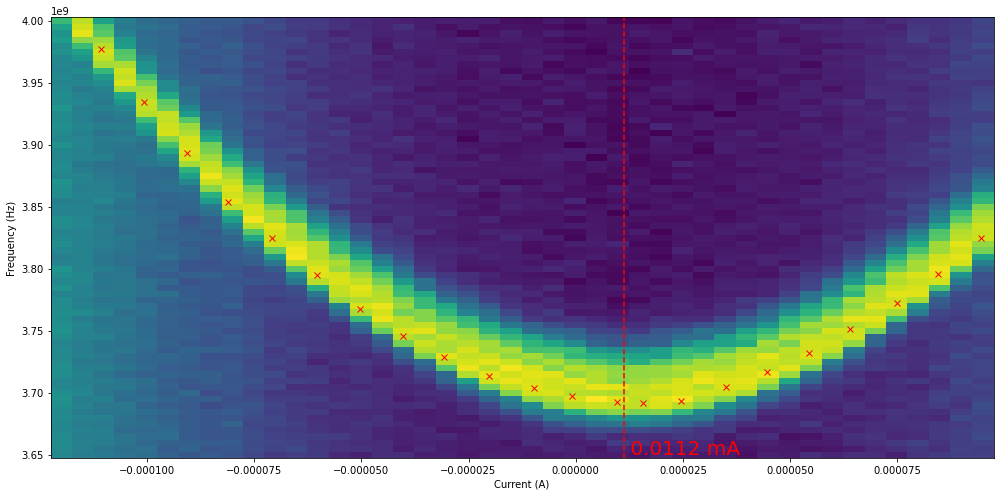

In [60]:
#%matplotlib widget
%matplotlib inline

fig, ax = plt.subplots(1,1, figsize = (14,7))

kk = 0
ax.pcolor(current__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,0].T,shading='auto')
#for kk in range(0,len(LoadFiles)):
#    ax.pcolor(current__q1_tt[kk], f_mw__q1_tt[kk], phase__q1_tt[kk][:,:,1].T,shading='auto')

I_ss__q1_tt_low = 1.12*1e-5

    
ax.axvline(x=I_ss__q1_tt_low,ls='--',color='red')
ax.text(s=' {} mA'.format(round(I_ss__q1_tt_low*1e3,5)),x=I_ss__q1_tt_low, y=ax.get_ylim()[0], ha='left', va='bottom', size=20,color='red')
print('I_ss__q1_tt_low= {} mA'.format(round(I_ss__q1_tt_low*1e3,5)))


ax.plot(x__q1_tt_low[kk], y__q1_tt_low[kk], marker='x',color='red',ls='')
#for kk in range(0,len(x__tt)):
#    if kk==0: ax.plot(x__tt[kk], y__tt[kk], marker='x',color='red',ls='')

ax.set_xlabel('Current (A)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()

In [61]:
phi__tt, x_phi__q1_tt_low = [],[]
for i in range (0,len(x__q1_tt_low)):    
    x_phi__q1_tt_low.append((x__q1_tt_low[i] - I_ss__q1_tt_low + I0_q1/2  ) /I0_q1)
    
for i in range (0,len(LoadFiles)): 
    phi__tt.append((current__tt[i] - I_ss__q1_tt_low + I0_q1/2  ) /I0_q1)

I_ss__q1_tt_low= 0.0112 mA


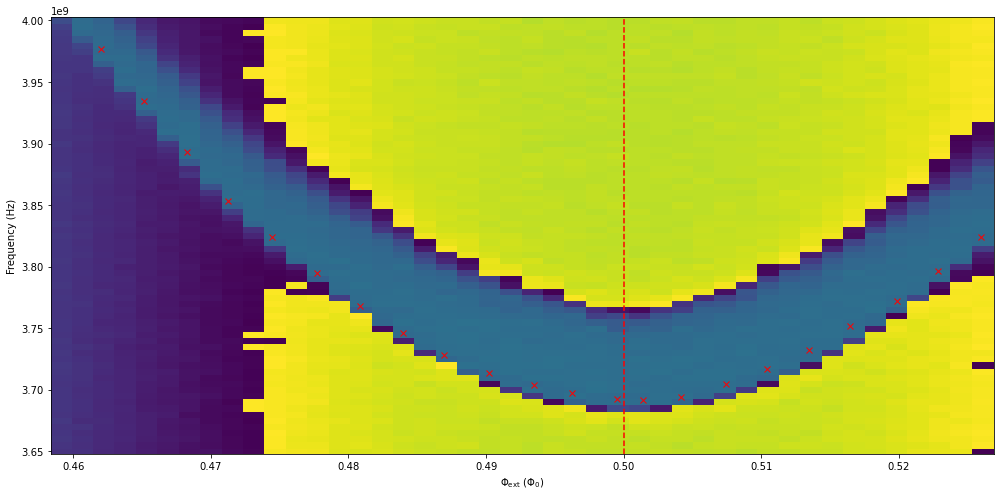

In [62]:
fig, ax = plt.subplots(1,1, figsize = (14,7))

#kk = 0
#ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')
for kk in range(0,len(LoadFiles)):
    ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')

phi_0p5 = 0.5
ax.axvline(x=phi_0p5,ls='--',color='red')
print('I_ss__q1_tt_low= {} mA'.format(round(I_ss__q1_tt_low*1e3,5)))


for i in range(0,len(x__q1_tt_low)):
    ax.plot(x_phi__q1_tt_low[i], y__q1_tt_low[i], marker='x',color='red',ls='')

ax.set_xlabel(r'$\Phi_{\rm ext}$ ($\Phi_0$)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()

### Upper SS

In [63]:
#data_dir = 'C:\\Users\\soere\\Soeren\\GFQ\\Messungen'
#cooldown_dir = '\\CS_BF_TH__2023-02-08_*'
#measurement_dir = '\\Messdaten\\qO19'

measurement_files = 'S9VOD1_3D_GFQ_qR7_x_TT_FS__Iy_m2p013_m1p413mA__fmw_7p65_7p85GHz__Pvna_m60p0dBm__Pmw_m20p0dBm.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

f_mw__tt,current__tt,phase__tt,amp__tt=[],[],[],[]
for File in LoadFiles:
    
    h5 = Data(File)  
    
    f_mw__tt.append(h5.data.mw_freq[:])
    current__tt.append(h5.data.current[:])
    phase__tt.append(h5.data.phase[:])
    amp__tt.append(h5.data.amplitude[:])

#### Extract Points

In [64]:
Extract_Points = False
kk = 0

In [65]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(current__tt[kk],f_mw__tt[kk], phase__tt[kk][:,:,1].T)

    xtract.set_points()

In [66]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)
    
    
else:
    
    x0__tt = np.array([-0.0019702,-0.00195467,-0.00193316,-0.00190807,-0.00187701,-0.00184953,-0.00181249,-0.00177307,-0.0017432,-0.00170616,-0.00166434,-0.00161775,-0.0015831,-0.00154248,-0.00150783,-0.0014708,-0.00144332,-0.00142301])
    y0__tt = np.array([7.65157494e+09,7.66603104e+09,7.68425829e+09,7.70437112e+09,7.72825510e+09,7.74711088e+09,7.76848076e+09,7.78607948e+09,7.79739295e+09,7.80870641e+09,7.81750578e+09,7.82567661e+09,7.82756219e+09,7.82504809e+09,7.81939135e+09,7.80933494e+09,7.79802147e+09,7.78859359e+09])
    
x__q1_tt_up = [x0__tt]
y__q1_tt_up = [y0__tt] 


In [67]:
with open('x__q1_tt_up_q1.pkl', 'wb') as f:
    pickle.dump(x0__tt , f)
with open('y__q1_tt_up_q1.pkl', 'wb') as f:
    pickle.dump(y0__tt , f)

#### Plot

I_ss__q1_tt_up= -1.5938 mA


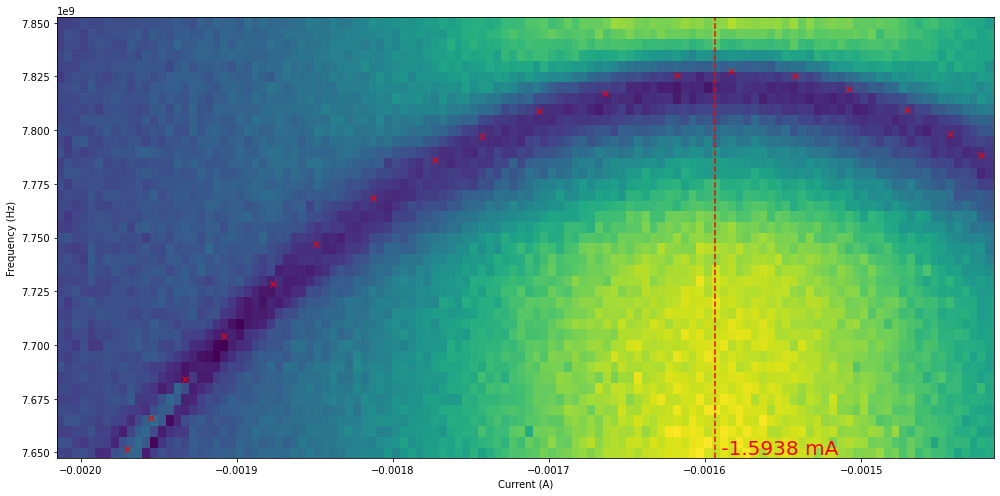

In [71]:
#%matplotlib widget
%matplotlib inline


fig, ax = plt.subplots(1,1, figsize = (14,7))

kk = 0
ax.pcolor(current__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,2].T,shading='auto')
#for kk in range(0,len(LoadFiles)):
#    ax.pcolor(current__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')

I_ss__q1_tt_up = I_ss__q1_tt_low-I0_q1/2

    
ax.axvline(x=I_ss__q1_tt_up,ls='--',color='red')
ax.text(s=' {} mA'.format(round(I_ss__q1_tt_up*1e3,5)),x=I_ss__q1_tt_up, y=ax.get_ylim()[0], ha='left', va='bottom', size=20,color='red')
print('I_ss__q1_tt_up= {} mA'.format(round(I_ss__q1_tt_up*1e3,5)))


ax.plot(x__q1_tt_up[kk], y__q1_tt_up[kk], marker='x',color='red',ls='')
#for kk in range(0,len(x__tt)):
#    if kk==0: ax.plot(x__tt[kk], y__tt[kk], marker='x',color='red',ls='')

ax.set_xlabel('Current (A)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()

In [72]:
phi__tt, x_phi__q1_tt_up = [],[]
for i in range (0,len(x__q1_tt_up)):    
    x_phi__q1_tt_up.append((x__q1_tt_up[i] - I_ss__q1_tt_low + I0_q1/2  ) /I0_q1)
    
for i in range (0,len(LoadFiles)): 
    phi__tt.append((current__tt[i] - I_ss__q1_tt_low + I0_q1/2  ) /I0_q1)

I_ss__q1_tt_up= -1.5938 mA


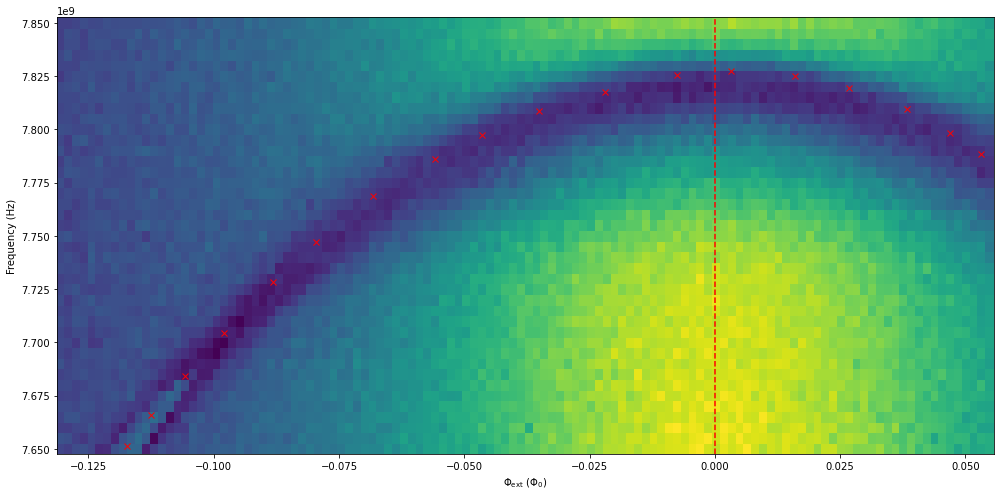

In [74]:
fig, ax = plt.subplots(1,1, figsize = (14,7))

#kk = 0
#ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')
for kk in range(0,len(LoadFiles)):
    ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,2].T,shading='auto')

phi_0p0 = 0
ax.axvline(x=phi_0p0,ls='--',color='red')
print('I_ss__q1_tt_up= {} mA'.format(round(I_ss__q1_tt_up*1e3,5)))


for i in range(0,len(x__q1_tt_up)):
    ax.plot(x_phi__q1_tt_up[i], y__q1_tt_up[i], marker='x',color='red',ls='')

ax.set_xlabel(r'$\Phi_{\rm ext}$ ($\Phi_0$)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()

### Fit spectrum on ordered points

In [75]:
#x_all_phi__tt = np.append(x_phi__tt,np.array([0.28707099272675674,0.33447585557180204,0.6694480678395299,0.7147010410494198]))
#y_all__tt = np.append(y__tt,np.array([6570924793.458997,6667462297.093502,6666352022.900062,6570498121.105631]))

x_all_phi__q1_tt = np.append(x_phi__q1_tt_low[0],x_phi__q1_tt_up[0])
y_all__q1_tt = np.append(y__q1_tt_low[0],y__q1_tt_up[0])


In [76]:
plt.figure(figsize=(16,2))

plt.plot(x_all_phi__q1_tt, y_all__q1_tt, ls='', marker='o', ms=1, color=orange)
plt.axvline(x=0.5,color='green',ls='--')
plt.show()

NameError: name 'orange' is not defined

<Figure size 1152x144 with 0 Axes>

In [44]:
if False:
    Lq = 20e-9
    Cq = 15e-15
    Ej = 15  # in GHz, Ej = Phi_0 * Ic/ (2 * pi)
    N = 40

    # Fit nur an 1erstes Level
    X = [x_all_phi__q1_tt]
    Y = [y_all__q1_tt]
    # Fit mit 1ersten und 2ten level
    #X = [X01, X02]
    #Y = [Y01, Y02]

    flux = [[] for i in range (0,len(X))] 
    fmw = [[] for i in range (0,len(Y))] 
    
    for ii in range(0,len(X)):
        X_fit,Y_fit=[],[]
        for jj in range(0,len(X[ii])):
            if True:
                X_fit.append(X[ii])
                Y_fit.append(Y[ii])

        X_fit = np.array(X_fit) 
        Y_fit = np.array(Y_fit)  

        flux[ii] = X_fit*2*np.pi
        fmw[ii] = Y_fit*1e-9

    g = [np.zeros((len(flux[i]), 3)) for i in range (0,len(X))]

    for ii in range(0,len(g)):
        g[ii][:, 0] = flux[0][ii]
        g[ii][:, 1] = fmw[0][ii]
        g[ii][:, 2] = ii+1

    measured_data = g[0]
    for ii in range(0,len(g)-1):
        measured_data = np.vstack((measured_data, g[ii+1]))
        
    fit = FitFlx.FitFluxonium()
    fit.set_initial_value(data=measured_data, L=Lq, C=Cq, Ej=Ej, N=N)
    fit.fit(max_nfev = 20)
    
    #----------------------------------------------------------    
    
    fig = plt.figure(figsize=(4, 4))
    ax = fig.add_subplot(111)

    fit.set_figure(fig, ax)
    fit.plot_fit()
    #fit.ax.set_xlim([1.5, 4.5])
    #fit.ax.set_ylim([0, 25])
    fit.ax.set_ylabel('E/h (GHz)')
    fit.ax.set_xlabel(r'$\phi_{\rm ext}$   $(2\pi \cdot \Phi_0)$')
    plt.show()  

    #------------------

    fig = plt.figure(figsize=(4, 4))
    ax = fig.add_subplot(111)
    fit.set_figure(fig, ax)
    fit.plot_fit()
    fit.ax.set_xlim([0.45*2*np.pi,0.55*2*np.pi])
    fit.ax.set_ylim([3.5,4.2])
    fit.ax.set_ylabel('E/h (GHz)')
    fit.ax.set_xlabel(r'$\phi_{\rm ext}$   $(2\pi \cdot \Phi_0)$')

#    ax.plot(x_phi__tt *2*np.pi, y__tt,ls='',marker='x',color='magenta',ms=5)

    #-------------------------------------------------

    fq_fit = np.amin(fit.E_fit)
    print('fq= {} GHz'.format(fq_fit))

In [77]:
Lq_q1_fit= 22.063096581710578 #nH
Cq_q1_fit= 32.151811586602655 #fF
Ej_q1_fit= 6.187249025439222 #GHz

fq_q1_fit = 3.6993596732583507  #GHz

## Measurement: Dispersive Shift

In [78]:
iqcloud = qkit.analysis.iq_cloud_analysis.IQCloudAnalysis()
iqcloud.set_up_gaussian_mixture_model(n_states=2) # , covariance_type='full')

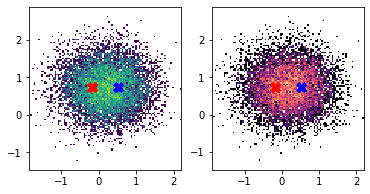

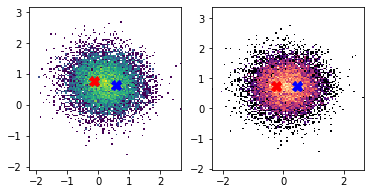

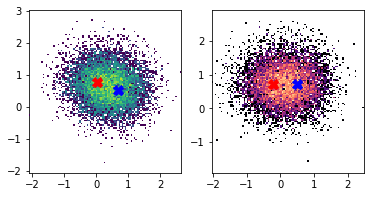

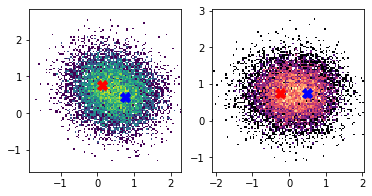

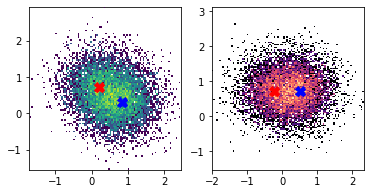

...

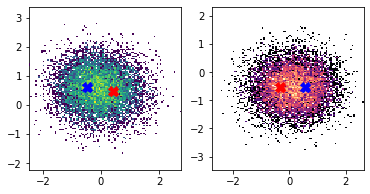

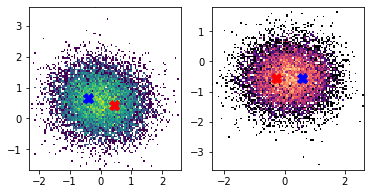

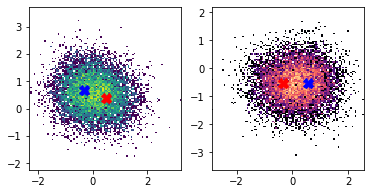

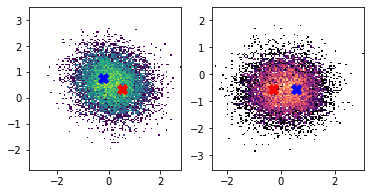

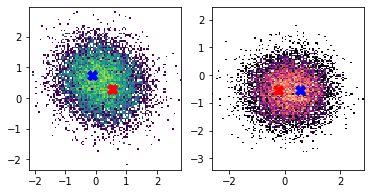

In [79]:
measurement_files = 'Q1_chi_SS_fine\\*\\*.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

#print(LoadFiles)

fr1 = 6.509 *1e9
fr1_IF = 25.0e6
f_vec_q1 = fr1 - fr1_IF + np.arange(23.25e6, 26.5e6, 0.05e6)

number_of_points = 10000
I_q1, Q_q1 = [np.empty((len(LoadFiles),number_of_points)) for ii in range(0,2)]

S_q1, S_q1_rot = [np.empty((len(LoadFiles),number_of_points)).astype(complex) for ii in range(0,2)]

ref_pos_q1, ref_pos_q1_rot = [np.empty((len(LoadFiles),2)).astype(complex) for ii in range(0,2)]

Angle, Angle_rot = [np.empty((len(LoadFiles),2)) for ii in range(0,2)]


#weights_q1, ref_covar_q1 = [np.empty((len(LoadFiles),2)) for ii in range(0,2)]
#S_vec_q1 = np.empty((len(LoadFiles),2)).astype(complex)
#Winkel_vec_q1 = np.empty((len(LoadFiles),2))

dist_avg_q1, theta_q1 = [np.empty(len(LoadFiles)) for ii in range(0,2)]

for ii,File in enumerate(LoadFiles):
    
    h5 = Data(File)
    
    I_q1[ii] = h5.data.i[:]
    Q_q1[ii] = h5.data.q[:]
     
    iqcloud = qkit.analysis.iq_cloud_analysis.IQCloudAnalysis()
    iqcloud.set_up_gaussian_mixture_model(n_states=2)
    iqcloud.analyse_qubit_clouds(I_q1[ii], Q_q1[ii], fq=fq_q1_fit)

#    weights_q1[ii] = iqcloud.weights  
#    ref_covar_q1[ii] = iqcloud.covariances[0]

    dist_avg_q1[ii] = iqcloud.dist_avg
    theta_q1[ii] = iqcloud.theta

    ref_pos_q1[ii] = np.array([iqcloud.positions[0,0,0]+1j*iqcloud.positions[0,0,1],iqcloud.positions[0,1,0]+1j*iqcloud.positions[0,1,1]])
    ref_pos_q1_rot[ii] = ref_pos_q1[ii] * np.exp(-1j*theta_q1[ii]) 
    
    S_q1[ii] = (I_q1[ii]+1j*Q_q1[ii])/dist_avg_q1[ii]
    S_q1_rot[ii] = (I_q1[ii]+1j*Q_q1[ii])/dist_avg_q1[ii] * np.exp(-1j*theta_q1[ii])
    
#    delay = 0.1*1e-7
#    Angle[ii] = np.angle(ref_pos_q1[ii] * np.exp(-1j*delay*f_vec_q1[ii]))
#    Angle_rot[ii] = np.angle(ref_pos_q1_rot[ii] * np.exp(-1j*theta_q1[ii]))
#    Angle_rot[ii] = np.angle(ref_pos_q1_rot[ii] * np.exp(-1j*delay*f_vec_q1[ii]))

    # Plot Blobs for 
    if True:
        fig, (ax1,ax2) = plt.subplots(1,2, figsize = (6,3))
        ax1.hist2d(np.real(S_q1[ii]), np.imag(S_q1[ii]), bins = 100, norm = colors.LogNorm(),cmap='viridis',zorder=10)
        ax1.plot(np.real(ref_pos_q1[ii][0]), np.imag(ref_pos_q1[ii][0]), color='blue',marker='X',ms=10,ls='',zorder=100)
        ax1.plot(np.real(ref_pos_q1[ii][1]), np.imag(ref_pos_q1[ii][1]), color='red',marker='X',ms=10,ls='',zorder=100)
        ax1.axis('equal')
        ax2.hist2d(np.real(S_q1_rot[ii]), np.imag(S_q1_rot[ii]), bins = 100, norm = colors.LogNorm(),cmap='magma',zorder=10)
        ax2.plot(np.real(ref_pos_q1_rot[ii][0]), np.imag(ref_pos_q1_rot[ii][0]), color='blue',marker='X',ms=10,ls='',zorder=100)
        ax2.plot(np.real(ref_pos_q1_rot[ii][1]), np.imag(ref_pos_q1_rot[ii][1]), color='red',marker='X',ms=10,ls='',zorder=100)
        ax2.axis('equal')
        plt.show()
  


In [80]:
Angle_T,Angle_T = [np.empty((2,len(LoadFiles))) for ii in range(0,2)]
#delay = -29120*1e-10
delay_1a = -28120.1*1e-10
delay_1b = -28119.8*1e-10

for ii in range(0,len(f_vec_q1)):
    Angle[ii][0] = np.angle(ref_pos_q1[ii][0] * np.exp(-1j*delay_1a*f_vec_q1[ii]))
    Angle[ii][1] = np.angle(ref_pos_q1[ii][1] * np.exp(-1j*delay_1b*f_vec_q1[ii]))
    #Angle[ii][0] = np.angle(ref_pos_q1[ii][0]) 
    #Angle[ii][1] = np.angle(ref_pos_q1[ii][1])
    #Angle[ii][0] = np.arctan2(np.imag(ref_pos_q1[ii][0]),np.real(ref_pos_q1[ii][0]))
    #Angle[ii][1] = np.arctan2(np.imag(ref_pos_q1[ii][1]),np.real(ref_pos_q1[ii][1]))
    
Angle_T[0] = np.unwrap(Angle.T[0])
Angle_T[1] = -np.unwrap(Angle.T[1])

def find_nearest_idx(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx

def fit_arctan(x,x0,n,f1,f2):
    return(f1*np.arctan((x-x0)*f2)+n)

#print(np.mean(f_vec_q1))
P0 = [np.mean(f_vec_q1),0,-2,1e-7]
popt_S0,pcov_S0 = curve_fit(fit_arctan, f_vec_q1, Angle_T[0], p0=P0)
popt_S1,pcov_S1 = curve_fit(fit_arctan, f_vec_q1, Angle_T[1], p0=P0)


f_vec_q1_fit = np.linspace(np.min(f_vec_q1)-0.1e7,np.max(f_vec_q1)+0.1e7,1001,True)
#print(P0,popt_S0,popt_S1)

Y_value = 1.5
idx_S0 = find_nearest_idx(fit_arctan(f_vec_q1_fit,*popt_S0), Y_value)
idx_S1 = find_nearest_idx(fit_arctan(f_vec_q1_fit,*popt_S1), Y_value)


chi_q1 = np.abs(f_vec_q1_fit[idx_S0]-f_vec_q1_fit[idx_S1])
print('chi= {:.3f} Hz = {:.3f} MHz'.format(chi_q1, chi_q1*1e-6))


chi= 1794000.000 Hz = 1.794 MHz


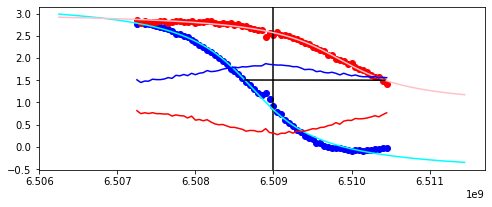

In [81]:
fig, (ax1) = plt.subplots(1,1, figsize = (8,3))

ax1.plot(f_vec_q1, Angle_T[0], color='blue', marker='o',ls='')
ax1.plot(f_vec_q1, Angle_T[1], color='red', marker='o',ls='')
ax1.axvline(x=fr1 - fr1_IF + 2.5*1e7,color='black',ls='-')

ax1.plot(f_vec_q1_fit, fit_arctan(f_vec_q1_fit,*popt_S0), color='cyan')
ax1.plot(f_vec_q1_fit, fit_arctan(f_vec_q1_fit,*popt_S1), color='pink')
#ax1.plot(f_vec_q1,fit_arctan(f_vec_q1,*P0),color='black')

ax1.plot(f_vec_q1, np.real(ref_pos_q1_rot.T[0])+1, color='blue', marker='',ls='-')
ax1.plot(f_vec_q1, np.real(ref_pos_q1_rot.T[1])+1, color='red', marker='',ls='-')
#ax1.plot(f_vec_q1, dist_avg_q1*1000, color='green', marker='x',ls='')
#ax2.axvline(x=fr1 - fr1_IF + 2.5*1e7,color='black',ls='-')

ax1.plot([f_vec_q1_fit[idx_S0],f_vec_q1_fit[idx_S1]], [fit_arctan(f_vec_q1_fit[idx_S0],*popt_S0), fit_arctan(f_vec_q1_fit[idx_S1],*popt_S1)],
         color='black', ls='-')

plt.show()


### Extra

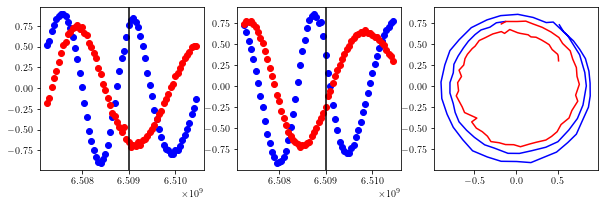

In [51]:
fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize = (10,3))

ax1.plot(f_vec_q1, np.real(ref_pos_q1.T[0]), color='blue', marker='o',ls='')
ax1.plot(f_vec_q1, np.real(ref_pos_q1.T[1]), color='red', marker='o',ls='')
ax1.axvline(x=fr1 - fr1_IF + 2.5*1e7,color='black',ls='-')

ax2.plot(f_vec_q1, np.imag(ref_pos_q1.T[0]), color='blue', marker='o',ls='')
ax2.plot(f_vec_q1, np.imag(ref_pos_q1.T[1]), color='red', marker='o',ls='')
ax2.axvline(x=fr1 - fr1_IF + 2.5*1e7,color='black',ls='-')

ax3.plot(np.real(ref_pos_q1.T[0]), np.imag(ref_pos_q1.T[0]), color='blue', marker='',ls='-')
ax3.plot(np.real(ref_pos_q1.T[1]), np.imag(ref_pos_q1.T[1]), color='red', marker='',ls='-')

#ax1.plot([f_vec_q1_fit[idx_S0],f_vec_q1_fit[idx_S1]], [fit_arctan(f_vec_q1_fit[idx_S0],*popt_S0), fit_arctan(f_vec_q1_fit[idx_S1],*popt_S1)],
#         color='black', ls='-')

plt.show()


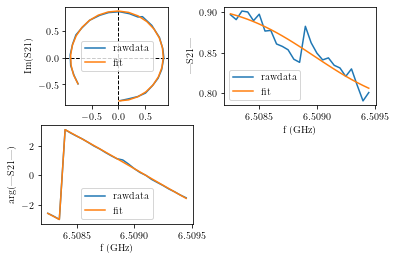


{'delay': 4.7363026534488227e-07, 'delay_remaining': -0.0, 'a': 0.8472916546428528, 'alpha': 2.6501880409056473, 'theta': -0.4182095532590604, 'phi': 0.07319505942508497, 'fr': 6508944890.80089, 'Ql': 2495.6963124236413, 'Qc': 2507.0983410480476, 'Qc_no_dia_corr': 2500.3854282505276, 'Qi': 548758.1456552321, 'Qi_no_dia_corr': 1330784.5067811802, 'fr_err': 45383.95679374651, 'Ql_err': 63.78811111543744, 'absQc_err': 64.58901862937729, 'phi_err': 0.032876298260622994, 'Qi_err': 1102231.8960376806, 'Qi_no_dia_corr_err': 5881927.624107445, 'chi_square': 0.002062907343723257}

fr_q1_chi0_mean= 6.50894 GHz


In [52]:
b,t=20,-20
fit = reflection_port(f_data = f_vec_q1[b:t], z_data_raw = ref_pos_q1.T[0][b:t])
fit.autofit()
    
fr_q1_chi0 = fit.fitresults['fr']
fit.plotall()
print('')
print(fit.fitresults)
print('')
print('fr_q1_chi0_mean= {} GHz'.format(np.round(fr_q1_chi0*1e-9,5)))

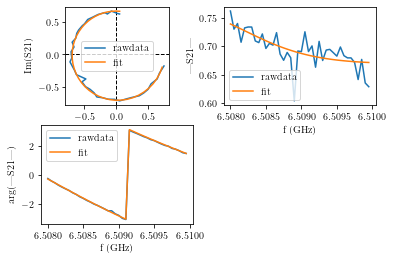


{'delay': 2.2115336863610367e-07, 'delay_remaining': 1.7529913611535807e-09, 'a': 0.6956556915077914, 'alpha': -1.7588541495205536, 'theta': 1.4426479425956371, 'phi': 0.05990943852639763, 'fr': 6507923962.341838, 'Ql': 2174.061877146572, 'Qc': 2109.0991290747215, 'Qc_no_dia_corr': 2105.3153340986723, 'Qi': -70583.71370886145, 'Qi_no_dia_corr': -66579.14135474272, 'fr_err': 44293.13412459955, 'Ql_err': 52.25434296071758, 'absQc_err': 49.133284411043675, 'phi_err': 0.023139765949137532, 'Qi_err': 27879.73335960449, 'Qi_no_dia_corr_err': 27087.2179245258, 'chi_square': 0.0022987966812860645}

fr_q1_chi1_mean= 6.50792 GHz


In [53]:
b,t=15,-10

fit = reflection_port(f_data = f_vec_q1[b:t], z_data_raw = ref_pos_q1.T[1][b:t])
fit.autofit()
    
fr_q1_chi1 = fit.fitresults['fr']
fit.plotall()
print('')
print(fit.fitresults)
print('')
print('fr_q1_chi1_mean= {} GHz'.format(np.round(fr_q1_chi1*1e-9,5)))

In [54]:
print('From circlefit q1= {:.3f} MHz'.format(np.abs(fr_q1_chi1-fr_q1_chi0)*1e-6))

From circlefit q1= 1.021 MHz


## Isolation with AC-Stark

### AC-Starkt with VNA on q1 driven at  port 1

In [55]:
measurement_files = 'SAZ2BE_3D_AC_stark_qR7.h5'
#measurement_files = 'SAZVXI_3D_AC_stark_qR7_.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

f_vna= 6.506 GHz


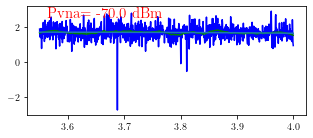

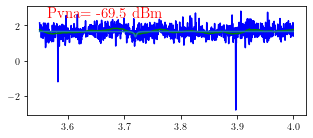

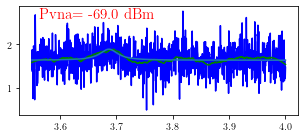

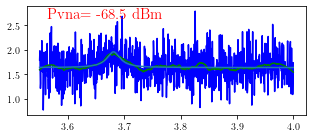

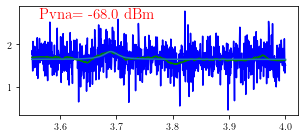

...

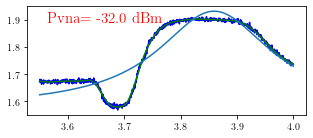

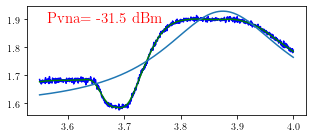

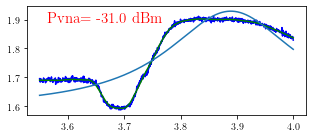

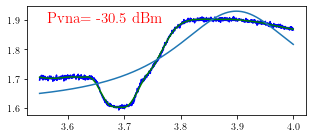

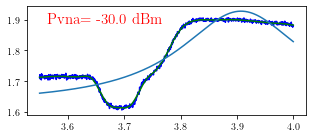

In [56]:
h5 = Data(LoadFiles[0])
#print(h5.data.__dict__)
f_vna = h5.data.frequency[:]
mw_freq_q1_p1 = h5.data.mw_freq[:]
power_vna_q1_p1 = h5.data.vna_power[:]
phase = h5.data.phase[:] 
amplitude = h5.data.amplitude[:] 

print('f_vna= {} GHz'.format(f_vna[1]*1e-9))

def lorentzian(params, x):
    x0 = params[0]
    a = params[1]
    gam = params[2]
    off = params[3]
    return np.abs(a * gam**2 / ( gam**2 + ( x - x0 )**2) + off)

def cost_func(params, xData, yData):
    return np.abs(lorentzian(params, xData) - yData)


x0_vec_q1_p1 = np.zeros(len(power_vna_q1_p1))
gam_vec = np.zeros(len(power_vna_q1_p1))

#print(len(mw_freq),len(phase.T[1,i]),len(phase[0,:,1]))
#print(phase[1,:,1])
#print(phase.T)


for i in range(0,len(power_vna_q1_p1)):#len(power_vna)):
    
    startValues = [mw_freq_q1_p1[np.argmax(savgol_filter(phase[i,:,1],100,2))]*1e-9, np.max(savgol_filter(phase[i,:,1],100,2)), 0.1, np.mean(phase[i,:,1])]
    popt, ier = leastsq(cost_func, startValues, args=( mw_freq_q1_p1*1e-9, phase[i,:,1] ) )
    x0_vec_q1_p1[i] = popt[0]
    gam_vec[i] = popt[2]
    
    fig, ax = plt.subplots(1,1, figsize = (5,2))
    ax.plot(mw_freq_q1_p1*1e-9,phase[i,:,1], color='blue')
    ax.plot(mw_freq_q1_p1*1e-9,savgol_filter(phase[i,:,1],100,2),color='green')
    ax.plot(mw_freq_q1_p1*1e-9,lorentzian(popt, mw_freq_q1_p1*1e-9))
    ax.text(s='Pvna= {:.1f} dBm'.format(power_vna_q1_p1[i]),x=ax.get_xlim()[0]*1.01,y=ax.get_ylim()[1]*0.99,size=15,color='red',ha='left',va='top')
    plt.show()



81


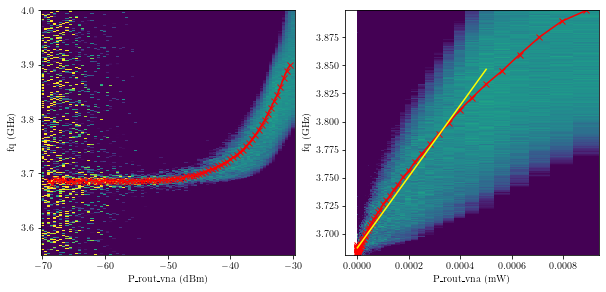

q1: f per mW driven at port 1= 317272712882.3 Hz/mW
q1: n per mW driven at port 1= 176852.1 n/mW


In [57]:
def dBm_to_mW(P_dBm):
    return( 10**(P_dBm/ 10) )
def lin_fit(x,m,n):
    return(m*x+n)

fig, (ax1, ax2) = plt.subplots(1,2, figsize = (10,4.5), gridspec_kw={'width_ratios': [1, 1]})

b,t=2,-1

ax1.pcolor(power_vna_q1_p1, mw_freq_q1_p1*1e-9, phase.T[1,:,:], shading = 'auto', vmin=1.8, vmax=2.0)
ax1.plot(power_vna_q1_p1[b:t],x0_vec_q1_p1[b:t],color='red',marker='x')
ax1.set_xlabel('P_rout_vna (dBm)')
ax1.set_ylabel('fq (GHz)')

b,t=2,-1
ax2.pcolor(dBm_to_mW(power_vna_q1_p1[b:t]), mw_freq_q1_p1*1e-9, phase.T[1,:,b:t], shading = 'auto', vmin=1.8, vmax=2.0)
ax2.plot(dBm_to_mW(power_vna_q1_p1[b:t]),x0_vec_q1_p1[b:t],color='red',marker='x')
ax2.set_xlabel('P_rout_vna (mW)')
ax2.set_ylabel('fq (GHz)')
ax2.set_xscale('linear')
ax2.set_ylim([np.min(x0_vec_q1_p1[b:t]),np.max(x0_vec_q1_p1[b:t])])

print(len(x0_vec_q1_p1))
b,t=2,75
popt,pcov = curve_fit(lin_fit,dBm_to_mW(power_vna_q1_p1[b:t]),x0_vec_q1_p1[b:t],p0=[(x0_vec_q1_p1[1]-x0_vec_q1_p1[-1])/(dBm_to_mW(power_vna_q1_p1[1])-dBm_to_mW(power_vna_q1_p1[-1])),3.7])
x_fit = np.linspace(np.min(dBm_to_mW(power_vna_q1_p1)),np.max(dBm_to_mW(power_vna_q1_p1[:t])),1001,True)
ax2.plot(x_fit, lin_fit(x_fit,*popt), color='yellow', marker='',ls='-')


#for i in range(0,len(power_vna[b:t])):
#    ax2.text(s=i,x=dBm_to_mW(power_vna[b:t][i])**2,y=x0_vec[b:t][i],color='black',size=10)

#ax2.axvline(x=fr1 - fr1_IF + 2.5*1e7,color='black',ls='-')

plt.show()

f_per_mW__q1_p1 = popt[0]*1e9
n_per_mW__q1_p1 = popt[0]*1e9/chi_q1

print('q1: f per mW driven at port 1= {:.1f} Hz/mW'.format(f_per_mW__q1_p1))
print('q1: n per mW driven at port 1= {:.1f} n/mW'.format(n_per_mW__q1_p1))


### AC-Starkt with Ramsey on q1 driven at  port 2

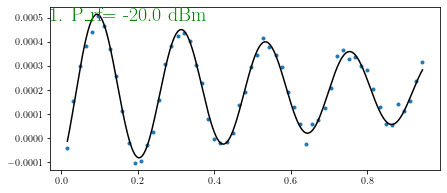

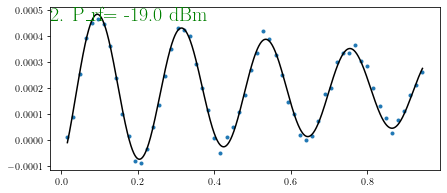

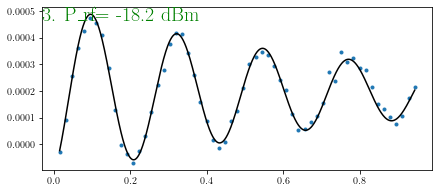

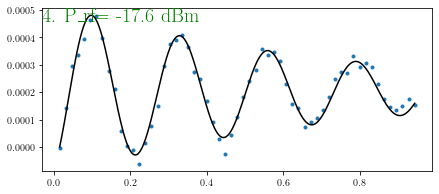

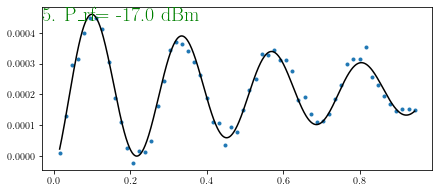

...

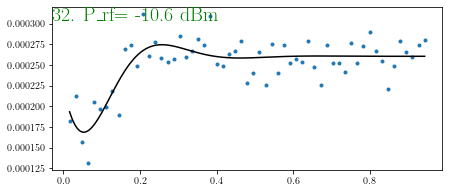

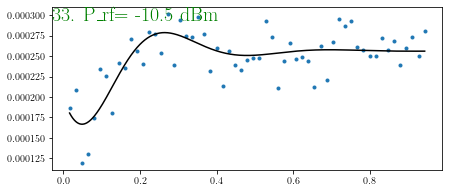

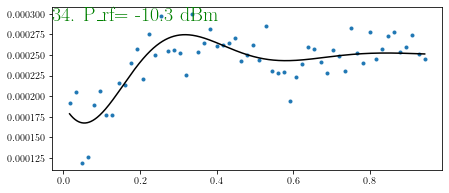

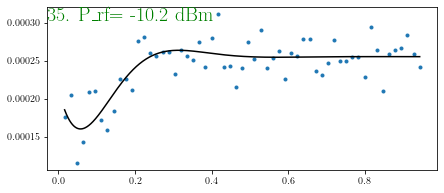

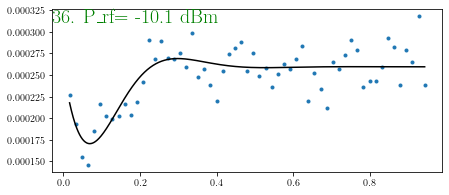

In [58]:
measurement_files =  'SAYWDT_QM_experiment_t2_power_external.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles=glob2.glob(url)

h5 = Data(LoadFiles[0])

I_avg = h5.data.i_avg[:] 
Q_avg = h5.data.q_avg[:]
power_vec_q1_p2 = h5.data.power_external[:]
t_us = h5.data.t_wait[:]
t_us_fit = np.linspace(np.min(t_us),np.max(t_us),1001,True)
#print(len(I_avg),len(power_vec_q1_p3),h5.data.__dict__)

q1_p2__T2__vec = np.empty(len(I_avg))
q1_p2__f_detuning__vec = np.empty(len(I_avg))

def damped_oscillation(t, A, tau, f, phase, off):
    return A * np.exp(- t / tau) * np.cos(2 * np.pi * f * t + phase) + off

for ii in range (0,len(I_avg)):
    
    A = (np.max(I_avg[ii])-np.min(I_avg[ii]))
    tau = 0.5
    f = 5.0
    pha = 3*np.pi/4
    off = np.mean(I_avg)
    P0 = [A, tau, f, pha, off]
    
    fig, ax1 = plt.subplots(1,1, figsize = (7,3))
    ax1.plot(t_us, I_avg[ii],marker='o',ls='',ms=3)
    
    try:
        popt, pcov = curve_fit(damped_oscillation, t_us, I_avg[ii], p0=P0)
        t2 = popt[1]
        f_detuning = popt[2]

        q1_p2__T2__vec[ii] = t2
        q1_p2__f_detuning__vec[ii] = f_detuning *1e6
        
        ax1.plot(t_us_fit, damped_oscillation(t_us_fit, *popt), color='black',ls='-')
        ax1.text(s='{}. P_rf= {:.1f} dBm'.format(ii+1, power_vec_q1_p2[ii]),x=ax1.get_xlim()[0],y=ax1.get_ylim()[1],ha='left',va='top',color='green',size=20)        
    except:
        q1__T2__vec[ii] = 0
        q1_p2__f_detuning__vec[ii] = 0
        ax1.plot(t_us_fit, damped_oscillation(t_us_fit, *P0), color='red',ls='--')
        ax1.text(s='{}. P_rf= {:.1f} dBm'.format(ii+1, power_vec_q1_p2[ii]),x=ax1.get_xlim()[0],y=ax1.get_ylim()[1],ha='left',va='top',color='red',size=20)
   
    plt.show()

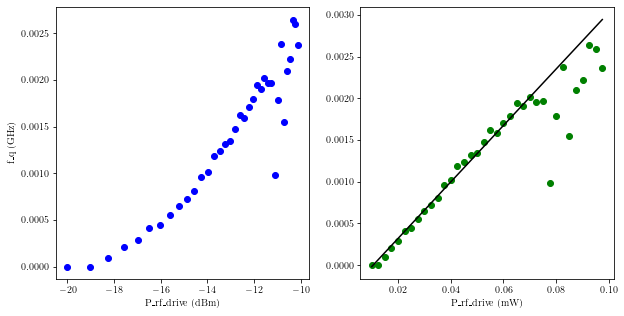

q1: f per mW driven at port 2= 33872271.410 Hz/mW
q1: n per mW driven at port 2= 18.880865 Hz/mW


In [59]:
def dBm_to_mW(p):
    return(10**(p/10))
def mW_to_dBm(p):
    return(10*np.log(p))
def lin_fit(x,m,n):
    return(m*x+n)

fr1 = 6.509 *1e9
fr1_IF = 25.0e6

fq1 = 3.67865*1e9 + 0.0046*1e9
fq1_IF = 180e6
fq1_detuning = 5e6


power_vec_q1_p2 = power_vec_q1_p2
f_vec_q1_p2 = (fq1-fq1_IF+fq1_detuning-q1_p2__f_detuning__vec)*1e-9

b,t=0,27
popt,pcov=curve_fit(lin_fit, dBm_to_mW(power_vec_q1_p2[b:t]), f_vec_q1_p2[b:t]-np.min(f_vec_q1_p2))
power_vec_fit_q1_p2 = np.linspace(np.min(dBm_to_mW(power_vec_q1_p2)),np.max(dBm_to_mW(power_vec_q1_p2)),1001,True)

fig, (ax1,ax2) = plt.subplots(1,2, figsize = (10,5))

ax1.plot(power_vec_q1_p2, f_vec_q1_p2-np.min(f_vec_q1_p2), marker='o', ls='', color='blue')
ax1.set_xlabel('P_rf_drive (dBm)')    
ax1.set_ylabel('f_q (GHz)')
ax1.ticklabel_format(useOffset=False)
    
ax2.plot(dBm_to_mW(power_vec_q1_p2), (f_vec_q1_p2-np.min(f_vec_q1_p2)), marker='o',ls='',color='green')
ax2.plot(power_vec_fit_q1_p2,lin_fit(power_vec_fit_q1_p2,*popt), color='black',ls='-')
ax2.ticklabel_format(useOffset=False)    
ax1.set_ylabel('f_q (GHz)')
ax2.set_xlabel('P_rf_drive (mW)')      
  
plt.show()

f_per_mW__q1_p2 = popt[0]*1e9
n_per_mW__q1_p2 = popt[0]*1e9/chi_q1

print('q1: f per mW driven at port 2= {:.3f} Hz/mW'.format(f_per_mW__q1_p2))
print('q1: n per mW driven at port 2= {:.6f} Hz/mW'.format(n_per_mW__q1_p2))


### AC-Starkt with Ramsey on q1 driven at  port 3

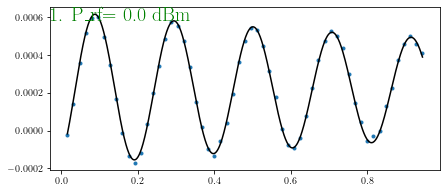

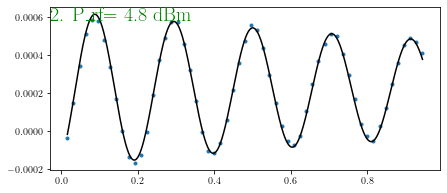

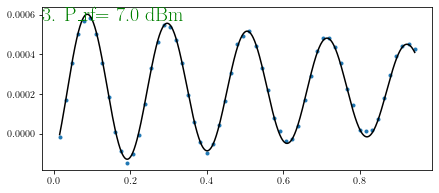

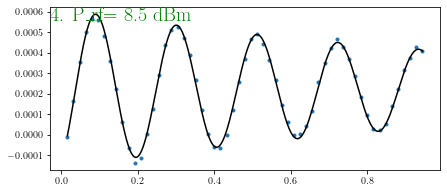

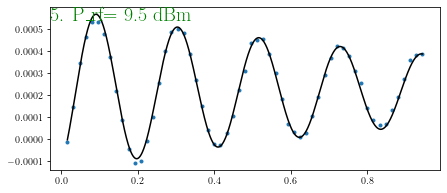

...

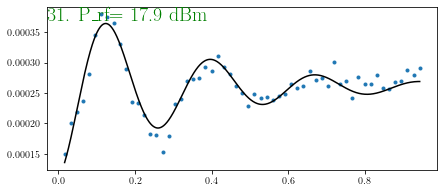

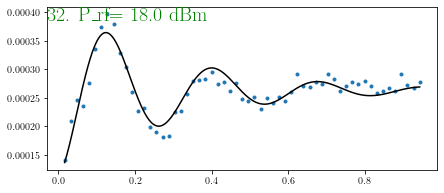

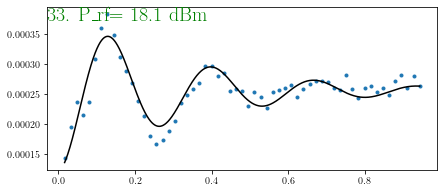

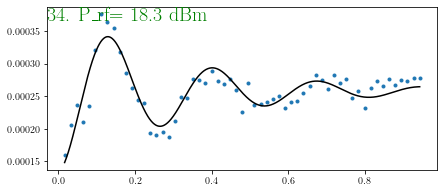

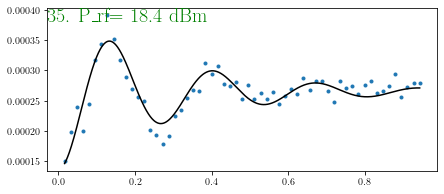

In [60]:
measurement_files =  'SAYVZ2_QM_experiment_t2_power_external.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles=glob2.glob(url)

h5 = Data(LoadFiles[0])



I_avg = h5.data.i_avg[:] 
Q_avg = h5.data.q_avg[:]
power_vec_q1_p3 = h5.data.power_external[:]
t_us = h5.data.t_wait[:]
t_us_fit = np.linspace(np.min(t_us),np.max(t_us),1001,True)
#print(len(I_avg),len(power_vec_q1_p3),h5.data.__dict__)

q1_p3__T2__vec = np.empty(len(I_avg))
q1_p3__f_detuning__vec = np.empty(len(I_avg))

def damped_oscillation(t, A, tau, f, phase, off):
    return A * np.exp(- t / tau) * np.cos(2 * np.pi * f * t + phase) + off

for ii in range (0,len(I_avg)):
    
    A = (np.max(I_avg[ii])-np.min(I_avg[ii]))
    tau = 0.5
    f = 2.0
    pha = -np.pi/2
    off = np.mean(I_avg)
    P0 = [A, tau, f, pha, off]
    
    fig, ax1 = plt.subplots(1,1, figsize = (7,3))
    ax1.plot(t_us, I_avg[ii],marker='o',ls='',ms=3)
    
    try:
        popt, pcov = curve_fit(damped_oscillation, t_us, I_avg[ii], p0=P0)
        t2 = popt[1]
        f_detuning = popt[2]

        q1_p3__T2__vec[ii] = t2
        q1_p3__f_detuning__vec[ii] = f_detuning *1e6
        
        ax1.plot(t_us_fit, damped_oscillation(t_us_fit, *popt), color='black',ls='-')
        ax1.text(s='{}. P_rf= {:.1f} dBm'.format(ii+1, power_vec_q1_p3[ii]),x=ax1.get_xlim()[0],y=ax1.get_ylim()[1],ha='left',va='top',color='green',size=20)
        
    except:
        q1__T2__vec[ii] = 0
        q1_p1__f_detuning__vec[ii] = 0
        ax1.text(s='{}. P_rf= {:.1f} dBm'.format(ii+1, power_vec_q1_p3[ii]),x=ax1.get_xlim()[0],y=ax1.get_ylim()[1],ha='left',va='top',color='red',size=20)
   
    plt.show()

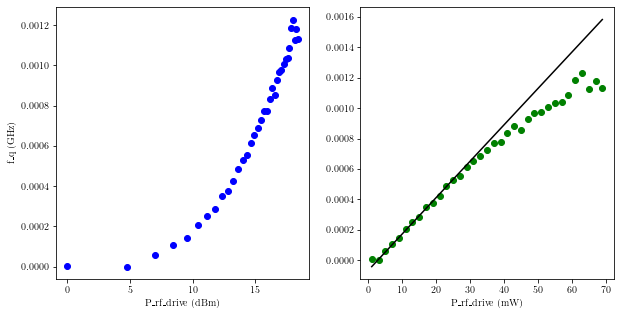

q1: f per mW driven at port 3= 23913.484 Hz/mW
q1: n per mW driven at port 3= 0.013330 Hz/mW


In [61]:
def dBm_to_mW(p):
    return(10**(p/10))
def mW_to_dBm(p):
    return(10*np.log(p))
def lin_fit(x,m,n):
    return(m*x+n)

fr1 = 6.509 *1e9
fr1_IF = 25.0e6

fq1 = 3.67865*1e9 + 0.0046*1e9
fq1_IF = 180e6
fq1_detuning = 5e6


power_vec_q1_p3 = power_vec_q1_p3
f_vec_q1_p3 = (fq1-fq1_IF+fq1_detuning-q1_p3__f_detuning__vec)*1e-9

b,t=1,5
popt,pcov=curve_fit(lin_fit, dBm_to_mW(power_vec_q1_p3[b:t]), f_vec_q1_p3[b:t]-np.min(f_vec_q1_p3))
power_vec_fit_q1_p3 = np.linspace(np.min(dBm_to_mW(power_vec_q1_p3)),np.max(dBm_to_mW(power_vec_q1_p3)),1001,True)

fig, (ax1,ax2) = plt.subplots(1,2, figsize = (10,5))

ax1.plot(power_vec_q1_p3, f_vec_q1_p3-np.min(f_vec_q1_p3), marker='o', ls='', color='blue')
ax1.set_xlabel('P_rf_drive (dBm)')    
ax1.set_ylabel('f_q (GHz)')
ax1.ticklabel_format(useOffset=False)
    
ax2.plot(dBm_to_mW(power_vec_q1_p3), (f_vec_q1_p3-np.min(f_vec_q1_p3)), marker='o',ls='',color='green')
ax2.plot(power_vec_fit_q1_p3,lin_fit(power_vec_fit_q1_p3,*popt), color='black',ls='-')
ax2.ticklabel_format(useOffset=False)    
ax1.set_ylabel('f_q (GHz)')
ax2.set_xlabel('P_rf_drive (mW)')      
  
plt.show()

f_per_mW__q1_p3 = popt[0]*1e9
n_per_mW__q1_p3 = popt[0]*1e9/chi_q1

print('q1: f per mW driven at port 3= {:.3f} Hz/mW'.format(f_per_mW__q1_p3))
print('q1: n per mW driven at port 3= {:.6f} Hz/mW'.format(n_per_mW__q1_p3))


### AC-Stark Summary Plot

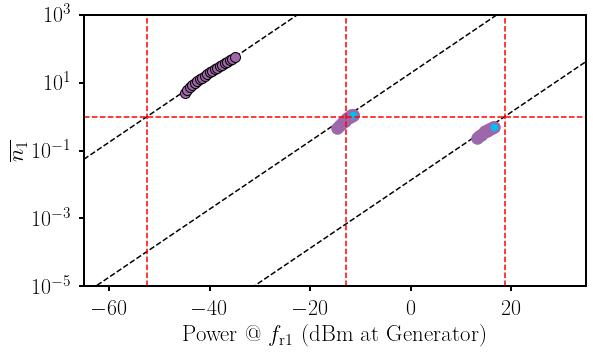

r1= -52.5, r2= -12.8, r3= 18.8, isol_r1_to_r3= -71.2, isol_r1_to_r2= -39.7


In [62]:
def dBm_to_mW(p):
    return(10**(p/10))
def mW_to_dBm(p):
    return(10*np.log(p))
def FKT__find_nearest_index(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx

#---------------------------------------------

TextSize = 23
LegendTextSize = 18

TickTextSize=22
TickWidth = 2
TickLength  = 5
TickLabelPad = 8

MSize1 = 10
MSize2 = 10

LWidth = 1
LStyle = ''

Photons_in_resonator = 1

#-------------------------------------------

fig, ax = plt.subplots(figsize = (9, 5))

for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(TickWidth)
Xpower_fit = np.linspace(-70,60,1001,True)

#----
# top plot
idx__lower_limit = 50
idx__upper_limit = -10


n_at_fi = (x0_vec_q1_p1-np.median(x0_vec_q1_p1[0:5]))*1e9/chi_q1                    
ax.plot(power_vna_q1_p1[idx__lower_limit:idx__upper_limit], n_at_fi[idx__lower_limit:idx__upper_limit], ls='', marker='o',
        color = 'black', markerfacecolor = purple, label = 'Port1',clip_on=True,ms=MSize1)
ax.plot(Xpower_fit,(dBm_to_mW(Xpower_fit)*n_per_mW__q1_p1),color='black',ls='--',marker='',zorder=-1)

idx_q1_p1 = FKT__find_nearest_index((dBm_to_mW(Xpower_fit)*n_per_mW__q1_p1), Photons_in_resonator)
power_at_XX__q1_p1 = Xpower_fit[idx_q1_p1]
ax.axvline(x=power_at_XX__q1_p1,color='red',ls='--')

#---
# middel polt

idx__lower_limit = 10
idx__upper_limit = 26

n_at_fi = (f_vec_q1_p2-np.min(f_vec_q1_p2))*1e9/chi_q1  # Ramsey is 5 MHz detuned from qubit frequency
ax.plot(power_vec_q1_p2[idx__lower_limit:idx__upper_limit], n_at_fi[idx__lower_limit:idx__upper_limit], ls='',marker='o',
        color = purple, markerfacecolor = lightblue , markeredgewidth=2.5, label = 'Port2',clip_on=True,ms=MSize2)
ax.plot(Xpower_fit,(dBm_to_mW(Xpower_fit)*n_per_mW__q1_p2),color='black',ls='--',marker='',zorder=-1)

idx_q1_p2 = FKT__find_nearest_index((dBm_to_mW(Xpower_fit)*n_per_mW__q1_p2), Photons_in_resonator)
power_at_XX__q1_p2 = Xpower_fit[idx_q1_p2]
ax.axvline(x=power_at_XX__q1_p2,color='red',ls='--')

#---
# bottom plot
idx__lower_limit = 10
idx__upper_limit = 23

n_at_fi = (f_vec_q1_p3-np.min(f_vec_q1_p3))*1e9/chi_q1  # Ramsey is 5 MHz detuned from qubit frequency
ax.plot(power_vec_q1_p3[idx__lower_limit:idx__upper_limit], n_at_fi[idx__lower_limit:idx__upper_limit], ls='',marker='o',
        color = purple, markerfacecolor = lightblue , markeredgewidth=2.5, label = 'Port3',clip_on=True,ms=MSize2)
ax.plot(Xpower_fit,(dBm_to_mW(Xpower_fit)*n_per_mW__q1_p3),color='black',ls='--',marker='',zorder=-1)

idx_q1_p3 = FKT__find_nearest_index((dBm_to_mW(Xpower_fit)*n_per_mW__q1_p3), Photons_in_resonator)
power_at_XX__q1_p3 = Xpower_fit[idx_q1_p3]
ax.axvline(x=power_at_XX__q1_p3,color='red',ls='--')

#--------------

ax.axhline(y=Photons_in_resonator,color='red',ls='--')

ax.tick_params(axis='x', labelsize=TickTextSize, width=TickWidth, length=TickLength, pad=TickLabelPad, color=black, labelcolor=black)
ax.tick_params(axis='y', labelsize=TickTextSize, width=TickWidth, length=TickLength, pad=TickLabelPad, color=black, labelcolor=black)

ax.set_xlabel(r'Power @ $f_{\rm r1}$ (dBm at Generator)', fontsize = TextSize, labelpad=5, color=black)
ax.set_ylabel('$\overline{n_1}$', fontsize = TextSize, color=black)

#ax.set_yscale('symlog',linthresh=0.01)
#ax.set_ylim([-0.01,100])

ax.set_yscale('log')

ax.set_ylim([10**(-5),10**(3)])


ax.set_xlim([-65,35])
#ax.set_xticks(np.arange(-50,21,10))
#ax.set_xticklabels(['-50','','-30','','-10','','10',''])

plt.savefig('Isolation--qR07_qS16_through_P1_and_P3.svg')

plt.show()

print('r1= {:.1f}, r2= {:.1f}, r3= {:.1f}, isol_r1_to_r3= {:.1f}, isol_r1_to_r2= {:.1f}'.format(power_at_XX__q1_p1, power_at_XX__q1_p2,  power_at_XX__q1_p3, -np.abs(power_at_XX__q1_p1-power_at_XX__q1_p3), -np.abs(power_at_XX__q1_p1-power_at_XX__q1_p2)))


### Print Data List

In [63]:
print('')
print('chi_q1')
print(chi_q1)
print('')


chi_q1
1794000.0



In [54]:
print('')
print('f_vec_q1_p1')
print(repr(x0_vec_q1_p1))
print('')
print('--------------------------------------------------------')
print('')
print('power_vna_q1_p1')
print(repr(power_vna_q1_p1))
print('')
print('--------------------------------------------------------')
print('')
print('n_per_mW__q1_p1')
print(repr(n_per_mW__q1_p1))
print('')


f_vec_q1_p1
array([4.35114276, 3.72009238, 3.68661477, 3.68114273, 3.69012515,
       3.68740612, 3.68827489, 3.68734307, 3.68376539, 3.68545337,
       3.6840075 , 3.6867308 , 3.68636826, 3.68848598, 3.68359605,
       3.68721423, 3.68685895, 3.68631227, 3.68476432, 3.68607105,
       3.68715506, 3.6860197 , 3.68659941, 3.68687715, 3.68645807,
       3.68650685, 3.68550283, 3.68501611, 3.68580463, 3.68682953,
       3.68628135, 3.68594029, 3.68525937, 3.68722214, 3.68715217,
       3.68693324, 3.68686937, 3.68790094, 3.6872698 , 3.6881848 ,
       3.68833029, 3.68965062, 3.6896935 , 3.6908104 , 3.6903499 ,
       3.69232666, 3.6946499 , 3.69509416, 3.69572111, 3.69763982,
       3.69907727, 3.70101167, 3.70338909, 3.70539471, 3.70790152,
       3.70975934, 3.71314653, 3.71490202, 3.71898183, 3.72152876,
       3.72627027, 3.72966615, 3.73370315, 3.73921531, 3.74390145,
       3.75036104, 3.75599334, 3.76394215, 3.77138947, 3.77958725,
       3.78893717, 3.79853496, 3.81008763, 3.8212

In [55]:
print('')
print('f_vec_q1_p2')
print(repr(f_vec_q1_p2))
print('')
print('--------------------------------------------------------')
print('')
print('power_vec_q1_p2')
print(repr(power_vec_q1_p2))
print('')
print('--------------------------------------------------------')
print('')
print('n_per_mW__q1_p2')
print(repr(n_per_mW__q1_p2))
print('')


f_vec_q1_p2
array([3.50370611, 3.50370543, 3.50379938, 3.50391086, 3.50399097,
       3.50411386, 3.50414898, 3.50426049, 3.50434999, 3.50443168,
       3.50451206, 3.50466882, 3.50472114, 3.50489188, 3.50494584,
       3.50502288, 3.5050508 , 3.50518344, 3.50532468, 3.50529307,
       3.50540996, 3.50549913, 3.50564864, 3.50560824, 3.50572337,
       3.50566652, 3.50567404, 3.50469018, 3.5054879 , 3.50608525,
       3.50525492, 3.50580233, 3.50593112, 3.50635083, 3.50630088,
       3.50607319])

--------------------------------------------------------

power_vec_q1_p2
array([-20.        , -19.03089987, -18.23908741, -17.56961951,
       -16.98970004, -16.47817482, -16.02059991, -15.60667306,
       -15.22878745, -14.88116639, -14.55931956, -14.25968732,
       -13.97940009, -13.7161107 , -13.46787486, -13.2330639 ,
       -13.01029996, -12.79840697, -12.59637311, -12.40332155,
       -12.2184875 , -12.04119983, -11.87086643, -11.70696227,
       -11.5490196 , -11.39661993, -11.249387

In [56]:
print('')
print('f_vec_q1_p3')
print(repr(f_vec_q1_p3))
print('')
print('--------------------------------------------------------')
print('')
print('power_vec_q1_p3')
print(repr(power_vec_q1_p3))
print('')
print('--------------------------------------------------------')
print('')
print('n_per_mW__q1_p3')
print(repr(n_per_mW__q1_p3))
print('')


f_vec_q1_p3
array([3.50340911, 3.50340435, 3.50346155, 3.50351131, 3.50354718,
       3.50360915, 3.50365477, 3.50369006, 3.50375299, 3.50378269,
       3.50382793, 3.50389076, 3.50393217, 3.5039609 , 3.50401777,
       3.50405741, 3.50409188, 3.50413206, 3.50417569, 3.50417886,
       3.50423898, 3.50429001, 3.50425967, 3.50433441, 3.50437315,
       3.50438182, 3.50441335, 3.50443549, 3.50444349, 3.50449087,
       3.50458966, 3.50463253, 3.50453026, 3.50458542, 3.50453473])

--------------------------------------------------------

power_vec_q1_p3
array([ 0.        ,  4.77121255,  6.98970004,  8.4509804 ,  9.54242509,
       10.41392685, 11.13943352, 11.76091259, 12.30448921, 12.78753601,
       13.22219295, 13.61727836, 13.97940009, 14.31363764, 14.62397998,
       14.91361694, 15.1851394 , 15.44068044, 15.68201724, 15.91064607,
       16.12783857, 16.33468456, 16.53212514, 16.72097858, 16.9019608 ,
       17.07570176, 17.2427587 , 17.40362689, 17.55874856, 17.70852012,
       17.

# bG1 coupling (with qR7 & qS16)

In [90]:
Qubit_Name = 'bG1'

data_dir = url_to_GFQ_folder
cooldown_dir = '\\CS_BF_TH__2024_03_07__qR7_bG1_qS16__Coupling__Isolation__Paper2'
measurement_dir = '\\Messdaten\\'

## Readout-Fit from Flux Sweep

In [91]:
measurement_files = '\\S9VQGI_2D_GFQ_bG1_x_FS__fvna_6p268_6p278_GHz__Pvna_m50_dBm__I_m3p3_to_3p6_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

File=[]
for i in range(0,len(LoadFiles)):
    File.append(LoadFiles[i])
    
    h5 = Data(File[i])
    f_vna = h5.data.frequency[:]
    current = h5.data.current[:]
    phase = h5.data.phase[:]
    amp = h5.data.amplitude[:]

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/1719664921.py:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(current, f_vna*1e-9, phase.T)


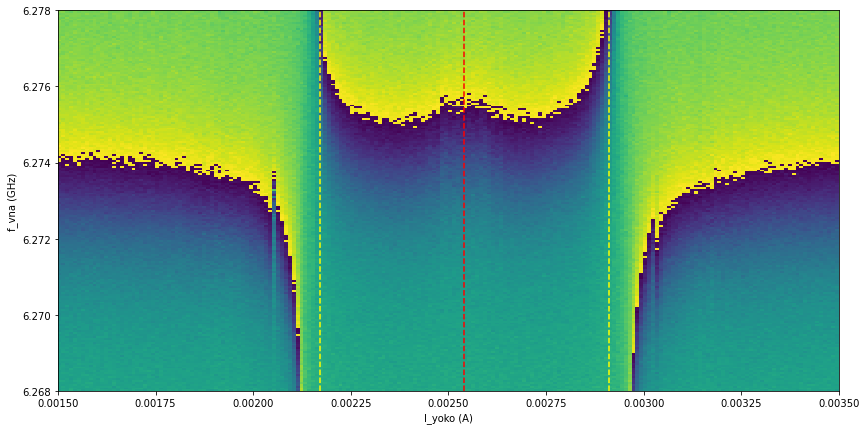

In [92]:
%matplotlib inline
#%matplotlib widget

fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current, f_vna*1e-9, phase.T)

ax.set_xlim([0.0015,0.0035])

ax.axvline(x=0.00217,color='yellow',ls='--')
ax.axvline(x=0.00291,color='yellow',ls='--')
ax.axvline(x=0.00254,color='red',ls='--')

ax.set_xlabel(r'I_yoko (A)')
ax.set_ylabel(r'f_vna (GHz)')
plt.show()

In [93]:
def cost_function(x,amp,phase):
    imag = x[0]
    real = x[1]
    return np.abs((np.sqrt(real**2+imag**2)-amp))*10 + np.abs(np.arctan2(imag,real)-phase)*10


def FKT__find_nearest_index(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx

idx = FKT__find_nearest_index(current, 0.00254)

phase_at_idx = phase[idx,:]
amp_at_idx = amp[idx,:]

In [94]:
minimize__max_iterations = 2000
minimize_tolerance = 1e-4 #Absolute error in xopt between iterations that is acceptable for convergence.

Sij=np.zeros(len(amp_at_idx)).astype(complex)

for i in range(0,len(phase_at_idx)):
    
    x0=[0.6,0.6]
    bounds=((-3,3),(-3,3))
    res = minimize(cost_function,x0,args=(amp_at_idx[i],phase_at_idx[i]),
                   bounds = bounds, method = 'Nelder-Mead',
                   options={'maxiter':minimize__max_iterations, 'xatol':minimize_tolerance})
  
    imag = res.x[0]
    real = res.x[1]
    Sij[i] = real + 1j * imag
    
    print('')
    print('')
#    print('Sij',Sij[i], real, np.real(Sij[i]), imag, np.imag(Sij[i]))
#    print('amp',np.sqrt(real**2+imag**2), np.sqrt(np.real(Sij[i])**2+np.imag(Sij[i])**2),amp_at_idx[i])
#    print('Hallo',res.x)
    print('')
    print('')

    
reSij = np.real(Sij)
imSij = np.imag(Sij) 
absSij = np.sqrt(reSij**2+imSij**2)
absSij_dB = 20*np.log10(absSij)
argSij = np.arctan2(imSij,reSij)

print('')    
print('fertig')  


































































































































































































































































































































































































































































































































































































































































































































































































































fertig


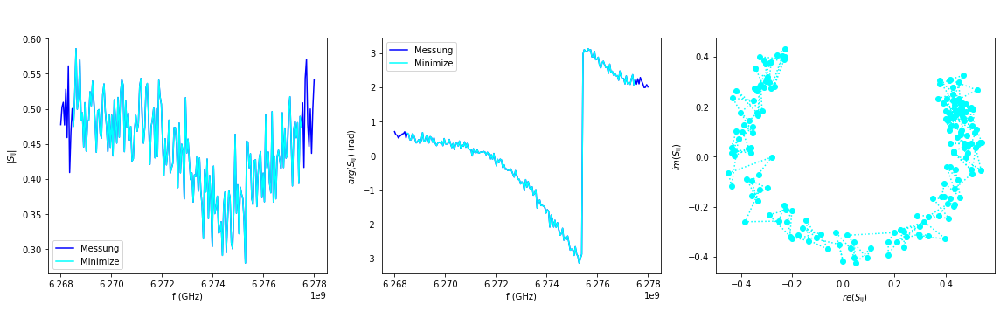

In [95]:
fig,ax = plt.subplots(1,3,figsize = (16,5))
fig.suptitle('   ', fontsize=20, ha='left',x=0.05)

b=10
t=-10
ax[0].plot(f_vna, amp_at_idx, color='blue', label='Messung')
ax[0].plot(f_vna[b:t], absSij[b:t], color='cyan', label='Minimize')
ax[0].set_xlabel(r'f (GHz)')
ax[0].set_ylabel(r'$|S_{\rm ij}|$')
ax[0].legend()
    
ax[1].plot(f_vna, phase_at_idx, color='blue', label='Messung')
ax[1].plot(f_vna[b:t], argSij[b:t] , color='cyan', label='Minimize')
ax[1].set_xlabel(r'f (GHz)')
ax[1].set_ylabel(r'$arg(S_{\rm ij})$ (rad)')
ax[1].legend()
    
ax[2].plot(reSij[b:t], imSij[b:t],ls=':',marker='o', color='cyan')
ax[2].set_xlabel(r'$re(S_{\rm ij})$')
ax[2].set_ylabel(r'$im(S_{\rm ij})$')

plt.tight_layout()
plt.show()

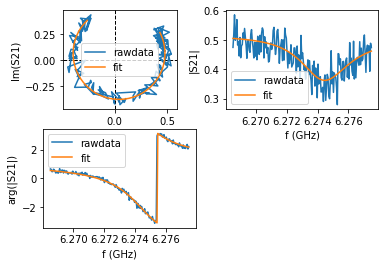



{'delay': 4.670232934210022e-11, 'delay_remaining': 8.793152648361216e-10, 'a': 0.5136322279076936, 'alpha': 2.9868598134699855, 'theta': -0.13001647660045368, 'phi': 0.024716363519353912, 'fr': 6274296851.624413, 'Ql': 1486.32483336122, 'Qc': 1740.3094193079708, 'Qc_no_dia_corr': 1739.777870052818, 'Qi': 10184.338935403706, 'Qi_no_dia_corr': 10202.580669563224, 'fr_err': 44842.93331414783, 'Ql_err': 31.090865999725654, 'absQc_err': 29.34778977900402, 'phi_err': 0.017869475722311408, 'Qi_err': 850.0987483831595, 'Qi_no_dia_corr_err': 850.8577023189273, 'chi_square': 0.013037344588870887}

fr_c2_mean= 6.274 GHz
Df_c2_mean= 4.221 MHz


In [96]:
fit = reflection_port(f_data = f_vna[b:t], z_data_raw = Sij[b:t])
fit.autofit()
    
fr_c2 = fit.fitresults['fr']
Qi_c2 = fit.fitresults['Qi']
Qc_c2 = fit.fitresults['Qc']
Ql_c2 = fit.fitresults['Ql']

fit.plotall()

print('')
print('')
print(fit.fitresults)
print('')
Df_c2 = fr_c2/Ql_c2
Df_c2_mean = np.mean(Df_c2)
fr_c2_mean = np.mean(fr_c2)
print('fr_c2_mean= {} GHz'.format(np.round(fr_c2_mean*1e-9,3)))
print('Df_c2_mean= {} MHz'.format(np.round(Df_c2_mean*1e-6,3)))

## Flux-Sweep

### Rough

In [97]:
measurement_files = '\\S9VQGI_2D_GFQ_bG1_x_FS__fvna_6p268_6p278_GHz__Pvna_m50_dBm__I_m3p3_to_3p6_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs_rough = h5.data.frequency[:]
    current__fs_rough = h5.data.current[:]
    phase__fs_rough = h5.data.phase[:]
    amp__fs_rough = h5.data.amplitude[:]
    

In [98]:
with open('f_vna__fs_rough_q2_coil2.pkl', 'wb') as f:
    pickle.dump(f_vna__fs_rough, f)  
with open('current__fs_rough_q2_coil2.pkl', 'wb') as f:
    pickle.dump(current__fs_rough, f)
with open('phase__fs_rough_q2_coil2.pkl', 'wb') as f:
    pickle.dump(phase__fs_rough, f)

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/3168651992.py:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(current__fs_rough, f_vna__fs_rough*1e-9, phase__fs_rough.T)


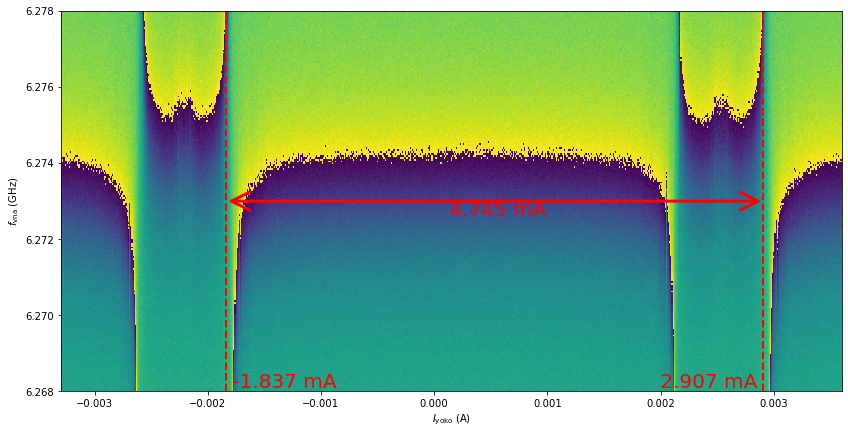

I0__q2 = 4.745 mA


In [99]:
#%matplotlib widget
%matplotlib inline


fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current__fs_rough, f_vna__fs_rough*1e-9, phase__fs_rough.T)

I_ss_low__fs = -0.0018375
ax.axvline(x=I_ss_low__fs,color='red',ls='--',lw=2)
ax.text(s=' {} mA'.format(round(I_ss_low__fs*1e3,3)), x=I_ss_low__fs, y=ax.get_ylim()[0], ha='left', va='bottom', color ='red',
        size=20)

I_ss_up__fs = 0.0029075
ax.axvline(x=I_ss_up__fs,color='red',ls='--',lw=2)
ax.text(s=' {} mA '.format(round(I_ss_up__fs*1e3,3)), x=I_ss_up__fs, y=ax.get_ylim()[0], ha='right', va='bottom', color ='red',
        size=20)

Anzahl_Perioden = 1
I0_c2 = (I_ss_up__fs - I_ss_low__fs)/Anzahl_Perioden


ax.annotate(xy=(I_ss_low__fs,np.mean(ax.get_ylim())),xytext=(I_ss_up__fs,np.mean(ax.get_ylim())), text='', arrowprops=dict(arrowstyle='<->,head_length=1.8,head_width=0.9',
                                        lw=3,color='red'))
ax.text(s=' {} mA'.format(round(I0_c2*1e3*Anzahl_Perioden,5)), x=I_ss_low__fs+I0_c2/2*Anzahl_Perioden, y=np.mean(ax.get_ylim()), ha='center', va='top', color ='red',
        size=20)

#ax.set_xlim([0,0.34*1e-3])

ax.set_xlabel(r'$I_{\rm yoko}$ (A)')
ax.set_ylabel(r'$f_{\rm vna}$ (GHz)')
plt.show()

print('I0__q2 = {} mA'.format(I0_c2*1e3))

### Fine

In [100]:
#data_dir = 'C:\\Users\\soere\\Soeren\\GFQ\\Messungen'
#cooldown_dir = '\\CS_BF_TH__2023-02-08_*'
#measurement_dir = '\\Messdaten\\qO19'

measurement_files = '\\S9VQGI_2D_GFQ_bG1_x_FS__fvna_6p268_6p278_GHz__Pvna_m50_dBm__I_m3p3_to_3p6_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

f_vna__fs, current__fs, phase__fs, amp__fs = [],[],[],[]
for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs.append(h5.data.frequency[:])
    current__fs.append(h5.data.current[:])
    phase__fs.append(h5.data.phase[:])
    amp__fs.append(h5.data.amplitude[:])

#### Extract Points

In [101]:
Extract_Points = False
kk = 0

In [102]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(current__fs[kk],f_vna__fs[kk], phase__fs[kk].T)

    xtract.set_points()

In [103]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)

    
else:
    
    x0__fs = [0.0013099226776208239,0.0015438334701337675,0.0017227064291142537,0.0019290983048609687,0.0020254145135427688,0.002080452347075226,0.002107971263841455,0.0021217307222245697,0.0021217307222245697,0.0021217307222245697,0.0021217307222245697]
    y0__fs = [6274129431.1082735,6274036989.503635,6273821292.426146,6273513153.744018,6272958504.116188,6272157343.542655,6271325369.10091,6270524208.527377,6269723047.953845,6268983515.116738,6268305610.016057]
    
    x1__fs = [0.0021767685557570263,0.0021492496389907984,0.0021767685557570263,0.002204287472523255,0.0022455658476725985,0.0023281225979712846,0.0024657171818024274,0.002520755015334885,0.002589552307250457,0.002685868515932257,0.002795944182997172,0.0028785009332958572,0.002892260391678972,0.002892260391678972,0.002906019850062086]
    y1__fs = [6277796281.425595,6277149190.193127,6276348029.619595,6275855007.728189,6275300358.10036,6275023033.286445,6275207916.495721,6275577682.914274,6275269544.232147,6275023033.286445,6275331171.968573,6276070704.805679,6276656168.301723,6277180004.061339,6277796281.425595]

    x2__fs = [0.0029610576835945434,0.002988576600360772,0.002988576600360772,0.003002336058743887,0.003016095517127001,0.0030711333506594583,0.003181209017724373,0.0033325630599386306,0.003511436018919117]
    y2__fs = [6268213168.411419,6269014328.984951,6270062000.504186,6271078858.155208,6272188157.410868,6272804434.775124,6273359084.402954,6273759664.68972,6273944547.898997]

   
x__c2_fs = [x0__fs, x1__fs, x2__fs]
y__c2_fs = [y0__fs, y1__fs, y2__fs]


for i in range (0,len(x__c2_fs)):
    x__c2_fs[i] = np.array(x__c2_fs[i])
    y__c2_fs[i] = np.array(y__c2_fs[i])
    idx_sort = np.argsort(x__c2_fs[i])
    x__c2_fs[i] = x__c2_fs[i][idx_sort]
    y__c2_fs[i] = y__c2_fs[i][idx_sort]

#### Plot

I_ss__c2_fs= 2.54 mA
fr_ss__c2= 6.27544 GHz


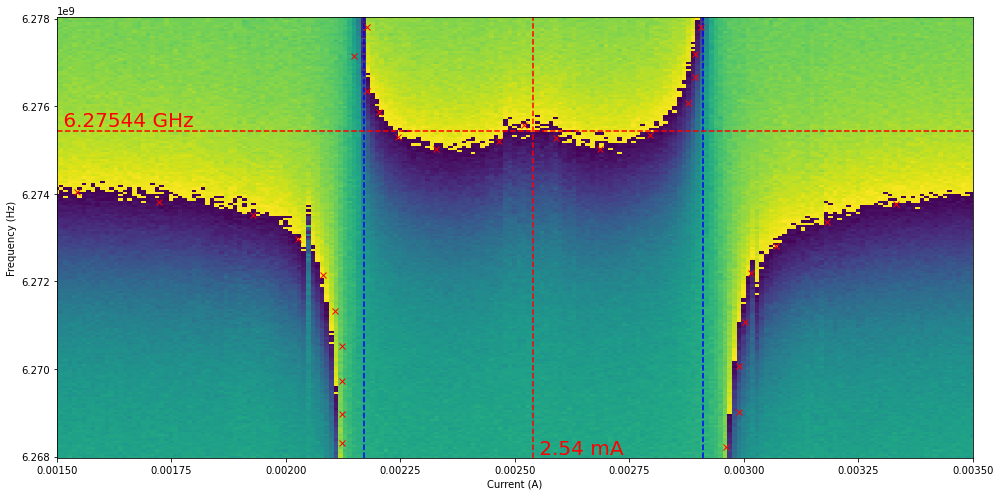

In [104]:
#%matplotlib widget
%matplotlib inline

fig, ax = plt.subplots(1,1, figsize = (14,7))

kk = 0
ax.pcolor(current__fs[kk], f_vna__fs[kk], phase__fs[kk].T,shading='auto')


if True:
    I_ss__c2_fs = 0.00254
    ax.axvline(x=I_ss__c2_fs,ls='--',color='red')
    ax.text(s=' {} mA'.format(round(I_ss__c2_fs*1e3,5)),x=I_ss__c2_fs, y=ax.get_ylim()[0], ha='left', va='bottom', size=20,color='red')
    print('I_ss__c2_fs= {} mA'.format(round(I_ss__c2_fs*1e3,5)))
    
    ax.axvline(x=0.00217, ls='--', color='blue')
    ax.axvline(x=0.00291, ls='--', color='blue')    
    #print((-0.000541+0.000565)/2)

ax.set_xlim([0.0015,0.0035])
if True:
    fr_ss__c2=6.27544*1e9
    ax.axhline(y=fr_ss__c2, ls='--', color='red')
    ax.text(s=' {} GHz'.format(round(fr_ss__c2*1e-9,5)),x=ax.get_xlim()[0],y=fr_ss__c2, ha='left', va='bottom', size=20,color='red')
    print('fr_ss__c2= {} GHz'.format(round(fr_ss__c2*1e-9,5)))

for i in range(0,len(x__c2_fs)):
    ax.plot(x__c2_fs[i], y__c2_fs[i], marker='x',color='red',ls='')

ax.set_xlabel('Current (A)')
ax.set_ylabel('Frequency (Hz)')


fig.tight_layout()
plt.show()

In [105]:
with open('f_vna__fs_q2_coil2.pkl', 'wb') as f:
    pickle.dump(f_vna__fs, f)  
with open('current__fs_q2_coil2.pkl', 'wb') as f:
    pickle.dump(current__fs, f)
with open('phase__fs_q2_coil2.pkl', 'wb') as f:
    pickle.dump(phase__fs, f)
with open('current__fres_q2_coil2', 'wb') as f:
    pickle.dump(x__c2_fs, f)
with open('fres__fres_q2_coil2.pkl', 'wb') as f:
    pickle.dump(y__c2_fs, f)

In [106]:
phi__fs, x_phi__c2_fs = [],[]
for i in range (0,len(x__c2_fs)):    
    x_phi__c2_fs.append((x__c2_fs[i] - I_ss__c2_fs + I0_c2/2  ) /I0_c2)
    
for i in range (0,len(current__fs)): 
    phi__fs.append((current__fs[i] - I_ss__c2_fs + I0_c2/2  ) /I0_c2)

I_ss__c2_fs= 2.54 mA
fr_ss__c2= 6.27544 GHz


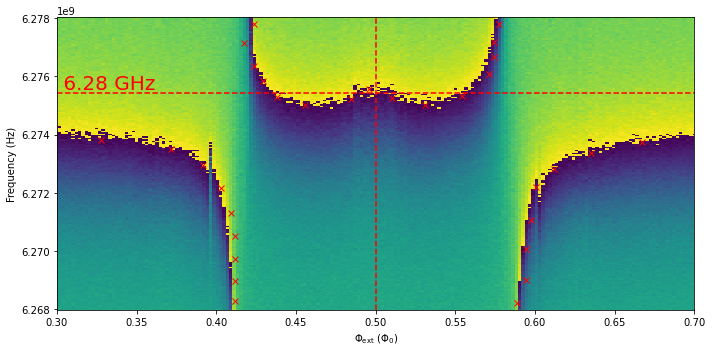

In [107]:
%matplotlib inline
fig, ax = plt.subplots(1,1, figsize = (10,5))


ax.pcolor(phi__fs[kk], f_vna__fs[kk], phase__fs[kk].T,shading='auto',vmin=-np.pi,vmax=np.pi)


#ax.axvline(x=I_low_mean, ls='--',color='blue',lw=1)
#ax.axvline(x=I_high_mean, ls='--',color='blue',lw=1)

phi_0p5 = 0.5
ax.axvline(x=phi_0p5,ls='--',color='red')
print('I_ss__c2_fs= {} mA'.format(round(I_ss__c2_fs*1e3,5)))


ax.set_xlim([0.3,0.7])
ax.axhline(y=fr_ss__c2, ls='--', color='red')
ax.text(s=' {} GHz'.format(round(fr_ss__c2*1e-9,2)),x=ax.get_xlim()[0],y=fr_ss__c2, ha='left', va='bottom', size=20,color='red')
print('fr_ss__c2= {} GHz'.format(round(fr_ss__c2*1e-9,5)))

for i in range(0,len(x__c2_fs)):
    ax.plot(x_phi__c2_fs[i], y__c2_fs[i], marker='x',color='red',ls='')

ax.set_xlabel(r'$\Phi_{\rm ext}$ ($\Phi_0$)')
ax.set_ylabel('Frequency (Hz)')


fig.tight_layout()
plt.show()

In [108]:
print(x_phi__c2_fs[0][-1],y__c2_fs[0][-1])
print(x_phi__c2_fs[1][0],y__c2_fs[1][0])
print(x_phi__c2_fs[1][-1],y__c2_fs[1][-1])
print(x_phi__c2_fs[2][0],y__c2_fs[2][0])

0.4118505210167691 6268305610.016057
0.4176500819790934 6277149190.193127
0.5771380084430107 6277796281.425595
0.5887371303676593 6268213168.411419


### coil1

In [109]:
measurement_files = '\\S9VQ8X_2D_GFQ_bG1_x_FS__fvna_6p268_6p278_GHz__Pvna_m50_dBm__I_m50p0_to_50p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs = h5.data.frequency[:]
    current__fs = h5.data.current[:]
    phase__fs = h5.data.phase[:]
    amp__fs = h5.data.amplitude[:]

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/4218414730.py:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(current__fs, f_vna__fs*1e-9, phase__fs.T)


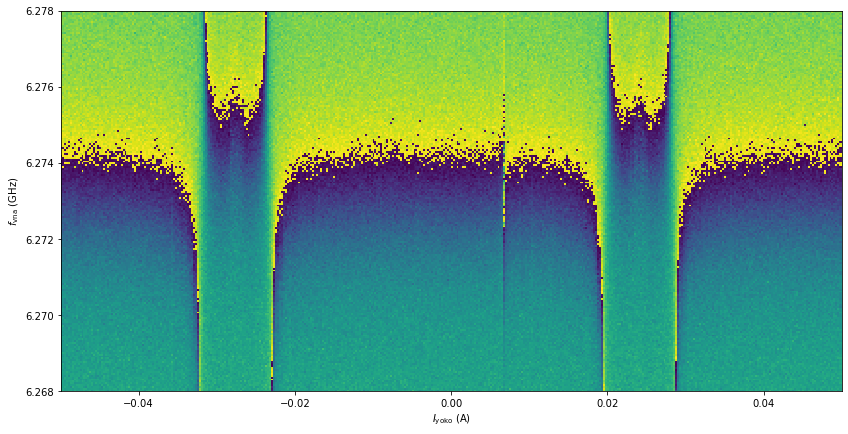

In [110]:
#%matplotlib widget
%matplotlib inline


fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current__fs, f_vna__fs*1e-9, phase__fs.T)

ax.set_xlabel(r'$I_{\rm yoko}$ (A)')
ax.set_ylabel(r'$f_{\rm vna}$ (GHz)')
plt.show()

In [111]:
measurement_files = '\\S9VQ8X_2D_GFQ_bG1_x_FS__fvna_6p268_6p278_GHz__Pvna_m50_dBm__I_m50p0_to_50p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

f_vna__fs, current__fs, phase__fs, amp__fs = [],[],[],[]
for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs.append(h5.data.frequency[:])
    current__fs.append(h5.data.current[:])
    phase__fs.append(h5.data.phase[:])
    amp__fs.append(h5.data.amplitude[:])

In [112]:
Extract_Points = False
kk = 0

C:\Users\Simon Geisert\Code\qkit\qkit\analysis\CurveXtractor.py:157: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(self.xvals, self.yvals, self.zvals)


True

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
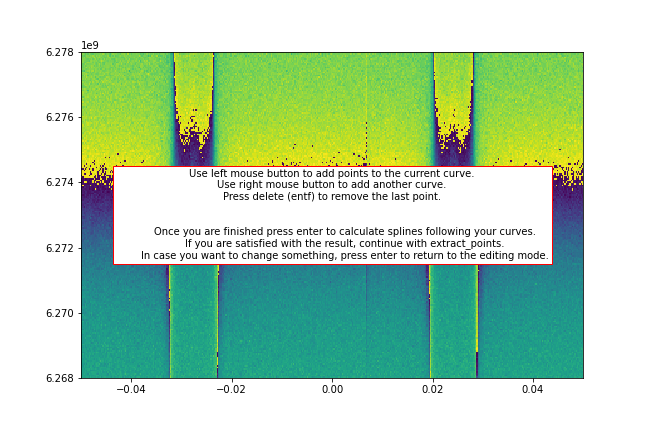

In [113]:
%matplotlib widget

xtract = CurveXtractor()
xtract.set_data(current__fs[kk],f_vna__fs[kk], phase__fs[kk].T)

xtract.set_points()

In [114]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)

    
else:
    
    x0__fs = [0.00548049,0.00557566,0.0060356,0.0064321,0.00662242,0.0067493
,0.00687619,0.00692377,0.00679689,0.00686033,0.00698721,0.00712995
,0.00755817,0.00824016,0.0087794,]
    y0__fs = [6.27410640e+09,6.27413680e+09,6.27413680e+09,6.27434957e+09
,6.27453195e+09,6.27486631e+09,6.27544385e+09,6.27617337e+09
,6.27097555e+09,6.27237379e+09,6.27319450e+09,6.27358966e+09
,6.27383283e+09,6.27398481e+09,6.27401521e+09]

In [115]:
with open('f_vna__fs_q2_coil1.pkl', 'wb') as f:
    pickle.dump(f_vna__fs, f)  
with open('current__fs_q2_coil1.pkl', 'wb') as f:
    pickle.dump(current__fs, f)
with open('phase__fs_q2_coil1.pkl', 'wb') as f:
    pickle.dump(phase__fs, f)
with open('current__fres_q2_coil1', 'wb') as f:
    pickle.dump(x0__fs, f)
with open('fres__fres_q2_coil1.pkl', 'wb') as f:
    pickle.dump(y0__fs, f)

### coil3

In [116]:
measurement_files = '\\S9VR48_2D_GFQ_bG1_x_FS__fvna_6p268_6p278_GHz__Pvna_m50_dBm__I_m50p0_to_50p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs = h5.data.frequency[:]
    current__fs = h5.data.current[:]
    phase__fs = h5.data.phase[:]
    amp__fs = h5.data.amplitude[:]
    
with open('f_vna__fs_q2_coil3.pkl', 'wb') as f:
    pickle.dump(f_vna__fs, f)  
with open('current__fs_q2_coil3.pkl', 'wb') as f:
    pickle.dump(current__fs, f)
with open('phase__fs_q2_coil3.pkl', 'wb') as f:
    pickle.dump(phase__fs, f)

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/4218414730.py:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(current__fs, f_vna__fs*1e-9, phase__fs.T)


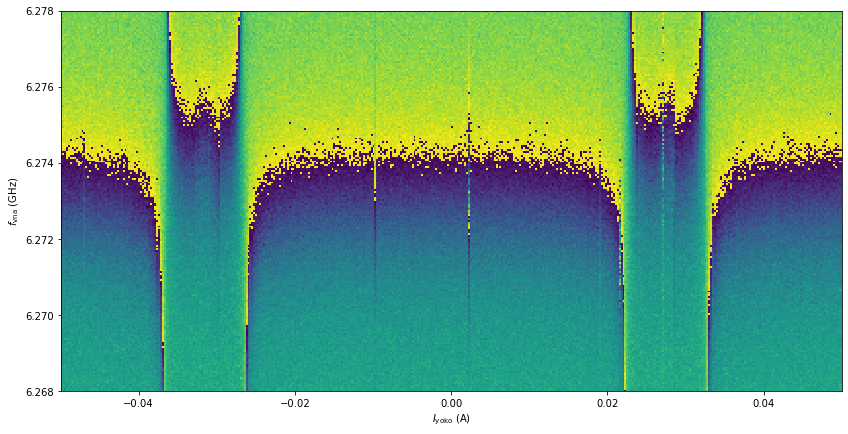

In [117]:
#%matplotlib widget
%matplotlib inline


fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current__fs, f_vna__fs*1e-9, phase__fs.T)

ax.set_xlabel(r'$I_{\rm yoko}$ (A)')
ax.set_ylabel(r'$f_{\rm vna}$ (GHz)')
plt.show()

## Two Tone

### Lower SS

In [118]:
#data_dir = 'C:\\Users\\soere\\Soeren\\GFQ\\Messungen'
#cooldown_dir = '\\CS_BF_TH__2023-02-08_*'
#measurement_dir = '\\Messdaten\\qO19'

measurement_files = 'S9W1AC_3D_GFQ_bG1_x_TT_FS__Iy_m2p33_m2p08mA__fmw_3p44_4p0GHz__Pvna_m50p0dBm__Pmw_m25p0dBm.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

f_mw__tt,current__tt,phase__tt,amp__tt=[],[],[],[]
for File in LoadFiles:
    
    h5 = Data(File)  
    
    f_mw__tt.append(h5.data.mw_freq[:])
    current__tt.append(h5.data.current[:])
    phase__tt.append(h5.data.phase[:])
    amp__tt.append(h5.data.amplitude[:])

#### Extract Points

In [119]:
Extract_Points = False
kk = 0

In [120]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(current__tt[kk],f_mw__tt[kk], np.unwrap(phase__tt[kk][:,:,1].T))

    xtract.set_points()

In [121]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)
    
    
else:
    
    x0__tt = np.array([-0.00232583,-0.00231587,-0.00230641,-0.00229347,-0.00227854,-0.0022651,-0.00224867,-0.00223622,-0.00222477,-0.00221283,-0.00220586,-0.00219341,-0.00217649,-0.00215956,-0.00214413,-0.00213069,-0.00211924,-0.0021048,-0.00209485,-0.00208539])
    y0__tt = np.array([3.90400262e+09,3.83644375e+09,3.77234944e+09,3.69959374e+09,3.63030259e+09,3.56447600e+09,3.50211397e+09,3.47266524e+09,3.45534245e+09,3.44321650e+09,3.44321650e+09,3.44668106e+09,3.46920068e+09,3.50557853e+09,3.55581461e+09,3.61990892e+09,3.68400323e+09,3.75502665e+09,3.82431780e+09,3.88148299e+09])
    
x__c2_tt_low = [x0__tt]
y__c2_tt_low = [y0__tt] 


In [122]:
with open('x__q2_tt_low_q2.pkl', 'wb') as f:
    pickle.dump(x0__tt , f)
with open('y__q2_tt_low_q2.pkl', 'wb') as f:
    pickle.dump(y0__tt , f)

#### Plot

I_ss__c2_tt_low= -2.205 mA


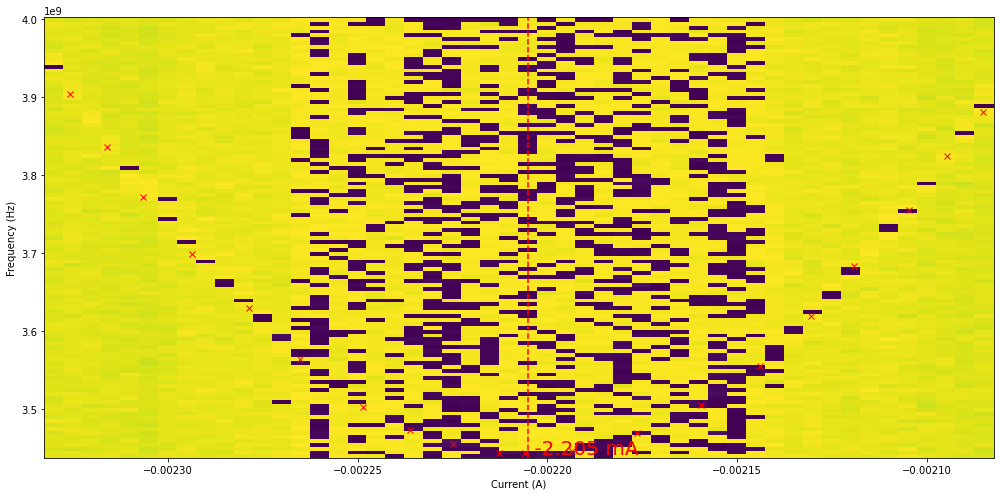

In [123]:
#%matplotlib widget
%matplotlib inline

fig, ax = plt.subplots(1,1, figsize = (14,7))

kk = 0
ax.pcolor(current__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')
#for kk in range(0,len(LoadFiles)):
#    ax.pcolor(current__c2_tt[kk], f_mw__c2_tt[kk], phase__c2_tt[kk][:,:,1].T,shading='auto')

I_ss__c2_tt_low = -0.002205


    
ax.axvline(x=I_ss__c2_tt_low,ls='--',color='red')
ax.text(s=' {} mA'.format(round(I_ss__c2_tt_low*1e3,5)),x=I_ss__c2_tt_low, y=ax.get_ylim()[0], ha='left', va='bottom', size=20,color='red')
print('I_ss__c2_tt_low= {} mA'.format(round(I_ss__c2_tt_low*1e3,5)))


ax.plot(x__c2_tt_low[kk], y__c2_tt_low[kk], marker='x',color='red',ls='')
#for kk in range(0,len(x__tt)):
#    if kk==0: ax.plot(x__tt[kk], y__tt[kk], marker='x',color='red',ls='')

ax.set_xlabel('Current (A)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()

In [124]:
phi__tt, x_phi__c2_tt_low = [],[]
for i in range (0,len(x__c2_tt_low)):    
    x_phi__c2_tt_low.append((x__c2_tt_low[i] - I_ss__c2_tt_low + I0_c2/2  ) /I0_c2)
    
for i in range (0,len(LoadFiles)): 
    phi__tt.append((current__tt[i] - I_ss__c2_tt_low + I0_c2/2  ) /I0_c2)

I_ss__c2_tt_low= -2.205 mA


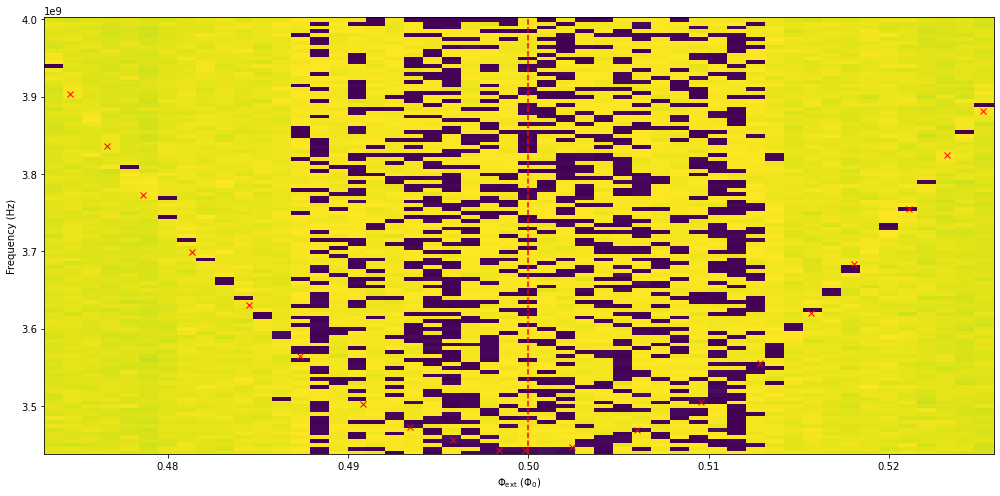

In [125]:
fig, ax = plt.subplots(1,1, figsize = (14,7))

#kk = 0
#ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')
for kk in range(0,len(LoadFiles)):
    ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')

phi_0p5 = 0.5
ax.axvline(x=phi_0p5,ls='--',color='red')
print('I_ss__c2_tt_low= {} mA'.format(round(I_ss__c2_tt_low*1e3,5)))


for i in range(0,len(x__c2_tt_low)):
    ax.plot(x_phi__c2_tt_low[i], y__c2_tt_low[i], marker='x',color='red',ls='')

ax.set_xlabel(r'$\Phi_{\rm ext}$ ($\Phi_0$)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()

### Upper SS

In [126]:
#data_dir = 'C:\\Users\\soere\\Soeren\\GFQ\\Messungen'
#cooldown_dir = '\\CS_BF_TH__2023-02-08_*'
#measurement_dir = '\\Messdaten\\qO19'

measurement_files = 'S9W1KA_3D_GFQ_bG1_x_TT_FS__Iy_m2p9_m2p65mA__fmw_6p4_7p9GHz__Pvna_m50p0dBm__Pmw_0p0dBm.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

f_mw__tt,current__tt,phase__tt,amp__tt=[],[],[],[]
for File in LoadFiles:
    
    h5 = Data(File)  
    
    f_mw__tt.append(h5.data.mw_freq[:])
    current__tt.append(h5.data.current[:])
    phase__tt.append(h5.data.phase[:])
    amp__tt.append(h5.data.amplitude[:])

#### Extract Points

In [127]:
Extract_Points = False
kk = 0

In [128]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(current__tt[kk],f_mw__tt[kk], phase__tt[kk][:,:,1].T)

    xtract.set_points()

In [129]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)
    
    
else:
    
    x0__tt = np.array([-0.00288687,-0.00287044,-0.00284953,-0.00282265,-0.0027893,-0.00275843,-0.00273155,-0.00270666,-0.00267729])
    y0__tt = np.array([7.88507332e+09,7.80201592e+09,7.70511563e+09,7.57591524e+09,7.42825765e+09,7.25291426e+09,7.09602806e+09,6.93914187e+09,6.75456988e+09])
    
x__c2_tt_up = [x0__tt]
y__c2_tt_up = [y0__tt] 


In [130]:
with open('x__q2_tt_up_q2.pkl', 'wb') as f:
    pickle.dump(x0__tt , f)
with open('y__q2_tt_up_q2.pkl', 'wb') as f:
    pickle.dump(y0__tt , f)

#### Plot

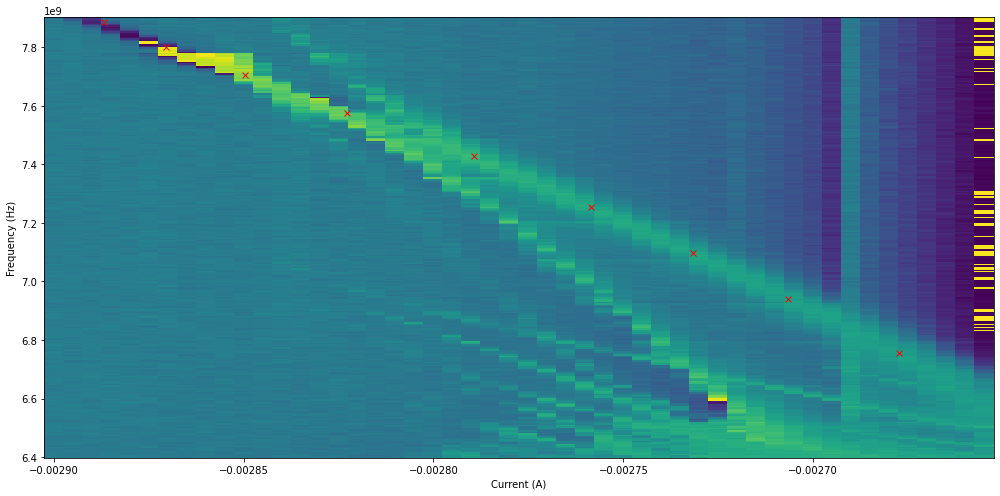

In [131]:
#%matplotlib widget
%matplotlib inline


fig, ax = plt.subplots(1,1, figsize = (14,7))

kk = 0
ax.pcolor(current__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')
#for kk in range(0,len(LoadFiles)):
#    ax.pcolor(current__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')

#I_ss__c2_tt_up = I_ss__c2_tt_low-I0_c2/2

    
#ax.axvline(x=I_ss__c2_tt_up,ls='--',color='red')
#ax.text(s=' {} mA'.format(round(I_ss__c2_tt_up*1e3,5)),x=I_ss__c2_tt_up, y=ax.get_ylim()[0], ha='left', va='bottom', size=20,color='red')
#print('I_ss__c2_tt_up= {} mA'.format(round(I_ss__c2_tt_up*1e3,5)))


ax.plot(x__c2_tt_up[kk], y__c2_tt_up[kk], marker='x',color='red',ls='')
#for kk in range(0,len(x__tt)):
#    if kk==0: ax.plot(x__tt[kk], y__tt[kk], marker='x',color='red',ls='')

ax.set_xlabel('Current (A)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()

In [132]:
phi__tt, x_phi__c2_tt_up = [],[]
for i in range (0,len(x__c2_tt_up)):    
    x_phi__c2_tt_up.append((x__c2_tt_up[i] - I_ss__c2_tt_low + I0_c2/2  ) /I0_c2)
    
for i in range (0,len(LoadFiles)): 
    phi__tt.append((current__tt[i] - I_ss__c2_tt_low + I0_c2/2  ) /I0_c2)

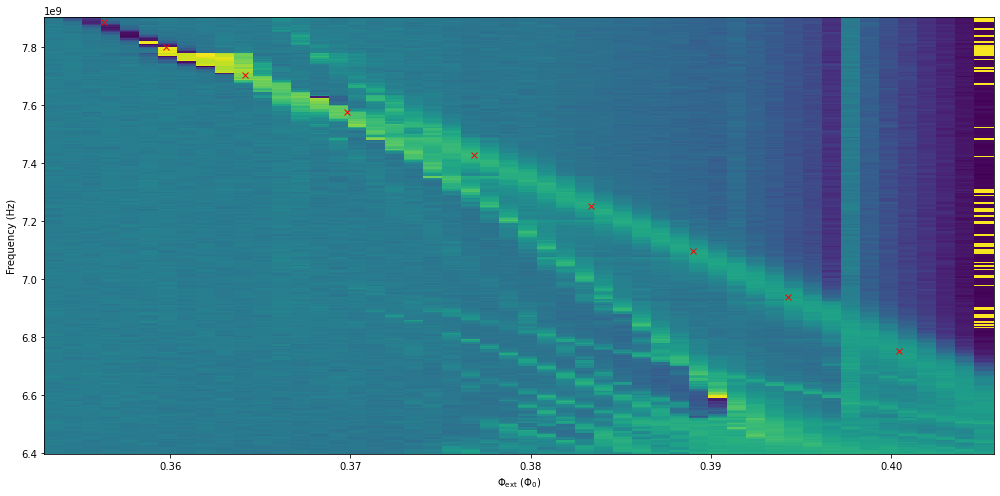

In [134]:
fig, ax = plt.subplots(1,1, figsize = (14,7))

#kk = 0
#ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')
for kk in range(0,len(LoadFiles)):
    ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')

#phi_0p0 = 0
#ax.axvline(x=phi_0p0,ls='--',color='red')
#print('I_ss__c2_tt_up= {} mA'.format(round(I_ss__c2_tt_up*1e3,5)))


for i in range(0,len(x__c2_tt_up)):
    ax.plot(x_phi__c2_tt_up[i], y__c2_tt_up[i], marker='x',color='red',ls='')

ax.set_xlabel(r'$\Phi_{\rm ext}$ ($\Phi_0$)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()

### Fit spectrum on ordered points

In [160]:
#x_all_phi__tt = np.append(x_phi__tt,np.array([0.28707099272675674,0.33447585557180204,0.6694480678395299,0.7147010410494198]))
#y_all__tt = np.append(y__tt,np.array([6570924793.458997,6667462297.093502,6666352022.900062,6570498121.105631]))

x_all_phi__c2_tt = np.append(x_phi__c2_tt_low[0],x_phi__c2_tt_up[0])
y_all__c2_tt = np.append(y__c2_tt_low[0],y__c2_tt_up[0])


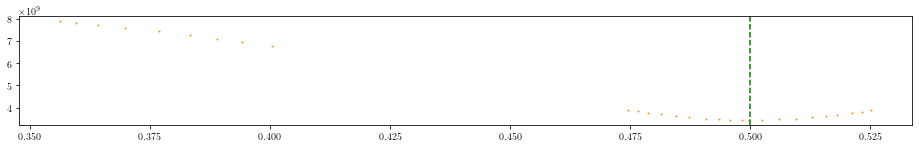

In [161]:
plt.figure(figsize=(16,2))

plt.plot(x_all_phi__c2_tt, y_all__c2_tt, ls='', marker='o', ms=1, color=orange)
plt.axvline(x=0.5,color='green',ls='--')
plt.show()

In [162]:
if False:
    Lq = 20e-9
    Cq = 15e-15
    Ej = 15  # in GHz, Ej = Phi_0 * Ic/ (2 * pi)
    N = 40

    # Fit nur an 1erstes Level
    X = [x_all_phi__c2_tt]
    Y = [y_all__c2_tt]
    # Fit mit 1ersten und 2ten level
    #X = [X01, X02]
    #Y = [Y01, Y02]

    flux = [[] for i in range (0,len(X))] 
    fmw = [[] for i in range (0,len(Y))] 
    
    for ii in range(0,len(X)):
        X_fit,Y_fit=[],[]
        for jj in range(0,len(X[ii])):
            if True:
                X_fit.append(X[ii])
                Y_fit.append(Y[ii])

        X_fit = np.array(X_fit) 
        Y_fit = np.array(Y_fit)  

        flux[ii] = X_fit*2*np.pi
        fmw[ii] = Y_fit*1e-9

    g = [np.zeros((len(flux[i]), 3)) for i in range (0,len(X))]

    for ii in range(0,len(g)):
        g[ii][:, 0] = flux[0][ii]
        g[ii][:, 1] = fmw[0][ii]
        g[ii][:, 2] = ii+1

    measured_data = g[0]
    for ii in range(0,len(g)-1):
        measured_data = np.vstack((measured_data, g[ii+1]))
        
    fit = FitFlx.FitFluxonium()
    fit.set_initial_value(data=measured_data, L=Lq, C=Cq, Ej=Ej, N=N)
    fit.fit(max_nfev = 20)
    
    #----------------------------------------------------------    
    
    fig = plt.figure(figsize=(4, 4))
    ax = fig.add_subplot(111)

    fit.set_figure(fig, ax)
    fit.plot_fit()
    #fit.ax.set_xlim([1.5, 4.5])
    #fit.ax.set_ylim([0, 25])
    fit.ax.set_ylabel('E/h (GHz)')
    fit.ax.set_xlabel(r'$\phi_{\rm ext}$   $(2\pi \cdot \Phi_0)$')
    plt.show()  

    #------------------

    fig = plt.figure(figsize=(4, 4))
    ax = fig.add_subplot(111)
    fit.set_figure(fig, ax)
    fit.plot_fit()
    fit.ax.set_xlim([0.45*2*np.pi,0.55*2*np.pi])
    fit.ax.set_ylim([3.35,4])
    fit.ax.set_ylabel('E/h (GHz)')
    fit.ax.set_xlabel(r'$\phi_{\rm ext}$   $(2\pi \cdot \Phi_0)$')

#    ax.plot(x_phi__tt *2*np.pi, y__tt,ls='',marker='x',color='magenta',ms=5)

    #-------------------------------------------------

    fq_fit = np.amin(fit.E_fit)
    print('fq= {} GHz'.format(fq_fit))

In [163]:
Lq_c2_fit= 20.209864006982137 #nH
Cq_c2_fit= 22.696349564033657 #fF
Ej_c2_fit= 9.566174150228457 #GHz

fq_c2_fit = 3.4367589720937435  #GHz

# qS16 coupling (with bG1 & qR7)

In [135]:
Qubit_Name = 'qS16'

data_dir = url_to_GFQ_folder
cooldown_dir = '\\CS_BF_TH__2024_03_07__qR7_bG1_qS16__Coupling__Isolation__Paper2'
measurement_dir = '\\Messdaten\\'

## Readout-Fit from Flux Sweep

In [136]:
measurement_files = '\\S9W3PY_2D_GFQ_qS16_x_FS__fvna_5p19_5p24_GHz__Pvna_m50_dBm__I_m3p0_to_3p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

File=[]
for i in range(0,len(LoadFiles)):
    File.append(LoadFiles[i])
    
    h5 = Data(File[i])
    f_vna = h5.data.frequency[:]
    current = h5.data.current[:]
    phase = h5.data.phase[:]
    amp = h5.data.amplitude[:]

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/2168998597.py:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(current, f_vna*1e-9, phase.T)


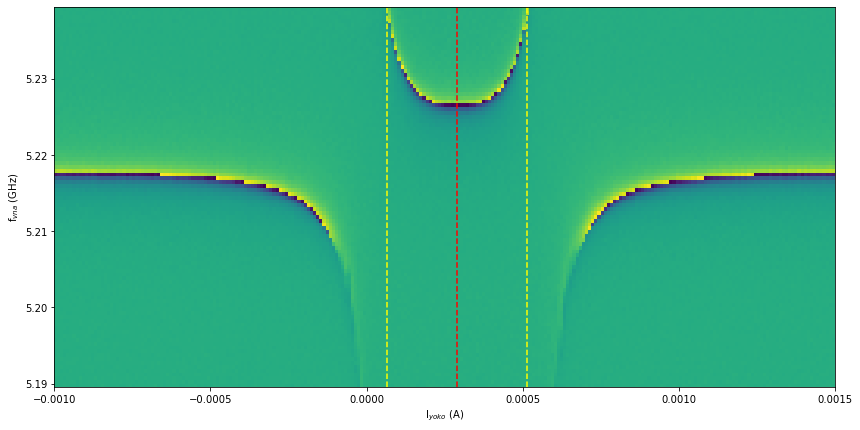

In [137]:
%matplotlib inline
#%matplotlib widget

fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current, f_vna*1e-9, phase.T)

ax.set_xlim([-0.001,0.0015])

ax.axvline(x=6.49*1e-5,color='yellow',ls='--')
ax.axvline(x=0.0005138,color='yellow',ls='--')
ax.axvline(x=0.000289,color='red',ls='--')

ax.set_xlabel(r'I$_{yoko}$ (A)')
ax.set_ylabel(r'f$_{vna}$ (GHz)')
plt.show()

In [138]:
def cost_function(x,amp,phase):
    imag = x[0]
    real = x[1]
    return np.abs((np.sqrt(real**2+imag**2)-amp))*10 + np.abs(np.arctan2(imag,real)-phase)*10


def FKT__find_nearest_index(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx

idx = FKT__find_nearest_index(current, 0.000289)

phase_at_idx = phase[idx,:]
amp_at_idx = amp[idx,:]

In [139]:
minimize__max_iterations = 2000
minimize_tolerance = 1e-4 #Absolute error in xopt between iterations that is acceptable for convergence.

Sij=np.zeros(len(amp_at_idx)).astype(complex)

for i in range(0,len(phase_at_idx)):
    
    x0=[0.6,0.6]
    bounds=((-3,3),(-3,3))
    res = minimize(cost_function,x0,args=(amp_at_idx[i],phase_at_idx[i]),
                   bounds = bounds, method = 'Nelder-Mead',
                   options={'maxiter':minimize__max_iterations, 'xatol':minimize_tolerance})
  
    imag = res.x[0]
    real = res.x[1]
    Sij[i] = real + 1j * imag
    
    print('')
    print('')
#    print('Sij',Sij[i], real, np.real(Sij[i]), imag, np.imag(Sij[i]))
#    print('amp',np.sqrt(real**2+imag**2), np.sqrt(np.real(Sij[i])**2+np.imag(Sij[i])**2),amp_at_idx[i])
#    print('Hallo',res.x)
    print('')
    print('')

    
reSij = np.real(Sij)
imSij = np.imag(Sij) 
absSij = np.sqrt(reSij**2+imSij**2)
absSij_dB = 20*np.log10(absSij)
argSij = np.arctan2(imSij,reSij)

print('')    
print('fertig')  


















































































































































































































































































































































































































fertig


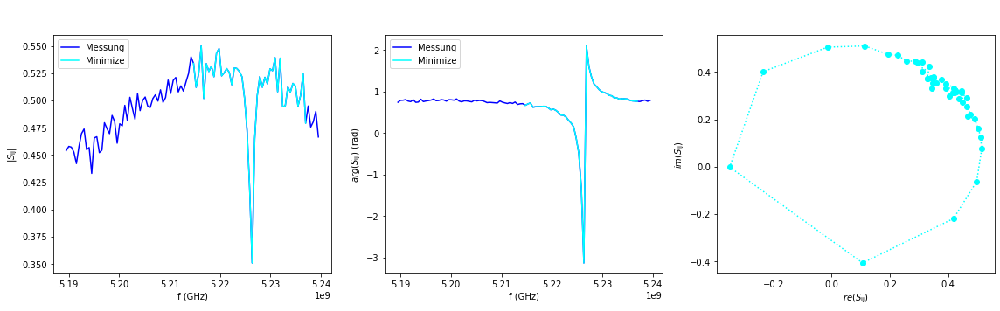

In [140]:
fig,ax = plt.subplots(1,3,figsize = (16,5))
fig.suptitle('   ', fontsize=20, ha='left',x=0.05)

b=50
t=-5
ax[0].plot(f_vna, amp_at_idx, color='blue', label='Messung')
ax[0].plot(f_vna[b:t], absSij[b:t], color='cyan', label='Minimize')
ax[0].set_xlabel(r'f (GHz)')
ax[0].set_ylabel(r'$|S_{\rm ij}|$')
ax[0].legend()
    
ax[1].plot(f_vna, phase_at_idx, color='blue', label='Messung')
ax[1].plot(f_vna[b:t], argSij[b:t] , color='cyan', label='Minimize')
ax[1].set_xlabel(r'f (GHz)')
ax[1].set_ylabel(r'$arg(S_{\rm ij})$ (rad)')
ax[1].legend()
    
ax[2].plot(reSij[b:t], imSij[b:t],ls=':',marker='o', color='cyan')
ax[2].set_xlabel(r'$re(S_{\rm ij})$')
ax[2].set_ylabel(r'$im(S_{\rm ij})$')

plt.tight_layout()
plt.show()

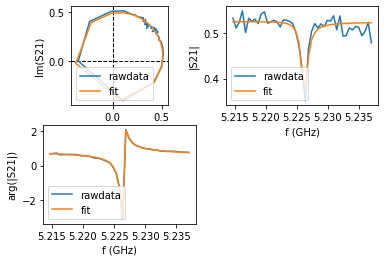



{'delay': 1.037006236992266e-09, 'delay_remaining': -1.7631346756474865e-10, 'a': 0.5252883571455835, 'alpha': -2.9271003199162235, 'theta': 0.2335183475644973, 'phi': 0.019026013890928617, 'fr': 5226169839.145779, 'Ql': 3907.4379421531826, 'Qc': 4592.207185754759, 'Qc_no_dia_corr': 4591.376046113964, 'Qi': 26204.104175985696, 'Qi_no_dia_corr': 26231.199673454248, 'fr_err': 30217.667908997715, 'Ql_err': 214.49007616920585, 'absQc_err': 142.13048137977356, 'phi_err': 0.024573121642149972, 'Qi_err': 6551.91126564742, 'Qi_no_dia_corr_err': 6582.756807853157, 'chi_square': 0.0015879144427296118}

fr_q3_mean= 5.226 GHz
Df_q3_mean= 1.337 MHz


In [141]:
fit = reflection_port(f_data = f_vna[b:t], z_data_raw = Sij[b:t])
fit.autofit()
    
fr_q3 = fit.fitresults['fr']
Qi_q3 = fit.fitresults['Qi']
Qc_q3 = fit.fitresults['Qc']
Ql_q3 = fit.fitresults['Ql']

fit.plotall()

print('')
print('')
print(fit.fitresults)
print('')
Df_q3 = fr_q3/Ql_q3
Df_q3_mean = np.mean(Df_q3)
fr_q3_mean = np.mean(fr_q3)
print('fr_q3_mean= {} GHz'.format(np.round(fr_q3_mean*1e-9,3)))
print('Df_q3_mean= {} MHz'.format(np.round(Df_q3_mean*1e-6,3)))

## Flux-Sweep

### Rough

In [142]:
measurement_files = '\\S9W3PY_2D_GFQ_qS16_x_FS__fvna_5p19_5p24_GHz__Pvna_m50_dBm__I_m3p0_to_3p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs_rough = h5.data.frequency[:]
    current__fs_rough = h5.data.current[:]
    phase__fs_rough = h5.data.phase[:]
    amp__fs_rough = h5.data.amplitude[:]
    

In [143]:
with open('f_vna__fs_rough_q3_coil3.pkl', 'wb') as f:
    pickle.dump(f_vna__fs_rough, f)  
with open('current__fs_rough_q3_coil3.pkl', 'wb') as f:
    pickle.dump(current__fs_rough, f)
with open('phase__fs_rough_q3_coil3.pkl', 'wb') as f:
    pickle.dump(phase__fs_rough, f)

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/1078826278.py:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(current__fs_rough, f_vna__fs_rough*1e-9, phase__fs_rough.T)


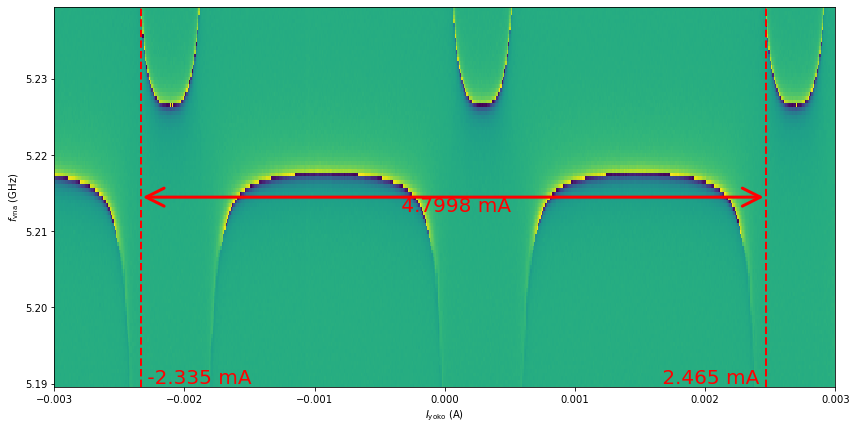

I0__q3 = 2.3999 mA


In [144]:
#%matplotlib widget
%matplotlib inline


fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current__fs_rough, f_vna__fs_rough*1e-9, phase__fs_rough.T)

I_ss_low__fs = -0.002335
ax.axvline(x=I_ss_low__fs,color='red',ls='--',lw=2)
ax.text(s=' {} mA'.format(round(I_ss_low__fs*1e3,3)), x=I_ss_low__fs, y=ax.get_ylim()[0], ha='left', va='bottom', color ='red',
        size=20)

I_ss_up__fs = 0.0024648
ax.axvline(x=I_ss_up__fs,color='red',ls='--',lw=2)
ax.text(s=' {} mA '.format(round(I_ss_up__fs*1e3,3)), x=I_ss_up__fs, y=ax.get_ylim()[0], ha='right', va='bottom', color ='red',
        size=20)

Anzahl_Perioden = 2
I0_q3 = (I_ss_up__fs - I_ss_low__fs)/Anzahl_Perioden


ax.annotate(xy=(I_ss_low__fs,np.mean(ax.get_ylim())),xytext=(I_ss_up__fs,np.mean(ax.get_ylim())), text='', arrowprops=dict(arrowstyle='<->,head_length=1.8,head_width=0.9',
                                        lw=3,color='red'))
ax.text(s=' {} mA'.format(round(I0_q3*1e3*Anzahl_Perioden,5)), x=I_ss_low__fs+I0_q3/2*Anzahl_Perioden, y=np.mean(ax.get_ylim()), ha='center', va='top', color ='red',
        size=20)

#ax.set_xlim([0,0.34*1e-3])

ax.set_xlabel(r'$I_{\rm yoko}$ (A)')
ax.set_ylabel(r'$f_{\rm vna}$ (GHz)')
plt.show()

print('I0__q3 = {} mA'.format(I0_q3*1e3))

### Fine

In [145]:
#data_dir = 'C:\\Users\\soere\\Soeren\\GFQ\\Messungen'
#cooldown_dir = '\\CS_BF_TH__2023-02-08_*'
#measurement_dir = '\\Messdaten\\qO19'

measurement_files = '\\S9W3PY_2D_GFQ_qS16_x_FS__fvna_5p19_5p24_GHz__Pvna_m50_dBm__I_m3p0_to_3p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

f_vna__fs, current__fs, phase__fs, amp__fs = [],[],[],[]
for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs.append(h5.data.frequency[:])
    current__fs.append(h5.data.current[:])
    phase__fs.append(h5.data.phase[:])
    amp__fs.append(h5.data.amplitude[:])

#### Extract Points

In [146]:
Extract_Points = False
kk = 0

In [147]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(current__fs[kk],f_vna__fs[kk], phase__fs[kk].T)

    xtract.set_points()

In [148]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)

    
else:
    
    x0__fs = [-0.0006665807512375179,-0.0005349399706720062,-0.00037936450273094637,-0.0002357563784776604,-0.00017591966003879106,-0.00012805028528769602,-9.214825422437442e-05,-5.624622316105325e-05,-3.231153578550552e-05,-3.231153578550552e-05]
    y0__fs = [5217414228.42239,5217104533.484292,5216175448.669997,5214472126.510458,5212304261.94377,5209517007.500887,5205336125.836561,5200535854.29604,5195890430.224566,5192019243.49834]
    
    x1__fs = [5.145987002891112e-05,6.342721371668542e-05,8.736190109223316e-05,0.00012326393215555433,0.00018310065059442323,0.0002908067437843876,0.000398512836974352,0.00045834955541322175,0.0004822842427887695,0.0005062189301643163]
    y1__fs = [5238628331.682116,5235686229.770183,5232124737.982054,5229492331.008219,5227324466.441532,5226550229.096287,5227943856.317728,5231350500.636808,5234757144.955888,5237854094.33687]

    x2__fs = [0.0005780229922909596,0.0005780229922909596,0.0006139250233542816,0.0006498270544176028,0.0006976964291686982,0.0008054025223586626,0.001008847365050817,0.0012601615824940678]
    y2__fs = [5191090158.684045,5194961345.410273,5199606769.481745,5205336125.836561,5209981549.908034,5214317279.041409,5216175448.669997,5217259380.9533415]

   
x__q3_fs = [x0__fs, x1__fs, x2__fs]
y__q3_fs = [y0__fs, y1__fs, y2__fs]


for i in range (0,len(x__q3_fs)):
    x__q3_fs[i] = np.array(x__q3_fs[i])
    y__q3_fs[i] = np.array(y__q3_fs[i])
    idx_sort = np.argsort(x__q3_fs[i])
    x__q3_fs[i] = x__q3_fs[i][idx_sort]
    y__q3_fs[i] = y__q3_fs[i][idx_sort]

#### Plot

I_ss__q3_fs= 0.29 mA
fr_ss__q3= 5.22635 GHz


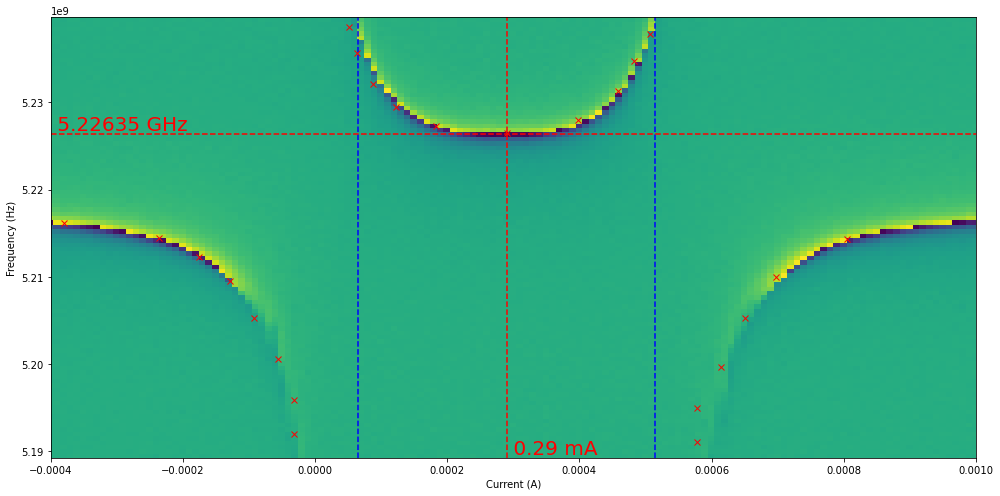

In [149]:
#%matplotlib widget
%matplotlib inline

fig, ax = plt.subplots(1,1, figsize = (14,7))

kk = 0
ax.pcolor(current__fs[kk], f_vna__fs[kk], phase__fs[kk].T,shading='auto')


if True:
    I_ss__q3_fs = 0.00029
    ax.axvline(x=I_ss__q3_fs,ls='--',color='red')
    ax.text(s=' {} mA'.format(round(I_ss__q3_fs*1e3,5)),x=I_ss__q3_fs, y=ax.get_ylim()[0], ha='left', va='bottom', size=20,color='red')
    print('I_ss__q3_fs= {} mA'.format(round(I_ss__q3_fs*1e3,5)))
    
    ax.axvline(x=6.505*1e-5, ls='--', color='blue')
    ax.axvline(x=0.000514, ls='--', color='blue')    
    #print((-0.000541+0.000565)/2)

ax.set_xlim([-0.0004,0.001])

if True:
    fr_ss__q3=5.22635*1e9
    ax.axhline(y=fr_ss__q3, ls='--', color='red')
    ax.text(s=' {} GHz'.format(round(fr_ss__q3*1e-9,5)),x=ax.get_xlim()[0],y=fr_ss__q3, ha='left', va='bottom', size=20,color='red')
    print('fr_ss__q3= {} GHz'.format(round(fr_ss__q3*1e-9,5)))

for i in range(0,len(x__q3_fs)):
    ax.plot(x__q3_fs[i], y__q3_fs[i], marker='x',color='red',ls='')

ax.set_xlabel('Current (A)')
ax.set_ylabel('Frequency (Hz)')


fig.tight_layout()
plt.show()

In [150]:
with open('f_vna__fs_q3_coil3.pkl', 'wb') as f:
    pickle.dump(f_vna__fs, f)  
with open('current__fs_q3_coil3.pkl', 'wb') as f:
    pickle.dump(current__fs, f)
with open('phase__fs_q3_coil3.pkl', 'wb') as f:
    pickle.dump(phase__fs, f)
with open('current__fres_q3_coil3', 'wb') as f:
    pickle.dump(x__q3_fs, f)
with open('fres__fres_q3_coil3.pkl', 'wb') as f:
    pickle.dump(y__q3_fs, f)

In [151]:
phi__fs, x_phi__q3_fs = [],[]
for i in range (0,len(x__q3_fs)):    
    x_phi__q3_fs.append((x__q3_fs[i] - I_ss__q3_fs + I0_q3/2  ) /I0_q3)
    
for i in range (0,len(current__fs)): 
    phi__fs.append((current__fs[i] - I_ss__q3_fs + I0_q3/2  ) /I0_q3)

I_ss__q3_fs= 0.29 mA
fr_ss__q3= 5.22635 GHz


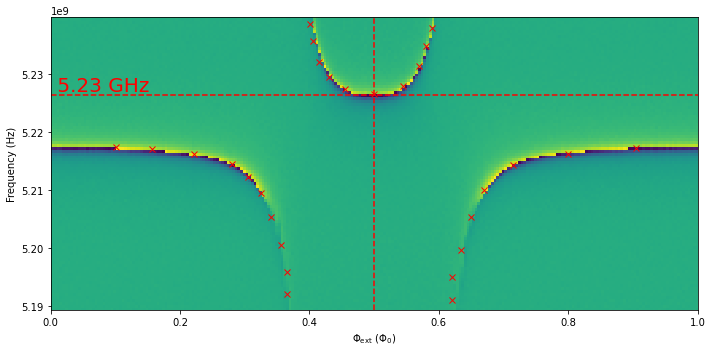

In [152]:
%matplotlib inline
fig, ax = plt.subplots(1,1, figsize = (10,5))


ax.pcolor(phi__fs[kk], f_vna__fs[kk], phase__fs[kk].T,shading='auto',vmin=-np.pi,vmax=np.pi)


#ax.axvline(x=I_low_mean, ls='--',color='blue',lw=1)
#ax.axvline(x=I_high_mean, ls='--',color='blue',lw=1)

phi_0p5 = 0.5
ax.axvline(x=phi_0p5,ls='--',color='red')
print('I_ss__q3_fs= {} mA'.format(round(I_ss__q3_fs*1e3,5)))


ax.set_xlim([0,1])
ax.axhline(y=fr_ss__q3, ls='--', color='red')
ax.text(s=' {} GHz'.format(round(fr_ss__q3*1e-9,2)),x=ax.get_xlim()[0],y=fr_ss__q3, ha='left', va='bottom', size=20,color='red')
print('fr_ss__q3= {} GHz'.format(round(fr_ss__q3*1e-9,5)))

for i in range(0,len(x__q3_fs)):
    ax.plot(x_phi__q3_fs[i], y__q3_fs[i], marker='x',color='red',ls='')

ax.set_xlabel(r'$\Phi_{\rm ext}$ ($\Phi_0$)')
ax.set_ylabel('Frequency (Hz)')


fig.tight_layout()
plt.show()

In [153]:
print(x_phi__q3_fs[0][-1],y__q3_fs[0][-1])
print(x_phi__q3_fs[1][0],y__q3_fs[1][0])
print(x_phi__q3_fs[1][-1],y__q3_fs[1][-1])
print(x_phi__q3_fs[2][0],y__q3_fs[2][0])

0.3656979308364909 5192019243.49834
0.4006041376844498 5238628331.682116
0.5900949748590844 5237854094.33687
0.6200145807287636 5191090158.684045


### coil1

In [154]:
measurement_files = '\\S9W37B_2D_GFQ_qS16_x_FS__fvna_5p19_5p24_GHz__Pvna_m50_dBm__I_m110p0_to_110p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs = h5.data.frequency[:]
    current__fs = h5.data.current[:]
    phase__fs = h5.data.phase[:]
    amp__fs = h5.data.amplitude[:]
    

with open('f_vna__fs_q3_coil1.pkl', 'wb') as f:
    pickle.dump(f_vna__fs, f)  
with open('current__fs_q3_coil1.pkl', 'wb') as f:
    pickle.dump(current__fs, f)
with open('phase__fs_q3_coil1.pkl', 'wb') as f:
    pickle.dump(phase__fs, f)

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/4218414730.py:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(current__fs, f_vna__fs*1e-9, phase__fs.T)


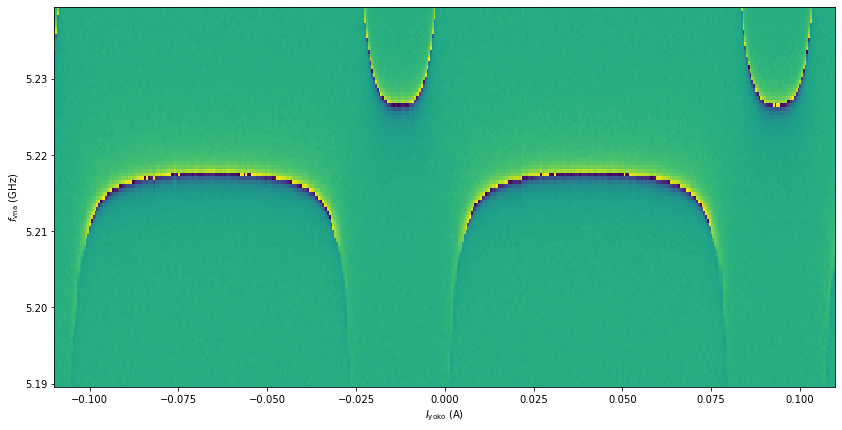

In [155]:
#%matplotlib widget
%matplotlib inline


fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current__fs, f_vna__fs*1e-9, phase__fs.T)

ax.set_xlabel(r'$I_{\rm yoko}$ (A)')
ax.set_ylabel(r'$f_{\rm vna}$ (GHz)')
plt.show()

### coil2

In [156]:
measurement_files = '\\S9W3K6_2D_GFQ_qS16_x_FS__fvna_5p19_5p24_GHz__Pvna_m50_dBm__I_40p0_to_m40p0_mA.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

for File in LoadFiles:
    h5 = Data(File)  
    
    f_vna__fs = h5.data.frequency[:]
    current__fs = h5.data.current[:]
    phase__fs = h5.data.phase[:]
    amp__fs = h5.data.amplitude[:]
    
with open('f_vna__fs_q3_coil2.pkl', 'wb') as f:
    pickle.dump(f_vna__fs, f)  
with open('current__fs_q3_coil2.pkl', 'wb') as f:
    pickle.dump(current__fs, f)
with open('phase__fs_q3_coil2.pkl', 'wb') as f:
    pickle.dump(phase__fs, f)

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/4218414730.py:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(current__fs, f_vna__fs*1e-9, phase__fs.T)


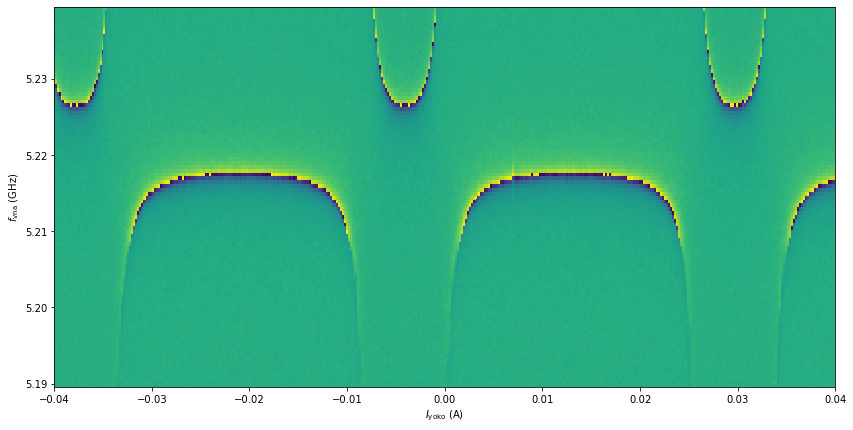

In [157]:
#%matplotlib widget
%matplotlib inline


fig,ax = plt.subplots(1,1,figsize = (14,7))

ax.pcolor(current__fs, f_vna__fs*1e-9, phase__fs.T)

ax.set_xlabel(r'$I_{\rm yoko}$ (A)')
ax.set_ylabel(r'$f_{\rm vna}$ (GHz)')
plt.show()

## Two Tone

### Lower SS

In [165]:
#data_dir = 'C:\\Users\\soere\\Soeren\\GFQ\\Messungen'
#cooldown_dir = '\\CS_BF_TH__2023-02-08_*'
#measurement_dir = '\\Messdaten\\qO19'

measurement_files = 'S9X854_3D_GFQ_qS16_x_TT_FS__Iy_0p14_0p44mA__fmw_3p05_3p75GHz__Pvna_m50p0dBm__Pmw_m10p0dBm.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
print(LoadFiles)

f_mw__tt,current__tt,phase__tt,amp__tt=[],[],[],[]
for File in LoadFiles:
    
    h5 = Data(File)  
    
    f_mw__tt.append(h5.data.mw_freq[:])
    current__tt.append(h5.data.current[:])
    phase__tt.append(h5.data.phase[:])
    amp__tt.append(h5.data.amplitude[:])

['C:\\Users\\Simon Geisert\\DINGS\\CS_BF_TH__2024_03_07__qR7_bG1_qS16__Coupling__Isolation__Paper2\\Messdaten\\S9X854_3D_GFQ_qS16_x_TT_FS__Iy_0p14_0p44mA__fmw_3p05_3p75GHz__Pvna_m50p0dBm__Pmw_m10p0dBm.h5']


#### Extract Points

In [166]:
Extract_Points = False
kk = 0

In [167]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(current__tt[kk],f_mw__tt[kk], phase__tt[kk][:,:,1].T)

    xtract.set_points()

In [168]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)
    
    
else:
    
    x0__tt = np.array([0.00016929,0.00017944,0.00018781,0.00019916,0.00020872,0.00021887,0.00022962,0.00024038,0.00024934,0.00025949,0.00026905,0.000281,0.00028936,0.00029892,0.00031027,0.00031983,0.00032998,0.00034014,0.0003497,0.00035985,0.00036821,0.00037897,0.00038972,0.00039928])
    y0__tt = np.array([3.71332791e+09,3.60883931e+09,3.54571079e+09,3.45646011e+09,3.38462420e+09,3.31496514e+09,3.25401346e+09,3.20394601e+09,3.15387856e+09,3.11469533e+09,3.09510372e+09,3.08204265e+09,3.07986580e+09,3.08857319e+09,3.10598795e+09,3.13428695e+09,3.18870809e+09,3.23442185e+09,3.28884299e+09,3.35414836e+09,3.42598427e+09,3.49999703e+09,3.56747924e+09,3.66979099e+09])
    
x__q3_tt_low = [x0__tt]
y__q3_tt_low = [y0__tt] 

In [169]:
with open('x__q3_tt_low_q3.pkl', 'wb') as f:
    pickle.dump(x0__tt , f)
with open('y__q3_tt_low_q3.pkl', 'wb') as f:
    pickle.dump(y0__tt , f)

#### Plot

I_ss__q3_tt_low= 0.29 mA


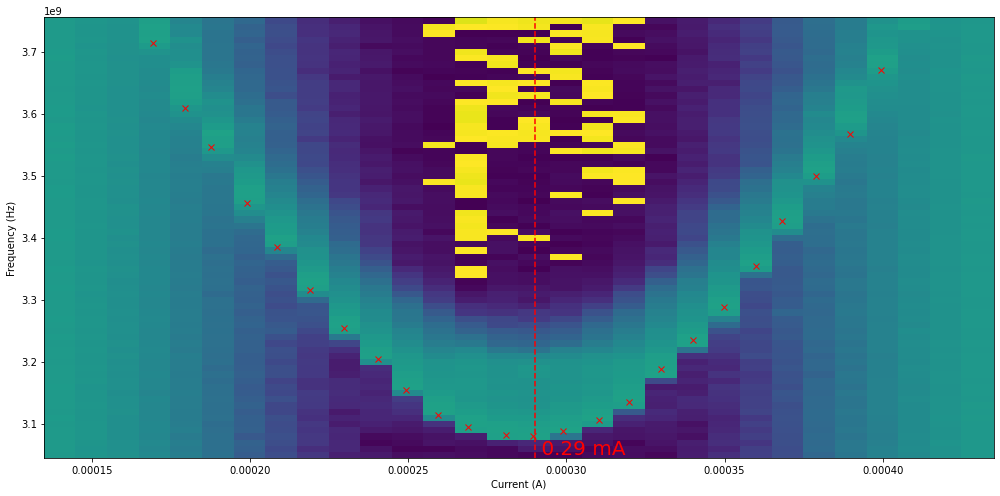

In [170]:
#%matplotlib widget
%matplotlib inline

fig, ax = plt.subplots(1,1, figsize = (14,7))

kk = 0
ax.pcolor(current__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')
#for kk in range(0,len(LoadFiles)):
#    ax.pcolor(current__q3_tt[kk], f_mw__q3_tt[kk], phase__q3_tt[kk][:,:,1].T,shading='auto')

I_ss__q3_tt_low = 0.00029

    
ax.axvline(x=I_ss__q3_tt_low,ls='--',color='red')
ax.text(s=' {} mA'.format(round(I_ss__q3_tt_low*1e3,5)),x=I_ss__q3_tt_low, y=ax.get_ylim()[0], ha='left', va='bottom', size=20,color='red')
print('I_ss__q3_tt_low= {} mA'.format(round(I_ss__q3_tt_low*1e3,5)))


ax.plot(x__q3_tt_low[kk], y__q3_tt_low[kk], marker='x',color='red',ls='')
#for kk in range(0,len(x__tt)):
#    if kk==0: ax.plot(x__tt[kk], y__tt[kk], marker='x',color='red',ls='')

ax.set_xlabel('Current (A)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()

In [171]:
phi__tt, x_phi__q3_tt_low = [],[]
for i in range (0,len(x__q3_tt_low)):    
    x_phi__q3_tt_low.append((x__q3_tt_low[i] - I_ss__q3_tt_low + I0_q3/2  ) /I0_q3)
    
for i in range (0,len(LoadFiles)): 
    phi__tt.append((current__tt[i] - I_ss__q3_tt_low + I0_q3/2  ) /I0_q3)

I_ss__q3_tt_low= 0.29 mA


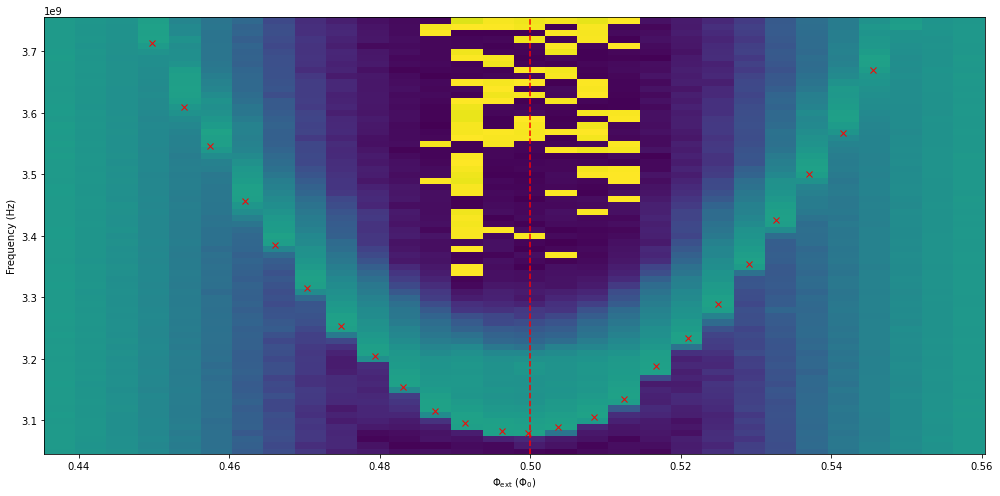

In [172]:
fig, ax = plt.subplots(1,1, figsize = (14,7))

#kk = 0
#ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')
for kk in range(0,len(LoadFiles)):
    ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')

phi_0p5 = 0.5
ax.axvline(x=phi_0p5,ls='--',color='red')
print('I_ss__q3_tt_low= {} mA'.format(round(I_ss__q3_tt_low*1e3,5)))


for i in range(0,len(x__q3_tt_low)):
    ax.plot(x_phi__q3_tt_low[i], y__q3_tt_low[i], marker='x',color='red',ls='')

ax.set_xlabel(r'$\Phi_{\rm ext}$ ($\Phi_0$)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()

### Upper SS

In [173]:
#data_dir = 'C:\\Users\\soere\\Soeren\\GFQ\\Messungen'
#cooldown_dir = '\\CS_BF_TH__2023-02-08_*'
#measurement_dir = '\\Messdaten\\qO19'

measurement_files = 'S9X894_3D_GFQ_qS16_x_TT_FS__Iy_1p19_1p79mA__fmw_7p5_7p75GHz__Pvna_m50p0dBm__Pmw_m10p0dBm.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
#print(LoadFiles)

f_mw__tt,current__tt,phase__tt,amp__tt=[],[],[],[]
for File in LoadFiles:
    
    h5 = Data(File)  
    
    f_mw__tt.append(h5.data.mw_freq[:])
    current__tt.append(h5.data.current[:])
    phase__tt.append(h5.data.phase[:])
    amp__tt.append(h5.data.amplitude[:])

#### Extract Points

In [174]:
Extract_Points = False
kk = 0

In [175]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(current__tt[kk],f_mw__tt[kk], phase__tt[kk][:,:,1].T)

    xtract.set_points()

In [176]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)
    
    
else:
    
    x0__tt_upper = np.array([0.00119885,0.00121828,0.00123772,0.00125715,0.00128023,0.00130817,0.00133489,0.00137254,0.0014102,0.00144664,0.00148308,0.00150615,0.00155717,0.00159847,0.00163491,0.00167013,0.00169686,0.00172722,0.00175152,0.00177338,0.00178917])
    y0__tt_upper = np.array([7.55984855e+09,7.57977741e+09,7.59970628e+09,7.62122946e+09,7.64195549e+09,7.66347867e+09,7.68101607e+09,7.70174209e+09,7.71768519e+09,7.72884536e+09,7.73283113e+09,7.73203398e+09,7.72326527e+09,7.70413356e+09,7.68500184e+09,7.66029005e+09,7.63796971e+09,7.60927214e+09,7.58137172e+09,7.55825424e+09,7.54071683e+09])
    
x__q3_tt_up = [x0__tt_upper]
y__q3_tt_up = [y0__tt_upper]

In [177]:
with open('x__q3_tt_up_q3.pkl', 'wb') as f:
    pickle.dump(x0__tt_upper , f)
with open('y__q3_tt_up_q3.pkl', 'wb') as f:
    pickle.dump(y0__tt_upper , f)

#### Plot

I_ss__q3_tt_up= 1.48995 mA


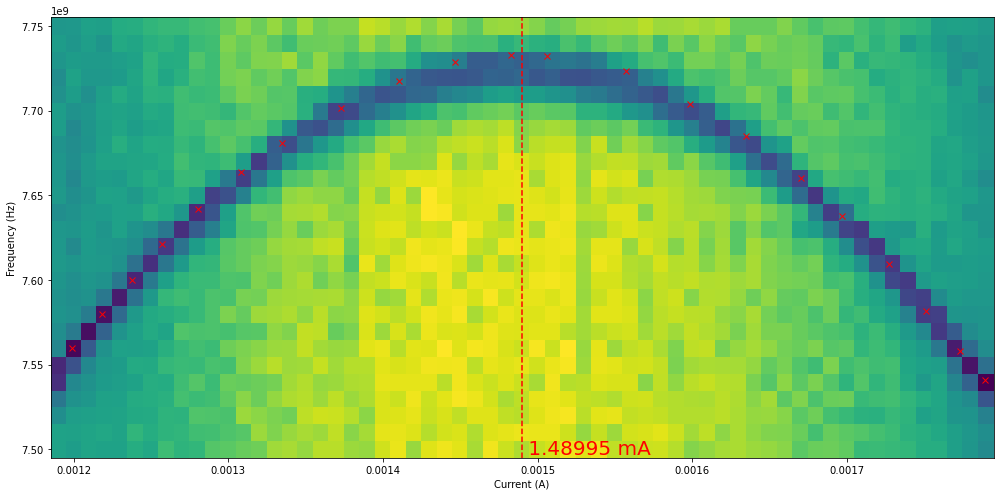

In [178]:
#%matplotlib widget
%matplotlib inline


fig, ax = plt.subplots(1,1, figsize = (14,7))

kk = 0
ax.pcolor(current__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')
#for kk in range(0,len(LoadFiles)):
#    ax.pcolor(current__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')

I_ss__q3_tt_up = I_ss__q3_tt_low+I0_q3/2

    
ax.axvline(x=I_ss__q3_tt_up,ls='--',color='red')
ax.text(s=' {} mA'.format(round(I_ss__q3_tt_up*1e3,5)),x=I_ss__q3_tt_up, y=ax.get_ylim()[0], ha='left', va='bottom', size=20,color='red')
print('I_ss__q3_tt_up= {} mA'.format(round(I_ss__q3_tt_up*1e3,5)))


ax.plot(x__q3_tt_up[kk], y__q3_tt_up[kk], marker='x',color='red',ls='')
#for kk in range(0,len(x__tt)):
#    if kk==0: ax.plot(x__tt[kk], y__tt[kk], marker='x',color='red',ls='')

ax.set_xlabel('Current (A)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()


In [179]:
phi__tt, x_phi__q3_tt_up = [],[]
for i in range (0,len(x__q3_tt_up)):    
    x_phi__q3_tt_up.append((x__q3_tt_up[i] - I_ss__q3_tt_low + I0_q3/2  ) /I0_q3)
    
for i in range (0,len(LoadFiles)): 
    phi__tt.append((current__tt[i] - I_ss__q3_tt_low + I0_q3/2  ) /I0_q3)

I_ss__q3_tt_up= 1.48995 mA


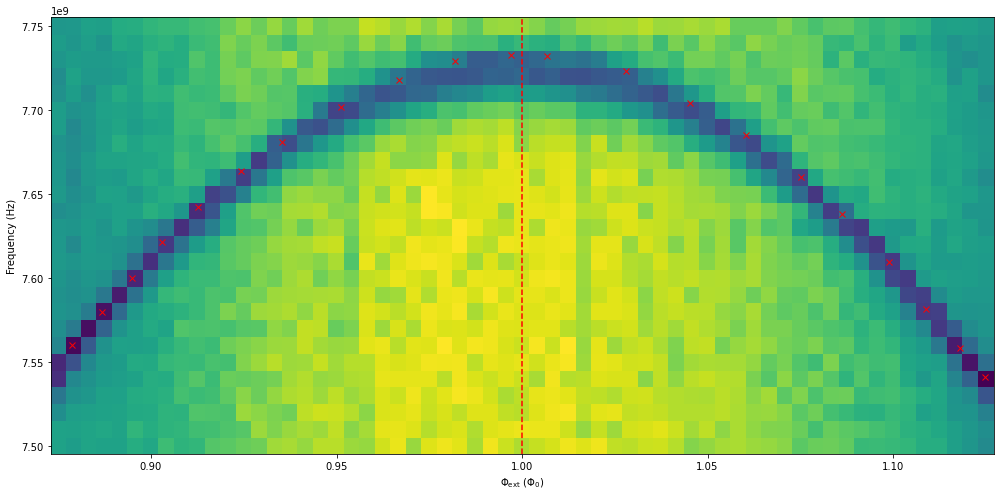

In [180]:
fig, ax = plt.subplots(1,1, figsize = (14,7))

#kk = 0
#ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')
for kk in range(0,len(LoadFiles)):
    ax.pcolor(phi__tt[kk], f_mw__tt[kk], phase__tt[kk][:,:,1].T,shading='auto')

phi_1p0 = 1
ax.axvline(x=phi_1p0,ls='--',color='red')
print('I_ss__q3_tt_up= {} mA'.format(round(I_ss__q3_tt_up*1e3,5)))


for i in range(0,len(x__q3_tt_up)):
    ax.plot(x_phi__q3_tt_up[i], y__q3_tt_up[i], marker='x',color='red',ls='')

ax.set_xlabel(r'$\Phi_{\rm ext}$ ($\Phi_0$)')
ax.set_ylabel('Frequency (Hz)')

#ax.set_xlim([0.2,0.8])
fig.tight_layout()
plt.show()

### Fit spectrum on ordered points

In [205]:
#x_all_phi__tt = np.append(x_phi__tt,np.array([0.28707099272675674,0.33447585557180204,0.6694480678395299,0.7147010410494198]))
#y_all__tt = np.append(y__tt,np.array([6570924793.458997,6667462297.093502,6666352022.900062,6570498121.105631]))

x_all_phi__q3_tt = np.append(x_phi__q3_tt_low[0],x_phi__q3_tt_up[0]-1)
y_all__q3_tt = np.append(y__q3_tt_low[0],y__q3_tt_up[0])

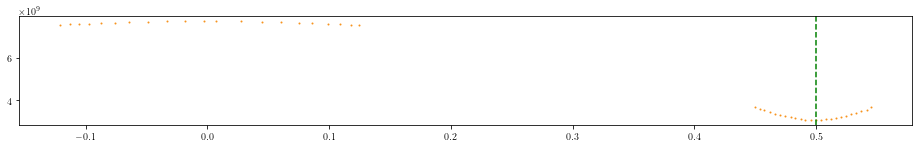

In [206]:
plt.figure(figsize=(16,2))

plt.plot(x_all_phi__q3_tt, y_all__q3_tt, ls='', marker='o', ms=1, color=orange)
plt.axvline(x=0.5,color='green',ls='--')
plt.show()

In [207]:
if False:
    Lq = 20e-9
    Cq = 15e-15
    Ej = 15  # in GHz, Ej = Phi_0 * Ic/ (2 * pi)
    N = 40

    # Fit nur an 1erstes Level
    X = [x_all_phi__q3_tt]
    Y = [y_all__q3_tt]
    # Fit mit 1ersten und 2ten level
    #X = [X01, X02]
    #Y = [Y01, Y02]

    flux = [[] for i in range (0,len(X))] 
    fmw = [[] for i in range (0,len(Y))] 
    
    for ii in range(0,len(X)):
        X_fit,Y_fit=[],[]
        for jj in range(0,len(X[ii])):
            if True:
                X_fit.append(X[ii])
                Y_fit.append(Y[ii])

        X_fit = np.array(X_fit) 
        Y_fit = np.array(Y_fit)  

        flux[ii] = X_fit*2*np.pi
        fmw[ii] = Y_fit*1e-9

    g = [np.zeros((len(flux[i]), 3)) for i in range (0,len(X))]

    for ii in range(0,len(g)):
        g[ii][:, 0] = flux[0][ii]
        g[ii][:, 1] = fmw[0][ii]
        g[ii][:, 2] = ii+1

    measured_data = g[0]
    for ii in range(0,len(g)-1):
        measured_data = np.vstack((measured_data, g[ii+1]))
        
    fit = FitFlx.FitFluxonium()
    fit.set_initial_value(data=measured_data, L=Lq, C=Cq, Ej=Ej, N=N)
    fit.fit(max_nfev = 20)
    
    #----------------------------------------------------------    
    
    fig = plt.figure(figsize=(4, 4))
    ax = fig.add_subplot(111)

    fit.set_figure(fig, ax)
    fit.plot_fit()
    #fit.ax.set_xlim([1.5, 4.5])
    #fit.ax.set_ylim([0, 25])
    fit.ax.set_ylabel('E/h (GHz)')
    fit.ax.set_xlabel(r'$\phi_{\rm ext}$   $(2\pi \cdot \Phi_0)$')
    plt.show()  

    #------------------

    fig = plt.figure(figsize=(4, 4))
    ax = fig.add_subplot(111)
    fit.set_figure(fig, ax)
    fit.plot_fit()
    fit.ax.set_xlim([0.45*2*np.pi,0.55*2*np.pi])
    fit.ax.set_ylim([3,3.8])
    fit.ax.set_ylabel('E/h (GHz)')
    fit.ax.set_xlabel(r'$\phi_{\rm ext}$   $(2\pi \cdot \Phi_0)$')

#    ax.plot(x_phi__tt *2*np.pi, y__tt,ls='',marker='x',color='magenta',ms=5)

    #-------------------------------------------------

    fq_fit = np.amin(fit.E_fit)
    print('fq= {} GHz'.format(fq_fit))

In [208]:
Lq_q3_fit= 31.592878179998774 #nH
Cq_q3_fit= 25.19639546818537 #fF
Ej_q3_fit= 5.577304886719048 #GHz

fq_q3_fit = 3.083839312615182  #GHz

## Measurment: Dispersive Shift

In [209]:
iqcloud = qkit.analysis.iq_cloud_analysis.IQCloudAnalysis()
iqcloud.set_up_gaussian_mixture_model(n_states=2) # , covariance_type='full')

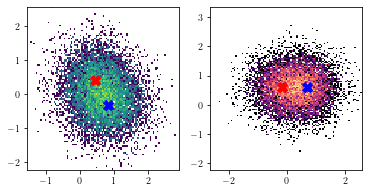

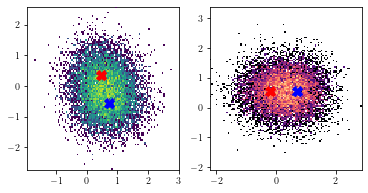

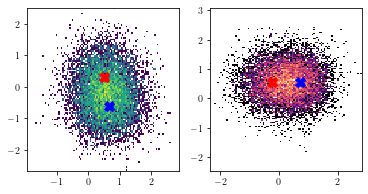

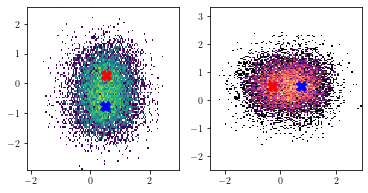

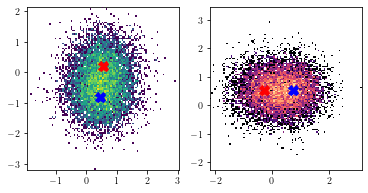

...

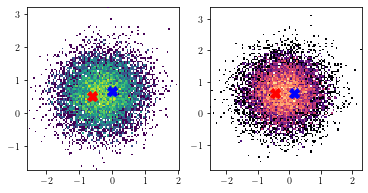

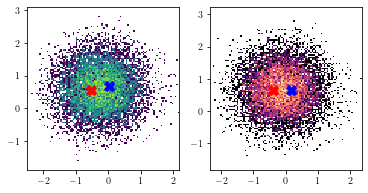

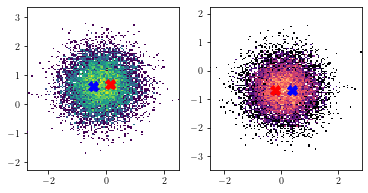

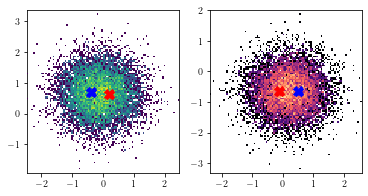

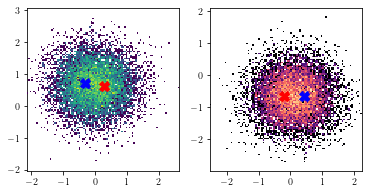

In [210]:
measurement_files = 'Q3_chi_SS\\*\\*.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

fr3 = 5.2273 *1e9
fr3_IF = 60e6
f_vec_q3 = fr3 - fr3_IF + np.arange(58.0e6, 61.0e6, 0.05e6)

number_of_points = 10000
I_q3, Q_q3 = [np.empty((len(LoadFiles),number_of_points)) for ii in range(0,2)]

S_q3, S_q3_rot = [np.empty((len(LoadFiles),number_of_points)).astype(complex) for ii in range(0,2)]

ref_pos_q3, ref_pos_q3_rot = [np.empty((len(LoadFiles),2)).astype(complex) for ii in range(0,2)]

Angle, Angle_rot = [np.empty((len(LoadFiles),2)) for ii in range(0,2)]


#weights_q3, ref_covar_q3 = [np.empty((len(LoadFiles),2)) for ii in range(0,2)]
#S_vec_q3 = np.empty((len(LoadFiles),2)).astype(complex)
#Winkel_vec_q3 = np.empty((len(LoadFiles),2))

dist_avg_q3, theta_q3 = [np.empty(len(LoadFiles)) for ii in range(0,2)]

for ii,File in enumerate(LoadFiles):
    
    h5 = Data(File)
    
    I_q3[ii] = h5.data.i[:]
    Q_q3[ii] = h5.data.q[:]
     
    iqcloud = qkit.analysis.iq_cloud_analysis.IQCloudAnalysis()
    iqcloud.set_up_gaussian_mixture_model(n_states=2)
    iqcloud.analyse_qubit_clouds(I_q3[ii], Q_q3[ii], fq=fq_q3_fit)

#    weights_q3[ii] = iqcloud.weights  
#    ref_covar_q3[ii] = iqcloud.covariances[0]

    dist_avg_q3[ii] = iqcloud.dist_avg
    theta_q3[ii] = iqcloud.theta

    ref_pos_q3[ii] = np.array([iqcloud.positions[0,0,0]+1j*iqcloud.positions[0,0,1],iqcloud.positions[0,1,0]+1j*iqcloud.positions[0,1,1]])
    ref_pos_q3_rot[ii] = ref_pos_q3[ii] * np.exp(-1j*theta_q3[ii]) 
    
    S_q3[ii] = (I_q3[ii]+1j*Q_q3[ii])/dist_avg_q3[ii]
    S_q3_rot[ii] = (I_q3[ii]+1j*Q_q3[ii])/dist_avg_q3[ii] * np.exp(-1j*theta_q3[ii])
    
#    delay = 0.1*1e-7
#    Angle[ii] = np.angle(ref_pos_q3[ii] * np.exp(-1j*delay*f_vec_q3[ii]))
#    Angle_rot[ii] = np.angle(ref_pos_q3_rot[ii] * np.exp(-1j*theta_q3[ii]))
#    Angle_rot[ii] = np.angle(ref_pos_q3_rot[ii] * np.exp(-1j*delay*f_vec_q3[ii]))

    # Plot Blobs for 
    if True:
        fig, (ax1,ax2) = plt.subplots(1,2, figsize = (6,3))
        ax1.hist2d(np.real(S_q3[ii]), np.imag(S_q3[ii]), bins = 100, norm = colors.LogNorm(),cmap='viridis',zorder=10)
        ax1.plot(np.real(ref_pos_q3[ii][0]), np.imag(ref_pos_q3[ii][0]), color='blue',marker='X',ms=10,ls='',zorder=100)
        ax1.plot(np.real(ref_pos_q3[ii][1]), np.imag(ref_pos_q3[ii][1]), color='red',marker='X',ms=10,ls='',zorder=100)
        ax1.axis('equal')
        ax2.hist2d(np.real(S_q3_rot[ii]), np.imag(S_q3_rot[ii]), bins = 100, norm = colors.LogNorm(),cmap='magma',zorder=10)
        ax2.plot(np.real(ref_pos_q3_rot[ii][0]), np.imag(ref_pos_q3_rot[ii][0]), color='blue',marker='X',ms=10,ls='',zorder=100)
        ax2.plot(np.real(ref_pos_q3_rot[ii][1]), np.imag(ref_pos_q3_rot[ii][1]), color='red',marker='X',ms=10,ls='',zorder=100)
        ax2.axis('equal')
        plt.show()

In [211]:
Angle_T,Angle_T = [np.empty((2,len(LoadFiles))) for ii in range(0,2)]
#delay = -29120*1e-10
delay_3a = -1550*1e-9
delay_3b = delay_3a
#delay_3b = -19000 *1e-10

for ii in range(0,len(f_vec_q3)):
    Angle[ii][0] = np.angle(ref_pos_q3[ii][0] * np.exp(-1j*delay_3a*f_vec_q3[ii]))
    Angle[ii][1] = np.angle(ref_pos_q3[ii][1] * np.exp(-1j*delay_3b*f_vec_q3[ii]))
    #Angle[ii][0] = np.angle(ref_pos_q3[ii][0]) 
    #Angle[ii][1] = np.angle(ref_pos_q3[ii][1])
    #Angle[ii][0] = np.arctan2(np.imag(ref_pos_q3[ii][0]),np.real(ref_pos_q3[ii][0]))
    #Angle[ii][1] = np.arctan2(np.imag(ref_pos_q3[ii][1]),np.real(ref_pos_q3[ii][1]))
    
Angle_T[0] = np.unwrap(Angle.T[0])
Angle_T[1] = np.unwrap(Angle.T[1])

def find_nearest_idx(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx

def fit_arctan(x,x0,n,f1,f2):
    return(f1*np.arctan((x-x0)*f2)+n)

#print(np.mean(f_vec_q3))
P0 = [np.mean(f_vec_q3),0,-2,1e-7]

try:
    popt_S0,pcov_S0 = curve_fit(fit_arctan, f_vec_q3, Angle_T[0], p0=P0)
    popt_S1,pcov_S1 = curve_fit(fit_arctan, np.append(f_vec_q3[:51],f_vec_q3[57:]), np.append(Angle_T[1][:51],Angle_T[1][57:]), p0=P0)

    f_vec_q3_fit = np.linspace(np.min(f_vec_q3)-0.1e7,np.max(f_vec_q3)+0.2e7,1001,True)
    #print(P0,popt_S0,popt_S1)

    Y_value = -0.9
    idx_S0 = find_nearest_idx(fit_arctan(f_vec_q3_fit,*popt_S0), Y_value)
    idx_S1 = find_nearest_idx(fit_arctan(f_vec_q3_fit,*popt_S1), Y_value)

    chi_q3 = np.abs(f_vec_q3_fit[idx_S0]-f_vec_q3_fit[idx_S1])
    print('chi= {:.3f} Hz = {:.3f} MHz'.format(chi_q3, chi_q3*1e-6))
    
except:
    print('No')
    

chi= 3451000.000 Hz = 3.451 MHz


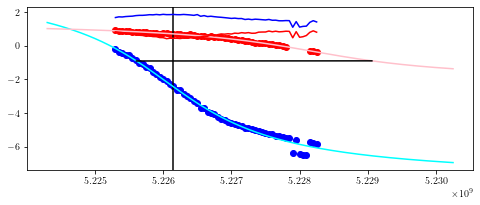

In [212]:
fig, (ax1) = plt.subplots(1,1, figsize = (8,3))

ax1.plot(f_vec_q3, Angle_T[0], color='blue', marker='o',ls='')
ax1.plot(np.append(f_vec_q3[:51],f_vec_q3[57:]), np.append(Angle_T[1][:51],Angle_T[1][57:]), color='red', marker='o',ls='')
ax1.axvline(x=fr3 - fr3_IF + 5.885*1e7,color='black',ls='-')

ax1.plot(f_vec_q3_fit, fit_arctan(f_vec_q3_fit,*popt_S0), color='cyan')
ax1.plot(f_vec_q3_fit, fit_arctan(f_vec_q3_fit,*popt_S1), color='pink')

ax1.plot(f_vec_q3, np.real(ref_pos_q3_rot.T[0])+1, color='blue', marker='',ls='-')
ax1.plot(f_vec_q3, np.real(ref_pos_q3_rot.T[1])+1, color='red', marker='',ls='-')


ax1.plot([f_vec_q3_fit[idx_S0],f_vec_q3_fit[idx_S1]], [fit_arctan(f_vec_q3_fit[idx_S0],*popt_S0), fit_arctan(f_vec_q3_fit[idx_S1],*popt_S1)],
         color='black', ls='-')

plt.show()

### Extra

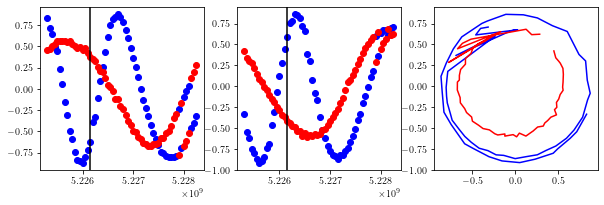

In [213]:
fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize = (10,3))

ax1.plot(f_vec_q3, np.real(ref_pos_q3.T[0]), color='blue', marker='o',ls='')
ax1.plot(f_vec_q3, np.real(ref_pos_q3.T[1]), color='red', marker='o',ls='')
ax1.axvline(x=fr3 - fr3_IF + 5.885*1e7,color='black',ls='-')

ax2.plot(f_vec_q3, np.imag(ref_pos_q3.T[0]), color='blue', marker='o',ls='')
ax2.plot(f_vec_q3, np.imag(ref_pos_q3.T[1]), color='red', marker='o',ls='')
ax2.axvline(x=fr3 - fr3_IF + 5.885*1e7,color='black',ls='-')

ax3.plot(np.real(ref_pos_q3.T[0]), np.imag(ref_pos_q3.T[0]), color='blue', marker='',ls='-')
ax3.plot(np.real(ref_pos_q3.T[1]), np.imag(ref_pos_q3.T[1]), color='red', marker='',ls='-')

#ax1.plot([f_vec_q3_fit[idx_S0],f_vec_q3_fit[idx_S1]], [fit_arctan(f_vec_q3_fit[idx_S0],*popt_S0), fit_arctan(f_vec_q3_fit[idx_S1],*popt_S1)],
#         color='black', ls='-')

plt.show()


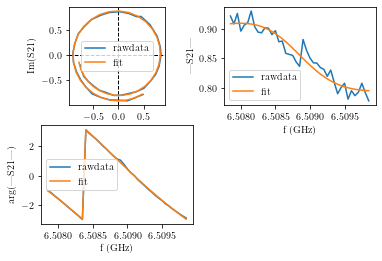


{'delay': 3.992585774788159e-07, 'delay_remaining': -0.0, 'a': 0.840123419346818, 'alpha': 2.5304254664799024, 'theta': -0.5448431801798788, 'phi': 0.06632400693001239, 'fr': 6508747418.54201, 'Ql': 3383.768919063022, 'Qc': 3344.754485473187, 'Qc_no_dia_corr': 3337.400605202774, 'Qi': -290094.5939348342, 'Qi_no_dia_corr': -243549.77565895126, 'fr_err': 18479.708510232358, 'Ql_err': 45.75386309903155, 'absQc_err': 37.16917240962858, 'phi_err': 0.0182333431983381, 'Qi_err': 209343.39700141308, 'Qi_no_dia_corr_err': 143035.161191371, 'chi_square': 0.0022070854297415172}

fr_q3_chi0_mean= 6.50875 GHz


In [214]:
b,t=12,-12
fit = reflection_port(f_data = f_vec_q1[b:t], z_data_raw = ref_pos_q1.T[0][b:t])
fit.autofit()
    
fr_q3_chi0 = fit.fitresults['fr']
fit.plotall()
print('')
print(fit.fitresults)
print('')
print('fr_q3_chi0_mean= {} GHz'.format(np.round(fr_q3_chi0*1e-9,5)))

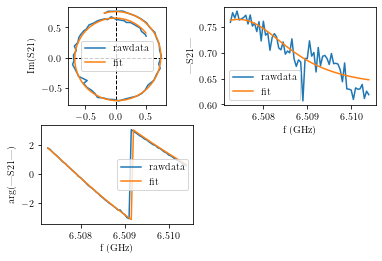


{'delay': 2.393385372820189e-07, 'delay_remaining': 4.756671183462114e-09, 'a': 0.6389650271871526, 'alpha': 0.8167418234690459, 'theta': -2.2902149486979595, 'phi': 0.034635881422787396, 'fr': 6507678833.199907, 'Ql': 2286.25616271638, 'Qc': 2088.0266903200663, 'Qc_no_dia_corr': 2086.7743708826138, 'Qi': -24082.00874951887, 'Qi_no_dia_corr': -23916.472384630953, 'fr_err': 34914.08242531807, 'Ql_err': 39.23300802412632, 'absQc_err': 29.444162897015243, 'phi_err': 0.022162944569642688, 'Qi_err': 2738.7934724460333, 'Qi_no_dia_corr_err': 2818.1192212723263, 'chi_square': 0.004511538488760767}

fr_q3_chi1_mean= 6.50768 GHz


In [215]:
b,t=0,-1

fit = reflection_port(f_data = f_vec_q1[b:t], z_data_raw = ref_pos_q1.T[1][b:t])
fit.autofit()
    
fr_q3_chi1 = fit.fitresults['fr']
fit.plotall()
print('')
print(fit.fitresults)
print('')
print('fr_q3_chi1_mean= {} GHz'.format(np.round(fr_q3_chi1*1e-9,5)))

In [216]:
print('From circlefit q3= {:.3f} MHz'.format(np.abs(fr_q3_chi1-fr_q3_chi0)*1e-6))

From circlefit q3= 1.069 MHz


# Overview Plot of qubit frequencies

In [217]:
Lq_q1_fit= 22.063096581710578 #nH
Cq_q1_fit= 32.151811586602655 #fF
Ej_q1_fit= 6.187249025439222 #GHz
fq_q1_fit = 3.6993596732583507  #GHz
I0__q1 = 3.21
I_ss__q1= 0.0112


Lq_c2_fit= 20.209864006982137 #nH
Cq_c2_fit= 22.696349564033657 #fF
Ej_c2_fit= 9.566174150228457 #GHz
fq_c2_fit = 3.4367589720937435  #GHz
I0__q2 = 4.745
I_ss__c2_fs= 2.54

Lq_q3_fit= 31.592878179998774 #nH
Cq_q3_fit= 25.19639546818537 #fF
Ej_q3_fit= 5.577304886719048 #GHz
fq_q3_fit = 3.083839312615182  #GHz
I0__q3 = 2.40
I_ss__q3_fs = 0.00029

Lq_list = np.array([Lq_q1_fit,Lq_c2_fit,Lq_q3_fit])
Cq_list = np.array([Cq_q1_fit,Cq_c2_fit,Cq_q3_fit])
Ej_list = np.array([Ej_q1_fit,Ej_c2_fit,Ej_q3_fit])
I0_list = np.array([I0__q1,I0__q2,I0__q3])
Iss_list = np.array([I_ss__q1,I_ss__c2_fs,I_ss__q3_fs])

In [218]:
Np = 20

if False:
    
    qb1 = Flx.Fluxonium()
    qb2 = Flx.Fluxonium()
    qb3 = Flx.Fluxonium()

    ii=0
    qb1.set_parameters(L = Lq_list[ii]*1e-9, C = Cq_list[ii]*1e-15, Ej = Ej_list[ii], N = Np)
    qb1.calc_hamiltonian_parameters()

    ii=1
    qb2.set_parameters(L = Lq_list[ii]*1e-9, C = Cq_list[ii]*1e-15, Ej = Ej_list[ii], N = Np)
    qb2.calc_hamiltonian_parameters()

    ii=2
    qb3.set_parameters(L = Lq_list[ii]*1e-9, C = Cq_list[ii]*1e-15, Ej = Ej_list[ii], N = Np)
    qb3.calc_hamiltonian_parameters()

    # phi and frequencies as look up tables for all coil operations: We calculate the frequencies only once 
    # and not for each operation

    phi_lookup = np.linspace(0, 1, 20001)

    qb1.set_sweep_parameters(phi_lookup*2*np.pi)
    qb1.sweep_external_flux()
    qb2.set_sweep_parameters(phi_lookup*2*np.pi)
    qb2.sweep_external_flux()
    qb3.set_sweep_parameters(phi_lookup*2*np.pi)
    qb3.sweep_external_flux()

    E1 = qb1.E_sweep
    f1_lookup = E1[:,:]-E1[0,:]
    E2 = qb2.E_sweep
    f2_lookup = E2[:,:]-E2[0,:]
    E3 = qb3.E_sweep
    f3_lookup = E3[:,:]-E3[0,:]
    
    fq_q1_fit__vs__flux = f1_lookup
    fq_c2_fit__vs__flux = f2_lookup
    fq_q3_fit__vs__flux = f3_lookup
    
else:
    phi_lookup = np.linspace(0, 1, 20001)
    fq_q1_fit__vs__flux = np.array([7.823507743494286, 7.823507712552072, 7.823507619724836, 7.823507465012781, 7.823507248415851, 7.823506969934243, 7.823506629567703, 7.823506227316315, 7.823505763180037, 7.823505237158898, 7.823504649252811, 7.823503999461735, 7.823503287785812, 7.823502514224742, 7.823501678778612, 7.823500781447521, 7.823499822231128, 7.82349880112956, 7.82349771814286, 7.823496573270731, 7.823495366513271, 7.823494097870466, 7.823492767342131, 7.823491374928324, 7.823489920628845, 7.823488404443779, 7.823486826372857, 7.8234851864161925, 7.823483484573643, 7.823481720845024, 7.823479895230378, 7.823478007729548, 7.823476058342493, 7.823474047069027, 7.823471973909065, 7.823469838862678, 7.823467641929653, 7.823465383109777, 7.823463062402965, 7.8234606798092585, 7.823458235328459, 7.823455728960397, 7.823453160704972, 7.823450530562141, 7.823447838531607, 7.823445084613439, 7.8234422688073835, 7.823439391113311, 7.823436451531094, 7.8234334500606195, 7.823430386701645, 7.823427261454201, 7.823424074317948, 7.823420825292789, 7.823417514378585, 7.823414141575142, 7.823410706882347, 7.823407210300004, 7.82340365182791, 7.823400031466002, 7.823396349213953, 7.823392605071685, 7.8233887990389785, 7.823384931115628, 7.8233810013015095, 7.823377009596385, 7.823372956000062, 7.823368840512359, 7.823364663133042, 7.823360423861924, 7.823356122698826, 7.82335175964351, 7.823347334695753, 7.823342847855352, 7.8233382991221205, 7.823333688495772, 7.823329015976109, 7.823324281562906, 7.823319485255944, 7.823314627054977, 7.823309706959762, 7.82330472497007, 7.823299681085658, 7.823294575306258, 7.823289407631643, 7.823284178061552, 7.823278886595712, 7.823273533233898, 7.823268117975772, 7.823262640821184, 7.823257101769798, 7.823251500821371, 7.823245837975648, 7.8232401132322735, 7.823234326591063, 7.823228478051618, 7.823222567613783, 7.823216595277202, 7.823210561041478, 7.8232044649065955, 7.823198306871973, 7.823192086937439, 7.823185805102696, 7.823179461367431, 7.823173055731218, 7.823166588193928, 7.8231600587551355, 7.823153467414585, 7.823146814171864, 7.823140099026659, 7.823133321978787, 7.82312648302775, 7.823119582173334, 7.823112619415042, 7.82310559475269, 7.823098508185822, 7.82309135971424, 7.823084149337447, 7.8230768770551435, 7.823069542866932, 7.823062146772571, 7.823054688771649, 7.823047168863695, 7.823039587048527, 7.823031943325589, 7.823024237694554, 7.823016470155167, 7.823008640706931, 7.823000749349518, 7.82299279608246, 7.822984780905472, 7.822976703818128, 7.822968564819959, 7.822960363910738, 7.8229521010898395, 7.822943776357022, 7.822935389711901, 7.822926941153895, 7.822918430682719, 7.822909858298033, 7.822901223999182, 7.822892527785868, 7.82288376965775, 7.8228749496143735, 7.822866067655198, 7.822857123779883, 7.822848117987931, 7.822839050278887, 7.822829920652424, 7.822820729108031, 7.822811475645167, 7.8228021602634925, 7.822792782962551, 7.822783343741875, 7.8227738426009665, 7.822764279539356, 7.822754654556633, 7.822744967652298, 7.82273521882577, 7.822725408076806, 7.822715535404754, 7.822705600809087, 7.822695604289521, 7.822685545845346, 7.822675425476206, 7.8226652431816746, 7.8226549989610135, 7.822644692813924, 7.822634324739823, 7.8226238947382, 7.822613402808713, 7.822602848950524, 7.822592233163363, 7.822581555446618, 7.822570815799779, 7.82256001422239, 7.822549150713812, 7.822538225273675, 7.822527237901198, 7.822516188596026, 7.82250507735759, 7.822493904185322, 7.8224826690786955, 7.822471372037157, 7.822460013060123, 7.82244859214704, 7.822437109297482, 7.822425564510624, 7.822413957786097, 7.822402289123374, 7.822390558521775, 7.822378765980716, 7.822366911499671, 7.82235499507803, 7.82234301671528, 7.822330976410669, 7.822318874163869, 7.822306709974063, 7.822294483840742, 7.822282195763303, 7.822269845741134, 7.822257433773629, 7.822244959860194, 7.822232424000233, 7.822219826193095, 7.822207166438167, 7.8221944447348815, 7.822181661082581, 7.822168815480612, 7.822155907928382, 7.822142938425268, 7.822129906970611, 7.822116813563774, 7.822103658204124, 7.822090440891033, 7.822077161623823, 7.82206382040186, 7.822050417224501, 7.8220369520910955, 7.822023425000957, 7.822009835953438, 7.82199618494786, 7.821982471983581, 7.821968697059929, 7.8219548601761915, 7.821940961331755, 7.821927000525866, 7.821912977757897, 7.821898893027138, 7.821884746332904, 7.821870537674534, 7.821856267051267, 7.821841934462445, 7.82182753990738, 7.821813083385345, 7.8217985648956425, 7.821783984437538, 7.8217693420103505, 7.821754637613359, 7.82173987124583, 7.82172504290706, 7.8217101525962835, 7.8216952003128215, 7.821680186055904, 7.821665109824832, 7.821649971618841, 7.821634771437182, 7.82161950927914, 7.821604185143965, 7.821588799030893, 7.821573350939168, 7.821557840868032, 7.821542268816742, 7.821526634784546, 7.821510938770642, 7.821495180774285, 7.8214793607947, 7.821463478831139, 7.821447534882756, 7.8214315289488425, 7.821415461028607, 7.821399331121202, 7.82138313922591, 7.82136688534189, 7.821350569468377, 7.821334191604547, 7.821317751749618, 7.821301249902761, 7.821284686063214, 7.821268060230115, 7.821251372402682, 7.821234622580097, 7.821217810761536, 7.821200936946164, 7.821184001133156, 7.8211670033217136, 7.821149943510989, 7.8211328217001075, 7.821115637888294, 7.821098392074658, 7.821081084258374, 7.821063714438603, 7.821046282614487, 7.821028788785169, 7.821011232949807, 7.8209936151075325, 7.820975935257467, 7.82095819339877, 7.82094038953055, 7.820922523651979, 7.820904595762116, 7.820886605860144, 7.820868553945164, 7.8208504400162475, 7.8208322640725925, 7.820814026113245, 7.820795726137303, 7.820777364143927, 7.820758940132176, 7.820740454101172, 7.820721906049993, 7.820703295977742, 7.820684623883464, 7.820665889766321, 7.820647093625354, 7.8206282354596395, 7.820609315268259, 7.820590333050285, 7.820571288804785, 7.8205521825308555, 7.820533014227525, 7.820513783893865, 7.820494491528935, 7.820475137131801, 7.8204557207014815, 7.820436242237083, 7.8204167017376065, 7.820397099202104, 7.820377434629621, 7.820357708019186, 7.820337919369846, 7.820318068680628, 7.820298155950543, 7.820278181178631, 7.8202581443639385, 7.820238045505432, 7.820217884602165, 7.8201976616531255, 7.820177376657339, 7.82015702961383, 7.820136620521559, 7.820116149379539, 7.8200956161867925, 7.820075020942312, 7.820054363645044, 7.820033644294021, 7.8200128628882055, 7.819992019426604, 7.819971113908181, 7.8199501463319105, 7.819929116696752, 7.819908025001681, 7.819886871245691, 7.819865655427721, 7.819844377546749, 7.819823037601701, 7.8198016355915705, 7.819780171515278, 7.819758645371779, 7.819737057160035, 7.819715406878987, 7.819693694527542, 7.819671920104678, 7.819650083609301, 7.819628185040357, 7.819606224396765, 7.819584201677433, 7.819562116881307, 7.819539970007288, 7.819517761054321, 7.8194954900212785, 7.819473156907106, 7.819450761710675, 7.8194283044309, 7.819405785066674, 7.81938320361691, 7.819360560080509, 7.8193378544563465, 7.819315086743295, 7.819292256940262, 7.8192693650461145, 7.819246411059751, 7.819223394980009, 7.819200316805793, 7.819177176535955, 7.81915397416939, 7.819130709704923, 7.819107383141436, 7.8190839944777775, 7.819060543712796, 7.819037030845346, 7.8190134558743, 7.818989818798455, 7.818966119616704, 7.818942358327844, 7.8189185349307415, 7.818894649424168, 7.818870701807052, 7.818846692078152, 7.818822620236274, 7.818798486280304, 7.8187742902089905, 7.818750032021191, 7.818725711715713, 7.8187013292913505, 7.818676884746919, 7.818652378081197, 7.818627809293014, 7.818603178381162, 7.8185784853444105, 7.818553730181567, 7.8185289128914, 7.81850403347272, 7.818479091924283, 7.818454088244895, 7.818429022433289, 7.818403894488261, 7.81837870440858, 7.818353452193002, 7.81832813784029, 7.818302761349212, 7.818277322718515, 7.818251821946962, 7.818226259033264, 7.818200633976202, 7.818174946774542, 7.818149197426993, 7.818123385932277, 7.818097512289155, 7.818071576496356, 7.818045578552574, 7.818019518456586, 7.817993396207088, 7.817967211802804, 7.817940965242423, 7.817914656524696, 7.817888285648323, 7.817861852612002, 7.817835357414436, 7.8178088000543156, 7.817782180530352, 7.817755498841251, 7.817728754985685, 7.817701948962347, 7.817675080769929, 7.817648150407078, 7.817621157872541, 7.81759410316494, 7.817566986282945, 7.817539807225263, 7.817512565990521, 7.817485262577422, 7.8174578969845925, 7.817430469210684, 7.817402979254395, 7.817375427114337, 7.817347812789189, 7.817320136277568, 7.817292397578113, 7.817264596689503, 7.817236733610317, 7.817208808339231, 7.817180820874867, 7.817152771215849, 7.817124659360785, 7.8170964853083, 7.817068249057046, 7.817039950605599, 7.81701158995257, 7.816983167096593, 7.816954682036252, 7.816926134770149, 7.8168975252968975, 7.816868853615084, 7.816840119723297, 7.816811323620134, 7.816782465304172, 7.816753544774025, 7.816724562028202, 7.8166955170653605, 7.816666409884045, 7.816637240482805, 7.816608008860216, 7.816578715014897, 7.816549358945338, 7.816519940650109, 7.816490460127838, 7.816460917376968, 7.816431312396121, 7.816401645183838, 7.81637191573863, 7.816342124059069, 7.816312270143669, 7.816282353990982, 7.816252375599529, 7.81622233496784, 7.816192232094435, 7.816162066977858, 7.816131839616602, 7.816101550009191, 7.816071198154134, 7.816040784049958, 7.816010307695127, 7.815979769088202, 7.815949168227647, 7.815918505111954, 7.815887779739663, 7.815856992109204, 7.815826142219075, 7.81579523006779, 7.815764255653832, 7.815733218975649, 7.815702120031758, 7.815670958820581, 7.815639735340628, 7.81560844959033, 7.8155771015681825, 7.815545691272645, 7.8155142187021385, 7.81548268385515, 7.815451086730112, 7.815419427325498, 7.815387705639724, 7.815355921671248, 7.815324075418497, 7.81529216687991, 7.815260196053938, 7.815228162938968, 7.815196067533458, 7.815163909835835, 7.815131689844508, 7.8150994075578835, 7.815067062974393, 7.815034656092429, 7.815002186910407, 7.814969655426758, 7.8149370616398315, 7.8149044055480665, 7.814871687149834, 7.814838906443525, 7.814806063427556, 7.8147731581003015, 7.8147401904601335, 7.814707160505428, 7.814674068234581, 7.814640913645943, 7.814607696737905, 7.814574417508808, 7.814541075957049, 7.814507672080969, 7.814474205878934, 7.814440677349298, 7.814407086490391, 7.814373433300581, 7.814339717778236, 7.814305939921647, 7.814272099729194, 7.814238197199209, 7.814204232330002, 7.8141702051199164, 7.81413611556729, 7.814101963670431, 7.8140677494276485, 7.814033472837286, 7.813999133897644, 7.813964732607058, 7.813930268963789, 7.8138957429662, 7.81386115461254, 7.813826503901118, 7.813791790830255, 7.8137570153982345, 7.81372217760334, 7.813687277443861, 7.813652314918071, 7.813617290024251, 7.813582202760716, 7.813547053125667, 7.813511841117462, 7.813476566734295, 7.813441229974467, 7.81340583083624, 7.813370369317869, 7.813334845417582, 7.813299259133684, 7.813263610464357, 7.813227899407927, 7.813192125962579, 7.813156290126562, 7.813120391898121, 7.813084431275479, 7.813048408256878, 7.813012322840568, 7.81297617502474, 7.81293996480761, 7.812903692187392, 7.812867357162348, 7.8128309597306504, 7.81279449989052, 7.812757977640153, 7.812721392977761, 7.812684745901548, 7.812648036409701, 7.812611264500402, 7.812574430171864, 7.812537533422249, 7.812500574249784, 7.812463552652603, 7.812426468628914, 7.812389322176861, 7.812352113294644, 7.8123148419804265, 7.812277508232347, 7.812240112048599, 7.812202653427331, 7.81216513236671, 7.812127548864873, 7.812089902919962, 7.812052194530146, 7.812014423693542, 7.8119765904083085, 7.8119386946725875, 7.811900736484503, 7.811862715842185, 7.81182463274376, 7.81178648718735, 7.811748279171097, 7.8117100086930815, 7.811671675751456, 7.811633280344324, 7.811594822469777, 7.811556302125932, 7.8115177193108885, 7.811479074022756, 7.811440366259622, 7.811401596019576, 7.8113627633007185, 7.811323868101134, 7.811284910418893, 7.811245890252096, 7.811206807598812, 7.8111676624571125, 7.811128454825063, 7.8110891847007515, 7.811049852082233, 7.811010456967556, 7.810970999354804, 7.810931479242006, 7.810891896627245, 7.8108522515085514, 7.81081254388396, 7.810772773751541, 7.810732941109313, 7.810693045955333, 7.810653088287628, 7.810613068104196, 7.810572985403102, 7.810532840182373, 7.810492632439999, 7.8104523621740265, 7.810412029382462, 7.810371634063326, 7.81033117621462, 7.81029065583434, 7.810250072920482, 7.810209427471063, 7.810168719484085, 7.810127948957524, 7.810087115889388, 7.810046220277641, 7.810005262120282, 7.809964241415292, 7.809923158160641, 7.809882012354294, 7.80984080399425, 7.809799533078468, 7.8097581996048895, 7.809716803571497, 7.809675344976236, 7.80963382381708, 7.809592240091969, 7.809550593798882, 7.809508884935701, 7.809467113500418, 7.809425279490966, 7.809383382905274, 7.809341423741262, 7.809299401996876, 7.8092573176700615, 7.809215170758714, 7.809172961260755, 7.809130689174113, 7.809088354496716, 7.809045957226449, 7.809003497361232, 7.808960974898962, 7.808918389837563, 7.808875742174912, 7.808833031908891, 7.808790259037428, 7.808747423558398, 7.808704525469693, 7.80866156476918, 7.8086185414547575, 7.808575455524265, 7.808532306975635, 7.808489095806701, 7.808445822015322, 7.808402485599391, 7.808359086556743, 7.808315624885256, 7.808272100582753, 7.808228513647117, 7.808184864076194, 7.808141151867833, 7.808097377019861, 7.808053539530103, 7.808009639396435, 7.8079656766166385, 7.807921651188606, 7.807877563110097, 7.807833412378983, 7.807789198993078, 7.807744922950178, 7.807700584248112, 7.807656182884683, 7.807611718857698, 7.807567192164971, 7.807522602804302, 7.807477950773469, 7.807433236070299, 7.807388458692541, 7.807343618638019, 7.80729871590451, 7.8072537504898065, 7.807208722391662, 7.80716363160786, 7.807118478136164, 7.80707326197439, 7.807027983120253, 7.806982641571537, 7.806937237325984, 7.8068917703813785, 7.806846240735469, 7.806800648385996, 7.806754993330705, 7.806709275567353, 7.806663495093645, 7.806617651907372, 7.80657174600624, 7.806525777387964, 7.806479746050304, 7.806433651990977, 7.806387495207689, 7.806341275698182, 7.8062949934601455, 7.806248648491308, 7.806202240789385, 7.806155770352079, 7.80610923717708, 7.806062641262095, 7.806015982604807, 7.8059692612029306, 7.805922477054179, 7.805875630156172, 7.8058287205066375, 7.805781748103266, 7.805734712943686, 7.805687615025626, 7.805640454346744, 7.805593230904687, 7.805545944697135, 7.805498595721751, 7.80545118397618, 7.805403709458095, 7.805356172165128, 7.8053085720949404, 7.8052609092451775, 7.805213183613498, 7.8051653951975, 7.805117543994856, 7.805069630003196, 7.805021653220114, 7.804973613643286, 7.80492551127031, 7.804877346098802, 7.804829118126392, 7.804780827350689, 7.80473247376931, 7.804684057379839, 7.804635578179914, 7.80458703616711, 7.80453843133904, 7.804489763693298, 7.804441033227453, 7.804392239939113, 7.80434338382587, 7.8042944648853, 7.804245483114981, 7.804196438512478, 7.804147331075388, 7.804098160801228, 7.804048927687637, 7.803999631732137, 7.803950272932285, 7.803900851285642, 7.803851366789777, 7.803801819442227, 7.803752209240529, 7.803702536182247, 7.803652800264908, 7.8036030014860565, 7.803553139843231, 7.803503215333949, 7.803453227955739, 7.803403177706148, 7.803353064582664, 7.8033028885828335, 7.803252649704151, 7.8032023479441435, 7.80315198330031, 7.803101555770162, 7.803051065351207, 7.803000512040931, 7.802949895836836, 7.802899216736417, 7.802848474737149, 7.80279766983654, 7.802746802032068, 7.802695871321191, 7.802644877701419, 7.802593821170207, 7.802542701725025, 7.802491519363352, 7.802440274082628, 7.802388965880347, 7.802337594753934, 7.802286160700865, 7.802234663718563, 7.802183103804506, 7.8021314809561435, 7.802079795170887, 7.802028046446198, 7.801976234779495, 7.8019243601682255, 7.801872422609792, 7.801820422101672, 7.801768358641244, 7.801716232225925, 7.801664042853162, 7.801611790520328, 7.801559475224856, 7.801507096964156, 7.8014546557356255, 7.801402151536665, 7.801349584364656, 7.801296954217013, 7.801244261091118, 7.801191504984368, 7.80113868589412, 7.801085803817778, 7.801032858752711, 7.800979850696301, 7.800926779645906, 7.800873645598903, 7.800820448552644, 7.800767188504505, 7.800713865451848, 7.800660479392002, 7.800607030322356, 7.800553518240202, 7.800499943142944, 7.800446305027905, 7.80039260389241, 7.8003388397338025, 7.800285012549409, 7.800231122336575, 7.800177169092612, 7.800123152814837, 7.800069073500596, 7.80001493114716, 7.799960725751891, 7.79990645731208, 7.799852125825026, 7.799797731288028, 7.799743273698406, 7.799688753053443, 7.799634169350428, 7.799579522586661, 7.799524812759429, 7.799470039866016, 7.799415203903689, 7.7993603048697455, 7.799305342761443, 7.799250317576065, 7.799195229310866, 7.7991400779631235, 7.799084863530093, 7.799029586009034, 7.798974245397194, 7.79891884169184, 7.798863374890205, 7.79880784498954, 7.798752251987086, 7.798696595880081, 7.798640876665769, 7.798585094341366, 7.798529248904108, 7.7984733403512365, 7.798417368679949, 7.798361333887479, 7.798305235971032, 7.79824907492783, 7.798192850755095, 7.798136563449994, 7.798080213009763, 7.79802379943159, 7.797967322712683, 7.797910782850225, 7.797854179841407, 7.797797513683414, 7.797740784373429, 7.797683991908638, 7.797627136286205, 7.797570217503329, 7.797513235557156, 7.797456190444853, 7.79739908216362, 7.79734191071058, 7.797284676082894, 7.797227378277725, 7.797170017292233, 7.797112593123548, 7.797055105768829, 7.796997555225205, 7.796939941489826, 7.79688226455982, 7.796824524432317, 7.796766721104428, 7.796708854573325, 7.796650924836096, 7.796592931889868, 7.796534875731744, 7.796476756358871, 7.7964185737682925, 7.7963603279571805, 7.796302018922619, 7.796243646661679, 7.796185211171489, 7.796126712449125, 7.7960681504916804, 7.796009525296258, 7.795950836859901, 7.795892085179718, 7.795833270252777, 7.795774392076163, 7.79571545064692, 7.795656445962141, 7.795597378018878, 7.7955382468142, 7.7954790523451365, 7.79541979460877, 7.795360473602133, 7.795301089322278, 7.795241641766258, 7.795182130931099, 7.795122556813851, 7.795062919411524, 7.795003218721184, 7.79494345473983, 7.7948836274644995, 7.79482373689221, 7.794763783019976, 7.794703765844813, 7.794643685363746, 7.794583541573743, 7.794523334471859, 7.7944630640550585, 7.7944027303203445, 7.794342333264737, 7.794281872885197, 7.794221349178734, 7.794160762142319, 7.794100111772936, 7.794039398067566, 7.793978621023195, 7.793917780636747, 7.793856876905256, 7.793795909825652, 7.793734879394904, 7.793673785609959, 7.793612628467768, 7.793551407965337, 7.793490124099549, 7.793428776867382, 7.793367366265761, 7.79330589229164, 7.7932443549419546, 7.793182754213627, 7.793121090103588, 7.793059362608762, 7.792997571726095, 7.792935717452469, 7.792873799784822, 7.792811818720047, 7.7927497742551, 7.79268766638682, 7.792625495112182, 7.7925632604280235, 7.792500962331273, 7.7924386008188105, 7.79237617588754, 7.792313687534344, 7.792251135756082, 7.792188520549672, 7.792125841911945, 7.792063099839812, 7.792000294330133, 7.791937425379771, 7.79187449298559, 7.791811497144451, 7.791748437853206, 7.79168531510871, 7.79162212890782, 7.7915588792473685, 7.7914955661242224, 7.791432189535187, 7.791368749477147, 7.791305245946896, 7.791241678941276, 7.7911780484571125, 7.7911143544912225, 7.791050597040453, 7.790986776101587, 7.790922891671469, 7.790858943746881, 7.790794932324658, 7.790730857401578, 7.79066671897446, 7.790602517040101, 7.790538251595279, 7.790473922636798, 7.790409530161437, 7.790345074165994, 7.790280554647216, 7.790215971601919, 7.790151325026875, 7.79008661491882, 7.790021841274571, 7.7899570040908355, 7.7898921033644175, 7.789827139092071, 7.78976211127053, 7.789697019896565, 7.789631864966889, 7.789566646478285, 7.78950136442749, 7.789436018811214, 7.789370609626216, 7.789305136869217, 7.789239600536952, 7.789174000626149, 7.789108337133503, 7.789042610055774, 7.78897681938963, 7.788910965131822, 7.788845047279025, 7.788779065827967, 7.788713020775333, 7.78864691211783, 7.788580739852165, 7.788514503974989, 7.788448204483034, 7.788381841372965, 7.788315414641463, 7.788248924285217, 7.788182370300873, 7.788115752685128, 7.788049071434646, 7.787982326546086, 7.787915518016113, 7.787848645841378, 7.787781710018562, 7.787714710544277, 7.7876476474151834, 7.7875805206279445, 7.787513330179188, 7.787446076065544, 7.7873787582836655, 7.787311376830165, 7.787243931701676, 7.7871764228948415, 7.787108850406256, 7.787041214232559, 7.786973514370347, 7.786905750816235, 7.786837923566839, 7.786770032618763, 7.786702077968598, 7.7866340596129575, 7.786565977548426, 7.786497831771581, 7.786429622279048, 7.786361349067368, 7.786293012133148, 7.786224611472962, 7.786156147083391, 7.786087618960991, 7.786019027102334, 7.785950371503992, 7.78588165216253, 7.785812869074485, 7.785744022236429, 7.785675111644892, 7.785606137296455, 7.785537099187636, 7.785467997314995, 7.785398831675037, 7.785329602264332, 7.785260309079405, 7.785190952116752, 7.785121531372949, 7.785052046844482, 7.784982498527876, 7.784912886419642, 7.78484321051627, 7.784773470814316, 7.784703667310255, 7.7846338000006, 7.784563868881829, 7.784493873950458, 7.784423815202949, 7.784353692635831, 7.784283506245536, 7.7842132560285915, 7.784142941981456, 7.784072564100594, 7.784002122382486, 7.783931616823601, 7.783861047420404, 7.783790414169359, 7.783719717066893, 7.783648956109484, 7.7835781312935985, 7.78350724261565, 7.783436290072112, 7.783365273659396, 7.783294193373955, 7.783223049212227, 7.783151841170632, 7.783080569245592, 7.7830092334335585, 7.7829378337309105, 7.782866370134107, 7.78279484263952, 7.782723251243588, 7.782651595942713, 7.78257987673328, 7.782508093611705, 7.782436246574388, 7.782364335617707, 7.782292360738085, 7.782220321931863, 7.78214821919544, 7.782076052525207, 7.7820038219175345, 7.7819315273687995, 7.78185916887535, 7.781786746433573, 7.781714260039827, 7.7816417096904695, 7.781569095381853, 7.781496417110331, 7.781423674872268, 7.781350868663983, 7.7812779984818405, 7.781205064322155, 7.781132066181295, 7.781059004055555, 7.780985877941292, 7.780912687834821, 7.780839433732474, 7.780766115630559, 7.7806927335253935, 7.780619287413286, 7.780545777290531, 7.780472203153478, 7.780398564998396, 7.780324862821572, 7.780251096619319, 7.780177266387938, 7.780103372123696, 7.780029413822881, 7.7799553914817885, 7.779881305096679, 7.779807154663841, 7.779732940179532, 7.779658661640044, 7.7795843190416, 7.779509912380497, 7.779435441652975, 7.779360906855313, 7.779286307983728, 7.779211645034467, 7.779136918003797, 7.779062126887943, 7.7789872716831745, 7.778912352385669, 7.778837368991692, 7.778762321497458, 7.778687209899223, 7.778612034193145, 7.7785367943754835, 7.778461490442451, 7.778386122390264, 7.778310690215085, 7.778235193913161, 7.77815963348068, 7.778084008913816, 7.778008320208794, 7.777932567361784, 7.77785675036899, 7.777780869226559, 7.777704923930698, 7.777628914477589, 7.777552840863372, 7.777476703084249, 7.777400501136361, 7.777324235015886, 7.77724790471896, 7.777171510241773, 7.777095051580455, 7.777018528731138, 7.776941941690023, 7.776865290453159, 7.776788575016774, 7.77671179537696, 7.776634951529861, 7.776558043471597, 7.776481071198273, 7.776404034706035, 7.776326933991007, 7.776249769049285, 7.776172539876978, 7.776095246470209, 7.776017888825057, 7.7759404669376515, 7.775862980804081, 7.775785430420422, 7.775707815782775, 7.775630136887208, 7.775552393729841, 7.775474586306728, 7.7753967146139535, 7.7753187786475895, 7.775240778403701, 7.7751627138783554, 7.775084585067618, 7.775006391967544, 7.774928134574168, 7.7748498128836, 7.774771426891834, 7.774692976594921, 7.7746144619889215, 7.774535883069879, 7.7744572398338185, 7.774378532276751, 7.77429976039471, 7.774220924183749, 7.774142023639869, 7.774063058759101, 7.773984029537424, 7.773904935970882, 7.773825778055491, 7.7737465557871985, 7.77366726916206, 7.77358791817607, 7.773508502825177, 7.77342902310541, 7.773349479012742, 7.773269870543171, 7.773190197692655, 7.773110460457181, 7.7730306588327185, 7.7729507928152355, 7.772870862400686, 7.772790867585066, 7.7727108083643035, 7.7726306847343585, 7.772550496691199, 7.772470244230757, 7.772389927348971, 7.772309546041793, 7.772229100305177, 7.772148590135034, 7.772068015527305, 7.771987376477918, 7.771906672982777, 7.7718259050378204, 7.771745072638977, 7.771664175782142, 7.771583214463227, 7.771502188678143, 7.771421098422798, 7.771339943693087, 7.771258724484897, 7.771177440794118, 7.771096092616659, 7.771014679948415, 7.770933202785226, 7.770851661123011, 7.770770054957612, 7.770688384284919, 7.770606649100811, 7.770524849401126, 7.7704429851817505, 7.77036105643853, 7.770279063167321, 7.770197005363974, 7.770114883024323, 7.77003269614424, 7.769950444719548, 7.769868128746081, 7.769785748219685, 7.769703303136175, 7.76962079349139, 7.769538219281145, 7.769455580501262, 7.769372877147562, 7.769290109215849, 7.769207276701935, 7.769124379601623, 7.769041417910733, 7.768958391625032, 7.768875300740338, 7.768792145252439, 7.768708925157107, 7.768625640450161, 7.768542291127352, 7.768458877184466, 7.768375398617277, 7.768291855421553, 7.768208247593057, 7.768124575127575, 7.76804083802085, 7.767957036268633, 7.7678731698666805, 7.767789238810752, 7.767705243096586, 7.767621182719918, 7.767537057676501, 7.767452867962054, 7.767368613572321, 7.767284294503032, 7.767199910749909, 7.767115462308659, 7.767030949175027, 7.7669463713447175, 7.76686172881343, 7.7667770215768765, 7.766692249630761, 7.766607412970785, 7.766522511592655, 7.766437545492052, 7.766352514664671, 7.766267419106187, 7.766182258812298, 7.76609703377867, 7.766011744000993, 7.765926389474924, 7.765840970196152, 7.7657554861603275, 7.765669937363096, 7.765584323800154, 7.765498645467116, 7.765412902359673, 7.765327094473424, 7.765241221804065, 7.765155284347198, 7.765069282098488, 7.76498321505354, 7.764897083207998, 7.764810886557484, 7.764724625097629, 7.764638298824034, 7.7645519077323515, 7.764465451818152, 7.764378931077065, 7.764292345504703, 7.764205695096646, 7.7641189798484955, 7.7640321997558654, 7.763945354814323, 7.763858445019474, 7.7637714703669, 7.763684430852164, 7.763597326470868, 7.763510157218547, 7.763422923090813, 7.763335624083217, 7.763248260191306, 7.763160831410636, 7.763073337736811, 7.762985779165339, 7.762898155691774, 7.7628104673116525, 7.76272271402054, 7.762634895813965, 7.7625470126874525, 7.762459064636543, 7.762371051656759, 7.762282973743613, 7.762194830892653, 7.762106623099376, 7.762018350359293, 7.761930012667911, 7.761841610020737, 7.761753142413286, 7.761664609841042, 7.761576012299515, 7.7614873497841765, 7.761398622290539, 7.761309829814051, 7.761220972350228, 7.761132049894542, 7.761043062442441, 7.760954009989406, 7.760864892530929, 7.760775710062435, 7.760686462579408, 7.760597150077292, 7.760507772551563, 7.760418329997616, 7.760328822410955, 7.760239249786974, 7.760149612121152, 7.760059909408896, 7.759970141645642, 7.759880308826819, 7.759790410947852, 7.759700448004153, 7.759610419991159, 7.759520326904246, 7.759430168738868, 7.759339945490385, 7.7592496571542355, 7.759159303725808, 7.759068885200474, 7.75897840157366, 7.758887852840724, 7.758797238997079, 7.758706560038079, 7.758615815959101, 7.758525006755537, 7.758434132422748, 7.758343192956106, 7.758252188350971, 7.758161118602677, 7.758069983706611, 7.757978783658121, 7.757887518452533, 7.757796188085203, 7.757704792551478, 7.757613331846692, 7.75752180596619, 7.757430214905288, 7.757338558659292, 7.757246837223574, 7.757155050593424, 7.757063198764136, 7.756971281731065, 7.756879299489508, 7.7567872520347425, 7.756695139362103, 7.756602961466864, 7.7565107183443285, 7.7564184099897915, 7.756326036398537, 7.756233597565849, 7.7561410934870025, 7.756048524157265, 7.755955889571927, 7.755863189726252, 7.755770424615497, 7.755677594234922, 7.7555846985798, 7.755491737645378, 7.7553987114269, 7.755305619919609, 7.7552124631187676, 7.7551192410196, 7.755025953617353, 7.754932600907248, 7.754839182884524, 7.754745699544398, 7.754652150882095, 7.754558536892824, 7.754464857571815, 7.7543711129142725, 7.754277302915412, 7.754183427570409, 7.754089486874488, 7.753995480822823, 7.753901409410643, 7.753807272633109, 7.753713070485405, 7.75361880296273, 7.753524470060251, 7.753430071773142, 7.753335608096586, 7.753241079025712, 7.753146484555731, 7.75305182468179, 7.7529570993990085, 7.752862308702602, 7.752767452587667, 7.752672531049361, 7.752577544082835, 7.752482491683233, 7.752387373845668, 7.752292190565289, 7.752196941837215, 7.752101627656565, 7.752006248018473, 7.751910802918037, 7.751815292350385, 7.751719716310601, 7.7516240747938205, 7.751528367795138, 7.751432595309633, 7.751336757332407, 7.751240853858563, 7.751144884883173, 7.751048850401336, 7.750952750408118, 7.750856584898592, 7.750760353867856, 7.750664057310942, 7.75056769522294, 7.750471267598886, 7.750374774433868, 7.750278215722922, 7.750181591461107, 7.75008490164345, 7.749988146265018, 7.749891325320833, 7.749794438805944, 7.749697486715379, 7.749600469044154, 7.749503385787321, 7.749406236939848, 7.7493090224968215, 7.749211742453193, 7.749114396804004, 7.749016985544255, 7.74891950866896, 7.748821966173091, 7.748724358051657, 7.748626684299645, 7.748528944912067, 7.748431139883867, 7.7483332692100575, 7.748235332885605, 7.748137330905467, 7.748039263264628, 7.747941129958052, 7.747842930980711, 7.747744666327527, 7.747646335993495, 7.747547939973562, 7.747449478262634, 7.7473509508557, 7.747252357747675, 7.747153698933509, 7.747054974408115, 7.746956184166445, 7.7468573282034034, 7.746758406513928, 7.746659419092927, 7.746560365935316, 7.746461247035993, 7.746362062389894, 7.746262811991882, 7.746163495836878, 7.7460641139198, 7.745964666235499, 7.745865152778878, 7.745765573544827, 7.745665928528226, 7.745566217723934, 7.745466441126836, 7.745366598731818, 7.745266690533708, 7.745166716527395, 7.74506667670775, 7.744966571069586, 7.744866399607785, 7.744766162317181, 7.744665859192631, 7.744565490228956, 7.74446505542099, 7.74436455476359, 7.7442639882515625, 7.744163355879744, 7.744062657642955, 7.743961893535987, 7.743861063553692, 7.743760167690851, 7.743659205942287, 7.743558178302783, 7.743457084767169, 7.743355925330198, 7.743254699986702, 7.743153408731443, 7.743052051559209, 7.742950628464777, 7.74284913944293, 7.742747584488447, 7.742645963596081, 7.742544276760606, 7.742442523976775, 7.742340705239355, 7.742238820543093, 7.742136869882749, 7.74203485325305, 7.741932770648755, 7.741830622064596, 7.741728407495306, 7.741626126935625, 7.741523780380263, 7.741421367823958, 7.741318889261433, 7.741216344687398, 7.741113734096562, 7.741011057483638, 7.740908314843319, 7.740805506170323, 7.740702631459338, 7.74059969070507, 7.740496683902194, 7.740393611045392, 7.74029047212937, 7.74018726714878, 7.740083996098317, 7.739980658972638, 7.739877255766407, 7.739773786474312, 7.739670251090995, 7.7395666496110955, 7.7394629820293055, 7.739359248340238, 7.739255448538561, 7.739151582618893, 7.739047650575898, 7.73894365240419, 7.738839588098407, 7.738735457653155, 7.7386312610631, 7.738526998322799, 7.738422669426916, 7.738318274370048, 7.738213813146791, 7.7381092857517615, 7.738004692179553, 7.7379000324247595, 7.7377953064819724, 7.737690514345784, 7.737585656010772, 7.7374807314715275, 7.737375740722618, 7.737270683758611, 7.7371655605740965, 7.73706037116362, 7.736955115521747, 7.73684979364303, 7.736744405522053, 7.736638951153327, 7.736533430531413, 7.736427843650862, 7.7363221905062165, 7.736216471091972, 7.736110685402707, 7.736004833432919, 7.735898915177145, 7.735792930629899, 7.735686879785705, 7.735580762639071, 7.735474579184485, 7.735368329416494, 7.735262013329555, 7.7351556309181975, 7.735049182176892, 7.734942667100145, 7.734836085682428, 7.734729437918229, 7.73462272380203, 7.734515943328283, 7.734409096491488, 7.7343021832861, 7.734195203706575, 7.734088157747381, 7.7339810454029605, 7.733873866667764, 7.733766621536258, 7.733659310002874, 7.733551932062053, 7.733444487708214, 7.733336976935824, 7.733229399739274, 7.733121756113027, 7.733014046051468, 7.73290626954903, 7.732798426600113, 7.732690517199141, 7.732582541340516, 7.732474499018641, 7.732366390227902, 7.7322582149627035, 7.732149973217428, 7.73204166498647, 7.731933290264205, 7.731824849045017, 7.73171634132327, 7.731607767093337, 7.7314991263495925, 7.731390419086402, 7.7312816452981, 7.7311728049790815, 7.731063898123655, 7.7309549247262, 7.730845884781046, 7.730736778282533, 7.730627605224993, 7.730518365602772, 7.730409059410189, 7.730299686641564, 7.730190247291215, 7.7300807413534836, 7.729971168822655, 7.729861529693047, 7.729751823958971, 7.729642051614728, 7.729532212654601, 7.729422307072896, 7.729312334863899, 7.729202296021882, 7.729092190541165, 7.728982018415985, 7.728871779640638, 7.728761474209383, 7.728651102116493, 7.728540663356229, 7.7284301579228565, 7.728319585810619, 7.728208947013776, 7.728098241526567, 7.727987469343237, 7.7278766304580255, 7.727765724865183, 7.727654752558921, 7.727543713533467, 7.727432607783044, 7.727321435301887, 7.7272101960842114, 7.727098890124204, 7.726987517416109, 7.726876077954097, 7.7267645717323905, 7.726652998745172, 7.726541358986648, 7.726429652451, 7.726317879132402, 7.726206039025071, 7.726094132123128, 7.725982158420797, 7.725870117912219, 7.725758010591579, 7.725645836453007, 7.7255335954907025, 7.725421287698779, 7.725308913071401, 7.725196471602741, 7.725083963286895, 7.724971388118037, 7.724858746090277, 7.724746037197759, 7.724633261434607, 7.7245204187949295, 7.724407509272873, 7.724294532862536, 7.724181489558034, 7.724068379353464, 7.723955202242934, 7.723841958220538, 7.723728647280381, 7.723615269416534, 7.7235018246231135, 7.723388312894185, 7.723274734223844, 7.723161088606142, 7.723047376035158, 7.722933596504957, 7.722819750009619, 7.722705836543197, 7.722591856099736, 7.722477808673301, 7.7223636942579255, 7.722249512847655, 7.722135264436552, 7.722020949018638, 7.7219065665879185, 7.721792117138477, 7.721677600664284, 7.7215630171593945, 7.721448366617808, 7.721333649033539, 7.721218864400621, 7.721104012713015, 7.7209890939647545, 7.720874108149802, 7.720759055262204, 7.720643935295901, 7.720528748244904, 7.720413494103187, 7.720298172864716, 7.720182784523484, 7.7200673290734265, 7.719951806508553, 7.719836216822815, 7.719720560010127, 7.71960483606448, 7.719489044979829, 7.719373186750089, 7.7192572613692265, 7.71914126883117, 7.719025209129857, 7.7189090822592075, 7.718792888213148, 7.718676626985619, 7.718560298570525, 7.7184439029617575, 7.718327440153265, 7.718210910138921, 7.7180943129126645, 7.717977648468333, 7.717860916799892, 7.717744117901187, 7.717627251766107, 7.717510318388539, 7.717393317762346, 7.717276249881436, 7.717159114739662, 7.71704191233088, 7.716924642648971, 7.716807305687762, 7.71668990144114, 7.7165724299029375, 7.716454891067002, 7.71633728492718, 7.716219611477298, 7.716101870711217, 7.715984062622724, 7.7158661872057, 7.715748244453906, 7.715630234361207, 7.715512156921408, 7.715394012128295, 7.715275799975689, 7.715157520457391, 7.715039173567217, 7.714920759298941, 7.714802277646346, 7.714683728603251, 7.714565112163427, 7.714446428320585, 7.714327677068553, 7.71420885840115, 7.714089972312166, 7.71397101879522, 7.713851997844074, 7.713732909452617, 7.7136137536144815, 7.713494530323516, 7.713375239573409, 7.71325588135781, 7.7131364556706075, 7.713016962505435, 7.712897401856154, 7.712777773716326, 7.71265807807967, 7.7125383149399624, 7.712418484290964, 7.712298586126252, 7.71217862043963, 7.712058587224618, 7.711938486475276, 7.711818318184953, 7.71169808234751, 7.711577778956482, 7.711457408005714, 7.711336969488812, 7.71121646339941, 7.711095889731126, 7.710975248477737, 7.710854539632834, 7.7107337631902055, 7.710612919143259, 7.710492007485783, 7.710371028211426, 7.7102499813137655, 7.710128866786491, 7.710007684623278, 7.709886434817506, 7.709765117363119, 7.709643732253497, 7.709522279482499, 7.709400759043362, 7.70927917093006, 7.709157515135956, 7.709035791654827, 7.7089140004800925, 7.708792141605414, 7.708670215024384, 7.708548220730563, 7.708426158717586, 7.708304028978958, 7.708181831508284, 7.708059566299099, 7.707937233344893, 7.707814832639443, 7.70769236417604, 7.707569827948433, 7.707447223950069, 7.707324552174498, 7.70720181261521, 7.7070790052658396, 7.70695613011992, 7.706833187170844, 7.706710176412244, 7.7065870978375415, 7.706463951440284, 7.706340737214049, 7.706217455152299, 7.706094105248496, 7.705970687496148, 7.7058472018887585, 7.705723648419763, 7.705600027082724, 7.705476337871104, 7.70535258077831, 7.705228755797933, 7.705104862923292, 7.704980902148009, 7.704856873465317, 7.704732776868994, 7.7046086123520325, 7.704484379908422, 7.7043600795312415, 7.704235711214025, 7.704111274950151, 7.703986770733081, 7.703862198556209, 7.703737558413138, 7.703612850297091, 7.703488074201502, 7.703363230119905, 7.703238318045564, 7.703113337971871, 7.702988289892289, 7.702863173800239, 7.702737989689027, 7.7026127375521725, 7.7024874173828835, 7.702362029174623, 7.702236572920697, 7.702111048614626, 7.701985456249673, 7.701859795819104, 7.7017340673164085, 7.701608270734937, 7.70148240606791, 7.701356473308834, 7.701230472451002, 7.701104403487577, 7.700978266412122, 7.700852061217873, 7.700725787898023, 7.700599446446134, 7.700473036855485, 7.70034655911914, 7.700220013230577, 7.700093399183089, 7.699966716969982, 7.6998399665845625, 7.6997131480200665, 7.699586261269786, 7.6994593063270145, 7.699332283185001, 7.699205191837095, 7.699078032276489, 7.698950804496491, 7.698823508490307, 7.698696144251315, 7.698568711772523, 7.698441211047452, 7.698313642069138, 7.698186004831001, 7.698058299326092, 7.697930525547733, 7.697802683489158, 7.6976747731436035, 7.697546794504319, 7.697418747564356, 7.6972906323170065, 7.697162448755577, 7.697034196873204, 7.696905876662967, 7.696777488118229, 7.696649031232113, 7.696520505997796, 7.696391912408345, 7.696263250457179, 7.696134520137264, 7.696005721441921, 7.695876854364229, 7.695747918897325, 7.695618915034444, 7.6954898427685805, 7.695360702093012, 7.695231493000918, 7.695102215485321, 7.694972869539512, 7.694843455156459, 7.694713972329353, 7.69458442105126, 7.6944548013153735, 7.6943251131148, 7.694195356442549, 7.694065531291869, 7.693935637655784, 7.693805675527429, 7.693675644899827, 7.693545545766099, 7.693415378119312, 7.693285141952643, 7.693154837258987, 7.693024464031566, 7.692894022263488, 7.692763511947632, 7.692632933077206, 7.692502285645176, 7.6923715696445925, 7.692240785068563, 7.692109931910153, 7.691979010162257, 7.691848019818025, 7.691716960870508, 7.691585833312601, 7.691454637137454, 7.691323372338033, 7.691192038907289, 7.69106063683833, 7.690929166124121, 7.690797626757657, 7.690666018731918, 7.690534342039911, 7.690402596674588, 7.690270782629014, 7.69013889989607, 7.690006948468891, 7.689874928340146, 7.689742839503168, 7.689610681950597, 7.689478455675598, 7.689346160670951, 7.689213796929792, 7.689081364444988, 7.688948863209404, 7.688816293216092, 7.688683654457904, 7.688550946927791, 7.688418170618675, 7.688285325523395, 7.6881524116350874, 7.688019428946447, 7.687886377450482, 7.687753257140045, 7.687620068008002, 7.687486810047361, 7.687353483250874, 7.687220087611564, 7.687086623122198, 7.686953089775713, 7.686819487564918, 7.686685816482779, 7.686552076522034, 7.6864182676756485, 7.686284389936404, 7.686150443297208, 7.686016427750843, 7.68588234329026, 7.6857481899081534, 7.685613967597476, 7.685479676350951, 7.685345316161531, 7.685210887021867, 7.685076388924955, 7.684941821863461, 7.684807185830309, 7.684672480818165, 7.684537706819967, 7.684402863828339, 7.6842679518362615, 7.6841329708364015, 7.683997920821682, 7.683862801784613, 7.68372761371819, 7.6835923566151365, 7.683457030468205, 7.683321635270175, 7.683186171013617, 7.683050637691565, 7.682915035296574, 7.682779363821453, 7.682643623258954, 7.682507813601859, 7.682371934842678, 7.682235986974362, 7.682099969989608, 7.681963883880982, 7.68182772864138, 7.681691504263412, 7.681555210739745, 7.681418848063117, 7.681282416226296, 7.6811459152217765, 7.681009345042497, 7.6808727056809545, 7.680735997129943, 7.68059921938206, 7.680462372429986, 7.680325456266374, 7.680188470883863, 7.680051416275234, 7.67991429243304, 7.67977709934992, 7.67963983701847, 7.679502505431472, 7.679365104581493, 7.679227634461071, 7.679090095062918, 7.678952486379643, 7.6788148084039705, 7.678677061128255, 7.678539244545348, 7.678401358647761, 7.678263403428076, 7.678125378878846, 7.677987284992781, 7.677849121762378, 7.677710889180304, 7.677572587238927, 7.677434215931044, 7.6772957752491635, 7.677157265185798, 7.677018685733529, 7.676880036884995, 7.6767413186326365, 7.6766025309690775, 7.676463673886815, 7.676324747378274, 7.676185751436208, 7.676046686052999, 7.675907551221258, 7.675768346933481, 7.67562907318208, 7.675489729959622, 7.675350317258733, 7.675210835071766, 7.67507128339129, 7.6749316622097865, 7.674791971519767, 7.6746522113135995, 7.674512381583924, 7.6743724823231645, 7.674232513523819, 7.674092475178199, 7.6739523672788295, 7.673812189818378, 7.673671942789028, 7.673531626183447, 7.67339123999389, 7.673250784212968, 7.6731102588329065, 7.672969663846288, 7.672828999245539, 7.672688265023012, 7.6725474611712485, 7.672406587682502, 7.67226564454927, 7.67212463176395, 7.671983549319052, 7.6718423972067455, 7.671701175419514, 7.671559883949783, 7.671418522789949, 7.671277091932382, 7.671135591369421, 7.670994021093421, 7.670852381096836, 7.670710671371992, 7.670568891911159, 7.670427042706649, 7.670285123751043, 7.6701431350365255, 7.670001076555536, 7.669858948300231, 7.669716750263078, 7.669574482436403, 7.669432144812404, 7.669289737383522, 7.669147260142097, 7.669004713080255, 7.6688620961904945, 7.668719409464998, 7.668576652896107, 7.668433826476118, 7.668290930197273, 7.6681479640519115, 7.668004928032246, 7.667861822130533, 7.66771864633921, 7.667575400650236, 7.667432085056163, 7.6672886995490614, 7.667145244121315, 7.667001718765036, 7.666858123472608, 7.666714458236086, 7.666570723047826, 7.666426917900111, 7.666283042785054, 7.666139097694867, 7.665995082621791, 7.665850997557996, 7.665706842495823, 7.665562617427298, 7.66541832234482, 7.665273957240359, 7.665129522106184, 7.664985016934594, 7.664840441717587, 7.6646957964475035, 7.664551081116301, 7.664406295716319, 7.664261440239699, 7.6641165146784545, 7.663971519024898, 7.6638264532711275, 7.663681317409228, 7.663536111431441, 7.663390835329793, 7.663245489096539, 7.6631000727236795, 7.662954586203341, 7.662809029527651, 7.662663402688864, 7.6625177056787805, 7.662371938489741, 7.662226101113859, 7.662080193543076, 7.6619342157696195, 7.661788167785488, 7.661642049582738, 7.661495861153483, 7.661349602489821, 7.661203273583723, 7.661056874427345, 7.660910405012714, 7.660763865331873, 7.660617255376849, 7.660470575139669, 7.660323824612433, 7.660177003787183, 7.660030112655832, 7.659883151210508, 7.659736119443252, 7.659589017345908, 7.659441844910688, 7.6592946021295205, 7.659147288994404, 7.658999905497268, 7.658852451630139, 7.658704927385116, 7.658557332754057, 7.6584096677290034, 7.658261932301855, 7.658114126464596, 7.657966250209384, 7.657818303527861, 7.657670286412099, 7.6575221988541955, 7.657374040845951, 7.657225812379323, 7.657077513446353, 7.656929144038713, 7.656780704148616, 7.65663219376782, 7.6564836128882945, 7.656334961501969, 7.656186239600814, 7.656037447176573, 7.655888584221216, 7.6557396507267015, 7.655590646684871, 7.65544157208754, 7.65529242692665, 7.655143211194215, 7.654993924881808, 7.654844567981584, 7.654695140485259, 7.654545642384647, 7.6543960736716485, 7.6542464343383045, 7.654096724376203, 7.653946943777271, 7.653797092533338, 7.65364717063629, 7.653497178077814, 7.65334711484995, 7.653196980944287, 7.6530467763526815, 7.65289650106709, 7.652746155079299, 7.652595738380896, 7.65244525096378, 7.652294692819865, 7.652144063940781, 7.651993364318429, 7.651842593944565, 7.651691752810805, 7.651540840909021, 7.651389858230928, 7.651238804768369, 7.651087680513172, 7.650936485456825, 7.650785219591285, 7.6506338829082665, 7.650482475399329, 7.650330997056372, 7.650179447871125, 7.650027827835231, 7.649876136940392, 7.64972437517838, 7.64957254254098, 7.649420639019624, 7.6492686646061685, 7.6491166192924, 7.6489645030698625, 7.648812315930371, 7.648660057865413, 7.648507728866861, 7.648355328926215, 7.64820285803529, 7.648050316185575, 7.647897703368855, 7.647745019576746, 7.647592264800863, 7.647439439032951, 7.647286542264368, 7.6471335744871, 7.646980535692663, 7.646827425872473, 7.64667424501836, 7.646520993121882, 7.646367670174655, 7.646214276168195, 7.6460608110942445, 7.645907274944307, 7.645753667710011, 7.645599989382916, 7.645446239954509, 7.645292419416506, 7.64513852776048, 7.6449845649778325, 7.644830531060322, 7.644676425999336, 7.644522249786533, 7.644368002413415, 7.644213683871527, 7.64405929415247, 7.643904833247689, 7.643750301148771, 7.64359569784709, 7.643441023334333, 7.6432862776020585, 7.643131460641541, 7.642976572444439, 7.642821613002255, 7.642666582306461, 7.642511480348546, 7.642356307119982, 7.64220106261233, 7.642045746816805, 7.641890359725224, 7.641734901328817, 7.641579371619173, 7.64142377058765, 7.641268098225737, 7.641112354524864, 7.640956539476505, 7.640800653072134, 7.6406446953031235, 7.6404886661609055, 7.640332565636896, 7.640176393722527, 7.6400201504092, 7.639863835688374, 7.639707449551338, 7.63955099198958, 7.639394462994559, 7.639237862557508, 7.6390811906698275, 7.638924447323035, 7.638767632508404, 7.638610746217353, 7.638453788441154, 7.638296759171325, 7.638139658399027, 7.637982486115746, 7.6378252423129, 7.637667926981649, 7.637510540113368, 7.637353081699416, 7.637195551731139, 7.6370379501999395, 7.6368802770969495, 7.636722532413572, 7.636564716141194, 7.636406828270964, 7.636248868794368, 7.636090837702525, 7.6359327349867385, 7.635774560638367, 7.635616314648701, 7.635457997008942, 7.635299607710422, 7.635141146744374, 7.634982614102057, 7.634824009774718, 7.634665333753631, 7.634506586030099, 7.634347766595184, 7.634188875440273, 7.6340299125565565, 7.633870877935223, 7.63371177156759, 7.633552593444804, 7.633393343558069, 7.633234021898616, 7.633074628457635, 7.632915163226315, 7.632755626195745, 7.632596017357429, 7.632436336702156, 7.632276584221486, 7.632116759906239, 7.63195686374786, 7.631796895737338, 7.63163685586585, 7.631476744124626, 7.6313165605047715, 7.631156304997461, 7.630995977593727, 7.630835578284859, 7.6306751070618475, 7.630514563915838, 7.630353948838106, 7.6301932618195565, 7.630032502851435, 7.629871671924789, 7.6297107690306945, 7.629549794160312, 7.629388747304731, 7.629227628454942, 7.629066437602106, 7.628905174737312, 7.6287438398515945, 7.628582432936028, 7.628420953981674, 7.628259402979509, 7.6280977799207506, 7.627936084796275, 7.627774317597201, 7.627612478314646, 7.627450566939444, 7.627288583462857, 7.627126527875689, 7.626964400169101, 7.626802200333998, 7.626639928361499, 7.626477584242551, 7.6263151679681584, 7.626152679529326, 7.6259901189169454, 7.62582748612212, 7.625664781135725, 7.625502003948824, 7.625339154552364, 7.625176232937264, 7.6250132390946135, 7.624850173015119, 7.624687034689956, 7.624523824109971, 7.624360541266128, 7.624197186149274, 7.6240337587505, 7.623870259060482, 7.623706687070396, 7.623543042771061, 7.623379326153355, 7.623215537208182, 7.6230516759264475, 7.622887742299113, 7.622723736316956, 7.622559657970996, 7.622395507251966, 7.622231284150786, 7.622066988658403, 7.621902620765525, 7.621738180463268, 7.621573667742098, 7.62140908259326, 7.6212444250073474, 7.621079694975265, 7.620914892487903, 7.620750017536054, 7.620585070110508, 7.620420050202071, 7.620254957801691, 7.620089792900018, 7.61992455548787, 7.619759245556196, 7.619593863095631, 7.619428408097093, 7.619262880551176, 7.619097280448798, 7.618931607780752, 7.618765862537799, 7.618600044710703, 7.618434154290043, 7.618268191266836, 7.6181021556317035, 7.617936047375366, 7.617769866488473, 7.617603612962114, 7.6174372867867675, 7.61727088795304, 7.617104416451895, 7.61693787227388, 7.6167712554097875, 7.616604565850352, 7.616437803586052, 7.616270968607893, 7.61610406090638, 7.615937080472193, 7.615770027296165, 7.615602901368732, 7.615435702680742, 7.615268431222859, 7.615101086985604, 7.61493366995974, 7.614766180135888, 7.614598617504683, 7.614430982056803, 7.6142632737828535, 7.614095492673442, 7.613927638719119, 7.613759711910802, 7.613591712238858, 7.613423639693764, 7.613255494266383, 7.613087275947322, 7.612918984726932, 7.612750620596032, 7.612582183545086, 7.61241367356466, 7.612245090645459, 7.61207643477789, 7.611907705952689, 7.611738904160234, 7.611570029391132, 7.611401081636032, 7.611232060885456, 7.611062967129698, 7.610893800359548, 7.610724560565558, 7.610555247738105, 7.610385861867599, 7.610216402944815, 7.610046870960247, 7.60987726590416, 7.609707587767403, 7.6095378365400705, 7.609368012212855, 7.609198114776277, 7.609028144220758, 7.60885810053675, 7.6086879837146455, 7.608517793745122, 7.608347530618445, 7.6081771943251795, 7.608006784855718, 7.607836302200383, 7.607665746349909, 7.607495117294491, 7.607324415024493, 7.6071536395306225, 7.60698279080286, 7.606811868832153, 7.6066408736085975, 7.606469805122529, 7.606298663364427, 7.60612744832477, 7.605956159993923, 7.605784798362123, 7.605613363419906, 7.60544185515738, 7.605270273565267, 7.605098618633676, 7.604926890353113, 7.604755088713787, 7.604583213706121, 7.604411265320408, 7.604239243546942, 7.604067148376203, 7.603894979798497, 7.603722737803977, 7.603550422383151, 7.603378033526113, 7.603205571223256, 7.6030330354649465, 7.602860426241506, 7.602687743543058, 7.602514987359996, 7.6023421576825, 7.602169254500964, 7.601996277805625, 7.601823227586692, 7.601650103834373, 7.601476906539077, 7.6013036356908685, 7.601130291280086, 7.600956873297022, 7.600783381731858, 7.600609816574746, 7.600436177816093, 7.600262465445809, 7.600088679454316, 7.599914819831795, 7.5997408865682985, 7.5995668796543185, 7.599392799079837, 7.599218644834991, 7.5990444169100755, 7.598870115295185, 7.59869573998057, 7.598521290956384, 7.598346768212764, 7.5981721717397335, 7.597997501527544, 7.597822757566377, 7.597647939846297, 7.597473048357543, 7.597298083090081, 7.597123044034149, 7.596947931179869, 7.596772744517281, 7.596597484036508, 7.59642214972763, 7.5962467415807, 7.59607125958604, 7.595895703733433, 7.595720074013158, 7.595544370415283, 7.595368592929589, 7.595192741546498, 7.5950168162559635, 7.594840817047938, 7.594664743912588, 7.594488596839852, 7.5943123758198965, 7.5941360808425316, 7.5939597118980515, 7.59378326897631, 7.593606752067245, 7.593430161161109, 7.593253496247769, 7.593076757317135, 7.592899944359402, 7.592723057364353, 7.592546096322195, 7.59236906122274, 7.592191952055856, 7.592014768811879, 7.591837511480421, 7.591660180051548, 7.591482774515285, 7.5913052948614705, 7.5911277410802, 7.590950113161128, 7.590772411094463, 7.59059463487003, 7.590416784477739, 7.590238859907586, 7.590060861149325, 7.589882788192952, 7.589704641028234, 7.589526419645367, 7.589348124034046, 7.5891697541840415, 7.588991310085447, 7.588812791727975, 7.588634199101648, 7.588455532196136, 7.588276791001462, 7.588097975507296, 7.58791908570376, 7.587740121580481, 7.5875610831272695, 7.587381970334093, 7.587202783190605, 7.587023521686845, 7.5868441858125095, 7.586664775557381, 7.586485290911227, 7.586305731863888, 7.586126098405316, 7.585946390524995, 7.585766608212907, 7.585586751458905, 7.585406820252459, 7.585226814583621, 7.585046734441988, 7.584866579817344, 7.5846863506995845, 7.58450604707825, 7.584325668943151, 7.584145216284014, 7.583964689090578, 7.5837840873526545, 7.583603411059727, 7.583422660201748, 7.583241834768273, 7.583060934749099, 7.582879960133823, 7.582698910912342, 7.582517787074039, 7.582336588608726, 7.582155315506185, 7.581973967755857, 7.581792545347653, 7.581611048271057, 7.581429476515851, 7.581247830071533, 7.581066108927828, 7.580884313074392, 7.580702442500765, 7.580520497196687, 7.580338477151685, 7.5801563823554545, 7.579974212797566, 7.579791968467532, 7.579609649355106, 7.579427255449772, 7.5792447867411, 7.5790622432187575, 7.578879624872357, 7.57869693169134, 7.578514163665318, 7.578331320783903, 7.578148403036522, 7.577965410412972, 7.577782342902466, 7.5775992004947454, 7.57741598317935, 7.5772326909457774, 7.577049323783427, 7.57686588168194, 7.576682364630869, 7.576498772619658, 7.576315105637747, 7.576131363674705, 7.575947546720016, 7.575763654763122, 7.575579687793592, 7.575395645800754, 7.57521152877419, 7.575027336703371, 7.574843069577611, 7.5746587273865345, 7.57447431011947, 7.57428981776593, 7.57410525031527, 7.573920607756946, 7.573735890080428, 7.5735510972751285, 7.573366229330404, 7.573181286235709, 7.5729962679803435, 7.572811174553834, 7.5726260059455655, 7.572440762144751, 7.572255443141032, 7.572070048923507, 7.571884579481846, 7.571699034805064, 7.5715134148827445, 7.5713277197042, 7.5711419492587595, 7.570956103535835, 7.570770182524683, 7.570584186214603, 7.570398114595022, 7.570211967655041, 7.570025745384299, 7.569839447771898, 7.569653074807064, 7.5694666264793256, 7.569280102777753, 7.569093503691761, 7.568906829210576, 7.568720079323612, 7.56853325401984, 7.568346353288774, 7.568159377119656, 7.567972325501543, 7.5677851984239055, 7.567597995875872, 7.567410717846641, 7.567223364325542, 7.567035935301718, 7.5668484307644235, 7.566660850702931, 7.56647319510634, 7.5662854639638795, 7.566097657264734, 7.565909774998175, 7.565721817153317, 7.565533783719388, 7.565345674685389, 7.565157490040846, 7.564969229774462, 7.5647808938757635, 7.564592482333751, 7.564403995137511, 7.564215432276399, 7.564026793739359, 7.563838079515591, 7.5636492895941245, 7.563460423964159, 7.563271482614823, 7.563082465535089, 7.5628933727143135, 7.56270420414134, 7.562514959805398, 7.562325639695558, 7.562136243800808, 7.561946772110346, 7.561757224613089, 7.561567601298236, 7.561377902154746, 7.561188127171775, 7.560998276338296, 7.56080834964321, 7.560618347075874, 7.560428268625074, 7.560238114279883, 7.560047884029274, 7.559857577862417, 7.559667195768128, 7.559476737735508, 7.55928620375353, 7.559095593811207, 7.558904907897471, 7.55871414600125, 7.558523308111674, 7.558332394217558, 7.558141404307946, 7.557950338371825, 7.557759196397981, 7.557567978375502, 7.557376684293303, 7.55718531414017, 7.556993867905305, 7.556802345577367, 7.556610747145399, 7.556419072598317, 7.5562273219249505, 7.556035495114273, 7.555843592155071, 7.555651613036389, 7.555459557746957, 7.555267426275748, 7.555075218611478, 7.554882934743176, 7.554690574659688, 7.554498138349828, 7.5543056258023, 7.554113037006104, 7.5539203719501415, 7.5537276306230865, 7.553534813013755, 7.553341919111091, 7.5531489489038535, 7.552955902380788, 7.55276277953071, 7.552569580342464, 7.552376304804866, 7.552182952906577, 7.551989524636539, 7.551796019983385, 7.551602438935873, 7.551408781482763, 7.551215047612928, 7.551021237315069, 7.550827350577848, 7.550633387390022, 7.550439347740408, 7.550245231617637, 7.550051039010498, 7.549856769907635, 7.549662424297736, 7.549468002169604, 7.549273503511984, 7.5490789283134205, 7.548884276562589, 7.548689548248262, 7.548494743359001, 7.548299861883606, 7.548104903810739, 7.547909869128887, 7.547714757826796, 7.547519569893225, 7.547324305316678, 7.5471289640857435, 7.54693354618918, 7.546738051615435, 7.546542480353338, 7.546346832391322, 7.546151107718174, 7.545955306322256, 7.545759428192312, 7.545563473316932, 7.545367441684576, 7.545171333283903, 7.544975148103632, 7.5447788861319935, 7.544582547357848, 7.544386131769514, 7.544189639355679, 7.543993070104861, 7.543796424005606, 7.543599701046261, 7.543402901215586, 7.5432060245020125, 7.543009070894044, 7.542812040380198, 7.542614932948879, 7.5424177485887185, 7.542220487288091, 7.542023149035558, 7.541825733819522, 7.541628241628587, 7.541430672451057, 7.541233026275464, 7.541035303090126, 7.5408375028837185, 7.540639625644559, 7.540441671360995, 7.5402436400216715, 7.540045531614851, 7.5398473461290365, 7.539649083552476, 7.539450743873829, 7.539252327081144, 7.539053833163152, 7.538855262108072, 7.5386566139042515, 7.5384578885401226, 7.5382590860041745, 7.538060206284499, 7.5378612493697545, 7.537662215248162, 7.537463103907783, 7.537263915337405, 7.5370646495252345, 7.53686530645939, 7.536665886128503, 7.53646638852058, 7.536266813624152, 7.536067161427397, 7.535867431918689, 7.535667625086234, 7.5354677409184205, 7.535267779403455, 7.535067740529584, 7.534867624285312, 7.534667430658629, 7.534467159637771, 7.534266811211197, 7.534066385367026, 7.533865882093522, 7.533665301378775, 7.533464643211232, 7.533263907579197, 7.533063094470592, 7.532862203873677, 7.532661235776786, 7.5324601901679955, 7.532259067035611, 7.532057866367751, 7.531856588152479, 7.531655232378185, 7.531453799032889, 7.531252288104909, 7.531050699582238, 7.530849033453052, 7.530647289705456, 7.530445468327713, 7.530243569307871, 7.530041592634035, 7.529839538294425, 7.529637406277004, 7.5294351965699065, 7.529232909161323, 7.529030544039372, 7.52882810119209, 7.528625580607482, 7.528422982273739, 7.528220306178753, 7.528017552310786, 7.527814720657901, 7.527611811207905, 7.527408823949088, 7.527205758869428, 7.527002615956874, 7.526799395199561, 7.526596096585436, 7.526392720102535, 7.526189265738978, 7.525985733482557, 7.52578212332142, 7.525578435243517, 7.525374669236783, 7.525170825289308, 7.524966903389057, 7.524762903523822, 7.5245588256817655, 7.5243546698506805, 7.524150436018701, 7.523946124173605, 7.523741734303371, 7.523537266395948, 7.5233327204392, 7.523128096421203, 7.522923394329766, 7.522718614152879, 7.522513755878222, 7.5223088194938015, 7.522103804987623, 7.521898712347422, 7.521693541561163, 7.521488292616652, 7.521282965501825, 7.521077560204475, 7.520872076712465, 7.52066651501363, 7.5204608750958215, 7.520255156946973, 7.520049360554665, 7.519843485906975, 7.519637532991624, 7.519431501796333, 7.519225392309025, 7.51901920451742, 7.518812938409297, 7.518606593972578, 7.518400171194841, 7.518193670063937, 7.517987090567686, 7.517780432693812, 7.517573696430162, 7.5173668817642465, 7.517159988684028, 7.516953017177173, 7.516745967231273, 7.516538838834322, 7.516331631973827, 7.516124346637525, 7.515916982813081, 7.5157095404883165, 7.515502019650967, 7.515294420288541, 7.515086742388775, 7.514878985939404, 7.514671150928038, 7.514463237342298, 7.514255245169949, 7.514047174398655, 7.513839025015827, 7.513630797009284, 7.513422490366651, 7.513214105075534, 7.51300564112357, 7.512797098498197, 7.5125884771873075, 7.512379777178282, 7.512170998458814, 7.511962141016554, 7.511753204838868, 7.5115441899134225, 7.511335096227938, 7.511125923769782, 7.510916672526491, 7.510707342485688, 7.510497933635108, 7.51028844596199, 7.5100788794539, 7.5098692340985025, 7.509659509883193, 7.509449706795692, 7.509239824823169, 7.509029863953344, 7.508819824173742, 7.508609705471741, 7.50839950783481, 7.5081892312505545, 7.507978875706257, 7.507768441189441, 7.507557927687714, 7.5073473351882996, 7.507136663678793, 7.506925913146503, 7.50671508357901, 7.506504174963638, 7.506293187287781, 7.506082120538991, 7.505870974704536, 7.505659749771738, 7.505448445728163, 7.505237062561207, 7.5050256002580795, 7.504814058806346, 7.50460243819316, 7.504390738406059, 7.504178959432409, 7.503967101259448, 7.503755163874487, 7.503543147264935, 7.5033310514181295, 7.503118876321281, 7.502906621961856, 7.502694288327191, 7.502481875404342, 7.502269383180817, 7.50205681164401, 7.501844160780834, 7.501631430578854, 7.50141862102528, 7.5012057321073655, 7.500992763812391, 7.500779716127553, 7.500566589040147, 7.500353382537355, 7.500140096606458, 7.499926731234638, 7.4997132864091895, 7.499499762117281, 7.499286158346138, 7.499072475082897, 7.4988587123148704, 7.498644870029224, 7.498430948212956, 7.498216946853432, 7.498002865937735, 7.497788705453104, 7.497574465386677, 7.49736014572558, 7.497145746456923, 7.4969312675679305, 7.4967167090455575, 7.4965020708771135, 7.496287353049652, 7.4960725555502705, 7.495857678366136, 7.4956427214842165, 7.495427684891695, 7.495212568575695, 7.494997372523329, 7.4947820967214085, 7.494566741157286, 7.494351305817915, 7.494135790690251, 7.49392019576149, 7.493704521018671, 7.493488766448721, 7.4932729320388205, 7.493057017775769, 7.492841023646747, 7.49262494963871, 7.492408795738797, 7.492192561933734, 7.491976248210648, 7.491759854556619, 7.491543380958447, 7.49132682740327, 7.491110193877844, 7.490893480369323, 7.490676686864589, 7.490459813350554, 7.490242859814217, 7.4900258262423876, 7.489808712622093, 7.489591518940344, 7.489374245183711, 7.489156891339533, 7.488939457394409, 7.488721943335307, 7.4885043491491246, 7.4882866748228025, 7.488068920343068, 7.48785108569696, 7.487633170871192, 7.487415175852632, 7.4871971006281655, 7.486978945184688, 7.486760709508985, 7.4865423935878255, 7.48632399740805, 7.486105520956542, 7.485886964220057, 7.485668327185422, 7.485449609839378, 7.485230812168808, 7.485011934160283, 7.484792975800843, 7.48457393707703, 7.48435481797577, 7.484135618483776, 7.483916338587704, 7.483696978274395, 7.483477537530604, 7.48325801634293, 7.483038414698186, 7.482818732583127, 7.482598969984323, 7.482379126888631, 7.482159203282606, 7.481939199153061, 7.481719114486594, 7.48149894926992, 7.48127870348965, 7.481058377132484, 7.480837970185107, 7.480617482634202, 7.480396914466226, 7.480176265668092, 7.479955536226171, 7.479734726127205, 7.4795138353577215, 7.47929286390449, 7.479071811753997, 7.478850678892925, 7.478629465307776, 7.478408170985148, 7.47818679591154, 7.477965340073723, 7.4777438034580825, 7.477522186051303, 7.477300487839798, 7.477078708810154, 7.476856848949069, 7.476634908242843, 7.476412886678048, 7.476190784241325, 7.475968600919046, 7.475746336697782, 7.475523991564032, 7.475301565504168, 7.475079058504917, 7.474856470552524, 7.474633801633587, 7.474411051734506, 7.474188220841668, 7.473965308941715, 7.473742316020974, 7.473519242065876, 7.473296087062778, 7.47307285099825, 7.472849533858678, 7.472626135630435, 7.472402656299806, 7.4721790958535195, 7.471955454277563, 7.471731731558577, 7.471507927682936, 7.471284042636796, 7.471060076406729, 7.470836028979022, 7.470611900339961, 7.470387690475931, 7.470163399373433, 7.469939027018555, 7.469714573397695, 7.469490038497128, 7.469265422303323, 7.4690407248024115, 7.468815945980779, 7.468591085824656, 7.468366144320299, 7.468141121454096, 7.467916017212261, 7.467690831580995, 7.467465564546558, 7.4672402160953055, 7.467014786213454, 7.46678927488712, 7.466563682102574, 7.466338007846105, 7.46611225210394, 7.465886414862155, 7.465660496106935, 7.465434495824624, 7.4652084140014665, 7.464982250623407, 7.464756005676833, 7.464529679147645, 7.464303271022274, 7.464076781286664, 7.46385020992706, 7.4636235569297185, 7.463396822280529, 7.463170005965779, 7.462943107971512, 7.462716128283887, 7.46248906688902, 7.462261923772942, 7.462034698921755, 7.46180739232156, 7.46158000395846, 7.461352533818513, 7.461124981887679, 7.460897348152173, 7.460669632598012, 7.460441835211213, 7.460213955977736, 7.459985994883596, 7.459757951915037, 7.459529827057821, 7.4593016202980635, 7.459073331621781, 7.458844961014904, 7.458616508463621, 7.458387973953606, 7.458159357470976, 7.457930659001818, 7.457701878531864, 7.457473016047146, 7.457244071533779, 7.457015044977425, 7.456785936364213, 7.456556745680047, 7.456327472910772, 7.456098118042377, 7.455868681060679, 7.4556391619515665, 7.455409560701014, 7.455179877294896, 7.4549501117191, 7.454720263959402, 7.454490334001719, 7.454260321831924, 7.454030227435865, 7.45380005079933, 7.453569791908194, 7.453339450748345, 7.453109027305487, 7.452878521565509, 7.452647933514157, 7.452417263137335, 7.452186510420688, 7.45195567535022, 7.451724757911478, 7.451493758090237, 7.451262675872485, 7.451031511243954, 7.450800264190107, 7.450568934696975, 7.450337522750075, 7.450106028335327, 7.449874451438461, 7.44964279204504, 7.449411050140796, 7.4491792257115605, 7.448947318742881, 7.448715329220519, 7.448483257130206, 7.448251102457462, 7.448018865188118, 7.4477865453077925, 7.447554142802076, 7.447321657656644, 7.447089089857187, 7.44685643938918, 7.446623706238441, 7.446390890390518, 7.446157991830944, 7.4459250105454515, 7.445691946519503, 7.445458799738887, 7.4452255701890095, 7.444992257855432, 7.444758862723788, 7.44452538477961, 7.444291824008516, 7.4440581803960555, 7.443824453927661, 7.443590644588923, 7.443356752365418, 7.44312277724255, 7.442888719205925, 7.44265457824099, 7.442420354333379, 7.442186047468411, 7.441951657631563, 7.44171718480851, 7.441482628984517, 7.441247990145186, 7.441013268275867, 7.4407784633620935, 7.440543575389171, 7.44030860434269, 7.440073550207956, 7.439838412970502, 7.439603192615678, 7.439367889128803, 7.439132502495383, 7.438897032700822, 7.43866147973057, 7.4384258435697035, 7.438190124203871, 7.4379543216183635, 7.437718435798573, 7.437482466729762, 7.437246414397251, 7.437010278786516, 7.4367740598827226, 7.436537757671246, 7.436301372137478, 7.436064903266669, 7.43582835104408, 7.435591715455004, 7.435354996484662, 7.4351181941186155, 7.434881308341815, 7.434644339139638, 7.434407286497361, 7.434170150400206, 7.433932930833464, 7.433695627782271, 7.433458241231946, 7.433220771167626, 7.432983217574531, 7.43274558043791, 7.4325078597429695, 7.432270055474831, 7.432032167618729, 7.431794196159885, 7.431556141083249, 7.431318002374326, 7.431079780017967, 7.430841473999493, 7.4306030843039395, 7.43036461091647, 7.4301260538221925, 7.4298874130063695, 7.429648688453895, 7.42940988014999, 7.429170988079704, 7.428932012228174, 7.428692952580434, 7.428453809121592, 7.428214581836713, 7.42797527071086, 7.427735875729027, 7.427496396876279, 7.427256834137637, 7.427017187498237, 7.426777456942972, 7.4265376424568785, 7.426297744025135, 7.426057761632478, 7.42581769526403, 7.425577544904854, 7.42533731053976, 7.425096992153868, 7.424856589732002, 7.424616103259282, 7.424375532720575, 7.424134878100659, 7.423894139384842, 7.423653316557676, 7.423412409604268, 7.4231714185095115, 7.422930343258372, 7.4226891838356295, 7.422447940226178, 7.42220661241501, 7.421965200386893, 7.421723704126663, 7.421482123619384, 7.421240458849724, 7.420998709802561, 7.420756876462747, 7.420514958815161, 7.420272956844542, 7.420030870535811, 7.419788699873678, 7.419546444843007, 7.419304105428552, 7.419061681615162, 7.418819173387476, 7.418576580730431, 7.41833390362865, 7.418091142066942, 7.417848296030172, 7.417605365502951, 7.417362350470086, 7.417119250916244, 7.416876066826106, 7.416632798184509, 7.4163894449761045, 7.416146007185574, 7.41590248479757, 7.415658877796858, 7.415415186168033, 7.415171409895876, 7.414927548964911, 7.414683603359919, 7.414439573065465, 7.414195458066132, 7.4139512583466995, 7.413706973891578, 7.413462604685691, 7.413218150713504, 7.4129736119595435, 7.412728988408304, 7.41248428004468, 7.412239486853011, 7.411994608817892, 7.41174964592399, 7.41150459815583, 7.411259465497935, 7.41101424793483, 7.410768945451025, 7.410523558031102, 7.4102780856596695, 7.410032528321068, 7.409786885999765, 7.4095411586804545, 7.40929534634752, 7.409049448985471, 7.408803466578675, 7.408557399111672, 7.408311246569028, 7.408065008935054, 7.40781868619419, 7.4075722783309175, 7.407325785329689, 7.407079207174888, 7.406832543850882, 7.406585795342195, 7.406338961633168, 7.406092042708153, 7.40584503855149, 7.405597949147705, 7.40535077448105, 7.405103514535952, 7.404856169296693, 7.404608738747555, 7.404361222873106, 7.40411362165753, 7.403865935085079, 7.403618163140223, 7.403370305807215, 7.403122363070295, 7.402874334913719, 7.40262622132191, 7.402378022279109, 7.402129737769485, 7.401881367777406, 7.40163291228707, 7.4013843712826315, 7.401135744748643, 7.400887032668962, 7.400638235027998, 7.4003893518099915, 7.400140382999098, 7.399891328579429, 7.3996421885353385, 7.399392962850939, 7.399143651510357, 7.398894254497833, 7.3986447717974215, 7.398395203393477, 7.398145549270026, 7.397895809411111, 7.39764598380107, 7.397396072423874, 7.397146075263635, 7.396895992304465, 7.396645823530605, 7.396395568925996, 7.3961452284747935, 7.39589480216101, 7.3956442899688, 7.39539369188212, 7.395143007885167, 7.394892237961841, 7.394641382096225, 7.394390440272389, 7.394139412474303, 7.393888298686065, 7.393637098891574, 7.393385813074886, 7.393134441220013, 7.392882983310955, 7.392631439331524, 7.392379809265904, 7.392128093097938, 7.3918762908115525, 7.391624402390846, 7.391372427819633, 7.3911203670817684, 7.390868220161366, 7.390615987042224, 7.390363667708243, 7.390111262143364, 7.389858770331429, 7.389606192256323, 7.389353527902017, 7.389100777252253, 7.388847940291015, 7.388595017001961, 7.388342007369175, 7.388088911376357, 7.387835729007364, 7.3875824602460085, 7.387329105076034, 7.387075663481312, 7.386822135445669, 7.386568520952935, 7.386314819986723, 7.386061032530918, 7.385807158569335, 7.385553198085589, 7.385299151063435, 7.385045017486888, 7.384790797339406, 7.3845364906047735, 7.384282097266706, 7.384027617308973, 7.3837730507151775, 7.383518397469075, 7.383263657554494, 7.383008830954722, 7.382753917653858, 7.382498917635388, 7.382243830882828, 7.3819886573801625, 7.3817333971107075, 7.38147805005822, 7.381222616206301, 7.380967095538637, 7.380711488038855, 7.380455793690388, 7.38020001247682, 7.379944144382051, 7.379688189389398, 7.379432147482362, 7.379176018644685, 7.378919802859912, 7.378663500111415, 7.378407110382938, 7.378150633657867, 7.377894069919776, 7.377637419152165, 7.377380681338579, 7.377123856462546, 7.376866944507341, 7.376609945456607, 7.376352859293846, 7.3760956860025, 7.375838425566059, 7.375581077967865, 7.375323643191365, 7.375066121220016, 7.374808512037333, 7.374550815626677, 7.374293031971476, 7.374035161055062, 7.37377720286085, 7.373519157372272, 7.37326102457267, 7.373002804445392, 7.372744496973837, 7.372486102141309, 7.372227619931152, 7.371969050326896, 7.3717103933115595, 7.371451648868728, 7.371192816981505, 7.370933897633407, 7.3706748908075355, 7.370415796487251, 7.370156614655826, 7.369897345296565, 7.369637988392796, 7.3693785439276525, 7.369119011884422, 7.36885939224635, 7.368599684996653, 7.368339890118548, 7.36808000759531, 7.3678200374100555, 7.367559979546144, 7.367299833986536, 7.3670396007146195, 7.366779279713398, 7.366518870966303, 7.366258374456166, 7.3659977901663325, 7.365737118079949, 7.365476358180018, 7.365215510449801, 7.364954574872456, 7.3646935514309035, 7.3644324401084305, 7.364171240887927, 7.363909953752724, 7.363648578685684, 7.363387115670037, 7.363125564688758, 7.362863925724852, 7.362602198761593, 7.362340383781699, 7.362078480768432, 7.361816489704793, 7.361554410573646, 7.361292243358136, 7.361029988041196, 7.360767644605843, 7.36050521303504, 7.3602426933117755, 7.3599800854189965, 7.359717389339636, 7.359454605056698, 7.3591917325531, 7.3589287718117475, 7.358665722815573, 7.358402585547509, 7.358139359990474, 7.357876046127302, 7.357612643940911, 7.3573491534142335, 7.357085574530117, 7.356821907271382, 7.356558151620916, 7.35629430756164, 7.35603037507623, 7.355766354147619, 7.35550224475864, 7.35523804689204, 7.354973760530797, 7.354709385657486, 7.354444922255055, 7.354180370306196, 7.353915729793798, 7.3536510007004665, 7.353386183008979, 7.353121276702154, 7.352856281762797, 7.352591198173641, 7.3523260259172645, 7.352060764976471, 7.351795415333868, 7.351529976972358, 7.3512644498744635, 7.350998834022846, 7.350733129400396, 7.350467335989563, 7.350201453772982, 7.349935482733571, 7.349669422853651, 7.349403274116156, 7.349137036503421, 7.348870709998252, 7.348604294583183, 7.3483377902408336, 7.348071196953825, 7.347804514704748, 7.347537743476053, 7.347270883250431, 7.347003934010374, 7.3467368957384735, 7.346469768417251, 7.346202552029197, 7.345935246557033, 7.345667851982967, 7.345400368289674, 7.3451327954596906, 7.344865133475494, 7.344597382319492, 7.344329541974162, 7.344061612422109, 7.343793593645586, 7.34352548562714, 7.3432572883491645, 7.34298900179428, 7.342720625944679, 7.342452160782869, 7.3421836062912575, 7.341914962452236, 7.3416462292481555, 7.341377406661493, 7.341108494674629, 7.340839493269712, 7.340570402429307, 7.340301222135707, 7.340031952371277, 7.339762593118323, 7.339493144359082, 7.3392236060760325, 7.338953978251311, 7.338684260867353, 7.338414453906367, 7.338144557350688, 7.337874571182539, 7.33760449538417, 7.337334329937903, 7.337064074825889, 7.336793730030408, 7.336523295533723, 7.336252771318129, 7.335982157365592, 7.335711453658604, 7.335440660179046, 7.335169776909311, 7.3348988038316065, 7.3346277409279566, 7.33435658818064, 7.334085345571779, 7.33381401308354, 7.333542590697945, 7.333271078397203, 7.332999476163408, 7.3327277839787826, 7.3324560018252924, 7.33218412968499, 7.331912167540139, 7.331640115372579, 7.331367973164475, 7.331095740898093, 7.330823418555227, 7.330551006117943, 7.33027850356838, 7.330005910888502, 7.32973322806032, 7.329460455065785, 7.32918759188702, 7.328914638505978, 7.328641594904553, 7.32836846106477, 7.328095236968551, 7.327821922597963, 7.327548517934886, 7.327275022961146, 7.327001437658879, 7.326727762009867, 7.326453995996047, 7.32618013959933, 7.325906192801611, 7.325632155584756, 7.325358027930591, 7.325083809821166, 7.32480950123815, 7.324535102163566, 7.3242606125790815, 7.323986032466564, 7.323711361807895, 7.323436600584884, 7.323161748779313, 7.322886806373006, 7.322611773347674, 7.322336649685269, 7.322061435367402, 7.321786130375884, 7.321510734692424, 7.3212352482988905, 7.320959671176865, 7.3206840033082585, 7.320408244674653, 7.320132395257772, 7.319856455039314, 7.3195804240010744, 7.319304302124536, 7.319028089391594, 7.318751785783832, 7.3184753912828455, 7.318198905870318, 7.317922329527974, 7.317645662237311, 7.317368903980068, 7.317092054737813, 7.316815114492144, 7.3165380832246, 7.316260960916949, 7.315983747550504, 7.315706443107075, 7.315429047568088, 7.3151515609151545, 7.314873983129814, 7.314596314193494, 7.314318554087947, 7.314040702794557, 7.313762760294765, 7.313484726570195, 7.313206601602232, 7.312928385372373, 7.312650077862159, 7.312371679053157, 7.312093188926539, 7.311814607463944, 7.311535934646798, 7.311257170456457, 7.310978314874376, 7.310699367881938, 7.310420329460655, 7.310141199591911, 7.309861978256805, 7.309582665437148, 7.309303261113925, 7.3090237652687335, 7.308744177882787, 7.3084644989375676, 7.308184728414304, 7.307904866294336, 7.3076249125590635, 7.307344867189556, 7.30706473016734, 7.306784501473629, 7.3065041810897355, 7.306223768996787, 7.305943265176168, 7.305662669609092, 7.305381982276828, 7.305101203160618, 7.304820332241562, 7.304539369501171, 7.304258314920347, 7.303977168480358, 7.303695930162377, 7.3034145999477715, 7.303133177817529, 7.3028516637528185, 7.3025700577348545, 7.30228835974475, 7.302006569763634, 7.301724687772676, 7.301442713752948, 7.301160647685492, 7.300878489551565, 7.3005962393321795, 7.30031389700838, 7.300031462561336, 7.299748935971891, 7.299466317221302, 7.299183606290569, 7.298900803160748, 7.298617907812755, 7.298334920227688, 7.298051840386691, 7.297768668270464, 7.297485403860307, 7.297202047136878, 7.296918598081433, 7.296635056674745, 7.296351422897899, 7.2960676967317255, 7.295783878157266, 7.295499967155408, 7.295215963707008, 7.294931867793068, 7.294647679394444, 7.2943633984919956, 7.294079025066679, 7.293794559099325, 7.293510000570748, 7.2932253494617925, 7.292940605753401, 7.292655769426375, 7.292370840461544, 7.292085818839709, 7.2918007045416005, 7.291515497548232, 7.291230197840093, 7.290944805398226, 7.290659320203289, 7.290373742236028, 7.290088071477257, 7.289802307907621, 7.289516451507936, 7.289230502258917, 7.288944460141337, 7.288658325135884, 7.288372097223089, 7.28808577638371, 7.287799362598648, 7.28751285584832, 7.287226256113513, 7.286939563374787, 7.286652777612915, 7.286365898808327, 7.286078926941869, 7.285791861993999, 7.285504703945378, 7.285217452776678, 7.284930108468316, 7.284642671001038, 7.284355140355288, 7.2840675165116835, 7.283779799450855, 7.283491989153234, 7.283204085599337, 7.282916088769753, 7.2826279986449975, 7.282339815205447, 7.282051538431773, 7.28176316830438, 7.281474704803699, 7.28118614791029, 7.28089749760457, 7.2806087538669715, 7.280319916677982, 7.280030986017948, 7.279741961867359, 7.279452844206517, 7.279163633016026, 7.278874328276103, 7.278584929967181, 7.278295438069719, 7.278005852563837, 7.277716173430207, 7.2774264006489915, 7.277136534200679, 7.276846574065274, 7.276556520223323, 7.276266372655243, 7.27597613134111, 7.275685796261342, 7.2753953673962, 7.275104844725931, 7.27481422823071, 7.274523517890998, 7.274232713686814, 7.273941815598604, 7.273650823606445, 7.273359737690598, 7.273068557831181, 7.272777284008484, 7.272485916202754, 7.272194454394096, 7.271902898562686, 7.2716112486887, 7.271319504752114, 7.271027666733346, 7.270735734612302, 7.270443708369228, 7.270151587984188, 7.269859373437356, 7.26956706470871, 7.2692746617783826, 7.268982164626479, 7.268689573232962, 7.268396887578135, 7.268104107641662, 7.267811233403904, 7.267518264844696, 7.267225201944129, 7.266932044682235, 7.266638793038979, 7.266345446994336, 7.266052006528312, 7.265758471620828, 7.265464842251859, 7.2651711184014545, 7.26487730004942, 7.264583387175804, 7.2642893797604415, 7.2639952777831525, 7.263701081224113, 7.263406790062916, 7.263112404279681, 7.2628179238542145, 7.262523348766251, 7.262228678995797, 7.261933914522601, 7.261639055326583, 7.2613441013875075, 7.2610490526851805, 7.260753909199494, 7.260458670910211, 7.260163337796982, 7.259867909839798, 7.2595723870183235, 7.259276769312322, 7.258981056701586, 7.2586852491657226, 7.258389346684623, 7.258093349237839, 7.257797256805276, 7.257501069366569, 7.257204786901269, 7.256908409389254, 7.2566119368100885, 7.256315369143394, 7.256018706368991, 7.255721948466331, 7.255425095415177, 7.255128147195109, 7.254831103785719, 7.2545339651666865, 7.254236731317505, 7.253939402217867, 7.253641977847266, 7.25334445818531, 7.253046843211422, 7.252749132905407, 7.252451327246561, 7.252153426214619, 7.25185542978889, 7.251557337949052, 7.2512591506744855, 7.250960867944755, 7.250662489739241, 7.250364016037523, 7.250065446819093, 7.249766782063261, 7.249468021749564, 7.24916916585731, 7.2488702143661214, 7.24857116725525, 7.248272024504018, 7.247972786092134, 7.247673451998708, 7.247374022203246, 7.247074496684959, 7.246774875423384, 7.2464751583977005, 7.246175345587389, 7.24587543697163, 7.2455754325298045, 7.245275332241292, 7.244975136085145, 7.244674844040944, 7.244374456087769, 7.244073972204987, 7.243773392371793, 7.243472716567453, 7.2431719447712055, 7.242871076962288, 7.242570113119825, 7.242269053223154, 7.241967897251314, 7.241666645183656, 7.241365296999234, 7.2410638526772715, 7.240762312196864, 7.2404606755373635, 7.240158942677553, 7.239857113596884, 7.239555188274281, 7.23925316668894, 7.238951048819942, 7.238648834646256, 7.238346524147175, 7.238044117301584, 7.237741614088634, 7.237439014487435, 7.237136318476843, 7.236833526036008, 7.236530637143872, 7.236227651779544, 7.235924569921892, 7.2356213915500405, 7.235318116642915, 7.23501474517937, 7.234711277138572, 7.234407712499305, 7.234104051240621, 7.233800293341332, 7.233496438780435, 7.233192487536726, 7.232888439589388, 7.232584294917004, 7.232280053498485, 7.231975715312842, 7.2316712803388725, 7.231366748555473, 7.231062119941328, 7.23075739447539, 7.230452572136457, 7.230147652903426, 7.229842636754896, 7.2295375236697055, 7.229232313626767, 7.22892700660482, 7.228621602582521, 7.228316101538624, 7.228010503451941, 7.227704808301127, 7.22739901606505, 7.227093126722238, 7.22678714025146, 7.226481056631414, 7.226174875840769, 7.225868597858067, 7.225562222662234, 7.225255750231753, 7.224949180545252, 7.224642513581401, 7.224335749318712, 7.2240288877360115, 7.223721928811742, 7.223414872524472, 7.2231077188528445, 7.222800467775414, 7.2224931192706805, 7.222185673317199, 7.221878129893625, 7.22157048897833, 7.221262750549968, 7.2209549145870255, 7.220646981067858, 7.2203389499710084, 7.220030821275088, 7.219722594958412, 7.219414270999437, 7.219105849376774, 7.218797330068568, 7.218488713053517, 7.218179998309978, 7.217871185816264, 7.217562275550776, 7.21725326749187, 7.2169441616182155, 7.216634957907701, 7.216325656339066, 7.216016256890427, 7.215706759540325, 7.215397164266918, 7.215087471048506, 7.214777679863417, 7.214467790690023, 7.214157803506566, 7.213847718291305, 7.213537535022482, 7.213227253678383, 7.2129168742371945, 7.21260639667716, 7.212295820976635, 7.21198514711368, 7.211674375066465, 7.211363504813264, 7.211052536332289, 7.210741469601643, 7.210430304599527, 7.210119041303983, 7.209807679693256, 7.209496219745446, 7.209184661438712, 7.208873004751126, 7.2085612496607325, 7.208249396145646, 7.207937444183955, 7.207625393753787, 7.207313244833088, 7.20700099740003, 7.206688651432557, 7.206376206908658, 7.20606366380639, 7.205751022103783, 7.205438281778811, 7.205125442809532, 7.204812505173777, 7.204499468849562, 7.204186333814889, 7.203873100047744, 7.203559767525817, 7.203246336227252, 7.202932806129894, 7.202619177211588, 7.202305449450364, 7.201991622824124, 7.201677697310373, 7.201363672887396, 7.201049549532868, 7.200735327224578, 7.200421005940385, 7.2001065856582045, 7.199792066355641, 7.199477448010754, 7.199162730601174, 7.198847914104562, 7.1985329984989335, 7.198217983761907, 7.197902869871186, 7.197587656804544, 7.197272344539726, 7.1969569330545085, 7.196641422326408, 7.196325812333313, 7.196010103052757, 7.195694294462541, 7.195378386540199, 7.195062379263419, 7.1947462726098195, 7.194430066557118, 7.194113761082903, 7.193797356164694, 7.1934808517802225, 7.193164247906893, 7.192847544522451, 7.192530741604401, 7.1922138391303605, 7.191896837077664, 7.191579735424071, 7.191262534147015, 7.190945233223971, 7.190627832632572, 7.190310332350094, 7.189992732354298, 7.189675032622418, 7.189357233132029, 7.1890393338605065, 7.188721334785299, 7.188403235883868, 7.188085037133661, 7.187766738512039, 7.187448339996436, 7.187129841564172, 7.186811243192636, 7.186492544859249, 7.186173746541343, 7.185854848216195, 7.1855358498612105, 7.185216751453666, 7.184897552970938, 7.18457825439026, 7.184258855688938, 7.1839393568442915, 7.183619757833483, 7.1833000586338756, 7.18298025922266, 7.1826603595771985, 7.182340359674541, 7.182020259491907, 7.181700059006644, 7.1813797581957886, 7.181059357036617, 7.180738855506206, 7.180418253581948, 7.18009755124082, 7.179776748459943, 7.179455845216438, 7.179134841487567, 7.178813737250195, 7.178492532481727, 7.178171227158998, 7.177849821259173, 7.177528314759357, 7.177206707636458, 7.176884999867681, 7.176563191429992, 7.176241282300367, 7.175919272455985, 7.175597161873711, 7.175274950530451, 7.174952638403397, 7.174630225469258, 7.174307711705268, 7.173985097088192, 7.1736623815950225, 7.173339565202667, 7.1730166478880335, 7.172693629628057, 7.172370510399631, 7.172047290179549, 7.171723968944789, 7.17140054667216, 7.17107702333854, 7.170753398920652, 7.170429673395503, 7.170105846739858, 7.169781918930397, 7.1694578899440415, 7.169133759757571, 7.168809528347651, 7.168485195691176, 7.1681607617647956, 7.167836226545305, 7.167511590009454, 7.167186852133909, 7.166862012895336, 7.1665370722705575, 7.16621203023611, 7.16588688676886, 7.165561641845244, 7.165236295442085, 7.16491084753595, 7.1645852981033755, 7.164259647121256, 7.163933894566043, 7.163608040414232, 7.163282084642518, 7.162956027227537, 7.1626298681457, 7.162303607373701, 7.161977244888021, 7.161650780665099, 7.161324214681727, 7.160997546914103, 7.160670777338865, 7.160343905932621, 7.160016932671596, 7.159689857532456, 7.159362680491569, 7.1590354015253865, 7.158708020610348, 7.15838053772292, 7.158052952839455, 7.157725265936293, 7.157397476989956, 7.157069585976757, 7.156741592873132, 7.156413497655336, 7.156085300299779, 7.155757000782657, 7.155428599080537, 7.155100095169587, 7.154771489026075, 7.154442780626297, 7.15411396994665, 7.153785056963301, 7.153456041652504, 7.153126923990499, 7.152797703953681, 7.1524683815180055, 7.152138956659854, 7.151809429355367, 7.151479799580855, 7.151150067312315, 7.1508202325260015, 7.150490295198097, 7.150160255304684, 7.149830112821945, 7.1494998677259645, 7.149169519992867, 7.148839069598878, 7.148508516519826, 7.148177860731991, 7.147847102211344, 7.1475162409340385, 7.147185276876016, 7.14685421001343, 7.146523040322151, 7.1461917677782765, 7.145860392357861, 7.14552891403676, 7.1451973327910565, 7.144865648596664, 7.144533861429522, 7.144201971265588, 7.1438699780809, 7.143537881851188, 7.143205682552548, 7.1428733801608075, 7.14254097465178, 7.142208466001378, 7.141875854185528, 7.141543139180158, 7.141210320960795, 7.140877399503637, 7.140544374784241, 7.140211246778634, 7.139878015462358, 7.139544680811397, 7.139211242801537, 7.1388777014083615, 7.138544056607813, 7.1382103083755055, 7.1378764566872235, 7.137542501518638, 7.137208442845562, 7.13687428064361, 7.136540014888496, 7.136205645555847, 7.135871172621407, 7.135536596060703, 7.135201915849493, 7.1348671319633326, 7.134532244377851, 7.134197253068663, 7.133862158011425, 7.133526959181623, 7.133191656554899, 7.132856250106755, 7.132520739812719, 7.132185125648462, 7.131849407589328, 7.131513585610975, 7.131177659688817, 7.130841629798425, 7.130505495915301, 7.1301692580146465, 7.129832916072289, 7.129496470063387, 7.129159919963584, 7.12882326574811, 7.128486507392566, 7.128149644872195, 7.127812678162513, 7.1274756072388925, 7.1271384320765065, 7.126801152650941, 7.126463768937313, 7.126126280911194, 7.125788688547857, 7.125450991822419, 7.125113190710323, 7.124775285186928, 7.124437275227322, 7.124099160806836, 7.12376094190077, 7.123422618484383, 7.123084190532808, 7.122745658021358, 7.122407020925124, 7.122068279219377, 7.121729432879363, 7.121390481880098, 7.1210514261968285, 7.120712265804656, 7.120373000678839, 7.120033630794438, 7.119694156126371, 7.119354576650082, 7.11901489234036, 7.118675103172492, 7.118335209121412, 7.117995210162235, 7.117655106269936, 7.117314897419732, 7.116974583586426, 7.116634164745051, 7.116293640870751, 7.115953011938345, 7.115612277922963, 7.115271438799496, 7.114930494542875, 7.114589445127962, 7.114248290529858, 7.1139070307233965, 7.1135656656834385, 7.113224195384916, 7.112882619802733, 7.112540938911735, 7.112199152686713, 7.1118572611026, 7.111515264134184, 7.1111731617563265, 7.110830953943889, 7.110488640671477, 7.1101462219140785, 7.1098036976463135, 7.109461067843057, 7.109118332479042, 7.10877549152903, 7.108432544967741, 7.108089492769707, 7.107746334909848, 7.107403071362853, 7.107059702103243, 7.106716227105892, 7.10637264634525, 7.106028959796134, 7.105685167433052, 7.105341269230806, 7.104997265163746, 7.104653155206677, 7.10430893933416, 7.103964617520717, 7.103620189740937, 7.103275655969284, 7.102931016180378, 7.102586270348823, 7.102241418449054, 7.101896460455507, 7.101551396342785, 7.101206226085324, 7.1008609496576724, 7.100515567034165, 7.100170078189251, 7.099824483097436, 7.099478781733197, 7.099132974070784, 7.098787060084689, 7.098441039749218, 7.098094913038935, 7.097748679927989, 7.097402340390943, 7.097055894401919, 7.096709341935352, 7.096362682965534, 7.096015917466815, 7.095669045413445, 7.095322066779744, 7.094974981539835, 7.094627789668181, 7.094280491138903, 7.093933085926295, 7.093585574004493, 7.093237955347789, 7.092890229930404, 7.092542397726305, 7.092194458709898, 7.091846412855233, 7.091498260136589, 7.091150000527932, 7.09080163400354, 7.090453160537393, 7.090104580103571, 7.0897558926763224, 7.0894070982296995, 7.089058196737639, 7.08870918817432, 7.088360072513652, 7.0880108497296845, 7.087661519796555, 7.0873120826881575, 7.086962538378586, 7.086612886841706, 7.086263128051655, 7.085913261982228, 7.085563288607375, 7.085213207901091, 7.084863019837329, 7.084512724389896, 7.0841623215327445, 7.083811811239755, 7.083461193484794, 7.083110468241713, 7.082759635484464, 7.0824086951867145, 7.082057647322429, 7.081706491865347, 7.081355228789221, 7.081003858067987, 7.0806523796752145, 7.0803007935848825, 7.079949099770616, 7.079597298206195, 7.079245388865317, 7.078893371721733, 7.078541246749097, 7.078189013921175, 7.077836673211564, 7.077484224594116, 7.077131668042242, 7.076779003529651, 7.076426231029984, 7.076073350517007, 7.07572036196413, 7.075367265345037, 7.075014060633137, 7.074660747802369, 7.074307326826045, 7.0739537976776745, 7.073600160330969, 7.073246414759254, 7.072892560936168, 7.07253859883501, 7.072184528429602, 7.071830349693158, 7.071476062599203, 7.071121667121204, 7.070767163232631, 7.070412550906823, 7.070057830117221, 7.069703000837208, 7.069348063040309, 7.068993016699707, 7.068637861788858, 7.06828259828103, 7.067927226149763, 7.067571745368085, 7.06721615590962, 7.06686045774741, 7.06650465085491, 7.066148735205314, 7.065792710771945, 7.065436577528013, 7.065080335446769, 7.064723984501434, 7.064367524665236, 7.064010955911377, 7.063654278213035, 7.0632974915433815, 7.062940595875607, 7.06258359118284, 7.062226477438242, 7.061869254614929, 7.061511922686006, 7.06115448162461, 7.060796931403801, 7.0604392719966835, 7.060081503376303, 7.059723625515721, 7.059365638387999, 7.059007541966139, 7.058649336223162, 7.05829102113209, 7.057932596665897, 7.0575740627975705, 7.0572154195000945, 7.056856666746403, 7.056497804509444, 7.056138832762141, 7.055779751477431, 7.055420560628211, 7.055061260187377, 7.054701850127785, 7.054342330422347, 7.0539827010438945, 7.053622961965271, 7.053263113159308, 7.052903154598827, 7.052543086256635, 7.05218290810552, 7.051822620118282, 7.051462222267663, 7.051101714526434, 7.050741096867345, 7.050380369263104, 7.05001953168646, 7.049658584110099, 7.049297526506723, 7.0489363588490095, 7.048575081109632, 7.048213693261246, 7.047852195276496, 7.0474905871280065, 7.047128868788391, 7.046767040230281, 7.046405101426257, 7.046043052348893, 7.045680892970763, 7.045318623264422, 7.044956243202417, 7.044593752757287, 7.044231151901531, 7.043868440607659, 7.043505618848183, 7.043142686595563, 7.042779643822282, 7.042416490500782, 7.042053226603507, 7.0416898521029, 7.041326366971376, 7.040962771181327, 7.040599064705168, 7.040235247515257, 7.039871319583969, 7.0395072808836705, 7.0391431313866795, 7.038778871065337, 7.038414499891974, 7.03805001783888, 7.0376854248783465, 7.037320720982649, 7.036955906124069, 7.036590980274847, 7.03622594340724, 7.035860795493452, 7.035495536505718, 7.035130166416211, 7.034764685197169, 7.034399092820744, 7.034033389259088, 7.033667574484375, 7.033301648468731, 7.0329356111842944, 7.032569462603172, 7.032203202697457, 7.031836831439254, 7.031470348800633, 7.031103754753653, 7.03073704927036, 7.030370232322809, 7.030003303883012, 7.029636263922988, 7.029269112414722, 7.028901849330221, 7.028534474641436, 7.028166988320349, 7.027799390338903, 7.027431680669028, 7.027063859282653, 7.026695926151677, 7.026327881248008, 7.025959724543531, 7.025591456010116, 7.025223075619618, 7.024854583343886, 7.02448597915475, 7.024117263024027, 7.023748434923543, 7.0233794948250665, 7.023010442700409, 7.0226412785213075, 7.022272002259539, 7.021902613886843, 7.021533113374951, 7.021163500695584, 7.020793775820432, 7.020423938721198, 7.020053989369569, 7.019683927737198, 7.019313753795738, 7.0189434675168325, 7.018573068872118, 7.018202557833208, 7.017831934371687, 7.017461198459145, 7.017090350067192, 7.016719389167358, 7.0163483157311965, 7.015977129730257, 7.015605831136053, 7.015234419920108, 7.014862896053903, 7.014491259508934, 7.014119510256682, 7.013747648268594, 7.013375673516114, 7.013003585970697, 7.012631385603746, 7.012259072386672, 7.011886646290869, 7.011514107287704, 7.011141455348588, 7.010768690444833, 7.010395812547796, 7.010022821628831, 7.00964971765922, 7.009276500610291, 7.008903170453323, 7.0085297271596, 7.008156170700372, 7.007782501046911, 7.007408718170456, 7.007034822042209, 7.006660812633403, 7.006286689915246, 7.005912453858905, 7.0055381044355505, 7.0051636416163685, 7.004789065372494, 7.004414375675047, 7.004039572495173, 7.003664655803953, 7.003289625572506, 7.002914481771909, 7.00253922437324, 7.002163853347531, 7.001788368665842, 7.001412770299203, 7.001037058218621, 7.000661232395114, 7.000285292799664, 6.999909239403237, 6.999533072176825, 6.999156791091355, 6.998780396117782, 6.998403887227029, 6.998027264389979, 6.997650527577582, 6.9972736767606705, 6.996896711910171, 6.996519632996892, 6.996142439991712, 6.9957651328654515, 6.995387711588942, 6.995010176132961, 6.994632526468347, 6.994254762565841, 6.993876884396226, 6.993498891930271, 6.993120785138685, 6.992742563992209, 6.992364228461576, 6.991985778517458, 6.9916072141305605, 6.991228535271558, 6.990849741911103, 6.9904708340198525, 6.990091811568433, 6.9897126745274765, 6.98933342286759, 6.988954056559368, 6.988574575573388, 6.988194979880215, 6.987815269450414, 6.987435444254526, 6.9870555042630835, 6.986675449446597, 6.986295279775565, 6.985914995220474, 6.98553459575182, 6.985154081340056, 6.9847734519556255, 6.984392707568974, 6.9840118481505105, 6.983630873670656, 6.9832497840998, 6.98286857940834, 6.982487259566627, 6.982105824545033, 6.981724274313886, 6.981342608843521, 6.980960828104268, 6.980578932066419, 6.980196920700254, 6.979814793976059, 6.9794325518640985, 6.979050194334626, 6.978667721357873, 6.978285132904054, 6.9779024289433975, 6.977519609446078, 6.977136674382296, 6.97675362372221, 6.97637045743599, 6.975987175493759, 6.975603777865664, 6.975220264521805, 6.974836635432306, 6.974452890567225, 6.974069029896668, 6.973685053390687, 6.973300961019322, 6.972916752752611, 6.972532428560594, 6.9721479884132584, 6.971763432280603, 6.9713787601326285, 6.970993971939277, 6.970609067670516, 6.97022404729628, 6.969838910786498, 6.969453658111105, 6.9690682892399725, 6.968682804143012, 6.968297202790081, 6.9679114851510455, 6.967525651195757, 6.967139700894043, 6.966753634215729, 6.9663674511306155, 6.965981151608499, 6.96559473561916, 6.965208203132361, 6.964821554117848, 6.964434788545389, 6.96404790638468, 6.963660907605442, 6.963273792177377, 6.9628865600701655, 6.962499211253482, 6.962111745696978, 6.96172416337031, 6.961336464243093, 6.9609486482849565, 6.960560715465507, 6.9601726657543255, 6.959784499120985, 6.959396215535055, 6.959007814966093, 6.958619297383624, 6.958230662757174, 6.957841911056252, 6.957453042250344, 6.95706405630894, 6.956674953201519, 6.956285732897514, 6.955896395366382, 6.955506940577534, 6.955117368500399, 6.954727679104365, 6.954337872358828, 6.9539479482331545, 6.9535579066967115, 6.953167747718833, 6.952777471268858, 6.952387077316106, 6.95199656582987, 6.951605936779461, 6.951215190134129, 6.950824325863156, 6.950433343935789, 6.950042244321268, 6.949651026988806, 6.9492596919076055, 6.948868239046884, 6.9484766683758075, 6.948084979863544, 6.947693173479266, 6.947301249192082, 6.946909206971149, 6.946517046785545, 6.946124768604407, 6.94573237239679, 6.945339858131798, 6.944947225778451, 6.9445544753058215, 6.944161606682935, 6.9437686198787905, 6.943375514862414, 6.942982291602784, 6.942588950068871, 6.942195490229656, 6.941801912054068, 6.941408215511047, 6.941014400569513, 6.940620467198382, 6.940226415366525, 6.939832245042847, 6.939437956196193, 6.939043548795435, 6.938649022809384, 6.938254378206888, 6.937859614956751, 6.937464733027772, 6.937069732388713, 6.936674613008373, 6.936279374855486, 6.935884017898796, 6.935488542107046, 6.935092947448934, 6.934697233893164, 6.934301401408413, 6.933905449963371, 6.933509379526688, 6.933113190067006, 6.9327168815529525, 6.932320453953154, 6.931923907236204, 6.931527241370697, 6.931130456325208, 6.930733552068296, 6.930336528568509, 6.929939385794395, 6.92954212371444, 6.9291447422971775, 6.928747241511102, 6.928349621324671, 6.927951881706354, 6.927554022624616, 6.927156044047882, 6.926757945944574, 6.926359728283105, 6.925961391031858, 6.925562934159226, 6.925164357633575, 6.924765661423257, 6.924366845496603, 6.923967909821961, 6.923568854367606, 6.923169679101859, 6.922770383993, 6.922370969009302, 6.921971434119014, 6.921571779290371, 6.921172004491608, 6.920772109690937, 6.920372094856573, 6.91997195995667, 6.919571704959424, 6.919171329832982, 6.918770834545498, 6.918370219065081, 6.917969483359858, 6.917568627397934, 6.917167651147407, 6.916766554576331, 6.9163653376527705, 6.915964000344775, 6.915562542620376, 6.915160964447592, 6.914759265794407, 6.914357446628841, 6.913955506918851, 6.913553446632408, 6.913151265737445, 6.912748964201919, 6.912346541993716, 6.91194399908078, 6.9115413354309565, 6.911138551012169, 6.910735645792258, 6.910332619739069, 6.909929472820455, 6.9095262050042, 6.909122816258156, 6.908719306550086, 6.908315675847785, 6.907911924119, 6.907508051331497, 6.907104057453013, 6.9066999424512545, 6.906295706293953, 6.905891348948781, 6.9054868703834265, 6.905082270565545, 6.90467754946282, 6.90427270704285, 6.903867743273293, 6.903462658121735, 6.903057451555769, 6.902652123542998, 6.902246674050973, 6.901841103047255, 6.901435410499383, 6.90102959637486, 6.900623660641231, 6.9002176032659674, 6.899811424216563, 6.899405123460474, 6.898998700965172, 6.898592156698079, 6.898185490626629, 6.897778702718247, 6.897371792940302, 6.896964761260189, 6.896557607645283, 6.896150332062938, 6.895742934480492, 6.895335414865274, 6.894927773184585, 6.8945200094057295, 6.894112123496004, 6.893704115422656, 6.893295985152951, 6.892887732654131, 6.892479357893425, 6.892070860838032, 6.891662241455182, 6.8912534997120165, 6.890844635575738, 6.89043564901349, 6.890026539992418, 6.889617308479641, 6.889207954442282, 6.888798477847426, 6.888388878662185, 6.887979156853592, 6.887569312388727, 6.887159345234632, 6.886749255358334, 6.88633904272683, 6.885928707307131, 6.88551824906623, 6.8851076679710825, 6.884696963988647, 6.884286137085868, 6.883875187229693, 6.883464114386989, 6.883052918524705, 6.88264159960969, 6.882230157608834, 6.881818592488983, 6.881406904216973, 6.880995092759647, 6.880583158083809, 6.880171100156276, 6.879758918943796, 6.879346614413174, 6.878934186531145, 6.878521635264456, 6.878108960579837, 6.877696162444002, 6.8772832408236475, 6.8768701956854486, 6.876457026996092, 6.876043734722221, 6.875630318830487, 6.875216779287495, 6.874803116059892, 6.874389329114242, 6.87397541841715, 6.873561383935184, 6.8731472256348844, 6.872732943482799, 6.87231853744546, 6.871904007489377, 6.871489353581046, 6.871074575686951, 6.870659673773558, 6.870244647807328, 6.8698294977546865, 6.86941422358206, 6.868998825255893, 6.868583302742529, 6.868167656008406, 6.867751885019841, 6.867335989743223, 6.866919970144875, 6.866503826191124, 6.866087557848289, 6.865671165082654, 6.8652546478605, 6.864838006148098, 6.864421239911708, 6.86400434911755, 6.863587333731873, 6.8631701937208724, 6.862752929050732, 6.862335539687644, 6.861918025597774, 6.861500386747267, 6.861082623102275, 6.860664734628905, 6.860246721293262, 6.859828583061473, 6.859410319899563, 6.8589919317736445, 6.858573418649743, 6.8581547804938925, 6.857736017272135, 6.857317128950453, 6.856898115494866, 6.856478976871318, 6.856059713045791, 6.855640323984243, 6.855220809652579, 6.854801170016749, 6.854381405042645, 6.853961514696169, 6.853541498943173, 6.853121357749533, 6.8527010910811015, 6.852280698903703, 6.851860181183164, 6.85143953788528, 6.851018768975841, 6.85059787442062, 6.850176854185384, 6.849755708235878, 6.84933443653782, 6.848913039056944, 6.848491515758939, 6.848069866609503, 6.847648091574296, 6.847226190618995, 6.846804163709221, 6.8463820108106255, 6.845959731888803, 6.845537326909367, 6.8451147958379, 6.844692138639964, 6.84426935528113, 6.843846445726927, 6.843423409942895, 6.8430002478945315, 6.842576959547339, 6.842153544866822, 6.8417300038184194, 6.841306336367602, 6.8408825424797985, 6.840458622120458, 6.840034575254964, 6.839610401848713, 6.839186101867114, 6.8387616752755, 6.838337122039258, 6.837912442123686, 6.837487635494137, 6.8370627021159125, 6.836637641954301, 6.836212454974584, 6.835787141142026, 6.83536170042188, 6.834936132779372, 6.834510438179738, 6.834084616588173, 6.833658667969869, 6.833232592289997, 6.832806389513751, 6.832380059606218, 6.831953602532591, 6.831527018257959, 6.83110030674742, 6.83067346796609, 6.830246501879015, 6.829819408451273, 6.829392187647897, 6.828964839433925, 6.8285373637743785, 6.828109760634241, 6.827682029978508, 6.827254171772161, 6.82682618598014, 6.826398072567396, 6.825969831498851, 6.825541462739441, 6.825112966254022, 6.824684342007517, 6.824255589964778, 6.82382671009066, 6.823397702350004, 6.822968566707626, 6.822539303128359, 6.822109911576975, 6.821680392018264, 6.821250744416995, 6.8208209687379275, 6.82039106494577, 6.819961033005274, 6.819530872881133, 6.819100584538036, 6.818670167940677, 6.818239623053709, 6.817808949841774, 6.817378148269514, 6.816947218301556, 6.816516159902493, 6.8160849730369115, 6.815653657669398, 6.815222213764506, 6.814790641286779, 6.814358940200757, 6.813927110470944, 6.813495152061858, 6.813063064937962, 6.812630849063758, 6.812198504403668, 6.8117660309221595, 6.811333428583655, 6.810900697352576, 6.810467837193304, 6.810034848070231, 6.809601729947728, 6.809168482790142, 6.808735106561809, 6.808301601227068, 6.807867966750217, 6.8074342030955615, 6.807000310227362, 6.8065662881099165, 6.806132136707447, 6.805697855984199, 6.805263445904394, 6.80482890643224, 6.8043942375319375, 6.803959439167642, 6.803524511303522, 6.803089453903738, 6.802654266932408, 6.802218950353672, 6.801783504131599, 6.801347928230312, 6.800912222613857, 6.800476387246309, 6.800040422091707, 6.799604327114087, 6.79916810227745, 6.798731747545798, 6.798295262883126, 6.797858648253396, 6.797421903620566, 6.796985028948577, 6.796548024201361, 6.796110889342821, 6.795673624336852, 6.795236229147333, 6.794798703738136, 6.794361048073111, 6.793923262116099, 6.793485345830909, 6.793047299181369, 6.7926091221312594, 6.792170814644351, 6.791732376684426, 6.791293808215207, 6.790855109200455, 6.790416279603873, 6.789977319389161, 6.789538228520023, 6.789099006960111, 6.788659654673107, 6.788220171622638, 6.787780557772344, 6.787340813085837, 6.786900937526705, 6.786460931058562, 6.786020793644954, 6.78558052524944, 6.7851401258355715, 6.784699595366856, 6.784258933806823, 6.783818141118967, 6.783377217266756, 6.782936162213661, 6.782494975923143, 6.782053658358619, 6.781612209483535, 6.781170629261283, 6.78072891765526, 6.78028707462885, 6.7798451001454065, 6.7794029941682705, 6.778960756660801, 6.778518387586283, 6.77807588690804, 6.777633254589359, 6.7771904905935125, 6.776747594883766, 6.77630456742334, 6.775861408175491, 6.775418117103415, 6.774974694170318, 6.774531139339391, 6.774087452573783, 6.773643633836665, 6.773199683091191, 6.772755600300453, 6.772311385427578, 6.771867038435671, 6.771422559287796, 6.770977947947029, 6.770533204376424, 6.770088328539007, 6.76964332039779, 6.769198179915815, 6.768752907056042, 6.768307501781444, 6.767861964055003, 6.767416293839663, 6.766970491098342, 6.766524555793976, 6.76607848788945, 6.765632287347662, 6.765185954131473, 6.764739488203757, 6.7642928895273515, 6.763846158065077, 6.763399293779747, 6.762952296634171, 6.762505166591124, 6.7620579036133694, 6.761610507663673, 6.761162978704766, 6.760715316699383, 6.760267521610211, 6.759819593399973, 6.759371532031317, 6.758923337466934, 6.758475009669457, 6.758026548601531, 6.757577954225769, 6.757129226504773, 6.756680365401152, 6.756231370877455, 6.755782242896265, 6.755332981420107, 6.754883586411528, 6.754434057833038, 6.753984395647146, 6.753534599816314, 6.753084670303033, 6.752634607069767, 6.752184410078936, 6.751734079292978, 6.751283614674309, 6.750833016185313, 6.75038228378838, 6.749931417445873, 6.749480417120143, 6.7490292827735425, 6.748578014368369, 6.748126611866958, 6.747675075231589, 6.747223404424531, 6.746771599408055, 6.746319660144412, 6.745867586595825, 6.745415378724524, 6.744963036492712, 6.7445105598625705, 6.744057948796277, 6.743605203255983, 6.743152323203851, 6.742699308601987, 6.74224615941252, 6.741792875597545, 6.74133945711915, 6.740885903939405, 6.740432216020357, 6.739978393324052, 6.739524435812511, 6.739070343447748, 6.738616116191764, 6.738161754006531, 6.737707256854012, 6.737252624696165, 6.736797857494922, 6.7363429552122, 6.7358879178099205, 6.735432745249954, 6.734977437494194, 6.734521994504493, 6.734066416242709, 6.733610702670659, 6.733154853750161, 6.732698869443025, 6.732242749711036, 6.731786494515967, 6.7313301038195785, 6.730873577583599, 6.730416915769776, 6.729960118339797, 6.729503185255397, 6.729046116478235, 6.728588911969971, 6.728131571692278, 6.727674095606795, 6.727216483675124, 6.726758735858894, 6.7263008521196905, 6.725842832419099, 6.725384676718674, 6.724926384979978, 6.724467957164532, 6.724009393233871, 6.7235506931494875, 6.723091856872884, 6.722632884365524, 6.722173775588876, 6.721714530504383, 6.721255149073471, 6.720795631257562, 6.72033597701805, 6.719876186316334, 6.719416259113771, 6.718956195371736, 6.718495995051557, 6.718035658114561, 6.717575184522065, 6.7171145742353735, 6.716653827215752, 6.716192943424481, 6.715731922822801, 6.715270765371964, 6.714809471033198, 6.7143480397676925, 6.7138864715366475, 6.713424766301243, 6.712962924022652, 6.712500944662008, 6.712038828180466, 6.711576574539117, 6.711114183699094, 6.710651655621467, 6.710188990267329, 6.709726187597724, 6.709263247573704, 6.7088001701563, 6.708336955306532, 6.707873602985392, 6.707410113153878, 6.706946485772949, 6.706482720803571, 6.706018818206676, 6.705554777943215, 6.705090599974066, 6.704626284260147, 6.704161830762348, 6.703697239441513, 6.7032325102585215, 6.702767643174194, 6.702302638149359, 6.701837495144839, 6.7013722141213945, 6.700906795039845, 6.700441237860927, 6.699975542545391, 6.699509709054004, 6.699043737347438, 6.698577627386434, 6.698111379131677, 6.697644992543845, 6.697178467583579, 6.6967118042115406, 6.696245002388363, 6.695778062074664, 6.695310983231041, 6.69484376581808, 6.694376409796357, 6.693908915126434, 6.693441281768853, 6.692973509684129, 6.692505598832797, 6.69203754917535, 6.691569360672254, 6.691101033284007, 6.690632566971051, 6.69016396169381, 6.6896952174127335, 6.689226334088223, 6.68875731168068, 6.688288150150473, 6.687818849457989, 6.687349409563548, 6.6868798304275305, 6.686410112010223, 6.68594025427195, 6.685470257173, 6.685000120673646, 6.684529844734158, 6.684059429314799, 6.683588874375776, 6.683118179877335, 6.682647345779666, 6.682176372042953, 6.681705258627389, 6.681234005493113, 6.680762612600292, 6.680291079909061, 6.679819407379522, 6.679347594971766, 6.678875642645908, 6.678403550362015, 6.677931318080148, 6.677458945760331, 6.676986433362606, 6.676513780846978, 6.676040988173462, 6.675568055302039, 6.675094982192684, 6.674621768805334, 6.6741484150999435, 6.673674921036449, 6.673201286574733, 6.672727511674733, 6.672253596296306, 6.671779540399308, 6.671305343943624, 6.670831006889072, 6.670356529195487, 6.669881910822687, 6.669407151730438, 6.6689322518785445, 6.6684572112267535, 6.667982029734844, 6.6675067073625325, 6.667031244069543, 6.666555639815591, 6.666079894560362, 6.665604008263543, 6.665127980884789, 6.664651812383752, 6.66417550272007, 6.663699051853364, 6.663222459743238, 6.662745726349282, 6.662268851631081, 6.661791835548181, 6.6613146780601316, 6.660837379126484, 6.6603599387067485, 6.6598823567604235, 6.659404633247, 6.658926768125954, 6.65844876135675, 6.65797061289883, 6.657492322711626, 6.657013890754561, 6.6565353169870285, 6.656056601368422, 6.65557774385811, 6.655098744415467, 6.654619602999807, 6.654140319570497, 6.6536608940868245, 6.653181326508104, 6.652701616793619, 6.65222176490265, 6.651741770794439, 6.651261634428248, 6.650781355763286, 6.650300934758782, 6.649820371373933, 6.649339665567924, 6.648858817299924, 6.648377826529096, 6.647896693214572, 6.647415417315484, 6.646933998790959, 6.646452437600072, 6.645970733701935, 6.645488887055608, 6.645006897620138, 6.644524765354564, 6.644042490217938, 6.643560072169239, 6.643077511167496, 6.642594807171683, 6.64211196014076, 6.6416289700337, 6.641145836809436, 6.640662560426886, 6.640179140844959, 6.639695578022585, 6.639211871918629, 6.638728022491946, 6.638244029701412, 6.637759893505844, 6.637275613864105, 6.636791190734977, 6.636306624077271, 6.635821913849767, 6.63533706001123, 6.634852062520441, 6.6343669213361, 6.633881636416957, 6.633396207721731, 6.632910635209103, 6.632424918837769, 6.631939058566388, 6.631453054353628, 6.630966906158124, 6.63048061393849, 6.629994177653371, 6.629507597261339, 6.629020872720969, 6.628534003990864, 6.628046991029555, 6.627559833795601, 6.627072532247519, 6.626585086343811, 6.626097496042995, 6.625609761303552, 6.625121882083952, 6.6246338583426505, 6.624145690038083, 6.623657377128687, 6.623168919572874, 6.622680317329045, 6.622191570355584, 6.621702678610856, 6.621213642053231, 6.620724460641048, 6.620235134332645, 6.619745663086311, 6.619256046860377, 6.618766285613117, 6.618276379302805, 6.61778632788769, 6.617296131326035, 6.6168057895760635, 6.6163153025959875, 6.6158246703440176, 6.6153338927783345, 6.614842969857122, 6.614351901538529, 6.613860687780718, 6.6133693285418005, 6.612877823779918, 6.61238617345316, 6.611894377519624, 6.611402435937388, 6.610910348664506, 6.610418115659011, 6.609925736878983, 6.609433212282415, 6.608940541827311, 6.608447725471666, 6.607954763173478, 6.6074616548906775, 6.606968400581238, 6.606475000203112, 6.605981453714179, 6.605487761072377, 6.604993922235604, 6.6044999371617354, 6.604005805808635, 6.603511528134158, 6.60301710409615, 6.602522533652438, 6.602027816760813, 6.601532953379113, 6.601037943465077, 6.600542786976507, 6.600047483871144, 6.599552034106749, 6.599056437641028, 6.598560694431726, 6.598064804436515, 6.597568767613085, 6.597072583919134, 6.596576253312303, 6.596079775750243, 6.595583151190583, 6.595086379590948, 6.594589460908946, 6.594092395102158, 6.593595182128171, 6.593097821944555, 6.592600314508839, 6.592102659778583, 6.5916048577112845, 6.591106908264475, 6.590608811395639, 6.590110567062265, 6.589612175221823, 6.589113635831756, 6.588614948849516, 6.588116114232537, 6.587617131938193, 6.58711800192393, 6.586618724147122, 6.586119298565139, 6.585619725135329, 6.585120003815049, 6.584620134561635, 6.584120117332409, 6.583619952084652, 6.5831196387756705, 6.582619177362755, 6.582118567803159, 6.581617810054134, 6.5811169040729105, 6.580615849816722, 6.580114647242772, 6.579613296308258, 6.579111796970366, 6.578610149186275, 6.5781083529131275, 6.577606408108068, 6.577104314728242, 6.576602072730736, 6.576099682072683, 6.575597142711166, 6.575094454603242, 6.574591617705992, 6.574088631976462, 6.573585497371674, 6.573082213848675, 6.572578781364463, 6.572075199876025, 6.5715714693403555, 6.5710675897144135, 6.570563560955165, 6.570059383019544, 6.56955505586448, 6.569050579446897, 6.568545953723701, 6.568041178651756, 6.567536254187962, 6.567031180289181, 6.566525956912261, 6.566020584014018, 6.565515061551301, 6.565009389480904, 6.564503567759647, 6.563997596344271, 6.563491475191588, 6.562985204258349, 6.562478783501273, 6.561972212877107, 6.561465492342573, 6.5609586218543665, 6.560451601369191, 6.559944430843707, 6.559437110234594, 6.558929639498502, 6.558422018592081, 6.557914247471934, 6.557406326094685, 6.556898254416927, 6.55639003239526, 6.555881659986264, 6.555373137146473, 6.554864463832448, 6.554355640000736, 6.55384666560784, 6.55333754061029, 6.552828264964569, 6.552318838627147, 6.551809261554524, 6.55129953370313, 6.550789655029435, 6.550279625489852, 6.5497694450407975, 6.549259113638691, 6.548748631239924, 6.5482379978008565, 6.547727213277877, 6.5472162776273395, 6.5467051908055796, 6.54619395276891, 6.545682563473674, 6.545171022876165, 6.544659330932671, 6.544147487599464, 6.543635492832822, 6.543123346588986, 6.542611048824205, 6.542098599494693, 6.541585998556684, 6.541073245966355, 6.540560341679912, 6.54004728565352, 6.53953407784336, 6.539020718205563, 6.5385072066962735, 6.537993543271622, 6.537479727887709, 6.536965760500644, 6.536451641066524, 6.5359373695414105, 6.535422945881366, 6.534908370042444, 6.534393641980682, 6.533878761652121, 6.533363729012736, 6.532848544018556, 6.5323332066255615, 6.531817716789732, 6.531302074467027, 6.530786279613386, 6.530270332184752, 6.529754232137066, 6.5292379794262345, 6.528721574008145, 6.528205015838685, 6.527688304873749, 6.527171441069188, 6.526654424380858, 6.526137254764592, 6.525619932176218, 6.5251024565715605, 6.524584827906408, 6.52406704613656, 6.523549111217772, 6.523031023105844, 6.522512781756518, 6.52199438712551, 6.521475839168579, 6.520957137841427, 6.520438283099752, 6.519919274899271, 6.519400113195632, 6.518880797944519, 6.518361329101601, 6.517841706622502, 6.51732193046286, 6.516802000578284, 6.516281916924395, 6.515761679456794, 6.515241288131047, 6.514720742902731, 6.51420004372741, 6.513679190560643, 6.513158183357932, 6.512637022074833, 6.512115706666833, 6.511594237089441, 6.511072613298163, 6.510550835248443, 6.510028902895778, 6.509506816195582, 6.50898457510333, 6.508462179574433, 6.5079396295643015, 6.507416925028355, 6.506894065921986, 6.506371052200558, 6.505847883819459, 6.505324560734035, 6.50480108289964, 6.504277450271611, 6.503753662805261, 6.503229720455897, 6.5027056231788425, 6.502181370929355, 6.501656963662726, 6.5011324013342096, 6.500607683899079, 6.500082811312556, 6.499557783529876, 6.499032600506254, 6.498507262196906, 6.497981768557031, 6.497456119541782, 6.496930315106352, 6.496404355205916, 6.495878239795593, 6.495351968830537, 6.494825542265872, 6.494298960056724, 6.493772222158171, 6.49324532852532, 6.492718279113259, 6.492191073877041, 6.491663712771731, 6.491136195752375, 6.490608522774016, 6.4900806937916595, 6.4895527087603355, 6.489024567635041, 6.488496270370764, 6.487967816922479, 6.487439207245162, 6.486910441293768, 6.486381519023247, 6.4858524403885145, 6.485323205344521, 6.484793813846153, 6.484264265848328, 6.483734561305933, 6.483204700173849, 6.4826746824069295, 6.482144507960049, 6.481614176788048, 6.481083688845754, 6.480553044087998, 6.480022242469597, 6.4794912839453485, 6.478960168470031, 6.478428895998451, 6.477897466485349, 6.477365879885497, 6.476834136153666, 6.476302235244551, 6.475770177112906, 6.475237961713436, 6.474705589000845, 6.474173058929821, 6.473640371455081, 6.473107526531249, 6.472574524113017, 6.472041364155027, 6.471508046611923, 6.470974571438333, 6.470440938588871, 6.469907148018157, 6.469373199680775, 6.468839093531332, 6.46830482952438, 6.467770407614509, 6.4672358277562445, 6.46670108990417, 6.466166194012786, 6.4656311400366455, 6.465095927930236, 6.464560557648085, 6.464025029144672, 6.463489342374487, 6.462953497291987, 6.46241749385166, 6.461881332007939, 6.4613450117152595, 6.460808532928074, 6.460271895600796, 6.4597350996878315, 6.4591981451435725, 6.458661031922434, 6.458123759978783, 6.4575863292669835, 6.457048739741398, 6.456510991356383, 6.455973084066276, 6.455435017825405, 6.454896792588094, 6.454358408308655, 6.453819864941375, 6.453281162440547, 6.452742300760461, 6.452203279855388, 6.451664099679578, 6.45112476018728, 6.450585261332742, 6.450045603070189, 6.449505785353846, 6.448965808137934, 6.448425671376626, 6.44788537502413, 6.447344919034633, 6.446804303362301, 6.446263527961288, 6.4457225927857555, 6.4451814977898465, 6.444640242927696, 6.444098828153422, 6.443557253421137, 6.443015518684946, 6.442473623898951, 6.441931569017224, 6.441389353993866, 6.440846978782918, 6.440304443338447, 6.439761747614498, 6.439218891565117, 6.438675875144319, 6.43813269830613, 6.437589361004563, 6.437045863193606, 6.436502204827274, 6.43595838585953, 6.435414406244355, 6.4348702659357055, 6.434325964887551, 6.433781503053805, 6.433236880388432, 6.432692096845349, 6.432147152378488, 6.431602046941733, 6.431056780489011, 6.430511352974177, 6.429965764351151, 6.429420014573775, 6.4288741035959305, 6.428328031371473, 6.427781797854234, 6.427235402998072, 6.426688846756796, 6.426142129084222, 6.425595249934181, 6.4250482092604555, 6.424501007016849, 6.423953643157134, 6.423406117635107, 6.422858430404516, 6.4223105814191275, 6.421762570632686, 6.421214397998944, 6.420666063471611, 6.420117567004425, 6.419568908551103, 6.419020088065341, 6.418471105500844, 6.417921960811313, 6.417372653950401, 6.416823184871806, 6.416273553529182, 6.415723759876179, 6.415173803866453, 6.41462368545364, 6.414073404591374, 6.413522961233275, 6.412972355332959, 6.412421586844036, 6.411870655720089, 6.4113195619147145, 6.410768305381505, 6.41021688607402, 6.4096653039458324, 6.409113558950507, 6.408561651041565, 6.408009580172574, 6.407457346297071, 6.406904949368553, 6.4063523893405705, 6.405799666166603, 6.405246779800166, 6.404693730194761, 6.404140517303868, 6.403587141080963, 6.403033601479516, 6.402479898452979, 6.401926031954832, 6.401372001938505, 6.4008178083574485, 6.400263451165078, 6.399708930314836, 6.399154245760125, 6.398599397454364, 6.398044385350942, 6.397489209403268, 6.396933869564723, 6.396378365788685, 6.395822698028535, 6.395266866237622, 6.394710870369311, 6.394154710376961, 6.393598386213897, 6.393041897833476, 6.392485245188999, 6.391928428233813, 6.391371446921218, 6.39081430120451, 6.3902569910370195, 6.389699516372015, 6.389141877162787, 6.388584073362619, 6.388026104924778, 6.387467971802525, 6.386909673949122, 6.3863512113178205, 6.385792583861862, 6.385233791534485, 6.384674834288926, 6.384115712078383, 6.383556424856096, 6.382996972575286, 6.382437355189121, 6.381877572650831, 6.381317624913581, 6.380757511930563, 6.380197233654939, 6.37963679003992, 6.379076181038631, 6.378515406604241, 6.377954466689906, 6.377393361248769, 6.376832090233947, 6.376270653598601, 6.375709051295848, 6.375147283278787, 6.374585349500554, 6.374023249914256, 6.3734609844729615, 6.37289855312981, 6.3723359558378565, 6.371773192550187, 6.371210263219889, 6.370647167800017, 6.370083906243652, 6.3695204785038335, 6.368956884533637, 6.368393124286079, 6.3678291977142205, 6.367265104771084, 6.366700845409706, 6.366136419583099, 6.365571827244287, 6.3650070683462765, 6.364442142842089, 6.363877050684695, 6.363311791827107, 6.362746366222305, 6.362180773823285, 6.3616150145830055, 6.361049088454464, 6.360482995390607, 6.3599167353443935, 6.359350308268779, 6.35878371411673, 6.358216952841167, 6.3576500243950615, 6.357082928731327, 6.3565156658028945, 6.355948235562682, 6.355380637963621, 6.35481287295862, 6.354244940500584, 6.353676840542408, 6.353108573037015, 6.3525401379372735, 6.351971535196088, 6.3514027647663465, 6.35083382660091, 6.350264720652662, 6.3496954468744775, 6.349126005219209, 6.348556395639723, 6.347986618088874, 6.347416672519502, 6.346846558884475, 6.3462762771366155, 6.345705827228764, 6.345135209113752, 6.3445644227444085, 6.34399346807356, 6.343422345054023, 6.3428510536386105, 6.34227959378013, 6.341707965431397, 6.341136168545211, 6.340564203074356, 6.339992068971634, 6.339419766189842, 6.338847294681745, 6.3382746544001485, 6.337701845297813, 6.3371288673275075, 6.336555720442016, 6.335982404594083, 6.335408919736484, 6.334835265821976, 6.334261442803312, 6.333687450633235, 6.333113289264494, 6.332538958649845, 6.331964458741994, 6.331389789493708, 6.3308149508577065, 6.33023994278671, 6.329664765233452, 6.32908941815065, 6.32851390149102, 6.327938215207264, 6.32736235925212, 6.326786333578289, 6.32621013813846, 6.32563377288534, 6.325057237771626, 6.3244805327500115, 6.323903657773193, 6.3233266127938546, 6.322749397764682, 6.3221720126383465, 6.321594457367556, 6.321016731904968, 6.320438836203248, 6.319860770215082, 6.319282533893128, 6.318704127190067, 6.318125550058536, 6.317546802451217, 6.316967884320753, 6.31638879561981, 6.315809536301027, 6.31523010631707, 6.314650505620558, 6.314070734164178, 6.31349079190053, 6.312910678782276, 6.312330394762046, 6.311749939792494, 6.311169313826226, 6.310588516815889, 6.310007548714097, 6.309426409473501, 6.308845099046712, 6.308263617386343, 6.307681964445027, 6.307100140175385, 6.306518144530022, 6.305935977461578, 6.305353638922632, 6.304771128865813, 6.304188447243735, 6.303605594008992, 6.3030225691142086, 6.30243937251198, 6.3018560041549065, 6.301272463995597, 6.300688751986655, 6.300104868080669, 6.2995208122302415, 6.298936584387974, 6.298352184506461, 6.297767612538283, 6.297182868436051, 6.29659795215234, 6.296012863639756, 6.29542760285088, 6.294842169738299, 6.294256564254599, 6.293670786352386, 6.2930848359842315, 6.292498713102713, 6.291912417660436, 6.291325949609952, 6.290739308903876, 6.290152495494768, 6.289565509335225, 6.288978350377827, 6.288391018575137, 6.287803513879755, 6.287215836244259, 6.286627985621226, 6.286039961963226, 6.2854517652228346, 6.284863395352662, 6.284274852305259, 6.283686136033207, 6.2830972464890875, 6.282508183625481, 6.281918947394971, 6.281329537750121, 6.2807399546435185, 6.28015019802775, 6.2795602678553735, 6.278970164078991, 6.278379886651165, 6.277789435524492, 6.277198810651537, 6.27660801198489, 6.276017039477135, 6.275425893080832, 6.274834572748594, 6.274243078432977, 6.273651410086582, 6.273059567661997, 6.272467551111791, 6.271875360388562, 6.2712829954448885, 6.270690456233369, 6.270097742706592, 6.2695048548171375, 6.268911792517601, 6.268318555760581, 6.267725144498661, 6.26713155868444, 6.266537798270518, 6.265943863209492, 6.265349753453957, 6.264755468956523, 6.26416100966978, 6.263566375546334, 6.262971566538784, 6.262376582599758, 6.261781423681839, 6.261186089737658, 6.260590580719811, 6.259994896580916, 6.259399037273608, 6.258803002750478, 6.258206792964154, 6.257610407867258, 6.257013847412422, 6.256417111552269, 6.255820200239423, 6.255223113426512, 6.254625851066175, 6.254028413111035, 6.253430799513755, 6.252833010226967, 6.252235045203292, 6.251636904395403, 6.2510385877559385, 6.250440095237547, 6.249841426792876, 6.249242582374591, 6.2486435619353635, 6.248044365427815, 6.247444992804655, 6.2468454440185415, 6.2462457190221325, 6.245645817768114, 6.245045740209146, 6.244445486297938, 6.243845055987153, 6.243244449229489, 6.242643665977626, 6.24204270618427, 6.241441569802119, 6.2408402567838746, 6.240238767082236, 6.239637100649922, 6.239035257439628, 6.238433237404085, 6.237831040496014, 6.237228666668136, 6.236626115873183, 6.236023388063893, 6.235420483192986, 6.234817401213208, 6.234214142077315, 6.233610705738052, 6.233007092148169, 6.232403301260424, 6.231799333027584, 6.231195187402421, 6.2305908643376995, 6.229986363786191, 6.229381685700675, 6.228776830033972, 6.228171796738811, 6.22756658576805, 6.226961197074456, 6.226355630610831, 6.225749886330008, 6.2251439641847774, 6.224537864127981, 6.223931586112435, 6.223325130090975, 6.222718496016431, 6.222111683841657, 6.221504693519478, 6.220897525002778, 6.220290178244392, 6.219682653197191, 6.219074949814049, 6.218467068047841, 6.217859007851443, 6.217250769177748, 6.216642351979652, 6.216033756210048, 6.21542498182184, 6.214816028767954, 6.214206897001296, 6.213597586474794, 6.212988097141372, 6.212378428953974, 6.211768581865542, 6.2111585558290345, 6.210548350797396, 6.209937966723592, 6.209327403560593, 6.208716661261377, 6.208105739778932, 6.207494639066235, 6.206883359076295, 6.20627189976212, 6.205660261076712, 6.205048442973101, 6.204436445404289, 6.203824268323343, 6.203211911683286, 6.202599375437157, 6.20198665953802, 6.2013737639389435, 6.200760688592999, 6.200147433453254, 6.199533998472802, 6.1989203836047375, 6.198306588802155, 6.197692614018182, 6.197078459205913, 6.196464124318489, 6.195849609309031, 6.19523491413071, 6.1946200387366375, 6.194004983079994, 6.19338974711396, 6.192774330791681, 6.192158734066364, 6.191542956891187, 6.1909269992193625, 6.190310861004097, 6.189694542198609, 6.189078042756128, 6.188461362629892, 6.187844501773152, 6.187227460139152, 6.186610237681153, 6.185992834352451, 6.185375250106303, 6.18475748489603, 6.184139538674893, 6.183521411396242, 6.182903103013385, 6.182284613479646, 6.181665942748372, 6.1810470907729105, 6.180428057506621, 6.179808842902869, 6.179189446915052, 6.178569869496532, 6.177950110600735, 6.1773301701810635, 6.176710048190927, 6.176089744583771, 6.175469259313024, 6.174848592332158, 6.174227743594614, 6.173606713053872, 6.172985500663419, 6.172364106376758, 6.171742530147374, 6.1711207719287895, 6.170498831674539, 6.169876709338171, 6.1692544048732145, 6.168631918233251, 6.168009249371822, 6.167386398242527, 6.166763364798991, 6.166140148994774, 6.165516750783529, 6.164893170118859, 6.164269406954427, 6.163645461243876, 6.163021332940872, 6.162397021999105, 6.161772528372248, 6.161147852014004, 6.160522992878091, 6.159897950918248, 6.159272726088195, 6.158647318341698, 6.1580217276325016, 6.157395953914399, 6.156769997141172, 6.156143857266625, 6.155517534244567, 6.154891028028837, 6.154264338573274, 6.153637465831732, 6.1530104097580445, 6.152383170306136, 6.1517557474298865, 6.151128141083184, 6.15050035121997, 6.1498723777941695, 6.14924422075973, 6.14861588007062, 6.147987355680797, 6.147358647544274, 6.146729755615029, 6.146100679847088, 6.145471420194484, 6.144841976611268, 6.144212349051484, 6.143582537469212, 6.142952541818543, 6.142322362053567, 6.1416919981284295, 6.141061449997228, 6.140430717614123, 6.139799800933292, 6.13916869990888, 6.138537414495103, 6.13790594464614, 6.137274290316245, 6.136642451459625, 6.136010428030565, 6.1353782199832985, 6.134745827272132, 6.134113249851346, 6.133480487675257, 6.132847540698202, 6.132214408874536, 6.13158109215861, 6.130947590504781, 6.130313903867481, 6.12968003220109, 6.12904597546005, 6.128411733598787, 6.127777306571774, 6.127142694333482, 6.126507896838403, 6.125872914041042, 6.125237745895932, 6.124602392357607, 6.12396685338063, 6.123331128919574, 6.122695218929033, 6.122059123363624, 6.121422842177958, 6.1207863753266984, 6.120149722764496, 6.119512884446031, 6.11887586032601, 6.118238650359134, 6.117601254500145, 6.1169636727038, 6.116325904924865, 6.115687951118112, 6.115049811238361, 6.114411485240428, 6.113772973079161, 6.113134274709417, 6.1124953900860675, 6.11185631916403, 6.111217061898198, 6.110577618243514, 6.109937988154952, 6.109298171587451, 6.108658168496023, 6.108017978835678, 6.107377602561431, 6.106737039628355, 6.106096289991499, 6.105455353605958, 6.104814230426847, 6.104172920409296, 6.103531423508426, 6.102889739679431, 6.102247868877498, 6.101605811057823, 6.1009635661756345, 6.1003211341861885, 6.09967851504474, 6.0990357087066, 6.098392715127061, 6.097749534261451, 6.097106166065132, 6.096462610493472, 6.095818867501855, 6.095174937045707, 6.094530819080452, 6.0938865135615545, 6.093242020444494, 6.0925973396847555, 6.09195247123788, 6.091307415059386, 6.090662171104846, 6.09001673932985, 6.089371119690001, 6.088725312140938, 6.088079316638296, 6.087433133137751, 6.086786761595022, 6.0861402019657955, 6.0854934542058245, 6.084846518270881, 6.084199394116739, 6.0835520816992155, 6.082904580974136, 6.08225689189735, 6.081609014424753, 6.0809609485122404, 6.080312694115722, 6.079664251191153, 6.079015619694511, 6.0783667995817945, 6.0777177908089985, 6.077068593332182, 6.0764192071074135, 6.075769632090775, 6.075119868238378, 6.074469915506377, 6.073819773850914, 6.073169443228192, 6.072518923594408, 6.071868214905816, 6.071217317118661, 6.070566230189238, 6.069914954073854, 6.069263488728834, 6.068611834110567, 6.067959990175406, 6.067307956879784, 6.066655734180126, 6.0660033220328975, 6.0653507203945916, 6.064697929221717, 6.064044948470815, 6.063391778098451, 6.062738418061214, 6.062084868315725, 6.061431128818617, 6.06077719952657, 6.060123080396294, 6.059468771384488, 6.058814272447916, 6.05815958354335, 6.057504704627598, 6.0568496356574775, 6.056194376589865, 6.055538927381647, 6.054883287989719, 6.054227458371029, 6.0535714384825505, 6.05291522828127, 6.052258827724213, 6.0516022367684394, 6.050945455371012, 6.050288483489066, 6.049631321079698, 6.0489739681001025, 6.048316424507456, 6.04765869025899, 6.047000765311947, 6.0463426496236155, 6.045684343151288, 6.045025845852305, 6.044367157684039, 6.043708278603889, 6.0430492085692595, 6.0423899475376235, 6.041730495466463, 6.041070852313271, 6.040411018035619, 6.039750992591049, 6.03909077593719, 6.03843036803166, 6.037769768832132, 6.037108978296288, 6.03644799638186, 6.035786823046603, 6.035125458248302, 6.034463901944773, 6.033802154093859, 6.033140214653435, 6.0324780835814344, 6.0318157608357685, 6.031153246374431, 6.030490540155408, 6.029827642136747, 6.029164552276514, 6.028501270532814, 6.027837796863761, 6.0271741312275315, 6.026510273582324, 6.0258462238863535, 6.025181982097894, 6.024517548175236, 6.023852922076705, 6.023188103760647, 6.022523093185478, 6.021857890309607, 6.021192495091488, 6.020526907489622, 6.019861127462544, 6.019195154968785, 6.0185289899669705, 6.017862632415694, 6.017196082273637, 6.0165293394994945, 6.015862404051987, 6.015195275889881, 6.014527954971967, 6.013860441257091, 6.013192734704103, 6.01252483527192, 6.011856742919469, 6.011188457605725, 6.010519979289686, 6.009851307930409, 6.009182443486964, 6.00851338591846, 6.007844135184054, 6.007174691242933, 6.006505054054299, 6.005835223577429, 6.00516519977161, 6.004494982596173, 6.003824572010475, 6.003153967973918, 6.0024831704459585, 6.001812179386063, 6.001140994753737, 6.00046961650854, 5.9997980446100545, 5.999126279017901, 5.998454319691756, 5.997782166591301, 5.9971098196762895, 5.996437278906495, 5.99576454424172, 5.995091615641831, 5.994418493066704, 5.993745176476275, 5.993071665830517, 5.992397961089424, 5.991724062213043, 5.991049969161464, 5.990375681894809, 5.9897012003732275, 5.989026524556938, 5.988351654406159, 5.987676589881196, 5.987001330942362, 5.9863258775500015, 5.985650229664532, 5.984974387246384, 5.984298350256044, 5.983622118654034, 5.9829456924009055, 5.982269071457268, 5.9815922557837675, 5.980915245341077, 5.980238040089923, 5.979560639991094, 5.978883045005366, 5.978205255093613, 5.977527270216719, 5.976849090335606, 5.976170715411256, 5.975492145404695, 5.9748133802769665, 5.974134419989182, 5.97345526450248, 5.972775913778052, 5.972096367777119, 5.971416626460978, 5.970736689790906, 5.970056557728286, 5.969376230234524, 5.968695707271052, 5.9680149887993625, 5.967334074780987, 5.966652965177506, 5.9659716599505455, 5.965290159061759, 5.964608462472851, 5.963926570145599, 5.963244482041791, 5.962562198123263, 5.961879718351906, 5.961197042689663, 5.960514171098494, 5.95983110354044, 5.959147839977564, 5.958464380371981, 5.957780724685855, 5.957096872881386, 5.956412824920837, 5.955728580766495, 5.955044140380716, 5.954359503725893, 5.953674670764444, 5.952989641458887, 5.952304415771735, 5.95161899366557, 5.9509333751030296, 5.950247560046766, 5.9495615484595215, 5.94887534030406, 5.9481889355432065, 5.9475023341398146, 5.946815536056798, 5.94612854125713, 5.945441349703812, 5.944753961359909, 5.9440663761885375, 5.943378594152835, 5.942690615216021, 5.942002439341345, 5.941314066492118, 5.940625496631703, 5.939936729723484, 5.939247765730928, 5.938558604617537, 5.937869246346865, 5.937179690882523, 5.936489938188154, 5.935799988227473, 5.935109840964235, 5.934419496362252, 5.933728954385382, 5.933038214997518, 5.932347278162644, 5.931656143844769, 5.93096481200795, 5.930273282616314, 5.9295815556340195, 5.928889631025298, 5.928197508754419, 5.927505188785698, 5.926812671083531, 5.926119955612349, 5.9254270423366275, 5.9247339312209135, 5.924040622229793, 5.923347115327906, 5.922653410479956, 5.921959507650701, 5.921265406804949, 5.92057110790756, 5.919876610923428, 5.91918191581755, 5.918487022554938, 5.917791931100672, 5.917096641419883, 5.916401153477773, 5.915705467239578, 5.9150095826706, 5.914313499736191, 5.913617218401764, 5.912920738632789, 5.912224060394791, 5.9115271836533445, 5.9108301083741015, 5.910132834522732, 5.909435362065001, 5.9087376909667135, 5.908039821193733, 5.907341752711981, 5.9066434854874394, 5.905945019486143, 5.905246354674181, 5.904547491017721, 5.903848428482962, 5.903149167036179, 5.902449706643689, 5.901750047271897, 5.901050188887229, 5.900350131456204, 5.899649874945377, 5.898949419321382, 5.8982487645508925, 5.897547910600646, 5.896846857437465, 5.89614560502819, 5.895444153339753, 5.8947425023391435, 5.894040651993391, 5.89333860226962, 5.892636353134977, 5.891933904556699, 5.891231256502067, 5.890528408938441, 5.889825361833228, 5.889122115153897, 5.8884186688679865, 5.887715022943096, 5.88701117734688, 5.886307132047067, 5.885602887011434, 5.884898442207842, 5.884193797604195, 5.883488953168458, 5.882783908868683, 5.882078664672968, 5.881373220549488, 5.880667576466451, 5.879961732392161, 5.879255688294993, 5.878549444143342, 5.877842999905703, 5.877136355550651, 5.876429511046773, 5.875722466362766, 5.875015221467389, 5.874307776329431, 5.8736001309177945, 5.872892285201411, 5.8721842391493055, 5.8714759927305415, 5.870767545914279, 5.870058898669722, 5.869350050966154, 5.86864100277292, 5.867931754059423, 5.867222304795161, 5.866512654949684, 5.86580280449259, 5.865092753393577, 5.864382501622397, 5.863672049148873, 5.862961395942895, 5.862250541974419, 5.861539487213479, 5.860828231630168, 5.860116775194655, 5.859405117877178, 5.858693259648048, 5.857981200477639, 5.857268940336386, 5.85655647919482, 5.855843817023531, 5.855130953793166, 5.854417889474468, 5.8537046240382296, 5.852991157455332, 5.852277489696701, 5.851563620733379, 5.850849550536436, 5.8501352790770405, 5.849420806326418, 5.848706132255877, 5.8479912568367975, 5.847276180040623, 5.8465609018389, 5.84584542220319, 5.845129741105198, 5.84441385851665, 5.843697774409377, 5.842981488755264, 5.842265001526278, 5.841548312694462, 5.840831422231947, 5.8401143301109055, 5.839397036303606, 5.838679540782404, 5.837961843519718, 5.837243944488031, 5.836525843659916, 5.835807541008026, 5.835089036505079, 5.834370330123875, 5.833651421837283, 5.832932311618275, 5.83221299943987, 5.831493485275174, 5.830773769097373, 5.830053850879737, 5.829333730595606, 5.828613408218398, 5.827892883721607, 5.827172157078827, 5.826451228263699, 5.825730097249957, 5.82500876401143, 5.824287228521997, 5.823565490755654, 5.822843550686428, 5.822121408288465, 5.821399063535984, 5.8206765164032825, 5.819953766864732, 5.819230814894787, 5.818507660467993, 5.817784303558962, 5.817060744142406, 5.816336982193097, 5.815613017685908, 5.81488885059579, 5.814164480897768, 5.813439908566959, 5.8127151335785525, 5.811990155907847, 5.811264975530195, 5.810539592421034, 5.809814006555907, 5.809088217910415, 5.808362226460278, 5.807636032181269, 5.806909635049254, 5.806183035040193, 5.805456232130121, 5.804729226295159, 5.804002017511529, 5.803274605755514, 5.8025469910034975, 5.801819173231952, 5.801091152417439, 5.800362928536585, 5.7996345015661275, 5.798905871482881, 5.798177038263746, 5.797448001885727, 5.796718762325872, 5.795989319561385, 5.795259673569502, 5.794529824327555, 5.793799771813004, 5.793069516003347, 5.792339056876213, 5.791608394409295, 5.790877528580378, 5.790146459367348, 5.789415186748174, 5.788683710700922, 5.787952031203732, 5.787220148234862, 5.786488061772631, 5.785755771795466, 5.78502327828189, 5.784290581210516, 5.783557680560023, 5.782824576309225, 5.782091268436997, 5.781357756922316, 5.780624041744262, 5.779890122881985, 5.7791560003147575, 5.778421674021921, 5.777687143982917, 5.776952410177309, 5.776217472584693, 5.7754823311848265, 5.774746985957523, 5.7740114368827, 5.773275683940367, 5.772539727110647, 5.771803566373741, 5.771067201709941, 5.770330633099653, 5.769593860523368, 5.768856883961677, 5.768119703395273, 5.7673823188049305, 5.766644730171552, 5.7659069374761, 5.765168940699666, 5.764430739823415, 5.763692334828625, 5.7629537256966845, 5.762214912409059, 5.761475894947311, 5.7607366732931276, 5.759997247428272, 5.7592576173346215, 5.758517782994137, 5.757777744388921, 5.757037501501115, 5.756297054313009, 5.755556402806963, 5.754815546965487, 5.754074486771137, 5.753333222206592, 5.752591753254641, 5.751850079898178, 5.751108202120181, 5.750366119903746, 5.749623833232072, 5.7488813420884535, 5.748138646456296, 5.747395746319096, 5.7466526416604795, 5.7459093324641595, 5.745165818713941, 5.744422100393767, 5.743678177487665, 5.742934049979764, 5.742189717854309, 5.741445181095652, 5.740700439688246, 5.739955493616652, 5.739210342865539, 5.738464987419691, 5.737719427263974, 5.736973662383389, 5.736227692763026, 5.735481518388102, 5.734735139243923, 5.733988555315927, 5.733241766589633, 5.732494773050694, 5.731747574684852, 5.731000171477971, 5.730252563416022, 5.7295047504850904, 5.72875673267138, 5.7280085099611595, 5.727260082340875, 5.7265114497970515, 5.725762612316304, 5.725013569885408, 5.724264322491208, 5.723514870120675, 5.72276521276091, 5.722015350399109, 5.7212652830225865, 5.720515010618762, 5.71976453317518, 5.719013850679499, 5.718262963119475, 5.717511870483007, 5.716760572758084, 5.716009069932835, 5.715257361995473, 5.7145054489343385, 5.713753330737915, 5.713001007394766, 5.712248478893585, 5.711495745223184, 5.710742806372491, 5.709989662330554, 5.70923631308653, 5.708482758629715, 5.707728998949489, 5.706975034035384, 5.706220863877027, 5.705466488464182, 5.704711907786726, 5.70395712183465, 5.7032021305980605, 5.702446934067195, 5.701691532232425, 5.700935925084217, 5.700180112613163, 5.699424094809985, 5.698667871665532, 5.697911443170756, 5.697154809316748, 5.696397970094711, 5.695640925495977, 5.694883675511993, 5.69412622013435, 5.69336855935474, 5.692610693164985, 5.691852621557038, 5.691094344522962, 5.6903358620549715, 5.689577174145373, 5.688818280786628, 5.688059181971303, 5.687299877692106, 5.686540367941846, 5.6857806527134915, 5.68502073200012, 5.684260605794939, 5.683500274091286, 5.682739736882609, 5.681978994162507, 5.681218045924706, 5.680456892163045, 5.679695532871503, 5.678933968044188, 5.6781721976753285, 5.677410221759291, 5.676648040290584, 5.675885653263814, 5.675123060673755, 5.674360262515284, 5.673597258783419, 5.672834049473313, 5.672070634580253, 5.671307014099656, 5.670543188027054, 5.6697791563581434, 5.669014919088735, 5.668250476214769, 5.66748582773233, 5.666720973637642, 5.665955913927033, 5.665190648597019, 5.664425177644185, 5.663659501065303, 5.662893618857267, 5.662127531017095, 5.6613612375419455, 5.6605947384291415, 5.659828033676092, 5.659061123280385, 5.658294007239722, 5.657526685551967, 5.6567591582150865, 5.655991425227219, 5.655223486586624, 5.654455342291709, 5.653686992341012, 5.652918436733209, 5.652149675467145, 5.65138070854176, 5.650611535956168, 5.649842157709614, 5.649072573801471, 5.648302784231285, 5.6475327889987135, 5.646762588103574, 5.645992181545813, 5.645221569325536, 5.644450751442974, 5.6436797278985305, 5.64290849869271, 5.642137063826197, 5.641365423299802, 5.640593577114491, 5.639821525271374, 5.639049267771699, 5.638276804616863, 5.637504135808407, 5.63673126134803, 5.6359581812375685, 5.635184895478999, 5.634411404074472, 5.633637707026236, 5.632863804336742, 5.632089696008561, 5.631315382044429, 5.630540862447203, 5.629766137219917, 5.628991206365747, 5.628216069888008, 5.627440727790179, 5.626665180075882, 5.6258894267489055, 5.625113467813168, 5.624337303272743, 5.623560933131874, 5.622784357394932, 5.622007576066465, 5.621230589151172, 5.62045339665387, 5.619675998579574, 5.618898394933442, 5.618120585720763, 5.617342570947011, 5.616564350617786, 5.615785924738888, 5.615007293316225, 5.614228456355867, 5.613449413864092, 5.612670165847264, 5.611890712311958, 5.6111110532648745, 5.610331188712888, 5.609551118663027, 5.608770843122478, 5.6079903620985885, 5.607209675598861, 5.606428783630963, 5.605647686202719, 5.604866383322113, 5.6040848749972945, 5.603303161236568, 5.602521242048398, 5.601739117441434, 5.600956787424443, 5.600174252006393, 5.5993915111964085, 5.598608565003754, 5.597825413437893, 5.597042056508417, 5.596258494225102, 5.595474726597907, 5.594690753636899, 5.593906575352379, 5.593122191754757, 5.592337602854633, 5.591552808662796, 5.5907678091901705, 5.589982604447833, 5.589197194447079, 5.588411579199331, 5.5876257587161895, 5.586839733009432, 5.586053502091005, 5.585267065973008, 5.58448042466773, 5.583693578187609, 5.582906526545274, 5.582119269753523, 5.5813318078253, 5.580544140773751, 5.579756268612181, 5.578968191354067, 5.57817990901306, 5.577391421602976, 5.576602729137824, 5.575813831631769, 5.575024729099153, 5.574235421554493, 5.573445909012487, 5.572656191488006, 5.571866268996097, 5.571076141551969, 5.570285809171015, 5.569495271868844, 5.568704529661154, 5.567913582563918, 5.5671224305932245, 5.566331073765353, 5.565539512096778, 5.564747745604129, 5.563955774304226, 5.5631635982140875, 5.5623712173508695, 5.561578631731953, 5.560785841374872, 5.559992846297352, 5.559199646517288, 5.558406242052781, 5.557612632922104, 5.556818819143691, 5.5560248007361865, 5.555230577718413, 5.554436150109363, 5.553641517928238, 5.552846681194395, 5.5520516399274, 5.55125639414699, 5.550460943873102, 5.549665289125836, 5.548869429925509, 5.548073366292609, 5.547277098247794, 5.5464806258119355, 5.545683949006094, 5.5448870678515, 5.544089982369592, 5.543292692581971, 5.542495198510465, 5.541697500177062, 5.540899597603955, 5.540101490813524, 5.5393031798283285, 5.5385046646711595, 5.537705945364949, 5.536907021932853, 5.536107894398201, 5.535308562784551, 5.5345090271156145, 5.533709287415311, 5.532909343707768, 5.532109196017295, 5.531308844368398, 5.53050828878577, 5.5297075292943285, 5.528906565919161, 5.528105398685556, 5.527304027619008, 5.5265024527452065, 5.525700674090032, 5.524898691679583, 5.524096505540129, 5.523294115698157, 5.522491522180349, 5.521688725013597, 5.520885724224981, 5.520082519841772, 5.519279111891484, 5.518475500401785, 5.517671685400581, 5.5168676669159495, 5.516063444976192, 5.515259019609812, 5.514454390845523, 5.513649558712222, 5.512844523239029, 5.51203928445525, 5.511233842390427, 5.510428197074289, 5.509622348536762, 5.508816296807997, 5.5080100419183395, 5.507203583898361, 5.506396922778822, 5.50559005859069, 5.504782991365172, 5.503975721133633, 5.503168247927706, 5.502360571779184, 5.501552692720108, 5.500744610782707, 5.4999363259994345, 5.499127838402935, 5.498319148026099, 5.497510254902006, 5.49670115906396, 5.495891860545458, 5.495082359380244, 5.494272655602246, 5.493462749245634, 5.492652640344765, 5.491842328934236, 5.491031815048843, 5.490221098723622, 5.489410179993791, 5.488599058894821, 5.487787735462383, 5.486976209732363, 5.486164481740869, 5.485352551524243, 5.4845404191190275, 5.483728084561994, 5.482915547890138, 5.4821028091406605, 5.4812898683510145, 5.480476725558834, 5.479663380802017, 5.478849834118642, 5.478036085547051, 5.477222135125795, 5.476407982893636, 5.47559362888957, 5.474779073152826, 5.473964315722852, 5.473149356639312, 5.472334195942116, 5.471518833671391, 5.470703269867491, 5.469887504571002, 5.469071537822707, 5.468255369663696, 5.4674390001352, 5.466622429278725, 5.465805657135997, 5.46498868374898, 5.464171509159865, 5.46335413341107, 5.462536556545252, 5.461718778605284, 5.4609007996343, 5.460082619675638, 5.459264238772894, 5.4584456569698805, 5.457626874310662, 5.4568078908395155, 5.455988706600968, 5.4551693216397865, 5.454349736000955, 5.453529949729722, 5.452709962871553, 5.4518897754721545, 5.451069387577477, 5.450248799233712, 5.449428010487273, 5.448607021384831, 5.447785831973301, 5.446964442299812, 5.446142852411776, 5.445321062356798, 5.444499072182754, 5.443676881937763, 5.442854491670182, 5.442031901428612, 5.441209111261894, 5.440386121219107, 5.439562931349613, 5.438739541702954, 5.43791595232898, 5.437092163277755, 5.436268174599595, 5.435443986345068, 5.434619598564983, 5.4337950113104, 5.432970224632631, 5.432145238583243, 5.431320053214027, 5.430494668577059, 5.429669084724639, 5.428843301709329, 5.428017319583942, 5.427191138401536, 5.42636475821544, 5.425538179079214, 5.424711401046688, 5.42388442417192, 5.4230572485092745, 5.422229874113315, 5.421402301038883, 5.42057452934109, 5.419746559075276, 5.418918390297057, 5.418090023062313, 5.417261457427154, 5.416432693447974, 5.41560373118142, 5.414774570684395, 5.413945212014051, 5.413115655227821, 5.412285900383391, 5.411455947538712, 5.410625796751974, 5.409795448081658, 5.408964901586501, 5.408134157325485, 5.407303215357898, 5.406472075743229, 5.405640738541297, 5.404809203812141, 5.403977471616086, 5.403145542013718, 5.4023134150658905, 5.401481090833731, 5.400648569378617, 5.399815850762216, 5.398982935046456, 5.398149822293525, 5.397316512565877, 5.396483005926275, 5.395649302437711, 5.394815402163457, 5.393981305167075, 5.393147011512397, 5.392312521263491, 5.391477834484743, 5.390642951240787, 5.389807871596553, 5.388972595617227, 5.3881371233682716, 5.387301454915433, 5.386465590324743, 5.385629529662478, 5.384793272995227, 5.3839568203898445, 5.3831201719134585, 5.3822833276334725, 5.381446287617586, 5.380609051933766, 5.37977162065026, 5.3789339938356076, 5.378096171558626, 5.377258153888392, 5.3764199408943005, 5.375581532646011, 5.3747429292134665, 5.373904130666898, 5.37306513707682, 5.37222594851403, 5.37138656504962, 5.370546986754969, 5.36970721370171, 5.368867245961822, 5.368027083607526, 5.367186726711339, 5.366346175346085, 5.3655054295848545, 5.364664489501039, 5.363823355168338, 5.362982026660722, 5.362140504052439, 5.3612987874180575, 5.360456876832437, 5.359614772370707, 5.358772474108326, 5.357929982120992, 5.357087296484763, 5.356244417275949, 5.355401344571171, 5.354558078447343, 5.353714618981679, 5.352870966251686, 5.352027120335179, 5.351183081310256, 5.350338849255327, 5.3494944242490945, 5.348649806370566, 5.347804995699053, 5.346959992314156, 5.346114796295799, 5.345269407724174, 5.344423826679817, 5.343578053243533, 5.342732087496447, 5.3418859295199885, 5.341039579395905, 5.34019303720622, 5.339346303033283, 5.338499376959752, 5.337652259068563, 5.336804949443017, 5.335957448166668, 5.335109755323418, 5.334261870997445, 5.333413795273272, 5.332565528235694, 5.33171706996986, 5.330868420561195, 5.330019580095451, 5.329170548658705, 5.328321326337321, 5.327471913218002, 5.326622309387746, 5.32577251493389, 5.324922529944059, 5.32407235450621, 5.323221988708606, 5.322371432639852, 5.321520686388849, 5.320669750044831, 5.3198186236973175, 5.318967307436194, 5.31811580135164, 5.317264105534153, 5.316412220074581, 5.315560145064045, 5.314707880594048, 5.313855426756357, 5.313002783643101, 5.312149951346732, 5.311296929960002, 5.310443719576016, 5.3095903202881845, 5.308736732190251, 5.307882955376298, 5.307028989940728, 5.306174835978254, 5.305320493583948, 5.304465962853196, 5.303611243881701, 5.302756336765526, 5.30190124160105, 5.301045958484976, 5.300190487514341, 5.299334828786544, 5.2984789823992715, 5.297622948450586, 5.2967667270388405, 5.295910318262766, 5.295053722221419, 5.294196939014162, 5.2933399687407325, 5.292482811501198, 5.291625467395956, 5.290767936525721, 5.289910218991585, 5.289052314894973, 5.288194224337621, 5.287335947421645, 5.286477484249487, 5.285618834923906, 5.284759999548058, 5.283900978225382, 5.283041771059712, 5.282182378155197, 5.281322799616337, 5.280463035547982, 5.279603086055329, 5.278742951243921, 5.2778826312196445, 5.277022126088738, 5.276161435957782, 5.275300560933727, 5.274439501123852, 5.273578256635786, 5.27271682757752, 5.271855214057406, 5.27099341618412, 5.27013143406671, 5.26926926781458, 5.2684069175374875, 5.267544383345531, 5.266681665349169, 5.2658187636592295, 5.264955678386891, 5.264092409643685, 5.263228957541497, 5.26236532219257, 5.261501503709538, 5.260637502205347, 5.259773317793338, 5.2589089505871796, 5.258044400700942, 5.257179668249047, 5.256314753346244, 5.2554496561076816, 5.254584376648878, 5.253718915085685, 5.252853271534335, 5.251987446111427, 5.2511214389339385, 5.2502552501191895, 5.249388879784884, 5.248522328049091, 5.247655595030246, 5.246788680847156, 5.2459215856189845, 5.245054309465308, 5.244186852506018, 5.243319214861419, 5.242451396652167, 5.2415833979993, 5.240715219024231, 5.239846859848751, 5.238978320594989, 5.2381096013855215, 5.237240702343239, 5.236371623591429, 5.235502365253763, 5.23463292745429, 5.233763310317429, 5.232893513967977, 5.232023538531119, 5.231153384132431, 5.230283050897841, 5.229412538953678, 5.22854184842666, 5.22767097944388, 5.226799932132813, 5.22592870662132, 5.225057303037642, 5.224185721510414, 5.223313962168648, 5.222442025141776, 5.221569910559555, 5.220697618552196, 5.219825149250265, 5.218952502784695, 5.218079679286871, 5.217206678888513, 5.21633350172176, 5.215460147919133, 5.214586617613552, 5.213712910938349, 5.2128390280271875, 5.211964969014199, 5.211090734033873, 5.210216323221085, 5.209341736711148, 5.208466974639735, 5.2075920371429225, 5.206716924357195, 5.205841636419435, 5.204966173466928, 5.204090535637349, 5.2032147230687835, 5.202338735899704, 5.201462574269019, 5.2005862383160055, 5.199709728180361, 5.198833044002179, 5.197956185921954, 5.19707915408061, 5.196201948619455, 5.195324569680204, 5.194447017405001, 5.193569291936381, 5.192691393417284, 5.191813321991074, 5.190935077801502, 5.190056660992758, 5.189178071709431, 5.188299310096515, 5.187420376299448, 5.186541270464021, 5.185661992736507, 5.184782543263549, 5.183902922192214, 5.183023129670005, 5.182143165844824, 5.181263030864988, 5.1803827248792365, 5.179502248036742, 5.178621600487061, 5.177740782380217, 5.176859793866618, 5.1759786350971115, 5.175097306222962, 5.174215807395852, 5.173334138767901, 5.1724523004916305, 5.171570292720011, 5.170688115606416, 5.169805769304676, 5.168923253968996, 5.168040569754081, 5.1671577168149945, 5.166274695307268, 5.1653915053868635, 5.164508147210152, 5.163624620933944, 5.162740926715499, 5.161857064712473, 5.160973035082995, 5.160088837985597, 5.159204473579255, 5.15831994202339, 5.157435243477835, 5.156550378102887, 5.155665346059272, 5.154780147508131, 5.153894782611077, 5.153009251530131, 5.152123554427765, 5.1512376914669185, 5.150351662810937, 5.149465468623604, 5.148579109069179, 5.147692584312343, 5.146805894518217, 5.145919039852367, 5.14503202048083, 5.1441448365700495, 5.143257488286935, 5.142369975798862, 5.141482299273606, 5.140594458879439, 5.139706454785063, 5.138818287159618, 5.137929956172721, 5.1370414619944, 5.136152804795191, 5.13526398474603, 5.134375002018335, 5.133485856783962, 5.132596549215256, 5.131707079484976, 5.130817447766338, 5.12992765423305, 5.1290376990592526, 5.128147582419546, 5.127257304489004, 5.126366865443126, 5.125476265457905, 5.124585504709797, 5.123694583375684, 5.122803501632944, 5.12191225965941, 5.1210208576333685, 5.12012929573358, 5.119237574139262, 5.11834569303011, 5.117453652586277, 5.116561452988383, 5.115669094417524, 5.114776577055251, 5.113883901083593, 5.112991066685047, 5.1120980740425805, 5.11120492333965, 5.1103116147601435, 5.1094181484884595, 5.108524524709445, 5.107630743608438, 5.106736805371245, 5.105842710184157, 5.10494845823392, 5.1040540497077735, 5.103159484793435, 5.1022647636790985, 5.101369886553418, 5.100474853605557, 5.099579665025149, 5.098684321002292, 5.0977888217276, 5.096893167392133, 5.09599735818746, 5.095101394305627, 5.094205275939151, 5.093309003281061, 5.092412576524853, 5.091515995864496, 5.090619261494492, 5.089722373609789, 5.088825332405834, 5.0879281380785875, 5.087030790824468, 5.0861332908403885, 5.085235638323789, 5.084337833472564, 5.0834398764851105, 5.082541767560327, 5.081643506897614, 5.080745094696824, 5.0798465311583785, 5.078947816483122, 5.078048950872459, 5.077149934528251, 5.076250767652854, 5.075351450449153, 5.074451983120527, 5.073552365870844, 5.072652598904475, 5.071752682426307, 5.070852616641714, 5.06995240175659, 5.069052037977322, 5.0681515255107925, 5.0672508645644125, 5.0663500553461, 5.065449098064247, 5.064547992927807, 5.063646740146194, 5.06274533992936, 5.061843792487747, 5.060942098032333, 5.060040256774587, 5.059138268926495, 5.058236134700585, 5.057333854309834, 5.056431427967803, 5.055528855888523, 5.054626138286564, 5.053723275377004, 5.0528202673754405, 5.051917114497996, 5.0510138169612935, 5.050110374982508, 5.049206788779297, 5.0483030585698625, 5.047399184572921, 5.046495167007728, 5.045591006094037, 5.044686702052136, 5.043782255102852, 5.04287766546752, 5.041972933368002, 5.041068059026683, 5.040163042666511, 5.039257884510913, 5.0383525847838815, 5.037447143709925, 5.03654156151407, 5.0356358384219115, 5.034729974659538, 5.033823970453589, 5.032917826031245, 5.03201154162019, 5.031105117448689, 5.0301985537455085, 5.029291850739958, 5.028385008661888, 5.027478027741688, 5.026570908210294, 5.025663650299165, 5.024756254240299, 5.023848720266268, 5.022941048610151, 5.02203323950557, 5.021125293186708, 5.020217209888289, 5.019308989845581, 5.018400633294378, 5.017492140471045, 5.01658351161249, 5.015674746956152, 5.014765846740044, 5.013856811202707, 5.012947640583228, 5.0120383351212805, 5.011128895057037, 5.010219320631274, 5.009309612085278, 5.008399769660909, 5.007489793600591, 5.006579684147272, 5.005669441544501, 5.004759066036333, 5.003848557867418, 5.002937917282951, 5.002027144528687, 5.001116239850932, 5.000205203496555, 4.999294035713015, 4.998382736748265, 4.997471306850906, 4.996559746270031, 4.995648055255343, 4.994736234057083, 4.993824282926053, 4.992912202113667, 4.9919999918718325, 4.991087652453099, 4.990175184110531, 4.989262587097784, 4.988349861669099, 4.987437008079241, 4.986524026583585, 4.985610917438073, 4.984697680899225, 4.9837843172240905, 4.9828708266703465, 4.9819572094962234, 4.9810434659605365, 4.980129596322658, 4.979215600842558, 4.978301479780768, 4.977387233398394, 4.976472861957174, 4.975558365719343, 4.974643744947776, 4.973728999905912, 4.972814130857785, 4.971899138067978, 4.97098402180169, 4.970068782324704, 4.969153419903361, 4.96823793480464, 4.967322327296034, 4.96640659764568, 4.965490746122285, 4.964574772995155, 4.963658678534171, 4.962742463009805, 4.9618261266931185, 4.960909669855802, 4.959993092770072, 4.959076395708807, 4.958159578945442, 4.9572426427540055, 4.956325587409137, 4.955408413186059, 4.954491120360598, 4.9535737092091985, 4.952656180008841, 4.951738533037182, 4.950820768572442, 4.949902886893439, 4.948984888279591, 4.9480667730109404, 4.947148541368116, 4.946230193632338, 4.94531173008545, 4.944393151009923, 4.943474456688775, 4.942555647405669, 4.941636723444895, 4.940717685091317, 4.939798532630407, 4.938879266348265, 4.937959886531605, 4.9370403934677265, 4.936120787444559, 4.9352010687506604, 4.9342812376751555, 4.93336129450784, 4.932441239539091, 4.931521073059912, 4.9306007953619035, 4.929680406737306, 4.92875990747897, 4.927839297880371, 4.9269185782356075, 4.925997748839363, 4.925076809986983, 4.924155761974435, 4.923234605098276, 4.922313339655712, 4.921391965944561, 4.92047048426327, 4.91954889491092, 4.918627198187198, 4.917705394392447, 4.916783483827628, 4.915861466794287, 4.91493934359467, 4.914017114531604, 4.913094779908553, 4.912172340029643, 4.911249795199591, 4.910327145723783, 4.9094043919081995, 4.908481534059512, 4.907558572484957, 4.906635507492457, 4.905712339390557, 4.904789068488429, 4.903865695095924, 4.9029422195234735, 4.902018642082167, 4.901094963083781, 4.90017118284065, 4.899247301665843, 4.898323319872992, 4.897399237776401, 4.896475055691049, 4.8955507739325155, 4.894626392817037, 4.893701912661523, 4.89277733378346, 4.891852656501097, 4.890927881133237, 4.890003007999333, 4.889078037419541, 4.888152969714659, 4.887227805206087, 4.886302544215928, 4.8853771870669025, 4.884451734082424, 4.883526185586519, 4.882600541903901, 4.881674803359914, 4.880748970280586, 4.879823042992574, 4.8788970218232, 4.877970907100473, 4.877044699153014, 4.876118398310146, 4.87519200490184, 4.874265519258706, 4.873338941712047, 4.872412272593803, 4.871485512236634, 4.870558660973774, 4.869631719139203, 4.868704687067519, 4.867777565093998, 4.8668503535546055, 4.865923052785935, 4.864995663125298, 4.86406818491066, 4.863140618480604, 4.862212964174441, 4.86128522233216, 4.860357393294396, 4.8594294774024505, 4.858501474998312, 4.8575733864246535, 4.856645212024826, 4.855716952142825, 4.8547886071233375, 4.853860177311763, 4.852931663054124, 4.852003064697147, 4.8510743825882585, 4.85014561707553, 4.849216768507736, 4.848287837234348, 4.847358823605455, 4.8464297279719135, 4.845500550685209, 4.844571292097532, 4.84364195256176, 4.842712532431432, 4.841783032060813, 4.840853451804836, 4.839923792019106, 4.838994053059951, 4.838064235284359, 4.837134339050045, 4.836204364715377, 4.8352743126394175, 4.834344183181947, 4.833413976703437, 4.832483693565031, 4.831553334128583, 4.830622898756632, 4.8296923878124325, 4.828761801659901, 4.827831140663713, 4.826900405189187, 4.825969595602343, 4.825038712269943, 4.824107755559398, 4.823176725838857, 4.822245623477157, 4.821314448843853, 4.820383202309181, 4.819451884244084, 4.818520495020214, 4.81758903500994, 4.816657504586335, 4.815725904123161, 4.814794233994904, 4.813862494576754, 4.812930686244613, 4.811998809375079, 4.811066864345479, 4.810134851533847, 4.809202771318906, 4.808270624080137, 4.807338410197677, 4.806406130052449, 4.805473784026024, 4.804541372500708, 4.803608895859545, 4.802676354486255, 4.801743748765347, 4.8008110790819565, 4.7998783458220196, 4.798945549372118, 4.798012690119618, 4.797079768452569, 4.79614678475976, 4.795213739430683, 4.79428063285559, 4.793347465425398, 4.792414237531813, 4.791480949567214, 4.790547601924737, 4.789614194998231, 4.788680729182294, 4.787747204872197, 4.786813622464026, 4.785879982354495, 4.7849462849411255, 4.784012530622149, 4.783078719796521, 4.782144852863905, 4.78121093022475, 4.780276952280209, 4.779342919432171, 4.778408832083245, 4.777474690636793, 4.776540495496916, 4.775606247068443, 4.774671945756949, 4.773737591968745, 4.772803186110858, 4.771868728591074, 4.7709342198179385, 4.769999660200708, 4.769065050149371, 4.768130390074702, 4.76719568038819, 4.766260921502047, 4.765326113829271, 4.7643912577835845, 4.7634563537794525, 4.762521402232092, 4.7615864035574615, 4.760651358172275, 4.759716266493972, 4.758781128940787, 4.757845945931655, 4.756910717886292, 4.75597544522514, 4.7550401283694095, 4.75410476774108, 4.753169363762824, 4.7522339168581365, 4.751298427451218, 4.750362895967063, 4.749427322831374, 4.7484917084706515, 4.747556053312129, 4.7466203577838115, 4.745684622314438, 4.744748847333531, 4.743813033271365, 4.742877180558978, 4.741941289628147, 4.741005360911441, 4.740069394842171, 4.739133391854409, 4.7381973523829854, 4.737261276863522, 4.736325165732385, 4.73538901942669, 4.734452838384362, 4.733516623044041, 4.732580373845178, 4.7316440912279525, 4.73070777563333, 4.729771427503061, 4.728835047279653, 4.727898635406351, 4.726962192327221, 4.726025718487073, 4.725089214331482, 4.7241526803068465, 4.723216116860253, 4.722279524439619, 4.721342903493628, 4.720406254471741, 4.71946957782418, 4.718532874001964, 4.71759614345685, 4.716659386641414, 4.715722604008994, 4.714785796013701, 4.713848963110432, 4.712912105754856, 4.711975224403427, 4.711038319513398, 4.7101013915427625, 4.709164440950333, 4.708227468195685, 4.707290473739198, 4.706353458042002, 4.705416421566037, 4.704479364774023, 4.703542288129462, 4.702605192096644, 4.701668077140646, 4.700730943727334, 4.699793792323355, 4.698856623396152, 4.6979194374139475, 4.696982234845801, 4.696045016161469, 4.695107781831573, 4.694170532327517, 4.693233268121472, 4.692295989686409, 4.691358697496126, 4.690421392025168, 4.689484073748883, 4.688546743143428, 4.687609400685776, 4.686672046853662, 4.685734682125609, 4.684797306980958, 4.683859921899887, 4.6829225273632735, 4.681985123852896, 4.681047711851244, 4.680110291841705, 4.679172864308366, 4.678235429736179, 4.677297988610881, 4.676360541419023, 4.6754230886479275, 4.6744856307857585, 4.673548168321438, 4.672610701744741, 4.67167323154623, 4.670735758217239, 4.669798282249956, 4.66886080413738, 4.667923324373278, 4.666985843452196, 4.666048361869608, 4.665110880121686, 4.664173398705447, 4.663235918118718, 4.66229843886013, 4.661360961429152, 4.660423486326036, 4.65948601405185, 4.658548545108479, 4.657611079998615, 4.656673619225767, 4.655736163294279, 4.654798712709274, 4.6538612679767, 4.652923829603366, 4.651986398096813, 4.651048973965452, 4.650111557718518, 4.649174149866038, 4.64823675091887, 4.647299361388685, 4.646361981787983, 4.645424612630055, 4.644487254429069, 4.64354990769996, 4.642612572958472, 4.641675250721258, 4.640737941505686, 4.639800645830037, 4.638863364213346, 4.637926097175493, 4.63698884523723, 4.636051608920056, 4.635114388746335, 4.634177185239269, 4.6332399989228525, 4.632302830321938, 4.631365679962181, 4.630428548370081, 4.629491436072941, 4.628554343598937, 4.627617271477015, 4.626680220237016, 4.625743190409538, 4.624806182526076, 4.623869197118904, 4.622932234721175, 4.621995295866829, 4.621058381090672, 4.620121490928305, 4.619184625916205, 4.6182477865916525, 4.61731097349277, 4.616374187158518, 4.615437428128686, 4.614500696943905, 4.613563994145643, 4.612627320276172, 4.611690675878672, 4.610754061497065, 4.6098174776762, 4.608880924961691, 4.6079444039000395, 4.607007915038566, 4.6060714589254586, 4.605135036109651, 4.604198647141062, 4.603262292570316, 4.602325972948969, 4.601389688829359, 4.6004534407647055, 4.599517229309035, 4.598581055017263, 4.597644918445108, 4.596708820149142, 4.595772760686764, 4.594836740616272, 4.593900760496747, 4.592964820888133, 4.592028922351245, 4.59109306544771, 4.5901572507400035, 4.589221478791469, 4.588285750166284, 4.587350065429477, 4.586414425146906, 4.585478829885303, 4.584543280212225, 4.5836077766961045, 4.58267231990618, 4.581736910412584, 4.580801548786277, 4.579866235599083, 4.578930971423631, 4.577995756833462, 4.5770605924029315, 4.576125478707271, 4.575190416322509, 4.574255405825594, 4.573320447794311, 4.572385542807236, 4.57145069144389, 4.570515894284579, 4.569581151910495, 4.568646464903664, 4.567711833846988, 4.566777259324224, 4.565842741919936, 4.564908282219618, 4.563973880809564, 4.563039538276949, 4.562105255209778, 4.561171032196945, 4.560236869828198, 4.559302768694102, 4.558368729386147, 4.5574347524966, 4.556500838618657, 4.555566988346329, 4.5546332022745, 4.553699480998915, 4.55276582511619, 4.551832235223758, 4.550898711919962, 4.549965255803957, 4.549031867475828, 4.548098547536441, 4.547165296587564, 4.546232115231834, 4.545299004072716, 4.544365963714564, 4.543432994762594, 4.542500097822876, 4.541567273502333, 4.540634522408768, 4.539701845150839, 4.538769242338059, 4.537836714580818, 4.536904262490375, 4.535971886678828, 4.535039587759169, 4.534107366345215, 4.533175223051701, 4.53224315849418, 4.531311173289084, 4.530379268053728, 4.529447443406273, 4.528515699965729, 4.527584038352044, 4.526652459185923, 4.525720963089048, 4.524789550683879, 4.523858222593818, 4.522926979443053, 4.52199582185671, 4.521064750460743, 4.52013376588199, 4.519202868748153, 4.518272059687787, 4.517341339330349, 4.516410708306143, 4.5154801672463325, 4.514549716782951, 4.513619357548938, 4.512689090178048, 4.511758915304932, 4.510828833565127, 4.509898845595014, 4.508968952031843, 4.508039153513751, 4.50710945067973, 4.5061798441696475, 4.505250334624244, 4.504320922685134, 4.503391608994784, 4.502462394196572, 4.501533278934678, 4.500604263854233, 4.49967534960117, 4.498746536822319, 4.497817826165417, 4.496889218279033, 4.495960713812614, 4.495032313416455, 4.49410401774177, 4.49317582744063, 4.4922477431659535, 4.491319765571542, 4.490391895312122, 4.489464133043213, 4.488536479421228, 4.487608935103486, 4.486681500748141, 4.485754177014259, 4.484826964561738, 4.483899864051373, 4.482972876144806, 4.482046001504602, 4.481119240794163, 4.48019259467775, 4.479266063820539, 4.478339648888538, 4.477413350548658, 4.47648716946868, 4.475561106317223, 4.474635161763833, 4.473709336478887, 4.472783631133672, 4.471858046400323, 4.470932582951824, 4.4700072414621035, 4.469082022605904, 4.468156927058874, 4.4672319554974935, 4.466307108599163, 4.465382387042154, 4.464457791505564, 4.463533322669422, 4.462608981214579, 4.4616847678228195, 4.4607606831767415, 4.459836727959854, 4.458912902856522, 4.45798920855198, 4.457065645732372, 4.456142215084685, 4.45521891729676, 4.454295753057356, 4.453372723056087, 4.452449827983429, 4.451527068530766, 4.450604445390286, 4.449681959255134, 4.448759610819266, 4.447837400777554, 4.446915329825708, 4.445993398660322, 4.445071607978885, 4.444149958479728, 4.44322845086208, 4.442307085826015, 4.441385864072507, 4.44046478630338, 4.439543853221355, 4.438623065530011, 4.437702423933787, 4.436781929138014, 4.435861581848892, 4.434941382773487, 4.434021332619747, 4.433101432096465, 4.432181681913323, 4.431262082780913, 4.430342635410623, 4.429423340514767, 4.4285041988065075, 4.427585210999907, 4.42666637780985, 4.425747699952109, 4.42482917814335, 4.423910813101122, 4.422992605543777, 4.422074556190586, 4.4211566657617025, 4.42023893497809, 4.419321364561666, 4.418403955235143, 4.417486707722135, 4.416569622747118, 4.415652701035457, 4.414735943313341, 4.413819350307883, 4.412902922747017, 4.411986661359584, 4.411070566875234, 4.4101546400245715, 4.409238881538979, 4.4083232921507784, 4.40740787259311, 4.406492623600005, 4.405577545906355, 4.4046626402479125, 4.403747907361306, 4.40283334798402, 4.401918962854403, 4.401004752711699, 4.400090718295962, 4.399176860348167, 4.398263179610105, 4.397349676824464, 4.396436352734803, 4.3955232080854945, 4.394610243621833, 4.393697460089934, 4.392784858236808, 4.391872438810297, 4.390960202559136, 4.390048150232897, 4.38913628258201, 4.388224600357796, 4.38731310431241, 4.386401795198883, 4.385490673771111, 4.384579740783832, 4.383668996992633, 4.382758443153986, 4.381848080025244, 4.380937908364567, 4.380027928930977, 4.379118142484394, 4.378208549785573, 4.377299151596123, 4.376389948678508, 4.375480941796061, 4.374572131712961, 4.373663519194245, 4.37275510500582, 4.371846889914397, 4.370938874687629, 4.370031060093921, 4.369123446902613, 4.368216035883874, 4.36730882780869, 4.36640182344896, 4.365495023577388, 4.364588428967556, 4.36368204039388, 4.36277585863162, 4.361869884456916, 4.360964118646754, 4.3600585619789385, 4.3591532152321655, 4.358248079185911, 4.357343154620576, 4.356438442317387, 4.355533943058387, 4.354629657626488, 4.35372558680543, 4.35282173137985, 4.351918092135185, 4.3510146698577135, 4.350111465334576, 4.349208479353743, 4.348305712704062, 4.347403166175184, 4.346500840557611, 4.345598736642682, 4.344696855222608, 4.343795197090425, 4.342893763039978, 4.341992553865982, 4.341091570364008, 4.340190813330404, 4.339290283562424, 4.338389981858122, 4.337489909016411, 4.336590065836989, 4.335690453120468, 4.334791071668216, 4.333891922282494, 4.332993005766384, 4.332094322923765, 4.3311958745594, 4.330297661478828, 4.3293996844884814, 4.328501944395576, 4.327604442008201, 4.326707178135203, 4.325810153586347, 4.324913369172138, 4.324016825704005, 4.323120523994106, 4.322224464855499, 4.321328649102031, 4.320433077548368, 4.319537751010026, 4.318642670303353, 4.317747836245469, 4.31685324965438, 4.315958911348842, 4.315064822148492, 4.314170982873775, 4.313277394345943, 4.31238405738703, 4.31149097281999, 4.310598141468505, 4.309705564157095, 4.308813241711114, 4.307921174956713, 4.307029364720865, 4.306137811831355, 4.305246517116787, 4.304355481406582, 4.303464705530934, 4.302574190320902, 4.3016839366083035, 4.3007939452258075, 4.299904217006887, 4.299014752785789, 4.2981255533975835, 4.297236619678185, 4.296347952464241, 4.295459552593272, 4.294571420903545, 4.293683558234186, 4.292795965425068, 4.291908643316907, 4.291021592751177, 4.290134814570216, 4.289248309617113, 4.288362078735764, 4.287476122770835, 4.286590442567848, 4.285705038973067, 4.284819912833596, 4.283935064997268, 4.28305049631279, 4.28216620762959, 4.281282199797916, 4.280398473668813, 4.279515030094132, 4.2786318699264285, 4.277748994019177, 4.276866403226495, 4.275984098403417, 4.275102080405665, 4.274220350089775, 4.273338908313092, 4.27245775593372, 4.271576893810534, 4.270696322803202, 4.269816043772174, 4.268936057578681, 4.268056365084715, 4.267176967153028, 4.266297864647199, 4.2654190584315455, 4.26454054937115, 4.263662338331912, 4.262784426180447, 4.2619068137841705, 4.26102950201124, 4.260152491730652, 4.25927578381208, 4.258399379126019, 4.257523278543681, 4.256647482937127, 4.2557719931790805, 4.254896810143104, 4.254021934703458, 4.253147367735226, 4.252273110114197, 4.251399162716955, 4.250525526420798, 4.249652202103818, 4.248779190644856, 4.247906492923498, 4.247034109820062, 4.246162042215642, 4.245290290992092, 4.244418857031974, 4.243547741218642, 4.242676944436159, 4.241806467569369, 4.240936311503804, 4.2400664771258185, 4.239196965322445, 4.238327776981459, 4.237458912991423, 4.236590374241588, 4.235722161621983, 4.234854276023315, 4.233986718337095, 4.233119489455511, 4.232252590271528, 4.2313860216787855, 4.230519784571724, 4.229653879845462, 4.228788308395828, 4.227923071119444, 4.22705816891363, 4.226193602676379, 4.225329373306467, 4.224465481703366, 4.223601928767274, 4.222738715399122, 4.2218758425005, 4.221013310973787, 4.220151121722038, 4.219289275649016, 4.218427773659224, 4.217566616657854, 4.216705805550823, 4.215845341244702, 4.214985224646871, 4.2141254566653235, 4.213266038208813, 4.21240697018673, 4.211548253509271, 4.210689889087205, 4.2098318778321016, 4.208974220656177, 4.2081169184723795, 4.207259972194322, 4.206403382736304, 4.205547151013339, 4.204691277941112, 4.20383576443603, 4.202980611415146, 4.202125819796216, 4.201271390497701, 4.200417324438729, 4.199563622539067, 4.198710285719237, 4.1978573149004035, 4.19700471100441, 4.1961524749537835, 4.195300607671667, 4.19444911008198, 4.193597983109251, 4.192747227678686, 4.191896844716164, 4.191046835148216, 4.190197199902063, 4.189347939905566, 4.188499056087268, 4.1876505493763645, 4.18680242070273, 4.185954670996847, 4.185107301189931, 4.184260312213731, 4.183413705000801, 4.182567480484223, 4.181721639597797, 4.180876183275959, 4.18003111245375, 4.1791864280669255, 4.178342131051845, 4.177498222345492, 4.176654702885504, 4.175811573610219, 4.174968835458522, 4.174126489369983, 4.173284536284794, 4.172442977143755, 4.171601812888344, 4.170761044460654, 4.169920672803366, 4.169080698859855, 4.16824112357405, 4.167401947890556, 4.166563172754546, 4.16572479911188, 4.164886827908985, 4.164049260092908, 4.16321209661135, 4.162375338412544, 4.16153898644541, 4.160703041659456, 4.1598675050047556, 4.159032377432069, 4.158197659892682, 4.157363353338508, 4.156529458722092, 4.155695976996529, 4.154862909115525, 4.15403025603343, 4.153198018705084, 4.152366198086024, 4.151534795132296, 4.150703810800592, 4.1498732460481556, 4.149043101832816, 4.148213379112998, 4.147384078847706, 4.14655520199651, 4.1457267495195635, 4.144898722377589, 4.144071121531899, 4.143243947944365, 4.142417202577407, 4.141590886394017, 4.140765000357817, 4.139939545432914, 4.139114522584002, 4.138289932776326, 4.137465776975743, 4.136642056148581, 4.1358187712617545, 4.13499592328276, 4.134173513179621, 4.1333515419209, 4.132530010475733, 4.131708919813742, 4.130888270905162, 4.13006806472072, 4.1292483022317095, 4.128428984409907, 4.127610112227708, 4.126791686658002, 4.1259737086741515, 4.12515617925012, 4.1243390993604025, 4.123522469979942, 4.122706292084259, 4.121890566649418, 4.121075294651933, 4.120260477068884, 4.119446114877848, 4.118632209056863, 4.117818760584623, 4.117005770440171, 4.116193239603144, 4.115381169053625, 4.114569559772227, 4.113758412740131, 4.112947728938862, 4.11213750935059, 4.111327754957865, 4.110518466743815, 4.109709645691995, 4.108901292786476, 4.10809340901177, 4.1072859953529495, 4.106479052795512, 4.105672582325431, 4.10486658492918, 4.10406106159369, 4.103256013306328, 4.102451441055017, 4.101647345828086, 4.1008437286143105, 4.100040590402973, 4.09923793218381, 4.0984357549469825, 4.097634059683145, 4.096832847383382, 4.096032119039209, 4.095231875642667, 4.094432118186146, 4.093632847662542, 4.092834065065176, 4.092035771387794, 4.091237967624593, 4.0904406547702425, 4.089643833819756, 4.088847505768646, 4.088051671612869, 4.087256332348704, 4.08646148897297, 4.085667142482861, 4.084873293875923, 4.084079944150245, 4.083287094304255, 4.082494745336776, 4.081702898247069, 4.0809115540348, 4.080120713700068, 4.079330378243299, 4.078540548665365, 4.077751225967571, 4.076962411151541, 4.076174105219332, 4.07538630917337, 4.074599024016518, 4.073812250751955, 4.073025990383297, 4.072240243914486, 4.071455012349902, 4.070670296694247, 4.069886097952667, 4.069102417130551, 4.068319255233787, 4.067536613268565, 4.066754492241424, 4.0659728931593095, 4.065191817029469, 4.064411264859557, 4.063631237657556, 4.062851736431796, 4.062072762190927, 4.061294315944015, 4.060516398700383, 4.05973901146978, 4.058962155262191, 4.058185831088051, 4.057410039957997, 4.056634782883148, 4.055860060874781, 4.055085874944623, 4.054312226104682, 4.0535391153672595, 4.052766543745009, 4.051994512250859, 4.0512230218980925, 4.050452073700268, 4.049681668671252, 4.048911807825218, 4.048142492176669, 4.047373722740373, 4.046605500531351, 4.045837826565016, 4.045070701856973, 4.0443041274231915, 4.043538104279839, 4.042772633443431, 4.042007715930778, 4.041243352758884, 4.040479544945079, 4.039716293506963, 4.038953599462397, 4.038191463829477, 4.037429887626617, 4.036668871872433, 4.035908417585842, 4.035148525785964, 4.034389197492223, 4.033630433724274, 4.032872235501978, 4.032114603845498, 4.031357539775162, 4.030601044311633, 4.02984511847571, 4.0290897632884946, 4.0283349797712384, 4.02758076894551, 4.026827131833029, 4.026074069455776, 4.0253215828359075, 4.024569672995819, 4.023818340958127, 4.023067587745634, 4.022317414381337, 4.021567821888481, 4.02081881129044, 4.020070383610867, 4.019322539873495, 4.01857528110238, 4.017828608321678, 4.017082522555735, 4.016337024829108, 4.015592116166512, 4.014847797592812, 4.0141040701331105, 4.013360934812608, 4.012618392656746, 4.011876444691048, 4.0111350919412665, 4.010394335433247, 4.009654176193041, 4.008914615246805, 4.008175653620916, 4.007437292341799, 4.006699532436117, 4.005962374930575, 4.005225820852106, 4.004489871227691, 4.0037545270845065, 4.003019789449825, 4.0022856593510525, 4.001552137815688, 4.00081922587139, 4.0000869245459025, 3.999355234867079, 3.998624157862883, 3.997893694561392, 3.9971638459908005, 3.99643461317934, 3.9957059971554045, 3.99497799894744, 3.994250619584003, 3.993523860093698, 3.9927977215052852, 3.9920722048475312, 3.99134731114928, 3.990623041439516, 3.9898993967472363, 3.9891763781014955, 3.9884539865314608, 3.9877322230663106, 3.9870110887352865, 3.9862905845677465, 3.985570711593023, 3.9848514708405016, 3.9841328633396698, 3.9834148901199864, 3.9826975522109773, 3.981980850642225, 3.9812647864432886, 3.980549360643832, 3.979834574273439, 3.9791204283618127, 3.9784069239386195, 3.977694062033539, 3.976981843676281, 3.976270269896573, 3.9755593417241206, 3.9748490601886344, 3.974139426319806, 3.9734304411473724, 3.972722105701018, 3.9720144210104245, 3.971307388105272, 3.9706010080151906, 3.969895281769814, 3.969190210398719, 3.9684857949315138, 3.96778203639769, 3.9670789358267964, 3.9663764942482516, 3.9656747126915004, 3.964973592185866, 3.96427313376073, 3.9635733384452765, 3.9628742072687695, 3.962175741260358, 3.9614779414491164, 3.9607808088640137, 3.9600843445340796, 3.9593885494881143, 3.9586934247549452, 3.957998971363252, 3.957305190341722, 3.9566120827188103, 3.9559196495230173, 3.9552278917826644, 3.954536810526011, 3.9538464067811967, 3.953156681576319, 3.9524676359392403, 3.9517792708977737, 3.951091587479704, 3.950404586712562, 3.9497182696237827, 3.949032637240733, 3.948347690590598, 3.9476634307004774, 3.9469798585972713, 3.9462969753077495, 3.945614781858608, 3.9449332792762766, 3.9442524685871234, 3.9435723508173535, 3.942892926992992, 3.942214198139866, 3.941536165283649, 3.940858829449952, 3.940182191664043, 3.9395062529511744, 3.9388310143362473, 3.9381564768441573, 3.9374826414994484, 3.9368095093265936, 3.936137081349811, 3.935465358593091, 3.9347943420803047, 3.93412403283509, 3.9334544318807954, 3.9327855402406664, 3.9321173589376173, 3.931449888994462, 3.9307831314337323, 3.9301170872776865, 3.929451757548394, 3.928787143267731, 3.928123245457237, 3.9274600651382716, 3.926797603331929, 3.926135861059061, 3.925474839340252, 3.9248145391958387, 3.9241549616458817, 3.923496107710193, 3.922837978408256, 3.9221805747594027, 3.9215238977825573, 3.920867948496415, 3.9202127279194308, 3.919558237069687, 3.91890447696501, 3.9182514486229314, 3.9175991530606975, 3.916947591295237, 3.916296764343141, 3.9156466732206923, 3.9149973189439384, 3.914348702528507, 3.913700824989773, 3.913053687342714, 3.912407290602034, 3.9117616357820495, 3.9111167238968356, 3.9104725559599895, 3.9098291329848696, 3.9091864559844307, 3.9085445259712914, 3.907903343957698, 3.90726291095557, 3.906623227976377, 3.905984296031316, 3.9053461161311507, 3.90470868928628, 3.904072016506751, 3.9034360988021746, 3.902800937181767, 3.902166532654447, 3.9015328862285994, 3.9008999989123154, 3.90026787171322, 3.899636505638547, 3.899005901695106, 3.8983760608893387, 3.8977469842271892, 3.8971186727142406, 3.896491127355583, 3.895864349155924, 3.8952383391195555, 3.8946130982502636, 3.8939886275513995, 3.8933649280258615, 3.8927420006762157, 3.8921198465043574, 3.891498466511899, 3.8908778616999085, 3.8902580330689593, 3.8896389816192523, 3.8890207083504205, 3.888403214261599, 3.887786500351549, 3.8871705676184396, 3.8865554170600003, 3.885941049673428, 3.8853274664554256, 3.884714668402224, 3.8841026565094845, 3.8834914317724145, 3.882880995185663, 3.8822713477433846, 3.8816624904392016, 3.8810544242661766, 3.880447150216871, 3.879840669283297, 3.87923498245691, 3.8786300907286826, 3.878025995088941, 3.8774226965275265, 3.876820196033666, 3.876218494596108, 3.8756175932029393, 3.875017492841743, 3.8744181944994915, 3.8738196991626097, 3.8732220078168957, 3.8726251214475864, 3.872029041039349, 3.8714337675761943, 3.8708393020416008, 3.870245645418393, 3.8696527986888123, 3.8690607628344837, 3.868469538836406, 3.867879127674926, 3.867289530329926, 3.866700747780431, 3.8661127810049534, 3.8655256309813506, 3.8649392986868873, 3.8643537850981353, 3.8637690911909672, 3.8631852179407016, 3.8626021663219348, 3.862019937308589, 3.861438531874014, 3.8608579509908294, 3.860278195630875, 3.8596992667654852, 3.8591211653652024, 3.858543892399978, 3.8579674488389424, 3.8573918356506427, 3.856817053802888, 3.8562431042627185, 3.855669987996597, 3.855097705970153, 3.8545262591483747, 3.8539556484954947, 3.8533858749750207, 3.852816939549749, 3.852248843181755, 3.8516815868323073, 3.851115171461979, 3.850549598030635, 3.8499848674973096, 3.849420980820385, 3.8488579389573623, 3.848295742865102, 3.8477343934995663, 3.8471738918160723, 3.846614238769079, 3.8460554353123007, 3.845497482398648, 3.8449403809802574, 3.844384132008452, 3.8438287364337844, 3.8432741952060008, 3.8427205092740415, 3.842167679586016, 3.841615707089235, 3.84106459273021, 3.840514337454584, 3.8399649422072066, 3.8394164079321023, 3.838868735572472, 3.8383219260705754, 3.837775980367952, 3.837230899405224, 3.836686684122207, 3.836143335457847, 3.8356008543501883, 3.835059241736446, 3.8345184985529857, 3.8339786257352255, 3.8334396242177666, 3.8329014949343083, 3.8323642388177017, 3.8318278567998325, 3.8312923498117417, 3.8307577187835804, 3.830223964644551, 3.8296910883229565, 3.8291590907462654, 3.828627972840904, 3.8280977355324826, 3.8275683797456015, 3.82703990640404, 3.8265123164305175, 3.8259856107468755, 3.8254597902740217, 3.824934855931941, 3.824410808639602, 3.823887649315071, 3.8233653788753745, 3.82284399823671, 3.8223235083141995, 3.8218039100219983, 3.8212852042733427, 3.8207673919804455, 3.820250474054556, 3.819734451405872, 3.8192193249437114, 3.8187050955762984, 3.818191764210856, 3.817679331753671, 3.8171677991099733, 3.816657167183897, 3.816147436878773, 3.815638609096723, 3.8151306847388424, 3.8146236647052723, 3.814117549895083, 3.8136123412063494, 3.813108039536006, 3.812604645779995, 3.8121021608332457, 3.811600585589538, 3.8110999209416203, 3.8106001677812067, 3.8101013269989217, 3.809603399484309, 3.809106386125883, 3.808610287810927, 3.808115105425782, 3.807620839855648, 3.8071274919846463, 3.806635062695718, 3.806143552870826, 3.805652963390715, 3.805163295135068, 3.8046745489824074, 3.8041867258102116, 3.8036998264947037, 3.803213851911144, 3.802728802933494, 3.802244680434666, 3.801761485286426, 3.8012792183593467, 3.8007978805228806, 3.8003174726452897, 3.7998379955937374, 3.799359450234202, 3.7988818374314306, 3.7984051580490057, 3.797929412949423, 3.797454602993896, 3.7969807290425273, 3.796507791954168, 3.7960357925864843, 3.795564731795941, 3.795094610437859, 3.7946254293662687, 3.794157189434017, 3.7936898914927326, 3.793223536392846, 3.7927581249835187, 3.7922936581127376, 3.791830136627194, 3.7913675613723807, 3.7909059331924926, 3.7904452529305983, 3.7899855214283837, 3.789526739526343, 3.789068908063726, 3.788612027878453, 3.7881560998072175, 3.787701124685479, 3.7872471033473243, 3.7867940366256736, 3.7863419253520245, 3.785890770356705, 3.7854405724687323, 3.784991332515764, 3.784543051324177, 3.7840957297190894, 3.783649368524264, 3.783203968562141, 3.782759530653908, 3.7823160556192974, 3.781873544276875, 3.781431997443768, 3.7809914159357856, 3.780551800567398, 3.7801131521517863, 3.7796754715007035, 3.7792387594245413, 3.7788030167324855, 3.7783682442321576, 3.7779344427298804, 3.7775016130307897, 3.7770697559383404, 3.776638872254809, 3.7762089627810145, 3.7757800283165164, 3.7753520696592417, 3.774925087605957, 3.7744990829519285, 3.7740740564910062, 3.773650009015661, 3.77322694131691, 3.772804854184482, 3.7723837484065497, 3.7719636247698736, 3.7715444840598815, 3.7711263270604674, 3.770709154554144, 3.770292967321949, 3.7698777661435248, 3.7694635517970285, 3.769050325059207, 3.7686380867052494, 3.7682268375089816, 3.767816578242768, 3.7674073096774183, 3.7669990325823575, 3.766591747725517, 3.766185455873252, 3.765780157790587, 3.7653758542409665, 3.7649725459863053, 3.764570233787098, 3.76416891840229, 3.7637686005894055, 3.763369281104282, 3.762970960701443, 3.7625736401337955, 3.7621773201527056, 3.761782001508058, 3.761387684948189, 3.760994371219893, 3.7606020610684228, 3.760210755237595, 3.759820454469472, 3.7594311595047687, 3.759042871082503, 3.7586555899402008, 3.7582693168138617, 3.7578840524378476, 3.7574997975449573, 3.757116552866475, 3.7567343191320415, 3.7563530970697485, 3.7559728874061102, 3.7555936908660295, 3.7552155081728156, 3.754838340048182, 3.754462187212268, 3.7540870503836077, 3.7537129302790024, 3.7533398276138774, 3.752967743101814, 3.7525966774549016, 3.7522266313835573, 3.751857605596542, 3.751489600801074, 3.751122617702686, 3.7507566570051827, 3.7503917194109366, 3.75002780562043, 3.749664916332633, 3.749303052244878, 3.748942214052713, 3.748582402450202, 3.748223618129524, 3.7478658617813805, 3.7475091340947264, 3.7471534357567613, 3.746798767453159, 3.746445129867751, 3.746092523682753, 3.7457409495786944, 3.74539040823442, 3.7450409003269893, 3.744692426531855, 3.7443449875227195, 3.743998583971517, 3.7436532165485863, 3.7433088859223975, 3.742965592759857, 3.742623337726034, 3.742282121484253, 3.7419419446961966, 3.741602808021704, 3.74126471211894, 3.7409276576443267, 3.7405916452525556, 3.7402566755964006, 3.7399227493271, 3.739589867093991, 3.7392580295447067, 3.7389272373250986, 3.7385974910791804, 3.7382687914493085, 3.7379411390759474, 3.7376145345978964, 3.7372889786520123, 3.7369644718735184, 3.7366410148957367, 3.736318608350251, 3.7359972528668495, 3.7356769490734374, 3.7353576975962, 3.7350394990594324, 3.734722354085714, 3.7344062632957167, 3.7340912273082623, 3.733777246740523, 3.73346432220764, 3.733152454323034, 3.732841643698242, 3.7325318909429877, 3.732223196665121, 3.73191556147071, 3.7316089859639154, 3.7313034707470205, 3.7309990164205162, 3.7306956235829585, 3.73039329283115, 3.730092024759937, 3.7297918199622995, 3.7294926790293603, 3.729194602550364, 3.728897591112699, 3.728601645301831, 3.728306765701296, 3.7280129528928567, 3.727720207456282, 3.7274285299695284, 3.727137921008538, 3.72684838114741, 3.726559910958396, 3.7262725110117225, 3.725986181875747, 3.725700924116964, 3.725416738299824, 3.7251336249869755, 3.7248515847391, 3.7245706181148845, 3.7242907256711817, 3.724011907962838, 3.723734165542753, 3.723457498961957, 3.723181908769435, 3.7229073955123653, 3.7226339597357416, 3.722361601982821, 3.722090322794802, 3.721820122710888, 3.7215510022684777, 3.7212829620027614, 3.721016002447138, 3.720750124132909, 3.72048532758952, 3.720221613344366, 3.7199589819228853, 3.719697433848415, 3.71943696964248, 3.71917758982448, 3.7189192949118928, 3.7186620854201253, 3.718405961862625, 3.7181509247508027, 3.717896974594172, 3.717644111900057, 3.7173923371738358, 3.7171416509189505, 3.716892053636718, 3.7166435458264955, 3.7163961279855737, 3.7161498006091964, 3.715904564190641, 3.7156604192210914, 3.7154173661896603, 3.715175405583577, 3.7149345378878413, 3.7146947635854533, 3.714456083157458, 3.7142184970827232, 3.7139820058381297, 3.7137466098985294, 3.7135123097365756, 3.713279105822994, 3.713046998626388, 3.712815988613336, 3.712586076248277, 3.7123572619935876, 3.7121295463095505, 3.7119029296544497, 3.711677412484388, 3.711452995253481, 3.7112296784136385, 3.7110074624147362, 3.710786347704568, 3.7105663347288242, 3.7103474239310392, 3.710129615752785, 3.7099129106333173, 3.709697309009985, 3.709482811317872, 3.7092694179900754, 3.709057129457439, 3.708845946148875, 3.7086358684909646, 3.7084268969082963, 3.708219031823302, 3.708012273656296, 3.707806622825382, 3.707602079746631, 3.7073986448339635, 3.7071963184991255, 3.7069951011516666, 3.7067949931991553, 3.7065959950468494, 3.7063981070979244, 3.706201329753365, 3.70600566341216, 3.70581110847091, 3.705617665324235, 3.7054253343644596, 3.705234115981825, 3.705044010564449, 3.7048550184981384, 3.704667140166684, 3.704480375951607, 3.704294726232278, 3.7041101913858903, 3.703926771787427, 3.703744467809762, 3.7035632798235385, 3.703383208197221, 3.7032042532970424, 3.703026415487126, 3.7028496951293066, 3.7026740925833046, 3.702499608206656, 3.702326242354557, 3.7021539953801437, 3.701982867634344, 3.7018128594657567, 3.701643971220954, 3.701476203244046, 3.7013095558772067, 3.70114402946024, 3.7009796243307242, 3.700816340824071, 3.700654179273444, 3.7004931400097947, 3.700333223361902, 3.700174429656119, 3.700016759216889, 3.699860212366098, 3.699704789423662, 3.699550490707087, 3.6993973165317175, 3.699245267210661, 3.6990943430547683, 3.6989445443725772, 3.6987958714705096, 3.6986483246526456, 3.698501904220908, 3.6983566104748657, 3.698212443711875, 3.698069404227117, 3.697927492313373, 3.697786708261236, 3.697647052359036, 3.697508524892882, 3.697371126146625, 3.69723485640169, 3.6970997159374637, 3.6969657050309195, 3.696832823956803, 3.696701072987575, 3.6965704523934066, 3.6964409624422663, 3.696312603399784, 3.6961853755292786, 3.6960592790919025, 3.6959343143464514, 3.695810481549379, 3.69568778095498, 3.69556621281518, 3.695445777379655, 3.6953264748957375, 3.6952083056085767, 3.6950912697609013, 3.694975367593236, 3.6948605993437225, 3.6947469652483296, 3.694634465540651, 3.69452310045196, 3.6944128702112584, 3.6943037750452854, 3.694195815178392, 3.6940889908326566, 3.693983302227852, 3.6938787495815504, 3.693775333108813, 3.693673053022521, 3.693571909533204, 3.6934719028490965, 3.6933730331761305, 3.6932753007178762, 3.6931787056755905, 3.6930832482482376, 3.6929889286325484, 3.6928957470227317, 3.692803703610765, 3.692712798586407, 3.6926230321369697, 3.6925344044474633, 3.692446915700571, 3.692360566076668, 3.6922753557538073, 3.692191284907663, 3.6921083537116193, 3.6920265623366904, 3.6919459109516746, 3.6918663997228007, 3.691788028814246, 3.6917107983875646, 3.691634708602246, 3.691559759615261, 3.691485951581231, 3.6914132846526195, 3.6913417589793767, 3.691271374709106, 3.6912021319871506, 3.691134030956487, 3.6910670717577663, 3.6910012545292146, 3.690936579406766, 3.690873046524027, 3.6908106560122276, 3.6907494080002277, 3.6906893026145573, 3.6906303399794176, 3.690572520216631, 3.6905158434456977, 3.6904603097836715, 3.6904059193454213, 3.690352672243236, 3.6903005685872543, 3.690249608485165, 3.690199792042316, 3.690151119361645, 3.6901035905438455, 3.690057205687167, 3.6900119648874457, 3.689967868238349, 3.689924915830982, 3.689883107754186, 3.689842444094408, 3.689802924935803, 3.6897645503600947, 3.689727320446581, 3.6896912352723694, 3.68965629491207, 3.689622499437932, 3.689589848919881, 3.6895583434255457, 3.6895279830199623, 3.689498767766138, 3.6894706977243974, 3.689443772952804, 3.689417993507103, 3.689393359440671, 3.689369870804451, 3.689347527647045, 3.689326330014719, 3.6893062779513457, 3.6892873714983727, 3.68926961069499, 3.6892529955779345, 3.6892375261815626, 3.6892232025379803, 3.6892100246767656, 3.689197992625127, 3.689187106408122, 3.6891773660481855, 3.6891687715655346, 3.6891613229778857, 3.6891550203007597, 3.6891498635470796, 3.6891458527276644, 3.6891429878506212, 3.689141268922116, 3.689140695945543, 3.689141268922107, 3.6891429878506763, 3.6891458527276395, 3.6891498635470885, 3.689155020300767, 3.689161322977905, 3.689168771565483, 3.6891773660482112, 3.6891871064081343, 3.6891979926251386, 3.689210024676737, 3.6892232025379705, 3.6892375261816017, 3.689252995577954, 3.689269610694983, 3.6892873714983905, 3.6893062779513386, 3.689326330014702, 3.6893475276470395, 3.6893698708044367, 3.689393359440648, 3.689417993507101, 3.689443772952786, 3.689470697724375, 3.689498767766155, 3.689527983020019, 3.6895583434255457, 3.6895898489199075, 3.6896224994379425, 3.6896562949120675, 3.6896912352723605, 3.6897273204465577, 3.6897645503600627, 3.6898029249358046, 3.6898424440943973, 3.6898831077541825, 3.6899249158310035, 3.6899678682383614, 3.69001196488746, 3.6900572056871743, 3.6901035905438544, 3.690151119361638, 3.690199792042314, 3.690249608485172, 3.690300568587279, 3.6903526722432396, 3.6904059193453627, 3.690460309783668, 3.6905158434457412, 3.6905725202166595, 3.690630339979445, 3.6906893026145573, 3.690749408000208, 3.690810656012192, 3.6908730465240094, 3.690936579406766, 3.691001254529219, 3.691067071757775, 3.691134030956473, 3.6912021319871524, 3.691271374709097, 3.691341758979343, 3.6914132846526444, 3.6914859515812593, 3.6915597596152505, 3.691634708602251, 3.6917107983875654, 3.6917880288142193, 3.6918663997228185, 3.691945910951655, 3.692026562336692, 3.692108353711623, 3.69219128490767, 3.6922753557537895, 3.692360566076668, 3.692446915700603, 3.6925344044474793, 3.6926230321369955, 3.6927127985864177, 3.692803703610781, 3.692895747022706, 3.692988928632551, 3.6930832482482456, 3.6931787056756074, 3.6932753007178905, 3.6933730331761288, 3.6934719028491356, 3.693571909533211, 3.6936730530225264, 3.6937753331088024, 3.693878749581528, 3.6939833022278794, 3.694088990832644, 3.6941958151783725, 3.694303775045296, 3.694412870211246, 3.694523100451944, 3.694634465540653, 3.6947469652483402, 3.6948605993437633, 3.6949753675932433, 3.6950912697609137, 3.695208305608575, 3.6953264748957837, 3.69544577737965, 3.6955662128151827, 3.6956877809549713, 3.6958104815493806, 3.6959343143464105, 3.6960592790919184, 3.6961853755292893, 3.696312603399768, 3.6964409624422814, 3.6965704523934386, 3.696701072987567, 3.696832823956778, 3.696965705030932, 3.697099715937492, 3.697234856401722, 3.6973711261465994, 3.6975085248928874, 3.6976470523590184, 3.697786708261213, 3.6979274923133536, 3.6980694042271276, 3.698212443711909, 3.6983566104748657, 3.698501904220908, 3.69864832465265, 3.6987958714704643, 3.69894454437257, 3.69909434305474, 3.6992452672106744, 3.699397316531715, 3.699550490707119, 3.6997047894236763, 3.699860212366109, 3.7000167592168767, 3.700174429656111, 3.7003332233618806, 3.7004931400098107, 3.700654179273444, 3.700816340824094, 3.700979624330686, 3.7011440294602274, 3.701309555877228, 3.7014762032440247, 3.701643971220954, 3.701812859465761, 3.7019828676343423, 3.7021539953801366, 3.7023262423545535, 3.7024996082066455, 3.7026740925832877, 3.7028496951293137, 3.7030264154870958, 3.7032042532970335, 3.7033832081971694, 3.7035632798235314, 3.703744467809784, 3.7039267717874447, 3.7041101913858476, 3.7042947262322974, 3.7044803759516354, 3.7046671401667153, 3.704855018498151, 3.705044010564438, 3.70523411598185, 3.7054253343644765, 3.705617665324242, 3.705811108470953, 3.706005663412153, 3.706201329753374, 3.7063981070979057, 3.706595995046852, 3.70679499319915, 3.7069951011516764, 3.7071963184991166, 3.707398644833992, 3.7076020797466365, 3.707806622825399, 3.708012273656295, 3.7082190318233197, 3.708426896908305, 3.7086358684909717, 3.7088459461488643, 3.7090571294574737, 3.7092694179900842, 3.7094828113178906, 3.709697309009976, 3.7099129106333333, 3.7101296157527868, 3.710347423931048, 3.710566334728819, 3.710786347704566, 3.7110074624147362, 3.7112296784136314, 3.7114529952534756, 3.7116774124843834, 3.7119029296544426, 3.7121295463095283, 3.712357261993562, 3.712586076248278, 3.7128159886133325, 3.7130469986263916, 3.713279105822994, 3.713512309736581, 3.7137466098984886, 3.713982005838126, 3.714218497082725, 3.714456083157472, 3.7146947635854337, 3.7149345378878236, 3.715175405583561, 3.7154173661896905, 3.7156604192210816, 3.7159045641906268, 3.7161498006092204, 3.71639612798558, 3.716643545826491, 3.7168920536367125, 3.717141650918978, 3.7173923371738544, 3.7176441119000367, 3.7178969745941695, 3.7181509247508204, 3.718405961862641, 3.718662085420105, 3.7189192949118874, 3.719177589824495, 3.7194369696424774, 3.7196974338483964, 3.719958981922866, 3.7202216133443695, 3.720485327589534, 3.720750124132919, 3.721016002447098, 3.7212829620027454, 3.721551002268467, 3.7218201227108967, 3.7220903227948217, 3.722361601982837, 3.722633959735769, 3.7229073955123475, 3.7231819087694493, 3.7234574989619276, 3.723734165542753, 3.7240119079628506, 3.7242907256711923, 3.724570618114889, 3.724851584739106, 3.725133624986986, 3.7254167382998293, 3.725700924116948, 3.7259861818757543, 3.7262725110117296, 3.7265599109584153, 3.726848381147428, 3.7271379210085316, 3.7274285299695444, 3.72772020745629, 3.728012952892838, 3.7283067657013094, 3.728601645301808, 3.7288975911126885, 3.7291946025503826, 3.7294926790293754, 3.729791819962312, 3.7300920247599434, 3.7303932928311623, 3.7306956235829762, 3.7309990164205074, 3.731303470746999, 3.7316089859638906, 3.731915561470717, 3.7322231966651405, 3.732531890943009, 3.732841643698248, 3.733152454323018, 3.7334643222076433, 3.7337772467405275, 3.7340912273082765, 3.734406263295713, 3.734722354085733, 3.7350394990594467, 3.7353576975961804, 3.735676949073433, 3.735997252866862, 3.73631860835025, 3.7366410148957536, 3.7369644718735007, 3.737288978652008, 3.7376145345978635, 3.7379411390759527, 3.7382687914493005, 3.7385974910791706, 3.7389272373251012, 3.7392580295447297, 3.739589867093997, 3.7399227493271097, 3.740256675596383, 3.740591645252559, 3.74092765764433, 3.741264712118956, 3.741602808021697, 3.741941944696185, 3.7422821214842514, 3.7426233377260054, 3.742965592759859, 3.7433088859224295, 3.7436532165485916, 3.7439985839715257, 3.7443449875227293, 3.744692426531855, 3.7450409003270178, 3.7453904082344067, 3.7457409495787033, 3.7460925236827505, 3.746445129867711, 3.746798767453148, 3.7471534357567613, 3.747509134094713, 3.747865861781408, 3.7482236181295194, 3.748582402450185, 3.7489422140527378, 3.749303052244894, 3.7496649163326436, 3.750027805620415, 3.7503917194109153, 3.7507566570051827, 3.7511226177026984, 3.751489600801083, 3.7518576055965314, 3.752226631383545, 3.7525966774549016, 3.752967743101805, 3.7533398276138463, 3.753712930279012, 3.754087050383598, 3.7544621872122823, 3.754838340048199, 3.755215508172795, 3.755593690866003, 3.7559728874061067, 3.756353097069767, 3.756734319132013, 3.757116552866478, 3.7574997975449724, 3.757884052437853, 3.758269316813867, 3.758655589940238, 3.759042871082478, 3.75943115950475, 3.7598204544694687, 3.7602107552375976, 3.7606020610684467, 3.7609943712198683, 3.7613876849481613, 3.761782001508066, 3.7621773201527224, 3.7625736401338035, 3.7629709607014448, 3.7633692811042954, 3.7637686005893762, 3.764168918402306, 3.76457023378709, 3.7649725459862875, 3.7653758542409523, 3.765780157790597, 3.76618545587326, 3.7665917477255153, 3.766999032582371, 3.7674073096774148, 3.7678165782427406, 3.768226837508996, 3.768638086705246, 3.769050325059191, 3.769463551797026, 3.769877766143515, 3.7702929673219243, 3.770709154554119, 3.771126327060455, 3.771544484059877, 3.77196362476988, 3.77238374840654, 3.7728048541844714, 3.7732269413169135, 3.7736500090156557, 3.7740740564909894, 3.7744990829519267, 3.774925087605938, 3.7753520696592338, 3.775780028316494, 3.7762089627810056, 3.7766388722548028, 3.777069755938327, 3.7775016130307852, 3.777934442729907, 3.778368244232146, 3.778803016732464, 3.779238759424553, 3.7796754715006804, 3.780113152151781, 3.7805518005673804, 3.7809914159357643, 3.781431997443775, 3.7818735442768956, 3.7823160556192787, 3.7827595306538964, 3.7832039685621455, 3.783649368524257, 3.784095729719085, 3.7845430513241727, 3.784991332515732, 3.7854405724687075, 3.7858907703567173, 3.7863419253520316, 3.786794036625669, 3.7872471033473225, 3.7877011246854604, 3.7881560998072166, 3.788612027878436, 3.7890689080637197, 3.789526739526358, 3.789985521428398, 3.7904452529305876, 3.790905933192507, 3.7913675613723443, 3.791830136627195, 3.792293658112733, 3.7927581249835294, 3.793223536392847, 3.7936898914927424, 3.794157189434011, 3.794625429366258, 3.7950946104378636, 3.7955647317959382, 3.7960357925864994, 3.796507791954146, 3.7969807290425237, 3.7974546029938905, 3.7979294129494043, 3.7984051580490057, 3.7988818374314084, 3.7993594502341965, 3.7998379955937507, 3.8003174726452764, 3.800797880522894, 3.8012792183593467, 3.8017614852864448, 3.8022446804346783, 3.8027288029334843, 3.8032138519111456, 3.8036998264947126, 3.8041867258102178, 3.8046745489824083, 3.8051632951350625, 3.805652963390708, 3.806143552870819, 3.806635062695725, 3.8071274919846516, 3.8076208398556544, 3.808115105425774, 3.808610287810909, 3.8091063861258663, 3.80960339948434, 3.8101013269989314, 3.810600167781213, 3.8110999209416123, 3.811600585589521, 3.8121021608332457, 3.812604645780019, 3.8131080395360115, 3.813612341206351, 3.8141175498950997, 3.814623664705266, 3.8151306847388238, 3.815638609096717, 3.8161474368787847, 3.816657167183908, 3.8171677991099404, 3.8176793317536593, 3.8181917642108436, 3.8187050955763002, 3.8192193249437167, 3.81973445140588, 3.820250474054549, 3.8207673919804463, 3.8212852042733605, 3.8218039100220054, 3.8223235083141907, 3.8228439982367073, 3.8233653788753825, 3.8238876493150586, 3.8244108086396036, 3.824934855931936, 3.825459790274028, 3.8259856107468675, 3.8265123164305006, 3.827039906404016, 3.8275683797456024, 3.8280977355324755, 3.8286279728408905, 3.8291590907462476, 3.829691088322975, 3.830223964644561, 3.830757718783561, 3.831292349811747, 3.8318278567998325, 3.8323642388177, 3.8329014949342914, 3.833439624217787, 3.8339786257352184, 3.8345184985529714, 3.8350592417364533, 3.8356008543501945, 3.836143335457841, 3.836686684122216, 3.837230899405224, 3.8377759803679394, 3.8383219260705683, 3.838868735572455, 3.8394164079321067, 3.8399649422072235, 3.840514337454568, 3.8410645927302083, 3.8416157070892325, 3.842167679586024, 3.842720509274038, 3.843274195206, 3.8438287364337898, 3.84438413200845, 3.8449403809802556, 3.8454974823986365, 3.846055435312288, 3.8466142387690745, 3.847173891816066, 3.847734393499568, 3.848295742865102, 3.8488579389573765, 3.8494209808203816, 3.8499848674973185, 3.8505495980306392, 3.85111517146197, 3.851681586832308, 3.8522488431817337, 3.852816939549756, 3.8533858749750305, 3.8539556484955115, 3.8545262591483755, 3.8550977059701674, 3.8556699879966, 3.8562431042627194, 3.856817053802864, 3.8573918356506427, 3.857967448838961, 3.8585438923999744, 3.859121165365205, 3.8596992667654675, 3.86027819563087, 3.8608579509908187, 3.8614385318740307, 3.8620199373085997, 3.86260216632194, 3.8631852179407105, 3.8637690911909637, 3.864353785098137, 3.8649392986869078, 3.8655256309813595, 3.8661127810049525, 3.866700747780418, 3.8672895303299253, 3.8678791276749473, 3.8684695388363988, 3.8690607628344837, 3.8696527986888087, 3.8702456454183958, 3.8708393020415794, 3.871433767576205, 3.8720290410393483, 3.87262512144758, 3.8732220078168798, 3.8738196991626115, 3.8744181944994978, 3.875017492841743, 3.875617593202941, 3.876218494596099, 3.8768201960336626, 3.8774226965275282, 3.8780259950889393, 3.8786300907286853, 3.879234982456909, 3.8798406692833023, 3.8804471502168694, 3.8810544242661775, 3.8816624904392043, 3.8822713477433926, 3.8828809951856664, 3.8834914317724145, 3.884102656509479, 3.8847146684022205, 3.8853274664554256, 3.885941049673426, 3.8865554170600003, 3.887170567618428, 3.8877865003515586, 3.8884032142616123, 3.8890207083503965, 3.8896389816192602, 3.8902580330689727, 3.8908778616999005, 3.8914984665119015, 3.8921198465043583, 3.8927420006762246, 3.893364928025864, 3.893988627551386, 3.894613098250259, 3.895238339119561, 3.8958643491559304, 3.896491127355592, 3.8971186727142317, 3.897746984227175, 3.898376060889335, 3.899005901695115, 3.8996365056385347, 3.9002678717131847, 3.90089999891231, 3.9015328862286056, 3.9021665326544444, 3.9028009371817696, 3.9034360988021612, 3.9040720165067704, 3.9047086892862906, 3.9053461161311596, 3.905984296031318, 3.9066232279763637, 3.9072629109555574, 3.9079033439576927, 3.908544525971293, 3.9091864559844396, 3.9098291329848553, 3.9104725559599878, 3.911116723896826, 3.911761635782055, 3.912407290602016, 3.9130536873426918, 3.913700824989755, 3.914348702528497, 3.9149973189439446, 3.9156466732206887, 3.91629676434313, 3.9169475912952425, 3.917599153060701, 3.9182514486229314, 3.9189044769650065, 3.9195582370696833, 3.920212727919437, 3.9208679484964204, 3.9215238977825457, 3.922180574759392, 3.922837978408279, 3.923496107710177, 3.92415496164587, 3.924814539195836, 3.9254748393402537, 3.92613586105905, 3.9267976033319405, 3.92746006513827, 3.928123245457228, 3.928787143267737, 3.9294517575483825, 3.930117087277674, 3.9307831314337367, 3.93144988899446, 3.932117358937619, 3.9327855402406566, 3.933454431880805, 3.9341240328350926, 3.9347943420803073, 3.9354653585930945, 3.936137081349804, 3.936809509326591, 3.9374826414994555, 3.9381564768441537, 3.938831014336264, 3.939506252951179, 3.940182191664044, 3.9408588294499607, 3.9415361652836536, 3.9422141981398537, 3.9428929269929887, 3.9435723508173686, 3.9442524685871296, 3.944933279276264, 3.9456147818586116, 3.9462969753077637, 3.946979858597272, 3.9476634307004677, 3.9483476905906176, 3.9490326372407214, 3.9497182696237756, 3.9504045867125344, 3.951091587479696, 3.9517792708977764, 3.952467635939235, 3.9531566815763073, 3.9538464067812127, 3.954536810526018, 3.955227891782668, 3.9559196495230067, 3.9566120827188094, 3.9573051903417165, 3.9579989713632644, 3.9586934247549426, 3.9593885494881365, 3.960084344534084, 3.960780808864045, 3.961477941449097, 3.96217574126036, 3.9628742072687695, 3.963573338445281, 3.9642731337607167, 3.96497359218586, 3.965674712691494, 3.9663764942482596, 3.967078935826809, 3.9677820363976943, 3.9684857949315147, 3.9691902103987218, 3.9698952817698174, 3.970601008015195, 3.97130738810527, 3.9720144210104396, 3.97272210570104, 3.9734304411473573, 3.974139426319809, 3.9748490601886077, 3.975559341724124, 3.976270269896573, 3.976981843676297, 3.977694062033531, 3.9784069239386044, 3.979120428361801, 3.9798345742734496, 3.980549360643834, 3.981264786443293, 3.9819808506422225, 3.9826975522109738, 3.983414890119965, 3.984132863339661, 3.9848514708404963, 3.9855707115930183, 3.9862905845677377, 3.9870110887352954, 3.9877322230662937, 3.988453986531457, 3.9891763781014804, 3.989899396747224, 3.9906230414395187, 3.9913473111492834, 3.992072204847526, 3.9927977215052843, 3.993523860093699, 3.994250619583992, 3.9949779989474363, 3.9957059971553983, 3.996434613179342, 3.9971638459907783, 3.997893694561392, 3.998624157862885, 3.9993552348670764, 4.000086924545899, 4.0008192258713855, 4.001552137815685, 4.002285659351057, 4.003019789449841, 4.0037545270845145, 4.004489871227689, 4.005225820852105, 4.005962374930571, 4.006699532436121, 4.007437292341805, 4.008175653620904, 4.008914615246815, 4.00965417619304, 4.010394335433252, 4.011135091941262, 4.011876444691044, 4.0126183926567425, 4.013360934812614, 4.014104070133115, 4.014847797592814, 4.015592116166501, 4.016337024829087, 4.017082522555727, 4.017828608321667, 4.018575281102385, 4.019322539873506, 4.0200703836108485, 4.020818811290452, 4.021567821888483, 4.022317414381345, 4.023067587745632, 4.023818340958132, 4.024569672995815, 4.025321582835914, 4.026074069455773, 4.02682713183304, 4.027580768945513, 4.028334979771247, 4.029089763288491, 4.029845118475717, 4.030601044311628, 4.031357539775164, 4.032114603845499, 4.032872235501964, 4.03363043372428, 4.034389197492225, 4.035148525785974, 4.035908417585843, 4.036668871872435, 4.037429887626624, 4.03819146382948, 4.0389535994624, 4.03971629350698, 4.04047954494508, 4.041243352758889, 4.042007715930771, 4.042772633443452, 4.043538104279825, 4.044304127423187, 4.045070701856964, 4.045837826565006, 4.046605500531361, 4.047373722740373, 4.048142492176673, 4.048911807825221, 4.049681668671252, 4.050452073700258, 4.051223021898091, 4.051994512250856, 4.05276654374499, 4.053539115367257, 4.054312226104679, 4.055085874944624, 4.0558600608747835, 4.056634782883153, 4.057410039958008, 4.058185831088053, 4.0589621552622, 4.059739011469789, 4.060516398700385, 4.061294315944008, 4.06207276219093, 4.062851736431799, 4.063631237657555, 4.0644112648595625, 4.065191817029469, 4.0659728931593015, 4.066754492241424, 4.067536613268565, 4.0683192552337895, 4.0691024171305505, 4.0698860979526605, 4.070670296694266, 4.071455012349894, 4.072240243914491, 4.073025990383283, 4.073812250751952, 4.074599024016518, 4.075386309173362, 4.076174105219327, 4.076962411151539, 4.077751225967571, 4.078540548665372, 4.079330378243299, 4.080120713700076, 4.080911554034802, 4.081702898247083, 4.082494745336756, 4.08328709430425, 4.084079944150248, 4.084873293875913, 4.085667142482859, 4.086461488972965, 4.087256332348713, 4.088051671612865, 4.088847505768662, 4.089643833819773, 4.090440654770236, 4.091237967624605, 4.092035771387793, 4.0928340650651736, 4.093632847662536, 4.094432118186135, 4.095231875642673, 4.096032119039215, 4.096832847383379, 4.097634059683142, 4.098435754947006, 4.099237932183797, 4.100040590402974, 4.100843728614309, 4.101647345828083, 4.1024514410550275, 4.1032560133063285, 4.1040610615936775, 4.1048665849291766, 4.105672582325426, 4.10647905279551, 4.107285995352956, 4.108093409011767, 4.108901292786455, 4.1097096456919955, 4.110518466743823, 4.1113277549578795, 4.112137509350588, 4.112947728938872, 4.113758412740127, 4.114569559772224, 4.115381169053636, 4.116193239603141, 4.117005770440171, 4.117818760584619, 4.118632209056873, 4.119446114877833, 4.120260477068875, 4.121075294651933, 4.121890566649419, 4.122706292084274, 4.123522469979946, 4.124339099360395, 4.125156179250136, 4.125973708674152, 4.126791686657992, 4.12761011222772, 4.128428984409917, 4.129248302231699, 4.130068064720721, 4.130888270905156, 4.1317089198137325, 4.132530010475744, 4.133351541920901, 4.134173513179632, 4.134995923282772, 4.135818771261757, 4.136642056148571, 4.137465776975739, 4.138289932776345, 4.139114522584002, 4.139939545432913, 4.140765000357828, 4.1415908863940185, 4.142417202577398, 4.143243947944347, 4.144071121531893, 4.144898722377597, 4.145726749519571, 4.146555201996514, 4.147384078847705, 4.1482133791129945, 4.149043101832811, 4.149873246048152, 4.150703810800602, 4.1515347951322985, 4.152366198086012, 4.153198018705087, 4.154030256033416, 4.154862909115537, 4.155695976996539, 4.156529458722076, 4.157363353338515, 4.158197659892683, 4.1590323774320686, 4.159867505004771, 4.160703041659446, 4.161538986445407, 4.162375338412542, 4.16321209661134, 4.164049260092911, 4.164886827908979, 4.165724799111883, 4.166563172754553, 4.167401947890556, 4.168241123574042, 4.169080698859849, 4.169920672803365, 4.17076104446065, 4.171601812888341, 4.172442977143758, 4.173284536284788, 4.174126489369989, 4.174968835458519, 4.175811573610226, 4.176654702885513, 4.1774982223454895, 4.1783421310518385, 4.179186428066929, 4.1800311124537455, 4.180876183275953, 4.181721639597794, 4.1825674804842325, 4.183413705000797, 4.184260312213736, 4.185107301189927, 4.185954670996846, 4.186802420702733, 4.187650549376379, 4.188499056087271, 4.189347939905559, 4.1901971999020615, 4.191046835148222, 4.191896844716152, 4.192747227678682, 4.193597983109255, 4.194449110081973, 4.195300607671671, 4.1961524749537755, 4.1970047110044035, 4.197857314900403, 4.198710285719231, 4.199563622539065, 4.200417324438731, 4.201271390497709, 4.2021258197962155, 4.202980611415142, 4.203835764436027, 4.204691277941119, 4.2055471510133335, 4.206403382736303, 4.207259972194329, 4.208116918472376, 4.20897422065619, 4.209831877832105, 4.210689889087208, 4.211548253509267, 4.212406970186739, 4.213266038208804, 4.214125456665327, 4.214985224646861, 4.215845341244718, 4.21670580555082, 4.217566616657853, 4.2184277736592275, 4.219289275649013, 4.22015112172203, 4.221013310973783, 4.22187584250051, 4.222738715399111, 4.223601928767284, 4.22446548170336, 4.225329373306474, 4.226193602676377, 4.227058168913635, 4.227923071119451, 4.228788308395827, 4.229653879845459, 4.230519784571732, 4.2313860216787855, 4.232252590271525, 4.233119489455506, 4.233986718337092, 4.234854276023308, 4.235722161621986, 4.236590374241588, 4.237458912991426, 4.238327776981459, 4.239196965322445, 4.2400664771258265, 4.240936311503804, 4.24180646756936, 4.242676944436169, 4.243547741218644, 4.2444188570319845, 4.2452902909921, 4.246162042215662, 4.247034109820062, 4.247906492923499, 4.248779190644862, 4.249652202103823, 4.250525526420804, 4.251399162716956, 4.252273110114199, 4.253147367735234, 4.254021934703458, 4.254896810143098, 4.25577199317908, 4.256647482937133, 4.25752327854368, 4.258399379126003, 4.259275783812082, 4.260152491730653, 4.261029502011254, 4.26190681378416, 4.26278442618045, 4.263662338331914, 4.264540549371154, 4.265419058431537, 4.266297864647189, 4.267176967153031, 4.268056365084715, 4.268936057578674, 4.2698160437721775, 4.270696322803219, 4.271576893810522, 4.272457755933713, 4.273338908313092, 4.274220350089773, 4.275102080405658, 4.275984098403416, 4.2768664032265, 4.277748994019163, 4.278631869926431, 4.27951503009412, 4.280398473668816, 4.281282199797917, 4.282166207629595, 4.283050496312794, 4.283935064997281, 4.284819912833586, 4.285705038973078, 4.286590442567849, 4.2874761227708325, 4.288362078735773, 4.289248309617117, 4.2901348145702185, 4.291021592751187, 4.291908643316891, 4.292795965425068, 4.293683558234191, 4.294571420903554, 4.29545955259327, 4.296347952464245, 4.297236619678184, 4.298125553397592, 4.299014752785791, 4.299904217006887, 4.300793945225807, 4.301683936608308, 4.302574190320906, 4.303464705530933, 4.304355481406574, 4.305246517116798, 4.306137811831363, 4.30702936472087, 4.307921174956707, 4.308813241711112, 4.309705564157098, 4.310598141468498, 4.311490972819987, 4.312384057387048, 4.313277394345924, 4.314170982873767, 4.315064822148491, 4.315958911348836, 4.316853249654374, 4.317747836245465, 4.318642670303347, 4.319537751010024, 4.3204330775483655, 4.321328649102022, 4.322224464855488, 4.323120523994097, 4.3240168257040095, 4.324913369172136, 4.325810153586344, 4.326707178135214, 4.3276044420081945, 4.328501944395572, 4.329399684488482, 4.330297661478838, 4.331195874559394, 4.332094322923768, 4.332993005766397, 4.3338919222825085, 4.3347910716682225, 4.335690453120469, 4.336590065837001, 4.337489909016407, 4.338389981858125, 4.33929028356243, 4.34019081333041, 4.341091570364009, 4.341992553865979, 4.342893763039977, 4.343795197090413, 4.344696855222606, 4.34559873664269, 4.346500840557613, 4.3474031661751855, 4.348305712704068, 4.349208479353755, 4.350111465334561, 4.35101466985771, 4.351918092135189, 4.35282173137986, 4.353725586805429, 4.354629657626476, 4.355533943058382, 4.35643844231739, 4.35734315462058, 4.358248079185914, 4.35915321523216, 4.360058561978938, 4.360964118646757, 4.36186988445692, 4.3627758586316165, 4.363682040393883, 4.364588428967562, 4.365495023577392, 4.366401823448965, 4.3673088278086905, 4.368216035883864, 4.369123446902616, 4.370031060093922, 4.370938874687623, 4.371846889914405, 4.372755105005818, 4.373663519194248, 4.3745721317129584, 4.375480941796063, 4.3763899486785025, 4.377299151596114, 4.37820854978557, 4.379118142484394, 4.380027928930974, 4.380937908364553, 4.3818480800252395, 4.3827584431539925, 4.383668996992632, 4.384579740783842, 4.385490673771114, 4.386401795198892, 4.387313104312415, 4.388224600357793, 4.38913628258202, 4.390048150232884, 4.390960202559137, 4.391872438810302, 4.3927848582368165, 4.393697460089935, 4.39461024362183, 4.395523208085497, 4.396436352734805, 4.39734967682447, 4.398263179610113, 4.399176860348156, 4.40009071829596, 4.4010047527117, 4.401918962854402, 4.4028333479840205, 4.403747907361303, 4.404662640247909, 4.405577545906348, 4.4064926236, 4.407407872593116, 4.408323292150776, 4.409238881538984, 4.410154640024569, 4.41107056687523, 4.411986661359578, 4.4129029227470244, 4.413819350307882, 4.4147359433133415, 4.415652701035453, 4.416569622747128, 4.417486707722142, 4.418403955235139, 4.419321364561668, 4.420238934978089, 4.421156665761697, 4.422074556190584, 4.422992605543777, 4.423910813101115, 4.424829178143365, 4.425747699952119, 4.4266663778098465, 4.427585210999915, 4.428504198806509, 4.42942334051478, 4.430342635410635, 4.431262082780921, 4.4321816819133355, 4.433101432096457, 4.434021332619738, 4.434941382773493, 4.435861581848895, 4.4367819291380135, 4.437702423933793, 4.438623065530005, 4.439543853221364, 4.440464786303373, 4.4413858640724975, 4.442307085826014, 4.443228450862071, 4.4441499584797315, 4.4450716079788855, 4.445993398660322, 4.4469153298257, 4.447837400777558, 4.448759610819268, 4.44968195925513, 4.450604445390285, 4.451527068530754, 4.452449827983442, 4.453372723056087, 4.454295753057355, 4.455218917296766, 4.456142215084679, 4.457065645732371, 4.457989208551987, 4.458912902856523, 4.459836727959859, 4.460760683176733, 4.461684767822821, 4.46260898121459, 4.463533322669419, 4.464457791505566, 4.465382387042158, 4.46630710859917, 4.4672319554974855, 4.468156927058865, 4.469082022605901, 4.470007241462101, 4.4709325829518285, 4.471858046400314, 4.472783631133679, 4.4737093364788905, 4.474635161763827, 4.47556110631721, 4.476487169468664, 4.47741335054866, 4.478339648888538, 4.479266063820538, 4.480192594677754, 4.481119240794169, 4.482046001504615, 4.482972876144815, 4.483899864051374, 4.484826964561738, 4.485754177014256, 4.4866815007481335, 4.48760893510348, 4.488536479421228, 4.489464133043212, 4.490391895312125, 4.4913197655715615, 4.492247743165945, 4.493175827440622, 4.4941040177417735, 4.495032313416447, 4.495960713812606, 4.496889218279041, 4.4978178261654245, 4.498746536822331, 4.499675349601169, 4.50060426385423, 4.501533278934679, 4.502462394196561, 4.503391608994795, 4.5043209226851415, 4.505250334624239, 4.506179844169645, 4.507109450679727, 4.508039153513746, 4.508968952031841, 4.509898845595021, 4.510828833565132, 4.511758915304934, 4.512689090178051, 4.513619357548944, 4.5145497167829545, 4.515480167246338, 4.516410708306147, 4.517341339330353, 4.518272059687791, 4.5192028687481605, 4.520133765881994, 4.521064750460748, 4.521995821856709, 4.5229269794430635, 4.523858222593818, 4.524789550683876, 4.525720963089049, 4.526652459185927, 4.527584038352048, 4.528515699965737, 4.529447443406269, 4.530379268053727, 4.531311173289095, 4.532243158494178, 4.5331752230517, 4.534107366345219, 4.535039587759168, 4.535971886678833, 4.53690426249038, 4.537836714580824, 4.538769242338063, 4.539701845150827, 4.540634522408768, 4.541567273502328, 4.542500097822873, 4.5434329947625915, 4.544365963714565, 4.545299004072715, 4.546232115231834, 4.547165296587565, 4.548098547536436, 4.549031867475833, 4.549965255803975, 4.550898711919958, 4.551832235223762, 4.552765825116189, 4.5536994809989055, 4.554633202274497, 4.5555669883463334, 4.556500838618663, 4.557434752496607, 4.5583687293861335, 4.559302768694119, 4.560236869828202, 4.561171032196949, 4.5621052552097785, 4.563039538276947, 4.563973880809561, 4.564908282219622, 4.565842741919932, 4.566777259324213, 4.567711833846988, 4.568646464903662, 4.569581151910494, 4.570515894284574, 4.571450691443887, 4.572385542807246, 4.573320447794311, 4.574255405825606, 4.575190416322513, 4.5761254787072705, 4.577060592402935, 4.577995756833475, 4.578930971423636, 4.579866235599082, 4.580801548786287, 4.58173691041258, 4.582672319906189, 4.583607776696109, 4.584543280212228, 4.585478829885299, 4.586414425146907, 4.587350065429471, 4.588285750166287, 4.589221478791471, 4.590157250740002, 4.591093065447709, 4.592028922351251, 4.592964820888133, 4.593900760496756, 4.594836740616282, 4.595772760686775, 4.596708820149146, 4.597644918445108, 4.598581055017269, 4.5995172293090425, 4.600453440764704, 4.601389688829358, 4.602325972948969, 4.603262292570313, 4.604198647141062, 4.605135036109655, 4.60607145892545, 4.607007915038565, 4.607944403900036, 4.608880924961691, 4.609817477676191, 4.610754061497062, 4.61169067587867, 4.612627320276182, 4.613563994145641, 4.614500696943902, 4.6154374281286925, 4.616374187158521, 4.61731097349277, 4.618247786591643, 4.619184625916201, 4.62012149092831, 4.621058381090664, 4.621995295866831, 4.622932234721176, 4.623869197118912, 4.624806182526067, 4.625743190409546, 4.626680220237012, 4.627617271477014, 4.628554343598927, 4.62949143607295, 4.630428548370082, 4.631365679962185, 4.632302830321935, 4.633239998922861, 4.63417718523928, 4.635114388746334, 4.636051608920056, 4.636988845237229, 4.63792609717551, 4.6388633642133446, 4.639800645830041, 4.640737941505687, 4.641675250721249, 4.642612572958474, 4.64354990769995, 4.644487254429069, 4.6454246126300545, 4.646361981787987, 4.647299361388689, 4.648236750918869, 4.649174149866037, 4.650111557718519, 4.651048973965457, 4.6519863980968115, 4.652923829603365, 4.653861267976709, 4.654798712709283, 4.655736163294281, 4.65667361922577, 4.657611079998607, 4.658548545108478, 4.65948601405185, 4.660423486326038, 4.661360961429151, 4.66229843886012, 4.663235918118711, 4.664173398705441, 4.665110880121677, 4.666048361869612, 4.666985843452205, 4.667923324373268, 4.668860804137378, 4.669798282249962, 4.670735758217235, 4.671673231546233, 4.672610701744745, 4.67354816832143, 4.674485630785752, 4.675423088647936, 4.67636054141903, 4.677297988610895, 4.678235429736186, 4.679172864308363, 4.680110291841702, 4.68104771185125, 4.681985123852894, 4.6829225273632735, 4.683859921899872, 4.684797306980961, 4.685734682125605, 4.686672046853664, 4.687609400685785, 4.68854674314344, 4.68948407374888, 4.690421392025164, 4.691358697496127, 4.692295989686419, 4.693233268121475, 4.694170532327515, 4.695107781831583, 4.696045016161453, 4.696982234845801, 4.697919437413962, 4.698856623396157, 4.699793792323357, 4.700730943727319, 4.7016680771406545, 4.7026051920966365, 4.703542288129459, 4.704479364774021, 4.705416421566033, 4.706353458042002, 4.7072904737391985, 4.708227468195683, 4.70916444095033, 4.7101013915427625, 4.711038319513394, 4.71197522440343, 4.712912105754856, 4.713848963110421, 4.714785796013695, 4.715722604008997, 4.716659386641409, 4.717596143456853, 4.71853287400196, 4.7194695778241815, 4.720406254471743, 4.72134290349364, 4.722279524439617, 4.723216116860247, 4.724152680306845, 4.725089214331487, 4.726025718487079, 4.726962192327225, 4.727898635406357, 4.728835047279657, 4.729771427503071, 4.730707775633333, 4.73164409122795, 4.73258037384518, 4.733516623044048, 4.73445283838436, 4.735389019426699, 4.736325165732387, 4.737261276863521, 4.738197352382985, 4.739133391854412, 4.740069394842168, 4.741005360911446, 4.741941289628161, 4.742877180558977, 4.743813033271371, 4.74474884733354, 4.745684622314433, 4.746620357783817, 4.747556053312128, 4.7484917084706595, 4.749427322831367, 4.7503628959670605, 4.751298427451224, 4.752233916858137, 4.7531693637628285, 4.754104767741079, 4.755040128369416, 4.755975445225141, 4.756910717886291, 4.75784594593165, 4.758781128940795, 4.75971626649398, 4.760651358172273, 4.761586403557458, 4.76252140223209, 4.7634563537794525, 4.764391257783589, 4.765326113829273, 4.76626092150205, 4.767195680388177, 4.768130390074709, 4.7690650501493685, 4.769999660200704, 4.770934219817937, 4.77186872859108, 4.772803186110856, 4.77373759196874, 4.774671945756949, 4.775606247068441, 4.776540495496915, 4.777474690636787, 4.778408832083233, 4.779342919432175, 4.780276952280205, 4.781210930224749, 4.782144852863905, 4.783078719796518, 4.784012530622152, 4.784946284941135, 4.785879982354489, 4.786813622464018, 4.787747204872205, 4.788680729182294, 4.789614194998235, 4.790547601924742, 4.791480949567214, 4.792414237531804, 4.793347465425401, 4.794280632855581, 4.79521373943069, 4.796146784759763, 4.7970797684525746, 4.798012690119616, 4.798945549372128, 4.799878345822011, 4.800811079081965, 4.8017437487653485, 4.8026763544862625, 4.803608895859536, 4.804541372500713, 4.805473784026015, 4.806406130052449, 4.807338410197684, 4.8082706240801425, 4.809202771318912, 4.810134851533842, 4.811066864345481, 4.811998809375073, 4.8129306862446075, 4.81386249457675, 4.8147942339949035, 4.815725904123158, 4.816657504586338, 4.8175890350099335, 4.818520495020209, 4.819451884244077, 4.820383202309173, 4.82131444884385, 4.822245623477159, 4.823176725838855, 4.824107755559392, 4.825038712269941, 4.825969595602347, 4.826900405189188, 4.827831140663723, 4.82876180165991, 4.82969238781243, 4.830622898756629, 4.831553334128573, 4.83248369356503, 4.833413976703432, 4.834344183181951, 4.835274312639417, 4.836204364715376, 4.837134339050047, 4.838064235284375, 4.838994053059964, 4.839923792019112, 4.840853451804839, 4.841783032060813, 4.8427125324314355, 4.84364195256176, 4.844571292097536, 4.8455005506852125, 4.846429727971922, 4.84735882360546, 4.848287837234343, 4.849216768507746, 4.850145617075533, 4.851074382588267, 4.852003064697144, 4.852931663054119, 4.85386017731176, 4.854788607123342, 4.855716952142827, 4.856645212024828, 4.857573386424667, 4.85850147499831, 4.859429477402455, 4.860357393294399, 4.86128522233217, 4.862212964174449, 4.863140618480599, 4.864068184910656, 4.8649956631253, 4.865923052785941, 4.866850353554605, 4.867777565093993, 4.868704687067513, 4.869631719139193, 4.87055866097377, 4.8714855122366325, 4.872412272593814, 4.873338941712046, 4.8742655192587, 4.875192004901846, 4.876118398310153, 4.877044699153008, 4.877970907100475, 4.8788970218231995, 4.879823042992561, 4.880748970280585, 4.881674803359923, 4.882600541903901, 4.883526185586515, 4.884451734082423, 4.885377187066902, 4.886302544215925, 4.887227805206075, 4.8881529697146515, 4.88907803741954, 4.890003007999333, 4.890927881133229, 4.891852656501097, 4.892777333783466, 4.893701912661514, 4.89462639281704, 4.895550773932513, 4.896475055691053, 4.897399237776409, 4.898323319872991, 4.899247301665842, 4.900171182840664, 4.901094963083775, 4.9020186420821705, 4.902942219523471, 4.903865695095919, 4.904789068488438, 4.905712339390554, 4.90663550749246, 4.907558572484953, 4.908481534059505, 4.909404391908201, 4.9103271457237865, 4.91124979519959, 4.912172340029642, 4.913094779908559, 4.914017114531595, 4.91493934359467, 4.915861466794286, 4.916783483827618, 4.917705394392448, 4.9186271981872105, 4.919548894910921, 4.920470484263266, 4.92139196594456, 4.922313339655717, 4.923234605098276, 4.924155761974433, 4.925076809986984, 4.925997748839354, 4.926918578235608, 4.927839297880372, 4.928759907478972, 4.929680406737307, 4.930600795361887, 4.931521073059907, 4.932441239539097, 4.933361294507846, 4.934281237675154, 4.935201068750653, 4.936120787444552, 4.937040393467723, 4.937959886531606, 4.938879266348273, 4.939798532630407, 4.94071768509132, 4.941636723444902, 4.942555647405684, 4.94347445668877, 4.944393151009915, 4.945311730085448, 4.946230193632337, 4.947148541368117, 4.948066773010938, 4.9489848882795835, 4.949902886893433, 4.950820768572446, 4.9517385330371875, 4.9526561800088365, 4.953573709209192, 4.954491120360599, 4.955408413186056, 4.956325587409141, 4.9572426427540055, 4.958159578945434, 4.959076395708802, 4.959993092770077, 4.960909669855805, 4.9618261266931185, 4.962742463009786, 4.963658678534161, 4.964574772995154, 4.965490746122287, 4.966406597645681, 4.96732232729604, 4.968237934804636, 4.969153419903371, 4.970068782324712, 4.970984021801685, 4.971899138067972, 4.972814130857787, 4.973728999905918, 4.974643744947778, 4.975558365719348, 4.976472861957175, 4.977387233398392, 4.9783014797807725, 4.979215600842558, 4.980129596322667, 4.981043465960549, 4.981957209496226, 4.982870826670348, 4.983784317224086, 4.984697680899224, 4.9856109174380725, 4.9865240265835995, 4.987437008079239, 4.988349861669098, 4.989262587097794, 4.990175184110533, 4.991087652453094, 4.991999991871833, 4.99291220211366, 4.993824282926051, 4.99473623405708, 4.99564805525534, 4.996559746270031, 4.997471306850898, 4.998382736748271, 4.999294035712998, 5.000205203496563, 5.0011162398509335, 5.002027144528686, 5.00293791728295, 5.003848557867423, 5.004759066036339, 5.0056694415445016, 5.006579684147266, 5.007489793600583, 5.008399769660908, 5.009309612085278, 5.010219320631271, 5.011128895057039, 5.012038335121276, 5.012947640583229, 5.013856811202702, 5.014765846740041, 5.0156747469561465, 5.016583511612489, 5.017492140471047, 5.018400633294374, 5.0193089898455785, 5.020217209888294, 5.021125293186709, 5.022033239505564, 5.022941048610148, 5.023848720266263, 5.024756254240308, 5.025663650299166, 5.02657090821029, 5.027478027741693, 5.028385008661889, 5.029291850739953, 5.030198553745508, 5.031105117448686, 5.032011541620191, 5.032917826031245, 5.033823970453591, 5.034729974659535, 5.035635838421911, 5.036541561514077, 5.037447143709922, 5.038352584783872, 5.0392578845109135, 5.040163042666514, 5.041068059026687, 5.041972933368004, 5.042877665467522, 5.043782255102857, 5.044686702052148, 5.045591006094037, 5.0464951670077305, 5.04739918457293, 5.048303058569863, 5.049206788779294, 5.050110374982499, 5.051013816961298, 5.051917114497996, 5.052820267375439, 5.053723275377, 5.054626138286559, 5.055528855888512, 5.0564314279678015, 5.057333854309833, 5.058236134700586, 5.059138268926501, 5.060040256774597, 5.060942098032334, 5.061843792487754, 5.06274533992936, 5.063646740146194, 5.064547992927809, 5.065449098064253, 5.066350055346095, 5.06725086456441, 5.068151525510792, 5.06905203797732, 5.069952401756593, 5.070852616641711, 5.071752682426308, 5.072652598904475, 5.073552365870844, 5.074451983120521, 5.075351450449151, 5.076250767652851, 5.077149934528247, 5.078048950872464, 5.078947816483129, 5.079846531158379, 5.0807450946968284, 5.0816435068976045, 5.082541767560334, 5.083439876485108, 5.084337833472565, 5.085235638323793, 5.086133290840393, 5.087030790824462, 5.087928138078587, 5.088825332405835, 5.089722373609785, 5.090619261494492, 5.091515995864497, 5.092412576524849, 5.093309003281064, 5.094205275939152, 5.095101394305624, 5.095997358187464, 5.096893167392135, 5.0977888217276, 5.098684321002291, 5.09957966502515, 5.10047485360556, 5.101369886553419, 5.102264763679092, 5.103159484793438, 5.104054049707774, 5.104948458233923, 5.105842710184151, 5.106736805371246, 5.107630743608438, 5.108524524709444, 5.1094181484884515, 5.110311614760143, 5.11120492333965, 5.112098074042581, 5.112991066685048, 5.113883901083593, 5.11477657705525, 5.115669094417526, 5.116561452988384, 5.11745365258628, 5.118345693030106, 5.119237574139261, 5.12012929573358, 5.121020857633367, 5.121912259659406, 5.122803501632947, 5.12369458337568, 5.124585504709783, 5.125476265457906, 5.126366865443125, 5.127257304488997, 5.128147582419548, 5.129037699059254, 5.1299276542330565, 5.130817447766341, 5.131707079484969, 5.132596549215257, 5.133485856783971, 5.134375002018334, 5.135263984746031, 5.136152804795189, 5.137041461994399, 5.1379299561727185, 5.138818287159624, 5.139706454785064, 5.140594458879436, 5.141482299273607, 5.142369975798856, 5.143257488286939, 5.144144836570046, 5.145032020480827, 5.1459190398523695, 5.1468058945182165, 5.147692584312345, 5.148579109069185, 5.149465468623607, 5.150351662810935, 5.151237691466919, 5.15212355442777, 5.153009251530137, 5.153894782611069, 5.15478014750813, 5.155665346059271, 5.1565503781028905, 5.157435243477837, 5.158319942023383, 5.159204473579254, 5.160088837985593, 5.160973035082996, 5.16185706471247, 5.162740926715497, 5.163624620933945, 5.164508147210154, 5.165391505386859, 5.166274695307268, 5.167157716814998, 5.168040569754078, 5.168923253969001, 5.169805769304675, 5.170688115606418, 5.17157029272001, 5.1724523004916385, 5.173334138767905, 5.174215807395858, 5.175097306222969, 5.175978635097115, 5.1768597938666225, 5.177740782380215, 5.178621600487059, 5.179502248036737, 5.180382724879234, 5.18126303086499, 5.182143165844821, 5.183023129670008, 5.183902922192216, 5.184782543263544, 5.185661992736508, 5.186541270464029, 5.187420376299451, 5.188299310096524, 5.189178071709436, 5.190056660992763, 5.190935077801498, 5.191813321991068, 5.192691393417286, 5.19356929193638, 5.194447017405007, 5.195324569680204, 5.196201948619447, 5.197079154080611, 5.197956185921958, 5.198833044002173, 5.19970972818036, 5.200586238316008, 5.20146257426902, 5.202338735899708, 5.203214723068782, 5.204090535637344, 5.2049661734669295, 5.205841636419436, 5.2067169243572, 5.207592037142923, 5.20846697463973, 5.209341736711151, 5.210216323221091, 5.2110907340338715, 5.211964969014196, 5.212839028027192, 5.21371291093834, 5.214586617613553, 5.215460147919132, 5.216333501721755, 5.217206678888511, 5.21807967928687, 5.218952502784691, 5.2198251492502585, 5.220697618552204, 5.221569910559563, 5.222442025141773, 5.223313962168651, 5.224185721510415, 5.225057303037642, 5.225928706621321, 5.2267999321328125, 5.227670979443881, 5.228541848426661, 5.229412538953678, 5.2302830508978415, 5.231153384132424, 5.232023538531118, 5.232893513967981, 5.233763310317428, 5.234632927454291, 5.235502365253767, 5.236371623591435, 5.237240702343236, 5.238109601385524, 5.238978320594995, 5.2398468598487495, 5.240715219024224, 5.241583397999302, 5.242451396652165, 5.243319214861417, 5.24418685250602, 5.245054309465305, 5.245921585618988, 5.246788680847154, 5.247655595030252, 5.248522328049091, 5.2493888797848856, 5.250255250119191, 5.251121438933934, 5.2519874461114275, 5.252853271534336, 5.253718915085677, 5.254584376648875, 5.255449656107681, 5.256314753346248, 5.257179668249044, 5.258044400700947, 5.2589089505871875, 5.259773317793336, 5.260637502205351, 5.261501503709534, 5.262365322192574, 5.263228957541494, 5.2640924096436805, 5.264955678386892, 5.265818763659236, 5.266681665349168, 5.267544383345527, 5.268406917537483, 5.269269267814588, 5.270131434066705, 5.270993416184118, 5.271855214057396, 5.272716827577526, 5.273578256635785, 5.274439501123853, 5.275300560933722, 5.27616143595778, 5.277022126088736, 5.277882631219648, 5.278742951243927, 5.279603086055339, 5.280463035547988, 5.281322799616336, 5.282182378155197, 5.28304177105971, 5.2839009782253825, 5.284759999548054, 5.285618834923912, 5.286477484249481, 5.287335947421643, 5.2881942243376265, 5.289052314894975, 5.2899102189915865, 5.290767936525717, 5.2916254673959555, 5.292482811501206, 5.293339968740742, 5.294196939014164, 5.295053722221422, 5.295910318262768, 5.296766727038848, 5.297622948450582, 5.298478982399269, 5.299334828786541, 5.300190487514346, 5.30104595848497, 5.301901241601052, 5.3027563367655235, 5.303611243881702, 5.304465962853193, 5.305320493583942, 5.306174835978258, 5.307028989940727, 5.307882955376293, 5.30873673219025, 5.309590320288185, 5.310443719576017, 5.311296929959995, 5.312149951346731, 5.313002783643104, 5.313855426756357, 5.314707880594042, 5.315560145064053, 5.31641222007458, 5.3172641055341625, 5.318115801351637, 5.318967307436193, 5.31981862369732, 5.320669750044823, 5.321520686388851, 5.322371432639852, 5.323221988708609, 5.324072354506206, 5.324922529944055, 5.325772514933891, 5.326622309387754, 5.327471913218001, 5.328321326337324, 5.329170548658704, 5.330019580095452, 5.330868420561191, 5.33171706996986, 5.332565528235692, 5.333413795273273, 5.334261870997448, 5.335109755323418, 5.335957448166672, 5.336804949443019, 5.3376522590685616, 5.33849937695974, 5.339346303033281, 5.34019303720622, 5.341039579395906, 5.341885929519992, 5.342732087496452, 5.343578053243529, 5.344423826679812, 5.345269407724182, 5.346114796295798, 5.346959992314158, 5.347804995699056, 5.3486498063705605, 5.349494424249095, 5.350338849255326, 5.351183081310257, 5.352027120335174, 5.352870966251689, 5.353714618981683, 5.354558078447345, 5.355401344571174, 5.356244417275948, 5.3570872964847664, 5.357929982120992, 5.358772474108314, 5.359614772370707, 5.360456876832437, 5.361298787418062, 5.362140504052435, 5.3629820266607195, 5.36382335516834, 5.364664489501041, 5.365505429584851, 5.366346175346082, 5.367186726711337, 5.368027083607523, 5.36886724596182, 5.369707213701719, 5.370546986754968, 5.371386565049618, 5.372225948514032, 5.373065137076813, 5.3739041306669, 5.374742929213458, 5.37558153264601, 5.376419940894299, 5.377258153888394, 5.378096171558629, 5.378933993835609, 5.379771620650256, 5.380609051933763, 5.381446287617583, 5.382283327633472, 5.383120171913458, 5.3839568203898445, 5.384793272995225, 5.385629529662476, 5.386465590324743, 5.3873014549154306, 5.388137123368272, 5.388972595617226, 5.389807871596549, 5.390642951240788, 5.391477834484736, 5.392312521263487, 5.393147011512396, 5.393981305167082, 5.3948154021634585, 5.395649302437714, 5.396483005926277, 5.3973165125658795, 5.39814982229352, 5.398982935046454, 5.399815850762214, 5.400648569378622, 5.401481090833736, 5.402313415065897, 5.403145542013719, 5.403977471616093, 5.404809203812142, 5.405640738541298, 5.406472075743229, 5.407303215357892, 5.408134157325487, 5.4089649015865, 5.409795448081658, 5.410625796751972, 5.411455947538704, 5.412285900383396, 5.41311565522782, 5.41394521201405, 5.414774570684391, 5.4156037311814185, 5.416432693447971, 5.417261457427154, 5.4180900230623115, 5.418918390297059, 5.419746559075276, 5.420574529341079, 5.421402301038882, 5.422229874113306, 5.423057248509275, 5.4238844241719235, 5.424711401046684, 5.4255381790792105, 5.426364758215444, 5.427191138401542, 5.4280173195839465, 5.428843301709335, 5.429669084724637, 5.430494668577061, 5.431320053214026, 5.432145238583244, 5.43297022463264, 5.433795011310406, 5.434619598564984, 5.435443986345064, 5.436268174599592, 5.437092163277748, 5.437915952328982, 5.438739541702954, 5.43956293134961, 5.440386121219104, 5.441209111261891, 5.44203190142861, 5.442854491670187, 5.443676881937759, 5.4444990721827535, 5.445321062356799, 5.446142852411774, 5.446964442299816, 5.4477858319733015, 5.448607021384834, 5.449428010487272, 5.450248799233712, 5.451069387577478, 5.451889775472153, 5.45270996287155, 5.453529949729723, 5.454349736000956, 5.45516932163978, 5.45598870660097, 5.456807890839514, 5.457626874310658, 5.458445656969879, 5.459264238772897, 5.460082619675641, 5.460900799634301, 5.461718778605287, 5.462536556545252, 5.463354133411071, 5.464171509159865, 5.464988683748982, 5.465805657135997, 5.466622429278724, 5.4674390001352, 5.468255369663697, 5.469071537822717, 5.469887504571001, 5.470703269867497, 5.471518833671396, 5.472334195942116, 5.473149356639318, 5.473964315722854, 5.474779073152831, 5.475593628889569, 5.476407982893638, 5.4772221351257935, 5.478036085547051, 5.478849834118647, 5.47966338080202, 5.480476725558835, 5.481289868351013, 5.482102809140661, 5.482915547890138, 5.483728084562001, 5.484540419119027, 5.485352551524242, 5.486164481740873, 5.486976209732364, 5.487787735462381, 5.488599058894821, 5.489410179993793, 5.490221098723621, 5.4910318150488475, 5.4918423289342355, 5.49265264034477, 5.493462749245634, 5.494272655602247, 5.49508235938024, 5.495891860545461, 5.496701159063954, 5.497510254902012, 5.498319148026105, 5.499127838402936, 5.499936325999431, 5.500744610782711, 5.501552692720111, 5.502360571779186, 5.503168247927708, 5.503975721133636, 5.504782991365174, 5.505590058590688, 5.50639692277882, 5.5072035838983595, 5.508010041918344, 5.508816296808, 5.509622348536764, 5.510428197074285, 5.511233842390429, 5.512039284455253, 5.512844523239028, 5.513649558712223, 5.514454390845525, 5.515259019609819, 5.516063444976192, 5.516867666915943, 5.517671685400579, 5.518475500401785, 5.519279111891485, 5.520082519841777, 5.5208857242249785, 5.521688725013599, 5.522491522180352, 5.523294115698157, 5.524096505540121, 5.524898691679585, 5.525700674090035, 5.526502452745214, 5.5273040276190075, 5.528105398685551, 5.528906565919161, 5.529707529294329, 5.530508288785772, 5.531308844368399, 5.5321091960172994, 5.532909343707766, 5.533709287415314, 5.534509027115614, 5.535308562784543, 5.536107894398201, 5.5369070219328504, 5.537705945364944, 5.538504664671161, 5.539303179828333, 5.540101490813522, 5.540899597603955, 5.54169750017706, 5.5424951985104665, 5.5432926925819785, 5.544089982369588, 5.544887067851496, 5.545683949006092, 5.546480625811941, 5.547277098247789, 5.5480733662926065, 5.548869429925512, 5.549665289125837, 5.550460943873096, 5.551256394146989, 5.552051639927396, 5.552846681194396, 5.553641517928237, 5.554436150109361, 5.5552305777184126, 5.556024800736185, 5.556818819143693, 5.557612632922099, 5.558406242052779, 5.55919964651729, 5.559992846297349, 5.560785841374865, 5.56157863173195, 5.5623712173508695, 5.563163598214086, 5.563955774304229, 5.56474774560413, 5.565539512096776, 5.566331073765354, 5.567122430593217, 5.567913582563924, 5.568704529661162, 5.569495271868839, 5.5702858091710175, 5.571076141551967, 5.571866268996093, 5.572656191488001, 5.573445909012489, 5.574235421554495, 5.575024729099147, 5.57581383163177, 5.576602729137819, 5.577391421602981, 5.578179909013063, 5.5789681913540665, 5.5797562686121775, 5.580544140773755, 5.581331807825301, 5.582119269753511, 5.582906526545277, 5.5836935781876065, 5.5844804246677295, 5.585267065973009, 5.586053502091005, 5.586839733009439, 5.587625758716194, 5.588411579199332, 5.589197194447084, 5.589982604447838, 5.59076780919017, 5.5915528086628035, 5.592337602854641, 5.593122191754756, 5.593906575352376, 5.5946907536368995, 5.595474726597903, 5.596258494225105, 5.597042056508414, 5.597825413437891, 5.598608565003753, 5.599391511196405, 5.60017425200639, 5.600956787424445, 5.60173911744143, 5.602521242048403, 5.60330316123657, 5.6040848749972945, 5.6048663833221175, 5.605647686202719, 5.606428783630963, 5.607209675598864, 5.60799036209859, 5.608770843122477, 5.609551118663026, 5.610331188712887, 5.611111053264876, 5.611890712311953, 5.612670165847267, 5.613449413864087, 5.614228456355871, 5.6150072933162205, 5.615785924738889, 5.616564350617792, 5.6173425709470095, 5.61812058572076, 5.6188983949334395, 5.619675998579569, 5.620453396653872, 5.621230589151172, 5.6220075760664665, 5.622784357394933, 5.623560933131874, 5.624337303272742, 5.625113467813169, 5.625889426748905, 5.626665180075888, 5.627440727790185, 5.628216069888003, 5.628991206365745, 5.629766137219916, 5.630540862447209, 5.631315382044428, 5.632089696008567, 5.632863804336748, 5.633637707026233, 5.634411404074464, 5.635184895479002, 5.63595818123757, 5.636731261348035, 5.637504135808404, 5.638276804616867, 5.639049267771696, 5.639821525271371, 5.640593577114494, 5.641365423299805, 5.642137063826199, 5.642908498692714, 5.643679727898523, 5.644450751442972, 5.645221569325538, 5.645992181545812, 5.646762588103572, 5.647532788998713, 5.64830278423128, 5.649072573801474, 5.649842157709605, 5.6506115359561635, 5.651380708541765, 5.652149675467144, 5.652918436733215, 5.653686992341009, 5.654455342291708, 5.655223486586627, 5.65599142522722, 5.656759158215086, 5.657526685551967, 5.658294007239723, 5.659061123280386, 5.659828033676093, 5.6605947384291415, 5.661361237541954, 5.662127531017092, 5.6628936188572645, 5.6636595010652995, 5.664425177644182, 5.665190648597012, 5.665955913927037, 5.666720973637644, 5.667485827732334, 5.668250476214776, 5.6690149190887285, 5.669779156358147, 5.670543188027057, 5.6713070140996535, 5.672070634580256, 5.672834049473314, 5.673597258783419, 5.674360262515284, 5.675123060673753, 5.675885653263817, 5.676648040290586, 5.677410221759294, 5.678172197675326, 5.678933968044178, 5.6796955328714995, 5.6804568921630425, 5.681218045924704, 5.681978994162504, 5.682739736882609, 5.683500274091283, 5.684260605794939, 5.685020732000122, 5.685780652713496, 5.68654036794185, 5.687299877692102, 5.688059181971303, 5.688818280786625, 5.689577174145373, 5.690335862054971, 5.691094344522964, 5.691852621557037, 5.692610693164979, 5.693368559354743, 5.694126220134352, 5.694883675512, 5.695640925495975, 5.69639797009471, 5.697154809316746, 5.697911443170759, 5.698667871665533, 5.699424094809985, 5.700180112613161, 5.7009359250842175, 5.701691532232426, 5.702446934067199, 5.703202130598062, 5.7039571218346445, 5.704711907786729, 5.705466488464185, 5.706220863877034, 5.706975034035384, 5.707728998949491, 5.708482758629712, 5.709236313086532, 5.709989662330553, 5.710742806372493, 5.711495745223184, 5.712248478893584, 5.713001007394769, 5.713753330737911, 5.714505448934336, 5.71525736199547, 5.716009069932833, 5.716760572758087, 5.71751187048301, 5.718262963119475, 5.719013850679496, 5.719764533175178, 5.720515010618762, 5.721265283022583, 5.722015350399113, 5.722765212760911, 5.723514870120674, 5.724264322491209, 5.725013569885407, 5.725762612316306, 5.726511449797046, 5.727260082340882, 5.728008509961163, 5.728756732671371, 5.729504750485094, 5.730252563416025, 5.731000171477972, 5.731747574684851, 5.732494773050692, 5.733241766589632, 5.733988555315926, 5.734735139243923, 5.735481518388106, 5.736227692763026, 5.736973662383384, 5.737719427263976, 5.738464987419691, 5.739210342865542, 5.739955493616654, 5.740700439688251, 5.741445181095652, 5.742189717854311, 5.742934049979763, 5.7436781774876655, 5.7444221003937646, 5.74516581871394, 5.745909332464154, 5.746652641660482, 5.747395746319095, 5.748138646456294, 5.74888134208845, 5.749623833232071, 5.750366119903745, 5.75110820212018, 5.751850079898181, 5.752591753254643, 5.753333222206593, 5.754074486771135, 5.754815546965482, 5.755556402806966, 5.756297054313009, 5.757037501501112, 5.757777744388922, 5.758517782994139, 5.759257617334625, 5.759997247428273, 5.760736673293127, 5.761475894947316, 5.762214912409055, 5.762953725696683, 5.7636923348286295, 5.764430739823419, 5.765168940699663, 5.7659069374761005, 5.766644730171554, 5.767382318804935, 5.7681197033952705, 5.768856883961672, 5.769593860523361, 5.770330633099653, 5.771067201709935, 5.771803566373735, 5.77253972711065, 5.773275683940368, 5.7740114368827, 5.774746985957516, 5.775482331184823, 5.776217472584694, 5.776952410177304, 5.777687143982915, 5.778421674021919, 5.779156000314754, 5.779890122881988, 5.780624041744262, 5.781357756922316, 5.782091268436995, 5.782824576309221, 5.7835576805600235, 5.7842905812105085, 5.7850232782818924, 5.785755771795467, 5.78648806177263, 5.787220148234861, 5.787952031203732, 5.78868371070092, 5.789415186748169, 5.790146459367351, 5.790877528580375, 5.791608394409289, 5.792339056876212, 5.793069516003348, 5.793799771813003, 5.794529824327557, 5.795259673569496, 5.795989319561386, 5.796718762325878, 5.797448001885721, 5.798177038263751, 5.798905871482881, 5.799634501566132, 5.800362928536587, 5.8010911524174364, 5.801819173231953, 5.802546991003496, 5.803274605755512, 5.804002017511531, 5.804729226295161, 5.805456232130117, 5.8061830350401955, 5.806909635049254, 5.807636032181268, 5.808362226460281, 5.809088217910419, 5.80981400655591, 5.810539592421032, 5.811264975530188, 5.811990155907846, 5.812715133578554, 5.813439908566963, 5.814164480897768, 5.814888850595792, 5.815613017685908, 5.816336982193096, 5.817060744142402, 5.817784303558967, 5.818507660467994, 5.819230814894784, 5.819953766864733, 5.820676516403285, 5.8213990635359885, 5.822121408288465, 5.822843550686428, 5.823565490755653, 5.824287228522007, 5.8250087640114305, 5.825730097249959, 5.826451228263693, 5.827172157078824, 5.827892883721607, 5.8286134082183985, 5.829333730595609, 5.830053850879726, 5.830773769097378, 5.83149348527517, 5.832212999439871, 5.8329323116182765, 5.83365142183729, 5.834370330123871, 5.835089036505073, 5.835807541008028, 5.8365258436599134, 5.8372439444880255, 5.837961843519717, 5.838679540782403, 5.83939703630361, 5.840114330110904, 5.840831422231948, 5.841548312694465, 5.842265001526277, 5.842981488755261, 5.843697774409373, 5.844413858516653, 5.845129741105204, 5.845845422203186, 5.846560901838894, 5.8472761800406285, 5.847991256836798, 5.848706132255878, 5.849420806326416, 5.850135279077039, 5.850849550536441, 5.851563620733375, 5.852277489696702, 5.852991157455324, 5.8537046240382296, 5.85441788947447, 5.855130953793164, 5.8558438170235325, 5.856556479194821, 5.857268940336383, 5.857981200477632, 5.85869325964805, 5.859405117877178, 5.860116775194655, 5.860828231630172, 5.861539487213482, 5.86225054197442, 5.862961395942894, 5.8636720491488745, 5.864382501622397, 5.865092753393581, 5.865802804492591, 5.866512654949685, 5.867222304795165, 5.867931754059425, 5.868641002772915, 5.869350050966152, 5.870058898669722, 5.870767545914278, 5.8714759927305415, 5.872184239149305, 5.872892285201412, 5.87360013091779, 5.874307776329431, 5.875015221467383, 5.875722466362769, 5.876429511046775, 5.877136355550653, 5.8778429999057105, 5.878549444143342, 5.879255688294994, 5.879961732392164, 5.880667576466453, 5.881373220549492, 5.882078664672969, 5.882783908868687, 5.883488953168456, 5.884193797604196, 5.884898442207842, 5.885602887011441, 5.886307132047071, 5.88701117734688, 5.887715022943092, 5.888418668867989, 5.889122115153895, 5.889825361833228, 5.890528408938441, 5.891231256502065, 5.891933904556702, 5.892636353134975, 5.893338602269622, 5.894040651993392, 5.894742502339139, 5.895444153339756, 5.89614560502819, 5.896846857437468, 5.897547910600645, 5.898248764550892, 5.898949419321384, 5.899649874945374, 5.9003501314562, 5.90105018888723, 5.901750047271895, 5.902449706643688, 5.903149167036176, 5.903848428482962, 5.904547491017721, 5.905246354674185, 5.905945019486146, 5.906643485487439, 5.907341752711983, 5.908039821193731, 5.908737690966712, 5.909435362064996, 5.91013283452273, 5.910830108374099, 5.911527183653349, 5.9122240603947915, 5.91292073863279, 5.913617218401762, 5.914313499736191, 5.915009582670602, 5.91570546723958, 5.916401153477772, 5.9170966414198904, 5.917791931100668, 5.918487022554939, 5.919181915817553, 5.9198766109234295, 5.920571107907557, 5.921265406804949, 5.921959507650706, 5.922653410479957, 5.923347115327904, 5.9240406222297874, 5.924733931220916, 5.92542704233663, 5.926119955612355, 5.926812671083537, 5.927505188785699, 5.928197508754419, 5.928889631025289, 5.929581555634022, 5.930273282616314, 5.930964812007947, 5.931656143844774, 5.932347278162643, 5.933038214997521, 5.933728954385379, 5.934419496362252, 5.935109840964239, 5.935799988227473, 5.936489938188153, 5.937179690882522, 5.937869246346864, 5.938558604617533, 5.939247765730932, 5.9399367297234855, 5.940625496631701, 5.9413140664921205, 5.942002439341344, 5.94269061521602, 5.943378594152836, 5.9440663761885375, 5.944753961359914, 5.945441349703813, 5.946128541257129, 5.946815536056801, 5.947502334139812, 5.948188935543204, 5.948875340304068, 5.949561548459525, 5.950247560046771, 5.950933375103025, 5.951618993665574, 5.952304415771735, 5.9529896414588865, 5.9536746707644514, 5.954359503725886, 5.955044140380712, 5.955728580766494, 5.956412824920835, 5.95709687288139, 5.957780724685854, 5.95846438037198, 5.959147839977567, 5.959831103540444, 5.960514171098495, 5.961197042689661, 5.961879718351903, 5.962562198123265, 5.963244482041791, 5.963926570145602, 5.964608462472862, 5.965290159061755, 5.965971659950544, 5.9666529651775075, 5.967334074780988, 5.968014988799357, 5.96869570727105, 5.969376230234525, 5.9700565577282925, 5.970736689790902, 5.9714166264609725, 5.972096367777119, 5.972775913778056, 5.973455264502482, 5.974134419989185, 5.974813380276964, 5.975492145404694, 5.976170715411261, 5.976849090335602, 5.977527270216714, 5.978205255093615, 5.978883045005369, 5.979560639991095, 5.980238040089922, 5.980915245341074, 5.98159225578377, 5.982269071457267, 5.982945692400901, 5.983622118654036, 5.9842983502560445, 5.9849743872463765, 5.98565022966453, 5.986325877550003, 5.987001330942364, 5.987676589881201, 5.988351654406165, 5.989026524556933, 5.989701200373222, 5.990375681894808, 5.991049969161461, 5.991724062213048, 5.992397961089424, 5.99307166583052, 5.993745176476277, 5.994418493066707, 5.995091615641827, 5.99576454424172, 5.996437278906495, 5.997109819676292, 5.997782166591305, 5.998454319691753, 5.999126279017902, 5.999798044610049, 6.000469616508535, 6.001140994753739, 6.001812179386062, 6.00248317044596, 6.003153967973923, 6.003824572010472, 6.004494982596173, 6.005165199771611, 6.005835223577432, 6.006505054054301, 6.007174691242934, 6.007844135184053, 6.0085133859184605, 6.009182443486959, 6.009851307930405, 6.010519979289689, 6.011188457605722, 6.011856742919471, 6.012524835271921, 6.013192734704108, 6.013860441257088, 6.0145279549719675, 6.015195275889882, 6.015862404051985, 6.0165293394995, 6.017196082273642, 6.017862632415702, 6.018528989966962, 6.019195154968789, 6.019861127462541, 6.020526907489625, 6.021192495091484, 6.021857890309598, 6.022523093185478, 6.02318810376065, 6.023852922076702, 6.024517548175236, 6.025181982097893, 6.025846223886357, 6.026510273582321, 6.0271741312275315, 6.027837796863756, 6.02850127053281, 6.029164552276519, 6.02982764213675, 6.030490540155405, 6.031153246374428, 6.031815760835769, 6.032478083581431, 6.0331402146534385, 6.033802154093862, 6.034463901944773, 6.0351254582483005, 6.035786823046602, 6.036447996381862, 6.0371089782962875, 6.037769768832127, 6.038430368031662, 6.0390907759371855, 6.03975099259105, 6.040411018035617, 6.041070852313275, 6.041730495466464, 6.042389947537625, 6.043049208569265, 6.0437082786038925, 6.044367157684041, 6.045025845852308, 6.0456843431512866, 6.046342649623621, 6.047000765311947, 6.047658690258991, 6.048316424507457, 6.048973968100103, 6.049631321079694, 6.050288483489058, 6.050945455371013, 6.051602236768437, 6.052258827724217, 6.052915228281272, 6.053571438482549, 6.054227458371029, 6.054883287989718, 6.055538927381647, 6.056194376589873, 6.056849635657484, 6.057504704627596, 6.058159583543348, 6.058814272447917, 6.059468771384487, 6.060123080396297, 6.060777199526572, 6.061431128818615, 6.062084868315723, 6.062738418061211, 6.063391778098449, 6.0640449484708165, 6.064697929221715, 6.065350720394593, 6.0660033220329, 6.06665573418013, 6.067307956879782, 6.067959990175406, 6.068611834110564, 6.069263488728839, 6.0699149540738535, 6.0705662301892405, 6.071217317118663, 6.071868214905815, 6.072518923594408, 6.073169443228195, 6.073819773850914, 6.074469915506374, 6.07511986823838, 6.075769632090774, 6.076419207107414, 6.077068593332177, 6.077717790808997, 6.078366799581788, 6.079015619694513, 6.079664251191156, 6.08031269411572, 6.080960948512237, 6.08160901442476, 6.082256891897355, 6.0829045809741356, 6.083552081699211, 6.0841993941167445, 6.084846518270882, 6.085493454205823, 6.086140201965797, 6.0867867615950155, 6.087433133137759, 6.088079316638298, 6.0887253121409355, 6.089371119690009, 6.090016739329847, 6.090662171104846, 6.091307415059383, 6.091952471237878, 6.092597339684762, 6.093242020444493, 6.093886513561559, 6.094530819080454, 6.095174937045707, 6.095818867501853, 6.096462610493474, 6.097106166065135, 6.097749534261451, 6.0983927151270585, 6.099035708706599, 6.0996785150447455, 6.100321134186192, 6.10096356617563, 6.101605811057821, 6.102247868877497, 6.10288973967943, 6.1035314235084295, 6.104172920409287, 6.104814230426845, 6.105455353605963, 6.1060962899915, 6.106737039628353, 6.1073776025614315, 6.108017978835674, 6.108658168496024, 6.109298171587454, 6.10993798815495, 6.110577618243518, 6.111217061898202, 6.111856319164032, 6.112495390086073, 6.113134274709418, 6.1137729730791595, 6.114411485240426, 6.1150498112383636, 6.115687951118111, 6.116325904924862, 6.1169636727038, 6.11760125450015, 6.118238650359134, 6.11887586032601, 6.11951288444603, 6.120149722764495, 6.120786375326699, 6.12142284217796, 6.12205912336362, 6.122695218929035, 6.1233311289195775, 6.123966853380634, 6.124602392357609, 6.125237745895932, 6.125872914041045, 6.126507896838408, 6.127142694333482, 6.127777306571776, 6.1284117335987895, 6.129045975460048, 6.12968003220109, 6.130313903867476, 6.130947590504786, 6.131581092158612, 6.132214408874542, 6.132847540698213, 6.133480487675254, 6.134113249851348, 6.134745827272127, 6.1353782199832985, 6.136010428030561, 6.136642451459625, 6.137274290316249, 6.1379059446461435, 6.138537414495092, 6.13916869990888, 6.139799800933284, 6.140430717614121, 6.141061449997234, 6.1416919981284215, 6.1423223620535765, 6.142952541818546, 6.143582537469218, 6.1442123490514895, 6.144841976611269, 6.145471420194495, 6.146100679847091, 6.146729755615029, 6.147358647544267, 6.147987355680801, 6.148615880070622, 6.149244220759724, 6.149872377794171, 6.15050035121997, 6.151128141083188, 6.151755747429876, 6.152383170306137, 6.153010409758048, 6.15363746583173, 6.154264338573276, 6.154891028028837, 6.155517534244571, 6.156143857266625, 6.156769997141173, 6.157395953914403, 6.158021727632502, 6.1586473183416945, 6.159272726088201, 6.1598979509182445, 6.160522992878098, 6.1611478520140075, 6.161772528372241, 6.162397021999103, 6.163021332940875, 6.163645461243872, 6.164269406954432, 6.164893170118855, 6.165516750783532, 6.166140148994776, 6.166763364798987, 6.1673863982425425, 6.168009249371824, 6.168631918233236, 6.169254404873219, 6.1698767093381734, 6.170498831674544, 6.171120771928786, 6.17174253014737, 6.1723641063767545, 6.172985500663422, 6.1736067130538785, 6.174227743594614, 6.174848592332156, 6.175469259313023, 6.176089744583774, 6.17671004819093, 6.1773301701810635, 6.177950110600738, 6.178569869496538, 6.17918944691505, 6.179808842902869, 6.180428057506616, 6.181047090772907, 6.181665942748369, 6.182284613479652, 6.182903103013375, 6.18352141139625, 6.184139538674899, 6.184757484896018, 6.185375250106299, 6.185992834352451, 6.186610237681158, 6.187227460139141, 6.187844501773149, 6.188461362629894, 6.189078042756135, 6.1896945421986125, 6.1903108610040976, 6.190926999219359, 6.191542956891178, 6.192158734066355, 6.192774330791673, 6.193389747113959, 6.194004983079994, 6.194620038736635, 6.195234914130706, 6.195849609309031, 6.196464124318489, 6.197078459205909, 6.197692614018186, 6.198306588802159, 6.1989203836047295, 6.199533998472806, 6.2001474334532505, 6.200760688593003, 6.201373763938947, 6.2019866595380195, 6.202599375437157, 6.203211911683275, 6.203824268323346, 6.2044364454042995, 6.205048442973093, 6.205660261076719, 6.206271899762127, 6.206883359076296, 6.20749463906624, 6.208105739778933, 6.208716661261382, 6.209327403560594, 6.209937966723593, 6.210548350797395, 6.211158555829037, 6.211768581865545, 6.212378428953976, 6.212988097141368, 6.213597586474791, 6.214206897001297, 6.214816028767954, 6.21542498182184, 6.216033756210047, 6.216642351979651, 6.217250769177744, 6.217859007851441, 6.218467068047836, 6.219074949814054, 6.219682653197189, 6.220290178244387, 6.2208975250027745, 6.221504693519485, 6.2221116838416535, 6.222718496016431, 6.223325130090974, 6.2239315861124425, 6.2245378641279885, 6.225143964184781, 6.225749886330012, 6.22635563061083, 6.226961197074463, 6.227566585768053, 6.22817179673881, 6.2287768300339685, 6.229381685700678, 6.229986363786187, 6.230590864337692, 6.231195187402415, 6.231799333027581, 6.232403301260424, 6.233007092148165, 6.23361070573806, 6.2342141420773185, 6.234817401213203, 6.235420483192977, 6.236023388063897, 6.236626115873184, 6.237228666668139, 6.237831040496013, 6.238433237404083, 6.239035257439625, 6.239637100649913, 6.240238767082236, 6.24084025678387, 6.24144156980212, 6.242042706184267, 6.242643665977628, 6.24324444922949, 6.243845055987151, 6.2444454862979395, 6.245045740209147, 6.2456458177681125, 6.24624571902214, 6.246845444018542, 6.247444992804661, 6.248044365427815, 6.24864356193536, 6.249242582374594, 6.249841426792876, 6.250440095237547, 6.2510385877559385, 6.251636904395407, 6.252235045203302, 6.252833010226968, 6.253430799513767, 6.254028413111042, 6.254625851066171, 6.255223113426513, 6.25582020023942, 6.256417111552262, 6.257013847412425, 6.257610407867257, 6.258206792964151, 6.258803002750471, 6.259399037273605, 6.259994896580923, 6.260590580719807, 6.2611860897376515, 6.261781423681839, 6.262376582599755, 6.262971566538784, 6.263566375546331, 6.264161009669777, 6.264755468956519, 6.26534975345396, 6.2659438632094995, 6.266537798270515, 6.267131558684438, 6.2677251444986615, 6.268318555760581, 6.268911792517594, 6.269504854817135, 6.2700977427065885, 6.270690456233374, 6.271282995444892, 6.271875360388565, 6.272467551111794, 6.27305956766199, 6.273651410086584, 6.27424307843298, 6.27483457274859, 6.275425893080831, 6.276017039477124, 6.276608011984897, 6.27719881065153, 6.277789435524492, 6.278379886651169, 6.278970164078991, 6.27956026785537, 6.280150198027747, 6.28073995464352, 6.281329537750125, 6.281918947394971, 6.28250818362548, 6.283097246489088, 6.283686136033204, 6.284274852305263, 6.284863395352664, 6.285451765222833, 6.286039961963222, 6.286627985621215, 6.287215836244259, 6.287803513879757, 6.288391018575144, 6.288978350377823, 6.289565509335233, 6.290152495494764, 6.2907393089038735, 6.291325949609955, 6.291912417660422, 6.292498713102713, 6.293084835984228, 6.293670786352389, 6.294256564254606, 6.294842169738299, 6.295427602850873, 6.296012863639756, 6.296597952152341, 6.297182868436051, 6.297767612538286, 6.298352184506458, 6.298936584387977, 6.299520812230248, 6.300104868080672, 6.300688751986655, 6.3012724639956, 6.301856004154912, 6.302439372511987, 6.30302256911421, 6.303605594009002, 6.3041884472437335, 6.304771128865808, 6.305353638922632, 6.305935977461578, 6.306518144530029, 6.307100140175393, 6.307681964445027, 6.308263617386344, 6.308845099046701, 6.309426409473499, 6.3100075487141005, 6.310588516815885, 6.3111693138262295, 6.311749939792495, 6.312330394762055, 6.312910678782276, 6.31349079190053, 6.314070734164164, 6.314650505620563, 6.315230106317065, 6.315809536301031, 6.31638879561981, 6.316967884320753, 6.317546802451227, 6.318125550058543, 6.318704127190067, 6.319282533893135, 6.319860770215089, 6.320438836203255, 6.321016731904967, 6.32159445736756, 6.32217201263836, 6.322749397764681, 6.323326612793853, 6.323903657773193, 6.3244805327500115, 6.325057237771626, 6.32563377288534, 6.326210138138455, 6.326786333578292, 6.327362359252131, 6.327938215207276, 6.328513901491024, 6.3290894181506445, 6.329664765233452, 6.330239942786714, 6.3308149508577065, 6.331389789493705, 6.331964458741996, 6.332538958649835, 6.333113289264501, 6.33368745063323, 6.334261442803307, 6.334835265821971, 6.335408919736485, 6.335982404594083, 6.336555720442011, 6.337128867327502, 6.337701845297817, 6.3382746544001485, 6.338847294681752, 6.339419766189836, 6.339992068971635, 6.34056420307436, 6.341136168545215, 6.341707965431397, 6.342279593780136, 6.342851053638614, 6.343422345054021, 6.343993468073565, 6.3445644227444085, 6.345135209113744, 6.345705827228764, 6.346276277136601, 6.346846558884471, 6.347416672519502, 6.3479866180888695, 6.348556395639723, 6.349126005219205, 6.349695446874472, 6.3502647206526515, 6.350833826600914, 6.351402764766339, 6.351971535196093, 6.3525401379372735, 6.353108573037012, 6.353676840542405, 6.354244940500575, 6.354812872958609, 6.355380637963621, 6.355948235562684, 6.356515665802899, 6.357082928731332, 6.3576500243950615, 6.358216952841182, 6.358783714116735, 6.359350308268779, 6.359916735344385, 6.360482995390598, 6.361049088454461, 6.361615014583012, 6.36218077382329, 6.3627463662223, 6.363311791827111, 6.363877050684688, 6.36444214284209, 6.365007068346278, 6.3655718272442865, 6.366136419583095, 6.366700845409699, 6.367265104771089, 6.367829197714217, 6.368393124286079, 6.368956884533636, 6.369520478503837, 6.370083906243652, 6.370647167800019, 6.371210263219889, 6.371773192550179, 6.3723359558378565, 6.372898553129811, 6.3734609844729615, 6.374023249914247, 6.374585349500554, 6.375147283278789, 6.375709051295836, 6.376270653598605, 6.376832090233947, 6.377393361248769, 6.377954466689906, 6.378515406604239, 6.379076181038636, 6.379636790039921, 6.38019723365495, 6.380757511930554, 6.381317624913584, 6.381877572650826, 6.382437355189121, 6.382996972575281, 6.383556424856109, 6.38411571207839, 6.384674834288916, 6.38523379153449, 6.385792583861862, 6.386351211317821, 6.386909673949121, 6.387467971802521, 6.388026104924778, 6.388584073362617, 6.389141877162791, 6.389699516372015, 6.3902569910370195, 6.390814301204513, 6.391371446921221, 6.391928428233815, 6.392485245188997, 6.393041897833472, 6.393598386213904, 6.394154710376962, 6.394710870369309, 6.395266866237619, 6.3958226980285335, 6.396378365788683, 6.396933869564721, 6.3974892094032665, 6.398044385350934, 6.398599397454368, 6.399154245760118, 6.399708930314836, 6.400263451165081, 6.400817808357443, 6.401372001938514, 6.401926031954832, 6.4024798984529845, 6.403033601479512, 6.403587141080961, 6.404140517303865, 6.404693730194761, 6.405246779800161, 6.405799666166607, 6.406352389340564, 6.406904949368558, 6.407457346297064, 6.408009580172581, 6.408561651041561, 6.409113558950501, 6.4096653039458324, 6.410216886074024, 6.410768305381505, 6.4113195619147145, 6.411870655720092, 6.412421586844036, 6.41297235533296, 6.413522961233289, 6.414073404591374, 6.41462368545364, 6.4151738038664545, 6.415723759876179, 6.416273553529181, 6.416823184871802, 6.417372653950401, 6.417921960811312, 6.418471105500847, 6.419020088065339, 6.419568908551096, 6.420117567004416, 6.420666063471602, 6.421214397998944, 6.421762570632687, 6.422310581419135, 6.422858430404516, 6.423406117635107, 6.423953643157135, 6.424501007016857, 6.4250482092604555, 6.425595249934176, 6.426142129084221, 6.426688846756796, 6.42723540299807, 6.427781797854234, 6.428328031371478, 6.4288741035959305, 6.42942001457377, 6.429965764351148, 6.430511352974181, 6.431056780489, 6.431602046941733, 6.432147152378483, 6.4326920968453525, 6.4332368803884314, 6.433781503053801, 6.434325964887551, 6.434870265935702, 6.435414406244354, 6.435958385859527, 6.4365022048272795, 6.437045863193604, 6.437589361004566, 6.43813269830613, 6.438675875144311, 6.439218891565114, 6.439761747614514, 6.440304443338451, 6.440846978782918, 6.441389353993866, 6.441931569017224, 6.442473623898955, 6.44301551868494, 6.443557253421139, 6.444098828153422, 6.444640242927696, 6.445181497789843, 6.445722592785763, 6.446263527961284, 6.44680430336229, 6.44734491903464, 6.447885375024121, 6.448425671376622, 6.448965808137923, 6.449505785353855, 6.450045603070189, 6.450585261332743, 6.45112476018728, 6.45166409967958, 6.452203279855388, 6.452742300760469, 6.453281162440552, 6.453819864941375, 6.454358408308648, 6.454896792588094, 6.455435017825408, 6.455973084066279, 6.456510991356378, 6.457048739741398, 6.4575863292669835, 6.458123759978784, 6.458661031922434, 6.459198145143571, 6.459735099687828, 6.460271895600787, 6.460808532928075, 6.461345011715265, 6.46188133200794, 6.4624174938516585, 6.462953497291988, 6.463489342374487, 6.464025029144677, 6.464560557648088, 6.465095927930241, 6.465631140036645, 6.466166194012786, 6.466701089904163, 6.467235827756255, 6.467770407614509, 6.468304829524376, 6.4688390935313285, 6.46937319968078, 6.469907148018157, 6.470440938588885, 6.470974571438331, 6.471508046611926, 6.472041364155024, 6.47257452411302, 6.473107526531246, 6.473640371455081, 6.47417305892983, 6.474705589000848, 6.475237961713438, 6.475770177112903, 6.476302235244555, 6.4768341361536725, 6.477365879885502, 6.477897466485347, 6.478428895998444, 6.478960168470034, 6.479491283945347, 6.480022242469597, 6.4805530440879995, 6.481083688845757, 6.4816141767880495, 6.482144507960056, 6.4826746824069295, 6.483204700173846, 6.483734561305937, 6.4842642658483385, 6.484793813846165, 6.485323205344523, 6.48585244038852, 6.486381519023247, 6.486910441293766, 6.487439207245166, 6.487967816922479, 6.488496270370765, 6.489024567635038, 6.489552708760338, 6.4900806937916595, 6.490608522774006, 6.491136195752373, 6.491663712771727, 6.4921910738770325, 6.492718279113259, 6.493245328525322, 6.493772222158171, 6.494298960056724, 6.494825542265878, 6.4953519688305335, 6.495878239795596, 6.496404355205916, 6.496930315106356, 6.497456119541786, 6.497981768557024, 6.498507262196904, 6.499032600506254, 6.49955778352988, 6.500082811312556, 6.500607683899082, 6.501132401334225, 6.50165696366272, 6.502181370929352, 6.50270562317883, 6.503229720455897, 6.503753662805262, 6.504277450271605, 6.50480108289964, 6.5053245607340315, 6.505847883819461, 6.506371052200558, 6.50689406592198, 6.5074169250283616, 6.507939629564307, 6.508462179574428, 6.508984575103332, 6.509506816195582, 6.510028902895772, 6.510550835248452, 6.511072613298163, 6.511594237089441, 6.512115706666832, 6.512637022074833, 6.513158183357936, 6.5136791905606435, 6.514200043727424, 6.5147207429027345, 6.515241288131051, 6.515761679456798, 6.516281916924391, 6.5168020005782905, 6.517321930462856, 6.517841706622502, 6.5183613291015945, 6.518880797944521, 6.51940011319563, 6.519919274899265, 6.520438283099752, 6.520957137841424, 6.521475839168573, 6.521994387125512, 6.5225127817565145, 6.523031023105847, 6.523549111217781, 6.524067046136555, 6.524584827906406, 6.525102456571561, 6.525619932176222, 6.5261372547645955, 6.526654424380862, 6.527171441069188, 6.527688304873756, 6.528205015838685, 6.528721574008144, 6.529237979426227, 6.529754232137066, 6.5302703321847515, 6.530786279613384, 6.531302074467021, 6.531817716789735, 6.532333206625561, 6.532848544018556, 6.533363729012736, 6.533878761652115, 6.534393641980688, 6.534908370042441, 6.53542294588137, 6.53593736954141, 6.536451641066523, 6.536965760500644, 6.537479727887717, 6.537993543271617, 6.538507206696266, 6.539020718205566, 6.53953407784336, 6.5400472856535234, 6.540560341679917, 6.541073245966352, 6.541585998556684, 6.542098599494699, 6.542611048824216, 6.543123346588988, 6.543635492832816, 6.544147487599466, 6.544659330932671, 6.545171022876161, 6.545682563473678, 6.546193952768912, 6.546705190805574, 6.547216277627338, 6.547727213277874, 6.548237997800859, 6.548748631239919, 6.549259113638686, 6.549769445040805, 6.550279625489845, 6.550789655029436, 6.55129953370313, 6.551809261554524, 6.552318838627145, 6.5528282649645675, 6.553337540610288, 6.55384666560784, 6.554355640000733, 6.554864463832448, 6.555373137146466, 6.555881659986255, 6.55639003239526, 6.556898254416928, 6.557406326094685, 6.5579142474719285, 6.558422018592079, 6.558929639498502, 6.559437110234601, 6.559944430843705, 6.560451601369195, 6.560958621854364, 6.561465492342569, 6.561972212877115, 6.5624787835012715, 6.562985204258341, 6.563491475191588, 6.563997596344279, 6.5645035677596315, 6.565009389480913, 6.565515061551308, 6.566020584014019, 6.566525956912251, 6.567031180289183, 6.567536254187971, 6.56804117865176, 6.568545953723698, 6.569050579446897, 6.56955505586448, 6.57005938301954, 6.5705635609551685, 6.5710675897144135, 6.571571469340357, 6.572075199876027, 6.572578781364452, 6.573082213848675, 6.573585497371672, 6.57408863197646, 6.574591617705997, 6.575094454603245, 6.575597142711173, 6.5760996820726865, 6.5766020727307435, 6.57710431472824, 6.577606408108071, 6.578108352913121, 6.5786101491862805, 6.579111796970366, 6.579613296308261, 6.580114647242762, 6.580615849816716, 6.581116904072913, 6.581617810054134, 6.582118567803157, 6.582619177362755, 6.583119638775677, 6.583619952084652, 6.584120117332407, 6.584620134561636, 6.585120003815049, 6.5856197251353334, 6.586119298565142, 6.586618724147121, 6.5871180019239315, 6.5876171319381935, 6.588116114232526, 6.588614948849516, 6.589113635831755, 6.589612175221824, 6.590110567062274, 6.590608811395649, 6.591106908264475, 6.59160485771128, 6.592102659778579, 6.592600314508843, 6.593097821944548, 6.593595182128173, 6.594092395102159, 6.594589460908946, 6.59508637959095, 6.595583151190585, 6.596079775750244, 6.596576253312303, 6.597072583919135, 6.597568767613094, 6.598064804436515, 6.598560694431722, 6.599056437641028, 6.599552034106748, 6.600047483871145, 6.600542786976507, 6.6010379434650766, 6.601532953379106, 6.60202781676082, 6.602522533652432, 6.603017104096153, 6.603511528134165, 6.604005805808635, 6.60449993716174, 6.604993922235607, 6.605487761072381, 6.6059814537141754, 6.606475000203103, 6.606968400581241, 6.607461654890681, 6.6079547631734705, 6.608447725471666, 6.608940541827305, 6.609433212282415, 6.609925736878981, 6.610418115659019, 6.610910348664504, 6.611402435937385, 6.611894377519625, 6.612386173453164, 6.612877823779916, 6.613369328541804, 6.613860687780713, 6.614351901538529, 6.614842969857118, 6.615333892778334, 6.615824670344022, 6.616315302595989, 6.61680578957607, 6.617296131326039, 6.617786327887693, 6.618276379302801, 6.618766285613116, 6.619256046860374, 6.619745663086315, 6.6202351343326375, 6.620724460641053, 6.621213642053235, 6.621702678610854, 6.622191570355584, 6.622680317329041, 6.623168919572871, 6.623657377128687, 6.624145690038086, 6.624633858342646, 6.625121882083956, 6.625609761303557, 6.626097496042998, 6.626585086343809, 6.62707253224751, 6.627559833795601, 6.6280469910295565, 6.628534003990864, 6.629020872720978, 6.629507597261325, 6.629994177653362, 6.630480613938494, 6.630966906158124, 6.63145305435362, 6.631939058566388, 6.632424918837766, 6.632910635209104, 6.633396207721726, 6.633881636416962, 6.634366921336104, 6.634852062520439, 6.635337060011238, 6.635821913849764, 6.636306624077275, 6.636791190734979, 6.637275613864105, 6.637759893505853, 6.638244029701406, 6.638728022491946, 6.639211871918624, 6.639695578022591, 6.640179140844969, 6.640662560426881, 6.641145836809436, 6.641628970033709, 6.642111960140763, 6.642594807171681, 6.643077511167496, 6.6435600721692465, 6.644042490217932, 6.644524765354568, 6.645006897620131, 6.645488887055597, 6.645970733701942, 6.646452437600084, 6.646933998790965, 6.647415417315486, 6.647896693214572, 6.648377826529095, 6.648858817299924, 6.649339665567934, 6.649820371373934, 6.650300934758782, 6.650781355763284, 6.651261634428243, 6.6517417707944375, 6.652221764902652, 6.652701616793626, 6.653181326508104, 6.6536608940868245, 6.6541403195704945, 6.654619602999804, 6.6550987444154615, 6.655577743858114, 6.6560566013684195, 6.656535316987023, 6.657013890754561, 6.657492322711633, 6.657970612898838, 6.6584487613567465, 6.6589267681259585, 6.659404633247, 6.659882356760424, 6.660359938706744, 6.660837379126487, 6.661314678060135, 6.661791835548182, 6.662268851631073, 6.662745726349286, 6.663222459743239, 6.663699051853364, 6.66417550272007, 6.664651812383752, 6.665127980884794, 6.665604008263542, 6.666079894560364, 6.666555639815591, 6.6670312440695465, 6.667506707362524, 6.667982029734846, 6.668457211226752, 6.668932251878537, 6.669407151730433, 6.6698819108226735, 6.670356529195484, 6.670831006889072, 6.671305343943622, 6.671779540399316, 6.672253596296301, 6.672727511674724, 6.6732012865747405, 6.673674921036449, 6.674148415099946, 6.674621768805335, 6.675094982192686, 6.6755680553020404, 6.676040988173465, 6.676513780846973, 6.676986433362606, 6.677458945760328, 6.677931318080146, 6.678403550362026, 6.678875642645923, 6.679347594971766, 6.6798194073795205, 6.680291079909061, 6.6807626126002955, 6.68123400549312, 6.681705258627385, 6.682176372042955, 6.682647345779662, 6.683118179877331, 6.683588874375781, 6.6840594293148, 6.6845298447341674, 6.685000120673645, 6.685470257173, 6.685940254271955, 6.686410112010224, 6.6868798304275305, 6.687349409563551, 6.687818849457988, 6.68828815015047, 6.688757311680682, 6.689226334088227, 6.6896952174127335, 6.690163961693804, 6.690632566971049, 6.691101033284004, 6.691569360672254, 6.69203754917535, 6.692505598832795, 6.692973509684133, 6.693441281768848, 6.69390891512643, 6.694376409796366, 6.69484376581808, 6.695310983231037, 6.69577806207466, 6.696245002388369, 6.696711804211542, 6.697178467583582, 6.697644992543842, 6.698111379131678, 6.698577627386435, 6.699043737347443, 6.699509709053999, 6.699975542545391, 6.700441237860922, 6.70090679503984, 6.701372214121391, 6.701837495144839, 6.702302638149361, 6.702767643174193, 6.703232510258517, 6.703697239441509, 6.704161830762342, 6.704626284260149, 6.705090599974066, 6.705554777943208, 6.706018818206683, 6.706482720803572, 6.706946485772949, 6.707410113153878, 6.707873602985396, 6.708336955306526, 6.708800170156298, 6.709263247573714, 6.709726187597729, 6.710188990267332, 6.710651655621469, 6.711114183699094, 6.711576574539117, 6.7120388281804635, 6.712500944662013, 6.71296292402266, 6.713424766301243, 6.713886471536648, 6.714348039767687, 6.714809471033198, 6.715270765371968, 6.715731922822799, 6.716192943424479, 6.716653827215751, 6.7171145742353735, 6.717575184522067, 6.718035658114564, 6.718495995051557, 6.718956195371735, 6.719416259113771, 6.719876186316338, 6.720335977018055, 6.720795631257552, 6.721255149073459, 6.721714530504377, 6.722173775588876, 6.722632884365519, 6.72309185687288, 6.723550693149493, 6.724009393233876, 6.724467957164539, 6.724926384979968, 6.725384676718672, 6.725842832419101, 6.726300852119687, 6.726758735858893, 6.727216483675123, 6.72767409560679, 6.728131571692275, 6.7285889119699664, 6.729046116478235, 6.729503185255394, 6.729960118339806, 6.7304169157697675, 6.730873577583598, 6.731330103819575, 6.73178649451597, 6.732242749711034, 6.732698869443027, 6.733154853750155, 6.733610702670656, 6.734066416242703, 6.734521994504497, 6.7349774374942, 6.7354327452499545, 6.735887917809918, 6.736342955212196, 6.736797857494915, 6.737252624696159, 6.737707256854012, 6.738161754006532, 6.738616116191761, 6.739070343447757, 6.739524435812509, 6.73997839332405, 6.740432216020357, 6.740885903939408, 6.74133945711915, 6.7417928755975485, 6.742246159412524, 6.742699308601986, 6.74315232320385, 6.743605203255984, 6.744057948796277, 6.744510559862575, 6.744963036492711, 6.745415378724522, 6.745867586595826, 6.7463196601444055, 6.746771599408058, 6.747223404424521, 6.747675075231586, 6.748126611866955, 6.748578014368382, 6.749029282773546, 6.749480417120148, 6.749931417445877, 6.75038228378838, 6.750833016185306, 6.7512836146743, 6.7517340792929765, 6.752184410078938, 6.752634607069762, 6.75308467030303, 6.753534599816314, 6.753984395647143, 6.754434057833041, 6.754883586411528, 6.755332981420109, 6.755782242896263, 6.756231370877455, 6.756680365401152, 6.757129226504778, 6.757577954225766, 6.7580265486015225, 6.758475009669456, 6.75892333746693, 6.7593715320313175, 6.759819593399969, 6.76026752161021, 6.760715316699379, 6.7611629787047605, 6.761610507663672, 6.762057903613372, 6.76250516659112, 6.762952296634171, 6.763399293779745, 6.7638461580650775, 6.764292889527346, 6.764739488203751, 6.76518595413147, 6.765632287347656, 6.766078487889441, 6.766524555793976, 6.766970491098347, 6.767416293839654, 6.767861964054999, 6.76830750178145, 6.768752907056038, 6.76919817991581, 6.76964332039779, 6.770088328539009, 6.770533204376423, 6.7709779479470384, 6.771422559287801, 6.771867038435671, 6.772311385427575, 6.772755600300456, 6.773199683091185, 6.77364363383667, 6.774087452573785, 6.774531139339378, 6.774974694170319, 6.775418117103412, 6.775861408175489, 6.776304567423342, 6.776747594883766, 6.777190490593519, 6.777633254589363, 6.77807588690804, 6.77851838758628, 6.778960756660801, 6.7794029941682785, 6.779845100145407, 6.7802870746288555, 6.780728917655266, 6.781170629261283, 6.781612209483539, 6.78205365835862, 6.782494975923142, 6.7829361622136535, 6.783377217266745, 6.78381814111897, 6.784258933806827, 6.784699595366863, 6.785140125835561, 6.785580525249438, 6.786020793644953, 6.786460931058555, 6.786900937526715, 6.787340813085837, 6.7877805577723445, 6.788220171622642, 6.788659654673108, 6.789099006960111, 6.7895382285200245, 6.789977319389164, 6.790416279603871, 6.790855109200457, 6.791293808215213, 6.791732376684427, 6.7921708146443525, 6.7926091221312594, 6.793047299181364, 6.793485345830909, 6.793923262116097, 6.794361048073107, 6.794798703738131, 6.795236229147331, 6.7956736243368505, 6.796110889342824, 6.7965480242013605, 6.796985028948579, 6.7974219036205765, 6.79785864825339, 6.798295262883126, 6.798731747545804, 6.799168102277444, 6.799604327114082, 6.800040422091707, 6.8004763872463165, 6.800912222613853, 6.801347928230305, 6.801783504131604, 6.802218950353671, 6.802654266932411, 6.8030894539037385, 6.80352451130352, 6.803959439167638, 6.804394237531932, 6.804828906432244, 6.805263445904403, 6.805697855984206, 6.806132136707449, 6.8065662881099165, 6.807000310227377, 6.807434203095556, 6.807867966750223, 6.808301601227062, 6.808735106561812, 6.809168482790134, 6.809601729947724, 6.810034848070233, 6.810467837193308, 6.810900697352576, 6.81133342858366, 6.811766030922162, 6.8121985044036695, 6.812630849063755, 6.813063064937962, 6.813495152061851, 6.8139271104709405, 6.81435894020076, 6.814790641286777, 6.815222213764507, 6.815653657669399, 6.816084973036916, 6.816516159902492, 6.816947218301554, 6.817378148269523, 6.817808949841776, 6.81823962305371, 6.818670167940676, 6.819100584538039, 6.819530872881138, 6.81996103300527, 6.8203910649457695, 6.820820968737918, 6.821250744416998, 6.821680392018259, 6.8221099115769785, 6.8225393031283605, 6.822968566707625, 6.823397702349996, 6.823826710090664, 6.824255589964778, 6.824684342007517, 6.825112966254025, 6.8255414627394355, 6.825969831498856, 6.8263980725673985, 6.826826185980144, 6.827254171772161, 6.8276820299785115, 6.828109760634245, 6.828537363774379, 6.828964839433926, 6.829392187647908, 6.8298194084512795, 6.830246501879021, 6.830673467966088, 6.831100306747432, 6.831527018257955, 6.831953602532584, 6.832380059606221, 6.83280638951374, 6.833232592289999, 6.833658667969869, 6.834084616588176, 6.834510438179743, 6.834936132779375, 6.835361700421884, 6.835787141142028, 6.8362124549745875, 6.8366376419543045, 6.837062702115915, 6.837487635494133, 6.837912442123691, 6.838337122039254, 6.838761675275507, 6.839186101867112, 6.839610401848715, 6.840034575254963, 6.840458622120455, 6.840882542479807, 6.841306336367604, 6.841730003818412, 6.842153544866818, 6.842576959547344, 6.8430002478945235, 6.843423409942895, 6.843846445726927, 6.844269355281128, 6.8446921386399655, 6.8451147958378895, 6.845537326909364, 6.845959731888799, 6.846382010810617, 6.846804163709221, 6.847226190618996, 6.8476480915743, 6.848069866609501, 6.8484915157589406, 6.848913039056939, 6.8493344365378235, 6.849755708235879, 6.850176854185387, 6.850597874420625, 6.851018768975841, 6.85143953788528, 6.8518601811831585, 6.8522806989037, 6.852701091081107, 6.853121357749538, 6.853541498943168, 6.853961514696165, 6.854381405042647, 6.854801170016755, 6.8552208096525815, 6.855640323984236, 6.85605971304579, 6.856478976871322, 6.856898115494866, 6.857317128950463, 6.857736017272135, 6.858154780493896, 6.858573418649746, 6.858991931773648, 6.859410319899565, 6.859828583061465, 6.8602467212932705, 6.8606647346289105, 6.861082623102273, 6.861500386747267, 6.861918025597772, 6.862335539687642, 6.86275292905073, 6.863170193720869, 6.863587333731868, 6.864004349117563, 6.864421239911714, 6.864838006148093, 6.865254647860498, 6.8656711650826505, 6.866087557848293, 6.8665038261911295, 6.866919970144872, 6.867335989743227, 6.867751885019844, 6.868167656008399, 6.868583302742533, 6.8689988252558924, 6.86941422358207, 6.869829497754684, 6.87024464780732, 6.870659673773558, 6.871074575686956, 6.871489353581046, 6.871904007489379, 6.872318537445465, 6.872732943482807, 6.873147225634886, 6.873561383935186, 6.873975418417157, 6.874389329114242, 6.87480311605989, 6.8752167792874985, 6.875630318830482, 6.876043734722225, 6.8764570269961, 6.87687019568545, 6.877283240823653, 6.8776961624440025, 6.878108960579841, 6.878521635264465, 6.878934186531138, 6.87934661441317, 6.879758918943801, 6.880171100156277, 6.880583158083815, 6.880995092759645, 6.88140690421697, 6.881818592488974, 6.882230157608834, 6.882641599609682, 6.883052918524706, 6.883464114386992, 6.883875187229686, 6.884286137085872, 6.884696963988652, 6.885107667971077, 6.885518249066223, 6.885928707307138, 6.886339042726831, 6.88674925535833, 6.887159345234634, 6.887569312388732, 6.887979156853596, 6.888388878662178, 6.888798477847425, 6.889207954442277, 6.889617308479645, 6.890026539992418, 6.890435649013492, 6.890844635575743, 6.891253499712024, 6.891662241455179, 6.892070860838032, 6.8924793578934285, 6.892887732654128, 6.893295985152953, 6.893704115422658, 6.894112123495996, 6.8945200094057295, 6.894927773184582, 6.895335414865272, 6.89574293448049, 6.896150332062945, 6.896557607645285, 6.896964761260197, 6.8973717929403, 6.897778702718242, 6.898185490626627, 6.898592156698075, 6.898998700965165, 6.899405123460479, 6.899811424216563, 6.900217603265963, 6.900623660641225, 6.901029596374867, 6.901435410499383, 6.901841103047259, 6.902246674050974, 6.902652123543001, 6.9030574515557745, 6.903462658121739, 6.903867743273294, 6.904272707042859, 6.904677549462818, 6.905082270565547, 6.905486870383424, 6.905891348948774, 6.90629570629395, 6.90669994245126, 6.907104057453015, 6.907508051331497, 6.907911924119001, 6.90831567584779, 6.90871930655009, 6.909122816258158, 6.9095262050042, 6.909929472820455, 6.910332619739071, 6.910735645792256, 6.911138551012169, 6.911541335430966, 6.911943999080771, 6.912346541993713, 6.9127489642019135, 6.913151265737447, 6.913553446632408, 6.913955506918851, 6.914357446628841, 6.914759265794414, 6.915160964447592, 6.9155625426203775, 6.915964000344779, 6.916365337652776, 6.9167665545763395, 6.9171676511474125, 6.917568627397941, 6.917969483359865, 6.918370219065078, 6.918770834545493, 6.919171329832977, 6.919571704959419, 6.919971959956667, 6.920372094856571, 6.920772109690946, 6.921172004491607, 6.921571779290371, 6.921971434119016, 6.922370969009297, 6.922770383993001, 6.9231696791018615, 6.923568854367602, 6.9239679098219575, 6.924366845496607, 6.924765661423258, 6.925164357633577, 6.925562934159233, 6.925961391031866, 6.926359728283098, 6.926757945944577, 6.92715604404788, 6.927554022624612, 6.927951881706354, 6.928349621324669, 6.928747241511102, 6.929144742297183, 6.929542123714446, 6.929939385794391, 6.930336528568517, 6.930733552068296, 6.93113045632521, 6.931527241370696, 6.9319239072362056, 6.932320453953153, 6.932716881552955, 6.9331131900670036, 6.933509379526689, 6.933905449963369, 6.934301401408421, 6.934697233893155, 6.935092947448937, 6.935488542107049, 6.935884017898803, 6.936279374855489, 6.936674613008369, 6.93706973238872, 6.937464733027769, 6.937859614956754, 6.93825437820689, 6.938649022809383, 6.939043548795435, 6.939437956196193, 6.939832245042854, 6.940226415366525, 6.940620467198381, 6.941014400569522, 6.941408215511055, 6.9418019120540695, 6.942195490229657, 6.942588950068872, 6.9429822916027835, 6.943375514862414, 6.943768619878792, 6.944161606682937, 6.944554475305817, 6.944947225778446, 6.94533985813179, 6.945732372396796, 6.946124768604404, 6.9465170467855435, 6.946909206971147, 6.947301249192082, 6.94769317347926, 6.94808497986355, 6.948476668375807, 6.948868239046884, 6.949259691907607, 6.949651026988802, 6.95004224432127, 6.950433343935791, 6.950824325863154, 6.951215190134131, 6.951605936779461, 6.951996565829877, 6.952387077316113, 6.952777471268865, 6.95316774771883, 6.953557906696712, 6.953947948233158, 6.954337872358831, 6.954727679104371, 6.955117368500396, 6.955506940577532, 6.955896395366372, 6.956285732897517, 6.956674953201516, 6.95706405630894, 6.9574530422503535, 6.957841911056251, 6.958230662757169, 6.958619297383626, 6.959007814966097, 6.95939621553506, 6.959784499120983, 6.960172665754323, 6.960560715465506, 6.960948648284955, 6.961336464243093, 6.961724163370306, 6.962111745696978, 6.962499211253473, 6.962886560070162, 6.963273792177377, 6.963660907605448, 6.964047906384678, 6.964434788545384, 6.964821554117852, 6.965208203132365, 6.965594735619161, 6.965981151608499, 6.9663674511306155, 6.9667536342157295, 6.967139700894043, 6.967525651195756, 6.9679114851510455, 6.968297202790082, 6.968682804143009, 6.969068289239976, 6.969453658111112, 6.969838910786494, 6.970224047296277, 6.970609067670518, 6.970993971939277, 6.971378760132618, 6.971763432280603, 6.972147988413249, 6.972532428560591, 6.97291675275261, 6.973300961019321, 6.97368505339068, 6.974069029896666, 6.974452890567227, 6.974836635432304, 6.975220264521812, 6.975603777865662, 6.975987175493765, 6.976370457435989, 6.9767536237222165, 6.9771366743823, 6.97751960944608, 6.977902428943391, 6.978285132904062, 6.978667721357869, 6.9790501943346275, 6.979432551864098, 6.979814793976056, 6.980196920700247, 6.980578932066412, 6.980960828104262, 6.981342608843523, 6.981724274313886, 6.982105824545034, 6.98248725956663, 6.982868579408343, 6.9832497840998045, 6.983630873670656, 6.984011848150513, 6.984392707568971, 6.98477345195562, 6.985154081340058, 6.985534595751824, 6.985914995220483, 6.986295279775565, 6.986675449446597, 6.987055504263084, 6.987435444254526, 6.987815269450419, 6.988194979880212, 6.988574575573384, 6.9889540565593595, 6.989333422867593, 6.989712674527477, 6.990091811568432, 6.99047083401985, 6.9908497419111075, 6.991228535271556, 6.991607214130556, 6.991985778517457, 6.992364228461575, 6.992742563992213, 6.993120785138681, 6.993498891930267, 6.9938768843962364, 6.994254762565841, 6.9946325264683455, 6.995010176132961, 6.9953877115889345, 6.995765132865453, 6.996142439991717, 6.996519632996892, 6.996896711910166, 6.997273676760679, 6.997650527577578, 6.998027264389979, 6.998403887227021, 6.998780396117788, 6.999156791091359, 6.999533072176826, 6.999909239403233, 7.000285292799657, 7.0006612323951085, 7.001037058218624, 7.001412770299204, 7.001788368665844, 7.0021638533475326, 7.0025392243732405, 7.002914481771915, 7.003289625572511, 7.003664655803955, 7.004039572495168, 7.004414375675043, 7.004789065372488, 7.005163641616362, 7.005538104435557, 7.005912453858905, 7.006286689915247, 7.006660812633409, 7.007034822042214, 7.007408718170452, 7.007782501046908, 7.008156170700375, 7.008529727159597, 7.008903170453321, 7.009276500610293, 7.009649717659228, 7.010022821628832, 7.010395812547804, 7.010768690444823, 7.0111414553485885, 7.011514107287714, 7.0118866462908604, 7.012259072386666, 7.012631385603743, 7.0130035859707025, 7.0133756735161255, 7.0137476482686, 7.014119510256686, 7.014491259508943, 7.014862896053906, 7.01523441992011, 7.015605831136053, 7.015977129730259, 7.016348315731193, 7.0167193891673625, 7.017090350067188, 7.017461198459149, 7.0178319343716815, 7.018202557833209, 7.01857306887212, 7.01894346751684, 7.01931375379574, 7.019683927737195, 7.020053989369573, 7.020423938721198, 7.020793775820434, 7.021163500695591, 7.021533113374952, 7.021902613886845, 7.022272002259541, 7.0226412785213075, 7.023010442700405, 7.023379494825073, 7.0237484349235455, 7.0241172630240305, 7.024485979154755, 7.024854583343885, 7.025223075619614, 7.025591456010118, 7.025959724543538, 7.026327881248008, 7.026695926151683, 7.027063859282654, 7.027431680669032, 7.027799390338901, 7.028166988320349, 7.028534474641432, 7.028901849330218, 7.029269112414718, 7.029636263922981, 7.030003303883015, 7.030370232322808, 7.030737049270356, 7.031103754753658, 7.03147034880063, 7.031836831439255, 7.032203202697462, 7.032569462603167, 7.032935611184297, 7.033301648468729, 7.0336675744843795, 7.034033389259088, 7.034399092820733, 7.0347646851971675, 7.035130166416219, 7.0354955365057155, 7.035860795493453, 7.036225943407228, 7.036590980274852, 7.036955906124078, 7.037320720982656, 7.03768542487835, 7.03805001783888, 7.038414499891973, 7.038778871065342, 7.039143131386676, 7.03950728088366, 7.039871319583963, 7.040235247515259, 7.040599064705162, 7.040962771181325, 7.04132636697137, 7.041689852102903, 7.04205322660351, 7.042416490500779, 7.042779643822282, 7.043142686595566, 7.043505618848176, 7.043868440607673, 7.044231151901521, 7.04459375275729, 7.044956243202428, 7.045318623264422, 7.045680892970771, 7.046043052348893, 7.046405101426256, 7.046767040230289, 7.047128868788397, 7.047490587128008, 7.0478521952764925, 7.048213693261248, 7.048575081109633, 7.048936358849012, 7.049297526506725, 7.049658584110102, 7.050019531686462, 7.050380369263108, 7.050741096867342, 7.051101714526438, 7.051462222267661, 7.051822620118287, 7.05218290810552, 7.052543086256641, 7.052903154598827, 7.053263113159304, 7.053622961965268, 7.0539827010439, 7.054342330422348, 7.05470185012779, 7.055061260187376, 7.055420560628206, 7.055779751477428, 7.056138832762141, 7.056497804509441, 7.056856666746404, 7.057215419500084, 7.057574062797572, 7.057932596665896, 7.058291021132083, 7.058649336223163, 7.059007541966137, 7.059365638387993, 7.059723625515726, 7.060081503376301, 7.060439271996675, 7.060796931403804, 7.06115448162461, 7.061511922686012, 7.0618692546149235, 7.062226477438245, 7.062583591182838, 7.0629405958756095, 7.063297491543384, 7.063654278213031, 7.064010955911378, 7.064367524665245, 7.064723984501439, 7.065080335446772, 7.065436577528014, 7.065792710771943, 7.066148735205309, 7.066504650854924, 7.066860457747396, 7.067216155909605, 7.067571745368099, 7.067927226149763, 7.068282598281058, 7.068637861788844, 7.068993016699665, 7.069348063040209, 7.069703000837251, 7.070057830117236, 7.070412550906809, 7.070767163232588, 7.071121667121247, 7.071476062599217, 7.07183034969313, 7.072184528429602, 7.072538598835095, 7.072892560936111, 7.073246414759225, 7.073600160330955, 7.073953797677703, 7.074307326825959, 7.074660747802412, 7.075014060633237, 7.075367265345022, 7.075720361964116, 7.076073350517035, 7.076426231030055, 7.076779003529623, 7.077131668042242, 7.077484224594144, 7.077836673211621, 7.078189013921133, 7.078541246749111, 7.078893371721762, 7.079245388865289, 7.07959729820621, 7.079949099770602, 7.080300793584954, 7.080652379675229, 7.081003858067916, 7.081355228789164, 7.081706491865319, 7.0820576473224435, 7.082408695186686, 7.082759635484493, 7.083110468241728, 7.08346119348478, 7.083811811239769, 7.084162321532759, 7.0845127243898816, 7.084863019837343, 7.085213207901106, 7.085563288607375, 7.085913261982256, 7.086263128051712, 7.086612886841749, 7.0869625383786286, 7.087312082688214, 7.087661519796541, 7.088010849729699, 7.088360072513666, 7.088709188174263, 7.089058196737611, 7.089407098229657, 7.0897558926763224, 7.090104580103599, 7.090453160537379, 7.0908016340035545, 7.091150000527946, 7.091498260136632, 7.0918464128553325, 7.092194458709869, 7.092542397726319, 7.092890229930333, 7.0932379553477745, 7.093585574004507, 7.093933085926295, 7.09428049113896, 7.094627789668181, 7.09497498153992, 7.095322066779758, 7.095669045413487, 7.0960159174667865, 7.096362682965577, 7.0967093419353375, 7.097055894401933, 7.0974023403909, 7.09774867992806, 7.098094913038921, 7.098441039749247, 7.098787060084646, 7.099132974070784, 7.099478781733126, 7.099824483097464, 7.100170078189237, 7.10051556703408, 7.1008609496576724, 7.101206226085353, 7.101551396342799, 7.101896460455535, 7.102241418448983, 7.102586270348851, 7.102931016180335, 7.103275655969256, 7.103620189740866, 7.103964617520688, 7.104308939334132, 7.104653155206705, 7.104997265163746, 7.105341269230777, 7.1056851674331085, 7.10602895979612, 7.1063726463453065, 7.106716227105835, 7.107059702103257, 7.1074030713628105, 7.107746334909862, 7.108089492769722, 7.10843254496767, 7.108775491529073, 7.109118332479099, 7.109461067843057, 7.109803697646328, 7.110146221914093, 7.110488640671463, 7.110830953943875, 7.111173161756369, 7.111515264134212, 7.1118572611026, 7.112199152686742, 7.112540938911749, 7.112882619802747, 7.113224195384845, 7.113565665683396, 7.1139070307233965, 7.114248290529787, 7.114589445128033, 7.114930494542918, 7.115271438799496, 7.115612277923006, 7.1159530119383305, 7.116293640870751, 7.116634164745065, 7.116974583586426, 7.117314897419675, 7.11765510626995, 7.117995210162206, 7.118335209121412, 7.11867510317245, 7.11901489234036, 7.119354576650068, 7.119694156126414, 7.1200336307943815, 7.120373000678825, 7.120712265804755, 7.121051426196843, 7.121390481880084, 7.121729432879377, 7.122068279219363, 7.12240702092511, 7.1227456580213016, 7.123084190532808, 7.123422618484383, 7.1237609419008265, 7.124099160806864, 7.124437275227294, 7.124775285186942, 7.125113190710351, 7.12545099182239, 7.125788688547772, 7.126126280911251, 7.12646376893737, 7.126801152650941, 7.127138432076464, 7.127475607238793, 7.1278126781625275, 7.128149644872252, 7.128486507392594, 7.128823265748181, 7.12915991996357, 7.129496470063458, 7.12983291607226, 7.130169258014632, 7.13050549591523, 7.130841629798439, 7.131177659688831, 7.131513585610961, 7.131849407589371, 7.132185125648448, 7.132520739812733, 7.132856250106727, 7.133191656554828, 7.1335269591816655, 7.133862158011453, 7.134197253068706, 7.134532244377951, 7.134867131963276, 7.135201915849549, 7.135536596060703, 7.13587117262135, 7.136205645555819, 7.136540014888524, 7.136874280643653, 7.137208442845505, 7.137542501518666, 7.137876456687195, 7.138210308375491, 7.1385440566078415, 7.138877701408433, 7.139211242801494, 7.139544680811383, 7.139878015462358, 7.140211246778605, 7.140544374784227, 7.140877399503637, 7.1412103209608375, 7.141543139180129, 7.141875854185528, 7.1422084660014065, 7.142540974651766, 7.142873380160779, 7.1432056825525905, 7.143537881851216, 7.143869978080886, 7.144201971265673, 7.144533861429537, 7.144865648596721, 7.145197332791085, 7.14552891403676, 7.145860392357804, 7.146191767778333, 7.14652304032208, 7.146854210013473, 7.147185276876058, 7.147516240934067, 7.147847102211429, 7.148177860732048, 7.148508516519854, 7.148839069598921, 7.149169519992881, 7.149499867726007, 7.149830112821917, 7.150160255304684, 7.150490295198054, 7.150820232525945, 7.151150067312301, 7.151479799580926, 7.151809429355453, 7.152138956659812, 7.152468381518034, 7.152797703953624, 7.15312692399057, 7.153456041652547, 7.153785056963343, 7.154113969946664, 7.154442780626368, 7.154771489026075, 7.155100095169544, 7.1554285990805795, 7.155757000782671, 7.156085300299779, 7.156413497655336, 7.156741592873189, 7.157069585976842, 7.157397476989971, 7.15772526593625, 7.158052952839441, 7.158380537722891, 7.158708020610391, 7.159035401525372, 7.159362680491597, 7.15968985753247, 7.16001693267161, 7.160343905932663, 7.1606707773389076, 7.160997546914103, 7.1613242146817555, 7.1616507806651555, 7.161977244888035, 7.162303607373701, 7.162629868145785, 7.162956027227565, 7.163282084642518, 7.16360804041426, 7.163933894566043, 7.164259647121256, 7.164585298103489, 7.16491084753595, 7.165236295442028, 7.16556164184523, 7.165886886768817, 7.16621203023611, 7.166537072270572, 7.166862012895379, 7.167186852133909, 7.167511590009411, 7.167836226545276, 7.168160761764753, 7.1684851956912325, 7.168809528347623, 7.169133759757585, 7.169457889944056, 7.16978191893044, 7.17010584673983, 7.170429673395546, 7.170753398920638, 7.171077023338526, 7.17140054667216, 7.1717239689447325, 7.1720472901795205, 7.172370510399517, 7.172693629628071, 7.17301664788809, 7.173339565202653, 7.1736623815950225, 7.173985097088263, 7.174307711705282, 7.174630225469315, 7.174952638403383, 7.175274950530451, 7.17559716187364, 7.175919272455985, 7.176241282300424, 7.176563191430063, 7.176884999867752, 7.1772067076365005, 7.177528314759286, 7.177849821259173, 7.178171227158984, 7.17849253248167, 7.1788137372502945, 7.179134841487624, 7.179455845216452, 7.179776748459929, 7.180097551240763, 7.1804182535819905, 7.180738855506306, 7.181059357036588, 7.181379758195774, 7.181700059006587, 7.182020259491921, 7.182340359674498, 7.182660359577184, 7.182980259222646, 7.18330005863389, 7.183619757833526, 7.183939356844192, 7.184258855688995, 7.184578254390274, 7.184897552970938, 7.185216751453666, 7.185535849861182, 7.185854848216152, 7.186173746541357, 7.186492544859263, 7.1868112431926505, 7.187129841564143, 7.187448339996436, 7.1877667385120105, 7.188085037133604, 7.188403235883925, 7.1887213347852565, 7.1890393338604355, 7.189357233131986, 7.189675032622375, 7.189992732354227, 7.1903103323501085, 7.190627832632572, 7.190945233224014, 7.191262534147043, 7.191579735424071, 7.191896837077664, 7.192213839130318, 7.192530741604358, 7.1928475445224365, 7.193164247906921, 7.193480851780194, 7.193797356164708, 7.194113761082846, 7.194430066557146, 7.1947462726098195, 7.1950623792633905, 7.195378386540199, 7.195694294462527, 7.196010103052728, 7.196325812333328, 7.196641422326451, 7.196956933054494, 7.197272344539812, 7.197587656804544, 7.1979028698712, 7.198217983761907, 7.198532998498877, 7.19884791410459, 7.199162730601145, 7.199477448010711, 7.199792066355698, 7.2001065856582045, 7.200421005940456, 7.200735327224564, 7.201049549532854, 7.20136367288741, 7.201677697310416, 7.201991622824082, 7.2023054494504635, 7.202619177211602, 7.202932806129851, 7.203246336227281, 7.203559767525846, 7.203873100047673, 7.20418633381496, 7.204499468849619, 7.204812505173777, 7.205125442809589, 7.205438281778854, 7.205751022103783, 7.20606366380639, 7.2063762069087005, 7.206688651432515, 7.207000997399973, 7.207313244833102, 7.207625393753716, 7.207937444183983, 7.208249396145632, 7.208561249660704, 7.208873004751098, 7.2091846614387265, 7.209496219745418, 7.209807679693199, 7.210119041303983, 7.210430304599512, 7.210741469601629, 7.211052536332275, 7.211363504813278, 7.211674375066423, 7.211985147113722, 7.212295820976692, 7.212606396677174, 7.212916874237138, 7.213227253678369, 7.213537535022525, 7.213847718291305, 7.214157803506566, 7.214467790690108, 7.214777679863403, 7.215087471048477, 7.215397164266861, 7.215706759540367, 7.216016256890498, 7.216325656339109, 7.216634957907729, 7.2169441616181444, 7.2172532674919125, 7.217562275550705, 7.217871185816236, 7.218179998309992, 7.218488713053532, 7.218797330068583, 7.219105849376746, 7.219414270999437, 7.219722594958355, 7.220030821275074, 7.220338949971037, 7.220646981067816, 7.22095491458694, 7.221262750549968, 7.221570488978344, 7.221878129893554, 7.222185673317185, 7.222493119270695, 7.222800467775414, 7.223107718852859, 7.223414872524444, 7.223721928811713, 7.224028887735969, 7.224335749318797, 7.224642513581415, 7.224949180545266, 7.225255750231696, 7.225562222662276, 7.225868597858138, 7.226174875840755, 7.226481056631428, 7.226787140251432, 7.227093126722238, 7.227399016065078, 7.227704808301155, 7.228010503451927, 7.228316101538653, 7.228621602582578, 7.228927006604835, 7.2292323136267385, 7.229537523669734, 7.22984263675491, 7.230147652903483, 7.230452572136528, 7.23075739447539, 7.231062119941328, 7.231366748555516, 7.2316712803388725, 7.231975715312927, 7.232280053498485, 7.232584294916975, 7.232888439589303, 7.233192487536783, 7.233496438780435, 7.233800293341332, 7.234104051240678, 7.234407712499376, 7.234711277138629, 7.235014745179413, 7.235318116642901, 7.2356213915500405, 7.235924569921934, 7.236227651779515, 7.236530637143943, 7.236833526035966, 7.237136318476843, 7.23743901448745, 7.237741614088634, 7.238044117301598, 7.238346524147218, 7.238648834646256, 7.238951048819914, 7.23925316668894, 7.239555188274338, 7.239857113596926, 7.24015894267761, 7.240460675537278, 7.240762312196921, 7.241063852677243, 7.241365296999234, 7.241666645183699, 7.241967897251314, 7.2422690532231115, 7.242570113119797, 7.242871076962288, 7.243171944771177, 7.243472716567453, 7.243773392371793, 7.244073972205015, 7.244374456087769, 7.244674844040944, 7.244975136085145, 7.245275332241235, 7.245575432529776, 7.2458754369716445, 7.246175345587389, 7.2464751583977005, 7.246774875423341, 7.247074496684931, 7.247374022203246, 7.247673451998665, 7.247972786092049, 7.248272024504047, 7.24857116725525, 7.24887021436615, 7.249169165857353, 7.249468021749507, 7.249766782063219, 7.250065446819079, 7.250364016037551, 7.250662489739241, 7.250960867944741, 7.2512591506744855, 7.251557337949009, 7.25185542978889, 7.252153426214619, 7.252451327246533, 7.252749132905407, 7.253046843211422, 7.253344458185268, 7.253641977847309, 7.253939402217867, 7.254236731317519, 7.254533965166672, 7.254831103785719, 7.25512814719508, 7.255425095415205, 7.255721948466331, 7.256018706368977, 7.256315369143394, 7.2566119368100175, 7.256908409389226, 7.257204786901269, 7.257501069366526, 7.257797256805276, 7.258093349237882, 7.258389346684623, 7.258685249165751, 7.258981056701586, 7.259276769312365, 7.259572387018352, 7.259867909839812, 7.260163337796996, 7.2604586709101255, 7.2607539091994795, 7.261049052685209, 7.2613441013875075, 7.261639055326526, 7.261933914522601, 7.262228678995768, 7.262523348766251, 7.262817923854186, 7.263112404279667, 7.263406790062973, 7.263701081224099, 7.263995277783181, 7.264289379760399, 7.264583387175804, 7.26487730004942, 7.26517111840144, 7.265464842251859, 7.265758471620842, 7.266052006528312, 7.2663454469943645, 7.26663879303905, 7.266932044682264, 7.267225201944115, 7.2675182648447105, 7.267811233403876, 7.268104107641648, 7.268396887578078, 7.268689573233033, 7.268982164626465, 7.269274661778368, 7.26956706470871, 7.269859373437342, 7.270151587984188, 7.270443708369285, 7.270735734612316, 7.271027666733289, 7.271319504752142, 7.2716112486887, 7.271902898562686, 7.272194454394153, 7.272485916202768, 7.272777284008498, 7.2730685578311665, 7.273359737690569, 7.273650823606445, 7.273941815598562, 7.274232713686814, 7.274523517890941, 7.274814228230767, 7.275104844725931, 7.275395367396172, 7.275685796261371, 7.275976131341125, 7.276266372655314, 7.276556520223352, 7.276846574065246, 7.277136534200679, 7.2774264006490625, 7.277716173430207, 7.278005852563851, 7.278295438069719, 7.278584929967153, 7.278874328276032, 7.279163633016026, 7.279452844206489, 7.279741961867316, 7.28003098601792, 7.280319916677925, 7.280608753866957, 7.280897497604556, 7.281186147910319, 7.28147470480377, 7.281763168304323, 7.282051538431773, 7.282339815205418, 7.282627998644955, 7.282916088769767, 7.283204085599323, 7.2834919891532905, 7.283779799450883, 7.284067516511726, 7.284355140355245, 7.284642671001038, 7.284930108468288, 7.2852174527766635, 7.285504703945406, 7.285791861993985, 7.2860789269418405, 7.286365898808285, 7.2866527776129715, 7.28693956337483, 7.287226256113527, 7.287512855848348, 7.287799362598648, 7.28808577638371, 7.288372097223075, 7.2886583251358985, 7.2889444601413516, 7.289230502259002, 7.289516451508007, 7.2898023079076495, 7.290088071477214, 7.290373742236071, 7.290659320203247, 7.290944805398183, 7.291230197840136, 7.291515497548232, 7.291800704541629, 7.292085818839681, 7.292370840461544, 7.292655769426418, 7.292940605753429, 7.293225349461849, 7.293510000570748, 7.293794559099268, 7.294079025066679, 7.294363398492024, 7.294647679394458, 7.294931867793068, 7.295215963707022, 7.29549996715545, 7.29578387815728, 7.296067696731811, 7.296351422897942, 7.296635056674745, 7.296918598081433, 7.2972020471368495, 7.297485403860307, 7.297768668270493, 7.298051840386691, 7.298334920227731, 7.298617907812741, 7.298900803160734, 7.299183606290569, 7.299466317221302, 7.299748935971863, 7.300031462561236, 7.30031389700838, 7.3005962393321795, 7.300878489551565, 7.301160647685506, 7.30144271375292, 7.301724687772747, 7.302006569763606, 7.302288359744779, 7.302570057734883, 7.302851663752861, 7.303133177817514, 7.303414599947786, 7.3036959301623625, 7.303977168480358, 7.304258314920347, 7.304539369501114, 7.3048203322416185, 7.3051012031606035, 7.305381982276771, 7.305662669609106, 7.305943265176197, 7.306223768996787, 7.306504181089721, 7.306784501473558, 7.307064730167383, 7.307344867189542, 7.307624912559049, 7.307904866294365, 7.308184728414304, 7.308464498937624, 7.3087441778828435, 7.309023765268762, 7.309303261113968, 7.309582665437091, 7.3098619782569045, 7.310141199591911, 7.310420329460641, 7.310699367881952, 7.3109783148743475, 7.3112571704565, 7.311535934646798, 7.311814607464015, 7.312093188926539, 7.312371679053157, 7.312650077862216, 7.312928385372359, 7.3132066016022605, 7.313484726570195, 7.313762760294765, 7.314040702794543, 7.314318554087976, 7.314596314193508, 7.314873983129814, 7.315151560915126, 7.315429047568088, 7.315706443107018, 7.3159837475505185, 7.316260960916878, 7.3165380832246285, 7.316815114492087, 7.317092054737728, 7.31736890398011, 7.317645662237325, 7.31792232952796, 7.318198905870375, 7.3184753912828455, 7.318751785783832, 7.319028089391637, 7.319304302124536, 7.319580424001046, 7.319856455039286, 7.32013239525773, 7.320408244674724, 7.320684003308202, 7.320959671176865, 7.321235248298919, 7.321510734692453, 7.321786130375884, 7.322061435367445, 7.322336649685255, 7.322611773347745, 7.322886806372978, 7.323161748779285, 7.323436600584927, 7.323711361807895, 7.323986032466564, 7.324260612579025, 7.32453510216358, 7.324809501238107, 7.3250838098212085, 7.325358027930591, 7.325632155584785, 7.325906192801611, 7.32618013959933, 7.3264539959960615, 7.326727762009867, 7.327001437658907, 7.327275022961146, 7.327548517934886, 7.327821922597963, 7.328095236968522, 7.328368461064798, 7.328641594904553, 7.328914638505935, 7.32918759188702, 7.329460455065799, 7.329733228060306, 7.330005910888474, 7.330278503568451, 7.330551006117972, 7.330823418555212, 7.331095740898093, 7.3313679731645465, 7.331640115372579, 7.3319121675400964, 7.332184129684961, 7.3324560018252924, 7.332727783978754, 7.332999476163394, 7.3332710783972175, 7.333542590697974, 7.33381401308354, 7.334085345571822, 7.3343565881806825, 7.334627740927971, 7.3348988038316065, 7.335169776909339, 7.33544066017906, 7.33571145365849, 7.335982157365606, 7.336252771318087, 7.336523295533738, 7.336793730030507, 7.337064074825875, 7.337334329937903, 7.33760449538417, 7.337874571182553, 7.33814455735066, 7.33841445390641, 7.338684260867339, 7.338953978251368, 7.339223606076047, 7.339493144359082, 7.339762593118323, 7.340031952371277, 7.34030122213575, 7.3405704024293215, 7.3408394932697405, 7.341108494674643, 7.341377406661493, 7.34164622924817, 7.341914962452265, 7.3421836062912575, 7.342452160782869, 7.342720625944651, 7.342989001794308, 7.343257288349179, 7.343525485627126, 7.3437935936456, 7.344061612422081, 7.344329541974162, 7.344597382319492, 7.344865133475508, 7.345132795459719, 7.345400368289674, 7.345667851982967, 7.345935246557019, 7.346202552029226, 7.346469768417222, 7.346736895738459, 7.347003934010388, 7.347270883250417, 7.347537743476039, 7.3478045147047055, 7.348071196953811, 7.3483377902408336, 7.348604294583197, 7.348870709998266, 7.349137036503421, 7.349403274116128, 7.349669422853665, 7.3499354827334855, 7.350201453772982, 7.3504673359895065, 7.350733129400396, 7.3509988340228745, 7.351264449874421, 7.351529976972316, 7.3517954153339105, 7.352060764976471, 7.35232602591725, 7.35259119817367, 7.352856281762797, 7.35312127670224, 7.353386183008979, 7.35365100070041, 7.353915729793755, 7.354180370306182, 7.354444922255013, 7.354709385657543, 7.354973760530811, 7.35523804689204, 7.355502244758597, 7.355766354147619, 7.356030375076202, 7.356294307561555, 7.356558151620916, 7.356821907271396, 7.357085574530117, 7.357349153414219, 7.357612643940982, 7.357876046127302, 7.3581393599904175, 7.358402585547509, 7.358665722815573, 7.358928771811733, 7.359191732553143, 7.359454605056754, 7.35971738933965, 7.359980085419025, 7.360242693311733, 7.360505213035054, 7.360767644605843, 7.36102998804121, 7.36129224335815, 7.361554410573689, 7.361816489704793, 7.362078480768432, 7.362340383781756, 7.362602198761564, 7.362863925724881, 7.363125564688758, 7.363387115670122, 7.363648578685712, 7.363909953752724, 7.3641712408878846, 7.364432440108416, 7.3646935514309035, 7.364954574872442, 7.365215510449801, 7.365476358180018, 7.365737118079977, 7.3659977901663325, 7.366258374456137, 7.366518870966331, 7.366779279713484, 7.367039600714605, 7.367299833986593, 7.367559979546087, 7.367820037410141, 7.368080007595225, 7.368339890118548, 7.368599684996639, 7.368859392246392, 7.36911901188445, 7.369378543927638, 7.369637988392782, 7.369897345296579, 7.370156614655855, 7.370415796487222, 7.3706748908075355, 7.37093389763335, 7.371192816981491, 7.3714516488687, 7.371710393311531, 7.371969050326939, 7.3722276199311665, 7.372486102141281, 7.372744496973851, 7.3730028044453775, 7.373261024572685, 7.373519157372286, 7.373777202860907, 7.374035161055048, 7.374293031971547, 7.374550815626762, 7.374808512037376, 7.37506612122003, 7.375323643191379, 7.375581077967865, 7.37583842556603, 7.376095686002543, 7.376352859293846, 7.376609945456622, 7.376866944507341, 7.377123856462475, 7.3773806813385505, 7.377637419152165, 7.377894069919776, 7.37815063365791, 7.378407110382923, 7.378663500111415, 7.378919802859912, 7.379176018644699, 7.379432147482376, 7.379688189389313, 7.37994414438198, 7.3802000124768625, 7.380455793690388, 7.380711488038742, 7.380967095538622, 7.381222616206301, 7.38147805005822, 7.381733397110736, 7.381988657380134, 7.382243830882828, 7.382498917635374, 7.382753917653844, 7.383008830954722, 7.383263657554437, 7.383518397469075, 7.3837730507151775, 7.384027617308945, 7.38428209726672, 7.384536490604745, 7.384790797339406, 7.385045017486931, 7.385299151063435, 7.385553198085589, 7.385807158569307, 7.3860610325308755, 7.386314819986723, 7.386568520952935, 7.386822135445669, 7.387075663481326, 7.387329105076077, 7.387582460246023, 7.3878357290073495, 7.388088911376343, 7.388342007369175, 7.388595017002032, 7.388847940291015, 7.389100777252352, 7.3893535279020455, 7.389606192256338, 7.389858770331429, 7.390111262143364, 7.390363667708272, 7.390615987042196, 7.390868220161423, 7.391120367081825, 7.391372427819661, 7.391624402390889, 7.3918762908115525, 7.392128093097909, 7.3923798092659325, 7.392631439331581, 7.39288298331094, 7.393134441220013, 7.393385813074886, 7.393637098891546, 7.393888298686008, 7.394139412474274, 7.394390440272332, 7.394641382096253, 7.394892237961841, 7.395143007885153, 7.395393691882106, 7.3956442899688, 7.395894802161081, 7.396145228474751, 7.396395568926053, 7.396645823530605, 7.396895992304479, 7.397146075263578, 7.397396072423831, 7.39764598380107, 7.397895809411111, 7.398145549270026, 7.398395203393434, 7.398644771797436, 7.398894254497819, 7.3991436515103715, 7.399392962850968, 7.399642188535324, 7.399891328579386, 7.400140382999112, 7.400389351809963, 7.400638235028026, 7.400887032668962, 7.4011357447487, 7.4013843712826315, 7.401632912287042, 7.401881367777307, 7.402129737769485, 7.402378022279123, 7.40262622132191, 7.402874334913733, 7.403122363070267, 7.4033703058071865, 7.403618163140209, 7.4038659350850935, 7.404113621657473, 7.404361222873106, 7.404608738747612, 7.404856169296622, 7.405103514535938, 7.405350774481008, 7.40559794914769, 7.40584503855149, 7.406092042708067, 7.406338961633168, 7.406585795342181, 7.406832543850911, 7.407079207174888, 7.407325785329732, 7.407572278330946, 7.40781868619419, 7.408065008934997, 7.4083112465690135, 7.408557399111643, 7.408803466578675, 7.409049448985414, 7.409295346347477, 7.409541158680469, 7.409786885999736, 7.410032528321068, 7.410278085659684, 7.410523558031159, 7.410768945451025, 7.41101424793483, 7.4112594654979205, 7.41150459815583, 7.411749645924061, 7.411994608817878, 7.412239486852954, 7.41248428004468, 7.412728988408304, 7.412973611959458, 7.413218150713419, 7.413462604685719, 7.413706973891635, 7.413951258346728, 7.414195458066061, 7.414439573065465, 7.414683603359933, 7.414927548964869, 7.415171409895848, 7.4154151861680475, 7.4156588777968295, 7.41590248479757, 7.416146007185503, 7.4163894449761045, 7.416632798184509, 7.416876066826092, 7.417119250916244, 7.4173623504701, 7.417605365502993, 7.417848296030201, 7.418091142066956, 7.418333903628621, 7.418576580730388, 7.418819173387462, 7.419061681615119, 7.419304105428537, 7.419546444842993, 7.419788699873649, 7.420030870535783, 7.4202729568445704, 7.420514958815133, 7.420756876462789, 7.420998709802575, 7.421240458849709, 7.421482123619342, 7.4217237041267055, 7.421965200386907, 7.422206612414982, 7.422447940226235, 7.422689183835587, 7.422930343258386, 7.4231714185095115, 7.423412409604268, 7.423653316557733, 7.423894139384828, 7.424134878100759, 7.4243755327204894, 7.424616103259282, 7.424856589731959, 7.4250969921538115, 7.425337310539732, 7.42557754490484, 7.425817695264016, 7.426057761632478, 7.426297744025135, 7.426537642456864, 7.4267774569429434, 7.427017187498322, 7.427256834137694, 7.427496396876251, 7.42773587572897, 7.427975270710846, 7.428214581836713, 7.428453809121578, 7.428692952580448, 7.428932012228245, 7.429170988079747, 7.429409880150018, 7.429648688453867, 7.429887413006341, 7.430126053822249, 7.43036461091647, 7.4306030843039395, 7.430841473999493, 7.431079780017981, 7.431318002374354, 7.431556141083263, 7.431794196159856, 7.432032167618743, 7.432270055474817, 7.432507859742998, 7.4327455804378815, 7.432983217574517, 7.433220771167598, 7.433458241231918, 7.433695627782271, 7.433932930833478, 7.434170150400206, 7.434407286497333, 7.434644339139652, 7.434881308341787, 7.435118194118587, 7.435354996484719, 7.435591715454962, 7.43582835104408, 7.43606490326664, 7.436301372137478, 7.436537757671303, 7.4367740598827226, 7.437010278786488, 7.437246414397222, 7.437482466729747, 7.437718435798573, 7.437954321618307, 7.438190124203871, 7.438425843569732, 7.438661479730527, 7.4388970327007655, 7.439132502495411, 7.439367889128832, 7.439603192615664, 7.439838412970474, 7.44007355020797, 7.440308604342704, 7.4405435753891, 7.440778463362065, 7.44101326827581, 7.441247990145143, 7.441482628984517, 7.441717184808496, 7.441951657631634, 7.442186047468439, 7.442420354333336, 7.442654578241019, 7.442888719205939, 7.44312277724255, 7.4433567523653466, 7.443590644588923, 7.443824453927633, 7.444058180395999, 7.444291824008516, 7.444525384779595, 7.444758862723788, 7.444992257855375, 7.445225570189024, 7.445458799738944, 7.4456919465195455, 7.4459250105454515, 7.446157991830987, 7.446390890390518, 7.446623706238526, 7.4468564393892365, 7.447089089857158, 7.447321657656644, 7.447554142802105, 7.447786545307736, 7.448018865188118, 7.448251102457505, 7.448483257130206, 7.448715329220519, 7.448947318742881, 7.449179225711504, 7.449411050140753, 7.449642792045026, 7.449874451438404, 7.45010602833527, 7.450337522750118, 7.45056893469696, 7.45080026419015, 7.451031511243997, 7.451262675872556, 7.45149375809028, 7.451724757911478, 7.45195567535022, 7.452186510420717, 7.452417263137306, 7.452647933514214, 7.452878521565566, 7.453109027305445, 7.453339450748345, 7.453569791908194, 7.45380005079933, 7.454030227435808, 7.4542603218319385, 7.454490334001676, 7.454720263959402, 7.454950111719143, 7.455179877294981, 7.455409560700957, 7.455639161951595, 7.455868681060622, 7.456098118042362, 7.456327472910758, 7.456556745680047, 7.4567859363642555, 7.457015044977439, 7.457244071533722, 7.457473016047146, 7.4577018785318785, 7.457930659001818, 7.458159357471018, 7.458387973953606, 7.45861650846355, 7.458844961014961, 7.459073331621781, 7.459301620298106, 7.459529827057779, 7.45975795191498, 7.459985994883581, 7.460213955977636, 7.460441835211171, 7.460669632597927, 7.460897348152159, 7.461124981887679, 7.461352533818513, 7.461580003958446, 7.46180739232156, 7.462034698921769, 7.462261923772928, 7.462489066888978, 7.46271612828393, 7.462943107971583, 7.463170005965836, 7.463396822280558, 7.46362355692969, 7.46385020992706, 7.464076781286636, 7.464303271022246, 7.464529679147645, 7.464756005676804, 7.46498225062345, 7.465208414001481, 7.465434495824695, 7.4656604961069775, 7.465886414862169, 7.466112252103883, 7.466338007846048, 7.4665636821025885, 7.466789274887105, 7.46701478621344, 7.467240216095348, 7.4674655645466, 7.467690831580981, 7.467916017212232, 7.468141121454096, 7.468366144320342, 7.468591085824599, 7.468815945980737, 7.469040724802426, 7.469265422303323, 7.469490038497142, 7.4697145733977095, 7.469939027018569, 7.470163399373433, 7.47038769047596, 7.470611900339918, 7.470836028979022, 7.471060076406658, 7.471284042636796, 7.471507927682964, 7.471731731558563, 7.471955454277563, 7.472179095853505, 7.472402656299806, 7.4726261356304775, 7.472849533858692, 7.473072850998321, 7.473296087062778, 7.473519242065848, 7.47374231602096, 7.4739653089417, 7.474188220841711, 7.474411051734435, 7.474633801633587, 7.474856470552524, 7.475079058504917, 7.475301565504225, 7.4755239915640175, 7.4757463366977674, 7.475968600919032, 7.476190784241254, 7.476412886678077, 7.476634908242843, 7.476856848949041, 7.477078708810154, 7.477300487839813, 7.477522186051317, 7.477743803458097, 7.477965340073723, 7.47818679591154, 7.4784081709851336, 7.478629465307705, 7.478850678892925, 7.4790718117540536, 7.47929286390449, 7.47951383535775, 7.479734726127191, 7.479955536226157, 7.480176265668092, 7.48039691446624, 7.480617482634244, 7.480837970185107, 7.4810583771324985, 7.48127870348965, 7.481498949269863, 7.481719114486552, 7.481939199153061, 7.482159203282677, 7.482379126888631, 7.482598969984338, 7.482818732583169, 7.483038414698186, 7.483258016342958, 7.4834775375305895, 7.483696978274381, 7.483916338587704, 7.484135618483776, 7.484354817975742, 7.48457393707703, 7.484792975800843, 7.485011934160283, 7.48523081216878, 7.485449609839435, 7.485668327185422, 7.485886964220086, 7.486105520956571, 7.486323997408107, 7.4865423935878255, 7.486760709508943, 7.486978945184688, 7.4871971006282365, 7.487415175852661, 7.487633170871177, 7.487851085696903, 7.488068920343068, 7.488286674822817, 7.488504349149139, 7.4887219433352925, 7.488939457394423, 7.489156891339533, 7.489374245183754, 7.489591518940358, 7.489808712622107, 7.49002582624243, 7.490242859814174, 7.490459813350526, 7.490676686864589, 7.490893480369294, 7.491110193877844, 7.491326827403213, 7.491543380958404, 7.491759854556619, 7.491976248210648, 7.492192561933777, 7.49240879573874, 7.492624949638753, 7.492841023646818, 7.4930570177757545, 7.4932729320388205, 7.493488766448749, 7.493704521018699, 7.493920195761518, 7.494135790690251, 7.494351305817915, 7.494566741157357, 7.4947820967214085, 7.494997372523272, 7.495212568575738, 7.495427684891709, 7.495642721484188, 7.495857678366136, 7.496072555550256, 7.496287353049681, 7.496502070877142, 7.496716709045515, 7.496931267567874, 7.497145746456866, 7.497360145725551, 7.497574465386634, 7.497788705453104, 7.498002865937778, 7.498216946853404, 7.498430948212942, 7.498644870029111, 7.498858712314885, 7.4990724750829685, 7.499286158346138, 7.499499762117324, 7.499713286409161, 7.499926731234666, 7.5001400966064296, 7.5003533825373125, 7.500566589040119, 7.500779716127582, 7.500992763812334, 7.501205732107337, 7.501418621025323, 7.5016314305788825, 7.501844160780863, 7.502056811643939, 7.502269383180817, 7.502481875404342, 7.502694288327191, 7.50290662196187, 7.503118876321238, 7.5033310514181295, 7.503543147264864, 7.503755163874445, 7.503967101259391, 7.504178959432394, 7.504390738406059, 7.504602438193189, 7.5048140588063035, 7.5050256002580795, 7.505237062561264, 7.505448445728177, 7.505659749771738, 7.505870974704536, 7.506082120538963, 7.506293187287781, 7.506504174963666, 7.506715083578996, 7.506925913146503, 7.507136663678722, 7.5073473351882996, 7.507557927687699, 7.507768441189441, 7.507978875706257, 7.508189231250526, 7.508399507834866, 7.50860970547167, 7.508819824173742, 7.509029863953387, 7.509239824823226, 7.509449706795664, 7.509659509883264, 7.5098692340985025, 7.510078879453943, 7.510288445961933, 7.5104979336350794, 7.510707342485702, 7.510916672526491, 7.51112592376974, 7.511335096227938, 7.511544189913408, 7.511753204838826, 7.511962141016511, 7.512170998458785, 7.512379777178282, 7.512588477187293, 7.512797098498197, 7.513005641123527, 7.513214105075534, 7.513422490366651, 7.513630797009355, 7.513839025015827, 7.51404717439857, 7.5142552451699345, 7.514463237342298, 7.514671150928024, 7.514878985939447, 7.515086742388803, 7.515294420288569, 7.5155020196509525, 7.515709540488345, 7.515916982813096, 7.516124346637454, 7.516331631973813, 7.516538838834265, 7.516745967231273, 7.516953017177187, 7.517159988684014, 7.5173668817643176, 7.517573696430134, 7.517780432693812, 7.517987090567701, 7.518193670064008, 7.518400171194855, 7.518606593972507, 7.518812938409297, 7.519019204517392, 7.519225392308968, 7.519431501796319, 7.519637532991666, 7.519843485907032, 7.520049360554694, 7.5202551569469875, 7.520460875095836, 7.52066651501363, 7.520872076712422, 7.521077560204475, 7.521282965501825, 7.521488292616624, 7.521693541561135, 7.521898712347479, 7.522103804987623, 7.522308819493858, 7.522513755878208, 7.522718614152822, 7.52292339432978, 7.523128096421203, 7.523332720439228, 7.5235372663959055, 7.5237417343034, 7.523946124173563, 7.524150436018658, 7.524354669850737, 7.524558825681737, 7.524762903523836, 7.524966903389043, 7.525170825289337, 7.525374669236783, 7.525578435243503, 7.525782123321406, 7.525985733482543, 7.526189265739035, 7.526392720102578, 7.526596096585422, 7.526799395199632, 7.527002615956889, 7.5272057588694565, 7.527408823949088, 7.5276118112079615, 7.527814720657844, 7.528017552310786, 7.5282203061787385, 7.528422982273739, 7.528625580607454, 7.5288281011920475, 7.5290305440393865, 7.529232909161422, 7.529435196569949, 7.52963740627699, 7.529839538294397, 7.530041592634078, 7.530243569307885, 7.530445468327713, 7.530647289705442, 7.530849033453052, 7.531050699582195, 7.531252288104909, 7.53145379903296, 7.531655232378213, 7.531856588152522, 7.5320578663677225, 7.532259067035568, 7.532460190167953, 7.532661235776715, 7.532862203873677, 7.533063094470563, 7.533263907579155, 7.533464643211303, 7.533665301378775, 7.53386588209348, 7.534066385367012, 7.53426681121114, 7.534467159637799, 7.534667430658629, 7.534867624285283, 7.535067740529641, 7.535267779403441, 7.535467740918392, 7.53566762508629, 7.5358674319186605, 7.536067161427383, 7.536266813624195, 7.53646638852058, 7.536665886128461, 7.536865306459418, 7.5370646495252345, 7.537263915337434, 7.537463103907783, 7.537662215248105, 7.537861249369783, 7.538060206284555, 7.5382590860041745, 7.5384578885401226, 7.538656613904195, 7.538855262108072, 7.539053833163166, 7.539252327081215, 7.539450743873758, 7.5396490835525185, 7.5398473461290365, 7.540045531614908, 7.540243640021714, 7.540441671361066, 7.540639625644545, 7.5408375028837185, 7.5410353030901405, 7.541233026275435, 7.541430672451, 7.541628241628558, 7.54182573381955, 7.5420231490356, 7.542220487288134, 7.54241774858869, 7.542614932948879, 7.542812040380184, 7.54300907089403, 7.54320602450197, 7.543402901215586, 7.54359970104629, 7.543796424005535, 7.5439930701048326, 7.544189639355636, 7.544386131769514, 7.544582547357834, 7.544778886132008, 7.544975148103603, 7.54517133328396, 7.545367441684604, 7.545563473316889, 7.545759428192326, 7.545955306322256, 7.546151107718117, 7.546346832391322, 7.546542480353324, 7.546738051615478, 7.546933546189138, 7.547128964085687, 7.547324305316593, 7.547519569893268, 7.547714757826796, 7.5479098691289295, 7.548104903810724, 7.548299861883621, 7.5484947433590435, 7.548689548248262, 7.548884276562617, 7.549078928313406, 7.549273503511984, 7.549468002169618, 7.549662424297779, 7.549856769907635, 7.55005103901054, 7.550245231617666, 7.550439347740365, 7.550633387390036, 7.550827350577862, 7.551021237315098, 7.551215047612956, 7.551408781482749, 7.551602438935802, 7.5517960199833425, 7.551989524636582, 7.552182952906648, 7.552376304804852, 7.552569580342478, 7.55276277953071, 7.5529559023807735, 7.553148948903825, 7.553341919111077, 7.55353481301384, 7.5537276306230865, 7.5539203719501415, 7.554113037006104, 7.5543056258023, 7.554498138349771, 7.554690574659688, 7.554882934743205, 7.555075218611449, 7.555267426275648, 7.555459557746929, 7.555651613036417, 7.555843592155043, 7.55603549511423, 7.5562273219249505, 7.556419072598317, 7.55661074714547, 7.55680234557731, 7.556993867905234, 7.557185314140213, 7.557376684293303, 7.5575679783755305, 7.557759196398024, 7.557950338371825, 7.558141404307918, 7.558332394217544, 7.55852330811166, 7.55871414600125, 7.558904907897443, 7.559095593811136, 7.559286203753558, 7.559476737735565, 7.559667195768114, 7.559857577862317, 7.560047884029302, 7.560238114279912, 7.560428268625074, 7.560618347075888, 7.560808349643239, 7.560998276338253, 7.561188127171789, 7.561377902154746, 7.561567601298265, 7.561757224613132, 7.561946772110289, 7.5621362438007935, 7.562325639695558, 7.562514959805355, 7.562704204141369, 7.562893372714342, 7.563082465535103, 7.563271482614823, 7.563460423964116, 7.563649289594082, 7.563838079515563, 7.564026793739345, 7.564215432276427, 7.564403995137596, 7.564592482333737, 7.564780893875778, 7.564969229774476, 7.565157490040733, 7.565345674685389, 7.5655337837193315, 7.565721817153303, 7.565909774998175, 7.566097657264706, 7.566285463963865, 7.566473195106298, 7.566660850702931, 7.566848430764452, 7.567035935301732, 7.567223364325542, 7.567410717846599, 7.567597995875829, 7.5677851984239055, 7.5679723255016, 7.568159377119656, 7.568346353288746, 7.56853325401984, 7.568720079323597, 7.568906829210633, 7.569093503691775, 7.569280102777753, 7.569466626479283, 7.569653074807093, 7.569839447771855, 7.570025745384271, 7.570211967655084, 7.570398114595008, 7.570584186214617, 7.570770182524683, 7.570956103535849, 7.571141949258788, 7.571327719704215, 7.571513414882759, 7.571699034805064, 7.5718845794817895, 7.5720700489235355, 7.572255443140946, 7.572440762144751, 7.572626005945537, 7.57281117455382, 7.5729962679803435, 7.573181286235652, 7.573366229330432, 7.573551097275157, 7.5737358900804, 7.573920607756946, 7.574105250315213, 7.574289817765958, 7.574474310119484, 7.574658727386563, 7.574843069577611, 7.575027336703343, 7.5752115287742186, 7.575395645800768, 7.575579687793592, 7.575763654763165, 7.575947546720002, 7.576131363674662, 7.576315105637761, 7.576498772619658, 7.576682364630898, 7.57686588168194, 7.577049323783427, 7.577232690945706, 7.577415983179279, 7.57759920049476, 7.577782342902424, 7.577965410412901, 7.578148403036494, 7.578331320783889, 7.578514163665375, 7.57869693169134, 7.5788796248724, 7.5790622432187575, 7.579244786741114, 7.579427255449772, 7.579609649355106, 7.5797919684675605, 7.579974212797509, 7.580156382355469, 7.580338477151699, 7.580520497196673, 7.580702442500737, 7.580884313074364, 7.581066108927814, 7.581247830071533, 7.5814294765158365, 7.5816110482710855, 7.581792545347625, 7.581973967755857, 7.582155315506185, 7.58233658860874, 7.582517787074025, 7.582698910912299, 7.582879960133866, 7.583060934749113, 7.5832418347682875, 7.583422660201819, 7.583603411059769, 7.583784087352626, 7.583964689090564, 7.584145216284014, 7.584325668943066, 7.584506047078264, 7.5846863506995845, 7.584866579817444, 7.585046734441988, 7.5852268145835495, 7.585406820252516, 7.585586751458905, 7.585766608212921, 7.5859463905250095, 7.5861260984053445, 7.586305731863945, 7.586485290911199, 7.586664775557324, 7.586844185812495, 7.587023521686774, 7.587202783190605, 7.587381970334107, 7.5875610831272695, 7.587740121580481, 7.587919085703788, 7.588097975507338, 7.5882767910014906, 7.58845553219615, 7.588634199101634, 7.588812791727989, 7.588991310085433, 7.589169754183999, 7.589348124034075, 7.589526419645409, 7.589704641028291, 7.589882788192909, 7.590060861149325, 7.590238859907586, 7.590416784477739, 7.59059463487003, 7.590772411094534, 7.590950113161156, 7.591127741080157, 7.591305294861485, 7.591482774515299, 7.591660180051633, 7.591837511480421, 7.592014768811822, 7.5921919520558845, 7.592369061222655, 7.5925460963221525, 7.592723057364353, 7.592899944359431, 7.593076757317121, 7.593253496247783, 7.593430161161095, 7.593606752067259, 7.5937832689763525, 7.593959711898037, 7.59413608084256, 7.594312375819882, 7.594488596839881, 7.594664743912631, 7.594840817047981, 7.595016816255921, 7.595192741546498, 7.5953685929296455, 7.595544370415141, 7.595720074013187, 7.595895703733419, 7.596071259585997, 7.5962467415807, 7.59642214972763, 7.596597484036508, 7.59677274451731, 7.5969479311798835, 7.597123044034177, 7.597298083090081, 7.597473048357557, 7.59764793984634, 7.597822757566377, 7.597997501527544, 7.5981721717397335, 7.598346768212693, 7.598521290956384, 7.598695739980613, 7.59887011529527, 7.599044416910019, 7.599218644834977, 7.599392799079766, 7.5995668796543185, 7.5997408865682985, 7.5999148198317386, 7.600088679454274, 7.600262465445823, 7.60043617781605, 7.600609816574803, 7.600783381731873, 7.600956873297079, 7.601130291280157, 7.601303635690911, 7.601476906539062, 7.601650103834373, 7.6018232275866495, 7.601996277805625, 7.6021692545009785, 7.602342157682543, 7.6025149873599815, 7.602687743543058, 7.602860426241563, 7.6030330354649465, 7.6032055712232705, 7.603378033526056, 7.603550422383066, 7.60372273780402, 7.603894979798525, 7.604067148376288, 7.604239243546999, 7.60441126532038, 7.604583213706107, 7.60475508871383, 7.604926890353042, 7.605098618633676, 7.605270273565267, 7.605441855157395, 7.6056133634198915, 7.605784798362137, 7.60595615999398, 7.606127448324813, 7.606298663364427, 7.606469805122515, 7.6066408736085975, 7.606811868832082, 7.6069827908029595, 7.607153639530566, 7.607324415024493, 7.607495117294434, 7.607665746349895, 7.607836302200425, 7.608006784855675, 7.608177194325165, 7.608347530618445, 7.608517793745165, 7.608687983714631, 7.608858100536651, 7.6090281442207015, 7.609198114776234, 7.609368012212897, 7.609537836540056, 7.609707587767275, 7.6098772659041884, 7.610046870960247, 7.6102164029449, 7.610385861867599, 7.610555247738105, 7.610724560565501, 7.610893800359548, 7.61106296712974, 7.611232060885385, 7.611401081636018, 7.6115700293911175, 7.611738904160305, 7.61190770595266, 7.612076434777876, 7.612245090645459, 7.612413673564646, 7.612582183545044, 7.612750620596032, 7.612918984726932, 7.6130872759473505, 7.61325549426644, 7.613423639693806, 7.613591712238787, 7.613759711910788, 7.613927638719204, 7.614095492673414, 7.614263273782811, 7.614430982056845, 7.614598617504683, 7.614766180135888, 7.614933669959726, 7.615101086985604, 7.615268431222887, 7.61543570268077, 7.615602901368732, 7.615770027296122, 7.615937080472278, 7.6161040609063235, 7.6162709686079495, 7.616437803586095, 7.616604565850309, 7.616771255409802, 7.616937872273866, 7.617104416451866, 7.617270887953097, 7.617437286786753, 7.617603612962128, 7.617769866488544, 7.617936047375366, 7.618102155631718, 7.618268191266836, 7.618434154289986, 7.618600044710647, 7.618765862537813, 7.618931607780837, 7.619097280448784, 7.619262880551133, 7.619428408097093, 7.619593863095631, 7.619759245556182, 7.619924555487913, 7.62008979290006, 7.620254957801691, 7.620420050202085, 7.620585070110508, 7.620750017536082, 7.620914892487946, 7.621079694975265, 7.621244425007362, 7.621409082593246, 7.621573667742069, 7.621738180463254, 7.621902620765567, 7.622066988658403, 7.622231284150843, 7.622395507251952, 7.622559657970982, 7.622723736316971, 7.622887742299099, 7.623051675926462, 7.62321553720821, 7.623379326153355, 7.623543042771061, 7.623706687070424, 7.623870259060524, 7.624033758750485, 7.62419718614926, 7.624360541266114, 7.624523824110014, 7.624687034689899, 7.624850173015119, 7.625013239094656, 7.62517623293725, 7.625339154552364, 7.625502003948881, 7.625664781135697, 7.625827486122105, 7.625990118916988, 7.62615267952927, 7.6263151679681584, 7.6264775842425365, 7.6266399283614845, 7.626802200333998, 7.626964400169086, 7.627126527875646, 7.627288583462871, 7.62745056693943, 7.627612478314603, 7.627774317597215, 7.627936084796161, 7.628097779920722, 7.628259402979538, 7.6284209539816175, 7.6285824329359855, 7.6287438398515945, 7.62890517473727, 7.629066437602162, 7.629227628454984, 7.629388747304688, 7.629549794160312, 7.629710769030737, 7.629871671924718, 7.630032502851378, 7.630193261819528, 7.630353948838035, 7.6305145639158525, 7.630675107061833, 7.630835578284888, 7.630995977593727, 7.631156304997418, 7.6313165605048, 7.631476744124626, 7.631636855865807, 7.631796895737267, 7.631956863747817, 7.632116759906239, 7.6322765842214295, 7.632436336702199, 7.632596017357429, 7.632755626195745, 7.632915163226329, 7.633074628457564, 7.633234021898616, 7.633393343558112, 7.633552593444804, 7.63371177156759, 7.6338708779352515, 7.6340299125565565, 7.634188875440287, 7.634347766595198, 7.634506586030071, 7.634665333753659, 7.634824009774718, 7.634982614102043, 7.635141146744402, 7.635299607710394, 7.635457997008899, 7.635616314648686, 7.635774560638424, 7.635932734986753, 7.636090837702511, 7.636248868794382, 7.636406828270992, 7.63656471614118, 7.636722532413572, 7.636880277096964, 7.637037950199925, 7.637195551731153, 7.637353081699416, 7.637510540113368, 7.637667926981607, 7.637825242312871, 7.637982486115803, 7.638139658399098, 7.638296759171325, 7.638453788441126, 7.638610746217353, 7.638767632508461, 7.638924447323021, 7.639081190669799, 7.639237862557465, 7.639394462994531, 7.639550991989637, 7.639707449551338, 7.639863835688374, 7.6400201504092, 7.6401763937224985, 7.6403325656369105, 7.6404886661609055, 7.6406446953031235, 7.640800653072134, 7.640956539476505, 7.641112354524907, 7.641268098225751, 7.641423770587636, 7.641579371619173, 7.641734901328817, 7.641890359725224, 7.6420457468168195, 7.642201062612287, 7.642356307119954, 7.642511480348574, 7.642666582306447, 7.642821613002241, 7.642976572444482, 7.643131460641541, 7.643286277601973, 7.6434410233343755, 7.643595697847132, 7.643750301148771, 7.643904833247703, 7.64405929415247, 7.644213683871527, 7.644368002413415, 7.64452224978649, 7.644676425999293, 7.644830531060322, 7.64498456497779, 7.645138527760494, 7.645292419416521, 7.645446239954509, 7.645599989382916, 7.6457536677100535, 7.645907274944307, 7.646060811094344, 7.646214276168237, 7.646367670174641, 7.646520993121882, 7.64667424501836, 7.646827425872502, 7.64698053569262, 7.6471335744871425, 7.647286542264439, 7.64743943903288, 7.647592264800878, 7.647745019576746, 7.647897703368855, 7.648050316185547, 7.648202858035248, 7.648355328926257, 7.648507728866775, 7.6486600578653565, 7.648812315930371, 7.648964503069905, 7.649116619292343, 7.649268664606183, 7.64942063901961, 7.64957254254098, 7.649724375178394, 7.64987613694035, 7.650027827835217, 7.650179447871167, 7.650330997056358, 7.650482475399357, 7.650633882908167, 7.6507852195912704, 7.650936485456825, 7.651087680513214, 7.651238804768425, 7.651389858230971, 7.651540840908993, 7.651691752810805, 7.651842593944579, 7.651993364318486, 7.652144063940781, 7.652294692819922, 7.652445250963822, 7.652595738380867, 7.652746155079257, 7.652896501067161, 7.653046776352724, 7.653196980944315, 7.653347114849851, 7.653497178077814, 7.653647170636276, 7.6537970925333525, 7.653946943777228, 7.654096724376217, 7.654246434338319, 7.654396073671762, 7.654545642384662, 7.654695140485231, 7.654844567981513, 7.654993924881822, 7.655143211194158, 7.65529242692665, 7.65544157208754, 7.655590646684843, 7.655739650726659, 7.655888584221259, 7.65603744717653, 7.656186239600771, 7.656334961502054, 7.656483612888323, 7.65663219376782, 7.656780704148588, 7.656929144038685, 7.657077513446254, 7.65722581237938, 7.657374040845966, 7.657522198854238, 7.657670286412127, 7.657818303527819, 7.657966250209313, 7.658114126464582, 7.658261932301855, 7.658409667729018, 7.6585573327540715, 7.658704927385116, 7.6588524516301675, 7.658999905497296, 7.659147288994404, 7.6592946021295205, 7.659441844910688, 7.659589017345965, 7.65973611944321, 7.659883151210508, 7.660030112655832, 7.660177003787183, 7.660323824612476, 7.660470575139584, 7.660617255376806, 7.660763865331845, 7.6609104050126575, 7.661056874427317, 7.66120327358378, 7.66134960248975, 7.661495861153497, 7.661642049582696, 7.661788167785446, 7.6619342157696195, 7.662080193543119, 7.662226101113831, 7.662371938489841, 7.662517705678795, 7.662663402688821, 7.662809029527665, 7.662954586203355, 7.663100072723665, 7.663245489096482, 7.663390835329821, 7.663536111431398, 7.663681317409228, 7.663826453271099, 7.663971519024898, 7.664116514678426, 7.66426144023967, 7.664406295716319, 7.664551081116343, 7.664695796447447, 7.664840441717601, 7.664985016934594, 7.665129522106241, 7.665273957240373, 7.665418322344792, 7.665562617427369, 7.665706842495837, 7.665850997557996, 7.665995082621777, 7.666139097694838, 7.666283042785082, 7.666426917900125, 7.666570723047883, 7.666714458236086, 7.666858123472551, 7.6670017187650785, 7.667145244121258, 7.667288699549076, 7.667432085056177, 7.667575400650264, 7.667718646339097, 7.66786182213059, 7.668004928032218, 7.66814796405194, 7.6682909301973154, 7.668433826476118, 7.668576652896135, 7.668719409465027, 7.6688620961904945, 7.66900471308027, 7.669147260142111, 7.6692897373835365, 7.669432144812404, 7.669574482436417, 7.669716750263078, 7.669858948300288, 7.670001076555494, 7.67014313503654, 7.670285123751043, 7.670427042706649, 7.670568891911131, 7.670710671371907, 7.670852381096779, 7.670994021093463, 7.671135591369392, 7.671277091932382, 7.671418522789949, 7.671559883949826, 7.6717011754195426, 7.671842397206689, 7.671983549319037, 7.67212463176395, 7.672265644549327, 7.672406587682488, 7.672547461171263, 7.672688265022984, 7.672828999245539, 7.672969663846288, 7.6731102588329065, 7.673250784212911, 7.673391239993876, 7.673531626183433, 7.673671942789056, 7.6738121898183635, 7.673952367278886, 7.674092475178213, 7.6742325135237905, 7.674372482323207, 7.674512381583924, 7.6746522113135995, 7.674791971519724, 7.674931662209843, 7.675071283391304, 7.675210835071766, 7.675350317258733, 7.6754897299596365, 7.675629073182023, 7.6757683469333955, 7.675907551221272, 7.676046686053027, 7.676185751436222, 7.676324747378345, 7.676463673886801, 7.676602530969134, 7.6767413186326365, 7.676880036885024, 7.6770186857336284, 7.677157265185812, 7.677295775249192, 7.677434215931072, 7.677572587238927, 7.677710889180261, 7.6778491217624065, 7.6779872849927955, 7.678125378878846, 7.67826340342809, 7.678401358647761, 7.678539244545362, 7.678677061128255, 7.678814808403956, 7.678952486379671, 7.679090095062961, 7.679227634461043, 7.679365104581493, 7.679502505431472, 7.679639837018513, 7.679777099349877, 7.679914292432997, 7.680051416275219, 7.680188470883891, 7.680325456266431, 7.68046237243, 7.680599219382032, 7.680735997129929, 7.680872705681011, 7.681009345042497, 7.681145915221819, 7.681282416226253, 7.681418848063089, 7.681555210739745, 7.681691504263384, 7.681827728641295, 7.681963883880968, 7.6820999699895935, 7.682235986974376, 7.682371934842706, 7.682507813601816, 7.682643623258983, 7.682779363821425, 7.682915035296574, 7.683050637691537, 7.683186171013631, 7.683321635270133, 7.683457030468162, 7.6835923566151365, 7.683727613718176, 7.683862801784613, 7.683997920821696, 7.6841329708364725, 7.684267951836276, 7.684402863828382, 7.684537706819924, 7.684672480818136, 7.684807185830223, 7.684941821863475, 7.685076388924969, 7.68521088702191, 7.685345316161516, 7.685479676350951, 7.68561396759749, 7.685748189908182, 7.685882343290288, 7.686016427750886, 7.686150443297194, 7.686284389936432, 7.6864182676756485, 7.68655207652202, 7.686685816482708, 7.6868194875649465, 7.686953089775727, 7.687086623122198, 7.6872200876115215, 7.687353483250874, 7.687486810047346, 7.687620068008044, 7.687753257140017, 7.687886377450411, 7.688019428946447, 7.688152411635116, 7.688285325523395, 7.688418170618618, 7.688550946927805, 7.688683654457975, 7.68881629321605, 7.688948863209447, 7.689081364444959, 7.68921379692982, 7.689346160671008, 7.689478455675598, 7.689610681950597, 7.689742839503097, 7.689874928340146, 7.690006948468792, 7.690138899896127, 7.690270782629, 7.69040259667463, 7.690534342039911, 7.690666018731861, 7.690797626757686, 7.690929166124121, 7.691060636838344, 7.691192038907332, 7.691323372338076, 7.691454637137454, 7.691585833312601, 7.691716960870465, 7.691848019818053, 7.691979010162214, 7.692109931910139, 7.692240785068606, 7.692371569644607, 7.692502285645162, 7.692632933077178, 7.692763511947618, 7.692894022263502, 7.693024464031581, 7.693154837259073, 7.693285141952671, 7.693415378119312, 7.6935455457661135, 7.693675644899841, 7.693805675527344, 7.693935637655784, 7.694065531291869, 7.694195356442549, 7.694325113114786, 7.6944548013153025, 7.694584421051246, 7.694713972329339, 7.694843455156473, 7.69497286953947, 7.695102215485349, 7.695231493000961, 7.695360702093083, 7.695489842768637, 7.6956189150344585, 7.695747918897254, 7.695876854364187, 7.696005721441949, 7.6961345201372495, 7.69626325045725, 7.696391912408387, 7.696520505997782, 7.696649031232113, 7.696777488118229, 7.696905876662925, 7.697034196873176, 7.697162448755591, 7.6972906323170065, 7.697418747564356, 7.697546794504262, 7.697674773143646, 7.6978026834891295, 7.697930525547747, 7.698058299326092, 7.698186004831001, 7.6983136420691665, 7.698441211047395, 7.698568711772523, 7.698696144251301, 7.698823508490307, 7.698950804496462, 7.699078032276475, 7.699205191837152, 7.699332283185029, 7.699459306327043, 7.6995862612698005, 7.699713148020052, 7.6998399665845625, 7.69996671697001, 7.700093399183174, 7.700220013230606, 7.70034655911914, 7.700473036855442, 7.700599446446176, 7.700725787898037, 7.700852061217844, 7.700978266412093, 7.701104403487591, 7.701230472450931, 7.701356473308834, 7.701482406067953, 7.701608270734923, 7.701734067316366, 7.701859795819118, 7.7019854562496874, 7.702111048614626, 7.702236572920725, 7.702362029174623, 7.7024874173828835, 7.702612737552116, 7.702737989689041, 7.702863173800225, 7.702988289892289, 7.703113337971857, 7.703238318045564, 7.7033632301198764, 7.70348807420153, 7.703612850297134, 7.703737558413167, 7.703862198556209, 7.703986770733081, 7.704111274950137, 7.7042357112139825, 7.704360079531256, 7.704484379908422, 7.704608612352118, 7.704732776868951, 7.70485687346536, 7.704980902147952, 7.705104862923321, 7.705228755797862, 7.705352580778367, 7.705476337871048, 7.705600027082681, 7.7057236484197915, 7.705847201888716, 7.705970687496148, 7.706094105248454, 7.706217455152284, 7.706340737214077, 7.706463951440256, 7.706587097837513, 7.7067101764122725, 7.706833187170801, 7.706956130119892, 7.7070790052658396, 7.70720181261521, 7.7073245521744695, 7.707447223950069, 7.70756982794839, 7.70769236417604, 7.707814832639443, 7.707937233344907, 7.708059566299042, 7.708181831508256, 7.708304028978944, 7.708426158717543, 7.708548220730563, 7.708670215024384, 7.708792141605386, 7.70891400048005, 7.70903579165487, 7.709157515135956, 7.70927917093006, 7.709400759043405, 7.7095222794824565, 7.709643732253525, 7.709765117363176, 7.70988643481752, 7.7100076846232355, 7.710128866786519, 7.710249981313794, 7.710371028211384, 7.71049200748574, 7.71061291914323, 7.710733763190106, 7.710854539632805, 7.710975248477666, 7.711095889731141, 7.711216463399353, 7.711336969488727, 7.711457408005714, 7.7115777789564675, 7.71169808234751, 7.7118183181849815, 7.711938486475276, 7.712058587224703, 7.71217862043963, 7.712298586126252, 7.712418484290978, 7.7125383149399624, 7.712658078079642, 7.712777773716269, 7.712897401856111, 7.713016962505506, 7.7131364556706075, 7.71325588135781, 7.713375239573367, 7.713494530323501, 7.713613753614467, 7.713732909452631, 7.713851997844088, 7.71397101879522, 7.714089972312166, 7.7142088584011645, 7.714327677068624, 7.7144464283206275, 7.714565112163427, 7.71468372860325, 7.714802277646359, 7.7149207592989395, 7.715039173567217, 7.7151575204573914, 7.715275799975689, 7.715394012128295, 7.7155121569214025, 7.71563023436121, 7.715748244453901, 7.715866187205691, 7.715984062622736, 7.716101870711217, 7.716219611477298, 7.7163372849271745, 7.716454891067002, 7.716572429902937, 7.716689901441136, 7.716807305687762, 7.7169246426489675, 7.71704191233088, 7.717159114739662, 7.717276249881445, 7.717393317762342, 7.7175103183885385, 7.717627251766107, 7.717744117901184, 7.717860916799882, 7.717977648468337, 7.718094312912671, 7.718210910138924, 7.718327440153271, 7.718443902961756, 7.718560298570518, 7.718676626985631, 7.718792888213164, 7.718909082259205, 7.719025209129848, 7.719141268831172, 7.719257261369233, 7.719373186750093, 7.719489044979816, 7.719604836064484, 7.719720560010119, 7.719836216822809, 7.719951806508558, 7.7200673290734265, 7.720182784523485, 7.720298172864713, 7.720413494103189, 7.720528748244906, 7.720643935295901, 7.7207590552622065, 7.720874108149815, 7.720989093964748, 7.721104012713013, 7.721218864400612, 7.72133364903355, 7.721448366617808, 7.721563017159383, 7.721677600664288, 7.721792117138474, 7.721906566587921, 7.722020949018631, 7.722135264436549, 7.7222495128476565, 7.7223636942579255, 7.722477808673292, 7.722591856099737, 7.7227058365432, 7.722819750009618, 7.722933596504959, 7.723047376035157, 7.723161088606132, 7.723274734223844, 7.723388312894192, 7.723501824623115, 7.723615269416534, 7.723728647280377, 7.723841958220533, 7.723955202242932, 7.724068379353466, 7.724181489558033, 7.724294532862536, 7.724407509272879, 7.724520418794935, 7.724633261434601, 7.724746037197751, 7.72485874609027, 7.724971388118037, 7.725083963286887, 7.725196471602732, 7.725308913071414, 7.725421287698781, 7.725533595490694, 7.725645836453015, 7.725758010591579, 7.725870117912216, 7.725982158420797, 7.726094132123135, 7.726206039025071, 7.72631787913241, 7.726429652450998, 7.726541358986648, 7.726652998745184, 7.7267645717323905, 7.726876077954104, 7.72698751741611, 7.727098890124204, 7.727210196084203, 7.727321435301889, 7.727432607783047, 7.727543713533455, 7.727654752558915, 7.727765724865183, 7.7278766304580255, 7.727987469343233, 7.728098241526576, 7.728208947013776, 7.728319585810613, 7.7284301579228565, 7.72854066335623, 7.728651102116496, 7.728761474209378, 7.728871779640633, 7.728982018415983, 7.729092190541159, 7.729202296021882, 7.729312334863891, 7.729422307072896, 7.729532212654595, 7.729642051614725, 7.729751823958967, 7.72986152969305, 7.729971168822655, 7.730080741353476, 7.730190247291212, 7.730299686641562, 7.730409059410184, 7.730518365602775, 7.730627605225, 7.730736778282533, 7.730845884781044, 7.730954924726194, 7.7310638981236615, 7.731172804979083, 7.731281645298103, 7.731390419086402, 7.7314991263495925, 7.7316077670933385, 7.731716341323271, 7.731824849045012, 7.731933290264209, 7.7320416649864745, 7.7321499732174255, 7.732258214962712, 7.732366390227906, 7.732474499018642, 7.7325825413405145, 7.732690517199144, 7.732798426600107, 7.732906269549028, 7.7330140460514745, 7.733121756113023, 7.733229399739283, 7.733336976935824, 7.733444487708214, 7.733551932062053, 7.733659310002873, 7.7337666215362635, 7.733873866667766, 7.733981045402958, 7.734088157747376, 7.734195203706579, 7.734302183286092, 7.734409096491482, 7.734515943328288, 7.734622723802032, 7.734729437918228, 7.734836085682442, 7.734942667100144, 7.735049182176894, 7.73515563091821, 7.735262013329562, 7.735368329416492, 7.7354745791844906, 7.735580762639071, 7.735686879785711, 7.735792930629907, 7.735898915177144, 7.736004833432925, 7.736110685402707, 7.7362164710919625, 7.736322190506208, 7.736427843650862, 7.736533430531415, 7.736638951153333, 7.73674440552205, 7.736849793643035, 7.736955115521756, 7.737060371163626, 7.737165560574096, 7.737270683758613, 7.737375740722626, 7.737480731471532, 7.737585656010772, 7.737690514345786, 7.737795306481964, 7.737900032424758, 7.738004692179546, 7.738109285751763, 7.7382138131467855, 7.738318274370048, 7.738422669426914, 7.7385269983228, 7.738631261063087, 7.738735457653159, 7.738839588098403, 7.738943652404188, 7.7390476505759, 7.739151582618893, 7.739255448538567, 7.739359248340235, 7.739462982029311, 7.739566649611099, 7.739670251091, 7.739773786474306, 7.739877255766414, 7.739980658972636, 7.740083996098324, 7.740187267148778, 7.74029047212937, 7.740393611045389, 7.7404966839022, 7.740599690705068, 7.740702631459342, 7.740805506170318, 7.740908314843331, 7.741011057483634, 7.741113734096558, 7.7412163446873965, 7.741318889261436, 7.741421367823955, 7.741523780380263, 7.741626126935627, 7.741728407495308, 7.7418306220645965, 7.741932770648749, 7.7420348532530445, 7.742136869882753, 7.742238820543093, 7.742340705239356, 7.74244252397678, 7.742544276760608, 7.742645963596083, 7.742747584488452, 7.742849139442937, 7.742950628464777, 7.743052051559205, 7.743153408731431, 7.743254699986698, 7.743355925330197, 7.743457084767169, 7.743558178302784, 7.743659205942296, 7.743760167690851, 7.743861063553682, 7.743961893535989, 7.744062657642947, 7.7441633558797385, 7.744263988251572, 7.744364554763589, 7.744465055420995, 7.7445654902289585, 7.744665859192626, 7.7447661623171875, 7.744866399607787, 7.744966571069591, 7.74506667670774, 7.745166716527404, 7.745266690533708, 7.745366598731815, 7.745466441126841, 7.7455662177239395, 7.745665928528227, 7.745765573544828, 7.745865152778884, 7.745964666235496, 7.7460641139198, 7.746163495836878, 7.746262811991887, 7.746362062389895, 7.746461247036004, 7.746560365935313, 7.74665941909293, 7.746758406513928, 7.746857328203406, 7.746956184166445, 7.747054974408115, 7.7471536989335075, 7.747252357747671, 7.747350950855701, 7.747449478262634, 7.74754793997356, 7.747646335993495, 7.747744666327533, 7.74784293098071, 7.747941129958054, 7.74803926326463, 7.748137330905467, 7.7482353328856, 7.748333269210065, 7.748431139883875, 7.748528944912066, 7.748626684299648, 7.748724358051657, 7.7488219661730975, 7.748919508668963, 7.749016985544255, 7.749114396804004, 7.749211742453193, 7.749309022496822, 7.749406236939853, 7.7495033857873095, 7.749600469044154, 7.749697486715383, 7.749794438805944, 7.749891325320849, 7.74998814626502, 7.750084901643447, 7.750181591461104, 7.750278215722933, 7.750374774433865, 7.750471267598886, 7.750567695222936, 7.750664057310939, 7.750760353867841, 7.7508565848985915, 7.750952750408114, 7.751048850401338, 7.751144884883173, 7.751240853858565, 7.751336757332414, 7.751432595309625, 7.751528367795126, 7.751624074793822, 7.7517197163106, 7.751815292350374, 7.751910802918033, 7.75200624801847, 7.752101627656564, 7.752196941837212, 7.752292190565285, 7.752387373845669, 7.752482491683242, 7.752577544082847, 7.752672531049358, 7.752767452587662, 7.752862308702607, 7.7529570993990085, 7.753051824681789, 7.7531464845557405, 7.753241079025722, 7.7533356080965925, 7.753430071773144, 7.753524470060252, 7.753618802962735, 7.753713070485414, 7.7538072726331055, 7.753901409410646, 7.753995480822821, 7.754089486874488, 7.754183427570406, 7.75427730291541, 7.754371112914274, 7.754464857571813, 7.754558536892823, 7.754652150882091, 7.754745699544401, 7.754839182884523, 7.754932600907248, 7.755025953617356, 7.755119241019603, 7.7552124631187835, 7.755305619919607, 7.755398711426907, 7.755491737645365, 7.755584698579796, 7.755677594234923, 7.755770424615496, 7.755863189726247, 7.755955889571931, 7.756048524157266, 7.756141093486994, 7.756233597565846, 7.756326036398537, 7.756418409989796, 7.7565107183443285, 7.7566029614668555, 7.75669513936211, 7.756787252034743, 7.756879299489496, 7.756971281731065, 7.757063198764143, 7.757155050593417, 7.757246837223576, 7.757338558659302, 7.757430214905272, 7.7575218059661815, 7.757613331846699, 7.75770479255147, 7.757796188085203, 7.757887518452524, 7.757978783658112, 7.758069983706613, 7.758161118602676, 7.758252188350971, 7.7583431929561, 7.758434132422758, 7.7585250067555585, 7.75861581595911, 7.758706560038082, 7.75879723899709, 7.758887852840731, 7.758978401573657, 7.759068885200477, 7.759159303725813, 7.759249657154245, 7.759339945490391, 7.759430168738865, 7.75952032690425, 7.75961041999116, 7.759700448004156, 7.759790410947849, 7.759880308826817, 7.759970141645635, 7.760059909408895, 7.760149612121156, 7.7602392497869666, 7.76032882241096, 7.760418329997615, 7.760507772551544, 7.760597150077298, 7.760686462579401, 7.7607757100624335, 7.760864892530927, 7.760954009989405, 7.761043062442442, 7.761132049894536, 7.761220972350228, 7.761309829814049, 7.76139862229054, 7.761487349784186, 7.761576012299518, 7.76166460984105, 7.7617531424132915, 7.761841610020742, 7.761930012667913, 7.762018350359286, 7.762106623099367, 7.762194830892648, 7.762282973743612, 7.762371051656762, 7.762459064636548, 7.7625470126874525, 7.7626348958139655, 7.762722714020541, 7.762810467311656, 7.762898155691776, 7.762985779165341, 7.763073337736817, 7.763160831410646, 7.763248260191298, 7.763335624083206, 7.763422923090813, 7.7635101572185485, 7.7635973264708635, 7.763684430852166, 7.763771470366903, 7.76385844501948, 7.763945354814323, 7.764032199755857, 7.764118979848501, 7.764205695096637, 7.764292345504703, 7.764378931077063, 7.7644654518181575, 7.764551907732348, 7.764638298824037, 7.764724625097628, 7.764810886557477, 7.764897083207989, 7.764983215053542, 7.765069282098479, 7.765155284347205, 7.765241221804062, 7.76532709447343, 7.765412902359675, 7.765498645467114, 7.765584323800142, 7.765669937363098, 7.765755486160322, 7.765840970196156, 7.765926389474936, 7.766011744001002, 7.766097033778682, 7.766182258812298, 7.766267419106186, 7.766352514664674, 7.7664375454920584, 7.766522511592658, 7.766607412970785, 7.7666922496307595, 7.766777021576868, 7.766861728813437, 7.766946371344713, 7.767030949175022, 7.767115462308658, 7.7671999107499, 7.767284294503025, 7.767368613572321, 7.7674528679620565, 7.7675370576764875, 7.767621182719906, 7.767705243096577, 7.767789238810752, 7.767873169866686, 7.767957036268628, 7.768040838020855, 7.768124575127576, 7.768208247593062, 7.768291855421562, 7.768375398617277, 7.768458877184457, 7.768542291127355, 7.768625640450161, 7.768708925157115, 7.768792145252446, 7.768875300740341, 7.76895839162503, 7.769041417910735, 7.769124379601626, 7.769207276701943, 7.769290109215854, 7.769372877147558, 7.769455580501262, 7.769538219281145, 7.769620793491383, 7.769703303136175, 7.769785748219695, 7.769868128746086, 7.769950444719548, 7.770032696144242, 7.770114883024333, 7.770197005363974, 7.770279063167324, 7.7703610564385315, 7.770442985181745, 7.770524849401135, 7.770606649100806, 7.770688384284927, 7.770770054957614, 7.770851661123011, 7.770933202785226, 7.771014679948406, 7.771096092616659, 7.771177440794116, 7.771258724484898, 7.771339943693084, 7.771421098422804, 7.771502188678143, 7.771583214463231, 7.77166417578214, 7.771745072638977, 7.771825905037824, 7.771906672982777, 7.771987376477909, 7.772068015527308, 7.77214859013503, 7.772229100305175, 7.772309546041798, 7.77238992734897, 7.772470244230758, 7.772550496691195, 7.772630684734364, 7.772710808364289, 7.772790867585065, 7.772870862400686, 7.7729507928152195, 7.773030658832722, 7.7731104604571835, 7.773190197692655, 7.773269870543171, 7.77334947901276, 7.773429023105409, 7.7735085028251785, 7.7735879181760765, 7.773667269162054, 7.7737465557872, 7.773825778055482, 7.773904935970885, 7.773984029537424, 7.774063058759095, 7.774142023639869, 7.77422092418375, 7.774299760394716, 7.774378532276744, 7.774457239833797, 7.7745358830698805, 7.7746144619889215, 7.774692976594922, 7.774771426891833, 7.774849812883597, 7.774928134574173, 7.775006391967535, 7.775084585067618, 7.7751627138783554, 7.775240778403708, 7.775318778647576, 7.7753967146139535, 7.775474586306726, 7.775552393729841, 7.775630136887207, 7.775707815782766, 7.775785430420408, 7.775862980804076, 7.775940466937655, 7.77601788882505, 7.7760952464702005, 7.776172539876983, 7.776249769049283, 7.7763269339910135, 7.7764040347060295, 7.776481071198273, 7.776558043471597, 7.7766349515298625, 7.776711795376956, 7.776788575016774, 7.77686529045317, 7.776941941690014, 7.777018528731139, 7.777095051580455, 7.777171510241783, 7.777247904718964, 7.777324235015884, 7.777400501136356, 7.777476703084249, 7.77755284086337, 7.7776289144775905, 7.777704923930703, 7.777780869226561, 7.777856750368986, 7.7779325673617965, 7.7780083202088, 7.778084008913826, 7.77815963348068, 7.778235193913172, 7.778310690215092, 7.778386122390263, 7.7784614904424565, 7.7785367943754835, 7.778612034193145, 7.778687209899221, 7.778762321497451, 7.778837368991693, 7.7789123523856745, 7.778987271683168, 7.779062126887943, 7.779136918003791, 7.7792116450344695, 7.779286307983726, 7.779360906855313, 7.77943544165297, 7.779509912380496, 7.779584319041604, 7.779658661640038, 7.779732940179544, 7.779807154663846, 7.779881305096685, 7.7799553914817885, 7.780029413822886, 7.780103372123699, 7.780177266387939, 7.78025109661932, 7.780324862821572, 7.780398564998388, 7.780472203153481, 7.780545777290536, 7.780619287413285, 7.7806927335253855, 7.780766115630557, 7.780839433732476, 7.7809126878348245, 7.780985877941296, 7.781059004055566, 7.7811320661812955, 7.781205064322151, 7.781277998481833, 7.781350868663983, 7.781423674872262, 7.78149641711033, 7.781569095381859, 7.78164170969047, 7.781714260039841, 7.781786746433577, 7.781859168875348, 7.781931527368794, 7.782003821917538, 7.782076052525198, 7.7821482191954505, 7.782220321931867, 7.782292360738079, 7.782364335617708, 7.78243624657439, 7.782508093611703, 7.782579876733283, 7.782651595942719, 7.782723251243593, 7.782794842639525, 7.782866370134097, 7.782937833730917, 7.783009233433557, 7.783080569245592, 7.783151841170632, 7.783223049212227, 7.783294193373957, 7.783365273659396, 7.7834362900721175, 7.783507242615659, 7.7835781312935985, 7.783648956109484, 7.783719717066893, 7.783790414169355, 7.783861047420401, 7.7839316168235975, 7.784002122382486, 7.784072564100591, 7.784142941981451, 7.7842132560286, 7.784283506245536, 7.7843536926358325, 7.78442381520295, 7.78449387395046, 7.784563868881836, 7.784633800000595, 7.784703667310256, 7.784773470814324, 7.784843210516277, 7.784912886419635, 7.784982498527867, 7.785052046844482, 7.7851215313729405, 7.785190952116762, 7.785260309079401, 7.785329602264337, 7.785398831675039, 7.785467997314994, 7.785537099187633, 7.7856061372964644, 7.785675111644883, 7.785744022236429, 7.78581286907448, 7.785881652162523, 7.7859503715039935, 7.786019027102337, 7.786087618960995, 7.786156147083387, 7.786224611472968, 7.786293012133147, 7.786361349067368, 7.786429622279037, 7.78649783177158, 7.786565977548415, 7.786634059612943, 7.786702077968593, 7.786770032618769, 7.786837923566842, 7.7869057508162385, 7.78697351437034, 7.787041214232568, 7.787108850406254, 7.7871764228948415, 7.7872439317016795, 7.78731137683017, 7.787378758283673, 7.787446076065545, 7.787513330179191, 7.787580520627943, 7.787647647415181, 7.787714710544279, 7.787781710018551, 7.787848645841379, 7.7879155180161135, 7.787982326546086, 7.788049071434651, 7.788115752685137, 7.788182370300878, 7.788248924285202, 7.788315414641459, 7.788381841372965, 7.78844820448304, 7.7885145039749855, 7.788580739852162, 7.788646912117835, 7.788713020775336, 7.788779065827967, 7.78884504727902, 7.788910965131825, 7.788976819389632, 7.789042610055768, 7.78910833713351, 7.789174000626151, 7.789239600536952, 7.789305136869217, 7.789370609626227, 7.789436018811214, 7.789501364427486, 7.7895666464782884, 7.789631864966887, 7.7896970198965505, 7.78976211127053, 7.789827139092071, 7.789892103364423, 7.78995700409083, 7.79002184127457, 7.790086614918817, 7.790151325026875, 7.790215971601924, 7.790280554647229, 7.790345074165988, 7.790409530161426, 7.790473922636789, 7.790538251595274, 7.790602517040101, 7.790666718974466, 7.790730857401582, 7.790794932324653, 7.790858943746896, 7.790922891671464, 7.790986776101588, 7.791050597040453, 7.7911143544912225, 7.791178048457095, 7.791241678941267, 7.791305245946896, 7.791368749477145, 7.791432189535202, 7.791495566124224, 7.791558879247381, 7.791622128907815, 7.7916853151087, 7.791748437853194, 7.791811497144451, 7.791874492985594, 7.791937425379766, 7.792000294330146, 7.792063099839812, 7.792125841911941, 7.792188520549666, 7.792251135756082, 7.792313687534339, 7.792376175887538, 7.7924386008188185, 7.792500962331275, 7.792563260428027, 7.79262549511218, 7.792687666386836, 7.7927497742551015, 7.792811818720045, 7.792873799784818, 7.792935717452465, 7.792997571726095, 7.793059362608776, 7.793121090103588, 7.793182754213628, 7.793244354941956, 7.793305892291645, 7.793367366265768, 7.793428776867382, 7.793490124099549, 7.793551407965344, 7.793612628467788, 7.793673785609955, 7.793734879394886, 7.793795909825654, 7.793856876905256, 7.793917780636756, 7.793978621023189, 7.794039398067561, 7.794100111772936, 7.794160762142312, 7.794221349178745, 7.7942818728852075, 7.7943423332647335, 7.794402730320352, 7.794463064055066, 7.794523334471853, 7.794583541573747, 7.794643685363733, 7.794703765844815, 7.7947637830199845, 7.794823736892198, 7.794883627464507, 7.794943454739837, 7.795003218721183, 7.795062919411539, 7.795122556813851, 7.795182130931098, 7.795241641766255, 7.7953010893222805, 7.795360473602136, 7.795419794608771, 7.795479052345138, 7.795538246814186, 7.795597378018879, 7.7956564459621385, 7.79571545064692, 7.795774392076158, 7.795833270252768, 7.795892085179706, 7.795950836859896, 7.796009525296244, 7.79606815049168, 7.7961267124491265, 7.796185211171492, 7.796243646661676, 7.796302018922605, 7.796360327957187, 7.796418573768298, 7.7964767563588495, 7.796534875731744, 7.796592931889863, 7.79665092483609, 7.796708854573323, 7.796766721104432, 7.79682452443231, 7.796882264559815, 7.796939941489825, 7.796997555225207, 7.797055105768829, 7.797112593123543, 7.797170017292231, 7.797227378277718, 7.797284676082899, 7.7973419107105775, 7.797399082163625, 7.797456190444852, 7.797513235557156, 7.797570217503321, 7.797627136286205, 7.797683991908639, 7.797740784373429, 7.797797513683417, 7.797854179841402, 7.797910782850221, 7.797967322712683, 7.79802379943159, 7.798080213009763, 7.798136563450004, 7.798192850755088, 7.798249074927837, 7.7983052359710285, 7.798361333887486, 7.798417368679949, 7.798473340351235, 7.7985292489041225, 7.798585094341368, 7.798640876665773, 7.798696595880081, 7.798752251987082, 7.798807844989547, 7.7988633748902, 7.798918841691828, 7.798974245397188, 7.799029586009027, 7.799084863530093, 7.7991400779631235, 7.799195229310881, 7.799250317576068, 7.799305342761455, 7.7993603048697455, 7.7994152039036875, 7.799470039866014, 7.799524812759423, 7.799579522586653, 7.799634169350432, 7.799688753053445, 7.799743273698406, 7.799797731288029, 7.79985212582503, 7.799906457312074, 7.799960725751893, 7.800014931147167, 7.800069073500575, 7.80012315281483, 7.800177169092609, 7.800231122336578, 7.800285012549411, 7.800338839733797, 7.8003926038924085, 7.800446305027901, 7.800499943142949, 7.800553518240209, 7.800607030322347, 7.800660479392009, 7.800713865451836, 7.800767188504511, 7.800820448552653, 7.800873645598907, 7.800926779645913, 7.800979850696304, 7.801032858752723, 7.801085803817783, 7.80113868589412, 7.801191504984354, 7.801244261091118, 7.801296954217012, 7.8013495843646545, 7.801402151536659, 7.801454655735621, 7.801507096964153, 7.801559475224855, 7.801611790520315, 7.801664042853148, 7.801716232225923, 7.801768358641244, 7.8018204221016765, 7.8018724226098115, 7.80192436016823, 7.801976234779509, 7.8020280464462015, 7.802079795170882, 7.802131480956135, 7.802183103804515, 7.80223466371857, 7.802286160700856, 7.802337594753925, 7.802388965880345, 7.802440274082631, 7.802491519363352, 7.802542701725025, 7.802593821170211, 7.802644877701419, 7.802695871321202, 7.802746802032068, 7.802797669836543, 7.802848474737159, 7.802899216736407, 7.80294989583683, 7.803000512040934, 7.803051065351205, 7.803101555770157, 7.803151983300301, 7.803202347944131, 7.8032526497041435, 7.803302888582833, 7.803353064582664, 7.803403177706136, 7.8034532279557425, 7.803503215333942, 7.803553139843233, 7.803603001486049, 7.8036528002649135, 7.803702536182241, 7.803752209240525, 7.803801819442221, 7.803851366789772, 7.803900851285647, 7.803950272932294, 7.8039996317321325, 7.804048927687637, 7.804098160801239, 7.804147331075372, 7.804196438512479, 7.804245483114983, 7.804294464885306, 7.804343383825867, 7.804392239939113, 7.804441033227443, 7.804489763693288, 7.804538431339048, 7.804587036167104, 7.804635578179914, 7.804684057379845, 7.804732473769315, 7.804780827350702, 7.804829118126391, 7.804877346098809, 7.804925511270306, 7.8049736136432895, 7.805021653220118, 7.805069630003192, 7.805117543994857, 7.805165395197497, 7.805213183613491, 7.805260909245181, 7.805308572094934, 7.805356172165119, 7.805403709458091, 7.805451183976171, 7.805498595721746, 7.805545944697141, 7.805593230904689, 7.805640454346737, 7.805687615025629, 7.805734712943698, 7.805781748103261, 7.805828720506641, 7.805875630156169, 7.805922477054163, 7.805969261202955, 7.806015982604819, 7.806062641262092, 7.806109237177077, 7.806155770352076, 7.806202240789389, 7.806248648491316, 7.806294993460138, 7.806341275698186, 7.806387495207691, 7.806433651990986, 7.8064797460503135, 7.80652577738796, 7.806571746006247, 7.806617651907381, 7.806663495093655, 7.806709275567346, 7.806754993330718, 7.806800648385996, 7.806846240735473, 7.806891770381396, 7.806937237326003, 7.8069826415715315, 7.807027983120253, 7.807073261974379, 7.807118478136179, 7.807163631607853, 7.807208722391659, 7.807253750489805, 7.807298715904516, 7.807343618638028, 7.807388458692552, 7.8074332360702865, 7.807477950773462, 7.807522602804288, 7.807567192164971, 7.807611718857702, 7.807656182884694, 7.807700584248115, 7.80774492295018, 7.807789198993076, 7.807833412378988, 7.8078775631101, 7.807921651188602, 7.807965676616638, 7.808009639396426, 7.8080535395301025, 7.808097377019846, 7.808141151867833, 7.808184864076209, 7.808228513647117, 7.80827210058276, 7.808315624885257, 7.8083590865567345, 7.808402485599384, 7.808445822015317, 7.808489095806696, 7.808532306975643, 7.80857545552427, 7.808618541454756, 7.8086615647691815, 7.808704525469684, 7.808747423558395, 7.80879025903743, 7.808833031908893, 7.808875742174894, 7.808918389837556, 7.808960974898962, 7.809003497361218, 7.809045957226445, 7.809088354496712, 7.809130689174117, 7.8091729612607566, 7.809215170758712, 7.809257317670045, 7.809299401996878, 7.809341423741259, 7.809383382905262, 7.809425279490953, 7.80946711350042, 7.8095088849357115, 7.8095505937988765, 7.80959224009198, 7.809633823817093, 7.809675344976247, 7.8097168035715026, 7.809758199604895, 7.809799533078474, 7.8098408039942555, 7.809882012354306, 7.8099231581606485, 7.8099642414152886, 7.810005262120278, 7.810046220277638, 7.810087115889392, 7.810127948957524, 7.810168719484087, 7.810209427471078, 7.810250072920489, 7.810290655834335, 7.810331176214623, 7.810371634063323, 7.810412029382462, 7.810452362174035, 7.810492632440001, 7.810532840182372, 7.8105729854031, 7.810613068104198, 7.810653088287612, 7.81069304595533, 7.810732941109322, 7.810772773751545, 7.810812543883958, 7.810852251508547, 7.810891896627245, 7.8109314792420115, 7.8109709993548115, 7.811010456967557, 7.811049852082242, 7.811089184700752, 7.811128454825074, 7.8111676624571125, 7.811206807598818, 7.811245890252101, 7.8112849104189035, 7.811323868101134, 7.811362763300725, 7.811401596019586, 7.81144036625962, 7.811479074022756, 7.811517719310894, 7.811556302125924, 7.811594822469779, 7.811633280344324, 7.81167167575145, 7.8117100086930975, 7.811748279171091, 7.811786487187344, 7.8118246327437575, 7.8118627158421745, 7.811900736484503, 7.8119386946725875, 7.811976590408317, 7.812014423693537, 7.812052194530144, 7.812089902919962, 7.8121275488648765, 7.8121651323667205, 7.812202653427336, 7.812240112048604, 7.8122775082323415, 7.812314841980426, 7.812352113294651, 7.812389322176854, 7.812426468628908, 7.812463552652602, 7.812500574249776, 7.812537533422258, 7.8125744301718605, 7.8126112645004, 7.812648036409701, 7.812684745901537, 7.8127213929777595, 7.812757977640155, 7.812794499890527, 7.812830959730656, 7.812867357162348, 7.812903692187405, 7.812939964807601, 7.812976175024727, 7.813012322840569, 7.813048408256887, 7.8130844312754775, 7.813120391898116, 7.813156290126548, 7.813192125962569, 7.813227899407925, 7.813263610464361, 7.813299259133677, 7.813334845417586, 7.813370369317863, 7.813405830836241, 7.81344122997447, 7.8134765667343, 7.813511841117451, 7.813547053125667, 7.813582202760706, 7.813617290024247, 7.813652314918063, 7.8136872774438615, 7.813722177603327, 7.813757015398231, 7.813791790830252, 7.813826503901126, 7.813861154612528, 7.813895742966193, 7.81393026896378, 7.813964732607058, 7.813999133897646, 7.81403347283729, 7.814067749427643, 7.814101963670429, 7.81413611556728, 7.814170205119918, 7.814204232330006, 7.814238197199209, 7.814272099729208, 7.814305939921653, 7.814339717778234, 7.81437343330059, 7.8144070864904025, 7.814440677349294, 7.814474205878939, 7.814507672080979, 7.814541075957063, 7.81457441750881, 7.8146076967379035, 7.814640913645933, 7.814674068234585, 7.81470716050543, 7.814740190460135, 7.8147731581003, 7.814806063427558, 7.814838906443526, 7.814871687149834, 7.81490440554806, 7.814937061639826, 7.8149696554267365, 7.815002186910407, 7.815034656092426, 7.815067062974393, 7.815099407557869, 7.8151316898445105, 7.815163909835828, 7.815196067533454, 7.815228162938977, 7.815260196053918, 7.815292166879912, 7.815324075418494, 7.8153559216712445, 7.815387705639731, 7.815419427325494, 7.815451086730114, 7.815482683855144, 7.8155142187021305, 7.815545691272632, 7.815577101568179, 7.815608449590334, 7.815639735340616, 7.8156709588205775, 7.8157021200317525, 7.815733218975658, 7.8157642556538445, 7.815795230067806, 7.81582614221908, 7.815856992109197, 7.815887779739658, 7.815918505111963, 7.815949168227641, 7.815979769088213, 7.816010307695134, 7.816040784049962, 7.816071198154131, 7.816101550009195, 7.816131839616601, 7.816162066977862, 7.816192232094446, 7.816222334967842, 7.816252375599532, 7.816282353990976, 7.816312270143678, 7.816342124059061, 7.8163719157386335, 7.816401645183841, 7.816431312396121, 7.816460917376968, 7.816490460127828, 7.8165199406501245, 7.816549358945336, 7.816578715014902, 7.816608008860226, 7.81663724048281, 7.816666409884046, 7.81669551706536, 7.816724562028208, 7.816753544774006, 7.816782465304172, 7.816811323620135, 7.816840119723292, 7.8168688536150785, 7.816897525296891, 7.816926134770144, 7.816954682036233, 7.816983167096602, 7.81701158995257, 7.817039950605606, 7.817068249057034, 7.817096485308308, 7.817124659360788, 7.817152771215843, 7.817180820874874, 7.817208808339235, 7.81723673361032, 7.8172645966895065, 7.817292397578109, 7.81732013627756, 7.817347812789183, 7.817375427114342, 7.8174029792543855, 7.817430469210695, 7.817457896984592, 7.817485262577424, 7.817512565990523, 7.817539807225263, 7.817566986282946, 7.817594103164941, 7.81762115787255, 7.817648150407084, 7.817675080769933, 7.817701948962355, 7.817728754985694, 7.817755498841256, 7.817782180530351, 7.817808800054321, 7.817835357414438, 7.817861852611996, 7.81788828564833, 7.817914656524714, 7.817940965242434, 7.817967211802806, 7.817993396207106, 7.818019518456589, 7.818045578552578, 7.818071576496338, 7.81809751228916, 7.818123385932278, 7.818149197426985, 7.818174946774553, 7.818200633976209, 7.818226259033265, 7.8182518219469435, 7.818277322718508, 7.818302761349216, 7.8183281378402985, 7.818353452193001, 7.818378704408582, 7.818403894488258, 7.818429022433296, 7.818454088244897, 7.818479091924299, 7.818504033472728, 7.818528912891404, 7.818553730181559, 7.818578485344418, 7.8186031783811565, 7.818627809293024, 7.818652378081207, 7.818676884746925, 7.8187013292913505, 7.818725711715713, 7.818750032021194, 7.818774290208996, 7.818798486280296, 7.8188226202362685, 7.818846692078142, 7.818870701807031, 7.818894649424185, 7.818918534930745, 7.818942358327838, 7.818966119616704, 7.818989818798468, 7.819013455874301, 7.81903703084536, 7.819060543712798, 7.819083994477782, 7.819107383141443, 7.819130709704925, 7.819153974169394, 7.8191771765359555, 7.819200316805791, 7.819223394980012, 7.819246411059743, 7.819269365046123, 7.819292256940268, 7.819315086743288, 7.819337854456339, 7.81936056008051, 7.8193832036169155, 7.819405785066687, 7.819428304430906, 7.81945076171067, 7.819473156907092, 7.819495490021289, 7.8195177610543265, 7.819539970007298, 7.819562116881318, 7.81958420167744, 7.819606224396754, 7.819628185040349, 7.819650083609304, 7.819671920104679, 7.819693694527528, 7.8197154068789825, 7.8197370571600375, 7.819758645371785, 7.8197801715152675, 7.8198016355915545, 7.819823037601717, 7.819844377546742, 7.819865655427721, 7.819886871245695, 7.81990802500169, 7.819929116696754, 7.819950146331909, 7.819971113908178, 7.819992019426605, 7.820012862888207, 7.8200336442940355, 7.820054363645035, 7.820075020942307, 7.820095616186797, 7.820116149379553, 7.8201366205215646, 7.820157029613824, 7.820177376657358, 7.820197661653127, 7.820217884602155, 7.820238045505445, 7.820258144363933, 7.820278181178626, 7.820298155950536, 7.820318068680618, 7.82033791936985, 7.820357708019204, 7.820377434629624, 7.820397099202113, 7.820416701737592, 7.820436242237084, 7.8204557207014975, 7.820475137131799, 7.820494491528937, 7.82051378389387, 7.8205330142275145, 7.8205521825308555, 7.820571288804786, 7.820590333050291, 7.82060931526825, 7.820628235459627, 7.820647093625361, 7.820665889766332, 7.820684623883475, 7.820703295977742, 7.820721906049988, 7.820740454101154, 7.820758940132167, 7.8207773641439235, 7.820795726137307, 7.820814026113235, 7.8208322640726, 7.820850440016259, 7.820868553945165, 7.820886605860143, 7.82090459576212, 7.820922523651964, 7.820940389530557, 7.820958193398781, 7.82097593525747, 7.8209936151075325, 7.821011232949806, 7.8210287887851875, 7.8210462826144935, 7.821063714438601, 7.821081084258381, 7.82109839207466, 7.821115637888294, 7.821132821700106, 7.8211499435109815, 7.821167003321705, 7.821184001133162, 7.821200936946164, 7.821217810761538, 7.8212346225801035, 7.821251372402682, 7.821268060230109, 7.821284686063196, 7.821301249902772, 7.821317751749614, 7.821334191604551, 7.821350569468378, 7.8213668853418845, 7.821383139225892, 7.821399331121203, 7.821415461028578, 7.82143152894883, 7.821447534882767, 7.821463478831136, 7.82147936079471, 7.821495180774287, 7.821510938770649, 7.821526634784535, 7.821542268816745, 7.821557840868023, 7.821573350939162, 7.821588799030887, 7.821604185143958, 7.82161950927914, 7.821634771437199, 7.8216499716188395, 7.82166510982484, 7.821680186055901, 7.821695200312816, 7.821710152596291, 7.82172504290706, 7.8217398712458355, 7.821754637613348, 7.8217693420103505, 7.821783984437538, 7.821798564895635, 7.8218130833853525, 7.821827539907368, 7.821841934462444, 7.821856267051262, 7.821870537674524, 7.821884746332907, 7.821898893027138, 7.821912977757908, 7.821927000525869, 7.821940961331743, 7.821954860176195, 7.821968697059923, 7.821982471983581, 7.821996184947858, 7.822009835953443, 7.822023425000937, 7.822036952091102, 7.822050417224515, 7.82206382040188, 7.82207716162382, 7.822090440891026, 7.822103658204117, 7.822116813563779, 7.8221299069706145, 7.8221429384252605, 7.822155907928396, 7.822168815480612, 7.822181661082581, 7.822194444734885, 7.822207166438162, 7.822219826193085, 7.822232424000246, 7.822244959860206, 7.82225743377362, 7.822269845741145, 7.8222821957633055, 7.822294483840741, 7.822306709974066, 7.822318874163855, 7.822330976410669, 7.8223430167153225, 7.82235499507803, 7.822366911499699, 7.822378765980645, 7.822390558521761, 7.822402289123389, 7.822413957786054, 7.822425564510681, 7.822437109297468, 7.822448592147026, 7.822460013060038, 7.8224713720370715, 7.822482669078681, 7.822493904185265, 7.822505077357533, 7.822516188596026, 7.82252723790117, 7.822538225273618, 7.822549150713812, 7.822560014222418, 7.822570815799722, 7.822581555446575, 7.822592233163334, 7.822602848950567, 7.822613402808685, 7.8226238947382996, 7.822634324739795, 7.822644692813952, 7.822654998961028, 7.822665243181618, 7.822675425476163, 7.822685545845374, 7.822695604289478, 7.822705600809144, 7.822715535404754, 7.822725408076707, 7.8227352188257555, 7.822744967652255, 7.822754654556604, 7.822764279539371, 7.822773842600981, 7.822783343741861, 7.822792782962551, 7.822802160263535, 7.822811475645139, 7.822820729107946, 7.822829920652396, 7.822839050278901, 7.822848117987888, 7.8228571237798405, 7.822866067655241, 7.822874949614359, 7.822883769657778, 7.822892527785925, 7.82290122399921, 7.8229098582979475, 7.82291843068279, 7.822926941153952, 7.822935389711901, 7.822943776357036, 7.8229521010898395, 7.822960363910738, 7.822968564820016, 7.822976703818128, 7.822984780905458, 7.822992796082417, 7.823000749349546, 7.823008640706959, 7.823016470155153, 7.823024237694639, 7.823031943325589, 7.823039587048527, 7.823047168863724, 7.823054688771691, 7.823062146772585, 7.823069542867017, 7.823076877055129, 7.82308414933749, 7.823091359714212, 7.823098508185851, 7.823105594752661, 7.82311261941507, 7.823119582173305, 7.82312648302775, 7.823133321978801, 7.823140099026688, 7.823146814171878, 7.823153467414585, 7.823160058755207, 7.823166588193928, 7.823173055731246, 7.823179461367374, 7.823185805102696, 7.823192086937453, 7.823198306871973, 7.82320446490651, 7.823210561041492, 7.823216595277202, 7.823222567613826, 7.823228478051632, 7.8232343265910345, 7.823240113232288, 7.82324583797562, 7.823251500821385, 7.823257101769826, 7.823262640821184, 7.823268117975758, 7.823273533233909, 7.823278886595714, 7.823284178061526, 7.823289407631615, 7.823294575306242, 7.823299681085628, 7.823304724970061, 7.823309706959774, 7.823314627054975, 7.823319485255958, 7.823324281562911, 7.823329015976114, 7.823333688495753, 7.823338299122108, 7.823342847855357, 7.8233473346957485, 7.823351759643506, 7.823356122698831, 7.823360423861939, 7.823364663133054, 7.823368840512359, 7.823372956000055, 7.823377009596408, 7.823381001301514, 7.823384931115634, 7.82338879903897, 7.823392605071675, 7.823396349213941, 7.823400031465962, 7.82340365182792, 7.823407210300008, 7.823410706882349, 7.823414141575122, 7.823417514378562, 7.8234208252927635, 7.823424074317938, 7.823427261454189, 7.823430386701716, 7.823433450060605, 7.823436451531094, 7.823439391113368, 7.823442268807398, 7.823445084613425, 7.823447838531607, 7.823450530562113, 7.8234531607049576, 7.823455728960354, 7.823458235328516, 7.823460679809273, 7.823463062403036, 7.823465383109735, 7.823467641929568, 7.823469838862721, 7.823471973909122, 7.8234740470689985, 7.823476058342493, 7.823478007729548, 7.823479895230335, 7.823481720845024, 7.823483484573586, 7.823485186416235, 7.823486826372857, 7.823488404443708, 7.823489920628873, 7.823491374928366, 7.823492767342145, 7.8234940978704515, 7.8234953665133276, 7.823496573270731, 7.823497718142818, 7.823498801129531, 7.823499822231085, 7.82350078144745, 7.8235016787786975, 7.8235025142247, 7.823503287785783, 7.8235039994617495, 7.823504649252811, 7.823505237158912, 7.8235057631800515, 7.8235062273162725, 7.823506629567689, 7.823506969934186, 7.823507248415893, 7.8235074650127245, 7.823507619724779, 7.823507712552001, 7.823507743494311])
    fq_c2_fit__vs__flux = np.array([10.51465169138978, 10.51465165339161, 10.514651539396908, 10.514651349405426, 10.514651083417334, 10.514650741432632, 10.514650323451406, 10.514649829473512, 10.514649259499038, 10.514648613527868, 10.514647891559832, 10.514647093595016, 10.514646219633448, 10.5146452696751, 10.514644243719687, 10.514643141767351, 10.514641963818036, 10.514640709871628, 10.514639379927985, 10.51463797398722, 10.514636492049135, 10.514634934113644, 10.514633300180606, 10.514631590250133, 10.514629804321999, 10.514627942396118, 10.514626004472348, 10.514623990550575, 10.51462190063097, 10.51461973471308, 10.514617492796845, 10.514615174882294, 10.514612780969145, 10.514610311057481, 10.51460776514682, 10.51460514323739, 10.514602445328933, 10.51459967142111, 10.514596821513976, 10.51459389560739, 10.514590893701154, 10.514587815795068, 10.51458466188896, 10.514581431982748, 10.514578126076032, 10.514574744168925, 10.514571286261202, 10.51456775235252, 10.514564142442794, 10.514560456531854, 10.514556694619387, 10.51455285670525, 10.51454894278919, 10.514544952871177, 10.514540886950954, 10.514536745028067, 10.514532527102318, 10.514528233173934, 10.51452386324226, 10.514519417306985, 10.51451489536828, 10.51451029742546, 10.514505623478698, 10.514500873527368, 10.514496047571498, 10.514491145610776, 10.514486167644748, 10.51448111367327, 10.514475983696144, 10.514470777713, 10.514465495723613, 10.514460137727696, 10.514454703724851, 10.514449193715052, 10.514443607697643, 10.514437945672626, 10.5144322076396, 10.514426393598143, 10.514420503548138, 10.514414537489131, 10.514408495420838, 10.514402377342918, 10.514396183255059, 10.514389913156975, 10.514383567048299, 10.514377144928659, 10.514370646797772, 10.514364072655127, 10.514357422500638, 10.514350696333736, 10.514343894154223, 10.514337015961559, 10.514330061755402, 10.514323031535525, 10.514315925301446, 10.514308743052737, 10.514301484789172, 10.514294150510182, 10.51428674021551, 10.514279253904647, 10.514271691577278, 10.514264053233092, 10.514256338871405, 10.514248548491992, 10.51424068209434, 10.514232739678192, 10.514224721243039, 10.514216626788254, 10.514208456313781, 10.514200209818881, 10.514191887303241, 10.51418348876632, 10.51417501420786, 10.514166463627209, 10.51415783702395, 10.514149134397655, 10.51414035574783, 10.51413150107404, 10.514122570375791, 10.514113563652614, 10.514104480904024, 10.514095322129515, 10.514086087328618, 10.514076776500831, 10.51406738964565, 10.514057926762547, 10.514048387850892, 10.514038772910538, 10.514029081940834, 10.514019314941123, 10.514009471910782, 10.513999552849526, 10.513989557756787, 10.513979486631996, 10.513969339474528, 10.513959116283928, 10.513948817059685, 10.513938441801116, 10.513927990507739, 10.513917463179041, 10.513906859814398, 10.513896180413184, 10.513885424975086, 10.51387459349911, 10.513863685985001, 10.513852702432104, 10.513841642839736, 10.51383050720736, 10.51381929553449, 10.51380800782033, 10.513796644064342, 10.513785204266014, 10.513773688424664, 10.513762096539665, 10.513750428610393, 10.513738684636252, 10.513726864616416, 10.51371496855063, 10.513702996438013, 10.513690948277912, 10.513678824069785, 10.513666623812782, 10.513654347506446, 10.51364199515021, 10.513629566743248, 10.51361706228468, 10.513604481774308, 10.513591825211051, 10.513579092594455, 10.513566283923836, 10.513553399198372, 10.513540438417465, 10.513527401580461, 10.513514288686622, 10.513501099735095, 10.513487834725424, 10.513474493656787, 10.51346107652833, 10.513447583339541, 10.513434014089569, 10.51342036877773, 10.513406647403428, 10.513392849965669, 10.513378976463827, 10.513365026897247, 10.51335100126505, 10.513336899566639, 10.51332272180096, 10.513308467967505, 10.513294138065447, 10.51327973209419, 10.513265250052683, 10.513250691940158, 10.513236057756046, 10.513221347499467, 10.513206561169568, 10.513191698765553, 10.51317676028674, 10.51316174573222, 10.513146655101224, 10.51313148839293, 10.513116245606653, 10.513100926741345, 10.513085531796378, 10.513070060770815, 10.513054513663889, 10.513038890474775, 10.513023191202535, 10.513007415846317, 10.512991564405581, 10.512975636878963, 10.512959633265979, 10.51294355356572, 10.512927397777275, 10.512911165899823, 10.512894857932423, 10.512878473874224, 10.512862013724401, 10.51284547748196, 10.512828865145906, 10.51281217671567, 10.512795412190343, 10.512778571568788, 10.512761654850124, 10.512744662033612, 10.512727593118228, 10.512710448103064, 10.512693226987238, 10.512675929769728, 10.512658556449622, 10.512641107026212, 10.512623581498275, 10.51260597986493, 10.512588302125494, 10.512570548278717, 10.512552718323633, 10.512534812259531, 10.512516830085247, 10.512498771799898, 10.51248063740249, 10.512462426892, 10.512444140267519, 10.512425777528165, 10.512407338672716, 10.512388823700434, 10.512370232610124, 10.512351565400905, 10.512332822071585, 10.512314002621423, 10.512295107049283, 10.512276135354142, 10.512257087535062, 10.51223796359099, 10.512218763520707, 10.512199487323329, 10.51218013499792, 10.51216070654337, 10.512141201958656, 10.512121621242613, 10.512101964394276, 10.512082231412563, 10.512062422296424, 10.512042537044891, 10.512022575656744, 10.512002538131014, 10.51198242446668, 10.511962234662406, 10.511941968717366, 10.511921626630453, 10.511901208400332, 10.511880714026205, 10.51186014350671, 10.511839496840992, 10.511818774027716, 10.511797975066031, 10.511777099954429, 10.511756148692228, 10.511735121278093, 10.51171401771083, 10.511692837989386, 10.511671582112655, 10.511650250079413, 10.51162884188858, 10.511607357538992, 10.511585797029596, 10.511564160359, 10.511542447526097, 10.511520658529804, 10.511498793369071, 10.511476852042506, 10.511454834549028, 10.511432740887443, 10.511410571056615, 10.511388325055236, 10.51136600288217, 10.511343604536165, 10.511321130016228, 10.511298579320908, 10.511275952449068, 10.511253249399488, 10.511230470171057, 10.511207614762498, 10.511184683172303, 10.511161675399734, 10.51113859144317, 10.51111543130159, 10.511092194973628, 10.51106888245809, 10.511045493753613, 10.51102202885923, 10.510998487773293, 10.510974870494834, 10.510951177022491, 10.51092740735487, 10.510903561490807, 10.510879639429191, 10.510855641168433, 10.510831566707424, 10.510807416044685, 10.510783189179165, 10.510758886109357, 10.510734506834154, 10.510710051352106, 10.510685519662019, 10.510660911762358, 10.5106362276519, 10.510611467329369, 10.510586630793512, 10.510561718042766, 10.510536729076023, 10.510511663891748, 10.510486522488833, 10.510461304865544, 10.510436011021028, 10.51041064095341, 10.510385194661694, 10.510359672144318, 10.510334073400003, 10.510308398427412, 10.51028264722504, 10.510256819791607, 10.510230916125693, 10.510204936225875, 10.510178880090706, 10.510152747718934, 10.510126539109137, 10.510100254259754, 10.510073893169505, 10.510047455836855, 10.510020942260468, 10.509994352439008, 10.509967686370857, 10.509940944054733, 10.509914125489075, 10.509887230672518, 10.509860259603641, 10.509833212280824, 10.509806088702902, 10.509778888868254, 10.50975161277529, 10.509724260422672, 10.509696831809066, 10.50966932693268, 10.50964174579238, 10.509614088386314, 10.509586354713377, 10.509558544771876, 10.509530658560273, 10.50950269607716, 10.509474657321013, 10.5094465422903, 10.509418350983514, 10.50939008339915, 10.509361739535702, 10.509333319391615, 10.509304822965358, 10.50927625025544, 10.50924760126028, 10.509218875978373, 10.509190074408142, 10.509161196548039, 10.509132242396543, 10.50910321195207, 10.509074105213042, 10.509044922177916, 10.509015662845137, 10.508986327213119, 10.508956915280256, 10.508927427045013, 10.508897862505734, 10.50886822166089, 10.508838504508896, 10.508808711048072, 10.508778841276923, 10.508748895193747, 10.508718872796976, 10.508688774085, 10.508658599056186, 10.508628347708903, 10.508598020041532, 10.508567616052453, 10.508537135740028, 10.508506579102573, 10.508475946138477, 10.508445236846146, 10.50841445122382, 10.508383589269906, 10.508352650982735, 10.508321636360616, 10.508290545401904, 10.508259378104945, 10.508228134468023, 10.508196814489486, 10.508165418167607, 10.508133945500742, 10.508102396487148, 10.50807077112518, 10.508039069413094, 10.508007291349188, 10.507975436931796, 10.507943506159158, 10.507911499029554, 10.507879415541282, 10.507847255692598, 10.50781501948176, 10.507782706907072, 10.507750317966753, 10.507717852659077, 10.507685310982318, 10.507652692934677, 10.507619998514416, 10.507587227719803, 10.507554380549028, 10.507521457000346, 10.50748845707199, 10.507455380762144, 10.507422228069096, 10.507388998990997, 10.507355693526067, 10.507322311672562, 10.507288853428612, 10.507255318792454, 10.507221707762302, 10.507188020336288, 10.507154256512653, 10.507120416289549, 10.507086499665125, 10.507052506637619, 10.507018437205156, 10.506984291365917, 10.506950069118052, 10.506915770459745, 10.506881395389087, 10.506846943904293, 10.506812416003445, 10.506777811684739, 10.506743130946283, 10.5067083737862, 10.506673540202636, 10.506638630193708, 10.506603643757526, 10.506568580892196, 10.50653344159589, 10.5064982258666, 10.506462933702537, 10.50642756510175, 10.506392120062355, 10.506356598582407, 10.506321000660005, 10.50628532629323, 10.506249575480165, 10.506213748218922, 10.506177844507484, 10.506141864343988, 10.506105807726438, 10.506069674652949, 10.506033465121535, 10.505997179130238, 10.50596081667712, 10.505924377760223, 10.505887862377563, 10.505851270527206, 10.505814602207147, 10.50577785741541, 10.505741036150033, 10.505704138408985, 10.50566716419035, 10.505630113492082, 10.505592986312209, 10.505555782648699, 10.505518502499541, 10.505481145862774, 10.505443712736351, 10.505406203118229, 10.505368617006445, 10.505330954398914, 10.505293215293653, 10.505255399688583, 10.505217507581682, 10.505179538970921, 10.505141493854232, 10.505103372229561, 10.50506517409488, 10.505026899448069, 10.504988548287118, 10.504950120609927, 10.504911616414484, 10.50487303569862, 10.50483437846032, 10.504795644697476, 10.504756834407972, 10.504717947589752, 10.504678984240709, 10.504639944358747, 10.504600827941735, 10.504561634987578, 10.504522365494143, 10.50448301945936, 10.504443596881028, 10.504404097757076, 10.504364522085382, 10.504324869863773, 10.504285141090104, 10.504245335762267, 10.5042054538781, 10.50416549543543, 10.504125460432114, 10.504085348865992, 10.504045160734922, 10.504004896036689, 10.503964554769144, 10.503924136930092, 10.503883642517378, 10.503843071528806, 10.50380242396218, 10.503761699815312, 10.50372089908597, 10.503680021771988, 10.503639067871152, 10.503598037381249, 10.503556930300057, 10.503515746625387, 10.503474486354971, 10.503433149486598, 10.503391736018028, 10.503350245947017, 10.503308679271374, 10.50326703598879, 10.503225316097051, 10.503183519593907, 10.503141646477061, 10.503099696744316, 10.503057670393355, 10.503015567421935, 10.50297338782773, 10.502931131608527, 10.502888798762005, 10.502846389285896, 10.502803903177899, 10.502761340435711, 10.50271870105705, 10.502675985039582, 10.502633192381044, 10.502590323079096, 10.502547377131398, 10.502504354535677, 10.50246125528958, 10.502418079390786, 10.50237482683695, 10.502331497625736, 10.502288091754846, 10.502244609221874, 10.502201050024464, 10.502157414160349, 10.502113701627055, 10.502069912422321, 10.502026046543719, 10.501982103988878, 10.501938084755446, 10.501893988841038, 10.501849816243256, 10.501805566959717, 10.501761240988037, 10.501716838325834, 10.501672358970673, 10.501627802920176, 10.501583170171905, 10.501538460723468, 10.501493674572446, 10.501448811716408, 10.501403872152927, 10.501358855879612, 10.50131376289396, 10.501268593193586, 10.501223346776012, 10.501178023638804, 10.501132623779545, 10.501087147195712, 10.501041593884889, 10.500995963844597, 10.500950257072379, 10.500904473565752, 10.50085861332225, 10.500812676339384, 10.500766662614677, 10.500720572145609, 10.500674404929716, 10.500628160964492, 10.500581840247449, 10.500535442776055, 10.500488968547819, 10.500442417560212, 10.500395789810716, 10.500349085296829, 10.500302304015985, 10.500255445965687, 10.500208511143377, 10.500161499546525, 10.500114411172579, 10.500067246018986, 10.500020004083225, 10.4999726853627, 10.499925289854861, 10.499877817557161, 10.499830268467003, 10.499782642581838, 10.499734939899055, 10.499687160416084, 10.499639304130369, 10.49959137103929, 10.499543361140224, 10.499495274430625, 10.499447110907868, 10.499398870569335, 10.49935055341242, 10.499302159434507, 10.499253688632969, 10.499205141005193, 10.499156516548547, 10.499107815260393, 10.499059037138077, 10.499010182178976, 10.498961250380455, 10.498912241739841, 10.498863156254487, 10.498813993921729, 10.498764754738904, 10.498715438703343, 10.498666045812392, 10.498616576063347, 10.498567029453563, 10.49851740598032, 10.49846770564094, 10.498417928432739, 10.498368074353023, 10.498318143399043, 10.498268135568157, 10.498218050857627, 10.498167889264723, 10.498117650786746, 10.498067335421, 10.49801694316469, 10.497966474015131, 10.497915927969576, 10.497865305025268, 10.497814605179519, 10.497763828429505, 10.49771297477253, 10.4976620442058, 10.497611036726585, 10.4975599523321, 10.497508791019564, 10.497457552786233, 10.497406237629297, 10.497354845545999, 10.497303376533551, 10.497251830589153, 10.497200207709989, 10.497148507893284, 10.497096731136237, 10.49704487743602, 10.496992946789842, 10.496940939194879, 10.496888854648295, 10.496836693147273, 10.496784454688983, 10.496732139270605, 10.496679746889289, 10.496627277542197, 10.496574731226467, 10.496522107939247, 10.496469407677715, 10.496416630438972, 10.496363776220191, 10.496310845018463, 10.496257836830933, 10.49620475165475, 10.496151589486992, 10.49609835032477, 10.496045034165254, 10.49599164100551, 10.49593817084262, 10.495884623673708, 10.495830999495865, 10.495777298306184, 10.495723520101716, 10.495669664879594, 10.495615732636852, 10.495561723370585, 10.495507637077854, 10.495453473755715, 10.495399233401226, 10.495344916011437, 10.495290521583442, 10.49523605011425, 10.495181501600877, 10.495126876040397, 10.495072173429854, 10.495017393766267, 10.494962537046629, 10.494907603267983, 10.49485259242736, 10.494797504521722, 10.494742339548143, 10.494687097503599, 10.494631778385058, 10.494576382189546, 10.494520908914057, 10.494465358555566, 10.494409731111052, 10.49435402657748, 10.494298244951878, 10.494242386231127, 10.494186450412268, 10.494130437492224, 10.49407434746795, 10.494018180336425, 10.49396193609455, 10.493905614739326, 10.493849216267634, 10.49379274067646, 10.49373618796267, 10.493679558123274, 10.493622851155104, 10.49356606705514, 10.493509205820267, 10.493452267447417, 10.493395251933466, 10.493338159275307, 10.493280989469865, 10.493223742514015, 10.493166418404662, 10.493109017138648, 10.493051538712908, 10.492993983124258, 10.492936350369618, 10.492878640445792, 10.492820853349718, 10.492762989078209, 10.492705047628087, 10.492647028996254, 10.49258893317953, 10.49253076017476, 10.492472509978786, 10.492414182588394, 10.49235577800048, 10.492297296211813, 10.492238737219227, 10.492180101019525, 10.49212138760954, 10.492062596986056, 10.492003729145889, 10.491944784085808, 10.491885761802651, 10.491826662293152, 10.491767485554123, 10.491708231582338, 10.491648900374567, 10.49158949192762, 10.49153000623817, 10.491470443303072, 10.491410803119024, 10.49135108568283, 10.491291290991185, 10.491231419040862, 10.491171469828583, 10.491111443351105, 10.49105133960516, 10.490991158587438, 10.490930900294707, 10.490870564723643, 10.490810151870992, 10.490749661733465, 10.490689094307728, 10.490628449590517, 10.490567727578519, 10.490506928268431, 10.490446051656924, 10.490385097740695, 10.490324066516408, 10.490262957980766, 10.49020177213039, 10.490140508962023, 10.490079168472226, 10.490017750657742, 10.489956255515189, 10.489894683041218, 10.489833033232477, 10.489771306085588, 10.48970950159719, 10.489647619763936, 10.48958566058243, 10.489523624049312, 10.489461510161183, 10.489399318914671, 10.489337050306382, 10.489274704332901, 10.489212280990856, 10.48914978027683, 10.489087202187408, 10.489024546719193, 10.488961813868736, 10.488899003632673, 10.488836116007514, 10.488773150989875, 10.488710108576305, 10.488646988763369, 10.488583791547596, 10.48852051692559, 10.488457164893857, 10.488393735448948, 10.488330228587408, 10.488266644305785, 10.488202982600578, 10.48813924346836, 10.488075426905604, 10.488011532908828, 10.487947561474591, 10.487883512599385, 10.487819386279662, 10.487755182511988, 10.487690901292838, 10.487626542618697, 10.487562106486035, 10.487497592891375, 10.487433001831162, 10.487368333301868, 10.487303587299994, 10.487238763821967, 10.487173862864267, 10.487108884423364, 10.487043828495668, 10.486978695077656, 10.486913484165786, 10.486848195756446, 10.486782829846135, 10.486717386431227, 10.486651865508176, 10.486586267073385, 10.486520591123268, 10.486454837654266, 10.486389006662764, 10.486323098145164, 10.48625711209789, 10.48619104851731, 10.486124907399821, 10.486058688741798, 10.485992392539647, 10.485926018789726, 10.485859567488415, 10.485793038632094, 10.485726432217085, 10.485659748239799, 10.485592986696549, 10.485526147583695, 10.4854592308976, 10.4853922366346, 10.485325164791034, 10.48525801536321, 10.485190788347502, 10.485123483740178, 10.485056101537602, 10.484988641736077, 10.484921104331917, 10.484853489321395, 10.484785796700873, 10.484718026466592, 10.484650178614888, 10.484582253141998, 10.484514250044267, 10.484446169317925, 10.484378010959281, 10.484309774964597, 10.484241461330122, 10.484173070052138, 10.484104601126917, 10.484036054550675, 10.483967430319675, 10.483898728430162, 10.48382994887838, 10.483761091660556, 10.483692156772957, 10.48362314421174, 10.483554053973196, 10.483484886053509, 10.483415640448888, 10.483346317155569, 10.48327691616974, 10.483207437487568, 10.483137881105323, 10.48306824701913, 10.4829985352252, 10.482928745719722, 10.482858878498886, 10.482788933558808, 10.482718910895725, 10.482648810505772, 10.482578632385103, 10.482508376529879, 10.48243804293626, 10.482367631600386, 10.482297142518394, 10.482226575686429, 10.482155931100646, 10.48208520875712, 10.482014408652025, 10.481943530781443, 10.481872575141525, 10.481801541728363, 10.481730430538084, 10.48165924156676, 10.48158797481049, 10.481516630265402, 10.481445207927557, 10.48137370779305, 10.481302129857973, 10.481230474118348, 10.481158740570311, 10.481086929209901, 10.481015040033194, 10.480943073036203, 10.480871028215041, 10.48079890556571, 10.480726705084297, 10.480654426766801, 10.480582070609305, 10.480509636607769, 10.480437124758293, 10.480364535056838, 10.48029186749948, 10.480219122082183, 10.480146298800989, 10.48007339765188, 10.480000418630906, 10.479927361733973, 10.479854226957144, 10.479781014296375, 10.479707723747659, 10.479634355306962, 10.479560908970278, 10.479487384733547, 10.479413782592752, 10.479340102543864, 10.479266344582815, 10.479192508705541, 10.479118594908034, 10.479044603186226, 10.47897053353601, 10.478896385953362, 10.478822160434182, 10.47874785697444, 10.478673475570005, 10.478599016216812, 10.478524478910767, 10.478449863647773, 10.478375170423746, 10.47830039923458, 10.478225550076147, 10.478150622944355, 10.478075617835088, 10.47800053474421, 10.4779253736676, 10.47785013460115, 10.477774817540679, 10.477699422482086, 10.477623949421218, 10.477548398353926, 10.477472769276055, 10.477397062183442, 10.477321277071928, 10.47724541393738, 10.477169472775579, 10.47709345358235, 10.477017356353569, 10.476941181084985, 10.476864927772466, 10.476788596411781, 10.47671218699874, 10.476635699529153, 10.476559133998801, 10.476482490403475, 10.476405768738962, 10.47632896900103, 10.47625209118548, 10.476175135288045, 10.47609810130455, 10.476020989230678, 10.475943799062259, 10.475866530795006, 10.475789184424672, 10.475711759946996, 10.475634257357752, 10.475556676652609, 10.47547901782736, 10.4754012808777, 10.475323465799368, 10.475245572588062, 10.475167601239502, 10.475089551749388, 10.475011424113433, 10.474933218327305, 10.47485493438677, 10.47477657228745, 10.474698132025036, 10.47461961359525, 10.474541016993717, 10.474462342216146, 10.474383589258167, 10.474304758115501, 10.474225848783739, 10.474146861258568, 10.474067795535653, 10.473988651610592, 10.473909429479049, 10.473830129136667, 10.473750750579061, 10.473671293801871, 10.473591758800715, 10.473512145571185, 10.473432454108936, 10.47335268440955, 10.473272836468636, 10.473192910281767, 10.47311290584458, 10.47303282315264, 10.472952662201534, 10.472872422986832, 10.472792105504137, 10.472711709748982, 10.472631235716973, 10.472550683403657, 10.472470052804587, 10.472389343915296, 10.47230855673139, 10.47222769124834, 10.472146747461755, 10.47206572536711, 10.471984624959958, 10.471903446235837, 10.47182218919028, 10.47174085381876, 10.471659440116829, 10.471577948079926, 10.471496377703655, 10.471414728983438, 10.471333001914807, 10.471251196493226, 10.471169312714188, 10.471087350573175, 10.47100531006569, 10.470923191187124, 10.470840993933034, 10.470758718298825, 10.470676364279974, 10.470593931871935, 10.470511421070142, 10.47042883187006, 10.470346164267108, 10.470263418256708, 10.47018059383432, 10.470097690995354, 10.47001470973525, 10.469931650049375, 10.469848511933193, 10.469765295382077, 10.469682000391456, 10.469598626956692, 10.469515175073205, 10.469431644736364, 10.469348035941564, 10.469264348684188, 10.469180582959604, 10.469096738763184, 10.469012816090299, 10.468928814936293, 10.468844735296535, 10.468760577166353, 10.468676340541117, 10.468592025416195, 10.468507631786876, 10.468423159648497, 10.46833860899641, 10.468253979825924, 10.46816927213236, 10.46808448591105, 10.467999621157267, 10.467914677866364, 10.467829656033597, 10.467744555654267, 10.467659376723688, 10.467574119237133, 10.467488783189893, 10.46740336857724, 10.467317875394425, 10.467232303636754, 10.467146653299492, 10.467060924377858, 10.466975116867134, 10.466889230762561, 10.466803266059392, 10.46671722275286, 10.46663110083819, 10.46654490031064, 10.466458621165422, 10.466372263397744, 10.466285827002842, 10.46619931197595, 10.466112718312214, 10.466026046006885, 10.465939295055144, 10.465852465452205, 10.465765557193235, 10.465678570273427, 10.465591504687957, 10.465504360432018, 10.465417137500754, 10.465329835889353, 10.46524245559297, 10.465154996606728, 10.46506745892585, 10.464979842545418, 10.464892147460631, 10.464804373666551, 10.464716521158408, 10.464628589931259, 10.464540579980243, 10.464452491300495, 10.464364323887121, 10.464276077735217, 10.464187752839948, 10.464099349196331, 10.464010866799498, 10.463922305644571, 10.463833665726604, 10.463744947040691, 10.463656149581883, 10.46356727334529, 10.463478318325965, 10.46338928451897, 10.463300171919377, 10.463210980522225, 10.463121710322572, 10.463032361315438, 10.462942933495894, 10.46285342685897, 10.462763841399694, 10.462674177113097, 10.462584433994182, 10.462494612037984, 10.462404711239495, 10.462314731593771, 10.46222467309576, 10.462134535740468, 10.462044319522924, 10.461954024438095, 10.461863650480959, 10.461773197646497, 10.461682665929699, 10.461592055325529, 10.461501365828937, 10.461410597434902, 10.461319750138358, 10.461228823934283, 10.461137818817603, 10.46104673478327, 10.460955571826222, 10.460864329941392, 10.46077300912371, 10.46068160936808, 10.460590130669429, 10.460498573022683, 10.460406936422757, 10.460315220864532, 10.460223426342914, 10.460131552852806, 10.460039600389075, 10.459947568946655, 10.459855458520398, 10.45976326910514, 10.45967100069583, 10.459578653287284, 10.459486226874354, 10.45939372145196, 10.459301137014894, 10.459208473558009, 10.459115731076178, 10.459022909564222, 10.458930009016955, 10.458837029429246, 10.458743970795894, 10.458650833111735, 10.458557616371554, 10.458464320570199, 10.458370945702438, 10.45827749176308, 10.458183958746938, 10.458090346648806, 10.457996655463472, 10.457902885185671, 10.45780903581024, 10.457715107331897, 10.457621099745449, 10.457527013045647, 10.45743284722725, 10.457338602284999, 10.45724427821366, 10.457149875007987, 10.45705539266266, 10.456960831172477, 10.456866190532137, 10.456771470736392, 10.456676671779903, 10.456581793657456, 10.45648683636372, 10.456391799893401, 10.456296684241199, 10.456201489401828, 10.456106215369983, 10.45601086214034, 10.455915429707561, 10.455819918066343, 10.455724327211367, 10.455628657137261, 10.455532907838744, 10.455437079310439, 10.455341171546998, 10.45524518454307, 10.455149118293328, 10.455052972792386, 10.45495674803487, 10.454860444015422, 10.454764060728664, 10.454667598169223, 10.454571056331702, 10.454474435210722, 10.454377734800872, 10.454280955096767, 10.454184096093007, 10.454087157784167, 10.453990140164844, 10.453893043229638, 10.453795866973064, 10.453698611389763, 10.453601276474279, 10.453503862221151, 10.453406368624965, 10.453308795680263, 10.453211143381584, 10.453113411723505, 10.4530156007005, 10.452917710307176, 10.45281974053801, 10.452721691387564, 10.452623562850329, 10.452525354920828, 10.452427067593565, 10.45232870086306, 10.452230254723787, 10.452131729170274, 10.452033124196994, 10.451934439798439, 10.451835675969079, 10.451736832703375, 10.451637909995839, 10.451538907840915, 10.451439826233061, 10.451340665166745, 10.45124142463641, 10.451142104636498, 10.451042705161466, 10.450943226205746, 10.450843667763753, 10.450744029829947, 10.450644312398735, 10.450544515464527, 10.450444639021754, 10.450344683064788, 10.450244647588097, 10.450144532586007, 10.450044338052955, 10.449944063983326, 10.449843710371505, 10.449743277211855, 10.44964276449877, 10.449542172226607, 10.449441500389726, 10.449340748982506, 10.449239917999282, 10.449139007434418, 10.449038017282277, 10.448936947537158, 10.448835798193425, 10.448734569245396, 10.448633260687412, 10.448531872513763, 10.4484304047188, 10.448328857296838, 10.448227230242141, 10.448125523549063, 10.448023737211846, 10.447921871224834, 10.447819925582293, 10.447717900278482, 10.447615795307733, 10.447513610664258, 10.447411346342339, 10.447309002336286, 10.447206578640328, 10.447104075248696, 10.447001492155657, 10.446898829355463, 10.446796086842333, 10.446693264610522, 10.44659036265422, 10.446487380967705, 10.446384319545182, 10.446281178380831, 10.446177957468878, 10.446074656803546, 10.445971276379028, 10.445867816189498, 10.445764276229175, 10.445660656492192, 10.445556956972803, 10.445453177665128, 10.445349318563375, 10.445245379661657, 10.445141360954185, 10.445037262435104, 10.44493308409853, 10.44482882593867, 10.444724487949612, 10.444620070125524, 10.444515572460508, 10.444410994948683, 10.44430633758423, 10.444201600361213, 10.44409678327375, 10.443991886315981, 10.443886909481956, 10.443781852765806, 10.443676716161614, 10.443571499663468, 10.443466203265462, 10.44336082696164, 10.443255370746092, 10.443149834612901, 10.443044218556121, 10.442938522569797, 10.442832746647987, 10.44272689078473, 10.442620954974087, 10.44251493921009, 10.44240884348678, 10.442302667798142, 10.442196412138255, 10.442090076501087, 10.441983660880702, 10.441877165271066, 10.441770589666218, 10.44166393406012, 10.441557198446782, 10.441450382820188, 10.441343487174342, 10.441236511503194, 10.441129455800723, 10.441022320060906, 10.440915104277705, 10.440807808445072, 10.440700432556975, 10.440592976607356, 10.440485440590143, 10.440377824499311, 10.440270128328754, 10.440162352072404, 10.440054495724212, 10.439946559278079, 10.439838542727943, 10.439730446067678, 10.4396222692912, 10.43951401239241, 10.43940567536522, 10.439297258203505, 10.43918876090113, 10.43908018345197, 10.43897152584996, 10.438862788088912, 10.43875397016271, 10.438645072065215, 10.438536093790269, 10.438427035331745, 10.438317896683465, 10.438208677839267, 10.438099378793, 10.437989999538495, 10.437880540069557, 10.437771000380007, 10.437661380463672, 10.43755168031438, 10.437441899925911, 10.437332039292059, 10.437222098406636, 10.437112077263423, 10.437001975856184, 10.436891794178736, 10.436781532224844, 10.436671189988239, 10.436560767462735, 10.436450264642081, 10.436339681520025, 10.436229018090298, 10.436118274346674, 10.436007450282865, 10.43589654589262, 10.435785561169691, 10.435674496107753, 10.435563350700567, 10.435452124941822, 10.435340818825255, 10.435229432344553, 10.4351179654934, 10.435006418265514, 10.434894790654571, 10.434783082654244, 10.434671294258266, 10.434559425460249, 10.4344474762539, 10.43433544663285, 10.434223336590799, 10.434111146121356, 10.433998875218215, 10.433886523874985, 10.433774092085327, 10.433661579842857, 10.433548987141236, 10.433436313974044, 10.433323560334928, 10.433210726217501, 10.433097811615358, 10.432984816522097, 10.43287174093134, 10.432758584836684, 10.432645348231668, 10.432532031109961, 10.432418633465044, 10.43230515529057, 10.43219159658007, 10.432077957327103, 10.43196423752522, 10.431850437168018, 10.431736556249012, 10.431622594761738, 10.431508552699745, 10.431394430056589, 10.431280226825752, 10.431165943000783, 10.431051578575195, 10.430937133542512, 10.430822607896213, 10.430708001629837, 10.430593314736853, 10.430478547210782, 10.43036369904506, 10.430248770233229, 10.430133760768715, 10.430018670645037, 10.42990349985563, 10.429788248393953, 10.429672916253471, 10.429557503427656, 10.42944200990991, 10.429326435693719, 10.42921078077247, 10.429095045139652, 10.428979228788664, 10.428863331712922, 10.428747353905846, 10.428631295360844, 10.428515156071313, 10.428398936030685, 10.42828263523232, 10.428166253669623, 10.428049791335964, 10.427933248224784, 10.42781662432937, 10.427699919643143, 10.427583134159454, 10.42746626787168, 10.427349320773152, 10.427232292857232, 10.42711518411728, 10.4269979945466, 10.426880724138542, 10.426763372886429, 10.426645940783585, 10.426528427823362, 10.426410833999022, 10.42629315930389, 10.426175403731298, 10.426057567274523, 10.425939649926839, 10.425821651681558, 10.425703572531956, 10.425585412471312, 10.42546717149289, 10.425348849589973, 10.425230446755815, 10.425111962983655, 10.424993398266771, 10.424874752598413, 10.424756025971789, 10.424637218380164, 10.424518329816774, 10.424399360274816, 10.424280309747521, 10.424161178228104, 10.424041965709806, 10.423922672185792, 10.423803297649263, 10.423683842093443, 10.423564305511501, 10.423444687896643, 10.423324989242014, 10.423205209540802, 10.423085348786193, 10.422965406971336, 10.422845384089374, 10.422725280133509, 10.422605095096824, 10.422484828972548, 10.42236448175372, 10.42224405343354, 10.422123544005109, 10.422002953461563, 10.421882281796005, 10.421761529001571, 10.421640695071346, 10.421519779998416, 10.421398783775905, 10.421277706396912, 10.421156547854496, 10.421035308141759, 10.420913987251746, 10.420792585177571, 10.420671101912259, 10.420549537448911, 10.420427891780536, 10.420306164900216, 10.42018435680098, 10.420062467475862, 10.419940496917931, 10.41981844512018, 10.419696312075654, 10.419574097777327, 10.419451802218276, 10.419329425391457, 10.41920696728991, 10.41908442790662, 10.418961807234565, 10.418839105266732, 10.418716321996126, 10.418593457415717, 10.41847051151845, 10.418347484297305, 10.418224375745263, 10.418101185855253, 10.417977914620248, 10.417854562033183, 10.417731128086968, 10.417607612774596, 10.417484016088958, 10.417360338022968, 10.41723657856957, 10.417112737721665, 10.416988815472175, 10.416864811813978, 10.416740726739988, 10.416616560243114, 10.416492312316192, 10.416367982952176, 10.41624357214387, 10.416119079884187, 10.415994506165985, 10.41586985098212, 10.415745114325466, 10.415620296188855, 10.415495396565124, 10.41537041544712, 10.415245352827691, 10.415120208699674, 10.414994983055847, 10.414869675889072, 10.414744287192148, 10.414618816957852, 10.414493265179052, 10.414367631848506, 10.414241916958998, 10.414116120503323, 10.41399024247428, 10.413864282864614, 10.413738241667131, 10.413612118874576, 10.413485914479704, 10.413359628475275, 10.413233260854057, 10.41310681160877, 10.412980280732159, 10.412853668216949, 10.412726974055898, 10.412600198241716, 10.412473340767121, 10.412346401624783, 10.412219380807475, 10.412092278307856, 10.411965094118642, 10.411837828232533, 10.411710480642196, 10.411583051340305, 10.411455540319553, 10.411327947572609, 10.411200273092117, 10.411072516870755, 10.410944678901178, 10.410816759176024, 10.410688757687945, 10.410560674429593, 10.410432509393551, 10.410304262572488, 10.410175933959032, 10.410047523545778, 10.409919031325309, 10.409790457290299, 10.409661801433298, 10.409533063746933, 10.409404244223769, 10.409275342856393, 10.409146359637386, 10.409017294559327, 10.408888147614789, 10.408758918796323, 10.408629608096495, 10.408500215507841, 10.408370741022942, 10.408241184634294, 10.408111546334478, 10.407981826115996, 10.407852023971367, 10.40772213989313, 10.407592173873805, 10.407462125905873, 10.407331995981869, 10.407201784094264, 10.407071490235577, 10.406941114398286, 10.406810656574853, 10.406680116757778, 10.40654949493953, 10.406418791112559, 10.406288005269346, 10.406157137402333, 10.406026187503981, 10.405895155566718, 10.405764041582994, 10.405632845545242, 10.405501567445894, 10.405370207277366, 10.405238765032072, 10.405107240702423, 10.404975634280854, 10.404843945759719, 10.404712175131442, 10.404580322388426, 10.404448387523024, 10.404316370527637, 10.404184271394628, 10.404052090116368, 10.403919826685232, 10.403787481093563, 10.403655053333726, 10.40352254339803, 10.403389951278877, 10.403257276968551, 10.403124520459428, 10.402991681743785, 10.402858760813952, 10.402725757662282, 10.40259267228105, 10.402459504662575, 10.40232625479914, 10.40219292268305, 10.402059508306566, 10.40192601166201, 10.401792432741619, 10.401658771537683, 10.40152502804248, 10.401391202248254, 10.401257294147248, 10.40112330373174, 10.400989230993932, 10.400855075926096, 10.400720838520451, 10.400586518769236, 10.400452116664654, 10.400317632198945, 10.400183065364285, 10.400048416152899, 10.399913684556992, 10.399778870568737, 10.399643974180353, 10.399508995383998, 10.39937393417186, 10.399238790536119, 10.399103564468918, 10.398968255962409, 10.3988328650088, 10.398697391600193, 10.398561835728755, 10.398426197386614, 10.398290476565903, 10.398154673258768, 10.398018787457312, 10.397882819153665, 10.397746768339907, 10.397610635008203, 10.397474419150596, 10.397338120759201, 10.39720173982613, 10.397065276343422, 10.396928730303184, 10.396792101697491, 10.396655390518408, 10.396518596757971, 10.396381720408268, 10.396244761461345, 10.396107719909237, 10.39597059574397, 10.395833388957612, 10.39569609954218, 10.395558727489679, 10.395421272792124, 10.395283735441565, 10.395146115429968, 10.39500841274935, 10.394870627391699, 10.394732759349017, 10.39459480861329, 10.394456775176476, 10.394318659030558, 10.394180460167519, 10.394042178579298, 10.393903814257861, 10.393765367195158, 10.393626837383152, 10.393488224813735, 10.393349529478876, 10.393210751370493, 10.393071890480519, 10.39293294680087, 10.39279392032346, 10.39265481104017, 10.392515618942923, 10.392376344023603, 10.39223698627412, 10.392097545686319, 10.39195802225212, 10.391818415963373, 10.391678726811929, 10.391538954789691, 10.39139909988849, 10.391259162100173, 10.391119141416585, 10.390979037829572, 10.390838851330978, 10.39069858191258, 10.390558229566283, 10.390417794283838, 10.390277276057068, 10.390136674877793, 10.389995990737798, 10.389855223628883, 10.389714373542844, 10.389573440471446, 10.38943242440648, 10.389291325339721, 10.38915014326291, 10.389008878167846, 10.38886753004625, 10.388726098889881, 10.388584584690488, 10.388442987439804, 10.388301307129547, 10.388159543751467, 10.388017697297284, 10.387875767758693, 10.387733755127424, 10.387591659395154, 10.38744948055361, 10.387307218594465, 10.387164873509422, 10.387022445290256, 10.386879933928384, 10.386737339415731, 10.386594661743828, 10.38645190090429, 10.386309056888933, 10.386166129689286, 10.386023119296993, 10.385880025703727, 10.38573684890116, 10.38559358888071, 10.385450245634331, 10.385306819153385, 10.385163309429458, 10.385019716454451, 10.384876040219723, 10.384732280716719, 10.38458843793731, 10.384444511872886, 10.38430050251523, 10.384156409855649, 10.38401223388587, 10.383867974597393, 10.38372363198178, 10.38357920603059, 10.383434696735407, 10.383290104087763, 10.383145428078961, 10.383000668700788, 10.382855825944603, 10.382710899802078, 10.38256589026463, 10.382420797323675, 10.382275620970688, 10.382130361197397, 10.38198501799505, 10.38183959135526, 10.381694081269416, 10.381548487728963, 10.381402810725461, 10.381257050250241, 10.381111206294833, 10.380965278850681, 10.380819267909317, 10.380673173461872, 10.380526995500048, 10.380380734015176, 10.380234388998616, 10.38008796044187, 10.37994144833624, 10.379794852673172, 10.379648173444025, 10.379501410640245, 10.379354564253191, 10.379207634274167, 10.379060620694673, 10.378913523505958, 10.378766342699379, 10.378619078266325, 10.378471730198186, 10.378324298486177, 10.378176783121802, 10.378029184096135, 10.377881501400765, 10.377733735026794, 10.377585884965697, 10.377437951208606, 10.377289933746908, 10.377141832572022, 10.376993647674965, 10.376845379047268, 10.37669702668012, 10.376548590564624, 10.376400070692313, 10.376251467054288, 10.376102779641798, 10.375954008446087, 10.37580515345843, 10.37565621467013, 10.375507192072376, 10.375358085656188, 10.375208895413039, 10.375059621334003, 10.374910263410356, 10.374760821633402, 10.374611295993958, 10.374461686483528, 10.374311993093329, 10.374162215814295, 10.374012354637728, 10.373862409555016, 10.37371238055681, 10.373562267634668, 10.373412070779551, 10.373261789982621, 10.373111425235123, 10.372960976528105, 10.372810443852586, 10.37265982719984, 10.37250912656097, 10.372358341926969, 10.372207473289023, 10.372056520638267, 10.371905483965577, 10.371754363262284, 10.371603158519292, 10.37145186972785, 10.371300496878831, 10.371149039963399, 10.370997498972542, 10.370845873897366, 10.370694164728832, 10.370542371458072, 10.370390494076076, 10.370238532573865, 10.370086486942427, 10.369934357172838, 10.369782143256032, 10.369629845183084, 10.369477462944815, 10.36932499653247, 10.36917244593684, 10.369019811148803, 10.36886709215969, 10.368714288960263, 10.368561401541257, 10.368408429894117, 10.368255374009294, 10.368102233878034, 10.367949009491213, 10.367795700839594, 10.36764230791431, 10.36748883070618, 10.367335269206137, 10.367181623405003, 10.36702789329388, 10.366874078863447, 10.366720180104608, 10.366566197008467, 10.36641212956576, 10.366257977767134, 10.366103741603666, 10.365949421066347, 10.365795016145796, 10.36564052683292, 10.36548595311865, 10.365331294993638, 10.3651765524489, 10.365021725475003, 10.364866814063191, 10.364711818203773, 10.364556737887938, 10.364401573106335, 10.364246323849699, 10.36409099010882, 10.36393557187455, 10.363780069137732, 10.363624481888962, 10.363468810119116, 10.363313053818842, 10.363157212978933, 10.363001287590293, 10.362845277643373, 10.362689183129163, 10.362533004038198, 10.362376740361327, 10.362220392089228, 10.362063959212549, 10.361907441721968, 10.36175083960822, 10.36159415286221, 10.361437381474275, 10.361280525435234, 10.361123584735793, 10.360966559366574, 10.360809449318282, 10.360652254581538, 10.360494975146963, 10.360337611005178, 10.360180162146833, 10.360022628562689, 10.359865010243226, 10.359707307179065, 10.359549519360854, 10.359391646779216, 10.359233689424713, 10.35907564728791, 10.358917520359569, 10.358759308629914, 10.35860101208982, 10.358442630729712, 10.35828416454035, 10.358125613512044, 10.35796697763547, 10.357808256901166, 10.357649451299636, 10.357490560821418, 10.357331585456905, 10.357172525196972, 10.357013380031901, 10.356854149952028, 10.356694834948229, 10.356535435010699, 10.356375950130058, 10.356216380296786, 10.356056725501304, 10.355896985734176, 10.355737160985683, 10.355577251246473, 10.355417256506968, 10.355257176757618, 10.355097011988647, 10.354936762190874, 10.35477642735438, 10.354616007469673, 10.354455502527344, 10.354294912517645, 10.35413423743094, 10.35397347725771, 10.353812631988376, 10.353651701613273, 10.353490686122797, 10.353329585507197, 10.35316839975701, 10.353007128862487, 10.352845772814106, 10.352684331602063, 10.352522805216722, 10.352361193648647, 10.35219949688792, 10.352037714924847, 10.351875847749909, 10.351713895353328, 10.351551857725383, 10.351389734856411, 10.351227526736722, 10.351065233356593, 10.350902854706192, 10.35074039077594, 10.350577841556145, 10.350415207036832, 10.350252487208564, 10.35008968206128, 10.34992679158546, 10.349763815771269, 10.349600754608815, 10.349437608088493, 10.349274376200412, 10.349111058934852, 10.348947656281979, 10.348784168232044, 10.348620594775127, 10.348456935901481, 10.348293191601329, 10.348129361864807, 10.347965446682224, 10.347801446043377, 10.34763735993883, 10.347473188358407, 10.347308931292389, 10.347144588731055, 10.346980160664344, 10.346815647082423, 10.3466510479754, 10.346486363333412, 10.346321593146598, 10.346156737404982, 10.345991796098815, 10.345826769217837, 10.345661656752526, 10.345496458692708, 10.345331175028605, 10.345165805750213, 10.34500035084747, 10.344834810310601, 10.3446691841296, 10.344503472294406, 10.344337674795241, 10.34417179162196, 10.344005822764643, 10.3438397682134, 10.34367362795794, 10.343507401988603, 10.343341090295155, 10.343174692867763, 10.343008209696166, 10.342841640770644, 10.342674986080823, 10.342508245616983, 10.342341419368921, 10.342174507326519, 10.342007509479913, 10.34184042581893, 10.341673256333365, 10.341506001013272, 10.341338659848702, 10.341171232829396, 10.341003719945292, 10.340836121186356, 10.34066843654233, 10.34050066600318, 10.340332809558788, 10.340164867199121, 10.33999683891389, 10.339828724693007, 10.339660524526437, 10.339492238403807, 10.339323866315084, 10.339155408250178, 10.338986864198858, 10.33881823415095, 10.33864951809619, 10.338480716024407, 10.338311827925452, 10.33814285378915, 10.337973793605272, 10.337804647363555, 10.337635415053796, 10.33746609666585, 10.337296692189284, 10.337127201614123, 10.336957624929823, 10.336787962126351, 10.33661821319339, 10.336448378120622, 10.336278456897873, 10.33610844951474, 10.335938355961105, 10.335768176226395, 10.335597910300606, 10.335427558173308, 10.335257119834154, 10.335086595272827, 10.334915984479153, 10.334745287442672, 10.334574504152954, 10.334403634599823, 10.334232678772821, 10.334061636661744, 10.333890508256076, 10.333719293545386, 10.333547992519527, 10.333376605167928, 10.333205131480355, 10.333033571446293, 10.332861925055312, 10.33269019229715, 10.33251837316115, 10.332346467637137, 10.332174475714567, 10.33200239738315, 10.3318302326322, 10.331657981451485, 10.331485643830348, 10.3313132197585, 10.331140709225394, 10.330968112220603, 10.330795428733637, 10.330622658753953, 10.330449802271147, 10.33027685927459, 10.330103829753881, 10.329930713698673, 10.32975751109808, 10.329584221941786, 10.329410846219218, 10.329237383919804, 10.329063835033224, 10.328890199548738, 10.328716477455629, 10.328542668743523, 10.328368773402048, 10.328194791420088, 10.328020722787585, 10.327846567493765, 10.32767232552797, 10.327497996879686, 10.327323581538138, 10.327149079492955, 10.326974490733363, 10.326799815248705, 10.326625053028437, 10.326450204061814, 10.326275268338264, 10.32610024584713, 10.325925136577837, 10.325749940519415, 10.32557465766152, 10.325399287993292, 10.32522383150419, 10.325048288183382, 10.324872658020041, 10.324696941003822, 10.324521137123782, 10.324345246369205, 10.32416926872935, 10.323993204193556, 10.323817052751139, 10.323640814391041, 10.323464489102918, 10.323288076875713, 10.323111577698796, 10.32293499156134, 10.3227583184526, 10.322581558361719, 10.322404711278068, 10.32222777719062, 10.322050756088856, 10.321873647961581, 10.321696452798363, 10.321519170587976, 10.321341801320017, 10.321164344983345, 10.320986801567187, 10.320809171060773, 10.320631453453103, 10.320453648733519, 10.32027575689088, 10.320097777914441, 10.319919711793375, 10.319741558516682, 10.319563318073534, 10.319384990452988, 10.319206575644102, 10.319028073636076, 10.318849484417882, 10.318670807978577, 10.318492044307277, 10.318313193393067, 10.318134255224862, 10.317955229791778, 10.317776117082872, 10.317596917087144, 10.317417629793539, 10.3172382551912, 10.31705879326907, 10.316879244016206, 10.316699607421583, 10.316519883474143, 10.316340072162888, 10.316160173476732, 10.31598018740479, 10.315800113935808, 10.31561995305887, 10.315439704763008, 10.315259369037022, 10.315078945869885, 10.314898435250512, 10.314717837167848, 10.314537151610836, 10.314356378568391, 10.31417551802923, 10.313994569982356, 10.31381353441688, 10.313632411321294, 10.313451200684739, 10.313269902495904, 10.313088516743903, 10.312907043417226, 10.312725482505101, 10.312543833996074, 10.312362097879145, 10.312180274143117, 10.311998362776649, 10.311816363768799, 10.311634277108169, 10.311452102783676, 10.311269840784036, 10.311087491098164, 10.310905053714606, 10.310722528622364, 10.310539915810068, 10.310357215266492, 10.310174426980467, 10.309991550940651, 10.309808587135876, 10.309625535554716, 10.309442396186057, 10.309259169018475, 10.309075854040685, 10.308892451241519, 10.30870896060972, 10.308525382133695, 10.308341715802385, 10.308157961604365, 10.307974119528353, 10.307790189562866, 10.307606171696762, 10.30742206591853, 10.307237872216803, 10.307053590580352, 10.30686922099784, 10.30668476345761, 10.306500217948582, 10.306315584459213, 10.30613086297808, 10.30594605349387, 10.305761155995071, 10.305576170470204, 10.305391096908096, 10.305205935297153, 10.305020685625863, 10.304835347882971, 10.30464992205691, 10.304464408136027, 10.304278806109352, 10.304093115964832, 10.303907337691385, 10.303721471277328, 10.303535516711264, 10.303349473981712, 10.303163343077017, 10.302977123985755, 10.302790816696444, 10.302604421197515, 10.3024179374774, 10.302231365524534, 10.302044705327376, 10.301857956874528, 10.301671120154197, 10.301484195154927, 10.301297181865095, 10.301110080273276, 10.300922890367673, 10.300735612136691, 10.300548245568876, 10.300360790652348, 10.300173247375739, 10.299985615727394, 10.299797895695633, 10.299610087268803, 10.299422190435394, 10.29923420518341, 10.299046131501456, 10.298857969377707, 10.298669718800795, 10.298481379758698, 10.29829295223982, 10.298104436232563, 10.297915831725078, 10.297727138705795, 10.29753835716295, 10.297349487084773, 10.2971605284595, 10.29697148127542, 10.296782345520938, 10.29659312118406, 10.296403808253189, 10.296214406716558, 10.296024916562288, 10.295835337778527, 10.295645670353792, 10.295455914276005, 10.29526606953354, 10.29507613611446, 10.294886114007, 10.294696003199334, 10.294505803679584, 10.294315515435954, 10.294125138456735, 10.293934672729876, 10.293744118243609, 10.293553474985941, 10.29336274294522, 10.293171922109337, 10.292981012466527, 10.292790014004908, 10.292598926712685, 10.292407750577553, 10.292216485588028, 10.292025131731918, 10.291833688997485, 10.291642157372763, 10.291450536845616, 10.291258827404278, 10.291067029036725, 10.290875141731021, 10.290683165475116, 10.290491100257128, 10.290298946065008, 10.290106702886817, 10.28991437071042, 10.289721949524022, 10.289529439315459, 10.289336840072735, 10.289144151783859, 10.28895137443675, 10.28875850801927, 10.2885655525196, 10.288372507925544, 10.288179374224995, 10.287986151405931, 10.28779283945633, 10.287599438363998, 10.28740594811697, 10.287212368702967, 10.287018700109996, 10.286824942326064, 10.286631095338748, 10.286437159136113, 10.286243133706023, 10.28604901903634, 10.285854815114902, 10.285660521929401, 10.285466139467786, 10.285271667718092, 10.285077106667785, 10.284882456304729, 10.284687716617015, 10.284492887592222, 10.284297969218017, 10.284102961482517, 10.283907864373305, 10.283712677878071, 10.283517401984824, 10.283322036681028, 10.28312658195452, 10.282931037793247, 10.282735404184706, 10.282539681116845, 10.282343868577016, 10.282147966553339, 10.281951975033252, 10.281755894004448, 10.281559723454905, 10.281363463371974, 10.281167113743379, 10.280970674556983, 10.28077414580028, 10.28057752746102, 10.28038081952684, 10.280184021985349, 10.279987134824012, 10.279790158030721, 10.279593091592915, 10.279395935498371, 10.2791986897345, 10.27900135428905, 10.278803929149575, 10.278606414303539, 10.278408809738664, 10.278211115442446, 10.278013331402434, 10.277815457606323, 10.277617494041351, 10.277419440695326, 10.277221297555627, 10.27702306460992, 10.276824741845672, 10.276626329250234, 10.276427826811187, 10.276229234516165, 10.276030552352438, 10.275831780307726, 10.275632918369354, 10.275433966524616, 10.275234924761321, 10.275035793066706, 10.27483657142821, 10.274637259833327, 10.274437858269607, 10.274238366724092, 10.274038785184587, 10.273839113638303, 10.273639352072593, 10.273439500474922, 10.27323955883287, 10.273039527133363, 10.272839405364124, 10.272639193512447, 10.272438891565542, 10.272238499510877, 10.27203801733583, 10.271837445027643, 10.271636782573609, 10.271436029961109, 10.27123518717758, 10.271034254209951, 10.270833231045856, 10.270632117672506, 10.270430914077053, 10.270229620246852, 10.270028236169225, 10.269826761831467, 10.269625197220535, 10.269423542323892, 10.269221797128864, 10.269019961622462, 10.268818035792066, 10.268616019624773, 10.268413913107878, 10.268211716228478, 10.26800942897384, 10.26780705133109, 10.26760458328738, 10.267402024829977, 10.267199375946035, 10.266996636622594, 10.266793806846948, 10.26659088660594, 10.266387875887176, 10.2661847746773, 10.26598158296369, 10.265778300733416, 10.26557492797349, 10.26537146467112, 10.265167910813318, 10.264964266387153, 10.264760531379636, 10.264556705778034, 10.264352789569216, 10.264148782740278, 10.263944685278261, 10.263740497170232, 10.263536218403061, 10.263331848964015, 10.263127388839877, 10.262922838017744, 10.262718196484656, 10.262513464227538, 10.262308641233261, 10.262103727488977, 10.261898722981584, 10.261693627698008, 10.261488441625147, 10.261283164750097, 10.261077797059755, 10.260872338540878, 10.260666789180533, 10.260461148965533, 10.260255417882945, 10.26004959591944, 10.259843683062115, 10.25963767929764, 10.259431584613054, 10.25922539899517, 10.259019122430828, 10.25881275490687, 10.258606296410164, 10.258399746927495, 10.25819310644576, 10.25798637495177, 10.257779552432197, 10.257572638874024, 10.257365634263977, 10.257158538588726, 10.256951351835227, 10.256744073990262, 10.256536705040418, 10.256329244972534, 10.256121693773423, 10.255914051429698, 10.25570631792823, 10.255498493255686, 10.255290577398625, 10.255082570344172, 10.254874472078512, 10.254666282588744, 10.254458001861337, 10.254249629883077, 10.254041166640548, 10.253832612120476, 10.253623966309505, 10.253415229194246, 10.253206400761314, 10.25299748099755, 10.252788469889339, 10.25257936742338, 10.252370173586286, 10.252160888364699, 10.251951511745176, 10.25174204371416, 10.25153248425849, 10.251322833364611, 10.25111309101905, 10.250903257208364, 10.250693331919166, 10.250483315138041, 10.250273206851347, 10.250063007045696, 10.249852715707647, 10.249642332823754, 10.249431858380348, 10.249221292363927, 10.24901063476122, 10.24879988555844, 10.24858904474209, 10.248378112298894, 10.24816708821487, 10.247955972476916, 10.247744765071218, 10.247533465984162, 10.247322075202277, 10.247110592711863, 10.246899018499562, 10.246687352551533, 10.246475594854303, 10.246263745394117, 10.246051804157531, 10.245839771130818, 10.245627646300363, 10.245415429652411, 10.24520312117346, 10.244990720849728, 10.244778228667656, 10.244565644613346, 10.24435296867344, 10.244140200834096, 10.243927341081331, 10.243714389401845, 10.24350134578168, 10.243288210207282, 10.243074982664638, 10.24286166314036, 10.24264825162038, 10.242434748091142, 10.24222115253886, 10.242007464949666, 10.241793685309688, 10.24157981360537, 10.241365849822813, 10.241151793948205, 10.240937645967819, 10.24072340586764, 10.240509073634001, 10.240294649252832, 10.24008013271063, 10.239865523993274, 10.239650823087118, 10.239436029977924, 10.239221144652248, 10.239006167096022, 10.238791097295262, 10.238575935236156, 10.238360680904833, 10.238145334287253, 10.237929895369604, 10.2377143641379, 10.237498740578161, 10.237283024676486, 10.23706721641895, 10.23685131579154, 10.236635322780245, 10.236419237371138, 10.236203059550206, 10.235986789303439, 10.235770426616853, 10.235553971476492, 10.235337423868117, 10.23512078377803, 10.234904051191847, 10.23468722609573, 10.234470308475608, 10.234253298317384, 10.234036195606905, 10.233819000330271, 10.233601712473188, 10.23338433202187, 10.233166858961795, 10.232949293279262, 10.232731634959833, 10.23251388398944, 10.2322960403541, 10.232078104039488, 10.23186007503162, 10.231641953316284, 10.231423738879272, 10.231205431706371, 10.230987031783457, 10.230768539096289, 10.230549953630799, 10.230331275372635, 10.230112504307527, 10.229893640421324, 10.229674683700011, 10.229455634129067, 10.229236491694252, 10.229017256381411, 10.228797928176192, 10.228578507064498, 10.22835899303172, 10.228139386063958, 10.227919686146663, 10.227699893265566, 10.227480007406427, 10.227260028554753, 10.227039956696359, 10.226819791816865, 10.226599533901947, 10.226379182937137, 10.226158738908367, 10.225938201801029, 10.225717571600626, 10.225496848292948, 10.225276031863586, 10.225055122298102, 10.224834119582056, 10.224613023701181, 10.22439183464084, 10.224170552386596, 10.223949176924208, 10.223727708239068, 10.223506146316737, 10.223284491142664, 10.223062742702524, 10.222840900981737, 10.222618965965836, 10.22239693764027, 10.222174815990542, 10.221952601002215, 10.22173029266068, 10.221507890951386, 10.221285395859809, 10.221062807371396, 10.22084012547154, 10.220617350145744, 10.220394481379373, 10.220171519157844, 10.219948463466665, 10.219725314291082, 10.219502071616489, 10.219278735428418, 10.21905530571209, 10.21883178245298, 10.218608165636311, 10.21838445524736, 10.218160651271774, 10.217936753694687, 10.217712762501378, 10.217488677677267, 10.217264499207516, 10.217040227077604, 10.21681586127255, 10.216591401778004, 10.216366848578872, 10.216142201660745, 10.215917461008786, 10.215692626607932, 10.215467698443547, 10.215242676501276, 10.215017560765887, 10.214792351222599, 10.214567047856917, 10.214341650653779, 10.214116159598575, 10.2138905746761, 10.213664895871972, 10.213439123171042, 10.213213256558703, 10.212987296019861, 10.212761241539852, 10.21253509310364, 10.212308850696502, 10.212082514303319, 10.211856083909481, 10.211629559499784, 10.211402941059617, 10.211176228573777, 10.210949422027454, 10.2107225214057, 10.210495526693592, 10.21026843787618, 10.210041254938403, 10.209813977865338, 10.209586606642006, 10.209359141253543, 10.209131581684744, 10.208903927920659, 10.208676179946252, 10.208448337746546, 10.208220401306505, 10.207992370611066, 10.207764245645166, 10.207536026393797, 10.207307712841839, 10.207079304974116, 10.206850802775818, 10.206622206231543, 10.206393515326369, 10.20616473004523, 10.20593585037281, 10.205706876293988, 10.20547780779387, 10.205248644857164, 10.205019387468639, 10.204790035613229, 10.204560589275758, 10.204331048440935, 10.204101413093667, 10.20387168321895, 10.203641858801063, 10.203411939825259, 10.203181926276187, 10.202951818138445, 10.20272161539694, 10.202491318036408, 10.202260926041617, 10.202030439397305, 10.201799858088265, 10.201569182098808, 10.201338411414042, 10.201107546018648, 10.20087658589722, 10.200645531034382, 10.200414381414959, 10.200183137023373, 10.199951797844562, 10.199720363863008, 10.199488835063306, 10.199257211430165, 10.19902549294821, 10.198793679602034, 10.198561771376262, 10.198329768255434, 10.1980976702242, 10.197865477267044, 10.197633189368645, 10.197400806513372, 10.197168328686075, 10.196935755870982, 10.196703088052828, 10.196470325216069, 10.196237467345213, 10.1960045144248, 10.195771466439368, 10.195538323373171, 10.195305085210975, 10.195071751937036, 10.194838323536061, 10.194604799992277, 10.194371181290109, 10.194137467414208, 10.19390365834883, 10.193669754078513, 10.193435754587483, 10.193201659860279, 10.19296746988124, 10.192733184634875, 10.192498804105412, 10.192264328277219, 10.192029757134662, 10.191795090662197, 10.191560328843991, 10.191325471664499, 10.19109051910803, 10.190855471158784, 10.190620327801241, 10.190385089019514, 10.190149754797943, 10.18991432512098, 10.189678799972683, 10.189443179337331, 10.189207463199352, 10.188971651542687, 10.188735744351732, 10.18849974161077, 10.18826364330394, 10.188027449415387, 10.187791159929446, 10.18755477483026, 10.187318294101885, 10.187081717728574, 10.186845045694554, 10.186608277983964, 10.186371414580833, 10.1861344554693, 10.185897400633678, 10.18566025005785, 10.185423003726072, 10.185185661622256, 10.184948223730856, 10.184710690035672, 10.184473060520702, 10.1842353351702, 10.18399751396808, 10.18375959689854, 10.183521583945463, 10.183283475092878, 10.183045270324982, 10.18280696962566, 10.18256857297888, 10.182330080368587, 10.182091491778863, 10.181852807193621, 10.181614026596975, 10.181375149972581, 10.18113617730458, 10.180897108577, 10.180657943773525, 10.180418682878269, 10.18017932587503, 10.179939872747696, 10.179700323480176, 10.179460678056387, 10.179220936460155, 10.178981098675479, 10.178741164686016, 10.178501134475738, 10.178261008028414, 10.178020785327902, 10.177780466357888, 10.177540051102483, 10.177299539545174, 10.17705893166982, 10.176818227460473, 10.176577426900565, 10.176336529973952, 10.176095536664434, 10.175854446955611, 10.17561326083154, 10.175371978275649, 10.175130599271682, 10.174889123803496, 10.174647551854633, 10.174405883408895, 10.17416411844988, 10.17392225696139, 10.173680298926882, 10.173438244330214, 10.173196093154814, 10.172953845384455, 10.17271150100271, 10.172469059993318, 10.172226522339685, 10.17198388802558, 10.171741157034376, 10.171498329349902, 10.171255404955502, 10.171012383834864, 10.170769265971586, 10.170526051349071, 10.170282739950977, 10.170039331760705, 10.169795826761856, 10.169552224937945, 10.169308526272232, 10.169064730748602, 10.168820838350314, 10.168576849060742, 10.168332762863429, 10.168088579741948, 10.167844299679501, 10.16759992265969, 10.167355448665859, 10.167110877681466, 10.166866209689942, 10.166621444674405, 10.166376582618625, 10.166131623505777, 10.165886567319205, 10.165641414042454, 10.1653961636585, 10.165150816150998, 10.164905371503124, 10.164659829698365, 10.164414190719782, 10.164168454550833, 10.16392262117489, 10.163676690574903, 10.163430662734385, 10.163184537636766, 10.162938315264938, 10.162691995602273, 10.162445578631974, 10.162199064337386, 10.161952452701712, 10.161705743707898, 10.161458937339546, 10.161212033579517, 10.160965032411127, 10.160717933817438, 10.160470737781708, 10.16022344428714, 10.159976053316655, 10.15972856485351, 10.15948097888085, 10.15923329538171, 10.15898551433932, 10.158737635736628, 10.158489659556807, 10.15824158578286, 10.15799341439785, 10.157745145384922, 10.157496778726852, 10.157248314407042, 10.156999752408268, 10.15675109271362, 10.15650233530613, 10.156253480168857, 10.156004527284495, 10.155755476636301, 10.155506328207082, 10.155257081979926, 10.155007737937694, 10.154758296063363, 10.154508756339851, 10.154259118750076, 10.154009383276872, 10.15375954990327, 10.153509618611992, 10.153259589385982, 10.15300946220836, 10.152759237061645, 10.152508913928784, 10.15225849279264, 10.152007973636017, 10.151757356441749, 10.151506641192753, 10.151255827871722, 10.151004916461432, 10.150753906944686, 10.150502799304263, 10.150251593522938, 10.150000289583545, 10.149748887468633, 10.14949738716112, 10.149245788643668, 10.148994091898885, 10.148742296909688, 10.148490403658514, 10.148238412128364, 10.147986322301506, 10.147734134160999, 10.147481847689392, 10.147229462869177, 10.146976979683188, 10.146724398113832, 10.146471718143857, 10.146218939755983, 10.145966062932558, 10.145713087656418, 10.145460013909997, 10.145206841675815, 10.144953570936593, 10.144700201674794, 10.14444673387294, 10.14419316751355, 10.143939502579144, 10.14368573905233, 10.143431876915457, 10.143177916151188, 10.142923856741874, 10.142669698669977, 10.14241544191799, 10.142161086468462, 10.141906632303687, 10.141652079406242, 10.141397427758363, 10.1411426773426, 10.140887828141302, 10.140632880136792, 10.140377833311732, 10.140122687648159, 10.139867443128594, 10.139612099735388, 10.139356657450776, 10.139101116257308, 10.138845476137107, 10.138589737072522, 10.13833389904596, 10.138077962039517, 10.137821926035741, 10.137565791016726, 10.13730955696468, 10.137053223862011, 10.136796791690927, 10.136540260433577, 10.136283630072285, 10.136026900589144, 10.13577007196659, 10.135513144186461, 10.135256117231222, 10.134998991082938, 10.134741765723845, 10.134484441135982, 10.134227017301583, 10.133969494202745, 10.133711871821589, 10.133454150140153, 10.133196329140645, 10.132938408805273, 10.132680389115876, 10.132422270054661, 10.132164051603723, 10.131905733745015, 10.131647316460572, 10.131388799732463, 10.131130183542808, 10.13087146787339, 10.130612652706475, 10.130353738023928, 10.130094723807616, 10.129835610039805, 10.129576396702248, 10.129317083776726, 10.129057671245619, 10.128798159090593, 10.128538547293545, 10.128278835836369, 10.12801902470116, 10.127759113869786, 10.1274991033238, 10.127238993045466, 10.12697878301637, 10.126718473218574, 10.126458063633777, 10.126197554243788, 10.125936945030588, 10.125676235975845, 10.125415427061398, 10.125154518269085, 10.124893509580545, 10.124632400977703, 10.124371192442283, 10.12410988395601, 10.123848475500495, 10.123586967057747, 10.123325358609264, 10.123063650136743, 10.12280184162205, 10.122539933046852, 10.122277924392563, 10.122015815641163, 10.12175360677412, 10.12149129777319, 10.121228888619925, 10.120966379295908, 10.12070376978292, 10.120441060062433, 10.120178250116169, 10.119915339925598, 10.119652329472245, 10.119389218737837, 10.119126007703812, 10.118862696351755, 10.11859928466319, 10.118335772619588, 10.118072160202502, 10.117808447393486, 10.117544634173981, 10.117280720525514, 10.117016706429553, 10.116752591867339, 10.116488376820513, 10.116224061270628, 10.115959645198984, 10.115695128586879, 10.115430511415951, 10.115165793667387, 10.114900975322854, 10.114636056363395, 10.114371036770507, 10.114105916525688, 10.113840695610065, 10.113575374005194, 10.11330995169206, 10.113044428652415, 10.112778804867247, 10.112513080317939, 10.112247254985874, 10.111981328852124, 10.111715301898016, 10.111449174104962, 10.111182945454061, 10.110916615926499, 10.110650185503573, 10.110383654166554, 10.110117021896542, 10.109850288674721, 10.109583454482333, 10.109316519300535, 10.10904948311034, 10.108782345893076, 10.108515107629728, 10.108247768301652, 10.107980327889777, 10.107712786375146, 10.107445143739, 10.107177399962467, 10.106909555026391, 10.106641608912014, 10.10637356160035, 10.106105413072413, 10.105837163309246, 10.105568812291892, 10.105300360001337, 10.105031806418623, 10.104763151524594, 10.104494395300293, 10.104225537726876, 10.103956578785017, 10.103687518455814, 10.10341835672017, 10.103149093559011, 10.102879728953269, 10.102610262883758, 10.102340695331407, 10.102071026277173, 10.101801255701844, 10.101531383586348, 10.101261409911473, 10.100991334658033, 10.100721157806959, 10.100450879338979, 10.100180499234938, 10.099910017475594, 10.099639434041734, 10.099368748914173, 10.099097962073671, 10.098827073500985, 10.098556083176646, 10.098284991081812, 10.098013797196757, 10.097742501502523, 10.097471103979672, 10.09719960460879, 10.096928003370635, 10.096656300245996, 10.096384495215403, 10.096112588259416, 10.095840579358935, 10.095568468494292, 10.09529625564619, 10.095023940795272, 10.094751523922213, 10.094479005007372, 10.094206384031509, 10.093933660975097, 10.093660835818696, 10.093387908542866, 10.093114879128024, 10.09284174755473, 10.092568513803513, 10.09229517785505, 10.092021739689471, 10.091748199287508, 10.091474556629493, 10.091200811695842, 10.090926964467087, 10.09065301492359, 10.090378963045794, 10.090104808814147, 10.089830552208923, 10.089556193210626, 10.089281731799616, 10.089007167956197, 10.088732501660587, 10.088457732893488, 10.08818286163492, 10.08790788786527, 10.087632811564816, 10.087357632714031, 10.087082351292878, 10.086806967281888, 10.086531480661336, 10.086255891411241, 10.085980199512022, 10.085704404943925, 10.085428507687027, 10.08515250772166, 10.084876405027984, 10.084600199586077, 10.084323891376357, 10.084047480378672, 10.083770966573269, 10.083494349940565, 10.083217630460297, 10.082940808112795, 10.08266388287808, 10.082386854736285, 10.082109723667571, 10.081832489651845, 10.081555152669381, 10.081277712700057, 10.081000169723836, 10.080722523720993, 10.08044477467132, 10.080166922554866, 10.07988896735182, 10.079610909041918, 10.07933274760535, 10.079054483021821, 10.078776115271467, 10.078497644334192, 10.078219070189846, 10.077940392818476, 10.077661612199734, 10.077382728313893, 10.077103741140604, 10.076824650659631, 10.076545456851079, 10.076266159694569, 10.075986759170036, 10.075707255257413, 10.075427647936351, 10.075147937186728, 10.074868122988335, 10.074588205320936, 10.07430818416438, 10.074028059498175, 10.07374783130237, 10.0734674995565, 10.073187064240415, 10.072906525333565, 10.072625882816112, 10.072345136667337, 10.072064286867032, 10.07178333339499, 10.071502276230774, 10.071221115353865, 10.070939850744253, 10.070658482381305, 10.070377010244528, 10.070095434313856, 10.069813754568514, 10.069531970988379, 10.069250083552816, 10.068968092241505, 10.068685997033981, 10.068403797909497, 10.06812149484793, 10.067839087828673, 10.067556576831123, 10.067273961834871, 10.06699124281937, 10.066708419764097, 10.066425492648364, 10.066142461451733, 10.065859326153685, 10.065576086733557, 10.065292743170687, 10.06500929544444, 10.064725743534495, 10.064442087419792, 10.064158327080008, 10.063874462494368, 10.063590493642181, 10.063306420502869, 10.063022243055542, 10.062737961279794, 10.062453575154592, 10.06216908465953, 10.061884489773519, 10.061599790476237, 10.06131498674651, 10.061030078563846, 10.060745065907298, 10.060459948756119, 10.060174727089617, 10.059889400886789, 10.059603970126801, 10.05931843478902, 10.059032794852442, 10.058747050296262, 10.058461201099533, 10.058175247241394, 10.057889188700926, 10.057603025457354, 10.057316757489616, 10.057030384776766, 10.056743907297914, 10.056457325032142, 10.056170637958274, 10.055883846055622, 10.055596949303066, 10.05530994767949, 10.055022841164003, 10.054735629735546, 10.054448313373086, 10.054160892055535, 10.053873365761888, 10.053585734470914, 10.05329799816181, 10.053010156813144, 10.052722210404056, 10.052434158913314, 10.052146002319773, 10.0518577406024, 10.051569373739909, 10.051280901711095, 10.0509923244949, 10.050703642070175, 10.050414854415493, 10.050125961509707, 10.049836963331813, 10.049547859860326, 10.049258651073984, 10.0489693369517, 10.048679917472072, 10.048390392613669, 10.048100762355404, 10.047811026676044, 10.047521185554018, 10.047231238968209, 10.0469411868971, 10.046651029319293, 10.046360766213581, 10.04607039755848, 10.045779923332702, 10.04548934351456, 10.045198658082882, 10.044907867016235, 10.044616970293163, 10.044325967892064, 10.044034859791566, 10.043743645970096, 10.043452326406339, 10.043160901078693, 10.042869369965587, 10.042577733045562, 10.042285990297046, 10.041994141698495, 10.041702187228339, 10.041410126865003, 10.041117960586888, 10.04082568837245, 10.040533310199947, 10.040240826047864, 10.039948235894485, 10.039655539718353, 10.039362737497385, 10.039069829210348, 10.038776814835302, 10.038483694350646, 10.038190467734637, 10.037897134965505, 10.037603696021534, 10.037310150881012, 10.037016499522252, 10.036722741923398, 10.036428878062651, 10.036134907918239, 10.03584083146822, 10.035546648690968, 10.035252359564595, 10.03495796406716, 10.034663462176923, 10.03436885387191, 10.034074139130382, 10.033779317930197, 10.033484390249754, 10.033189356066828, 10.032894215359761, 10.032598968106413, 10.032303614284984, 10.032008153873363, 10.031712586849494, 10.031416913191663, 10.031121132877644, 10.030825245885495, 10.030529252193219, 10.030233151778646, 10.029936944619863, 10.0296406306947, 10.029344209981133, 10.029047682456962, 10.028751048100276, 10.028454306888818, 10.028157458800479, 10.02786050381306, 10.027563441904562, 10.027266273052646, 10.026968997235258, 10.0266716144302, 10.026374124615131, 10.026076527767913, 10.025778823866347, 10.025481012888207, 10.025183094811183, 10.024885069613077, 10.024586937271437, 10.024288697764149, 10.023990351068818, 10.023691897163104, 10.023393336024867, 10.023094667631483, 10.022795891960783, 10.022497008990285, 10.02219801869785, 10.021898921060853, 10.021599716056897, 10.021300403663531, 10.021000983858556, 10.020701456619179, 10.020401821923315, 10.020102079748284, 10.019802230071605, 10.01950227287088, 10.019202208123517, 10.018902035806917, 10.018601755898686, 10.018301368376228, 10.018000873217062, 10.017700270398535, 10.017399559897967, 10.017098741693047, 10.016797815760981, 10.016496782079088, 10.016195640624773, 10.015894391375582, 10.015593034308608, 10.0152915694012, 10.014989996630817, 10.014688315974638, 10.01438652741004, 10.014084630914255, 10.013782626464604, 10.013480514038093, 10.013178293612356, 10.01287596516434, 10.012573528671396, 10.012270984110529, 10.011968331459173, 10.011665570694333, 10.011362701793217, 10.011059724733002, 10.01075663949095, 10.010453446043869, 10.010150144368993, 10.009846734443556, 10.009543216244538, 10.009239589748915, 10.008935854934009, 10.008632011776655, 10.008328060253803, 10.008024000342857, 10.007719832020399, 10.007415555263663, 10.007111170049455, 10.006806676354898, 10.006502074156998, 10.006197363432506, 10.005892544158456, 10.005587616311686, 10.005282579869288, 10.00497743480804, 10.004672181104695, 10.004366818736202, 10.004061347679539, 10.0037557679114, 10.003450079408623, 10.003144282148156, 10.00283837610661, 10.002532361260847, 10.002226237587536, 10.001920005063738, 10.001613663665864, 10.00130721337078, 10.001000654155376, 10.000693985996037, 10.000387208869654, 10.00008032275278, 9.999773327622364, 9.999466223454704, 9.999159010226549, 9.998851687914737, 9.998544256495705, 9.998236715946035, 9.997929066242307, 9.997621307361214, 9.997313439279168, 9.99700546197289, 9.996697375418876, 9.996389179593422, 9.996080874473364, 9.995772460034914, 9.995463936254794, 9.9951553031093, 9.994846560574928, 9.99453770862823, 9.994228747245415, 9.993919676403038, 9.993610496077679, 9.993301206245405, 9.99299180688277, 9.992682297966098, 9.992372679471742, 9.992062951375942, 9.991753113655278, 9.991443166285762, 9.991133109243805, 9.990822942505844, 9.990512666047948, 9.99020227984633, 9.989891783877539, 9.989581178117476, 9.989270462542493, 9.98895963712883, 9.988648701852611, 9.988337656690021, 9.988026501617213, 9.987715236610399, 9.987403861645646, 9.987092376698996, 9.986780781746802, 9.986469076764962, 9.986157261729545, 9.985845336616762, 9.985533301402626, 9.98522115606309, 9.984908900574169, 9.984596534912072, 9.984284059052555, 9.983971472971746, 9.983658776645626, 9.983345970050038, 9.983033053160966, 9.982720025954478, 9.98240688840636, 9.982093640492565, 9.981780282188964, 9.981466813471428, 9.981153234315798, 9.980839544697972, 9.980525744593791, 9.98021183397907, 9.979897812829648, 9.979583681121198, 9.979269438829675, 9.978955085930608, 9.978640622399979, 9.978326048213546, 9.978011363346809, 9.977696567775638, 9.97738166147576, 9.977066644422763, 9.976751516592344, 9.976436277960175, 9.9761209285019, 9.975805468193215, 9.97548989700968, 9.975174214926852, 9.974858421920402, 9.97454251796583, 9.974226503038693, 9.973910377114663, 9.973594140169183, 9.973277792177669, 9.972961333115904, 9.972644762959135, 9.972328081683003, 9.97201128926281, 9.971694385674141, 9.97137737089227, 9.97106024489284, 9.970743007651123, 9.970425659142563, 9.970108199342434, 9.96979062822632, 9.969472945769411, 9.969155151947035, 9.968837246734523, 9.968519230107347, 9.968201102040638, 9.967882862509697, 9.967564511489854, 9.967246048956241, 9.9669274748843, 9.96660878924908, 9.966289992025963, 9.965971083190084, 9.965652062716458, 9.96533293058036, 9.965013686757061, 9.96469433122175, 9.964374863949132, 9.964055284914906, 9.96373559409372, 9.963415791460932, 9.96309587699136, 9.962775850660421, 9.962455712442818, 9.962135462313654, 9.961815100248145, 9.96149462622111, 9.961174040207652, 9.960853342182588, 9.960532532120851, 9.960211609997629, 9.959890575787853, 9.959569429466029, 9.959248171007431, 9.958926800386905, 9.958605317579355, 9.958283722559486, 9.957962015302229, 9.957640195782318, 9.957318263974798, 9.956996219854119, 9.956674063395553, 9.956351794573436, 9.956029413362728, 9.955706919738134, 9.955384313674386, 9.955061595146276, 9.954738764128393, 9.9544158205955, 9.954092764522102, 9.95376959588313, 9.953446314653121, 9.953122920806607, 9.952799414318292, 9.952475795162826, 9.952152063314657, 9.95182821874846, 9.951504261438771, 9.951180191360123, 9.950856008487023, 9.950531712794145, 9.950207304255684, 9.94988278284643, 9.949558148540717, 9.949233401313023, 9.948908541137683, 9.948583567989374, 9.948258481842231, 9.947933282670846, 9.94760797044944, 9.947282545152603, 9.94695700675453, 9.946631355229584, 9.946305590552129, 9.94597971269647, 9.945653721636887, 9.945327617347516, 9.945001399802976, 9.944675068977205, 9.944348624844707, 9.94402206737928, 9.94369539655571, 9.943368612347768, 9.943041714729645, 9.94271470367579, 9.942387579160084, 9.942060341156719, 9.941732989640002, 9.9414055245837, 9.941077945962348, 9.940750253749542, 9.94042244791973, 9.940094528446622, 9.939766495304582, 9.939438348467434, 9.939110087909313, 9.938781713603959, 9.938453225525649, 9.938124623648065, 9.937795907945315, 9.937467078391393, 9.937138134960122, 9.936809077625213, 9.936479906360915, 9.936150621140825, 9.93582122193888, 9.93549170872899, 9.935162081484833, 9.934832340180463, 9.934502484789448, 9.934172515285582, 9.933842431642717, 9.933512233834506, 9.933181921834802, 9.932851495617285, 9.93252095515578, 9.93219030042357, 9.931859531394736, 9.931528648042814, 9.931197650341488, 9.930866538264297, 9.930535311784894, 9.930203970876988, 9.929872515513978, 9.929540945669487, 9.92920926131714, 9.928877462430421, 9.928545548982896, 9.92821352094802, 9.927881378299332, 9.927549121010344, 9.927216749054452, 9.92688426240511, 9.92655166103583, 9.926218944919896, 9.925886114030817, 9.925553168341963, 9.925220107826732, 9.924886932458378, 9.924553642210356, 9.924220237055948, 9.923886716968468, 9.923553081921142, 9.923219331887452, 9.922885466840512, 9.922551486753633, 9.92221739159993, 9.92188318135274, 9.921548855985264, 9.921214415470587, 9.920879859782048, 9.920545188892675, 9.920210402775723, 9.919875501404192, 9.919540484751366, 9.919205352790243, 9.918870105493824, 9.91853474283522, 9.918199264787603, 9.917863671324, 9.91752796241721, 9.917192138040434, 9.916856198166727, 9.916520142768803, 9.916183971819805, 9.915847685292732, 9.91551128316047, 9.915174765395733, 9.914838131971578, 9.914501382860976, 9.91416451803667, 9.913827537471576, 9.91349044113852, 9.91315322901022, 9.912815901059616, 9.912478457259482, 9.912140897582333, 9.911803222001424, 9.911465430489102, 9.911127523018223, 9.910789499561503, 9.910451360091542, 9.9101131045812, 9.909774733002962, 9.909436245329601, 9.909097641533691, 9.908758921587918, 9.908420085464769, 9.908081133136875, 9.90774206457678, 9.907402879757257, 9.90706357865048, 9.906724161229278, 9.906384627466053, 9.90604497733321, 9.905705210803234, 9.905365327848727, 9.905025328442093, 9.904685212555677, 9.904344980161937, 9.904004631233278, 9.903664165742072, 9.903323583660693, 9.902982884961489, 9.902642069616803, 9.902301137598954, 9.901960088880116, 9.901618923432835, 9.901277641229115, 9.900936242241357, 9.900594726441796, 9.90025309380269, 9.899911344296072, 9.89956947789426, 9.899227494569487, 9.898885394293785, 9.898543177039329, 9.898200842778408, 9.897858391482828, 9.897515823124849, 9.89717313767656, 9.896830335110053, 9.896487415397473, 9.896144378510513, 9.895801224421461, 9.895457953102124, 9.895114564524732, 9.89477105866112, 9.894427435483209, 9.894083694962859, 9.893739837072218, 9.893395861782977, 9.893051769067199, 9.89270755889649, 9.892363231243024, 9.892018786078495, 9.891674223374679, 9.891329543103325, 9.890984745236409, 9.890639829745595, 9.890294796602632, 9.88994964577924, 9.889604377247252, 9.88925899097822, 9.888913486944062, 9.888567865116158, 9.888222125466456, 9.887876267966362, 9.887530292587627, 9.887184199301885, 9.886837988080629, 9.886491658895437, 9.886145211717945, 9.885798646519731, 9.885451963272175, 9.885105161946996, 9.884758242515574, 9.884411204949288, 9.884064049219688, 9.883716775298183, 9.88336938315635, 9.883021872765454, 9.882674244097018, 9.882326497122222, 9.881978631812672, 9.88163064813952, 9.881282546074203, 9.88093432558793, 9.880585986652136, 9.880237529237974, 9.879888953316794, 9.879540258859834, 9.879191445838273, 9.87884251422338, 9.87849346398633, 9.878144295098366, 9.877795007530523, 9.877445601254067, 9.877096076240065, 9.87674643245964, 9.876396669883974, 9.87604678848399, 9.875696788230869, 9.875346669095677, 9.874996431049425, 9.874646074062952, 9.874295598107608, 9.873945003154006, 9.873594289173354, 9.873243456136493, 9.872892504014402, 9.872541432777894, 9.87219024239809, 9.87183893284572, 9.871487504091675, 9.871135956106656, 9.870784288861785, 9.87043250232756, 9.870080596475105, 9.86972857127489, 9.869376426697897, 9.869024162714737, 9.86867177929625, 9.86831927641299, 9.86796665403591, 9.867613912135482, 9.867261050682401, 9.866908069647394, 9.86655496900093, 9.866201748713763, 9.865848408756449, 9.865494949099485, 9.865141369713626, 9.864787670569143, 9.864433851636761, 9.86407991288695, 9.863725854290294, 9.863371675816921, 9.8630173774377, 9.862662959122815, 9.862308420842908, 9.861953762568191, 9.861598984269108, 9.861244085915956, 9.860889067479292, 9.860533928929243, 9.860178670236252, 9.859823291370589, 9.859467792302553, 9.859112173002472, 9.858756433440362, 9.85840057358672, 9.858044593411648, 9.85768849288533, 9.857332271977953, 9.856975930659786, 9.85661946890093, 9.85626288667143, 9.855906183941471, 9.855549360681096, 9.855192416860547, 9.854835352449612, 9.85447816741862, 9.854120861737329, 9.853763435375953, 9.85340588830445, 9.853048220492695, 9.852690431910702, 9.85233252252857, 9.851974492315918, 9.85161634124276, 9.851258069279169, 9.850899676394846, 9.85054116255958, 9.850182527743272, 9.849823771915936, 9.84946489504705, 9.84910589710671, 9.848746778064367, 9.848387537890005, 9.848028176553129, 9.847668694023781, 9.847309090271295, 9.846949365265658, 9.846589518976373, 9.846229551373057, 9.84586946242544, 9.845509252103028, 9.845148920375493, 9.844788467212311, 9.84442789258307, 9.844067196457388, 9.843706378804711, 9.843345439594458, 9.842984378796302, 9.842623196379634, 9.84226189231373, 9.841900466568319, 9.841538919112537, 9.841177249916, 9.840815458948015, 9.840453546177855, 9.840091511574911, 9.839729355108489, 9.839367076748005, 9.83900467646265, 9.838642154221674, 9.838279509994322, 9.837916743749872, 9.8375538554576, 9.83719084508661, 9.836827712606095, 9.836464457985329, 9.83610108119322, 9.835737582198988, 9.835373960971907, 9.835010217480857, 9.834646351695142, 9.834282363583611, 9.833918253115286, 9.833554020259328, 9.833189664984701, 9.832825187260312, 9.83246058705518, 9.832095864338243, 9.831731019078404, 9.8313660512446, 9.831000960805767, 9.830635747730753, 9.830270411988323, 9.829904953547384, 9.829539372376786, 9.829173668445264, 9.82880784172167, 9.828441892174737, 9.828075819773147, 9.827709624485777, 9.827343306281222, 9.826976865128188, 9.82661030099527, 9.826243613851318, 9.825876803664926, 9.825509870404574, 9.82514281403894, 9.824775634536593, 9.824408331866096, 9.824040905996014, 9.823673356894886, 9.823305684531164, 9.822937888873383, 9.822569969890111, 9.822201927549628, 9.821833761820386, 9.821465472670951, 9.821097060069519, 9.820728523984599, 9.820359864384557, 9.819991081237703, 9.819622174512375, 9.819253144176884, 9.818883990199453, 9.818514712548449, 9.818145311191984, 9.81777578609848, 9.817406137235992, 9.817036364572743, 9.816666468076903, 9.81629644771678, 9.815926303460373, 9.81555603527579, 9.815185643131088, 9.814815126994546, 9.814444486834049, 9.814073722617678, 9.81370283431346, 9.813331821889506, 9.812960685313755, 9.812589424554005, 9.812218039578482, 9.81184653035487, 9.811474896851223, 9.811103139035481, 9.810731256875414, 9.810359250338848, 9.809987119393696, 9.809614864007841, 9.809242484148939, 9.808869979784902, 9.808497350883442, 9.808124597412302, 9.807751719339223, 9.807378716631831, 9.80700558925787, 9.806632337185135, 9.80625896038103, 9.805885458813378, 9.805511832449696, 9.805138081257667, 9.804764205204663, 9.804390204258539, 9.804016078386582, 9.803641827556419, 9.803267451735508, 9.802892950891334, 9.802518324991382, 9.80214357400311, 9.801768697893891, 9.801393696631209, 9.801018570182237, 9.80064331851446, 9.800267941595422, 9.79989243939221, 9.799516811872195, 9.799141059002608, 9.798765180750934, 9.798389177084118, 9.798013047969505, 9.797636793374352, 9.797260413265917, 9.796883907611232, 9.796507276377469, 9.796130519531829, 9.7957536370414, 9.795376628873214, 9.794999494994414, 9.794622235372032, 9.79424484997321, 9.793867338764755, 9.793489701713924, 9.793111938787405, 9.792734049952287, 9.792356035175573, 9.791977894424122, 9.79159962766488, 9.791221234864764, 9.790842715990408, 9.790464071008842, 9.790085299886925, 9.789706402591378, 9.789327379088974, 9.788948229346545, 9.788568953330838, 9.788189551008344, 9.78781002234615, 9.787430367310463, 9.787050585868542, 9.786670677986535, 9.786290643631446, 9.78591048276948, 9.785530195367613, 9.785149781392136, 9.784769240809652, 9.784388573586796, 9.784007779690057, 9.783626859085842, 9.783245811740585, 9.782864637620861, 9.782483336693133, 9.782101908923664, 9.78172035427886, 9.781338672725212, 9.780956864228926, 9.78057492875638, 9.78019286627395, 9.779810676747957, 9.779428360144465, 9.779045916429936, 9.778663345570408, 9.778280647532313, 9.777897822281716, 9.777514869784767, 9.777131790007644, 9.776748582916582, 9.776365248477333, 9.775981786656558, 9.775598197419868, 9.775214480733496, 9.77483063656345, 9.774446664875683, 9.77406256563637, 9.773678338811152, 9.773293984366234, 9.772909502267566, 9.772524892480902, 9.772140154972192, 9.771755289707357, 9.771370296652321, 9.770985175772637, 9.770599927034255, 9.770214550403011, 9.769829045844745, 9.769443413325064, 9.769057652809806, 9.768671764264553, 9.768285747654943, 9.767899602946954, 9.767513330105857, 9.767126929097572, 9.766740399887567, 9.766353742441368, 9.76596695672464, 9.765580042702936, 9.76519300034181, 9.7648058296067, 9.76441853046299, 9.764031102876316, 9.763643546812062, 9.76325586223561, 9.762868049112456, 9.76248010740784, 9.762092037087285, 9.761703838115977, 9.761315510459326, 9.760927054082572, 9.760538468951097, 9.760149755030056, 9.759760912284776, 9.75937194068041, 9.758982840182085, 9.758593610755156, 9.75820425236472, 9.757814764975706, 9.757425148553551, 9.757035403063043, 9.756645528469534, 9.756255524737753, 9.75586539183314, 9.75547512972031, 9.755084738364502, 9.75469421773056, 9.754303567783523, 9.753912788488236, 9.753521879809654, 9.753130841712618, 9.752739674162086, 9.752348377122786, 9.751956950559531, 9.75156539443725, 9.751173708720643, 9.750781893374437, 9.750389948363505, 9.749997873652376, 9.749605669205891, 9.74921333498861, 9.748820870965375, 9.748428277100516, 9.74803555335896, 9.747642699705096, 9.747249716103568, 9.746856602518903, 9.746463358915634, 9.746069985258288, 9.745676481511424, 9.745282847639231, 9.744889083606466, 9.744495189377517, 9.744101164916543, 9.743707010188047, 9.743312725156557, 9.742918309786063, 9.742523764041266, 9.742129087886156, 9.741734281285176, 9.741339344202629, 9.740944276602477, 9.74054907844922, 9.740153749706849, 9.739758290339608, 9.739362700311688, 9.73896697958719, 9.73857112813019, 9.738175145904677, 9.737779032874755, 9.737382789004698, 9.736986414258268, 9.736589908599512, 9.736193271992335, 9.735796504400838, 9.7353996057889, 9.735002576120337, 9.734605415359226, 9.734208123469244, 9.73381070041438, 9.733413146158284, 9.733015460664888, 9.73261764389801, 9.732219695821357, 9.731821616398634, 9.731423405593489, 9.731025063369799, 9.730626589691013, 9.73022798452098, 9.72982924782329, 9.729430379561421, 9.729031379699109, 9.728632248199744, 9.728232985027091, 9.727833590144485, 9.727434063515517, 9.727034405103637, 9.72663461487224, 9.726234692784885, 9.725834638804827, 9.725434452895513, 9.725034135020394, 9.724633685142805, 9.724233103225913, 9.723832389233138, 9.723431543127731, 9.723030564872943, 9.72262945443211, 9.722228211768169, 9.721826836844599, 9.721425329624424, 9.721023690070808, 9.720621918146946, 9.720220013815776, 9.719817977040549, 9.719415807784287, 9.719013506009901, 9.718611071680556, 9.718208504759133, 9.717805805208684, 9.717402972992147, 9.717000008072375, 9.716596910412278, 9.716193679974822, 9.71579031672286, 9.715386820619045, 9.714983191626374, 9.714579429707555, 9.714175534825415, 9.713771506942635, 9.71336734602204, 9.712963052026168, 9.712558624917847, 9.712154064659586, 9.711749371214182, 9.711344544544119, 9.71093958461205, 9.710534491380542, 9.71012926481211, 9.709723904869236, 9.709318411514545, 9.708912784710293, 9.70850702441922, 9.70810113060358, 9.707695103225774, 9.707288942248198, 9.706882647633307, 9.706476219343301, 9.706069657340635, 9.70566296158745, 9.705256132046088, 9.70484916867892, 9.704442071448057, 9.704034840315728, 9.70362747524399, 9.703219976195186, 9.702812343131171, 9.702404576014459, 9.701996674806992, 9.701588639470657, 9.701180469967625, 9.700772166259867, 9.700363728309668, 9.699955156078573, 9.699546449528725, 9.69913760862201, 9.6987286333204, 9.69831952358578, 9.697910279379983, 9.697500900664863, 9.69709138740214, 9.696681739553725, 9.696271957081336, 9.695862039946803, 9.695451988111643, 9.69504180153774, 9.694631480186644, 9.694221024020123, 9.693810432999811, 9.69339970708711, 9.69298884624385, 9.692577850431434, 9.692166719611578, 9.691755453745486, 9.691344052794904, 9.690932516721318, 9.690520845485963, 9.69010903905047, 9.68969709737604, 9.689285020424364, 9.688872808156361, 9.68846046053352, 9.688047977517414, 9.687635359068963, 9.687222605149486, 9.68680971572033, 9.686396690742868, 9.685983530177936, 9.685570233986823, 9.68515680213065, 9.68474323457059, 9.684329531267736, 9.683915692183291, 9.683501717278006, 9.683087606513055, 9.68267335984936, 9.682258977248011, 9.6818444586699, 9.681429804075947, 9.681015013426958, 9.680600086684052, 9.680185023807837, 9.67976982475949, 9.679354489499275, 9.678939017988512, 9.678523410187665, 9.67810766605757, 9.677691785558721, 9.677275768652237, 9.676859615298355, 9.676443325457996, 9.676026899091596, 9.675610336159934, 9.675193636623419, 9.674776800442629, 9.674359827578229, 9.6739427179904, 9.67352547163992, 9.67310808848714, 9.672690568492413, 9.672272911616346, 9.671855117819035, 9.671437187060974, 9.671019119302514, 9.670600914503922, 9.67018257262555, 9.66976409362752, 9.669345477470245, 9.66892672411376, 9.66850783351822, 9.668088805643947, 9.667669640450924, 9.667250337899503, 9.666830897949524, 9.666411320561139, 9.665991605694444, 9.665571753309365, 9.665151763365799, 9.664731635823898, 9.664311370643588, 9.663890967784681, 9.663470427207272, 9.663049748870918, 9.662628932735657, 9.662207978761103, 9.661786886907521, 9.661365657134212, 9.660944289401101, 9.660522783667943, 9.66010113989438, 9.65967935803991, 9.659257438064657, 9.658835379927694, 9.658413183589005, 9.657990849008002, 9.657568376144127, 9.657145764957136, 9.656723015406385, 9.65630012745143, 9.655877101051715, 9.65545393616648, 9.65503063275537, 9.654607190777682, 9.654183610192717, 9.65375989095989, 9.6533360330383, 9.652912036387477, 9.652487900966406, 9.652063626734503, 9.651639213651038, 9.651214661674913, 9.650789970765715, 9.650365140882002, 9.649940171983275, 9.649515064028577, 9.649089816976755, 9.648664430786965, 9.64823890541831, 9.647813240829578, 9.64738743697987, 9.646961493828002, 9.646535411332849, 9.646109189453483, 9.64568282814841, 9.645256327376813, 9.644829687097456, 9.644402907268926, 9.643975987849927, 9.643548928799362, 9.643121730075904, 9.64269439163823, 9.642266913444843, 9.641839295454531, 9.6414115376258, 9.64098363991718, 9.640555602287463, 9.640127424694839, 9.63969910709804, 9.639270649455455, 9.638842051725504, 9.638413313866607, 9.63798443583724, 9.637555417595735, 9.637126259100228, 9.636696960309365, 9.636267521181281, 9.635837941674197, 9.635408221746502, 9.634978361356104, 9.634548360461594, 9.634118219020905, 9.633687936992203, 9.633257514333508, 9.632826951003153, 9.63239624695899, 9.631965402158954, 9.631534416561465, 9.631103290124116, 9.630672022804873, 9.630240614561899, 9.629809065353129, 9.62937737513613, 9.628945543869008, 9.628513571509302, 9.628081458015203, 9.627649203344362, 9.62721680745426, 9.62678427030309, 9.626351591847992, 9.6259187720471, 9.625485810857896, 9.625052708237973, 9.6246194641449, 9.62418607853624, 9.62375255136962, 9.623318882602575, 9.622885072192531, 9.622451120096855, 9.622017026273085, 9.62158279067873, 9.621148413270959, 9.620713894007253, 9.620279232844865, 9.619844429741306, 9.619409484653573, 9.618974397539176, 9.618539168355056, 9.618103797058723, 9.617668283606974, 9.617232627957321, 9.616796830066733, 9.616360889892292, 9.615924807390996, 9.615488582520015, 9.615052215236318, 9.61461570549693, 9.61417905325871, 9.61374225847868, 9.613305321113785, 9.612868241120623, 9.612431018456448, 9.611993653077889, 9.611556144941517, 9.611118494004671, 9.610680700223554, 9.610242763555192, 9.609804683956156, 9.609366461383019, 9.608928095792663, 9.60848958714169, 9.608050935386501, 9.607612140483639, 9.607173202389845, 9.606734121061407, 9.606294896455012, 9.605855528526831, 9.60541601723358, 9.604976362531488, 9.604536564377014, 9.604096622726416, 9.603656537536125, 9.603216308762313, 9.60277593636124, 9.602335420289194, 9.601894760502375, 9.60145395695696, 9.601013009609176, 9.600571918415028, 9.600130683330633, 9.599689304312136, 9.59924778131554, 9.59880611429682, 9.59836430321215, 9.597922348017192, 9.597480248667921, 9.59703800512051, 9.596595617330735, 9.5961530852544, 9.595710408847282, 9.59526758806524, 9.59482462286391, 9.594381513199352, 9.593938259027027, 9.593494860302656, 9.593051316981985, 9.59260762902045, 9.592163796373967, 9.591719818997916, 9.59127569684776, 9.590831429879188, 9.590387018047664, 9.589942461308624, 9.589497759617558, 9.589052912929702, 9.588607921200634, 9.588162784385702, 9.587717502440142, 9.587272075319248, 9.586826502978369, 9.586380785372711, 9.585934922457398, 9.585488914187806, 9.585042760519144, 9.584596461406107, 9.584150016804244, 9.583703426668649, 9.583256690954016, 9.58280980961564, 9.582362782608357, 9.581915609887261, 9.581468291407106, 9.58102082712307, 9.580573216989933, 9.580125460962478, 9.579677558995485, 9.579229511043849, 9.578781317062266, 9.578332977005573, 9.577884490828467, 9.577435858485416, 9.576987079931541, 9.576538155120858, 9.576089084008544, 9.57563986654867, 9.575190502696188, 9.574740992405424, 9.574291335630761, 9.573841532326895, 9.573391582448068, 9.572941485948775, 9.572491242783173, 9.57204085290607, 9.571590316271255, 9.571139632833365, 9.570688802546414, 9.570237825364757, 9.569786701242748, 9.56933543013426, 9.568884011993703, 9.568432446774835, 9.567980734432155, 9.567528874919475, 9.567076868190753, 9.566624714200259, 9.566172412901778, 9.565719964249183, 9.565267368196572, 9.56481462469776, 9.564361733706505, 9.56390869517665, 9.563455509062095, 9.563002175316427, 9.562548693893717, 9.562095064747439, 9.56164128783115, 9.561187363098725, 9.560733290503777, 9.56027906999961, 9.559824701540094, 9.55937018507882, 9.558915520569002, 9.558460707964315, 9.55800574721809, 9.557550638283743, 9.557095381114834, 9.556639975664552, 9.5561844218862, 9.555728719733338, 9.555272869158983, 9.554816870116383, 9.554360722558926, 9.553904426439544, 9.5534479817116, 9.552991388328081, 9.55253464624218, 9.552077755406913, 9.551620715775385, 9.551163527300389, 9.550706189935198, 9.55024870363252, 9.549791068345343, 9.549333284026574, 9.548875350629174, 9.548417268105766, 9.54795903640931, 9.5475006554924, 9.547042125307968, 9.54658344580858, 9.546124616947026, 9.545665638675871, 9.545206510947708, 9.544747233715213, 9.544287806930896, 9.543828230547348, 9.543368504516877, 9.542908628792219, 9.542448603325653, 9.541988428069544, 9.541528102976457, 9.541067627998615, 9.54060700308824, 9.540146228197784, 9.539685303279498, 9.53922422828552, 9.538763003168128, 9.538301627879406, 9.537840102371462, 9.537378426596717, 9.536916600506828, 9.536454624054045, 9.535992497190449, 9.535530219867866, 9.535067792038376, 9.534605213653776, 9.534142484666035, 9.533679605027118, 9.533216574688709, 9.532753393602661, 9.532290061720744, 9.531826578994668, 9.53136294537623, 9.530899160817114, 9.530435225268974, 9.529971138683237, 9.529506901011587, 9.529042512205763, 9.528577972217164, 9.52811328099719, 9.527648438497522, 9.527183444669333, 9.526718299464278, 9.526253002833613, 9.525787554728737, 9.525321955100821, 9.524856203901152, 9.524390301081183, 9.523924246592117, 9.523458040384895, 9.522991682410861, 9.522525172621187, 9.522058510966758, 9.521591697398918, 9.521124731868497, 9.52065761432658, 9.520190344723972, 9.519722923011926, 9.519255349141076, 9.518787623062366, 9.518319744726881, 9.517851714085083, 9.517383531087887, 9.516915195686181, 9.516446707830568, 9.515978067471622, 9.515509274560202, 9.515040329046883, 9.514571230882211, 9.514101980016704, 9.513632576401136, 9.513163019985711, 9.51269331072109, 9.512223448557592, 9.511753433445648, 9.511283265335777, 9.510812944178156, 9.510342469923245, 9.509871842521079, 9.509401061922205, 9.508930128076628, 9.508459040934554, 9.507987800446301, 9.507516406561848, 9.507044859231286, 9.506573158404763, 9.5061013040322, 9.50562929606366, 9.505157134449007, 9.504684819138333, 9.504212350081417, 9.503739727228208, 9.503266950528456, 9.502794019931912, 9.502320935388582, 9.501847696848074, 9.50137430425994, 9.500900757574016, 9.500427056739966, 9.499953201707399, 9.499479192425781, 9.499005028844806, 9.498530710913855, 9.498056238582564, 9.497581611800172, 9.49710683051623, 9.496631894680178, 9.496156804241139, 9.495681559148721, 9.495206159351966, 9.494730604800253, 9.49425489544285, 9.493779031228826, 9.493303012107447, 9.492826838027753, 9.492350508938898, 9.491874024789865, 9.491397385529808, 9.490920591107624, 9.490443641472183, 9.48996653657261, 9.489489276357801, 9.489011860776458, 9.488534289777505, 9.48805656330967, 9.487578681321708, 9.487100643762574, 9.486622450580683, 9.486144101724904, 9.485665597143736, 9.485186936785908, 9.484708120599862, 9.484229148534155, 9.483750020537371, 9.48327073655787, 9.482791296544207, 9.482311700444654, 9.4818319482076, 9.481352039781626, 9.480871975114724, 9.480391754155306, 9.479911376851419, 9.47943084315159, 9.478950153003808, 9.478469306356061, 9.477988303156792, 9.477507143353876, 9.477025826895272, 9.476544353729054, 9.476062723803352, 9.475580937065814, 9.475098993464712, 9.474616892947523, 9.474134635462264, 9.473652220956723, 9.473169649378832, 9.472686920675926, 9.472204034795993, 9.471720991686766, 9.471237791295692, 9.470754433570363, 9.470270918458567, 9.469787245907611, 9.469303415865056, 9.468819428278522, 9.468335283095115, 9.46785098026254, 9.467366519727932, 9.466881901438853, 9.466397125342382, 9.46591219138594, 9.465427099516546, 9.464941849681594, 9.464456441828162, 9.463970875903385, 9.4634851518544, 9.462999269628227, 9.462513229171805, 9.462027030432296, 9.46154067335641, 9.46105415789134, 9.46056748398388, 9.460080651580654, 9.459593660628883, 9.459106511074907, 9.458619202865862, 9.4581317359482, 9.457644110268774, 9.457156325774093, 9.456668382410896, 9.456180280125466, 9.455692018864767, 9.455203598574968, 9.454715019202808, 9.454226280694485, 9.45373738299648, 9.453248326055302, 9.452759109817123, 9.452269734228196, 9.451780199234946, 9.451290504783515, 9.450800650819986, 9.450310637290755, 9.449820464141823, 9.449330131319215, 9.448839638768987, 9.448348986437367, 9.447858174270067, 9.447367202213286, 9.446876070212738, 9.446384778214338, 9.445893326164054, 9.44540171400746, 9.444909941690582, 9.444418009159023, 9.443925916358467, 9.443433663234572, 9.442941249733224, 9.442448675799653, 9.441955941379518, 9.44146304641859, 9.440969990861987, 9.440476774655536, 9.439983397744271, 9.439489860073905, 9.438996161589671, 9.438502302236799, 9.438008281960634, 9.437514100706466, 9.437019758419524, 9.436525255044728, 9.436030590527452, 9.435535764812869, 9.435040777845813, 9.434545629571431, 9.434050319934613, 9.433554848880505, 9.433059216353712, 9.43256342229958, 9.432067466662403, 9.431571349387553, 9.431075070419439, 9.430578629702836, 9.430082027182635, 9.429585262803243, 9.429088336509466, 9.428591248245965, 9.428093997957063, 9.427596585587452, 9.427099011081651, 9.426601274383984, 9.426103375438856, 9.425605314190847, 9.425107090584191, 9.424608704563042, 9.42411015607189, 9.423611445054917, 9.423112571456159, 9.422613535219966, 9.422114336290264, 9.421614974611373, 9.421115450127218, 9.420615762781864, 9.420115912519236, 9.419615899283258, 9.419115723017939, 9.418615383667117, 9.418114881174404, 9.417614215484036, 9.417113386539171, 9.416612394284044, 9.416111238662296, 9.415609919617225, 9.41510843709267, 9.414606791032185, 9.414104981379381, 9.4136030080777, 9.413100871070526, 9.41259857030144, 9.412096105713573, 9.41159347725062, 9.411090684855537, 9.410587728471825, 9.410084608042695, 9.409581323511304, 9.409077874820838, 9.40857426191451, 9.408070484735191, 9.407566543226068, 9.407062437330211, 9.406558166990578, 9.406053732149957, 9.405549132751418, 9.405044368737748, 9.404539440051849, 9.404034346636394, 9.403529088434283, 9.403023665388105, 9.402518077440732, 9.402012324534354, 9.401506406612071, 9.401000323616216, 9.400494075489405, 9.399987662173913, 9.399481083612528, 9.398974339747298, 9.39846743052098, 9.397960355875597, 9.397453115753535, 9.396945710097185, 9.396438138848623, 9.395930401950068, 9.39542249934371, 9.394914430971568, 9.394406196775776, 9.393897796698411, 9.393389230681493, 9.392880498666813, 9.392371600596391, 9.391862536412106, 9.391353306055805, 9.390843909469197, 9.390334346594301, 9.389824617372483, 9.389314721745649, 9.388804659655534, 9.388294431043533, 9.387784035851269, 9.387273474020446, 9.386762745492234, 9.386251850208481, 9.385740788110382, 9.38522955913939, 9.384718163236755, 9.38420660034376, 9.383694870401769, 9.383182973352035, 9.382670909135612, 9.382158677693695, 9.38164627896748, 9.38113371289785, 9.38062097942614, 9.380108078492981, 9.379595010039537, 9.37908177400675, 9.378568370335273, 9.378054798966247, 9.377541059840297, 9.37702715289808, 9.376513078080393, 9.375998835328033, 9.375484424581572, 9.374969845781493, 9.374455098868538, 9.373940183783134, 9.37342510046571, 9.372909848856779, 9.372394428896683, 9.371878840525909, 9.3713630836846, 9.370847158313211, 9.37033106435186, 9.369814801740802, 9.369298370420154, 9.368781770330202, 9.368265001410776, 9.367748063602107, 9.367230956844168, 9.366713681076845, 9.366196236240228, 9.365678622274032, 9.365160839118147, 9.364642886712403, 9.36412476499666, 9.363606473910522, 9.363088013393622, 9.362569383385676, 9.362050583826289, 9.361531614655092, 9.36101247581152, 9.360493167235063, 9.359973688865153, 9.359454040641396, 9.35893422250291, 9.358414234389016, 9.357894076239035, 9.357373747992483, 9.35685324958817, 9.356332580965471, 9.355811742063338, 9.355290732821146, 9.354769553177647, 9.354248203072075, 9.353726682443096, 9.353204991229859, 9.352683129371258, 9.352161096806014, 9.351638893472824, 9.351116519310636, 9.350593974258118, 9.35007125825399, 9.349548371236835, 9.349025313145233, 9.348502083917651, 9.347978683492755, 9.347455111808955, 9.346931368804661, 9.346407454418085, 9.345883368587948, 9.345359111252378, 9.344834682349557, 9.344310081817696, 9.34378530959512, 9.34326036561987, 9.342735249829985, 9.342209962163736, 9.34168450255899, 9.341158870953649, 9.340633067285694, 9.340107091493167, 9.339580943513681, 9.339054623285278, 9.338528130745573, 9.338001465832264, 9.337474628483108, 9.33694761863569, 9.336420436227769, 9.33589308119673, 9.335365553480045, 9.334837853015358, 9.334309979739942, 9.333781933591297, 9.33325371450681, 9.33272532242367, 9.332196757279092, 9.331668019010522, 9.331139107554975, 9.330610022849498, 9.330080764831422, 9.329551333437735, 9.329021728605227, 9.3284919502712, 9.327961998372302, 9.327431872845494, 9.326901573627737, 9.326371100655763, 9.325840453866249, 9.325309633196014, 9.324778638581506, 9.324247469959687, 9.323716127266948, 9.323184610439881, 9.322652919415077, 9.32212105412873, 9.321589014517542, 9.321056800517567, 9.320524412065595, 9.31999184909742, 9.319459111549548, 9.318926199358202, 9.31839311245946, 9.317859850789432, 9.317326414284253, 9.316792802879917, 9.31625901651239, 9.315725055117582, 9.3151909186316, 9.314656606989928, 9.31412212012873, 9.313587457983573, 9.313052620490254, 9.312517607584539, 9.31198241920194, 9.311447055278023, 9.310911515748415, 9.310375800548712, 9.309839909614311, 9.309303842880496, 9.308767600282806, 9.308231181756526, 9.307694587237052, 9.307157816659412, 9.306620869959033, 9.306083747070915, 9.305546447930197, 9.305008972472137, 9.30447132063145, 9.30393349234339, 9.303395487542758, 9.302857306164412, 9.302318948143437, 9.301780413414406, 9.301241701912204, 9.300702813571519, 9.300163748327094, 9.299624506113332, 9.299085086865034, 9.298545490516773, 9.29800571700298, 9.297465766258, 9.296925638216237, 9.29638533281232, 9.295844849980341, 9.2953041896547, 9.294763351769632, 9.29422233625911, 9.293681143057626, 9.293139772099039, 9.292598223317356, 9.29205649664678, 9.291514592021088, 9.290972509374512, 9.290430248640547, 9.289887809753253, 9.289345192646238, 9.288802397253477, 9.288259423508578, 9.287716271345118, 9.287172940696706, 9.286629431496976, 9.286085743679308, 9.285541877177451, 9.284997831924585, 9.284453607854061, 9.283909204899516, 9.283364622993986, 9.282819862070568, 9.282274922062868, 9.281729802903726, 9.281184504526436, 9.280639026863867, 9.280093369849226, 9.279547533415467, 9.279001517495317, 9.278455322021728, 9.277908946927909, 9.277362392146102, 9.276815657609234, 9.276268743250284, 9.275721649001582, 9.275174374795654, 9.274626920565396, 9.274079286243136, 9.27353147176143, 9.272983477052549, 9.272435302048933, 9.27188694668294, 9.27133841088687, 9.270789694592935, 9.270240797733408, 9.26969172024019, 9.26914246204558, 9.26859302308165, 9.268043403280359, 9.26749360257358, 9.266943620893244, 9.266393458171422, 9.265843114339674, 9.26529258932996, 9.264741883073839, 9.264190995503071, 9.263639926549416, 9.263088676144264, 9.262537244219232, 9.26198563070588, 9.261433835535541, 9.26088185863955, 9.26032969994958, 9.25977735939665, 9.25922483691204, 9.258672132427051, 9.258119245872848, 9.257566177180536, 9.257012926280993, 9.256459493105524, 9.255905877585008, 9.255352079650322, 9.254798099232431, 9.254243936262071, 9.253689590670149, 9.253135062387173, 9.252580351344164, 9.252025457471575, 9.251470380699942, 9.25091512095986, 9.25035967818198, 9.249804052296525, 9.24924824323412, 9.248692250925046, 9.248136075299442, 9.24757971628776, 9.247023173820168, 9.246466447826919, 9.245909538237981, 9.245352444983553, 9.244795167993459, 9.244237707197811, 9.243680062526693, 9.243122233909617, 9.242564221276865, 9.242006024557895, 9.241447643682392, 9.24088907858021, 9.240330329181035, 9.239771395414294, 9.239212277209617, 9.238652974496432, 9.238093487204253, 9.23753381526248, 9.23697395860043, 9.236413917147416, 9.235853690832698, 9.23529327958525, 9.234732683334556, 9.23417190200962, 9.233610935539417, 9.233049783853005, 9.232488446879302, 9.231926924547224, 9.231365216785775, 9.23080332352356, 9.230241244689353, 9.229678980211844, 9.22911653001998, 9.228553894042108, 9.227991072206777, 9.22742806444262, 9.226864870678071, 9.226301490841564, 9.225737924861306, 9.225174172665902, 9.224610234183302, 9.22404610934197, 9.223481798069884, 9.222917300295364, 9.222352615946448, 9.221787744950973, 9.221222687237002, 9.220657442732346, 9.220092011365182, 9.219526393063063, 9.21896058775394, 9.21839459536534, 9.217828415825096, 9.217262049060679, 9.21669549499967, 9.216128753569649, 9.215561824698284, 9.214994708312702, 9.214427404340341, 9.213859912708443, 9.213292233344475, 9.212724366175706, 9.21215631112895, 9.211588068131618, 9.211019637110581, 9.210451017993108, 9.209882210705985, 9.209313215176053, 9.208744031330383, 9.208174659095704, 9.207605098398801, 9.207035349166063, 9.2064654113247, 9.20589528480096, 9.20532496952157, 9.204754465412833, 9.204183772401478, 9.203612890413638, 9.203041819375983, 9.202470559214532, 9.201899109855617, 9.201327471225426, 9.200755643250147, 9.200183625855942, 9.199611418968686, 9.199039022514626, 9.198466436419494, 9.197893660609282, 9.197320695009722, 9.19674753954672, 9.196174194145982, 9.195600658733156, 9.195026933233947, 9.194453017573892, 9.19387891167841, 9.19330461547321, 9.192730128883653, 9.192155451835049, 9.191580584252677, 9.1910055260619, 9.190430277187914, 9.1898548375558, 9.189279207090863, 9.188703385718071, 9.188127373362391, 9.187551169948762, 9.186974775402206, 9.186398189647463, 9.185821412609357, 9.185244444212827, 9.184667284382158, 9.18408993304243, 9.183512390118068, 9.182934655533444, 9.182356729213296, 9.181778611081768, 9.181200301063598, 9.180621799082928, 9.180043105063987, 9.179464218931145, 9.178885140608372, 9.178305870019898, 9.177726407089693, 9.177146751742043, 9.176566903900607, 9.17598686348947, 9.17540663043232, 9.174826204653044, 9.174245586075443, 9.173664774622978, 9.173083770219591, 9.172502572788773, 9.171921182253925, 9.171339598538651, 9.170757821566355, 9.170175851260325, 9.169593687543937, 9.169011330340453, 9.168428779572992, 9.167846035164871, 9.167263097039125, 9.166679965118846, 9.16609663932681, 9.165513119586166, 9.164929405819777, 9.164345497950535, 9.163761395900906, 9.163177099593895, 9.162592608952309, 9.16200792389833, 9.161423044354876, 9.160837970244216, 9.1602527014889, 9.159667238011394, 9.159081579733993, 9.15849572657882, 9.1579096784684, 9.15732343532477, 9.15673699706997, 9.156150363626125, 9.15556353491533, 9.154976510859399, 9.154389291380397, 9.153801876400053, 9.153214265840234, 9.152626459622581, 9.152038457668823, 9.151450259900685, 9.150861866239666, 9.150273276607322, 9.149684490925011, 9.149095509114062, 9.148506331096229, 9.147916956792386, 9.147327386123976, 9.146737619012242, 9.14614765537803, 9.145557495142782, 9.144967138227344, 9.144376584552418, 9.143785834039505, 9.143194886608882, 9.142603742181791, 9.14201240067868, 9.141420862020254, 9.140829126127244, 9.140237192920154, 9.139645062319602, 9.139052734246008, 9.138460208619705, 9.137867485361056, 9.137274564390424, 9.136681445627943, 9.136088128993975, 9.135494614408373, 9.134900901791525, 9.134306991063028, 9.133712882143271, 9.133118574951823, 9.132524069408731, 9.131929365433734, 9.131334462946512, 9.130739361866631, 9.130144062113999, 9.129548563607955, 9.128952866267923, 9.128356970013556, 9.127760874764107, 9.127164580438944, 9.126568086957434, 9.125971394238547, 9.125374502201652, 9.124777410765773, 9.124180119849996, 9.12358262937326, 9.122984939254422, 9.122387049412481, 9.121788959766349, 9.121190670234512, 9.120592180735827, 9.119993491188808, 9.119394601512141, 9.118795511624427, 9.118196221443952, 9.117596730889261, 9.11699703987864, 9.116397148330321, 9.115797056162648, 9.115196763293824, 9.114596269641908, 9.113995575125017, 9.113394679660928, 9.1127935831679, 9.112192285563594, 9.111590786766016, 9.110989086692712, 9.110387185261544, 9.109785082390175, 9.109182777996068, 9.108580271996857, 9.10797756431009, 9.10737465485306, 9.106771543543118, 9.106168230297698, 9.105564715033864, 9.104960997669053, 9.104357078120017, 9.103752956304135, 9.103148632138328, 9.102544105539408, 9.10193937642444, 9.101334444710204, 9.100729310313454, 9.1001239731508, 9.099518433138996, 9.09891269019468, 9.098306744234378, 9.097700595174416, 9.097094242931206, 9.09648768742133, 9.095880928561002, 9.095273966266177, 9.094666800453354, 9.094059431038545, 9.093451857937737, 9.092844081067028, 9.09223610034229, 9.091627915679396, 9.091019526994188, 9.090410934202282, 9.089802137219522, 9.089193135961608, 9.088583930343958, 9.08797452028216, 9.0873649056916, 9.086755086487813, 9.086145062585956, 9.08553483390125, 9.08492440034911, 9.084313761844584, 9.083702918302833, 9.083091869638764, 9.082480615767452, 9.081869156603801, 9.081257492062576, 9.080645622058483, 9.080033546506343, 9.079421265320974, 9.078808778416771, 9.078196085708441, 9.077583187110093, 9.076970082536576, 9.076356771902141, 9.07574325512087, 9.075129532107127, 9.074515602775193, 9.073901467039121, 9.07328712481285, 9.072672576010405, 9.072057820545723, 9.071442858332745, 9.070827689285181, 9.070212313316745, 9.069596730341317, 9.06898094027224, 9.068364943023255, 9.06774873850776, 9.067132326639154, 9.06651570733095, 9.065898880496349, 9.065281846048634, 9.064664603900894, 9.064047153966328, 9.063429496157937, 9.062811630388808, 9.062193556571827, 9.061575274619798, 9.060956784445665, 9.060338085961973, 9.059719179081526, 9.05910006371684, 9.058480739780663, 9.057861207185283, 9.057241465843276, 9.056621515666961, 9.056001356568657, 9.055380988460541, 9.054760411254705, 9.054139624863552, 9.053518629198805, 9.052897424172727, 9.052276009696925, 9.051654385683577, 9.051032552044319, 9.050410508690874, 9.049788255534963, 9.049165792488111, 9.048543119462039, 9.047920236367986, 9.047297143117447, 9.046673839621732, 9.046050325792272, 9.045426601540195, 9.04480266677666, 9.044178521412764, 9.04355416535954, 9.042929598527918, 9.042304820828836, 9.041679832173118, 9.041054632471514, 9.040429221634751, 9.03980359957346, 9.039177766198224, 9.03855172141957, 9.0379254651479, 9.037298997293636, 9.036672317767064, 9.036045426478468, 9.035418323338032, 9.034791008255862, 9.034163481142011, 9.03353574190649, 9.03290779045923, 9.032279626710068, 9.031651250568833, 9.031022661945224, 9.030393860748916, 9.029764846889524, 9.029135620276573, 9.028506180819537, 9.027876528427807, 9.02724666301074, 9.026616584477603, 9.025986292737588, 9.02535578769985, 9.024725069273456, 9.024094137367431, 9.023462991890717, 9.022831632752158, 9.022200059860612, 9.021568273124785, 9.02093627245338, 9.020304057754993, 9.019671628938177, 9.019038985911408, 9.018406128583104, 9.017773056861603, 9.017139770655202, 9.0165062698721, 9.01587255442045, 9.015238624208319, 9.014604479143745, 9.01397011913464, 9.013335544088905, 9.012700753914352, 9.012065748518719, 9.01143052780969, 9.010795091694874, 9.01015944008181, 9.00952357287798, 9.008887489990787, 9.008251191327584, 9.007614676795626, 9.006977946302133, 9.006340999754244, 9.005703837059018, 9.00506645812349, 9.00442886285455, 9.003791051159109, 9.003153022943927, 9.002514778115776, 9.001876316581292, 9.001237638247087, 9.000598743019673, 8.999959630805527, 8.99932030151103, 8.99868075504251, 8.998040991306217, 8.997401010208344, 8.996760811655015, 8.996120395552257, 8.995479761806074, 8.994838910322379, 8.994197841006994, 8.9935565537657, 8.992915048504225, 8.992273325128174, 8.991631383543151, 8.990989223654626, 8.990346845368048, 8.989704248588758, 8.989061433222066, 8.988418399173195, 8.987775146347273, 8.987131674649412, 8.986487983984631, 8.985844074257852, 8.985199945373967, 8.984555597237758, 8.983911029753997, 8.983266242827334, 8.982621236362355, 8.981976010263612, 8.981330564435533, 8.980684898782524, 8.980039013208891, 8.979392907618898, 8.978746581916708, 8.978100036006426, 8.977453269792099, 8.976806283177675, 8.976159076067084, 8.975511648364108, 8.97486399997253, 8.974216130796034, 8.973568040738218, 8.97291972970264, 8.972271197592777, 8.971622444311999, 8.970973469763663, 8.97032427385101, 8.969674856477265, 8.96902521754551, 8.968375356958799, 8.967725274620113, 8.967074970432343, 8.966424444298333, 8.965773696120845, 8.96512272580257, 8.964471533246112, 8.963820118354029, 8.963168481028804, 8.962516621172828, 8.961864538688424, 8.961212233477877, 8.960559705443346, 8.959906954486964, 8.95925398051077, 8.958600783416752, 8.95794736310678, 8.95729371948271, 8.956639852446276, 8.955985761899164, 8.955331447742989, 8.95467690987929, 8.954022148209532, 8.953367162635118, 8.952711953057356, 8.952056519377493, 8.951400861496698, 8.950744979316084, 8.950088872736695, 8.949432541659451, 8.948775985985254, 8.948119205614923, 8.947462200449195, 8.946804970388715, 8.946147515334086, 8.94548983518581, 8.944831929844355, 8.944173799210091, 8.943515443183282, 8.942856861664197, 8.94219805455294, 8.94153902174962, 8.940879763154225, 8.940220278666695, 8.939560568186867, 8.938900631614526, 8.938240468849397, 8.937580079791081, 8.93691946433916, 8.936258622393112, 8.93559755385235, 8.934936258616183, 8.934274736583907, 8.933612987654701, 8.932951011727665, 8.932288808701827, 8.931626378476182, 8.930963720949592, 8.930300836020866, 8.929637723588758, 8.928974383551934, 8.928310815808977, 8.927647020258393, 8.926982996798618, 8.926318745328022, 8.9256542657449, 8.92498955794744, 8.924324621833795, 8.923659457302023, 8.922994064250105, 8.922328442575981, 8.92166259217744, 8.920996512952271, 8.920330204798148, 8.919663667612667, 8.918996901293374, 8.918329905737721, 8.917662680843085, 8.916995226506753, 8.916327542625991, 8.915659629097922, 8.914991485819616, 8.914323112688072, 8.913654509600232, 8.91298567645291, 8.912316613142902, 8.911647319566885, 8.910977795621484, 8.910308041203209, 8.909638056208546, 8.908967840533883, 8.908297394075518, 8.90762671672967, 8.906955808392508, 8.906284668960101, 8.905613298328452, 8.904941696393474, 8.90426986305102, 8.903597798196845, 8.902925501726653, 8.902252973536024, 8.901580213520544, 8.900907221575604, 8.900233997596647, 8.89956054147893, 8.898886853117672, 8.898212932408054, 8.897538779245103, 8.896864393523831, 8.896189775139138, 8.89551492398586, 8.894839839958758, 8.89416452295246, 8.893488972861629, 8.892813189580743, 8.892137173004247, 8.89146092302649, 8.890784439541791, 8.89010772244431, 8.88943077162819, 8.888753586987482, 8.888076168416124, 8.887398515808044, 8.886720629057015, 8.886042508056796, 8.885364152700987, 8.884685562883217, 8.884006738496929, 8.88332767943555, 8.88264838559242, 8.88196885686078, 8.8812890931338, 8.880609094304582, 8.879928860266125, 8.879248390911371, 8.878567686133163, 8.877886745824277, 8.877205569877411, 8.876524158185166, 8.875842510640084, 8.875160627134598, 8.874478507561099, 8.873796151811856, 8.873113559779103, 8.872430731354953, 8.871747666431462, 8.87106436490057, 8.870380826654209, 8.869697051584156, 8.869013039582125, 8.868328790539792, 8.867644304348685, 8.866959580900314, 8.866274620086054, 8.865589421797246, 8.86490398592511, 8.86421831236081, 8.863532400995418, 8.862846251719922, 8.862159864425251, 8.861473239002207, 8.860786375341561, 8.86009927333396, 8.859411932869982, 8.858724353840163, 8.858036536134874, 8.857348479644497, 8.856660184259255, 8.85597164986935, 8.855282876364836, 8.854593863635726, 8.853904611571975, 8.853215120063398, 8.852525388999773, 8.851835418270758, 8.85114520776595, 8.850454757374882, 8.849764066986952, 8.849073136491512, 8.848381965777833, 8.847690554735108, 8.846998903252395, 8.846307011218727, 8.845614878523026, 8.844922505054154, 8.844229890700845, 8.8435370353518, 8.842843938895598, 8.842150601220762, 8.84145702221571, 8.84076320176879, 8.840069139768243, 8.839374836102257, 8.838680290658935, 8.837985503326262, 8.837290473992173, 8.836595202544489, 8.835899688870981, 8.835203932859311, 8.834507934397058, 8.833811693371732, 8.833115209670735, 8.8324184831814, 8.831721513790974, 8.831024301386623, 8.83032684585541, 8.829629147084322, 8.828931204960284, 8.828233019370096, 8.827534590200502, 8.826835917338139, 8.826137000669572, 8.825437840081287, 8.824738435459674, 8.824038786691041, 8.8233388936616, 8.822638756257486, 8.821938374364755, 8.821237747869372, 8.820536876657197, 8.81983576061403, 8.819134399625579, 8.81843279357745, 8.817730942355205, 8.817028845844249, 8.816326503929949, 8.815623916497602, 8.814921083432369, 8.814218004619349, 8.813514679943566, 8.812811109289942, 8.812107292543303, 8.811403229588421, 8.810698920309935, 8.809994364592443, 8.809289562320403, 8.808584513378257, 8.807879217650298, 8.807173675020755, 8.806467885373749, 8.80576184859337, 8.805055564563546, 8.80434903316818, 8.803642254291034, 8.802935227815817, 8.802227953626158, 8.801520431605567, 8.800812661637476, 8.800104643605255, 8.79939637739212, 8.79868786288127, 8.797979099955807, 8.797270088498689, 8.796560828392831, 8.795851319521052, 8.79514156176608, 8.794431555010547, 8.793721299137019, 8.79301079402794, 8.792300039565681, 8.791589035632546, 8.79087778211071, 8.790166278882264, 8.78945452582925, 8.78874252283357, 8.788030269777078, 8.787317766541511, 8.786605013008527, 8.785892009059683, 8.78517875457645, 8.784465249440245, 8.783751493532325, 8.783037486733928, 8.782323228926154, 8.781608719990036, 8.780893959806491, 8.78017894825639, 8.779463685220456, 8.778748170579382, 8.778032404213722, 8.777316386003964, 8.776600115830508, 8.77588359357364, 8.775166819113583, 8.774449792330437, 8.773732513104244, 8.773014981314944, 8.772297196842352, 8.771579159566267, 8.77086086936632, 8.770142326122071, 8.769423529713027, 8.768704480018563, 8.767985176917977, 8.767265620290466, 8.766545810015149, 8.765825745971036, 8.765105428037064, 8.764384856092056, 8.763664030014766, 8.762942949683826, 8.762221614977813, 8.761500025775211, 8.760778181954354, 8.760056083393533, 8.759333729970946, 8.75861112156468, 8.757888258052741, 8.757165139313031, 8.756441765223373, 8.7557181356615, 8.75499425050501, 8.754270109631467, 8.753545712918301, 8.75282106024287, 8.752096151482439, 8.751370986514134, 8.75064556521506, 8.749919887462173, 8.749193953132359, 8.748467762102404, 8.747741314249012, 8.747014609448748, 8.746287647578153, 8.745560428513624, 8.744832952131482, 8.744105218307938, 8.743377226919124, 8.742648977841071, 8.741920470949733, 8.741191706120919, 8.740462683230419, 8.739733402153856, 8.739003862766797, 8.738274064944706, 8.737544008562939, 8.73681369349679, 8.736083119621426, 8.735352286811928, 8.734621194943301, 8.733889843890399, 8.733158233528044, 8.732426363730928, 8.731694234373665, 8.730961845330738, 8.730229196476593, 8.729496287685517, 8.728763118831747, 8.72802968978939, 8.727296000432496, 8.726562050634968, 8.725827840270675, 8.725093369213322, 8.724358637336564, 8.723623644513943, 8.722888390618916, 8.72215287552482, 8.721417099104922, 8.720681061232359, 8.719944761780214, 8.719208200621427, 8.718471377628875, 8.717734292675338, 8.716996945633456, 8.716259336375824, 8.715521464774916, 8.714783330703103, 8.714044934032664, 8.71330627463577, 8.712567352384514, 8.711828167150895, 8.711088718806788, 8.710349007223984, 8.709609032274171, 8.708868793828934, 8.708128291759772, 8.707387525938104, 8.706646496235187, 8.705905202522253, 8.705163644670375, 8.704421822550557, 8.703679736033713, 8.702937384990642, 8.702194769292042, 8.701451888808522, 8.700708743410575, 8.69996533296861, 8.699221657352956, 8.698477716433779, 8.69773351008121, 8.696989038165253, 8.696244300555808, 8.695499297122677, 8.694754027735595, 8.694008492264114, 8.693262690577804, 8.692516622546028, 8.691770288038104, 8.691023686923241, 8.690276819070544, 8.689529684349015, 8.688782282627542, 8.688034613774956, 8.687286677659934, 8.686538474151098, 8.685790003116917, 8.685041264425836, 8.684292257946108, 8.683542983545955, 8.682793441093462, 8.682043630456613, 8.681293551503316, 8.680543204101356, 8.679792588118445, 8.67904170342211, 8.678290549879888, 8.677539127359125, 8.676787435727128, 8.676035474851087, 8.675283244598043, 8.674530744834989, 8.673777975428802, 8.673024936246229, 8.672271627153933, 8.67151804801852, 8.670764198706433, 8.670010079084008, 8.669255689017495, 8.668501028373084, 8.667746097016801, 8.666990894814598, 8.666235421632303, 8.665479677335679, 8.664723661790333, 8.663967374861812, 8.663210816415553, 8.662453986316862, 8.661696884430993, 8.660939510623011, 8.660181864757973, 8.659423946700766, 8.658665756316193, 8.657907293468961, 8.657148558023671, 8.656389549844807, 8.655630268796754, 8.654870714743797, 8.65411088755013, 8.6533507870798, 8.65259041319678, 8.651829765764944, 8.65106884464804, 8.650307649709722, 8.649546180813545, 8.648784437822945, 8.648022420601258, 8.64726012901171, 8.646497562917453, 8.645734722181471, 8.644971606666704, 8.644208216235942, 8.643444550751887, 8.642680610077162, 8.641916394074237, 8.641151902605486, 8.640387135533212, 8.639622092719556, 8.638856774026618, 8.638091179316325, 8.637325308450551, 8.636559161291022, 8.635792737699392, 8.635026037537187, 8.634259060665826, 8.633491806946635, 8.6327242762408, 8.631956468409452, 8.631188383313567, 8.63042002081405, 8.629651380771675, 8.628882463047098, 8.6281132675009, 8.627343793993525, 8.62657404238534, 8.625804012536573, 8.625033704307366, 8.624263117557726, 8.623492252147575, 8.622721107936748, 8.621949684784894, 8.621177982551654, 8.620406001096468, 8.619633740278742, 8.618861199957715, 8.618088379992557, 8.617315280242316, 8.616541900565931, 8.615768240822218, 8.614994300869906, 8.614220080567595, 8.613445579773796, 8.612670798346883, 8.61189573614516, 8.611120393026784, 8.610344768849817, 8.609568863472214, 8.608792676751815, 8.60801620854634, 8.607239458713423, 8.606462427110586, 8.605685113595202, 8.604907518024582, 8.604129640255891, 8.603351480146198, 8.602573037552482, 8.601794312331565, 8.601015304340189, 8.600236013434984, 8.599456439472466, 8.598676582309045, 8.597896441800978, 8.597116017804488, 8.596335310175608, 8.595554318770315, 8.594773043444459, 8.59399148405376, 8.593209640453825, 8.592427512500212, 8.591645100048268, 8.590862402953292, 8.590079421070477, 8.58929615425488, 8.58851260236143, 8.587728765244968, 8.58694464276023, 8.58616023476181, 8.585375541104213, 8.584590561641843, 8.583805296228942, 8.583019744719667, 8.582233906968103, 8.58144778282815, 8.580661372153635, 8.579874674798244, 8.579087690615605, 8.578300419459168, 8.57751286118232, 8.576725015638289, 8.575936882680233, 8.575148462161163, 8.574359753933976, 8.573570757851494, 8.57278147376639, 8.571991901531211, 8.571202040998433, 8.570411892020378, 8.569621454449265, 8.568830728137204, 8.568039712936205, 8.567248408698118, 8.56645681527472, 8.56566493251766, 8.564872760278474, 8.564080298408568, 8.563287546759263, 8.562494505181709, 8.561701173527002, 8.560907551646102, 8.560113639389844, 8.559319436608924, 8.558524943153987, 8.557730158875481, 8.55693508362382, 8.556139717249271, 8.555344059601941, 8.55454811053185, 8.553751869888952, 8.552955337522992, 8.552158513283665, 8.551361397020562, 8.550563988583063, 8.549766287820523, 8.548968294582174, 8.548170008717062, 8.5473714300742, 8.546572558502394, 8.545773393850443, 8.544973935966922, 8.544174184700356, 8.543374139899122, 8.542573801411471, 8.541773169085593, 8.540972242769486, 8.540171022311055, 8.539369507558144, 8.538567698358387, 8.537765594559348, 8.536963196008472, 8.53616050255308, 8.535357514040367, 8.534554230317411, 8.533750651231216, 8.532946776628583, 8.53214260635623, 8.531338140260798, 8.530533378188759, 8.529728319986496, 8.52892296550025, 8.528117314576114, 8.527311367060154, 8.526505122798202, 8.525698581636089, 8.524891743419417, 8.524084607993732, 8.52327717520442, 8.52246944489682, 8.52166141691607, 8.520853091107218, 8.520044467315186, 8.519235545384792, 8.518426325160702, 8.517616806487506, 8.516806989209634, 8.515996873171428, 8.51518645821705, 8.514375744190623, 8.513564730936068, 8.512753418297255, 8.511941806117871, 8.511129894241545, 8.510317682511703, 8.509505170771748, 8.50869235886488, 8.507879246634197, 8.507065833922706, 8.506252120573254, 8.505438106428592, 8.50462379133133, 8.503809175123934, 8.50299425764884, 8.502179038748261, 8.50136351826432, 8.500547696039046, 8.499731571914282, 8.498915145731797, 8.49809841733326, 8.497281386560141, 8.496464053253849, 8.495646417255646, 8.494828478406667, 8.494010236547933, 8.49319169152032, 8.492372843164626, 8.491553691321506, 8.490734235831429, 8.489914476534832, 8.48909441327199, 8.488274045883024, 8.48745337420797, 8.486632398086753, 8.485811117359106, 8.484989531864699, 8.484167641443076, 8.483345445933601, 8.482522945175562, 8.481700139008124, 8.4808770272703, 8.480053609800986, 8.479229886438947, 8.478405857022855, 8.477581521391215, 8.476756879382435, 8.47593193083478, 8.475106675586394, 8.47428111347531, 8.473455244339384, 8.472629068016417, 8.47180258434404, 8.470975793159752, 8.470148694300974, 8.46932128760494, 8.468493572908784, 8.467665550049528, 8.466837218864013, 8.466008579189054, 8.46517963086123, 8.464350373717062, 8.463520807592896, 8.462690932325007, 8.461860747749485, 8.46103025370235, 8.460199450019424, 8.45936833653646, 8.458536913089052, 8.4577051795127, 8.456873135642738, 8.456040781314398, 8.455208116362748, 8.454375140622776, 8.453541853929298, 8.452708256117038, 8.451874347020578, 8.451040126474336, 8.450205594312667, 8.449370750369742, 8.448535594479623, 8.44770012647626, 8.446864346193458, 8.446028253464846, 8.445191848124008, 8.444355130004357, 8.443518098939188, 8.442680754761625, 8.44184309730472, 8.441005126401375, 8.440166841884313, 8.439328243586205, 8.43848933133955, 8.437650104976722, 8.436810564329953, 8.435970709231395, 8.435130539512974, 8.434290055006567, 8.43344925554392, 8.432608140956589, 8.431766711076044, 8.430924965733631, 8.430082904760505, 8.429240527987789, 8.42839783524635, 8.42755482636704, 8.426711501180506, 8.425867859517291, 8.425023901207812, 8.424179626082331, 8.423335033971002, 8.422490124703808, 8.421644898110662, 8.420799354021295, 8.419953492265314, 8.4191073126722, 8.418260815071308, 8.417413999291853, 8.416566865162919, 8.41571941251344, 8.414871641172246, 8.414023550968007, 8.413175141729301, 8.412326413284505, 8.411477365461929, 8.410627998089705, 8.409778310995872, 8.408928304008302, 8.408077976954711, 8.407227329662748, 8.406376361959897, 8.40552507367348, 8.404673464630717, 8.403821534658688, 8.402969283584323, 8.402116711234449, 8.401263817435726, 8.400410602014695, 8.399557064797747, 8.398703205611177, 8.397849024281104, 8.39699452063352, 8.39613969449428, 8.395284545689147, 8.394429074043664, 8.393573279383322, 8.39271716153344, 8.391860720319196, 8.39100395556563, 8.390146867097654, 8.389289454740059, 8.388431718317493, 8.387573657654434, 8.386715272575257, 8.38585656290422, 8.384997528465368, 8.38413816908271, 8.383278484580028, 8.38241847478103, 8.38155813950926, 8.380697478588132, 8.379836491840887, 8.37897517909071, 8.378113540160562, 8.37725157487332, 8.376389283051711, 8.375526664518315, 8.37466371909558, 8.373800446605795, 8.37293684687117, 8.372072919713732, 8.371208664955343, 8.370344082417805, 8.369479171922706, 8.368613933291547, 8.367748366345637, 8.366882470906223, 8.366016246794349, 8.365149693830926, 8.36428281183677, 8.363415600632504, 8.362548060038659, 8.361680189875592, 8.360811989963523, 8.35994346012256, 8.359074600172654, 8.358205409933602, 8.357335889225084, 8.356466037866618, 8.355595855677617, 8.35472534247733, 8.353854498084868, 8.35298332231918, 8.352111814999123, 8.351239975943367, 8.350367804970475, 8.349495301898866, 8.348622466546786, 8.34774929873237, 8.346875798273604, 8.346001964988329, 8.345127798694282, 8.344253299208978, 8.343378466349865, 8.342503299934222, 8.341627799779182, 8.340751965701747, 8.339875797518774, 8.338999295046957, 8.338122458102898, 8.337245286503014, 8.336367780063572, 8.335489938600755, 8.334611761930528, 8.333733249868775, 8.33285440223121, 8.331975218833403, 8.331095699490797, 8.330215844018664, 8.32933565223216, 8.328455123946291, 8.327574258975904, 8.326693057135738, 8.32581151824036, 8.324929642104193, 8.32404742854152, 8.323164877366507, 8.322281988393117, 8.321398761435242, 8.32051519630658, 8.319631292820683, 8.318747050790998, 8.317862470030802, 8.316977550353212, 8.316092291571234, 8.315206693497714, 8.314320755945356, 8.313434478726705, 8.312547861654181, 8.311660904540044, 8.310773607196435, 8.309885969435314, 8.308997991068512, 8.308109671907719, 8.307221011764494, 8.306332010450204, 8.305442667776113, 8.304552983553338, 8.303662957592815, 8.302772589705356, 8.301881879701666, 8.300990827392223, 8.300099432587423, 8.29920769509749, 8.298315614732497, 8.29742319130239, 8.296530424616964, 8.295637314485859, 8.294743860718551, 8.29385006312441, 8.29295592151264, 8.292061435692283, 8.291166605472245, 8.290271430661296, 8.289375911068047, 8.288480046500966, 8.287583836768373, 8.286687281678427, 8.28579038103916, 8.28489313465844, 8.283995542344005, 8.283097603903439, 8.282199319144148, 8.28130068787344, 8.280401709898438, 8.279502385026136, 8.278602713063353, 8.27770269381681, 8.276802327093025, 8.275901612698387, 8.275000550439149, 8.27409914012141, 8.273197381551098, 8.272295274534024, 8.271392818875828, 8.270490014382007, 8.269586860857917, 8.268683358108749, 8.267779505939547, 8.26687530415522, 8.265970752560511, 8.26506585096003, 8.264160599158204, 8.26325499695935, 8.262349044167623, 8.261442740586997, 8.260536086021336, 8.259629080274351, 8.258721723149572, 8.257814014450389, 8.256905953980066, 8.255997541541687, 8.255088776938198, 8.254179659972404, 8.253270190446916, 8.252360368164265, 8.251450192926754, 8.250539664536607, 8.24962878279583, 8.24871754750631, 8.247805958469806, 8.246894015487868, 8.245981718361953, 8.245069066893311, 8.244156060883096, 8.243242700132264, 8.24232898444163, 8.241414913611887, 8.240500487443537, 8.239585705736932, 8.238670568292314, 8.2377550749097, 8.23683922538903, 8.235923019530045, 8.235006457132341, 8.234089537995366, 8.233172261918424, 8.23225462870064, 8.231336638141018, 8.230418290038374, 8.229499584191405, 8.228580520398623, 8.227661098458405, 8.226741318168965, 8.225821179328378, 8.22490068173456, 8.223979825185248, 8.223058609478059, 8.22213703441043, 8.221215099779663, 8.22029280538291, 8.219370151017136, 8.218447136479174, 8.217523761565708, 8.21660002607326, 8.215675929798177, 8.214751472536701, 8.213826654084873, 8.212901474238567, 8.211975932793578, 8.211050029545454, 8.210123764289662, 8.209197136821462, 8.20827014693598, 8.207342794428188, 8.2064150790929, 8.205487000724762, 8.204558559118283, 8.203629754067801, 8.202700585367516, 8.201771052811448, 8.200841156193476, 8.199910895307323, 8.198980269946546, 8.198049279904549, 8.197117924974595, 8.196186204949754, 8.195254119622987, 8.194321668787047, 8.193388852234595, 8.192455669758047, 8.191522121149745, 8.190588206201827, 8.189653924706292, 8.188719276454961, 8.187784261239527, 8.186848878851496, 8.185913129082245, 8.184977011722978, 8.184040526564727, 8.1831036733984, 8.182166452014716, 8.181228862204247, 8.180290903757419, 8.179352576464481, 8.178413880115516, 8.177474814500492, 8.17653537940917, 8.17559557463117, 8.174655399955977, 8.173714855172864, 8.172773940071002, 8.17183265443937, 8.170890998066792, 8.169948970741954, 8.16900657225334, 8.168063802389309, 8.167120660938053, 8.166177147687605, 8.165233262425833, 8.164289004940457, 8.16334437501902, 8.16239937244891, 8.161453997017382, 8.16050824851148, 8.15956212671813, 8.158615631424093, 8.157668762415941, 8.156721519480126, 8.155773902402904, 8.154825910970388, 8.153877544968534, 8.152928804183134, 8.151979688399805, 8.151030197404022, 8.150080330981103, 8.149130088916186, 8.148179470994242, 8.147228477000105, 8.14627710671845, 8.145325359933766, 8.144373236430404, 8.14342073599252, 8.142467858404164, 8.141514603449178, 8.140560970911242, 8.139606960573907, 8.138652572220533, 8.137697805634334, 8.136742660598362, 8.13578713689548, 8.134831234308445, 8.133874952619784, 8.132918291611922, 8.131961251067072, 8.131003830767325, 8.130046030494576, 8.129087850030592, 8.128129289156941, 8.127170347655067, 8.12621102530621, 8.12525132189147, 8.12429123719179, 8.123330770987941, 8.122369923060527, 8.121408693189988, 8.120447081156609, 8.119485086740509, 8.118522709721642, 8.117559949879817, 8.116596806994629, 8.115633280845579, 8.114669371211921, 8.113705077872833, 8.112740400607269, 8.11177533919405, 8.110809893411808, 8.109844063039036, 8.108877847854039, 8.107911247634986, 8.106944262159832, 8.105976891206442, 8.105009134552443, 8.104040991975356, 8.103072463252493, 8.102103548161029, 8.101134246477955, 8.100164557980122, 8.099194482444194, 8.098224019646683, 8.097253169363915, 8.09628193137208, 8.095310305447185, 8.094338291365077, 8.093365888901442, 8.092393097831794, 8.091419917931484, 8.090446348975679, 8.089472390739418, 8.088498042997557, 8.087523305524776, 8.086548178095583, 8.085572660484367, 8.08459675246529, 8.083620453812395, 8.082643764299533, 8.081666683700394, 8.080689211788513, 8.079711348337248, 8.078733093119776, 8.077754445909147, 8.076775406478214, 8.07579597459968, 8.07481615004606, 8.073835932589724, 8.072855322002866, 8.07187431805751, 8.070892920525527, 8.069911129178601, 8.068928943788269, 8.067946364125897, 8.066963389962659, 8.065980021069613, 8.064996257217583, 8.064012098177285, 8.06302754371924, 8.06204259361381, 8.061057247631176, 8.060071505541366, 8.059085367114239, 8.058098832119477, 8.057111900326596, 8.056124571504986, 8.055136845423782, 8.054148721852034, 8.053160200558576, 8.052171281312102, 8.051181963881115, 8.05019224803397, 8.049202133538838, 8.048211620163734, 8.047220707676495, 8.046229395844797, 8.045237684436142, 8.04424557321788, 8.043253061957154, 8.042260150420976, 8.041266838376202, 8.040273125589469, 8.039279011827272, 8.038284496855933, 8.037289580441612, 8.036294262350317, 8.035298542347839, 8.034302420199847, 8.03330589567182, 8.032308968529051, 8.031311638536703, 8.030313905459757, 8.029315769063007, 8.028317229111082, 8.027318285368462, 8.02631893759944, 8.025319185568149, 8.024319029038526, 8.023318467774388, 8.022317501539334, 8.021316130096839, 8.02031435321016, 8.019312170642438, 8.018309582156576, 8.01730658751536, 8.016303186481407, 8.015299378817136, 8.01429516428481, 8.013290542646534, 8.012285513664214, 8.011280077099611, 8.010274232714307, 8.009267980269723, 8.008261319527081, 8.007254250247472, 8.00624677219179, 8.005238885120773, 8.004230588794979, 8.003221882974799, 8.002212767420447, 8.001203241891986, 8.000193306149292, 7.999182959952076, 7.998172203059871, 7.997161035232052, 7.996149456227823, 7.995137465806205, 7.9941250637260435, 7.9931122497460425, 7.992099023624705, 7.991085385120381, 7.990071333991252, 7.989056869995309, 7.988041992890387, 7.987026702434147, 7.98601099838408, 7.9849948804975135, 7.983978348531577, 7.982961402243265, 7.981944041389377, 7.980926265726536, 7.979908075011236, 7.97888946899975, 7.977870447448191, 7.976851010112527, 7.975831156748521, 7.974810887111795, 7.9737902009577715, 7.972769098041727, 7.971747578118751, 7.9707256409437575, 7.969703286271503, 7.968680513856575, 7.9676573234533725, 7.966633714816132, 7.965609687698909, 7.9645852418556125, 7.96356037703996, 7.962535093005483, 7.961509389505598, 7.96048326629346, 7.959456723122144, 7.958429759744496, 7.9574023759132055, 7.956374571380809, 7.95534634589963, 7.954317699221856, 7.953288631099487, 7.952259141284369, 7.951229229528139, 7.950198895582296, 7.949168139198152, 7.94813696012687, 7.947105358119389, 7.9460733329265345, 7.945040884298922, 7.944008011987013, 7.942974715741095, 7.941940995311266, 7.940906850447485, 7.939872280899514, 7.938837286416928, 7.937801866749189, 7.936766021645508, 7.935729750854987, 7.934693054126522, 7.93365593120886, 7.932618381850563, 7.931580405800011, 7.930542002805435, 7.929503172614872, 7.928463914976189, 7.927424229637105, 7.926384116345144, 7.925343574847653, 7.924302604891814, 7.923261206224655, 7.922219378593016, 7.921177121743558, 7.920134435422774, 7.919091319376997, 7.918047773352366, 7.91700379709488, 7.91595939035031, 7.914914552864326, 7.913869284382377, 7.912823584649729, 7.911777453411543, 7.91073089041273, 7.909683895398081, 7.9086364681121895, 7.907588608299482, 7.906540315704215, 7.905491590070468, 7.904442431142163, 7.90339283866303, 7.902342812376634, 7.90129235202637, 7.900241457355465, 7.89919012810696, 7.898138364023747, 7.897086164848516, 7.8960335303238, 7.8949804601919675, 7.8939269541951935, 7.892873012075508, 7.891818633574751, 7.890763818434586, 7.889708566396522, 7.888652877201879, 7.88759675059182, 7.886540186307302, 7.885483184089165, 7.884425743678038, 7.883367864814381, 7.882309547238485, 7.881250790690485, 7.880191594910316, 7.879131959637767, 7.878071884612437, 7.877011369573765, 7.875950414260997, 7.874889018413238, 7.873827181769399, 7.872764904068217, 7.871702185048283, 7.870639024447975, 7.869575422005544, 7.868511377459034, 7.867446890546332, 7.8663819610051595, 7.8653165885730525, 7.864250772987366, 7.863184513985327, 7.862117811303939, 7.861050664680064, 7.859983073850383, 7.858915038551413, 7.8578465585194825, 7.856777633490775, 7.855708263201275, 7.854638447386794, 7.8535681857830175, 7.852497478125405, 7.85142632414926, 7.850354723589735, 7.8492826761818035, 7.84821018166025, 7.847137239759694, 7.846063850214591, 7.844990012759231, 7.843915727127723, 7.842840993054002, 7.841765810271829, 7.840690178514823, 7.839614097516388, 7.8385375670097925, 7.837460586728102, 7.836383156404254, 7.835305275770975, 7.834226944560842, 7.83314816250624, 7.832068929339426, 7.830989244792442, 7.829909108597182, 7.828828520485352, 7.827747480188501, 7.826665987438025, 7.825584041965109, 7.82450164350079, 7.823418791775939, 7.8223354865212595, 7.821251727467249, 7.82016751434429, 7.819082846882555, 7.817997724812042, 7.816912147862622, 7.815826115763944, 7.814739628245537, 7.813652685036704, 7.812565285866638, 7.811477430464315, 7.810389118558572, 7.809300349878032, 7.808211124151219, 7.807121441106434, 7.806031300471808, 7.804940701975341, 7.803849645344825, 7.802758130307909, 7.801666156592043, 7.800573723924546, 7.799480832032524, 7.798387480642966, 7.797293669482646, 7.796199398278199, 7.795104666756063, 7.7940094746425315, 7.7929138216637295, 7.791817707545598, 7.790721132013913, 7.789624094794282, 7.788526595612169, 7.787428634192829, 7.786330210261363, 7.78523132354273, 7.784131973761689, 7.78303216064285, 7.7819318839106195, 7.780831143289291, 7.779729938502953, 7.778628269275541, 7.777526135330818, 7.776423536392368, 7.7753204721836395, 7.774216942427863, 7.77311294684816, 7.772008485167436, 7.770903557108476, 7.7697981623938555, 7.768692300745991, 7.7675859718871525, 7.766479175539435, 7.76537191142477, 7.76426417926488, 7.763155978781384, 7.762047309695716, 7.760938171729119, 7.759828564602687, 7.758718488037367, 7.757607941753894, 7.756496925472879, 7.755385438914751, 7.754273481799758, 7.753161053848021, 7.752048154779459, 7.75093478431385, 7.749820942170782, 7.748706628069705, 7.747591841729879, 7.7464765828704305, 7.745360851210279, 7.744244646468227, 7.743127968362861, 7.742010816612648, 7.740893190935866, 7.739775091050631, 7.738656516674916, 7.737537467526506, 7.736417943323019, 7.735297943781914, 7.734177468620519, 7.733056517555956, 7.731935090305196, 7.7308131865850465, 7.729690806112161, 7.728567948603019, 7.727444613773951, 7.726320801341111, 7.725196511020489, 7.724071742527927, 7.722946495579088, 7.721820769889492, 7.720694565174469, 7.719567881149219, 7.718440717528758, 7.717313074027943, 7.716184950361478, 7.715056346243909, 7.71392726138959, 7.712797695512754, 7.711667648327453, 7.710537119547567, 7.70940610888686, 7.708274616058866, 7.707142640777017, 7.706010182754563, 7.704877241704596, 7.703743817340035, 7.70260990937365, 7.7014755175180705, 7.700340641485737, 7.699205280988934, 7.698069435739807, 7.696933105450324, 7.695796289832299, 7.694658988597386, 7.69352120145708, 7.692382928122732, 7.691244168305504, 7.690104921716436, 7.688965188066378, 7.687824967066045, 7.686684258425968, 7.68554306185656, 7.6844013770680375, 7.683259203770484, 7.682116541673819, 7.680973390487805, 7.679829749922037, 7.678685619685984, 7.677540999488912, 7.676395889039972, 7.675250288048147, 7.674104196222264, 7.672957613270969, 7.671810538902792, 7.670662972826098, 7.6695149147490795, 7.668366364379777, 7.667217321426094, 7.666067785595771, 7.664917756596385, 7.663767234135373, 7.662616217919995, 7.661464707657385, 7.6603127030545135, 7.659160203818178, 7.658007209655057, 7.65685372027166, 7.655699735374334, 7.6545452546692845, 7.653390277862563, 7.6522348046600595, 7.651078834767534, 7.6499223678905715, 7.648765403734611, 7.64760794200495, 7.646449982406727, 7.6452915246449304, 7.644132568424399, 7.642973113449814, 7.641813159425721, 7.640652706056495, 7.6394917530463875, 7.638330300099466, 7.637168346919681, 7.6360058932108235, 7.634842938676513, 7.6336794830202725, 7.632515525945408, 7.631351067155125, 7.630186106352472, 7.629020643240344, 7.627854677521489, 7.626688208898494, 7.625521237073839, 7.624353761749802, 7.623185782628564, 7.622017299412134, 7.620848311802367, 7.619678819500995, 7.618508822209586, 7.617338319629575, 7.616167311462235, 7.614995797408709, 7.613823777169987, 7.612651250446924, 7.611478216940214, 7.61030467635043, 7.609130628377984, 7.6079560727231295, 7.606781009086015, 7.605605437166622, 7.604429356664784, 7.6032527672802, 7.602075668712443, 7.600898060660914, 7.5997199428248745, 7.598541314903485, 7.597362176595715, 7.596182527600422, 7.595002367616301, 7.5938216963419265, 7.592640513475724, 7.591458818715975, 7.590276611760833, 7.5890938923083, 7.587910660056248, 7.586726914702415, 7.585542655944368, 7.58435788347957, 7.583172597005337, 7.581986796218834, 7.5808004808171106, 7.57961365049706, 7.578426304955455, 7.57723844388891, 7.576050066993925, 7.574861173966843, 7.573671764503896, 7.572481838301162, 7.57129139505458, 7.570100434459974, 7.568908956213008, 7.567716960009236, 7.56652444554407, 7.5653314125127835, 7.564137860610499, 7.5629437895322535, 7.561749198972909, 7.56055408862721, 7.5593584581897675, 7.558162307355062, 7.556965635817445, 7.555768443271124, 7.554570729410196, 7.553372493928612, 7.552173736520183, 7.550974456878621, 7.549774654697485, 7.548574329670208, 7.5473734814900935, 7.546172109850334, 7.544970214443958, 7.543767794963908, 7.542564851102961, 7.541361382553789, 7.5401573890089315, 7.538952870160806, 7.5377478257016985, 7.536542255323755, 7.5353361587190335, 7.534129535579418, 7.532922385596709, 7.5317147084625695, 7.530506503868524, 7.529297771505987, 7.528088511066242, 7.526878722240477, 7.525668404719697, 7.5244575581948565, 7.523246182356735, 7.522034276896014, 7.520821841503247, 7.519608875868863, 7.51839537968318, 7.5171813526363795, 7.515966794418552, 7.514751704719645, 7.513536083229487, 7.512319929637795, 7.511103243634174, 7.5098860249080825, 7.508668273148905, 7.507449988045867, 7.506231169288124, 7.505011816564649, 7.503791929564361, 7.502571507976035, 7.5013505514883345, 7.500129059789806, 7.49890703256889, 7.4976844695139055, 7.496461370313048, 7.495237734654417, 7.494013562225994, 7.492788852715661, 7.49156360581115, 7.490337821200123, 7.4891114985701135, 7.487884637608528, 7.486657238002689, 7.4854292994398115, 7.48420082160697, 7.482971804191155, 7.481742246879244, 7.480512149357989, 7.479281511314065, 7.478050332434019, 7.476818612404294, 7.4755863509112315, 7.474353547641062, 7.473120202279908, 7.471886314513798, 7.4706518840286344, 7.46941691051024, 7.468181393644331, 7.466945333116496, 7.465708728612241, 7.464471579816977, 7.463233886415987, 7.46199564809447, 7.460756864537523, 7.459517535430139, 7.45827766045721, 7.457037239303535, 7.455796271653797, 7.454554757192606, 7.453312695604446, 7.452070086573728, 7.4508269297847525, 7.449583224921719, 7.448338971668743, 7.44709416970983, 7.4458488187289005, 7.444602918409785, 7.443356468436198, 7.442109468491778, 7.4408619182600715, 7.439613817424524, 7.43836516566849, 7.437115962675227, 7.4358662081279165, 7.434615901709627, 7.433365043103361, 7.432113631992012, 7.430861668058388, 7.429609150985222, 7.4283560804551305, 7.427102456150676, 7.425848277754303, 7.424593544948395, 7.423338257415227, 7.422082414837001, 7.420826016895837, 7.419569063273748, 7.418311553652694, 7.417053487714534, 7.415794865141035, 7.414535685613908, 7.413275948814754, 7.412015654425105, 7.410754802126423, 7.409493391600067, 7.408231422527338, 7.406968894589425, 7.405705807467488, 7.404442160842567, 7.403177954395635, 7.4019131878076, 7.400647860759288, 7.399381972931434, 7.398115524004715, 7.396848513659726, 7.395580941576995, 7.394312807436971, 7.393044110920019, 7.391774851706448, 7.390505029476498, 7.389234643910321, 7.387963694688002, 7.386692181489572, 7.385420103994978, 7.384147461884088, 7.382874254836732, 7.381600482532643, 7.380326144651506, 7.37905124087293, 7.377775770876453, 7.3764997343415555, 7.375223130947673, 7.373945960374129, 7.372668222300235, 7.371389916405196, 7.370111042368191, 7.36883159986831, 7.367551588584593, 7.366271008196031, 7.364989858381536, 7.363708138819967, 7.362425849190132, 7.361142989170776, 7.359859558440583, 7.358575556678184, 7.357290983562158, 7.356005838771026, 7.354720121983252, 7.353433832877246, 7.352146971131369, 7.350859536423928, 7.349571528433187, 7.348282946837325, 7.346993791314524, 7.345704061542866, 7.344413757200411, 7.343122877965159, 7.34183142351508, 7.340539393528081, 7.339246787682021, 7.337953605654717, 7.336659847123945, 7.335365511767435, 7.334070599262875, 7.332775109287897, 7.331479041520116, 7.330182395637079, 7.328885171316303, 7.327587368235272, 7.326288986071419, 7.324990024502151, 7.323690483204822, 7.322390361856757, 7.3210896601352475, 7.3197883777175425, 7.318486514280863, 7.317184069502382, 7.315881043059256, 7.314577434628599, 7.3132732438874966, 7.311968470512999, 7.310663114182128, 7.309357174571885, 7.308050651359214, 7.306743544221066, 7.305435852834346, 7.304127576875925, 7.302818716022671, 7.3015092699514, 7.300199238338923, 7.298888620862011, 7.297577417197436, 7.296265627021929, 7.294953250012204, 7.293640285844949, 7.292326734196843, 7.291012594744537, 7.289697867164668, 7.288382551133868, 7.287066646328715, 7.285750152425808, 7.284433069101728, 7.283115396033015, 7.2817971328962185, 7.280478279367869, 7.279158835124496, 7.277838799842593, 7.276518173198675, 7.275196954869213, 7.2738751445307015, 7.272552741859601, 7.271229746532389, 7.269906158225523, 7.268581976615458, 7.2672572013786345, 7.2659318321915105, 7.264605868730534, 7.26327931067214, 7.2619521576927735, 7.260624409468874, 7.259296065676892, 7.25796712599326, 7.256637590094442, 7.255307457656878, 7.25397672835703, 7.252645401871351, 7.25131347787631, 7.249980956048381, 7.248647836064051, 7.247314117599813, 7.245979800332149, 7.244644883937586, 7.243309368092649, 7.241973252473858, 7.240636536757779, 7.239299220620955, 7.237961303739985, 7.236622785791448, 7.235283666451954, 7.233943945398146, 7.232603622306652, 7.23126269685415, 7.229921168717332, 7.228579037572904, 7.227236303097597, 7.225892964968176, 7.224549022861402, 7.223204476454094, 7.221859325423086, 7.2205135694452425, 7.219167208197433, 7.217820241356594, 7.2164726685996685, 7.215124489603629, 7.213775704045492, 7.212426311602304, 7.211076311951139, 7.209725704769118, 7.208374489733387, 7.20702266652113, 7.205670234809575, 7.204317194275994, 7.202963544597684, 7.201609285451995, 7.200254416516314, 7.198898937468072, 7.1975428479847485, 7.196186147743858, 7.194828836422982, 7.1934709136997235, 7.192112379251746, 7.190753232756764, 7.189393473892547, 7.188033102336899, 7.186672117767703, 7.185310519862867, 7.183948308300369, 7.182585482758241, 7.181222042914574, 7.179857988447503, 7.178493319035248, 7.177128034356067, 7.175762134088283, 7.174395617910289, 7.17302848550054, 7.171660736537534, 7.170292370699874, 7.16892338766619, 7.167553787115204, 7.1661835687257085, 7.164812732176546, 7.163441277146645, 7.162069203315005, 7.160696510360684, 7.159323197962838, 7.157949265800682, 7.156574713553513, 7.155199540900708, 7.153823747521714, 7.152447333096067, 7.151070297303376, 7.1496926398233445, 7.148314360335742, 7.146935458520449, 7.145555934057395, 7.144175786626626, 7.142795015908271, 7.141413621582537, 7.140031603329726, 7.138648960830237, 7.1372656937645615, 7.135881801813277, 7.134497284657063, 7.133112141976696, 7.131726373453047, 7.130339978767084, 7.128952957599873, 7.12756530963259, 7.12617703454651, 7.124788132023013, 7.123398601743569, 7.122008443389776, 7.120617656643329, 7.119226241186028, 7.117834196699788, 7.116441522866637, 7.115048219368705, 7.113654285888256, 7.112259722107635, 7.11086452770934, 7.10946870237596, 7.1080722457902175, 7.106675157634945, 7.105277437593107, 7.103879085347778, 7.102480100582159, 7.101080482979592, 7.099680232223518, 7.098279347997519, 7.096877829985323, 7.095475677870755, 7.094072891337796, 7.092669470070553, 7.091265413753256, 7.089860722070299, 7.088455394706174, 7.087049431345552, 7.085642831673203, 7.08423559537406, 7.0828277221332065, 7.081419211635848, 7.080010063567353, 7.078600277613231, 7.077189853459125, 7.075778790790844, 7.074367089294344, 7.072954748655725, 7.071541768561247, 7.070128148697326, 7.0687138887505245, 7.067298988407565, 7.065883447355344, 7.064467265280899, 7.0630504418714315, 7.0616329768143125, 7.060214869797073, 7.0587961205074174, 7.0573767286332, 7.055956693862463, 7.054536015883402, 7.053114694384395, 7.051692729053991, 7.0502701195809125, 7.04884686565405, 7.047422966962483, 7.0459984231954635, 7.044573234042422, 7.043147399192975, 7.041720918336915, 7.040293791164233, 7.038866017365083, 7.037437596629835, 7.036008528649027, 7.034578813113385, 7.033148449713844, 7.031717438141523, 7.0302857780877375, 7.028853469243993, 7.027420511302002, 7.025986903953667, 7.024552646891113, 7.0231177398066285, 7.021682182392741, 7.020245974342182, 7.018809115347866, 7.017371605102934, 7.015933443300732, 7.01449462963483, 7.013055163798979, 7.011615045487189, 7.01017427439365, 7.0087328502127875, 7.00729077263924, 7.005848041367883, 7.0044046560937865, 7.002960616512272, 7.001515922318869, 7.000070573209351, 6.998624568879701, 6.997177909026154, 6.995730593345152, 6.994282621533393, 6.992833993287807, 6.991384708305556, 6.98993476628405, 6.988484166920919, 6.987032909914058, 6.985580994961597, 6.984128421761902, 6.982675190013614, 6.981221299415593, 6.9797667496669655, 6.978311540467103, 6.97685567151564, 6.975399142512457, 6.973941953157706, 6.972484103151776, 6.9710255921953355, 6.969566419989304, 6.968106586234883, 6.966646090633521, 6.965184932886936, 6.963723112697131, 6.962260629766364, 6.960797483797165, 6.9593336744923535, 6.957869201555022, 6.956404064688527, 6.9549382635965165, 6.9534717979829175, 6.95200466755195, 6.950536872008094, 6.949068411056146, 6.947599284401177, 6.946129491748545, 6.944659032803904, 6.943187907273211, 6.941716114862699, 6.940243655278932, 6.93877052822874, 6.937296733419257, 6.935822270557945, 6.934347139352557, 6.932871339511157, 6.9313948707421025, 6.929917732754073, 6.928439925256071, 6.926961447957397, 6.925482300567671, 6.924002482796838, 6.922521994355164, 6.921040834953219, 6.919559004301908, 6.918076502112487, 6.916593328096499, 6.915109481965831, 6.91362496343271, 6.912139772209688, 6.910653908009658, 6.909167370545838, 6.907680159531798, 6.906192274681452, 6.904703715709034, 6.903214482329152, 6.901724574256742, 6.900233991207101, 6.898742732895864, 6.897250799039016, 6.895758189352923, 6.894264903554278, 6.892770941360153, 6.891276302487963, 6.889780986655502, 6.88828499358092, 6.886788322982735, 6.8852909745798385, 6.883792948091482, 6.8822942432373, 6.880794859737303, 6.879294797311864, 6.877794055681753, 6.876292634568096, 6.874790533692439, 6.873287752776682, 6.871784291543124, 6.8702801497144526, 6.868775327013739, 6.867269823164462, 6.865763637890482, 6.864256770916072, 6.862749221965883, 6.861240990764979, 6.8597320770388395, 6.858222480513341, 6.856712200914752, 6.855201237969781, 6.85368959140552, 6.8521772609494995, 6.850664246329649, 6.849150547274329, 6.8476361635123, 6.846121094772783, 6.844605340785381, 6.843088901280169, 6.841571775987604, 6.840053964638614, 6.838535466964541, 6.8370162826971645, 6.83549641156871, 6.833975853311836, 6.832454607659648, 6.830932674345699, 6.8294100531039845, 6.827886743668942, 6.826362745775479, 6.824838059158934, 6.82331268355514, 6.821786618700333, 6.820259864331263, 6.8187324201851025, 6.81720428599952, 6.815675461512634, 6.814145946463025, 6.812615740589771, 6.8110848436324085, 6.809553255330952, 6.808020975425888, 6.8064880036582025, 6.804954339769351, 6.803419983501277, 6.801884934596417, 6.800349192797688, 6.798812757848512, 6.797275629492809, 6.795737807474972, 6.794199291539922, 6.792660081433066, 6.79112017690033, 6.789579577688134, 6.788038283543408, 6.7864962942136, 6.784953609446672, 6.783410228991093, 6.781866152595867, 6.780321380010523, 6.778775910985078, 6.777229745270116, 6.77568288261673, 6.774135322776544, 6.772587065501734, 6.77103811054498, 6.769488457659533, 6.767938106599166, 6.766387057118202, 6.764835308971498, 6.763282861914495, 6.761729715703146, 6.760175870093971, 6.758621324844042, 6.757066079711011, 6.7555101344530675, 6.7539534888289765, 6.75239614259805, 6.750838095520199, 6.74927934735589, 6.747719897866163, 6.746159746812631, 6.744598893957489, 6.7430373390635285, 6.741475081894094, 6.739912122213146, 6.738348459785219, 6.736784094375444, 6.735219025749546, 6.733653253673839, 6.732086777915266, 6.730519598241328, 6.728951714420162, 6.727383126220495, 6.725813833411695, 6.7242438357637075, 6.722673133047113, 6.7211017250330904, 6.719529611493471, 6.717956792200686, 6.716383266927805, 6.714809035448508, 6.713234097537134, 6.71165845296863, 6.710082101518598, 6.70850504296327, 6.706927277079534, 6.705348803644896, 6.703769622437553, 6.7021897332363, 6.700609135820626, 6.6990278299706665, 6.697445815467199, 6.695863092091683, 6.694279659626239, 6.692695517853641, 6.691110666557352, 6.689525105521502, 6.6879388345308755, 6.686351853370973, 6.684764161827941, 6.683175759688638, 6.681586646740597, 6.679996822772029, 6.678406287571854, 6.676815040929687, 6.6752230826358465, 6.673630412481323, 6.672037030257841, 6.670442935757823, 6.668848128774395, 6.667252609101405, 6.665656376533404, 6.664059430865685, 6.662461771894236, 6.660863399415781, 6.659264313227773, 6.657664513128387, 6.6560639989165455, 6.654462770391891, 6.652860827354821, 6.65125816960646, 6.649654796948675, 6.648050709184103, 6.6464459061161145, 6.644840387548842, 6.643234153287157, 6.641627203136717, 6.640019536903912, 6.638411154395944, 6.636802055420726, 6.635192239786985, 6.633581707304213, 6.631970457782671, 6.6303584910334115, 6.6287458068682605, 6.627132405099841, 6.625518285541566, 6.623903448007618, 6.622287892313021, 6.6206716182735565, 6.619054625705833, 6.617436914427257, 6.615818484256041, 6.614199335011206, 6.612579466512601, 6.610958878580882, 6.609337571037534, 6.607715543704859, 6.606092796405984, 6.604469328964886, 6.602845141206354, 6.601220232956028, 6.599594604040371, 6.597968254286704, 6.596341183523208, 6.594713391578874, 6.5930848782835865, 6.591455643468057, 6.58982568696388, 6.588195008603496, 6.586563608220215, 6.584931485648213, 6.5832986407225516, 6.581665073279153, 6.580030783154835, 6.578395770187279, 6.576760034215057, 6.575123575077642, 6.573486392615384, 6.5718484866695315, 6.570209857082242, 6.568570503696568, 6.566930426356456, 6.565289624906788, 6.5636480991933315, 6.562005849062779, 6.560362874362741, 6.558719174941757, 6.55707475064928, 6.555429601335717, 6.5537837268523615, 6.5521371270514885, 6.550489801786283, 6.548841750910882, 6.547192974280373, 6.545543471750781, 6.543893243179104, 6.542242288423272, 6.540590607342178, 6.538938199795697, 6.537285065644655, 6.535631204750859, 6.533976616977062, 6.532321302187024, 6.530665260245477, 6.529008491018131, 6.5273509943716865, 6.525692770173824, 6.524033818293251, 6.522374138599637, 6.520713730963661, 6.519052595257022, 6.517390731352413, 6.515728139123541, 6.51406481844514, 6.512400769192942, 6.510735991243716, 6.509070484475267, 6.507404248766406, 6.505737283996982, 6.5040695900479, 6.502401166801093, 6.500732014139533, 6.49906213194725, 6.497391520109312, 6.4957201785118635, 6.494048107042083, 6.4923753055882285, 6.490701774039624, 6.489027512286652, 6.487352520220775, 6.485676797734529, 6.4840003447215455, 6.482323161076512, 6.480645246695232, 6.478966601474591, 6.4772872253125655, 6.475607118108224, 6.473926279761761, 6.472244710174475, 6.470562409248744, 6.468879376888107, 6.467195612997163, 6.465511117481684, 6.463825890248555, 6.462139931205778, 6.460453240262491, 6.458765817328978, 6.457077662316663, 6.45538877513809, 6.453699155707004, 6.452008803938242, 6.450317719747841, 6.44862590305297, 6.446933353771986, 6.445240071824391, 6.443546057130876, 6.441851309613295, 6.440155829194683, 6.438459615799283, 6.436762669352478, 6.435064989780889, 6.433366577012293, 6.431667430975696, 6.429967551601295, 6.428266938820487, 6.4265655925658836, 6.4248635127713225, 6.423160699371842, 6.421457152303716, 6.419752871504442, 6.418047856912745, 6.4163421084685845, 6.414635626113162, 6.412928409788919, 6.411220459439531, 6.40951177500997, 6.407802356446397, 6.40609220369627, 6.404381316708321, 6.40266969543251, 6.400957339820099, 6.399244249823618, 6.397530425396875, 6.395815866494942, 6.394100573074205, 6.392384545092338, 6.390667782508285, 6.388950285282329, 6.387232053376017, 6.385513086752232, 6.383793385375153, 6.3820729492102775, 6.380351778224426, 6.378629872385751, 6.3769072316637185, 6.375183856029132, 6.373459745454135, 6.37173489991221, 6.370009319378182, 6.368283003828232, 6.366555953239885, 6.364828167592031, 6.363099646864921, 6.36137039104018, 6.359640400100774, 6.357909674031072, 6.356178212816826, 6.354446016445131, 6.352713084904521, 6.350979418184903, 6.349245016277554, 6.347509879175182, 6.345774006871892, 6.3440373993631916, 6.342300056646015, 6.340561978718682, 6.338823165580977, 6.337083617234086, 6.3353433336806315, 6.333602314924658, 6.331860560971678, 6.330118071828616, 6.328374847503862, 6.326630888007259, 6.324886193350097, 6.323140763545134, 6.321394598606602, 6.31964769855018, 6.3179000633930436, 6.31615169315383, 6.314402587852674, 6.3126527475112, 6.310902172152496, 6.309150861801194, 6.307398816483379, 6.305646036226665, 6.303892521060185, 6.3021382710145675, 6.300383286121968, 6.298627566416075, 6.296871111932081, 6.295113922706737, 6.293355998778328, 6.291597340186651, 6.28983794697308, 6.28807781918053, 6.2863169568534785, 6.284555360037942, 6.282793028781528, 6.281029963133401, 6.279266163144294, 6.27750162886651, 6.275736360353972, 6.273970357662156, 6.272203620848136, 6.270436149970588, 6.26866794508979, 6.266899006267619, 6.265129333567568, 6.263358927054752, 6.261587786795901, 6.259815912859341, 6.2580433053150895, 6.256269964234741, 6.254495889691544, 6.25272108176041, 6.250945540517872, 6.249169266042135, 6.247392258413058, 6.245614517712156, 6.243836044022596, 6.242056837429257, 6.240276898018672, 6.238496225879027, 6.236714821100253, 6.234932683773924, 6.233149813993322, 6.231366211853448, 6.229581877450984, 6.227796810884323, 6.2260110122536005, 6.224224481660642, 6.222437219208999, 6.2206492250039656, 6.218860499152573, 6.217071041763576, 6.215280852947476, 6.213489932816531, 6.21169828148475, 6.209905899067895, 6.208112785683504, 6.206318941450862, 6.204524366491054, 6.2027290609269095, 6.200933024883074, 6.199136258485959, 6.197338761863779, 6.195540535146543, 6.193741578466065, 6.191941891955963, 6.190141475751673, 6.188340329990426, 6.186538454811316, 6.184735850355231, 6.182932516764909, 6.181128454184906, 6.17932366276165, 6.177518142643386, 6.175711893980232, 6.173904916924162, 6.172097211628996, 6.170288778250443, 6.168479616946067, 6.1666697278753215, 6.164859111199531, 6.163047767081926, 6.1612356956876155, 6.159422897183603, 6.157609371738813, 6.1557951195240594, 6.1539801407120684, 6.152164435477509, 6.150348003996955, 6.148530846448908, 6.146712963013806, 6.144894353874033, 6.143075019213901, 6.141254959219687, 6.139434174079604, 6.137612663983868, 6.135790429124592, 6.133967469695925, 6.132143785893943, 6.130319377916729, 6.1284942459643315, 6.126668390238818, 6.1248418109442255, 6.123014508286593, 6.121186482473993, 6.11935773371648, 6.117528262226147, 6.115698068217084, 6.113867151905438, 6.112035513509351, 6.110203153249053, 6.108370071346778, 6.10653626802681, 6.10470174351552, 6.1028664980412906, 6.101030531834601, 6.099193845128008, 6.0973564381561065, 6.095518311155606, 6.0936794643652785, 6.091839898026016, 6.089999612380771, 6.088158607674615, 6.086316884154728, 6.084474442070409, 6.082631281673063, 6.080787403216217, 6.078942806955542, 6.07709749314883, 6.075251462056007, 6.07340471393916, 6.071557249062522, 6.069709067692461, 6.067860170097541, 6.0660105565484805, 6.0641602273181405, 6.062309182681604, 6.060457422916111, 6.058604948301088, 6.0567517591181765, 6.0548978556512, 6.053043238186181, 6.051187907011368, 6.049331862417226, 6.047475104696424, 6.045617634143884, 6.043759451056731, 6.041900555734349, 6.040040948478362, 6.038180629592631, 6.036319599383287, 6.034457858158712, 6.032595406229561, 6.030732243908744, 6.028868371511468, 6.027003789355218, 6.025138497759761, 6.023272497047147, 6.021405787541761, 6.019538369570249, 6.017670243461605, 6.015801409547107, 6.013931868160377, 6.012061619637359, 6.010190664316321, 6.008319002537888, 6.006446634645007, 6.004573560982996, 6.0026997818995085, 6.000825297744575, 5.998950108870595, 5.9970742156323205, 5.9951976183868965, 5.993320317493863, 5.991442313315108, 5.989563606214983, 5.987684196560165, 5.985804084719815, 5.983923271065425, 5.9820417559709576, 5.980159539812796, 5.978276622969748, 5.976393005823043, 5.974508688756366, 5.97262367215586, 5.9707379564100815, 5.968851541910098, 5.966964429049405, 5.965076618223973, 5.963188109832254, 5.961298904275189, 5.959409001956198, 5.957518403281179, 5.955627108658579, 5.953735118499285, 5.951842433216742, 5.949949053226899, 5.948054978948225, 5.946160210801713, 5.944264749210898, 5.942368594601854, 5.940471747403201, 5.938574208046106, 5.936675976964306, 5.934777054594081, 5.932877441374302, 5.930977137746421, 5.929076144154417, 5.927174461044936, 5.925272088867162, 5.923369028072903, 5.9214652791165605, 5.919560842455141, 5.917655718548277, 5.915749907858244, 5.913843410849896, 5.911936227990786, 5.9100283597510455, 5.90811980660351, 5.90621056902361, 5.904300647489482, 5.902390042481914, 5.900478754484338, 5.898566783982913, 5.896654131466436, 5.894740797426415, 5.892826782357037, 5.89091208675522, 5.888996711120562, 5.887080655955369, 5.885163921764695, 5.883246509056297, 5.88132841834066, 5.879409650131022, 5.8774902049433475, 5.875570083296376, 5.87364928571157, 5.871727812713175, 5.869805664828194, 5.867882842586411, 5.865959346520389, 5.864035177165469, 5.862110335059784, 5.860184820744269, 5.858258634762674, 5.856331777661534, 5.854404249990228, 5.85247605230094, 5.850547185148683, 5.848617649091311, 5.846687444689511, 5.844756572506833, 5.84282503310966, 5.840892827067236, 5.838959954951701, 5.837026417338022, 5.835092214804082, 5.833157347930618, 5.831221817301277, 5.8292856235025905, 5.827348767124009, 5.825411248757868, 5.8234730689994425, 5.8215342284468985, 5.8195947277013715, 5.817654567366894, 5.815713748050445, 5.813772270361971, 5.8118301349143415, 5.809887342323414, 5.807943893207987, 5.805999788189823, 5.804055027893707, 5.802109612947351, 5.800163543981505, 5.7982168216298735, 5.796269446529205, 5.794321419319223, 5.792372740642675, 5.790423411145342, 5.788473431476016, 5.78652280228653, 5.784571524231762, 5.782619597969633, 5.780667024161113, 5.77871380347022, 5.776759936564071, 5.774805424112833, 5.772850266789741, 5.770894465271136, 5.768938020236433, 5.76698093236814, 5.765023202351902, 5.76306483087644, 5.761105818633588, 5.759146166318342, 5.757185874628782, 5.755224944266152, 5.75326337593482, 5.751301170342314, 5.749338328199311, 5.747374850219645, 5.74541073712034, 5.743445989621538, 5.74148060844664, 5.7395145943221575, 5.737547947977847, 5.735580670146637, 5.733612761564682, 5.7316442229713225, 5.7296750551091336, 5.7277052587239154, 5.72573483456469, 5.723763783383735, 5.721792105936556, 5.719819802981915, 5.717846875281822, 5.715873323601562, 5.713899148709681, 5.7119243513780145, 5.709948932381677, 5.707972892499052, 5.7059962325118505, 5.704018953205045, 5.702041055366971, 5.7000625397892275, 5.698083407266761, 5.696103658597853, 5.694123294584093, 5.692142316030438, 5.690160723745187, 5.68817851853996, 5.686195701229787, 5.684212272633044, 5.682228233571482, 5.680243584870219, 5.678258327357774, 5.676272461866056, 5.674285989230375, 5.672298910289447, 5.670311225885401, 5.66832293686377, 5.666334044073549, 5.66434454836711, 5.662354450600333, 5.660363751632493, 5.65837245232632, 5.65638055354801, 5.654388056167267, 5.652394961057183, 5.650401269094397, 5.648406981159004, 5.646412098134588, 5.64441662090824, 5.642420550370559, 5.640423887415638, 5.638426632941119, 5.63642878784813, 5.634430353041351, 5.6324313294289965, 5.630431717922841, 5.628431519438179, 5.626430734893868, 5.624429365212352, 5.6224274113196255, 5.6204248741452805, 5.61842175462246, 5.616418053687925, 5.614413772282019, 5.612408911348707, 5.6104034718355305, 5.60839745469368, 5.60639086087796, 5.604383691346802, 5.602375947062267, 5.600367628990071, 5.598358738099584, 5.59634927536381, 5.5943392417594495, 5.592328638266837, 5.5903174658700046, 5.588305725556673, 5.5862934183182205, 5.584280545149785, 5.582267107050125, 5.580253105021763, 5.578238540070938, 5.5762234132075825, 5.574207725445399, 5.57219147780177, 5.570174671297881, 5.568157306958643, 5.566139385812688, 5.564120908892479, 5.562101877234193, 5.560082291877809, 5.558062153867088, 5.556041464249574, 5.554020224076613, 5.55199843440335, 5.549976096288729, 5.547953210795544, 5.545929778990379, 5.543905801943657, 5.541881280729637, 5.5398562164264415, 5.537830610116007, 5.535804462884164, 5.533777775820562, 5.531750550018783, 5.529722786576228, 5.527694486594193, 5.525665651177894, 5.5236362814364135, 5.521606378482748, 5.519575943433807, 5.517544977410411, 5.515513481537324, 5.513481456943195, 5.511448904760666, 5.509415826126272, 5.507382222180544, 5.505348094067941, 5.503313442936895, 5.501278269939808, 5.499242576233053, 5.497206362976993, 5.495169631335996, 5.493132382478409, 5.491094617576591, 5.489056337806893, 5.4870175443497065, 5.484978238389466, 5.482938421114575, 5.480898093717556, 5.478857257394887, 5.476815913347169, 5.474774062779034, 5.4727317068991805, 5.470688846920391, 5.46864548405949, 5.4666016195374265, 5.464557254579219, 5.462512390413986, 5.460467028274984, 5.458421169399534, 5.456374815029113, 5.454327966409279, 5.452280624789768, 5.450232791424458, 5.448184467571322, 5.446135654492531, 5.444086353454399, 5.442036565727403, 5.4399862925862, 5.437935535309631, 5.435884295180706, 5.433832573486644, 5.43178037151886, 5.429727690572973, 5.427674531948803, 5.42562089695042, 5.423566786886093, 5.421512203068344, 5.419457146813919, 5.41740161944381, 5.415345622283295, 5.413289156661866, 5.4112322239133, 5.409174825375688, 5.4071169623913224, 5.405058636306853, 5.402999848473183, 5.400940600245551, 5.398880892983458, 5.396820728050757, 5.394760106815603, 5.3926990306504905, 5.390637500932229, 5.388575519042014, 5.386513086365337, 5.384450204292067, 5.382386874216417, 5.380323097537023, 5.378258875656806, 5.376194209983172, 5.374129101927837, 5.372063552906932, 5.369997564341004, 5.36793113765501, 5.365864274278298, 5.363796975644661, 5.361729243192302, 5.359661078363889, 5.35759248260649, 5.355523457371662, 5.3534540041154095, 5.351384124298175, 5.34931381938488, 5.34724309084493, 5.345171940152223, 5.343100368785134, 5.341028378226516, 5.338955969963763, 5.3368831454887555, 5.334809906297874, 5.332736253892049, 5.330662189776739, 5.3285877154619214, 5.326512832462127, 5.32443754229644, 5.3223618464885, 5.320285746566485, 5.318209244063192, 5.316132340515935, 5.314055037466673, 5.311977336461908, 5.309899239052736, 5.307820746794894, 5.3057418612487215, 5.30366258397912, 5.301582916555704, 5.29950286055262, 5.297422417548747, 5.295341589127522, 5.293260376877081, 5.291178782390222, 5.289096807264375, 5.28701445310165, 5.2849317215088405, 5.282848614097436, 5.280765132483571, 5.278681278288133, 5.276597053136669, 5.274512458659439, 5.272427496491465, 5.270342168272432, 5.268256475646787, 5.266170420263709, 5.264084003777116, 5.2619972278456775, 5.259910094132827, 5.257822604306728, 5.255734760040365, 5.253646563011468, 5.251558014902534, 5.2494691174008885, 5.247379872198609, 5.245290280992624, 5.243200345484633, 5.241110067381163, 5.239019448393556, 5.236928490238004, 5.234837194635512, 5.23274556331193, 5.23065359799797, 5.2285613004292095, 5.2264686723460265, 5.224375715493732, 5.22228243162248, 5.220188822487334, 5.218094889848212, 5.2160006354699355, 5.213906061122252, 5.211811168579773, 5.20971595962205, 5.207620436033551, 5.205524599603679, 5.203428452126785, 5.201331995402095, 5.199235231233839, 5.1971381614312175, 5.195040787808312, 5.192943112184226, 5.190845136383068, 5.188746862233847, 5.18664829157059, 5.184549426232346, 5.182450268063111, 5.18035081891192, 5.178251080632846, 5.176151055084903, 5.174050744132188, 5.171950149643804, 5.169849273493906, 5.167748117561695, 5.165646683731387, 5.163544973892307, 5.161442989938811, 5.159340733770323, 5.157238207291369, 5.155135412411523, 5.153032351045459, 5.150929025112967, 5.1488254365389015, 5.146721587253246, 5.1446174791911226, 5.1425131142927345, 5.14040849450341, 5.138303621773645, 5.136198498059061, 5.134093125320394, 5.131987505523588, 5.129881640639706, 5.12777553264498, 5.125669183520824, 5.123562595253832, 5.1214557698357694, 5.119348709263612, 5.1172414155395085, 5.115133890670817, 5.113026136670111, 5.110918155555172, 5.108809949349013, 5.106701520079884, 5.104592869781243, 5.102484000491783, 5.100374914255477, 5.09826561312153, 5.0961560991444355, 5.094046374383906, 5.091936440904947, 5.089826300777862, 5.087715956078194, 5.085605408886805, 5.083494661289871, 5.081383715378836, 5.079272573250474, 5.077161237006843, 5.075049708755392, 5.072937990608805, 5.070826084685148, 5.068713993107851, 5.06660171800565, 5.064489261512653, 5.062376625768309, 5.060263812917437, 5.05815082511023, 5.056037664502259, 5.053924333254473, 5.051810833533221, 5.049697167510239, 5.0475833373626315, 5.045469345272966, 5.043355193429193, 5.041240884024663, 5.039126419258194, 5.037011801334005, 5.034897032461741, 5.03278211485655, 5.030667050738957, 5.028551842334963, 5.026436491876037, 5.02432100159915, 5.0222053737466705, 5.020089610566492, 5.017973714311973, 5.0158576872420095, 5.013741531620939, 5.011625249718602, 5.009508843810385, 5.00739231617716, 5.005275669105336, 5.003158904886803, 5.001042025819055, 4.9989250342050635, 4.996807932353368, 4.994690722578044, 4.992573407198728, 4.990455988540642, 4.988338468934531, 4.9862208507167285, 4.984103136229146, 4.981985327819304, 4.97986742784026, 4.977749438650699, 4.975631362614909, 4.973513202102771, 4.9713949594897855, 4.969276637157078, 4.967158237491379, 4.965039762885043, 4.9629212157360865, 4.960802598448165, 4.958683913430541, 4.956565163098178, 4.954446349871642, 4.952327476177217, 4.950208544446829, 4.948089557118058, 4.9459705166342065, 4.943851425444208, 4.941732286002752, 4.939613100770188, 4.937493872212535, 4.935374602801568, 4.933255295014757, 4.931135951335303, 4.929016574252097, 4.9268971662597885, 4.924777729858734, 4.9226582675550805, 4.920538781860632, 4.918419275293063, 4.916299750375675, 4.914180209637632, 4.912060655613795, 4.909941090844837, 4.907821517877192, 4.90570193926308, 4.903582357560516, 4.901462775333284, 4.899343195150992, 4.897223619589054, 4.895104051228641, 4.892984492656797, 4.890864946466365, 4.888745415255997, 4.886625901630184, 4.884506408199261, 4.882386937579394, 4.880267492392592, 4.878148075266708, 4.876028688835463, 4.8739093357384355, 4.871790018621056, 4.869670740134627, 4.867551502936346, 4.865432309689259, 4.863313163062335, 4.861194065730363, 4.859075020374112, 4.8569560296802265, 4.854837096341209, 4.852718223055504, 4.850599412527474, 4.848480667467413, 4.846361990591511, 4.844243384621883, 4.842124852286593, 4.840006396319689, 4.837888019461053, 4.835769724456593, 4.833651514058191, 4.831533391023589, 4.8294153581166075, 4.827297418106928, 4.82517957377028, 4.8230618278883455, 4.820944183248768, 4.818826642645199, 4.816709208877253, 4.8145918847505715, 4.812474673076782, 4.810357576673518, 4.808240598364424, 4.806123740979121, 4.804007007353286, 4.801890400328631, 4.79977392275285, 4.797657577479683, 4.795541367368921, 4.793425295286369, 4.791309364103913, 4.789193576699436, 4.787077935956905, 4.784962444766336, 4.7828471060238265, 4.780731922631494, 4.778616897497566, 4.776502033536312, 4.7743873336681055, 4.772272800819376, 4.7701584379226905, 4.768044247916611, 4.7659302337459, 4.763816398361335, 4.761702744719853, 4.759589275784451, 4.757475994524285, 4.755362903914566, 4.753250006936678, 4.751137306578107, 4.7490248058324305, 4.746912507699424, 4.744800415184924, 4.742688531300967, 4.740576859065698, 4.738465401503413, 4.73635416164454, 4.734243142525694, 4.73213234718963, 4.730021778685241, 4.727911440067606, 4.725801334397982, 4.723691464743789, 4.721581834178595, 4.7194724457821895, 4.717363302640495, 4.715254407845661, 4.713145764496023, 4.7110373756960495, 4.708929244556513, 4.706821374194254, 4.704713767732432, 4.702606428300349, 4.70049935903352, 4.698392563073705, 4.696286043568824, 4.694179803673082, 4.6920738465468315, 4.689968175356727, 4.687862793275606, 4.685757703482539, 4.683652909162856, 4.681548413508079, 4.679444219716016, 4.67734033099069, 4.6752367505424175, 4.673133481587678, 4.671030527349268, 4.668927891056244, 4.666825575943905, 4.664723585253796, 4.662621922233734, 4.660520590137812, 4.658419592226389, 4.656318931766101, 4.654218612029853, 4.652118636296814, 4.650019007852464, 4.647919729988516, 4.645820806003023, 4.64372223920032, 4.641624032890993, 4.639526190391946, 4.637428715026362, 4.635331610123789, 4.63323487901995, 4.631138525056988, 4.62904255158327, 4.626946961953543, 4.6248517595288146, 4.6227569476763755, 4.6206625297699, 4.6185685091893465, 4.616474889320978, 4.614381673557395, 4.612288865297526, 4.610196467946556, 4.608104484916117, 4.606012919624066, 4.603921775494635, 4.601831055958387, 4.599740764452195, 4.597650904419281, 4.595561479309183, 4.593472492577856, 4.591383947687483, 4.58929584810666, 4.587208197310314, 4.585120998779695, 4.583034256002419, 4.580947972472471, 4.578862151690126, 4.57677679716206, 4.574691912401288, 4.572607500927171, 4.570523566265408, 4.568440111948101, 4.566357141513674, 4.564274658506914, 4.562192666478964, 4.560111168987332, 4.5580301695959005, 4.555949671874904, 4.553869679400904, 4.5517901957568885, 4.549711224532189, 4.547632769322483, 4.545554833729835, 4.543477421362651, 4.541400535835741, 4.5393241807702776, 4.537248359793759, 4.535173076540108, 4.533098334649573, 4.53102413776883, 4.528950489550839, 4.526877393655033, 4.524804853747158, 4.522732873499333, 4.520661456590082, 4.518590606704244, 4.516520327533062, 4.514450622774206, 4.512381496131622, 4.510312951315706, 4.508244992043171, 4.506177622037164, 4.504110845027123, 4.502044664748951, 4.499979084944853, 4.49791410936343, 4.495849741759692, 4.493785985894945, 4.491722845536918, 4.48966032445972, 4.487598426443798, 4.485537155275965, 4.483476514749437, 4.481416508663797, 4.479357140824938, 4.477298415045187, 4.47524033514321, 4.473182904944029, 4.471126128279076, 4.46907000898605, 4.467014550909129, 4.464959757898784, 4.462905633811845, 4.460852182511525, 4.458799407867383, 4.456747313755354, 4.454695904057676, 4.45264518266303, 4.450595153466358, 4.448545820369013, 4.446497187278641, 4.444449258109296, 4.442402036781331, 4.440355527221522, 4.438309733362873, 4.436264659144797, 4.434220308513044, 4.432176685419684, 4.430133793823137, 4.428091637688141, 4.4260502209858, 4.42400954769349, 4.421969621794922, 4.419930447280192, 4.417892028145655, 4.415854368394047, 4.413817472034298, 4.411781343081815, 4.409745985558205, 4.407711403491401, 4.405677600915686, 4.403644581871594, 4.401612350405967, 4.399580910572016, 4.397550266429148, 4.395520422043127, 4.393491381485964, 4.3914631488359746, 4.389435728177769, 4.387409123602204, 4.385383339206452, 4.383358379093931, 4.381334247374358, 4.379310948163617, 4.377288485584009, 4.375266863763972, 4.373246086838234, 4.371226158947783, 4.369207084239859, 4.367188866867913, 4.365171510991647, 4.36315502077705, 4.361139400396217, 4.359124654027617, 4.357110785855831, 4.355097800071734, 4.353085700872308, 4.351074492460876, 4.34906417904687, 4.347054764845941, 4.345046254079964, 4.343038650976997, 4.341031959771231, 4.339026184703103, 4.337021330019171, 4.335017399972225, 4.333014398821128, 4.331012330831008, 4.329011200273079, 4.3270110114247124, 4.32501176856943, 4.323013475996904, 4.321016138002902, 4.319019758889365, 4.317024342964331, 4.3150298945419365, 4.313036417942456, 4.311043917492249, 4.309052397523791, 4.307061862375608, 4.30507231639235, 4.30308376392475, 4.301096209329547, 4.299109656969621, 4.297124111213892, 4.295139576437295, 4.293156057020848, 4.291173557351598, 4.289192081822632, 4.287211634833039, 4.2852322207879485, 4.283253844098468, 4.281276509181746, 4.279300220460938, 4.277324982365107, 4.275350799329381, 4.273377675794807, 4.271405616208492, 4.269434625023353, 4.267464706698391, 4.265495865698478, 4.263528106494443, 4.261561433563017, 4.259595851386914, 4.257631364454644, 4.255667977260792, 4.25370569430561, 4.251744520095457, 4.249784459142438, 4.247825515964539, 4.245867695085694, 4.243911001035514, 4.241955438349638, 4.240001011569408, 4.238047725242055, 4.236095583920607, 4.23414459216389, 4.232194754536518, 4.230246075608905, 4.22829855995724, 4.226352212163491, 4.224407036815334, 4.222463038506254, 4.220520221835413, 4.218578591407766, 4.216638151833953, 4.214698907730275, 4.212760863718799, 4.210824024427241, 4.2088883944889925, 4.206953978543108, 4.205020781234321, 4.203088807213007, 4.201158061135093, 4.199228547662267, 4.197300271461696, 4.1953732372061925, 4.193447449574201, 4.191522913249685, 4.189599632922164, 4.187677613286763, 4.185756859044119, 4.183837374900378, 4.181919165567216, 4.180002235761826, 4.178086590206906, 4.176172233630602, 4.174259170766518, 4.172347406353774, 4.170436945136824, 4.168527791865699, 4.166619951295724, 4.164713428187703, 4.162808227307741, 4.160904353427446, 4.159001811323698, 4.1571006057787425, 4.155200741580208, 4.15330222352096, 4.151405056399307, 4.149509245018692, 4.147614794187973, 4.145721708721213, 4.1438299934377625, 4.141939653162195, 4.140050692724296, 4.138163116959078, 4.136276930706719, 4.134392138812688, 4.132508746127501, 4.1306267575068265, 4.12874617781158, 4.126867011907677, 4.12498926466624, 4.123112940963406, 4.12123804568043, 4.119364583703652, 4.117492559924353, 4.115621979238947, 4.113752846548836, 4.111885166760413, 4.110018944785013, 4.10815418553902, 4.106290893943667, 4.104429074925193, 4.102568733414724, 4.100709874348281, 4.0988525026667535, 4.096996623315928, 4.095142241246446, 4.093289361413696, 4.09143798877796, 4.089588128304321, 4.0877397849625705, 4.08589296372727, 4.084047669577805, 4.082203907498215, 4.080361682477184, 4.078520999508255, 4.076681863589458, 4.07484427972358, 4.07300825291801, 4.071173788184726, 4.069340890540332, 4.067509565005999, 4.06567981660743, 4.063851650374927, 4.0620250713431645, 4.060200084551518, 4.058376695043686, 4.056554907867797, 4.054734728076564, 4.052916160727049, 4.051099210880631, 4.049283883603177, 4.047470183964862, 4.0456581170401975, 4.0438476879080145, 4.0420389016513685, 4.040231763357726, 4.0384262781186955, 4.036622451030155, 4.034820287192138, 4.033019791708982, 4.031220969689043, 4.029423826244946, 4.027628366493316, 4.025834595554965, 4.024042518554774, 4.022252140621662, 4.02046346688852, 4.018676502492374, 4.016891252574128, 4.0151077222786995, 4.013325916754875, 4.011545841155485, 4.00976750063713, 4.007990900360351, 4.006216045489525, 4.0044429411927975, 4.002671592642164, 4.000902005013378, 3.9991341834859906, 3.9973681332431426, 3.9956038594718173, 3.9938413673625988, 3.99208066210978, 3.9903217489112013, 3.988564632968348, 3.9868093194862944, 3.9850558136736165, 3.9833041207424547, 3.9815542459084394, 3.979806194390653, 3.978059971411671, 3.976315582197449, 3.9745730319773234, 3.9728323259840614, 3.9710934694536864, 3.969356467625575, 3.9676213257424298, 3.965888049050184, 3.9641566427980184, 3.962427112238215, 3.960699462626433, 3.9589736992212696, 3.9572498272845635, 3.9555278520812784, 3.953807778879346, 3.9520896129498286, 3.950373359566692, 3.9486590240070107, 3.9469466115507092, 3.945236127480637, 3.943527577082662, 3.9418209656453644, 3.9401162984602482, 3.93841358082161, 3.9367128180264697, 3.9350140153747155, 3.933317178168812, 3.9316223117139923, 3.9299294213181746, 3.9282385122917756, 3.9265495899479763, 3.9248626596023772, 3.923177726573215, 3.921494796181161, 3.919813873749405, 3.9181349646035493, 3.916458074071617, 3.9147832074840103, 3.913110370173463, 3.9114395674750764, 3.909770804726106, 3.9081040872662367, 3.9064394204371755, 3.9047768095830087, 3.903116260049819, 3.9014577771858647, 3.899801366341542, 3.8981470328691934, 3.896494782123261, 3.894844619460164, 3.893196550238228, 3.8915505798177232, 3.8899067135608405, 3.8882649568315024, 3.886625314995621, 3.884987793420759, 3.883352397476239, 3.881719132533121, 3.88008800396417, 3.878459017143781, 3.8768321774478363, 3.8752074902539526, 3.8735849609412245, 3.871964594890178, 3.8703463974829013, 3.868730374102819, 3.867116530134849, 3.8655048709651236, 3.8638954019812726, 3.862288128572045, 3.8606830561274883, 3.8590801900388882, 3.8574795356986247, 3.855881098500314, 3.854284883838563, 3.852690897109131, 3.8510991437087405, 3.84950962903501, 3.847922358486697, 3.846337337463284, 3.8447545713652094, 3.843174065593743, 3.8415958255508738, 3.8400198566394295, 3.838446164262793, 3.836874753825203, 3.835305630731474, 3.8337388003868984, 3.8321742681974253, 3.8306120395695604, 3.8290521199101217, 3.8274945146264905, 3.825939229126373, 3.8243862688178805, 3.8228356391093357, 3.8212873454094307, 3.8197413931270088, 3.8181977876711883, 3.8166565344511216, 3.8151176388760977, 3.8135811063554836, 3.812046942298702, 3.810515152115075, 3.8089857412138883, 3.8074587150043264, 3.8059340788953566, 3.80441183829592, 3.802891998614518, 3.8013745652594952, 3.799859543638833, 3.798346939160151, 3.7968367572306576, 3.7953290032570983, 3.7938236826457583, 3.79232080080231, 3.7908203631318553, 3.789322375038962, 3.7878268419273358, 3.7863337692001853, 3.784843162259751, 3.7833550265076, 3.781869367344383, 3.7803861901698586, 3.778905500382864, 3.77742730338114, 3.7759516045616053, 3.7744784093198067, 3.7730077230504513, 3.771539551146814, 3.770073899001149, 3.7686107720042674, 3.767150175545874, 3.76569211501411, 3.764236595795788, 3.762783623276256, 3.761333202839408, 3.7598853398675107, 3.7584400397412736, 3.756997307839729, 3.7555571495402393, 3.754119570218407, 3.7526845752480273, 3.7512521700011057, 3.7498223598477445, 3.7483951501560924, 3.7469705462922906, 3.745548553620429, 3.744129177502618, 3.742712423298773, 3.7412982963665495, 3.739886802061502, 3.738477945736813, 3.7370717327433525, 3.7356681684296227, 3.734267258141701, 3.7328690072231314, 3.7314734210150124, 3.7300805048557493, 3.728690264081145, 3.7273027040244155, 3.725917830015911, 3.7245356473832167, 3.7231561614511506, 3.721779377541596, 3.7204053009734928, 3.719033937062699, 3.7176652911222163, 3.7162993684617867, 3.7149361743880824, 3.7135757142044916, 3.712217993211299, 3.710863016705277, 3.7095107899800155, 3.708161318325578, 3.706814607028683, 3.7054706613723027, 3.704129486636104, 3.70279108809598, 3.7014554710241416, 3.7001226406890506, 3.6987926023555016, 3.6974653612843493, 3.6961409227325657, 3.6948192919531504, 3.69350047419522, 3.6921844747036374, 3.690871298719266, 3.6895609514788887, 3.6882534382148418, 3.6869487641554013, 3.685646934524355, 3.68434795454122, 3.6830518294209735, 3.681758564374231, 3.6804681646068236, 3.679180635320238, 3.677895981711119, 3.676614208971385, 3.675335322288351, 3.6740593268442865, 3.672786227816692, 3.67151603037812, 3.6702487396960706, 3.668984360932983, 3.667722899246277, 3.666464359788124, 3.6652087477053605, 3.6639560681398056, 3.662706326227667, 3.661459527099929, 3.6602156758820215, 3.6589747776939188, 3.6577368376499724, 3.6565018608589455, 3.6552698524238334, 3.65404081744199, 3.6528147610049544, 3.6515916881982857, 3.6503716041018066, 3.6491545137891865, 3.6479404223281637, 3.646729334780291, 3.6455212562011425, 3.644316191639902, 3.6431141461395313, 3.6419151247366823, 3.6407191324616495, 3.6395261743382417, 3.638336255383688, 3.6371493806088715, 3.6359655550177354, 3.634784783607836, 3.633607071369786, 3.632432423287556, 3.631260844338117, 3.6300923394915525, 3.628926913711016, 3.6277645719526, 3.626605319165245, 3.625449160290744, 3.624296100263802, 3.623146144011667, 3.621999296454284, 3.6208555625042607, 3.6197149470666794, 3.6185774550391976, 3.6174430913118005, 3.61631186076683, 3.615183768278982, 3.6140588187150886, 3.6129370169343193, 3.6118183677878175, 3.6107028761188484, 3.60959054676262, 3.6084813845463497, 3.607375394289093, 3.606272580801642, 3.6051729488866933, 3.6040765033384474, 3.6029832489429197, 3.6018931904775595, 3.600806332711395, 3.5997226804048683, 3.598642238309745, 3.597565011169289, 3.5964910037178353, 3.5954202206810013, 3.5943526667755616, 3.5932883467093273, 3.5922272651811777, 3.5911694268809047, 3.590114836489173, 3.58906349867752, 3.5880154181082453, 3.58697059943432, 3.585929047299471, 3.584890766337873, 3.583855761174279, 3.582824036423929, 3.581795596692448, 3.580770446575766, 3.5797485906601363, 3.5787300335220316, 3.5777147797280335, 3.576702833834819, 3.575694200389192, 3.574688883927749, 3.5736868889771074, 3.572688220053765, 3.571692881663971, 3.570700878303599, 3.5697122144583098, 3.5687268946032997, 3.567744923203316, 3.5667663047125835, 3.5657910435747215, 3.5648191442227457, 3.563850611078932, 3.5628854485547734, 3.561923661050912, 3.5609652529571623, 3.560010228652386, 3.559058592504279, 3.5581103488696577, 3.557165502094051, 3.556224056511857, 3.5552860164461926, 3.5543513862088023, 3.553420170100196, 3.552492372409274, 3.5515679974134464, 3.5506470493786715, 3.5497295325590734, 3.5488154511973153, 3.547904809524141, 3.5469976117586004, 3.546093862107691, 3.545193564766665, 3.544296723918645, 3.5434033437348234, 3.542513428374111, 3.541626981983333, 3.540744008697134, 3.5398645126376582, 3.538988497914918, 3.5381159686263484, 3.5372469288570034, 3.5363813826792647, 3.53551933415304, 3.5346607873255405, 3.5338057462311863, 3.5329542148916584, 3.532106197315782, 3.531261697499536, 3.5304207194258606, 3.5295832670646927, 3.5287493443729083, 3.52791895529427, 3.527092103759175, 3.526268793684956, 3.5254490289754905, 3.5246328135213982, 3.523820151199793, 3.523011045874208, 3.522205501394721, 3.5214035215977812, 3.5206051103061604, 3.519810271328886, 3.519019008461159, 3.5182313254844075, 3.5174472261660554, 3.516666714259653, 3.5158897935046447, 3.5151164676264646, 3.514346740336327, 3.513580615331346, 3.5128180962942643, 3.512059186893614, 3.511303890783495, 3.5105522116035495, 3.509804152979088, 3.5090597185206587, 3.5083189118243823, 3.5075817364716375, 3.5068481960291695, 3.506118294048834, 3.5053920340677713, 3.504669419608211, 3.5039504541773905, 3.5032351412676146, 3.502523484356118, 3.5018154869051, 3.501111152361455, 3.5004104841570047, 3.4997134857081775, 3.499020160416233, 3.4983305116668895, 3.4976445428305496, 3.496962257262073, 3.4962836583007544, 3.4956087492703958, 3.4949375334789696, 3.4942700142190546, 3.4936061947670396, 3.49294607838387, 3.4922896683145357, 3.4916369677879224, 3.4909879800172465, 3.4903427081994227, 3.4897011555155633, 3.4890633251304006, 3.488429220192611, 3.487798843834666, 3.4871721991727487, 3.4865492893066516, 3.4859301173197554, 3.4853146862791746, 3.484702999235342, 3.484095059222261, 3.483490869257329, 3.4828904323412804, 3.4822937514582755, 3.4817008295755176, 3.4811116696436546, 3.480526274596336, 3.47994464735042, 3.4793667908057984, 3.478792707845402, 3.478222401335051, 3.4776558741236148, 3.4770931290426876, 3.4765341689068965, 3.475978996513417, 3.4754276146422676, 3.4748800260561925, 3.4743362335004377, 3.4737962397030184, 3.473260047374307, 3.472727659207303, 3.4721990778774927, 3.4716743060425923, 3.4711533463427813, 3.470636201400664, 3.4701228738208485, 3.469613366190421, 3.4691076810786132, 3.468605821036606, 3.468107788597873, 3.467613586277885, 3.4671232165741177, 3.4666366819659604, 3.4661539849147314, 3.465675127863781, 3.465200113238021, 3.4647289434444595, 3.46426162087155, 3.463798147889783, 3.463338526851066, 3.4628827600889913, 3.462430849918846, 3.46198279863734, 3.46153860852281, 3.461098281834932, 3.4606618208148845, 3.4602292276852573, 3.4598005046499285, 3.459375653894126, 3.4589546775843765, 3.4585375778683645, 3.4581243568751017, 3.4577150167146318, 3.4573095594781567, 3.4569079872379813, 3.4565103020475156, 3.456116505941125, 3.455726600934094, 3.455340589022791, 3.4549584721843427, 3.4545802523768856, 3.4542059315393505, 3.4538355115913664, 3.4534689944334946, 3.4531063819469203, 3.452747675993651, 3.452392878416102, 3.452041991037655, 3.4516950156621284, 3.451351954073928, 3.4510128080378912, 3.450677579299695, 3.450346269585049, 3.4500188806004424, 3.449695414032652, 3.4493758715488703, 3.44906025479656, 3.4487485654038483, 3.44844080497853, 3.4481369751093123, 3.4478370773647544, 3.447541113293731, 3.4472490844253443, 3.446960992268801, 3.446676838313511, 3.4463966240288464, 3.446120350864369, 3.4458480202496418, 3.445579633594356, 3.445315192287998, 3.4450546977002343, 3.4447981511805654, 3.444545554058381, 3.4442969076430927, 3.444052213223971, 3.4438114720700685, 3.4435746854302494, 3.4433418545332106, 3.443112980587564, 3.442888064781446, 3.442667108282981, 3.4424501122398343, 3.4422370777794065, 3.442028006008888, 3.4418228980150065, 3.441621754864107, 3.4414245776022696, 3.4412313672551456, 3.4410421248278897, 3.440856851305309, 3.4406755476517272, 3.440498214810898, 3.440324853706283, 3.440155465240668, 3.439990050296398, 3.4398286097352173, 3.439671144398469, 3.439517655106661, 3.4393681426599994, 3.439222607837907, 3.4390810513992527, 3.43894347408224, 3.4388098766045676, 3.438680259663066, 3.4385546239340385, 3.438432970073091, 3.438315298715084, 3.4382016104743, 3.4380919059441215, 3.437986185697369, 3.4378844502860293, 3.4377867002414053, 3.4376929360740185, 3.4376031582736015, 3.437517367309164, 3.437435563628826, 3.437357747660057, 3.4372839198094898, 3.4372140804627644, 3.4371482299851124, 3.4370863687205535, 3.4370284969923492, 3.4369746151032157, 3.436924723334675, 3.43687882194747, 3.4368369111818495, 3.436798991256703, 3.436765062370405, 3.4367351247002347, 3.436709178402868, 3.4366872236139194, 3.4366692604482267, 3.4366552889997717, 3.436645309341534, 3.4366393215256696, 3.4366373255836162, 3.436639321525666, 3.436645309341481, 3.4366552889997486, 3.4366692604482587, 3.436687223613962, 3.436709178402886, 3.436735124700224, 3.4367650623703447, 3.4367989912567314, 3.4368369111818335, 3.436878821947511, 3.4369247233346556, 3.4369746151032263, 3.4370284969923315, 3.4370863687205393, 3.437148229985098, 3.4372140804627733, 3.4372839198094702, 3.437357747660055, 3.4374355636288474, 3.437517367309127, 3.437603158273598, 3.4376929360740593, 3.4377867002413947, 3.437884450286065, 3.43798618569736, 3.4380919059441286, 3.438201610474282, 3.4383152987151018, 3.4384329700730607, 3.4385546239340137, 3.4386802596630712, 3.438809876604564, 3.4389434740822953, 3.439081051399249, 3.439222607837916, 3.4393681426599976, 3.439517655106668, 3.4396711443984103, 3.4398286097351978, 3.4399900502963554, 3.440155465240654, 3.4403248537062456, 3.4404982148108836, 3.440675547651697, 3.4408568513053197, 3.4410421248279146, 3.441231367255144, 3.4414245776022607, 3.4416217548640837, 3.4418228980149834, 3.442028006008851, 3.4422370777794455, 3.4424501122398308, 3.44266710828299, 3.442888064781469, 3.4431129805875713, 3.443341854533193, 3.4435746854302636, 3.443811472070106, 3.444052213224028, 3.444296907643171, 3.4445455540584273, 3.4447981511805903, 3.445054697700211, 3.4453151922879854, 3.445579633594331, 3.4458480202496453, 3.4461203508643337, 3.446396624028827, 3.446676838313527, 3.446960992268796, 3.4472490844253407, 3.4475411132937026, 3.4478370773647296, 3.4481369751093442, 3.4484408049785777, 3.4487485654038306, 3.4490602547966294, 3.449375871548856, 3.4496954140326928, 3.4500188806004033, 3.450346269585058, 3.4506775792996702, 3.451012808037925, 3.451351954073923, 3.451695015662132, 3.4520419910377083, 3.452392878416079, 3.452747675993617, 3.4531063819469434, 3.453468994433477, 3.45383551159137, 3.4542059315393523, 3.4545802523768465, 3.4549584721843587, 3.4553405890227573, 3.455726600934069, 3.4561165059410968, 3.4565103020475387, 3.4569079872380044, 3.4573095594781265, 3.457715016714614, 3.4581243568751017, 3.4585375778683716, 3.4589546775843925, 3.4593756538941136, 3.459800504649902, 3.4602292276852396, 3.460661820814879, 3.461098281834923, 3.461538608522801, 3.461982798637367, 3.462430849918812, 3.462882760089011, 3.4633385268510466, 3.4637981478897615, 3.4642616208715644, 3.4647289434444204, 3.4652001132380352, 3.4656751278637774, 3.4661539849147687, 3.466636681965946, 3.467123216574066, 3.4676135862779187, 3.4681077885979175, 3.4686058210365953, 3.4691076810785937, 3.4696133661904724, 3.4701228738208414, 3.470636201400609, 3.4711533463428026, 3.471674306042596, 3.4721990778774945, 3.472727659207349, 3.473260047374316, 3.47379623970302, 3.4743362335004644, 3.474880026056157, 3.4754276146422676, 3.475978996513417, 3.4765341689068645, 3.4770931290427214, 3.4776558741235934, 3.478222401335012, 3.47879270784537, 3.479366790805793, 3.4799446473504094, 3.4805262745963255, 3.4811116696436457, 3.4817008295754874, 3.4822937514582613, 3.482890432341291, 3.483490869257322, 3.4840950592222715, 3.484702999235333, 3.4853146862791835, 3.485930117319789, 3.4865492893066286, 3.4871721991727878, 3.4877988438347263, 3.4884292201926126, 3.489063325130374, 3.48970115551554, 3.4903427081994476, 3.4909879800172217, 3.4916369677879295, 3.492289668314511, 3.492946078383868, 3.4936061947670396, 3.494270014218996, 3.494937533478998, 3.4956087492703585, 3.4962836583007633, 3.496962257262034, 3.497644542830564, 3.498330511666895, 3.499020160416242, 3.4997134857081775, 3.500410484156971, 3.5011111523614975, 3.501815486905084, 3.502523484356134, 3.503235141267604, 3.503950454177401, 3.504669419608195, 3.5053920340677642, 3.5061182940488536, 3.5068481960291606, 3.507581736471675, 3.508318911824345, 3.509059718520657, 3.509804152979058, 3.510552211603546, 3.5113038907834806, 3.5120591868936, 3.5128180962942857, 3.5135806153313247, 3.514346740336343, 3.515116467626463, 3.515889793504641, 3.5166667142596157, 3.517447226166029, 3.5182313254844075, 3.5190190084611626, 3.519810271328897, 3.5206051103061693, 3.5214035215977866, 3.522205501394705, 3.523011045874213, 3.523820151199768, 3.5246328135214178, 3.525449028975528, 3.5262687936849577, 3.527092103759143, 3.527918955294261, 3.5287493443729314, 3.5295832670646856, 3.5304207194258854, 3.5312616974995255, 3.532106197315768, 3.5329542148916477, 3.5338057462311916, 3.5346607873255547, 3.535519334153049, 3.536381382679279, 3.5372469288570336, 3.538115968626377, 3.538988497914902, 3.5398645126376636, 3.5407440086970965, 3.5416269819833364, 3.542513428374093, 3.5434033437347985, 3.5442967239186913, 3.5451935647666577, 3.5460938621076714, 3.5469976117585986, 3.547904809524166, 3.5488154511973082, 3.549729532559086, 3.550647049378675, 3.5515679974134695, 3.552492372409251, 3.553420170100214, 3.554351386208836, 3.5552860164462032, 3.5562240565118497, 3.557165502094051, 3.5581103488696453, 3.559058592504293, 3.5600102286523736, 3.5609652529571783, 3.561923661050903, 3.5628854485547823, 3.563850611078937, 3.56481914422276, 3.565791043574743, 3.566766304712596, 3.5677449232032963, 3.5687268946032766, 3.569712214458299, 3.5707008783036027, 3.571692881663969, 3.5726882200537773, 3.57368688897712, 3.574688883927747, 3.5756942003891616, 3.576702833834805, 3.577714779728, 3.5787300335220085, 3.5797485906601505, 3.5807704465757304, 3.581795596692441, 3.5828240364239115, 3.5838557611742683, 3.584890766337841, 3.5859290472994534, 3.5869705994343324, 3.5880154181082577, 3.5890634986775503, 3.5901148364891604, 3.591169426880896, 3.5922272651811795, 3.5932883467093397, 3.5943526667755794, 3.595420220680996, 3.596491003717812, 3.5975650111692907, 3.5986422383097345, 3.5997226804048648, 3.6008063327114037, 3.60189319047757, 3.6029832489429214, 3.604076503338449, 3.6051729488866826, 3.60627258080166, 3.6073753942890825, 3.6084813845463533, 3.6095905467626324, 3.610702876118838, 3.611818367787807, 3.6129370169343265, 3.6140588187150833, 3.6151837682789534, 3.616311860766812, 3.6174430913117757, 3.6185774550391976, 3.619714947066681, 3.6208555625042322, 3.621999296454268, 3.6231461440116526, 3.624296100263784, 3.625449160290785, 3.626605319165243, 3.627764571952577, 3.6289269137110427, 3.6300923394915543, 3.6312608443381027, 3.632432423287545, 3.633607071369827, 3.6347847836078273, 3.635965555017709, 3.637149380608834, 3.6383362553836918, 3.639526174338247, 3.6407191324616424, 3.641915124736693, 3.64311414613954, 3.6443161916398985, 3.6455212562011603, 3.6467293347803214, 3.6479404223281975, 3.6491545137891634, 3.650371604101796, 3.6515916881982804, 3.652814761004951, 3.654040817441988, 3.6552698524238334, 3.6565018608589384, 3.6577368376499795, 3.6589747776938957, 3.6602156758820215, 3.6614595270999004, 3.662706326227651, 3.6639560681398233, 3.6652087477053925, 3.6664643597880957, 3.6677228992462894, 3.668984360933022, 3.6702487396960635, 3.671516030378097, 3.6727862278166814, 3.674059326844281, 3.6753353222883653, 3.676614208971394, 3.6778959817111083, 3.6791806353202166, 3.680468164606811, 3.6817585643742063, 3.683051829420977, 3.6843479545412237, 3.6856469345243372, 3.6869487641554084, 3.688253438214833, 3.689560951478869, 3.690871298719303, 3.6921844747036126, 3.693500474195199, 3.6948192919531895, 3.696140922732594, 3.6974653612843653, 3.698792602355523, 3.700122640689038, 3.701455471024099, 3.702791088095962, 3.704129486636104, 3.7054706613723027, 3.706814607028658, 3.7081613183256117, 3.7095107899800173, 3.710863016705275, 3.712217993211297, 3.7135757142044827, 3.7149361743880895, 3.7162993684617938, 3.7176652911222163, 3.7190339370626884, 3.7204053009734928, 3.7217793775415977, 3.723156161451193, 3.7245356473832008, 3.725917830015904, 3.7273027040244138, 3.728690264081168, 3.7300805048557617, 3.7314734210149982, 3.7328690072231474, 3.7342672581417187, 3.7356681684296404, 3.7370717327433436, 3.738477945736797, 3.7398868020615, 3.741298296366539, 3.7427124232987534, 3.7441291775026393, 3.745548553620445, 3.746970546292273, 3.748395150156096, 3.7498223598477853, 3.751252170001134, 3.752684575248045, 3.7541195702183874, 3.7555571495402464, 3.7569973078397183, 3.7584400397412807, 3.759885339867518, 3.761333202839408, 3.7627836232762597, 3.7642365957957864, 3.765692115014108, 3.7671501755458774, 3.768610772004285, 3.770073899001112, 3.7715395511467946, 3.773007723050439, 3.7744784093198103, 3.7759516045615893, 3.7774273033811596, 3.778905500382862, 3.780386190169878, 3.7818693673443935, 3.7833550265076035, 3.7848431622597456, 3.786333769200196, 3.7878268419273464, 3.7893223750389264, 3.7908203631318482, 3.7923208008022797, 3.7938236826457405, 3.795329003257107, 3.7968367572306683, 3.7983469391601226, 3.799859543638849, 3.8013745652595023, 3.802891998614532, 3.8044118382959162, 3.805934078895362, 3.8074587150043104, 3.8089857412138883, 3.8105151521150677, 3.812046942298725, 3.813581106355466, 3.8151176388761066, 3.816656534451095, 3.818197787671197, 3.8197413931270283, 3.8212873454094396, 3.8228356391093534, 3.824386268817877, 3.825939229126364, 3.827494514626501, 3.829052119910113, 3.830612039569546, 3.832174268197459, 3.833738800386884, 3.835305630731469, 3.836874753825212, 3.8384461642627823, 3.8400198566393957, 3.841595825550886, 3.843174065593738, 3.844754571365238, 3.8463373374633054, 3.8479223584867093, 3.849509629034994, 3.85109914370873, 3.852690897109145, 3.8542848838385915, 3.855881098500342, 3.8574795356986513, 3.859080190038874, 3.8606830561274847, 3.8622881285720325, 3.863895401981271, 3.8655048709651467, 3.8671165301348385, 3.8687303741028263, 3.8703463974829013, 3.871964594890157, 3.87358496094123, 3.875207490253958, 3.8768321774478487, 3.8784590171437845, 3.8800880039642056, 3.8817191325331333, 3.8833523974762354, 3.88498779342075, 3.886625314995623, 3.888264956831497, 3.8899067135608174, 3.891550579817725, 3.893196550238237, 3.89484461946015, 3.8964947821232645, 3.898147032869222, 3.8998013663415403, 3.9014577771859003, 3.9031162600498277, 3.904776809583012, 3.906439420437181, 3.908104087266228, 3.9097708047261026, 3.9114395674750586, 3.913110370173456, 3.914783207483996, 3.9164580740716275, 3.9181349646035653, 3.919813873749394, 3.921494796181136, 3.9231777265732095, 3.9248626596023755, 3.9265495899479923, 3.928238512291781, 3.929929421318164, 3.931622311713996, 3.9333171781687994, 3.93501401537471, 3.9367128180264697, 3.938413580821585, 3.940116298460236, 3.9418209656453804, 3.9435275770826603, 3.9452361274806336, 3.9469466115506915, 3.9486590240070125, 3.9503733595667008, 3.952089612949832, 3.953807778879364, 3.9555278520812838, 3.9572498272845777, 3.9589736992212696, 3.960699462626426, 3.9624271122382435, 3.964156642798022, 3.9658880490501875, 3.9676213257424386, 3.9693564676255857, 3.9710934694536792, 3.972832325984051, 3.974573031977318, 3.9763155821974525, 3.978059971411673, 3.9798061943906777, 3.9815542459084465, 3.98330412074246, 3.9850558136736005, 3.9868093194862873, 3.9885646329683535, 3.990321748911219, 3.992080662109778, 3.9938413673626183, 3.9956038594718297, 3.9973681332431372, 3.9991341834859693, 4.000902005013401, 4.002671592642164, 4.00444294119278, 4.006216045489516, 4.007990900360369, 4.009767500637151, 4.011545841155485, 4.013325916754885, 4.015107722278685, 4.016891252574123, 4.018676502492362, 4.0204634668885415, 4.022252140621662, 4.024042518554769, 4.0258345955549615, 4.027628366493314, 4.029423826244946, 4.031220969689047, 4.0330197917089965, 4.034820287192158, 4.036622451030157, 4.038426278118704, 4.040231763357724, 4.042038901651386, 4.043847687908023, 4.045658117040208, 4.04747018396489, 4.049283883603195, 4.051099210880631, 4.052916160727051, 4.054734728076575, 4.056554907867801, 4.058376695043668, 4.060200084551532, 4.062025071343188, 4.063851650374916, 4.065679816607453, 4.067509565006002, 4.069340890540333, 4.071173788184728, 4.073008252917999, 4.0748442797235604, 4.07668186358946, 4.078520999508276, 4.080361682477207, 4.082203907498204, 4.084047669577814, 4.085892963727272, 4.0877397849625705, 4.089588128304314, 4.0914379887779635, 4.093289361413692, 4.095142241246441, 4.096996623315938, 4.098852502666748, 4.100709874348274, 4.102568733414714, 4.104429074925173, 4.106290893943674, 4.108154185539021, 4.110018944785004, 4.111885166760402, 4.113752846548845, 4.11562197923894, 4.1174925599243455, 4.119364583703636, 4.121238045680434, 4.123112940963422, 4.124989264666246, 4.126867011907677, 4.128746177811587, 4.130626757506834, 4.132508746127499, 4.134392138812689, 4.136276930706748, 4.138163116959072, 4.1400506927242855, 4.141939653162176, 4.143829993437771, 4.1457217087212275, 4.147614794187978, 4.149509245018683, 4.151405056399286, 4.153302223520962, 4.155200741580195, 4.15710060577875, 4.1590018113237015, 4.160904353427444, 4.1628082273077585, 4.164713428187687, 4.166619951295738, 4.168527791865715, 4.170436945136837, 4.172347406353758, 4.174259170766502, 4.176172233630595, 4.178086590206913, 4.180002235761851, 4.181919165567216, 4.183837374900381, 4.185756859044115, 4.187677613286759, 4.189599632922176, 4.191522913249701, 4.193447449574201, 4.195373237206205, 4.197300271461689, 4.199228547662258, 4.201158061135104, 4.203088807213, 4.205020781234312, 4.206953978543098, 4.208888394488991, 4.2108240244272555, 4.212760863718801, 4.214698907730293, 4.216638151833946, 4.218578591407775, 4.220520221835413, 4.22246303850625, 4.2244070368153235, 4.22635221216348, 4.228298559957228, 4.2302460756089015, 4.232194754536508, 4.234144592163878, 4.2360955839206085, 4.238047725242053, 4.240001011569419, 4.241955438349613, 4.243911001035528, 4.245867695085694, 4.247825515964541, 4.249784459142431, 4.251744520095446, 4.253705694305623, 4.25566797726076, 4.257631364454662, 4.259595851386894, 4.261561433563019, 4.263528106494421, 4.265495865698465, 4.267464706698384, 4.269434625023344, 4.271405616208476, 4.2733776757948, 4.275350799329374, 4.277324982365103, 4.27930022046092, 4.281276509181733, 4.283253844098484, 4.285232220787957, 4.287211634833044, 4.289192081822632, 4.291173557351625, 4.293156057020864, 4.295139576437304, 4.297124111213879, 4.299109656969618, 4.301096209329545, 4.30308376392472, 4.30507231639236, 4.307061862375612, 4.309052397523791, 4.31104391749226, 4.313036417942451, 4.31502989454194, 4.317024342964322, 4.3190197588893735, 4.321016138002905, 4.323013475996893, 4.32501176856942, 4.327011011424718, 4.329011200273076, 4.331012330831021, 4.333014398821115, 4.335017399972227, 4.337021330019152, 4.339026184703103, 4.341031959771225, 4.343038650976991, 4.345046254079973, 4.34705476484595, 4.349064179046872, 4.351074492460864, 4.3530857008723185, 4.355097800071743, 4.357110785855843, 4.359124654027619, 4.361139400396231, 4.363155020777047, 4.365171510991656, 4.367188866867917, 4.369207084239875, 4.371226158947776, 4.373246086838229, 4.375266863763967, 4.3772884855840015, 4.379310948163626, 4.381334247374351, 4.38335837909392, 4.38538333920644, 4.387409123602197, 4.389435728177768, 4.391463148835989, 4.393491381485957, 4.395520422043122, 4.39755026642916, 4.399580910572023, 4.4016123504059745, 4.403644581871587, 4.405677600915691, 4.4077114034913905, 4.409745985558198, 4.411781343081804, 4.413817472034305, 4.4158543683940366, 4.417892028145657, 4.419930447280205, 4.421969621794924, 4.4240095476934815, 4.4260502209858, 4.428091637688151, 4.430133793823137, 4.432176685419689, 4.434220308513034, 4.436264659144793, 4.438309733362875, 4.440355527221524, 4.442402036781363, 4.444449258109303, 4.446497187278643, 4.448545820368995, 4.450595153466356, 4.452645182663035, 4.454695904057685, 4.456747313755368, 4.458799407867383, 4.460852182511518, 4.462905633811836, 4.464959757898779, 4.467014550909129, 4.469070008986055, 4.471126128279046, 4.473182904944034, 4.475240335143198, 4.477298415045187, 4.47935714082492, 4.481416508663802, 4.483476514749446, 4.485537155275971, 4.487598426443791, 4.489660324459717, 4.491722845536927, 4.493785985894945, 4.495849741759693, 4.497914109363441, 4.499979084944851, 4.5020446647489365, 4.504110845027116, 4.5061776220371605, 4.508244992043165, 4.510312951315701, 4.512381496131621, 4.5144506227742, 4.516520327533074, 4.51859060670424, 4.520661456590073, 4.522732873499342, 4.524804853747179, 4.526877393655035, 4.528950489550834, 4.53102413776881, 4.533098334649575, 4.535173076540097, 4.53724835979375, 4.539324180770272, 4.541400535835747, 4.543477421362658, 4.545554833729826, 4.547632769322481, 4.549711224532187, 4.551790195756903, 4.553869679400904, 4.5559496718748935, 4.558030169595899, 4.560111168987342, 4.562192666478955, 4.564274658506907, 4.566357141513684, 4.5684401119480995, 4.570523566265411, 4.572607500927168, 4.5746919124012955, 4.576776797162065, 4.578862151690139, 4.580947972472487, 4.583034256002431, 4.585120998779686, 4.5872081973103, 4.589295848106648, 4.591383947687493, 4.593472492577851, 4.595561479309174, 4.59765090441927, 4.5997407644521875, 4.601831055958389, 4.603921775494637, 4.6060129196240815, 4.6081044849161135, 4.6101964679465635, 4.612288865297511, 4.6143816735574035, 4.616474889320973, 4.618568509189354, 4.620662529769902, 4.622756947676368, 4.624851759528797, 4.62694696195353, 4.6290425515832805, 4.631138525056979, 4.633234879019943, 4.635331610123776, 4.637428715026363, 4.639526190391939, 4.641624032890993, 4.643722239200322, 4.6458208060030355, 4.647919729988519, 4.6500190078524515, 4.652118636296812, 4.65421861202986, 4.656318931766112, 4.658419592226396, 4.660520590137809, 4.662621922233754, 4.664723585253784, 4.666825575943905, 4.668927891056256, 4.671030527349277, 4.673133481587664, 4.675236750542409, 4.677340330990701, 4.6794442197160055, 4.681548413508075, 4.683652909162847, 4.6857577034825315, 4.687862793275606, 4.689968175356732, 4.692073846546833, 4.694179803673087, 4.696286043568822, 4.698392563073705, 4.700499359033511, 4.702606428300349, 4.704713767732439, 4.70682137419425, 4.708929244556495, 4.711037375696048, 4.713145764496014, 4.715254407845666, 4.7173633026404875, 4.719472445782188, 4.721581834178606, 4.723691464743791, 4.725801334397977, 4.7279114400676185, 4.73002177868524, 4.732132347189635, 4.7342431425256954, 4.736354161644549, 4.738465401503412, 4.740576859065703, 4.742688531300978, 4.744800415184921, 4.746912507699431, 4.749024805832425, 4.751137306578094, 4.75325000693668, 4.755362903914577, 4.757475994524279, 4.759589275784462, 4.761702744719857, 4.763816398361355, 4.765930233745912, 4.768044247916611, 4.770158437922687, 4.772272800819389, 4.774387333668111, 4.776502033536316, 4.7786168974975745, 4.780731922631498, 4.7828471060238265, 4.7849624447663395, 4.787077935956914, 4.7891935766994305, 4.79130936410391, 4.793425295286376, 4.795541367368921, 4.797657577479683, 4.79977392275285, 4.801890400328636, 4.804007007353297, 4.806123740979119, 4.808240598364426, 4.810357576673521, 4.812474673076792, 4.814591884750582, 4.816709208877249, 4.818826642645197, 4.820944183248763, 4.823061827888349, 4.825179573770281, 4.8272974181069355, 4.829415358116604, 4.831533391023594, 4.8336515140581895, 4.8357697244566005, 4.8378880194610545, 4.840006396319701, 4.84212485228662, 4.844243384621885, 4.846361990591507, 4.848480667467413, 4.850599412527467, 4.8527182230554935, 4.8548370963412, 4.856956029680221, 4.859075020374123, 4.861194065730366, 4.863313163062326, 4.865432309689256, 4.867551502936346, 4.8696707401346355, 4.871790018621052, 4.873909335738439, 4.87602868883547, 4.87814807526671, 4.880267492392598, 4.882386937579392, 4.884506408199256, 4.886625901630181, 4.888745415255995, 4.890864946466362, 4.892984492656808, 4.895104051228639, 4.897223619589058, 4.899343195151001, 4.901462775333297, 4.903582357560525, 4.9057019392630945, 4.907821517877194, 4.909941090844843, 4.9120606556137965, 4.914180209637635, 4.916299750375675, 4.918419275293068, 4.920538781860653, 4.922658267555084, 4.924777729858741, 4.9268971662597885, 4.929016574252085, 4.931135951335309, 4.933255295014764, 4.935374602801566, 4.937493872212531, 4.939613100770183, 4.941732286002743, 4.94385142544421, 4.945970516634187, 4.948089557118061, 4.95020854444682, 4.952327476177217, 4.954446349871649, 4.956565163098183, 4.958683913430544, 4.960802598448163, 4.962921215736099, 4.965039762885045, 4.967158237491368, 4.969276637157082, 4.971394959489787, 4.973513202102778, 4.975631362614907, 4.977749438650683, 4.97986742784026, 4.981985327819299, 4.98410313622915, 4.986220850716734, 4.988338468934526, 4.990455988540642, 4.992573407198741, 4.994690722578058, 4.99680793235337, 4.998925034205062, 5.001042025819068, 5.003158904886805, 5.005275669105334, 5.007392316177153, 5.00950884381038, 5.011625249718607, 5.013741531620939, 5.015857687242011, 5.01797371431198, 5.020089610566499, 5.02220537374666, 5.024321001599141, 5.026436491876035, 5.028551842334965, 5.0306670507389555, 5.032782114856557, 5.034897032461755, 5.037011801334, 5.039126419258185, 5.041240884024667, 5.043355193429191, 5.045469345272963, 5.047583337362628, 5.049697167510237, 5.051810833533228, 5.053924333254471, 5.056037664502256, 5.0581508251102285, 5.060263812917428, 5.062376625768307, 5.064489261512653, 5.066601718005655, 5.068713993107847, 5.070826084685155, 5.072937990608795, 5.075049708755383, 5.077161237006861, 5.079272573250476, 5.081383715378838, 5.083494661289869, 5.085605408886805, 5.087715956078203, 5.089826300777862, 5.091936440904961, 5.094046374383913, 5.096156099144444, 5.098265613121539, 5.100374914255475, 5.102484000491776, 5.104592869781236, 5.106701520079882, 5.108809949349009, 5.11091815555517, 5.113026136670106, 5.115133890670814, 5.117241415539516, 5.119348709263624, 5.121455769835771, 5.1235625952538335, 5.125669183520833, 5.127775532644982, 5.1298816406397005, 5.131987505523584, 5.134093125320396, 5.136198498059045, 5.138303621773643, 5.1404084945034185, 5.142513114292726, 5.144617479191124, 5.146721587253246, 5.148825436538896, 5.1509290251129585, 5.153032351045452, 5.15513541241152, 5.1572382072913765, 5.159340733770334, 5.1614429899388075, 5.163544973892309, 5.165646683731389, 5.167748117561693, 5.169849273493908, 5.171950149643793, 5.174050744132183, 5.176151055084901, 5.178251080632849, 5.180350818911933, 5.182450268063107, 5.184549426232342, 5.186648291570593, 5.188746862233836, 5.190845136383059, 5.192943112184237, 5.195040787808308, 5.197138161431216, 5.199235231233848, 5.201331995402093, 5.203428452126783, 5.205524599603693, 5.207620436033562, 5.209715959622052, 5.21181116857977, 5.2139060611222465, 5.21600063546995, 5.218094889848215, 5.220188822487334, 5.222282431622489, 5.2243757154937285, 5.2264686723460265, 5.228561300429197, 5.230653597997975, 5.23274556331193, 5.234837194635512, 5.236928490238, 5.239019448393549, 5.241110067381159, 5.243200345484626, 5.2452902809926325, 5.247379872198621, 5.24946911740089, 5.251558014902534, 5.25364656301147, 5.2557347600403705, 5.2578226043067335, 5.259910094132822, 5.261997227845681, 5.264084003777121, 5.266170420263709, 5.2682564756467904, 5.270342168272434, 5.272427496491465, 5.27451245865945, 5.276597053136664, 5.278681278288133, 5.280765132483582, 5.282848614097443, 5.284931721508851, 5.287014453101653, 5.289096807264379, 5.291178782390231, 5.293260376877086, 5.2953415891275135, 5.297422417548743, 5.299502860552625, 5.3015829165557005, 5.303662583979122, 5.305741861248713, 5.307820746794896, 5.309899239052742, 5.311977336461901, 5.314055037466671, 5.316132340515933, 5.3182092440631905, 5.320285746566478, 5.322361846488491, 5.324437542296444, 5.326512832462125, 5.32858771546192, 5.330662189776735, 5.332736253892053, 5.334809906297872, 5.336883145488759, 5.33895596996377, 5.3410283782265235, 5.34310036878513, 5.345171940152236, 5.347243090844932, 5.34931381938488, 5.351384124298175, 5.353454004115411, 5.355523457371671, 5.3575924826064885, 5.359661078363885, 5.361729243192299, 5.3637969756446555, 5.365864274278298, 5.3679311376550025, 5.369997564341006, 5.372063552906937, 5.374129101927837, 5.376194209983174, 5.378258875656815, 5.3803230975370155, 5.382386874216419, 5.384450204292056, 5.386513086365328, 5.388575519042014, 5.39063750093224, 5.392699030650489, 5.3947601068156015, 5.396820728050754, 5.398880892983453, 5.400940600245548, 5.4029998484731845, 5.405058636306851, 5.407116962391331, 5.409174825375686, 5.411232223913309, 5.413289156661866, 5.415345622283297, 5.417401619443821, 5.4194571468139205, 5.421512203068357, 5.4235667868861075, 5.4256208969504165, 5.427674531948803, 5.429727690572971, 5.431780371518862, 5.433832573486651, 5.435884295180699, 5.437935535309627, 5.4399862925862, 5.442036565727399, 5.444086353454393, 5.4461356544925295, 5.448184467571318, 5.4502327914244635, 5.452280624789784, 5.4543279664092825, 5.456374815029104, 5.4584211693995375, 5.460467028274985, 5.462512390413989, 5.464557254579221, 5.466601619537421, 5.46864548405949, 5.470688846920382, 5.472731706899189, 5.474774062779039, 5.476815913347172, 5.478857257394893, 5.480898093717547, 5.482938421114579, 5.484978238389461, 5.487017544349708, 5.489056337806884, 5.491094617576593, 5.493132382478414, 5.495169631336001, 5.497206362976996, 5.499242576233053, 5.501278269939803, 5.503313442936902, 5.505348094067939, 5.50738222218054, 5.509415826126277, 5.511448904760661, 5.513481456943195, 5.515513481537326, 5.5175449774104095, 5.519575943433805, 5.521606378482739, 5.523636281436406, 5.525665651177887, 5.527694486594202, 5.529722786576215, 5.5317505500187885, 5.533777775820571, 5.53580446288416, 5.537830610116012, 5.53985621642644, 5.541881280729639, 5.543905801943652, 5.545929778990375, 5.547953210795535, 5.54997609628874, 5.551998434403352, 5.5540202240766146, 5.55604146424958, 5.558062153867086, 5.560082291877809, 5.562101877234184, 5.564120908892475, 5.566139385812692, 5.568157306958639, 5.570174671297883, 5.572191477801773, 5.574207725445396, 5.576223413207588, 5.578238540070938, 5.58025310502177, 5.582267107050127, 5.584280545149774, 5.586293418318224, 5.588305725556674, 5.590317465870008, 5.592328638266833, 5.594339241759453, 5.596349275363821, 5.598358738099581, 5.600367628990071, 5.602375947062271, 5.604383691346801, 5.606390860877953, 5.6083974546936854, 5.610403471835527, 5.612408911348707, 5.61441377228202, 5.616418053687932, 5.61842175462246, 5.6204248741452805, 5.622427411319638, 5.624429365212347, 5.626430734893862, 5.628431519438175, 5.6304317179228445, 5.632431329428998, 5.634430353041349, 5.6364287878481285, 5.638426632941119, 5.640423887415638, 5.642420550370558, 5.644416620908242, 5.646412098134583, 5.648406981158999, 5.650401269094393, 5.652394961057185, 5.6543880561672655, 5.65638055354802, 5.658372452326322, 5.660363751632486, 5.662354450600329, 5.664344548367115, 5.666334044073544, 5.668322936863781, 5.670311225885396, 5.6722989102894505, 5.674285989230377, 5.676272461866054, 5.678258327357769, 5.680243584870222, 5.682228233571479, 5.684212272633049, 5.686195701229787, 5.6881785185399565, 5.690160723745178, 5.692142316030438, 5.694123294584095, 5.696103658597849, 5.698083407266763, 5.700062539789226, 5.702041055366964, 5.704018953205049, 5.7059962325118505, 5.707972892499049, 5.709948932381673, 5.711924351378022, 5.713899148709682, 5.7158733236015635, 5.717846875281817, 5.71981980298191, 5.721792105936558, 5.7237637833837365, 5.72573483456469, 5.727705258723919, 5.729675055109132, 5.731644222971321, 5.733612761564688, 5.735580670146641, 5.737547947977852, 5.7395145943221575, 5.741480608446643, 5.7434459896215415, 5.745410737120336, 5.74737485021965, 5.749338328199315, 5.751301170342316, 5.7532633759348215, 5.75522494426615, 5.757185874628783, 5.759146166318345, 5.761105818633583, 5.763064830876438, 5.765023202351898, 5.766980932368137, 5.768938020236433, 5.770894465271137, 5.772850266789744, 5.774805424112836, 5.776759936564069, 5.778713803470225, 5.7806670241611116, 5.782619597969637, 5.784571524231771, 5.786522802286534, 5.788473431476016, 5.790423411145344, 5.792372740642669, 5.794321419319219, 5.796269446529205, 5.798216821629881, 5.800163543981501, 5.802109612947351, 5.804055027893705, 5.805999788189823, 5.807943893207984, 5.80988734232341, 5.811830134914352, 5.813772270361973, 5.815713748050447, 5.8176545673668905, 5.819594727701382, 5.821534228446904, 5.823473068999435, 5.82541124875787, 5.827348767124009, 5.829285623502592, 5.831221817301278, 5.833157347930618, 5.835092214804083, 5.837026417338025, 5.838959954951701, 5.840892827067236, 5.842825033109653, 5.844756572506828, 5.846687444689508, 5.8486176490913095, 5.850547185148681, 5.852476052300938, 5.854404249990234, 5.856331777661534, 5.85825863476267, 5.860184820744266, 5.8621103350597785, 5.864035177165466, 5.865959346520388, 5.867882842586415, 5.869805664828199, 5.871727812713168, 5.873649285711572, 5.875570083296369, 5.877490204943349, 5.87940965013102, 5.8813284183406545, 5.883246509056292, 5.885163921764692, 5.8870806559553674, 5.888996711120562, 5.89091208675522, 5.892826782357039, 5.894740797426415, 5.896654131466436, 5.898566783982906, 5.90047875448434, 5.902390042481914, 5.904300647489482, 5.906210569023612, 5.9081198066035086, 5.910028359751044, 5.911936227990781, 5.913843410849905, 5.91574990785824, 5.9176557185482785, 5.919560842455137, 5.921465279116553, 5.923369028072901, 5.925272088867166, 5.927174461044938, 5.929076144154418, 5.930977137746412, 5.932877441374304, 5.934777054594083, 5.936675976964304, 5.9385742080461075, 5.940471747403201, 5.942368594601856, 5.9442647492109, 5.946160210801715, 5.94805497894823, 5.9499490532269, 5.951842433216742, 5.953735118499285, 5.955627108658577, 5.957518403281176, 5.9594090019561925, 5.961298904275184, 5.963188109832252, 5.965076618223968, 5.9669644290493995, 5.968851541910103, 5.970737956410092, 5.972623672155862, 5.974508688756369, 5.976393005823038, 5.9782766229697515, 5.980159539812798, 5.982041755970954, 5.983923271065425, 5.98580408471981, 5.9876841965601795, 5.989563606214979, 5.991442313315115, 5.993320317493858, 5.995197618386898, 5.997074215632317, 5.998950108870586, 6.000825297744569, 6.0026997818995085, 6.004573560982996, 6.006446634645004, 6.008319002537888, 6.010190664316321, 6.0120616196373575, 6.013931868160375, 6.015801409547107, 6.017670243461605, 6.019538369570249, 6.021405787541763, 6.0232724970471505, 6.025138497759757, 6.027003789355222, 6.028868371511466, 6.030732243908739, 6.0325954062295555, 6.034457858158708, 6.036319599383278, 6.0381806295926275, 6.040040948478355, 6.041900555734355, 6.043759451056731, 6.045617634143889, 6.04747510469643, 6.04933186241723, 6.051187907011375, 6.0530432381861825, 6.054897855651198, 6.056751759118178, 6.058604948301088, 6.060457422916118, 6.062309182681606, 6.0641602273181405, 6.066010556548479, 6.0678601700975445, 6.069709067692461, 6.07155724906252, 6.073404713939157, 6.075251462056009, 6.077097493148829, 6.078942806955547, 6.080787403216233, 6.082631281673059, 6.084474442070411, 6.086316884154732, 6.088158607674611, 6.089999612380765, 6.09183989802602, 6.093679464365284, 6.095518311155603, 6.0973564381561065, 6.099193845128006, 6.10103053183461, 6.102866498041294, 6.104701743515514, 6.10653626802681, 6.108370071346775, 6.110203153249058, 6.1120355135093565, 6.113867151905437, 6.115698068217085, 6.11752826222615, 6.119357733716484, 6.121186482473995, 6.1230145082865945, 6.124841810944227, 6.126668390238812, 6.128494245964333, 6.1303193779167255, 6.132143785893941, 6.133967469695925, 6.135790429124599, 6.137612663983873, 6.139434174079611, 6.14125495921968, 6.143075019213898, 6.144894353874024, 6.146712963013805, 6.148530846448907, 6.150348003996955, 6.152164435477513, 6.1539801407120684, 6.155795119524052, 6.157609371738813, 6.159422897183594, 6.1612356956876155, 6.163047767081926, 6.164859111199535, 6.166669727875325, 6.168479616946067, 6.170288778250436, 6.1720972116289925, 6.173904916924162, 6.175711893980235, 6.177518142643384, 6.179323662761647, 6.181128454184906, 6.182932516764902, 6.18473585035523, 6.186538454811309, 6.1883403299904245, 6.19014147575167, 6.191941891955965, 6.1937415784660725, 6.1955405351465505, 6.197338761863783, 6.199136258485959, 6.200933024883074, 6.202729060926913, 6.2045243664910465, 6.206318941450865, 6.2081127856835, 6.2099058990679, 6.211698281484752, 6.2134899328165325, 6.215280852947478, 6.217071041763573, 6.218860499152573, 6.220649225003967, 6.222437219208997, 6.22422448166064, 6.226011012253608, 6.22779681088433, 6.229581877450988, 6.23136621185345, 6.233149813993329, 6.234932683773929, 6.236714821100257, 6.238496225879033, 6.240276898018668, 6.2420568374292635, 6.2438360440226015, 6.245614517712152, 6.24739225841306, 6.249169266042138, 6.250945540517873, 6.252721081760411, 6.25449588969154, 6.256269964234736, 6.258043305315086, 6.2598159128593425, 6.261587786795898, 6.263358927054755, 6.265129333567571, 6.26689900626762, 6.268667945089791, 6.27043614997059, 6.272203620848134, 6.273970357662156, 6.275736360353978, 6.277501628866519, 6.279266163144293, 6.281029963133407, 6.28279302878153, 6.284555360037944, 6.28631695685348, 6.288077819180526, 6.289837946973074, 6.291597340186649, 6.2933559987783205, 6.295113922706742, 6.296871111932087, 6.2986275664160765, 6.300383286121973, 6.302138271014569, 6.303892521060185, 6.305646036226668, 6.3073988164833725, 6.309150861801191, 6.310902172152499, 6.312652747511203, 6.314402587852682, 6.316151693153826, 6.317900063393042, 6.319647698550179, 6.321394598606601, 6.3231407635451315, 6.324886193350095, 6.326630888007254, 6.328374847503861, 6.330118071828616, 6.331860560971678, 6.33360231492466, 6.335343333680629, 6.3370836172340885, 6.338823165580978, 6.340561978718688, 6.342300056646009, 6.344037399363196, 6.345774006871894, 6.3475098791751865, 6.349245016277553, 6.350979418184895, 6.352713084904527, 6.354446016445135, 6.3561782128168245, 6.357909674031069, 6.359640400100768, 6.361370391040176, 6.363099646864923, 6.364828167592033, 6.366555953239891, 6.368283003828242, 6.370009319378184, 6.37173489991221, 6.373459745454139, 6.375183856029139, 6.376907231663718, 6.378629872385755, 6.380351778224433, 6.382072949210283, 6.383793385375154, 6.3855130867522325, 6.38723205337602, 6.388950285282331, 6.390667782508288, 6.39238454509234, 6.394100573074209, 6.395815866494938, 6.397530425396873, 6.3992442498236155, 6.400957339820103, 6.402669695432507, 6.404381316708318, 6.406092203696277, 6.407802356446393, 6.409511775009966, 6.411220459439534, 6.412928409788918, 6.4146356261131645, 6.416342108468583, 6.418047856912749, 6.419752871504443, 6.421457152303719, 6.423160699371846, 6.424863512771325, 6.426565592565884, 6.428266938820487, 6.429967551601297, 6.4316674309757, 6.433366577012293, 6.4350649897808845, 6.436762669352476, 6.438459615799283, 6.440155829194693, 6.4418513096132966, 6.443546057130872, 6.445240071824391, 6.446933353771986, 6.448625903052973, 6.450317719747834, 6.452008803938243, 6.453699155707004, 6.455388775138095, 6.457077662316661, 6.458765817328976, 6.46045324026249, 6.462139931205778, 6.463825890248557, 6.465511117481684, 6.467195612997158, 6.4688793768881, 6.470562409248746, 6.472244710174479, 6.473926279761765, 6.475607118108227, 6.477287225312557, 6.478966601474591, 6.480645246695233, 6.482323161076516, 6.48400034472154, 6.485676797734527, 6.4873525202207745, 6.489027512286656, 6.490701774039621, 6.49237530558823, 6.494048107042086, 6.495720178511865, 6.497391520109313, 6.4990621319472455, 6.500732014139532, 6.502401166801093, 6.504069590047902, 6.5057372839969885, 6.507404248766406, 6.50907048447527, 6.510735991243721, 6.5124007691929435, 6.514064818445136, 6.515728139123541, 6.517390731352414, 6.519052595257023, 6.520713730963661, 6.522374138599634, 6.524033818293251, 6.525692770173827, 6.527350994371682, 6.529008491018124, 6.530665260245471, 6.532321302187024, 6.53397661697706, 6.535631204750855, 6.537285065644659, 6.538938199795699, 6.540590607342185, 6.5422422884232665, 6.543893243179105, 6.545543471750785, 6.547192974280374, 6.54884175091088, 6.55048980178628, 6.552137127051487, 6.553783726852366, 6.555429601335713, 6.557074750649287, 6.558719174941763, 6.5603628743627365, 6.56200584906277, 6.5636480991933235, 6.565289624906789, 6.566930426356455, 6.568570503696568, 6.570209857082242, 6.57184848666953, 6.573486392615383, 6.575123575077641, 6.576760034215058, 6.578395770187281, 6.580030783154833, 6.5816650732791535, 6.583298640722553, 6.584931485648213, 6.5865636082202155, 6.5881950086034955, 6.589825686963881, 6.59145564346806, 6.593084878283587, 6.5947133915788765, 6.596341183523201, 6.597968254286706, 6.599594604040371, 6.601220232956022, 6.602845141206351, 6.60446932896489, 6.606092796405989, 6.6077155437048605, 6.609337571037534, 6.6109588785808855, 6.612579466512597, 6.614199335011208, 6.615818484256041, 6.617436914427258, 6.619054625705832, 6.620671618273557, 6.62228789231302, 6.62390344800762, 6.6255182855415615, 6.62713240509984, 6.62874580686826, 6.630358491033409, 6.631970457782672, 6.633581707304212, 6.635192239786985, 6.636802055420729, 6.638411154395937, 6.640019536903915, 6.641627203136716, 6.6432341532871595, 6.644840387548843, 6.646445906116121, 6.648050709184109, 6.649654796948672, 6.651258169606458, 6.65286082735482, 6.654462770391897, 6.656063998916546, 6.657664513128386, 6.659264313227767, 6.66086339941578, 6.662461771894233, 6.664059430865682, 6.665656376533404, 6.6672526091014, 6.668848128774393, 6.670442935757824, 6.672037030257844, 6.67363041248133, 6.6752230826358465, 6.676815040929692, 6.678406287571855, 6.6799968227720266, 6.681586646740593, 6.683175759688637, 6.6847641618279425, 6.686351853370969, 6.687938834530881, 6.689525105521498, 6.691110666557349, 6.69269551785364, 6.694279659626238, 6.6958630920916775, 6.697445815467197, 6.699027829970662, 6.700609135820626, 6.702189733236298, 6.703769622437554, 6.705348803644906, 6.706927277079538, 6.708505042963273, 6.710082101518598, 6.7116584529686305, 6.713234097537129, 6.714809035448508, 6.716383266927803, 6.717956792200695, 6.719529611493473, 6.72110172503309, 6.722673133047108, 6.724243835763708, 6.725813833411693, 6.727383126220495, 6.7289517144201545, 6.730519598241325, 6.732086777915263, 6.733653253673839, 6.735219025749552, 6.736784094375443, 6.738348459785219, 6.739912122213145, 6.741475081894101, 6.743037339063528, 6.744598893957493, 6.746159746812634, 6.747719897866165, 6.7492793473558965, 6.750838095520199, 6.75239614259805, 6.7539534888289765, 6.755510134453069, 6.757066079711016, 6.758621324844043, 6.7601758700939705, 6.761729715703147, 6.763282861914501, 6.764835308971507, 6.766387057118201, 6.767938106599165, 6.769488457659535, 6.7710381105449775, 6.772587065501734, 6.774135322776548, 6.775682882616728, 6.777229745270116, 6.778775910985078, 6.780321380010519, 6.781866152595872, 6.783410228991093, 6.784953609446672, 6.7864962942136025, 6.7880382835434085, 6.789579577688127, 6.791120176900334, 6.792660081433069, 6.794199291539924, 6.795737807474971, 6.797275629492802, 6.798812757848513, 6.80034919279769, 6.801884934596417, 6.803419983501278, 6.804954339769349, 6.806488003658202, 6.80802097542589, 6.80955325533095, 6.811084843632409, 6.812615740589774, 6.814145946463024, 6.815675461512636, 6.817204285999521, 6.818732420185105, 6.820259864331263, 6.821786618700337, 6.823312683555135, 6.824838059158936, 6.82636274577548, 6.827886743668939, 6.829410053103985, 6.830932674345703, 6.832454607659655, 6.833975853311834, 6.835496411568711, 6.8370162826971645, 6.838535466964544, 6.8400539646386145, 6.841571775987601, 6.843088901280168, 6.844605340785385, 6.846121094772785, 6.8476361635123, 6.849150547274326, 6.850664246329653, 6.852177260949496, 6.853689591405518, 6.855201237969775, 6.856712200914756, 6.858222480513344, 6.859732077038837, 6.861240990764982, 6.862749221965881, 6.864256770916065, 6.865763637890483, 6.8672698231644596, 6.868775327013741, 6.870280149714453, 6.871784291543125, 6.873287752776685, 6.874790533692439, 6.876292634568096, 6.877794055681751, 6.879294797311865, 6.880794859737302, 6.8822942432373, 6.883792948091482, 6.885290974579837, 6.8867883229827385, 6.888284993580918, 6.8897809866555, 6.891276302487966, 6.892770941360154, 6.89426490355428, 6.895758189352922, 6.8972507990390195, 6.8987427328958635, 6.900233991207103, 6.901724574256749, 6.903214482329153, 6.904703715709036, 6.906192274681453, 6.907680159531797, 6.909167370545835, 6.910653908009655, 6.912139772209686, 6.913624963432708, 6.915109481965834, 6.916593328096496, 6.918076502112494, 6.919559004301915, 6.921040834953217, 6.922521994355162, 6.924002482796841, 6.925482300567676, 6.926961447957398, 6.92843992525607, 6.929917732754076, 6.931394870742102, 6.932871339511157, 6.9343471393525595, 6.935822270557944, 6.9372967334192595, 6.9387705282287335, 6.940243655278935, 6.9417161148627, 6.943187907273208, 6.9446590328039, 6.946129491748543, 6.9475992844011785, 6.9490684110561505, 6.950536872008091, 6.952004667551951, 6.953471797982921, 6.9549382635965165, 6.956404064688531, 6.957869201555022, 6.959333674492355, 6.960797483797165, 6.962260629766363, 6.963723112697129, 6.96518493288694, 6.966646090633517, 6.968106586234882, 6.9695664199893095, 6.971025592195335, 6.972484103151775, 6.973941953157702, 6.975399142512461, 6.9768556715156445, 6.978311540467105, 6.979766749666966, 6.981221299415593, 6.982675190013615, 6.984128421761908, 6.985580994961594, 6.987032909914061, 6.988484166920922, 6.989934766284047, 6.991384708305557, 6.992833993287811, 6.9942826215333955, 6.995730593345147, 6.997177909026154, 6.998624568879704, 7.000070573209352, 7.001515922318872, 7.002960616512273, 7.004404656093783, 7.005848041367881, 7.007290772639239, 7.008732850212787, 7.010174274393645, 7.011615045487189, 7.01305516379898, 7.014494629634829, 7.015933443300734, 7.017371605102936, 7.018809115347867, 7.020245974342181, 7.021682182392748, 7.023117739806628, 7.024552646891112, 7.025986903953671, 7.027420511301999, 7.028853469243984, 7.0302857780877375, 7.031717438141521, 7.033148449713844, 7.03457881311339, 7.036008528649026, 7.037437596629836, 7.038866017365088, 7.040293791164227, 7.041720918336916, 7.0431473991929705, 7.0445732340424225, 7.045998423195459, 7.04742296696248, 7.04884686565405, 7.050270119580913, 7.051692729053988, 7.053114694384399, 7.054536015883398, 7.0559566938624565, 7.0573767286332005, 7.058796120507415, 7.060214869797076, 7.061632976814309, 7.063050441871432, 7.064467265280899, 7.065883447355352, 7.067298988407567, 7.068713888750525, 7.070128148697324, 7.071541768561246, 7.072954748655724, 7.074367089294344, 7.075778790790843, 7.077189853459123, 7.07860027761323, 7.08001006356736, 7.081419211635847, 7.082827722133202, 7.084235595374062, 7.085642831673198, 7.087049431345546, 7.088455394706178, 7.0898607220702985, 7.09126541375326, 7.092669470070557, 7.094072891337801, 7.095475677870755, 7.096877829985329, 7.098279347997522, 7.099680232223516, 7.10108048297959, 7.102480100582159, 7.103879085347778, 7.105277437593104, 7.106675157634946, 7.108072245790218, 7.10946870237596, 7.110864527709343, 7.112259722107637, 7.113654285888255, 7.115048219368706, 7.1164415228666345, 7.117834196699789, 7.11922624118603, 7.120617656643331, 7.122008443389777, 7.123398601743573, 7.124788132023013, 7.126177034546518, 7.127565309632593, 7.128952957599873, 7.130339978767082, 7.131726373453047, 7.1331121419766985, 7.134497284657064, 7.135881801813275, 7.137265693764565, 7.138648960830235, 7.140031603329722, 7.141413621582538, 7.142795015908272, 7.144175786626624, 7.145555934057393, 7.146935458520448, 7.14831436033575, 7.149692639823352, 7.15107029730338, 7.152447333096063, 7.153823747521714, 7.155199540900709, 7.156574713553512, 7.157949265800685, 7.15932319796284, 7.160696510360684, 7.162069203314995, 7.163441277146644, 7.16481273217655, 7.166183568725712, 7.167553787115204, 7.168923387666187, 7.170292370699871, 7.171660736537533, 7.173028485500533, 7.174395617910292, 7.175762134088287, 7.177128034356068, 7.178493319035249, 7.179857988447507, 7.181222042914573, 7.182585482758241, 7.183948308300369, 7.185310519862865, 7.186672117767706, 7.188033102336904, 7.1893934738925465, 7.190753232756763, 7.192112379251748, 7.19347091369972, 7.194828836422983, 7.1961861477438545, 7.197542847984751, 7.198898937468068, 7.200254416516311, 7.2016092854519895, 7.202963544597684, 7.204317194275991, 7.205670234809576, 7.20702266652113, 7.2083744897333855, 7.20972570476912, 7.211076311951141, 7.212426311602308, 7.213775704045494, 7.2151244896036335, 7.216472668599664, 7.217820241356595, 7.2191672081974385, 7.220513569445245, 7.221859325423088, 7.223204476454093, 7.224549022861395, 7.22589296496817, 7.227236303097596, 7.2285790375729055, 7.229921168717335, 7.231262696854152, 7.2326036223066525, 7.23394394539814, 7.2352836664519575, 7.236622785791446, 7.237961303739985, 7.239299220620956, 7.240636536757777, 7.241973252473858, 7.2433093680926515, 7.244644883937586, 7.245979800332153, 7.247314117599813, 7.248647836064052, 7.249980956048382, 7.251313477876308, 7.252645401871348, 7.253976728357024, 7.255307457656877, 7.25663759009444, 7.257967125993266, 7.259296065676893, 7.260624409468871, 7.261952157692774, 7.263279310672141, 7.264605868730533, 7.265931832191513, 7.267257201378635, 7.2685819766154545, 7.269906158225523, 7.271229746532392, 7.2725527418596005, 7.273875144530698, 7.275196954869217, 7.276518173198671, 7.277838799842599, 7.279158835124493, 7.280478279367869, 7.281797132896216, 7.283115396033013, 7.284433069101725, 7.285750152425806, 7.287066646328721, 7.2883825511338625, 7.289697867164671, 7.2910125947445374, 7.292326734196839, 7.293640285844947, 7.2949532500122025, 7.296265627021934, 7.29757741719744, 7.298888620862016, 7.300199238338921, 7.301509269951392, 7.3028187160226645, 7.304127576875923, 7.305435852834347, 7.306743544221065, 7.308050651359216, 7.309357174571886, 7.310663114182133, 7.311968470513004, 7.313273243887499, 7.314577434628605, 7.3158810430592585, 7.317184069502382, 7.318486514280864, 7.319788377717544, 7.321089660135248, 7.322390361856758, 7.323690483204821, 7.324990024502158, 7.32628898607142, 7.327587368235274, 7.328885171316301, 7.330182395637079, 7.331479041520113, 7.3327751092879, 7.334070599262871, 7.33536551176744, 7.336659847123945, 7.337953605654718, 7.3392467876820175, 7.34053939352808, 7.341831423515084, 7.343122877965162, 7.344413757200416, 7.345704061542861, 7.3469937913145245, 7.348282946837333, 7.349571528433185, 7.35085953642393, 7.352146971131374, 7.353433832877247, 7.354720121983251, 7.356005838771025, 7.357290983562154, 7.358575556678183, 7.3598595584405855, 7.361142989170776, 7.362425849190136, 7.363708138819972, 7.364989858381534, 7.366271008196037, 7.367551588584597, 7.3688315998683125, 7.370111042368191, 7.371389916405198, 7.372668222300236, 7.373945960374131, 7.375223130947675, 7.37649973434156, 7.377775770876454, 7.379051240872922, 7.380326144651504, 7.381600482532642, 7.3828742548367305, 7.384147461884089, 7.385420103994979, 7.386692181489571, 7.387963694688004, 7.389234643910321, 7.3905050294765, 7.391774851706451, 7.393044110920023, 7.394312807436967, 7.395580941576993, 7.396848513659728, 7.398115524004714, 7.3993819729314305, 7.400647860759286, 7.401913187807604, 7.403177954395635, 7.404442160842571, 7.405705807467488, 7.406968894589425, 7.408231422527335, 7.409493391600065, 7.410754802126425, 7.412015654425106, 7.413275948814756, 7.414535685613905, 7.41579486514104, 7.4170534877145355, 7.418311553652696, 7.41956906327375, 7.420826016895833, 7.422082414837006, 7.423338257415228, 7.424593544948399, 7.425848277754308, 7.427102456150677, 7.428356080455136, 7.429609150985223, 7.430861668058389, 7.432113631992007, 7.433365043103364, 7.434615901709628, 7.435866208127916, 7.437115962675231, 7.438365165668492, 7.439613817424525, 7.440861918260076, 7.442109468491778, 7.4433564684361935, 7.444602918409783, 7.445848818728902, 7.447094169709832, 7.448338971668746, 7.449583224921718, 7.450826929784754, 7.452070086573733, 7.453312695604446, 7.454554757192604, 7.455796271653794, 7.45703723930353, 7.458277660457207, 7.459517535430137, 7.460756864537516, 7.461995648094468, 7.463233886415982, 7.464471579816978, 7.465708728612245, 7.466945333116499, 7.468181393644332, 7.469416910510244, 7.470651884028638, 7.471886314513791, 7.47312020227991, 7.474353547641061, 7.475586350911234, 7.476818612404297, 7.47805033243402, 7.479281511314061, 7.480512149357988, 7.481742246879235, 7.48297180419115, 7.484200821606971, 7.4854292994398115, 7.486657238002691, 7.487884637608532, 7.489111498570108, 7.490337821200127, 7.491563605811158, 7.49278885271566, 7.494013562225998, 7.49523773465442, 7.496461370313044, 7.497684469513899, 7.498907032568894, 7.500129059789802, 7.501350551488334, 7.502571507976031, 7.50379192956436, 7.505011816564646, 7.506231169288123, 7.507449988045876, 7.5086682731489045, 7.509886024908086, 7.511103243634168, 7.512319929637801, 7.513536083229494, 7.51475170471965, 7.515966794418552, 7.51718135263638, 7.518395379683178, 7.519608875868862, 7.520821841503245, 7.5220342768960125, 7.523246182356734, 7.524457558194861, 7.525668404719703, 7.526878722240475, 7.528088511066244, 7.529297771505979, 7.530506503868521, 7.531714708462569, 7.53292238559671, 7.534129535579417, 7.535336158719028, 7.536542255323752, 7.537747825701702, 7.5389528701608075, 7.540157389008938, 7.541361382553794, 7.542564851102952, 7.5437677949639035, 7.544970214443953, 7.546172109850327, 7.547373481490095, 7.548574329670205, 7.549774654697486, 7.55097445687862, 7.552173736520181, 7.553372493928606, 7.554570729410193, 7.555768443271123, 7.556965635817441, 7.558162307355062, 7.559358458189766, 7.560554088627203, 7.561749198972906, 7.5629437895322535, 7.564137860610495, 7.565331412512778, 7.566524445544072, 7.567716960009241, 7.568908956213013, 7.57010043445997, 7.57129139505458, 7.572481838301165, 7.573671764503896, 7.574861173966847, 7.576050066993922, 7.577238443888915, 7.578426304955453, 7.579613650497059, 7.580800480817104, 7.581986796218832, 7.583172597005329, 7.584357883479566, 7.585542655944363, 7.586726914702412, 7.587910660056252, 7.589093892308304, 7.590276611760837, 7.591458818715981, 7.592640513475722, 7.593821696341925, 7.595002367616302, 7.596182527600423, 7.5973621765957144, 7.598541314903483, 7.59971994282488, 7.600898060660914, 7.602075668712441, 7.603252767280204, 7.604429356664784, 7.605605437166613, 7.606781009086013, 7.60795607272313, 7.609130628377981, 7.610304676350433, 7.611478216940223, 7.612651250446927, 7.613823777169983, 7.6149957974087075, 7.6161673114622355, 7.617338319629569, 7.6185088222095905, 7.619678819501, 7.620848311802363, 7.622017299412129, 7.623185782628565, 7.624353761749806, 7.625521237073836, 7.626688208898499, 7.627854677521491, 7.629020643240341, 7.6301861063524745, 7.631351067155121, 7.632515525945402, 7.633679483020269, 7.6348429386765195, 7.636005893210824, 7.637168346919677, 7.638330300099464, 7.639491753046391, 7.6406527060564935, 7.641813159425724, 7.64297311344981, 7.6441325684244035, 7.645291524644926, 7.646449982406725, 7.647607942004956, 7.648765403734606, 7.649922367890576, 7.65107883476754, 7.652234804660061, 7.653390277862562, 7.654545254669284, 7.655699735374333, 7.656853720271657, 7.658007209655066, 7.659160203818175, 7.66031270305451, 7.661464707657389, 7.662616217919995, 7.663767234135366, 7.664917756596385, 7.666067785595766, 7.667217321426099, 7.668366364379777, 7.669514914749074, 7.6706629728261015, 7.671810538902794, 7.672957613270967, 7.674104196222262, 7.675250288048145, 7.676395889039971, 7.677540999488912, 7.67868561968598, 7.679829749922033, 7.680973390487807, 7.68211654167382, 7.683259203770486, 7.684401377068041, 7.685543061856566, 7.686684258425966, 7.687824967066046, 7.688965188066379, 7.690104921716435, 7.691244168305504, 7.692382928122728, 7.6935212014570835, 7.69465898859739, 7.695796289832297, 7.696933105450313, 7.698069435739807, 7.699205280988932, 7.700340641485726, 7.7014755175180705, 7.7026099093736535, 7.703743817340034, 7.704877241704591, 7.706010182754565, 7.707142640777019, 7.708274616058866, 7.709406108886858, 7.710537119547573, 7.711667648327447, 7.712797695512757, 7.713927261389593, 7.715056346243903, 7.716184950361476, 7.717313074027937, 7.718440717528753, 7.719567881149218, 7.720694565174461, 7.721820769889492, 7.722946495579094, 7.724071742527928, 7.72519651102049, 7.726320801341117, 7.727444613773958, 7.728567948603024, 7.729690806112158, 7.7308131865850385, 7.73193509030519, 7.733056517555953, 7.7341774686205165, 7.735297943781916, 7.736417943323023, 7.737537467526511, 7.738656516674922, 7.7397750910506415, 7.740893190935867, 7.742010816612644, 7.743127968362862, 7.74424464646822, 7.74536085121028, 7.746476582870429, 7.747591841729882, 7.748706628069711, 7.749820942170784, 7.750934784313845, 7.752048154779464, 7.753161053848018, 7.754273481799764, 7.7553854389147485, 7.75649692547288, 7.757607941753899, 7.758718488037363, 7.759828564602689, 7.760938171729118, 7.76204730969572, 7.763155978781389, 7.764264179264878, 7.765371911424753, 7.766479175539435, 7.767585971887152, 7.768692300745986, 7.7697981623938555, 7.770903557108479, 7.772008485167439, 7.773112946848162, 7.774216942427861, 7.775320472183634, 7.77642353639237, 7.777526135330821, 7.778628269275536, 7.779729938502954, 7.780831143289285, 7.781931883910613, 7.783032160642843, 7.7841319737616885, 7.785231323542734, 7.786330210261369, 7.787428634192826, 7.788526595612167, 7.789624094794288, 7.790721132013908, 7.7918177075455946, 7.79291382166373, 7.794009474642538, 7.795104666756066, 7.796199398278194, 7.797293669482653, 7.798387480642971, 7.799480832032531, 7.800573723924546, 7.801666156592039, 7.802758130307909, 7.803849645344823, 7.804940701975348, 7.806031300471817, 7.807121441106434, 7.80821112415122, 7.809300349878027, 7.810389118558563, 7.811477430464317, 7.812565285866632, 7.8136526850367165, 7.814739628245539, 7.815826115763949, 7.816912147862617, 7.8179977248120425, 7.8190828468825515, 7.820167514344289, 7.821251727467251, 7.822335486521249, 7.823418791775948, 7.824501643500788, 7.825584041965108, 7.826665987438025, 7.827747480188501, 7.8288285204853505, 7.829909108597176, 7.830989244792441, 7.8320689293394254, 7.833148162506245, 7.834226944560839, 7.83530527577097, 7.836383156404249, 7.837460586728101, 7.838537567009793, 7.839614097516385, 7.840690178514822, 7.841765810271837, 7.842840993054, 7.843915727127726, 7.8449900127592285, 7.846063850214593, 7.847137239759695, 7.848210181660243, 7.849282676181805, 7.850354723589741, 7.851426324149262, 7.8524974781254, 7.853568185783016, 7.854638447386792, 7.855708263201265, 7.8567776334907755, 7.857846558519477, 7.858915038551415, 7.859983073850383, 7.8610506646800715, 7.862117811303937, 7.863184513985328, 7.864250772987369, 7.865316588573055, 7.866381961005159, 7.86744689054633, 7.868511377459031, 7.869575422005541, 7.87063902444798, 7.871702185048278, 7.872764904068217, 7.873827181769398, 7.8748890184132385, 7.875950414260997, 7.877011369573759, 7.878071884612438, 7.879131959637774, 7.880191594910321, 7.8812507906904905, 7.882309547238491, 7.88336786481438, 7.884425743678036, 7.885483184089166, 7.886540186307306, 7.887596750591818, 7.888652877201879, 7.889708566396525, 7.890763818434593, 7.891818633574751, 7.8928730120755075, 7.893926954195187, 7.894980460191959, 7.896033530323795, 7.897086164848515, 7.898138364023747, 7.899190128106956, 7.900241457355466, 7.9012923520263785, 7.902342812376635, 7.903392838663034, 7.904442431142164, 7.9054915900704685, 7.906540315704214, 7.907588608299488, 7.9086364681121895, 7.90968389539808, 7.910730890412729, 7.9117774534115375, 7.912823584649734, 7.913869284382365, 7.9149145528643166, 7.915959390350313, 7.917003797094867, 7.91804777335237, 7.919091319376993, 7.920134435422768, 7.921177121743562, 7.9222193785930255, 7.923261206224665, 7.924302604891809, 7.925343574847643, 7.926384116345135, 7.927424229637108, 7.928463914976191, 7.929503172614873, 7.930542002805436, 7.93158040580002, 7.932618381850566, 7.933655931208863, 7.934693054126527, 7.9357297508549856, 7.936766021645501, 7.937801866749187, 7.938837286416933, 7.939872280899513, 7.940906850447487, 7.941940995311261, 7.942974715741098, 7.944008011987022, 7.945040884298915, 7.946073332926537, 7.94710535811939, 7.948136960126861, 7.949168139198155, 7.950198895582297, 7.95122922952814, 7.9522591412843715, 7.9532886310994915, 7.95431769922186, 7.955346345899631, 7.95637457138081, 7.957402375913207, 7.958429759744499, 7.959456723122148, 7.960483266293467, 7.961509389505588, 7.962535093005491, 7.963560377039956, 7.964585241855616, 7.965609687698905, 7.966633714816123, 7.967657323453381, 7.968680513856581, 7.969703286271502, 7.970725640943763, 7.971747578118747, 7.972769098041726, 7.973790200957775, 7.974810887111791, 7.975831156748529, 7.976851010112523, 7.977870447448193, 7.978889468999746, 7.979908075011237, 7.980926265726546, 7.981944041389372, 7.982961402243265, 7.983978348531577, 7.984994880497508, 7.986010998384082, 7.987026702434144, 7.98804199289038, 7.989056869995303, 7.99007133399125, 7.991085385120387, 7.992099023624712, 7.993112249746033, 7.994125063726041, 7.995137465806211, 7.996149456227826, 7.997161035232055, 7.998172203059873, 7.999182959952075, 8.000193306149296, 8.00120324189199, 8.002212767420449, 8.003221882974795, 8.004230588794977, 8.005238885120772, 8.006246772191796, 8.007254250247478, 8.00826131952709, 8.009267980269726, 8.01027423271432, 8.011280077099624, 8.012285513664214, 8.013290542646535, 8.014295164284814, 8.015299378817136, 8.016303186481421, 8.01730658751536, 8.018309582156569, 8.019312170642431, 8.020314353210162, 8.021316130096844, 8.022317501539344, 8.023318467774391, 8.024319029038523, 8.025319185568147, 8.026318937599441, 8.02731828536847, 8.028317229111082, 8.029315769063011, 8.03031390545976, 8.031311638536703, 8.032308968529055, 8.033305895671806, 8.034302420199849, 8.035298542347835, 8.036294262350317, 8.037289580441621, 8.038284496855933, 8.039279011827272, 8.04027312558947, 8.041266838376206, 8.04226015042098, 8.043253061957156, 8.044245573217879, 8.045237684436147, 8.046229395844797, 8.047220707676495, 8.048211620163732, 8.049202133538843, 8.050192248033966, 8.051181963881119, 8.052171281312106, 8.053160200558574, 8.054148721852034, 8.055136845423783, 8.05612457150498, 8.057111900326605, 8.05809883211948, 8.059085367114243, 8.060071505541364, 8.061057247631172, 8.062042593613807, 8.063027543719237, 8.064012098177287, 8.064996257217585, 8.06598002106961, 8.066963389962666, 8.067946364125895, 8.068928943788269, 8.069911129178605, 8.070892920525532, 8.071874318057516, 8.072855322002864, 8.073835932589724, 8.074816150046068, 8.075795974599679, 8.076775406478212, 8.077754445909147, 8.078733093119776, 8.079711348337247, 8.080689211788505, 8.08166668370039, 8.082643764299538, 8.083620453812397, 8.084596752465291, 8.085572660484369, 8.086548178095589, 8.087523305524776, 8.088498042997555, 8.089472390739429, 8.090446348975677, 8.091419917931486, 8.092393097831787, 8.093365888901449, 8.094338291365077, 8.095310305447189, 8.09628193137209, 8.097253169363913, 8.09822401964668, 8.099194482444192, 8.10016455798012, 8.101134246477956, 8.102103548161029, 8.103072463252484, 8.10404099197536, 8.105009134552443, 8.105976891206442, 8.106944262159837, 8.10791124763498, 8.108877847854036, 8.109844063039038, 8.11080989341181, 8.111775339194049, 8.112740400607265, 8.113705077872837, 8.114669371211926, 8.115633280845575, 8.116596806994629, 8.117559949879812, 8.118522709721635, 8.119485086740507, 8.120447081156605, 8.121408693189986, 8.122369923060525, 8.12333077098794, 8.124291237191787, 8.125251321891476, 8.126211025306208, 8.127170347655065, 8.128129289156947, 8.129087850030594, 8.130046030494578, 8.131003830767323, 8.131961251067072, 8.132918291611922, 8.133874952619783, 8.134831234308443, 8.135787136895484, 8.136742660598362, 8.137697805634335, 8.138652572220533, 8.139606960573909, 8.140560970911242, 8.141514603449176, 8.142467858404162, 8.14342073599253, 8.1443732364304, 8.145325359933768, 8.146277106718447, 8.147228477000102, 8.14817947099424, 8.149130088916182, 8.150080330981103, 8.151030197404031, 8.151979688399809, 8.152928804183134, 8.153877544968537, 8.154825910970391, 8.155773902402895, 8.156721519480122, 8.157668762415941, 8.158615631424091, 8.159562126718132, 8.160508248511478, 8.16145399701737, 8.162399372448903, 8.163344375019012, 8.16428900494046, 8.16523326242584, 8.166177147687604, 8.167120660938055, 8.168063802389305, 8.169006572253334, 8.169948970741956, 8.170890998066795, 8.171832654439369, 8.172773940071005, 8.173714855172868, 8.17465539995597, 8.175595574631169, 8.176535379409167, 8.177474814500483, 8.178413880115517, 8.179352576464483, 8.180290903757415, 8.181228862204254, 8.18216645201472, 8.183103673398401, 8.184040526564733, 8.184977011722973, 8.185913129082252, 8.186848878851496, 8.187784261239516, 8.188719276454961, 8.18965392470629, 8.19058820620183, 8.19152212114975, 8.192455669758047, 8.193388852234584, 8.194321668787051, 8.195254119622982, 8.196186204949754, 8.197117924974595, 8.198049279904547, 8.19898026994655, 8.199910895307326, 8.200841156193484, 8.201771052811448, 8.202700585367513, 8.203629754067803, 8.204558559118286, 8.205487000724755, 8.206415079092901, 8.207342794428193, 8.208270146935984, 8.209197136821457, 8.210123764289659, 8.211050029545454, 8.211975932793584, 8.212901474238578, 8.213826654084865, 8.214751472536694, 8.215675929798183, 8.216600026073255, 8.217523761565715, 8.218447136479178, 8.219370151017138, 8.220292805382911, 8.221215099779666, 8.222137034410428, 8.223058609478057, 8.223979825185246, 8.22490068173455, 8.22582117932838, 8.226741318168969, 8.227661098458402, 8.22858052039861, 8.229499584191405, 8.230418290038374, 8.231336638141023, 8.232254628700645, 8.233172261918423, 8.234089537995372, 8.235006457132341, 8.235923019530041, 8.236839225389033, 8.237755074909707, 8.238670568292305, 8.23958570573693, 8.240500487443533, 8.241414913611894, 8.242328984441642, 8.24324270013226, 8.244156060883096, 8.245069066893313, 8.24598171836195, 8.246894015487868, 8.247805958469801, 8.248717547506313, 8.249628782795817, 8.250539664536607, 8.251450192926754, 8.252360368164265, 8.253270190446923, 8.254179659972396, 8.255088776938202, 8.255997541541689, 8.256905953980066, 8.257814014450398, 8.258721723149572, 8.259629080274358, 8.260536086021343, 8.261442740586999, 8.262349044167628, 8.263254996959354, 8.264160599158206, 8.265065850960035, 8.265970752560506, 8.266875304155228, 8.26777950593955, 8.268683358108738, 8.269586860857917, 8.270490014382013, 8.271392818875821, 8.27229527453402, 8.2731973815511, 8.274099140121413, 8.275000550439149, 8.27590161269838, 8.276802327093023, 8.277702693816806, 8.278602713063364, 8.279502385026142, 8.280401709898445, 8.281300687873438, 8.282199319144148, 8.283097603903428, 8.283995542344005, 8.284893134658443, 8.285790381039156, 8.286687281678427, 8.287583836768373, 8.288480046500965, 8.289375911068044, 8.290271430661289, 8.291166605472249, 8.29206143569228, 8.292955921512643, 8.293850063124413, 8.294743860718555, 8.295637314485864, 8.29653042461697, 8.29742319130239, 8.298315614732491, 8.299207695097488, 8.300099432587423, 8.30099082739222, 8.301881879701668, 8.302772589705368, 8.303662957592817, 8.304552983553332, 8.305442667776106, 8.306332010450202, 8.30722101176449, 8.308109671907715, 8.308997991068512, 8.309885969435305, 8.310773607196428, 8.311660904540048, 8.312547861654178, 8.313434478726705, 8.314320755945356, 8.315206693497718, 8.316092291571241, 8.316977550353206, 8.317862470030796, 8.318747050791, 8.319631292820688, 8.320515196306573, 8.32139876143524, 8.32228198839312, 8.323164877366498, 8.324047428541524, 8.32492964210419, 8.325811518240355, 8.326693057135746, 8.327574258975915, 8.328455123946291, 8.329335652232164, 8.330215844018664, 8.331095699490792, 8.331975218833406, 8.332854402231206, 8.333733249868779, 8.334611761930535, 8.335489938600746, 8.33636778006358, 8.337245286503016, 8.338122458102898, 8.338999295046964, 8.339875797518776, 8.340751965701738, 8.341627799779182, 8.342503299934222, 8.343378466349872, 8.34425329920898, 8.345127798694273, 8.346001964988346, 8.346875798273608, 8.34774929873237, 8.348622466546788, 8.349495301898859, 8.35036780497048, 8.351239975943377, 8.35211181499912, 8.352983322319183, 8.35385449808486, 8.35472534247733, 8.355595855677622, 8.356466037866625, 8.357335889225086, 8.358205409933603, 8.35907460017265, 8.359943460122564, 8.36081198996352, 8.361680189875582, 8.36254806003866, 8.363415600632512, 8.364282811836768, 8.365149693830926, 8.366016246794349, 8.36688247090622, 8.36774836634564, 8.368613933291535, 8.369479171922702, 8.370344082417798, 8.371208664955345, 8.372072919713727, 8.372936846871179, 8.373800446605806, 8.374663719095569, 8.375526664518308, 8.376389283051715, 8.37725157487332, 8.378113540160559, 8.378975179090709, 8.379836491840894, 8.380697478588118, 8.381558139509258, 8.382418474781042, 8.383278484580034, 8.384138169082702, 8.384997528465368, 8.385856562904207, 8.386715272575264, 8.387573657654428, 8.388431718317488, 8.389289454740064, 8.390146867097664, 8.391003955565623, 8.391860720319189, 8.392717161533444, 8.393573279383332, 8.394429074043666, 8.395284545689144, 8.396139694494272, 8.396994520633514, 8.397849024281095, 8.398703205611183, 8.399557064797756, 8.400410602014702, 8.401263817435717, 8.402116711234443, 8.402969283584326, 8.403821534658684, 8.404673464630715, 8.40552507367348, 8.406376361959893, 8.40722732966275, 8.40807797695471, 8.408928304008299, 8.409778310995872, 8.410627998089712, 8.411477365461929, 8.412326413284505, 8.41317514172929, 8.414023550968018, 8.414871641172248, 8.415719412513429, 8.416566865162919, 8.417413999291849, 8.418260815071308, 8.419107312672192, 8.419953492265302, 8.420799354021288, 8.421644898110664, 8.422490124703817, 8.423335033971004, 8.424179626082317, 8.425023901207805, 8.42586785951729, 8.426711501180495, 8.42755482636705, 8.42839783524635, 8.429240527987776, 8.430082904760514, 8.430924965733627, 8.431766711076047, 8.432608140956589, 8.433449255543922, 8.434290055006587, 8.435130539512967, 8.435970709231391, 8.436810564329958, 8.437650104976713, 8.438489331339555, 8.439328243586216, 8.440166841884313, 8.441005126401365, 8.441843097304714, 8.442680754761627, 8.443518098939185, 8.444355130004363, 8.445191848124011, 8.446028253464853, 8.446864346193436, 8.447700126476251, 8.448535594479642, 8.449370750369734, 8.450205594312667, 8.451040126474348, 8.451874347020576, 8.452708256117038, 8.453541853929295, 8.454375140622778, 8.455208116362755, 8.456040781314393, 8.456873135642745, 8.457705179512699, 8.458536913089052, 8.45936833653646, 8.460199450019424, 8.46103025370235, 8.46186074774949, 8.462690932325012, 8.463520807592898, 8.464350373717052, 8.465179630861218, 8.46600857918906, 8.466837218864018, 8.467665550049517, 8.468493572908795, 8.46932128760494, 8.470148694300988, 8.470975793159758, 8.471802584344033, 8.472629068016438, 8.47345524433939, 8.474281113475305, 8.475106675586403, 8.475931930834783, 8.476756879382442, 8.477581521391208, 8.47840585702285, 8.479229886438953, 8.480053609800981, 8.480877027270285, 8.481700139008112, 8.482522945175559, 8.483345445933603, 8.484167641443076, 8.484989531864695, 8.485811117359107, 8.486632398086737, 8.487453374207977, 8.488274045883024, 8.489094413271985, 8.489914476534835, 8.490734235831427, 8.491553691321494, 8.492372843164626, 8.493191691520316, 8.494010236547933, 8.494828478406658, 8.495646417255653, 8.496464053253835, 8.49728138656014, 8.498098417333253, 8.498915145731807, 8.499731571914271, 8.500547696039028, 8.501363518264323, 8.502179038748267, 8.502994257648833, 8.50380917512394, 8.504623791331312, 8.505438106428599, 8.50625212057325, 8.507065833922692, 8.507879246634207, 8.508692358864874, 8.50950517077176, 8.510317682511705, 8.511129894241549, 8.511941806117882, 8.512753418297258, 8.51356473093605, 8.514375744190621, 8.515186458217043, 8.515996873171417, 8.516806989209634, 8.51761680648752, 8.518426325160714, 8.519235545384788, 8.520044467315193, 8.520853091107218, 8.52166141691607, 8.522469444896837, 8.523277175204427, 8.524084607993732, 8.524891743419415, 8.52569858163608, 8.526505122798213, 8.527311367060138, 8.528117314576109, 8.528922965500236, 8.529728319986493, 8.53053337818876, 8.531338140260807, 8.532142606356222, 8.532946776628574, 8.533750651231209, 8.53455423031743, 8.535357514040374, 8.536160502553088, 8.536963196008475, 8.537765594559346, 8.538567698358378, 8.539369507558153, 8.540171022311068, 8.540972242769495, 8.541773169085593, 8.542573801411473, 8.543374139899132, 8.54417418470035, 8.544973935966926, 8.545773393850443, 8.5465725585024, 8.547371430074188, 8.548170008717069, 8.548968294582178, 8.54976628782053, 8.550563988583065, 8.551361397020557, 8.552158513283675, 8.552955337522992, 8.553751869888947, 8.554548110531854, 8.555344059601932, 8.556139717249259, 8.55693508362383, 8.557730158875497, 8.558524943153973, 8.55931943660893, 8.56011363938984, 8.560907551646116, 8.561701173526998, 8.562494505181709, 8.563287546759257, 8.564080298408571, 8.564872760278476, 8.565664932517652, 8.56645681527473, 8.567248408698102, 8.568039712936208, 8.568830728137204, 8.569621454449265, 8.570411892020378, 8.571202040998433, 8.57199190153121, 8.57278147376639, 8.57357075785151, 8.574359753933978, 8.575148462161145, 8.575936882680235, 8.576725015638285, 8.57751286118232, 8.57830041945917, 8.579087690615609, 8.579874674798255, 8.580661372153624, 8.581447782828157, 8.5822339069681, 8.583019744719667, 8.58380529622893, 8.58459056164184, 8.585375541104213, 8.586160234761813, 8.58694464276023, 8.587728765244975, 8.588512602361433, 8.589296154254875, 8.590079421070488, 8.590862402953288, 8.591645100048272, 8.592427512500212, 8.593209640453832, 8.593991484053756, 8.594773043444453, 8.595554318770317, 8.596335310175615, 8.597116017804483, 8.597896441800978, 8.598676582309036, 8.59945643947247, 8.600236013434984, 8.6010153043402, 8.60179431233157, 8.602573037552482, 8.6033514801462, 8.604129640255891, 8.604907518024582, 8.605685113595198, 8.606462427110579, 8.607239458713423, 8.60801620854634, 8.608792676751811, 8.609568863472214, 8.610344768849814, 8.611120393026784, 8.611895736145156, 8.612670798346883, 8.6134455797738, 8.614220080567595, 8.614994300869895, 8.615768240822215, 8.616541900565931, 8.617315280242314, 8.618088379992562, 8.618861199957719, 8.619633740278731, 8.620406001096466, 8.62117798255165, 8.621949684784894, 8.622721107936744, 8.623492252147582, 8.624263117557732, 8.625033704307363, 8.625804012536582, 8.62657404238534, 8.627343793993525, 8.628113267500899, 8.628882463047104, 8.629651380771666, 8.630420020814057, 8.631188383313567, 8.631956468409449, 8.632724276240804, 8.633491806946633, 8.634259060665832, 8.635026037537187, 8.6357927376994, 8.636559161291022, 8.63732530845055, 8.638091179316332, 8.63885677402662, 8.639622092719558, 8.640387135533212, 8.641151902605499, 8.641916394074231, 8.642680610077154, 8.643444550751886, 8.644208216235938, 8.644971606666694, 8.645734722181471, 8.646497562917446, 8.647260129011707, 8.648022420601269, 8.648784437822952, 8.649546180813545, 8.650307649709717, 8.651068844648037, 8.651829765764937, 8.65259041319678, 8.6533507870798, 8.654110887550127, 8.654870714743797, 8.655630268796745, 8.656389549844809, 8.657148558023676, 8.657907293468968, 8.658665756316193, 8.65942394670075, 8.660181864757966, 8.660939510623015, 8.661696884430992, 8.66245398631687, 8.663210816415562, 8.663967374861816, 8.664723661790337, 8.66547967733568, 8.666235421632297, 8.666990894814598, 8.667746097016803, 8.668501028373075, 8.669255689017506, 8.670010079084006, 8.670764198706431, 8.671518048018523, 8.67227162715395, 8.673024936246229, 8.673777975428804, 8.674530744834989, 8.675283244598042, 8.67603547485108, 8.676787435727135, 8.677539127359138, 8.678290549879888, 8.679041703422115, 8.679792588118445, 8.680543204101362, 8.681293551503318, 8.682043630456613, 8.682793441093452, 8.683542983545951, 8.684292257946112, 8.685041264425841, 8.685790003116928, 8.686538474151096, 8.687286677659944, 8.688034613774947, 8.688782282627557, 8.689529684349015, 8.690276819070544, 8.691023686923247, 8.691770288038098, 8.692516622546028, 8.693262690577807, 8.694008492264118, 8.694754027735582, 8.695499297122684, 8.696244300555808, 8.696989038165249, 8.697733510081209, 8.69847771643377, 8.69922165735295, 8.699965332968622, 8.700708743410573, 8.701451888808524, 8.702194769292044, 8.702937384990639, 8.70367973603372, 8.704421822550557, 8.705163644670373, 8.70590520252225, 8.70664649623519, 8.707387525938106, 8.708128291759778, 8.708868793828927, 8.709609032274173, 8.710349007223988, 8.711088718806796, 8.711828167150896, 8.712567352384522, 8.71330627463577, 8.714044934032657, 8.714783330703101, 8.715521464774914, 8.71625933637583, 8.716996945633465, 8.717734292675328, 8.718471377628886, 8.719208200621427, 8.719944761780202, 8.720681061232362, 8.721417099104926, 8.72215287552482, 8.722888390618909, 8.723623644513953, 8.724358637336561, 8.72509336921333, 8.725827840270675, 8.72656205063497, 8.727296000432489, 8.728029689789388, 8.728763118831747, 8.729496287685517, 8.730229196476587, 8.730961845330736, 8.731694234373666, 8.732426363730925, 8.73315823352804, 8.733889843890399, 8.73462119494329, 8.735352286811933, 8.736083119621437, 8.736813693496789, 8.737544008562939, 8.738274064944699, 8.739003862766797, 8.739733402153856, 8.740462683230424, 8.741191706120919, 8.741920470949736, 8.742648977841071, 8.743377226919135, 8.744105218307936, 8.744832952131475, 8.745560428513627, 8.746287647578153, 8.74701460944876, 8.747741314249009, 8.748467762102411, 8.749193953132359, 8.749919887462175, 8.750645565215063, 8.751370986514134, 8.75209615148243, 8.752821060242873, 8.75354571291831, 8.754270109631474, 8.75499425050501, 8.75571813566149, 8.756441765223377, 8.757165139313027, 8.757888258052736, 8.758611121564684, 8.759333729970948, 8.760056083393533, 8.76077818195435, 8.761500025775206, 8.762221614977822, 8.762942949683827, 8.763664030014755, 8.764384856092061, 8.765105428037064, 8.765825745971043, 8.766545810015147, 8.767265620290472, 8.767985176917982, 8.768704480018563, 8.769423529713038, 8.770142326122082, 8.770860869366311, 8.771579159566267, 8.77229719684236, 8.773014981314944, 8.773732513104243, 8.774449792330442, 8.77516681911358, 8.775883593573646, 8.77660011583051, 8.777316386003964, 8.778032404213729, 8.778748170579382, 8.77946368522046, 8.780178948256388, 8.780893959806484, 8.78160871999003, 8.782323228926154, 8.783037486733928, 8.783751493532332, 8.784465249440228, 8.78517875457645, 8.785892009059667, 8.786605013008522, 8.787317766541511, 8.788030269777074, 8.788742522833576, 8.78945452582925, 8.790166278882275, 8.790877782110705, 8.791589035632539, 8.792300039565678, 8.793010794027941, 8.793721299137019, 8.79443155501055, 8.79514156176607, 8.795851319521045, 8.796560828392831, 8.797270088498683, 8.797979099955803, 8.798687862881279, 8.79939637739212, 8.800104643605248, 8.800812661637472, 8.80152043160556, 8.802227953626158, 8.802935227815816, 8.803642254291029, 8.80434903316817, 8.805055564563547, 8.80576184859337, 8.806467885373753, 8.807173675020755, 8.807879217650294, 8.808584513378264, 8.809289562320412, 8.80999436459243, 8.810698920309934, 8.811403229588423, 8.812107292543306, 8.812811109289942, 8.813514679943564, 8.814218004619343, 8.814921083432361, 8.815623916497596, 8.81632650392995, 8.817028845844238, 8.817730942355194, 8.818432793577463, 8.819134399625579, 8.819835760614025, 8.8205368766572, 8.821237747869374, 8.821938374364755, 8.82263875625749, 8.823338893661601, 8.824038786691041, 8.824738435459672, 8.825437840081289, 8.826137000669572, 8.82683591733813, 8.8275345902005, 8.828233019370089, 8.828931204960284, 8.829629147084326, 8.830326845855407, 8.831024301386618, 8.831721513790972, 8.8324184831814, 8.833115209670732, 8.833811693371732, 8.834507934397067, 8.835203932859319, 8.835899688870981, 8.836595202544483, 8.837290473992173, 8.837985503326255, 8.838680290658935, 8.839374836102259, 8.84006913976824, 8.84076320176879, 8.841457022215716, 8.842150601220762, 8.842843938895605, 8.843537035351808, 8.844229890700843, 8.844922505054148, 8.845614878523039, 8.84630701121873, 8.846998903252388, 8.847690554735102, 8.848381965777833, 8.849073136491517, 8.849764066986955, 8.850454757374882, 8.851145207765954, 8.85183541827076, 8.852525388999771, 8.853215120063403, 8.85390461157197, 8.854593863635728, 8.855282876364823, 8.855971649869337, 8.856660184259255, 8.857348479644491, 8.858036536134886, 8.858724353840163, 8.859411932869984, 8.860099273333962, 8.86078637534155, 8.861473239002208, 8.862159864425244, 8.862846251719931, 8.863532400995423, 8.864218312360814, 8.86490398592511, 8.865589421797242, 8.866274620086058, 8.86695958090031, 8.867644304348676, 8.868328790539792, 8.869013039582125, 8.86969705158414, 8.870380826654205, 8.87106436490058, 8.87174766643146, 8.872430731354953, 8.873113559779103, 8.873796151811861, 8.8744785075611, 8.875160627134592, 8.875842510640076, 8.876524158185164, 8.877205569877415, 8.877886745824277, 8.878567686133154, 8.879248390911375, 8.879928860266123, 8.880609094304578, 8.8812890931338, 8.881968856860773, 8.882648385592418, 8.883327679435556, 8.884006738496925, 8.88468556288321, 8.88536415270099, 8.886042508056796, 8.886720629057018, 8.887398515808048, 8.888076168416129, 8.888753586987479, 8.889430771628192, 8.8901077224443, 8.890784439541791, 8.8914609230265, 8.892137173004246, 8.892813189580735, 8.893488972861629, 8.89416452295246, 8.89483983995876, 8.895514923985857, 8.896189775139137, 8.896864393523828, 8.897538779245103, 8.898212932408047, 8.898886853117675, 8.899560541478925, 8.900233997596644, 8.900907221575615, 8.901580213520536, 8.90225297353603, 8.902925501726646, 8.903597798196849, 8.904269863051013, 8.904941696393468, 8.90561329832845, 8.906284668960103, 8.906955808392514, 8.907626716729673, 8.908297394075511, 8.908967840533887, 8.909638056208546, 8.910308041203209, 8.910977795621477, 8.911647319566892, 8.912316613142895, 8.912985676452921, 8.91365450960022, 8.914323112688077, 8.914991485819609, 8.915659629097915, 8.91632754262599, 8.91699522650676, 8.917662680843085, 8.918329905737716, 8.91899690129338, 8.919663667612667, 8.92033020479815, 8.920996512952271, 8.921662592177436, 8.922328442575974, 8.922994064250105, 8.923659457302021, 8.924324621833787, 8.924989557947429, 8.9256542657449, 8.926318745328025, 8.926982996798618, 8.927647020258386, 8.92831081580897, 8.92897438355194, 8.929637723588762, 8.930300836020878, 8.930963720949586, 8.931626378476171, 8.932288808701836, 8.932951011727653, 8.933612987654701, 8.934274736583909, 8.934936258616188, 8.935597553852338, 8.936258622393112, 8.93691946433917, 8.937580079791072, 8.938240468849397, 8.938900631614523, 8.93956056818687, 8.94022027866669, 8.94087976315423, 8.941539021749623, 8.942198054552945, 8.942856861664199, 8.943515443183289, 8.944173799210077, 8.944831929844355, 8.945489835185814, 8.946147515334083, 8.946804970388712, 8.947462200449188, 8.948119205614926, 8.94877598598526, 8.949432541659451, 8.9500888727367, 8.950744979316084, 8.951400861496692, 8.952056519377482, 8.952711953057348, 8.953367162635121, 8.954022148209532, 8.954676909879288, 8.955331447742992, 8.955985761899168, 8.956639852446271, 8.957293719482692, 8.957947363106785, 8.958600783416752, 8.959253980510784, 8.959906954486968, 8.960559705443345, 8.961212233477873, 8.961864538688424, 8.962516621172824, 8.963168481028806, 8.963820118354038, 8.964471533246122, 8.96512272580257, 8.965773696120841, 8.966424444298333, 8.967074970432343, 8.9677252746201, 8.968375356958793, 8.969025217545518, 8.969674856477269, 8.970324273851011, 8.970973469763663, 8.971622444311999, 8.972271197592777, 8.972919729702635, 8.973568040738229, 8.974216130796034, 8.974863999972538, 8.97551164836411, 8.976159076067084, 8.976806283177678, 8.9774532697921, 8.978100036006426, 8.978746581916708, 8.979392907618898, 8.980039013208899, 8.980684898782526, 8.981330564435538, 8.981976010263605, 8.98262123636236, 8.983266242827337, 8.983911029753996, 8.984555597237762, 8.985199945373965, 8.985844074257859, 8.98648798398462, 8.98713167464941, 8.987775146347268, 8.988418399173185, 8.989061433222059, 8.989704248588753, 8.990346845368041, 8.990989223654633, 8.991631383543144, 8.992273325128174, 8.992915048504214, 8.993556553765705, 8.994197841006994, 8.994838910322386, 8.99547976180608, 8.996120395552252, 8.996760811655008, 8.997401010208346, 8.998040991306214, 8.998680755042521, 8.999320301511029, 8.999959630805524, 9.000598743019673, 9.001237638247083, 9.001876316581292, 9.002514778115778, 9.00315302294393, 9.003791051159107, 9.004428862854558, 9.00506645812348, 9.00570383705903, 9.006340999754231, 9.006977946302133, 9.007614676795619, 9.008251191327574, 9.00888748999078, 9.009523572877983, 9.01015944008181, 9.01079509169487, 9.011430527809697, 9.012065748518722, 9.012700753914352, 9.013335544088912, 9.013970119134644, 9.014604479143742, 9.015238624208319, 9.015872554420447, 9.01650626987211, 9.017139770655197, 9.01777305686161, 9.01840612858311, 9.019038985911394, 9.019671628938166, 9.020304057754993, 9.020936272453376, 9.021568273124782, 9.022200059860612, 9.022831632752165, 9.023462991890714, 9.024094137367438, 9.02472506927347, 9.025355787699851, 9.025986292737588, 9.026616584477594, 9.02724666301074, 9.027876528427807, 9.028506180819527, 9.029135620276572, 9.029764846889524, 9.030393860748916, 9.031022661945219, 9.031651250568835, 9.032279626710068, 9.03290779045923, 9.033535741906508, 9.034163481142016, 9.034791008255855, 9.035418323338039, 9.036045426478474, 9.036672317767072, 9.037298997293632, 9.037925465147891, 9.038551721419562, 9.039177766198229, 9.039803599573467, 9.04042922163475, 9.041054632471516, 9.041679832173118, 9.042304820828834, 9.04292959852792, 9.04355416535954, 9.044178521412771, 9.044802666776668, 9.045426601540196, 9.046050325792272, 9.046673839621745, 9.047297143117362, 9.04792023636793, 9.048543119462039, 9.049165792488168, 9.049788255534963, 9.050410508690874, 9.051032552044376, 9.051654385683577, 9.052276009696897, 9.052897424172784, 9.053518629198805, 9.054139624863552, 9.05476041125479, 9.055380988460456, 9.056001356568686, 9.056621515667047, 9.057241465843362, 9.057861207185283, 9.058480739780691, 9.059100063716869, 9.059719179081497, 9.060338085961973, 9.06095678444558, 9.06157527461977, 9.062193556571827, 9.062811630388836, 9.063429496157937, 9.064047153966328, 9.064664603900866, 9.065281846048578, 9.06589888049632, 9.06651570733095, 9.06713232663921, 9.067748738507703, 9.068364943023198, 9.068980940272269, 9.069596730341374, 9.070212313316773, 9.07082768928521, 9.071442858332802, 9.072057820545723, 9.072672576010376, 9.073287124812907, 9.073901467039121, 9.074515602775193, 9.075129532107127, 9.075743255120756, 9.076356771902084, 9.076970082536576, 9.07758318711015, 9.0781960857083, 9.078808778416771, 9.079421265320974, 9.080033546506428, 9.080645622058455, 9.081257492062548, 9.081869156603773, 9.082480615767452, 9.083091869638764, 9.083702918302862, 9.084313761844697, 9.084924400349166, 9.085534833901278, 9.086145062585928, 9.086755086487756, 9.087364905691658, 9.08797452028216, 9.088583930344015, 9.089193135961665, 9.089802137219607, 9.090410934202282, 9.091019526994131, 9.091627915679425, 9.092236100342205, 9.092844081067028, 9.093451857937765, 9.094059431038545, 9.094666800453325, 9.095273966266149, 9.095880928560973, 9.096487687421416, 9.097094242931206, 9.09770059517433, 9.09830674423435, 9.098912690194709, 9.099518433139025, 9.100123973150772, 9.100729310313397, 9.101334444710147, 9.101939376424411, 9.102544105539465, 9.1031486321383, 9.103752956304078, 9.104357078120017, 9.104960997668996, 9.105564715033779, 9.106168230297698, 9.106771543543175, 9.107374654853146, 9.107977564310062, 9.108580271996885, 9.109182777995983, 9.10978508239009, 9.110387185261487, 9.110989086692655, 9.111590786765959, 9.112192285563623, 9.112793583167814, 9.113394679661013, 9.113995575124989, 9.114596269641936, 9.115196763293909, 9.115797056162705, 9.116397148330321, 9.116997039878612, 9.117596730889233, 9.118196221443895, 9.118795511624313, 9.119394601512198, 9.11999349118878, 9.120592180735713, 9.121190670234483, 9.121788959766405, 9.122387049412566, 9.122984939254422, 9.123582629373232, 9.124180119850024, 9.124777410765802, 9.12537450220168, 9.125971394238547, 9.12656808695732, 9.127164580438915, 9.127760874764078, 9.128356970013527, 9.128952866267952, 9.129548563607926, 9.13014406211397, 9.130739361866716, 9.131334462946512, 9.131929365433678, 9.132524069408731, 9.133118574951823, 9.1337128821433, 9.134306991063056, 9.134900901791411, 9.135494614408344, 9.136088128993947, 9.136681445627943, 9.137274564390424, 9.137867485361, 9.138460208619733, 9.139052734246008, 9.13964506231963, 9.140237192920154, 9.140829126127244, 9.141420862020254, 9.142012400678567, 9.142603742181763, 9.143194886608853, 9.143785834039448, 9.144376584552447, 9.144967138227202, 9.145557495142754, 9.146147655378059, 9.146737619012185, 9.147327386124033, 9.147916956792471, 9.148506331096172, 9.14909550911409, 9.149684490925011, 9.150273276607294, 9.150861866239666, 9.151450259900741, 9.152038457668908, 9.152626459622581, 9.153214265840205, 9.153801876399967, 9.154389291380483, 9.154976510859399, 9.155563534915359, 9.156150363626097, 9.156736997069913, 9.15732343532477, 9.1579096784684, 9.158495726578906, 9.159081579733936, 9.159667238011423, 9.160252701488957, 9.160837970244131, 9.161423044354848, 9.162007923898358, 9.162592608952252, 9.163177099593923, 9.163761395900877, 9.164345497950535, 9.164929405819834, 9.165513119586194, 9.166096639326838, 9.166679965118732, 9.167263097039182, 9.167846035164928, 9.16842877957302, 9.169011330340396, 9.169593687543909, 9.170175851260268, 9.170757821566355, 9.17133959853868, 9.171921182253982, 9.17250257278883, 9.173083770219733, 9.173664774622921, 9.174245586075472, 9.174826204653016, 9.17540663043232, 9.175986863489499, 9.17656690390055, 9.177146751742129, 9.177726407089807, 9.17830587001987, 9.178885140608372, 9.179464218931116, 9.180043105064016, 9.1806217990829, 9.181200301063598, 9.181778611081796, 9.182356729213211, 9.1829346555335, 9.183512390118011, 9.18408993304243, 9.184667284382272, 9.18524444421277, 9.185821412609357, 9.186398189647434, 9.186974775402177, 9.187551169948733, 9.18812737336242, 9.188703385718043, 9.18927920709092, 9.1898548375558, 9.190430277187971, 9.191005526061872, 9.19158058425262, 9.192155451835106, 9.192730128883625, 9.193304615473238, 9.19387891167844, 9.194453017573949, 9.195026933233976, 9.195600658733127, 9.19617419414601, 9.196747539546749, 9.197320695009694, 9.197893660609196, 9.198466436419437, 9.199039022514512, 9.199611418968686, 9.200183625855914, 9.200755643250233, 9.201327471225426, 9.201899109855589, 9.202470559214504, 9.203041819375954, 9.203612890413723, 9.204183772401478, 9.204754465412833, 9.20532496952157, 9.205895284801016, 9.206465411324729, 9.20703534916612, 9.207605098398744, 9.208174659095732, 9.20874403133044, 9.209313215176053, 9.209882210706013, 9.210451017993108, 9.211019637110695, 9.211588068131647, 9.212156311128894, 9.212724366175706, 9.213292233344532, 9.213859912708472, 9.214427404340285, 9.214994708312702, 9.215561824698312, 9.216128753569677, 9.21669549499967, 9.21726204906065, 9.217828415825068, 9.21839459536534, 9.21896058775394, 9.219526393063177, 9.220092011365182, 9.220657442732374, 9.22122268723703, 9.221787744950916, 9.222352615946448, 9.222917300295364, 9.223481798069884, 9.22404610934197, 9.224610234183302, 9.22517417266593, 9.225737924861363, 9.226301490841536, 9.226864870678014, 9.227428064442677, 9.227991072206748, 9.22855389404208, 9.229116530020036, 9.229678980211844, 9.230241244689353, 9.230803323523531, 9.231365216785662, 9.231926924547253, 9.232488446879358, 9.233049783853033, 9.233610935539502, 9.234171902009678, 9.23473268333467, 9.23529327958525, 9.23585369083267, 9.236413917147416, 9.236973958600487, 9.237533815262509, 9.238093487204281, 9.238652974496517, 9.239212277209589, 9.239771395414351, 9.240330329181006, 9.24088907858021, 9.241447643682392, 9.242006024557924, 9.242564221276922, 9.243122233909702, 9.243680062526721, 9.244237707197897, 9.24479516799343, 9.245352444983467, 9.245909538237953, 9.246466447826919, 9.247023173820224, 9.247579716287731, 9.248136075299357, 9.248692250925046, 9.24924824323412, 9.249804052296582, 9.250359678182093, 9.250915120959888, 9.251470380699885, 9.252025457471575, 9.252580351344164, 9.253135062387202, 9.253689590670092, 9.254243936262014, 9.254798099232403, 9.25535207965035, 9.25590587758495, 9.25645949310558, 9.257012926281021, 9.25756617718045, 9.258119245872848, 9.258672132427023, 9.259224836912011, 9.25977735939665, 9.26032969994958, 9.260881858639635, 9.261433835535485, 9.261985630705851, 9.26253724421926, 9.263088676144264, 9.263639926549445, 9.2641909955031, 9.264741883073896, 9.265292589329931, 9.265843114339646, 9.26639345817145, 9.2669436208933, 9.26749360257358, 9.268043403280359, 9.268593023081678, 9.26914246204555, 9.26969172024016, 9.27024079773338, 9.270789694592992, 9.271338410886898, 9.271886946682969, 9.272435302048962, 9.272983477052549, 9.273531471761402, 9.274079286243193, 9.274626920565538, 9.27517437479574, 9.275721649001582, 9.276268743250284, 9.276815657609262, 9.27736239214613, 9.27790894692788, 9.278455322021784, 9.279001517495317, 9.279547533415354, 9.280093369849197, 9.28063902686398, 9.281184504526436, 9.281729802903754, 9.282274922062868, 9.282819862070625, 9.283364622993929, 9.283909204899516, 9.28445360785409, 9.284997831924557, 9.28554187717748, 9.286085743679394, 9.286629431496948, 9.287172940696735, 9.28771627134509, 9.288259423508634, 9.288802397253477, 9.289345192646266, 9.289887809753282, 9.290430248640575, 9.290972509374484, 9.291514592021144, 9.292056496646723, 9.292598223317384, 9.293139772099067, 9.293681143057597, 9.29422233625914, 9.294763351769689, 9.295304189654786, 9.295844849980426, 9.296385332812378, 9.296925638216265, 9.297465766257915, 9.298005717002923, 9.298545490516716, 9.299085086865063, 9.29962450611336, 9.300163748327009, 9.30070281357149, 9.301241701912176, 9.301780413414434, 9.302318948143437, 9.302857306164498, 9.303395487542701, 9.303933492343361, 9.304471320631421, 9.305008972472052, 9.305546447930254, 9.306083747070915, 9.306620869959033, 9.307157816659355, 9.307694587236966, 9.308231181756526, 9.308767600282806, 9.309303842880496, 9.309839909614254, 9.310375800548712, 9.310911515748444, 9.311447055278023, 9.311982419201968, 9.312517607584539, 9.31305262049031, 9.313587457983573, 9.314122120128673, 9.314656606989956, 9.315190918631544, 9.315725055117639, 9.316259016512362, 9.316792802879888, 9.317326414284366, 9.317859850789517, 9.318393112459518, 9.318926199358145, 9.319459111549577, 9.319991849097448, 9.320524412065566, 9.321056800517653, 9.321589014517485, 9.32212105412873, 9.322652919415049, 9.32318461043991, 9.323716127267033, 9.324247469959687, 9.324778638581506, 9.325309633195928, 9.325840453866277, 9.326371100655678, 9.326901573627737, 9.327431872845608, 9.32796199837233, 9.328491950271143, 9.329021728605284, 9.329551333437706, 9.330080764831479, 9.330610022849555, 9.331139107555003, 9.33166801901055, 9.33219675727915, 9.332725322423642, 9.333253714506725, 9.333781933591325, 9.33430997973997, 9.334837853015301, 9.33536555347996, 9.33589308119673, 9.336420436227797, 9.336947618635747, 9.337474628483108, 9.338001465832122, 9.338528130745544, 9.33905462328525, 9.339580943513766, 9.340107091493081, 9.340633067285694, 9.341158870953592, 9.34168450255899, 9.342209962163764, 9.342735249830042, 9.34326036561987, 9.34378530959512, 9.344310081817696, 9.3448346823495, 9.345359111252407, 9.345883368587948, 9.34640745441817, 9.346931368804661, 9.347455111808927, 9.347978683492755, 9.348502083917737, 9.349025313145205, 9.349548371236835, 9.350071258254047, 9.35059397425809, 9.351116519310636, 9.351638893472796, 9.352161096806014, 9.35268312937123, 9.35320499122983, 9.35372668244301, 9.35424820307199, 9.354769553177647, 9.355290732821118, 9.355811742063366, 9.356332580965415, 9.356853249588085, 9.357373747992398, 9.357894076239148, 9.358414234389073, 9.35893422250291, 9.359454040641367, 9.35997368886521, 9.360493167235092, 9.361012475811464, 9.361531614655064, 9.362050583826317, 9.362569383385676, 9.363088013393565, 9.36360647391038, 9.364124764996689, 9.36464288671246, 9.365160839118118, 9.36567862227406, 9.366196236240143, 9.366713681076817, 9.36723095684414, 9.367748063602164, 9.368265001410748, 9.368781770330088, 9.369298370420182, 9.369814801740773, 9.370331064351802, 9.370847158313154, 9.371363083684543, 9.371878840525937, 9.372394428896627, 9.372909848856722, 9.37342510046571, 9.373940183783077, 9.374455098868538, 9.374969845781465, 9.375484424581572, 9.375998835328062, 9.376513078080421, 9.377027152898137, 9.37754105984024, 9.378054798966303, 9.378568370335302, 9.37908177400675, 9.379595010039651, 9.38010807849301, 9.380620979426169, 9.381133712897935, 9.381646278967509, 9.382158677693695, 9.382670909135669, 9.38318297335195, 9.383694870401683, 9.384206600343703, 9.384718163236698, 9.385229559139361, 9.385740788110382, 9.38625185020851, 9.386762745492263, 9.387273474020446, 9.38778403585124, 9.388294431043533, 9.388804659655477, 9.389314721745677, 9.389824617372454, 9.390334346594273, 9.390843909469197, 9.391353306055777, 9.391862536412134, 9.392371600596391, 9.392880498666841, 9.393389230681464, 9.393897796698411, 9.39440619677589, 9.394914430971568, 9.395422499343738, 9.395930401949983, 9.396438138848652, 9.396945710097242, 9.397453115753592, 9.397960355875568, 9.39846743052098, 9.398974339747298, 9.399481083612471, 9.399987662173913, 9.400494075489291, 9.401000323616245, 9.401506406612157, 9.402012324534383, 9.402518077440703, 9.403023665388076, 9.403529088434311, 9.40403434663645, 9.40453944005182, 9.405044368737805, 9.405549132751332, 9.406053732149985, 9.406558166990607, 9.407062437330183, 9.407566543226068, 9.408070484735134, 9.408574261914453, 9.409077874820781, 9.409581323511304, 9.410084608042666, 9.410587728471796, 9.41109068485548, 9.411593477250506, 9.412096105713545, 9.412598570301384, 9.413100871070554, 9.413603008077672, 9.41410498137941, 9.41460679103227, 9.415108437092726, 9.415609919617253, 9.41611123866221, 9.416612394284073, 9.417113386539228, 9.417614215484008, 9.418114881174404, 9.41861538366706, 9.419115723017967, 9.419615899283372, 9.42011591251935, 9.42061576278175, 9.421115450127246, 9.42161497461143, 9.422114336290207, 9.42261353521991, 9.423112571456073, 9.423611445054917, 9.424110156071862, 9.42460870456307, 9.425107090584106, 9.425605314190847, 9.426103375439027, 9.426601274383955, 9.427099011081623, 9.427596585587452, 9.428093997957006, 9.428591248246022, 9.429088336509523, 9.429585262803215, 9.43008202718255, 9.430578629702836, 9.431075070419354, 9.431571349387468, 9.432067466662488, 9.432563422299467, 9.433059216353712, 9.433554848880448, 9.434050319934528, 9.43454562957146, 9.435040777845757, 9.435535764812897, 9.436030590527537, 9.436525255044756, 9.437019758419467, 9.437514100706494, 9.43800828196072, 9.438502302236827, 9.438996161589671, 9.439489860073877, 9.439983397744328, 9.440476774655423, 9.440969990862044, 9.441463046418534, 9.441955941379575, 9.442448675799568, 9.442941249733195, 9.443433663234629, 9.443925916358552, 9.444418009159051, 9.444909941690668, 9.445401714007431, 9.445893326164082, 9.446384778214309, 9.446876070212795, 9.447367202213286, 9.447858174270152, 9.448348986437395, 9.448839638769016, 9.449330131319186, 9.44982046414188, 9.450310637290755, 9.450800650820042, 9.451290504783486, 9.451780199234946, 9.452269734228281, 9.452759109817123, 9.453248326055359, 9.453737382996536, 9.454226280694456, 9.45471501920278, 9.455203598575025, 9.455692018864767, 9.456180280125523, 9.456668382410896, 9.457156325774037, 9.457644110268774, 9.458131735948143, 9.45861920286589, 9.459106511074879, 9.459593660628798, 9.46008065158071, 9.460567483983908, 9.461054157891311, 9.461540673356524, 9.462027030432324, 9.462513229171833, 9.462999269628256, 9.4634851518544, 9.463970875903357, 9.46445644182819, 9.464941849681594, 9.465427099516575, 9.465912191385854, 9.46639712534241, 9.466881901438825, 9.46736651972796, 9.46785098026254, 9.468335283095115, 9.468819428278465, 9.46930341586517, 9.469787245907611, 9.470270918458539, 9.470754433570477, 9.471237791295692, 9.471720991686766, 9.472204034795965, 9.472686920675898, 9.473169649378718, 9.473652220956723, 9.474134635462349, 9.474616892947523, 9.475098993464712, 9.4755809370659, 9.476062723803352, 9.476544353729054, 9.4770258268953, 9.477507143353819, 9.477988303156849, 9.47846930635609, 9.478950153003836, 9.479430843151562, 9.47991137685139, 9.480391754155278, 9.480871975114695, 9.48135203978157, 9.481831948207684, 9.482311700444711, 9.482791296544235, 9.48327073655787, 9.483750020537343, 9.484229148534183, 9.48470812059989, 9.485186936785936, 9.48566559714368, 9.486144101724875, 9.486622450580683, 9.487100643762517, 9.487578681321764, 9.48805656330967, 9.488534289777533, 9.489011860776486, 9.489489276357745, 9.489966536572581, 9.49044364147224, 9.490920591107624, 9.491397385529723, 9.491874024789865, 9.492350508938898, 9.492826838027781, 9.493303012107447, 9.493779031228854, 9.49425489544285, 9.49473060480031, 9.495206159351937, 9.495681559148693, 9.496156804241053, 9.496631894680121, 9.497106830516287, 9.497581611800115, 9.498056238582478, 9.498530710913911, 9.499005028844891, 9.49947919242581, 9.499953201707399, 9.500427056739994, 9.500900757574044, 9.50137430425994, 9.501847696848046, 9.502320935388553, 9.502794019931912, 9.503266950528456, 9.503739727228208, 9.504212350081474, 9.50468481913839, 9.505157134449064, 9.505629296063631, 9.506101304032114, 9.506573158404734, 9.507044859231286, 9.507516406561905, 9.507987800446273, 9.508459040934582, 9.508930128076543, 9.509401061922176, 9.509871842521164, 9.510342469923245, 9.510812944178184, 9.511283265335777, 9.511753433445705, 9.512223448557592, 9.512693310721005, 9.513163019985711, 9.513632576401022, 9.514101980016704, 9.514571230882211, 9.515040329046855, 9.515509274560259, 9.515978067471622, 9.516446707830482, 9.516915195686153, 9.517383531087916, 9.517851714085026, 9.518319744726796, 9.518787623062423, 9.519255349141076, 9.519722923011898, 9.520190344723943, 9.520657614326495, 9.521124731868468, 9.52159169739889, 9.522058510966843, 9.522525172621101, 9.52299168241089, 9.523458040384895, 9.523924246592088, 9.524390301081127, 9.524856203901209, 9.525321955100793, 9.52578755472868, 9.526253002833613, 9.526718299464306, 9.52718344466939, 9.527648438497465, 9.528113280997246, 9.528577972217192, 9.529042512205763, 9.529506901011644, 9.529971138683209, 9.530435225268889, 9.530899160817057, 9.531362945376316, 9.531826578994696, 9.532290061720687, 9.532753393602633, 9.533216574688765, 9.533679605027146, 9.534142484666035, 9.534605213653805, 9.53506779203832, 9.535530219867923, 9.535992497190364, 9.536454624054045, 9.536916600506828, 9.537378426596604, 9.537840102371518, 9.538301627879434, 9.538763003168071, 9.53922422828552, 9.53968530327947, 9.54014622819787, 9.540607003088269, 9.541067627998558, 9.541528102976372, 9.541988428069544, 9.54244860332571, 9.542908628792247, 9.543368504516991, 9.54382823054732, 9.54428780693081, 9.544747233715242, 9.545206510947736, 9.545665638675928, 9.546124616947026, 9.546583445808551, 9.547042125307968, 9.547500655492428, 9.547959036409281, 9.548417268105766, 9.548875350629174, 9.549333284026687, 9.549791068345371, 9.55024870363249, 9.550706189935198, 9.551163527300417, 9.551620715775414, 9.552077755406856, 9.552534646242208, 9.55299138832811, 9.553447981711656, 9.553904426439601, 9.554360722558926, 9.554816870116468, 9.555272869158983, 9.55572871973331, 9.556184421886286, 9.556639975664467, 9.557095381114834, 9.5575506382838, 9.558005747218004, 9.558460707964258, 9.558915520568974, 9.559370185078762, 9.559824701540123, 9.56027906999961, 9.56073329050372, 9.561187363098696, 9.561641287831208, 9.56209506474741, 9.562548693893746, 9.563002175316456, 9.563455509062095, 9.56390869517665, 9.564361733706477, 9.56481462469776, 9.565267368196487, 9.565719964249183, 9.566172412901722, 9.56662471420023, 9.567076868190753, 9.567528874919361, 9.567980734432155, 9.568432446774892, 9.568884011993674, 9.569335430134373, 9.569786701242663, 9.570237825364785, 9.57068880254647, 9.571139632833308, 9.571590316271227, 9.572040852906042, 9.57249124278323, 9.572941485948746, 9.57339158244804, 9.57384153232698, 9.57429133563079, 9.574740992405452, 9.575190502696302, 9.57563986654867, 9.576089084008487, 9.576538155120858, 9.576987079931456, 9.577435858485444, 9.577884490828382, 9.578332977005545, 9.578781317062294, 9.579229511043877, 9.579677558995456, 9.580125460962421, 9.580573216989933, 9.58102082712307, 9.581468291407106, 9.58191560988729, 9.582362782608357, 9.582809809615526, 9.583256690954073, 9.583703426668592, 9.58415001680433, 9.584596461406193, 9.585042760519087, 9.585488914187806, 9.585934922457483, 9.586380785372626, 9.586826502978312, 9.587272075319163, 9.587717502440086, 9.588162784385617, 9.588607921200634, 9.58905291292973, 9.589497759617501, 9.589942461308652, 9.59038701804775, 9.590831429879131, 9.591275696847873, 9.59171981899783, 9.592163796373967, 9.592607629020534, 9.593051316981985, 9.593494860302656, 9.593938259027027, 9.594381513199295, 9.59482462286394, 9.595267588065184, 9.59571040884731, 9.596153085254429, 9.596595617330848, 9.59703800512051, 9.597480248668006, 9.597922348017107, 9.598364303212009, 9.598806114296792, 9.599247781315569, 9.59968930431208, 9.60013068333069, 9.600571918415056, 9.601013009609147, 9.601453956956902, 9.601894760502404, 9.60233542028925, 9.602775936361184, 9.603216308762342, 9.603656537536125, 9.604096622726473, 9.604536564377014, 9.604976362531488, 9.605416017233608, 9.605855528526888, 9.606294896454926, 9.606734121061407, 9.607173202389816, 9.607612140483639, 9.608050935386501, 9.608489587141662, 9.608928095792692, 9.609366461383075, 9.6098046839561, 9.610242763555135, 9.610680700223611, 9.6111184940045, 9.611556144941517, 9.61199365307786, 9.612431018456363, 9.61286824112068, 9.613305321113728, 9.613742258478709, 9.614179053258766, 9.614615705496902, 9.615052215236375, 9.615488582520072, 9.615924807390996, 9.616360889892206, 9.616796830066733, 9.617232627957236, 9.617668283607003, 9.618103797058694, 9.618539168355085, 9.61897439753912, 9.619409484653602, 9.619844429741278, 9.620279232844922, 9.62071389400731, 9.621148413270987, 9.621582790678758, 9.622017026273141, 9.622451120096855, 9.622885072192531, 9.623318882602604, 9.623752551369677, 9.624186078536297, 9.624619464144871, 9.625052708238002, 9.625485810857896, 9.625918772047157, 9.626351591848021, 9.626784270303006, 9.62721680745426, 9.627649203344362, 9.62808145801526, 9.62851357150933, 9.628945543869008, 9.629377375136073, 9.629809065353129, 9.630240614561956, 9.630672022804902, 9.631103290124031, 9.631534416561408, 9.631965402158926, 9.632396246958905, 9.632826951003096, 9.63325751433348, 9.633687936992146, 9.634118219020905, 9.634548360461594, 9.634978361356161, 9.635408221746445, 9.635837941674168, 9.63626752118131, 9.636696960309365, 9.637126259100256, 9.637555417595678, 9.63798443583724, 9.638413313866607, 9.638842051725476, 9.639270649455398, 9.63969910709804, 9.640127424694782, 9.640555602287492, 9.64098363991721, 9.641411537625686, 9.641839295454503, 9.642266913444871, 9.642694391638116, 9.643121730075876, 9.643548928799305, 9.643975987849899, 9.64440290726884, 9.644829687097399, 9.645256327376813, 9.645682828148495, 9.64610918945337, 9.646535411332877, 9.64696149382803, 9.647387436979812, 9.647813240829521, 9.648238905418253, 9.648664430787022, 9.649089816976755, 9.649515064028549, 9.649940171983218, 9.650365140882059, 9.650789970765686, 9.651214661674942, 9.651639213651038, 9.652063626734503, 9.652487900966463, 9.652912036387448, 9.653336033038357, 9.653759890959833, 9.65418361019266, 9.65460719077771, 9.655030632755341, 9.655453936166538, 9.655877101051686, 9.656300127451402, 9.656723015406442, 9.657145764957164, 9.657568376144155, 9.657990849007888, 9.658413183589033, 9.658835379927723, 9.659257438064571, 9.659679358039995, 9.660101139894323, 9.660522783667886, 9.660944289401101, 9.661365657134212, 9.661786886907493, 9.662207978761188, 9.6626289327356, 9.66304974887089, 9.663470427207159, 9.663890967784624, 9.664311370643503, 9.66473163582387, 9.665151763365827, 9.665571753309365, 9.665991605694444, 9.666411320561167, 9.666830897949524, 9.667250337899446, 9.667669640450981, 9.668088805643862, 9.668507833518191, 9.668926724113675, 9.669345477470188, 9.669764093627549, 9.670182572625578, 9.670600914503979, 9.671019119302485, 9.67143718706106, 9.671855117819007, 9.672272911616346, 9.672690568492413, 9.673108088487112, 9.673525471639977, 9.673942717990457, 9.6743598275782, 9.6747768004426, 9.675193636623447, 9.675610336159963, 9.676026899091653, 9.67644332545791, 9.676859615298241, 9.677275768652265, 9.67769178555875, 9.678107666057542, 9.678523410187665, 9.678939017988455, 9.679354489499218, 9.679769824759404, 9.680185023807837, 9.680600086684137, 9.681015013427157, 9.68142980407589, 9.681844458669815, 9.68225897724804, 9.682673359849417, 9.683087606513055, 9.683501717278034, 9.683915692183291, 9.684329531267736, 9.684743234570675, 9.68515680213062, 9.685570233986851, 9.685983530177964, 9.686396690742868, 9.686809715720358, 9.687222605149486, 9.687635359068963, 9.688047977517385, 9.688460460533577, 9.688872808156333, 9.689285020424308, 9.689697097376097, 9.690109039050498, 9.690520845485992, 9.690932516721261, 9.69134405279496, 9.6917554537456, 9.692166719611606, 9.692577850431462, 9.692988846243907, 9.69339970708711, 9.693810432999811, 9.694221024020095, 9.694631480186615, 9.695041801537684, 9.695451988111614, 9.695862039946746, 9.696271957081336, 9.696681739553696, 9.69709138740214, 9.697500900664807, 9.697910279379926, 9.698319523585695, 9.698728633320428, 9.699137608621953, 9.699546449528754, 9.699955156078488, 9.700363728309611, 9.700772166259895, 9.701180469967596, 9.701588639470742, 9.701996674806963, 9.702404576014516, 9.702812343131313, 9.703219976195214, 9.70362747524399, 9.704034840315813, 9.704442071448142, 9.704849168678976, 9.705256132046202, 9.705662961587507, 9.70606965734055, 9.706476219343358, 9.706882647633307, 9.707288942248255, 9.70769510322586, 9.708101130603552, 9.708507024419134, 9.708912784710378, 9.709318411514488, 9.709723904869293, 9.710129264812139, 9.710534491380514, 9.71093958461205, 9.711344544544147, 9.711749371214125, 9.712154064659558, 9.712558624917875, 9.712963052026112, 9.71336734602204, 9.713771506942635, 9.714175534825387, 9.71457942970764, 9.714983191626345, 9.715386820619045, 9.715790316722803, 9.716193679974822, 9.716596910412278, 9.717000008072404, 9.71740297299226, 9.71780580520874, 9.718208504759161, 9.718611071680584, 9.719013506009844, 9.719415807784316, 9.719817977040634, 9.720220013815776, 9.720621918146918, 9.721023690070808, 9.721425329624395, 9.721826836844599, 9.722228211768197, 9.722629454432138, 9.723030564872886, 9.723431543127674, 9.72383238923311, 9.72423310322597, 9.724633685142834, 9.72503413502045, 9.725434452895541, 9.725834638804798, 9.726234692784772, 9.726634614872268, 9.727034405103637, 9.727434063515517, 9.727833590144456, 9.728232985027063, 9.728632248199858, 9.72903137969908, 9.729430379561421, 9.729829247823261, 9.730227984521036, 9.730626589691099, 9.731025063369714, 9.731423405593546, 9.731821616398605, 9.7322196958213, 9.732617643898067, 9.733015460664973, 9.733413146158313, 9.73381070041438, 9.734208123469244, 9.734605415359226, 9.735002576120365, 9.7353996057889, 9.735796504400895, 9.736193271992278, 9.736589908599484, 9.73698641425824, 9.737382789004613, 9.737779032874812, 9.738175145904734, 9.738571128130076, 9.738966979587246, 9.739362700311688, 9.739758290339694, 9.74015374970682, 9.740549078449106, 9.740944276602477, 9.741339344202572, 9.741734281285233, 9.742129087886156, 9.742523764041238, 9.742918309786091, 9.7433127251565, 9.743707010188075, 9.74410116491643, 9.74449518937746, 9.744889083606523, 9.745282847639203, 9.745676481511367, 9.74606998525826, 9.746463358915605, 9.746856602518903, 9.747249716103568, 9.747642699705068, 9.748035553358989, 9.748428277100516, 9.748820870965403, 9.749213334988639, 9.749605669205835, 9.749997873652376, 9.750389948363477, 9.750781893374494, 9.7511737087207, 9.751565394437307, 9.75195695055956, 9.752348377122729, 9.75273967416203, 9.753130841712675, 9.753521879809654, 9.753912788488236, 9.754303567783552, 9.75469421773056, 9.755084738364587, 9.755475129720338, 9.75586539183314, 9.756255524737867, 9.756645528469505, 9.757035403062986, 9.757425148553608, 9.757814764975763, 9.758204252364635, 9.758593610755156, 9.758982840182057, 9.759371940680353, 9.759760912284833, 9.760149755030085, 9.760538468951125, 9.760927054082629, 9.761315510459355, 9.761703838115949, 9.762092037087285, 9.76248010740781, 9.762868049112427, 9.76325586223561, 9.76364354681209, 9.764031102876316, 9.764418530463047, 9.764805829606672, 9.765193000341782, 9.765580042702993, 9.76596695672464, 9.766353742441396, 9.766740399887539, 9.767126929097628, 9.767513330105913, 9.767899602946954, 9.768285747655028, 9.768671764264553, 9.769057652809721, 9.769443413325035, 9.769829045844716, 9.770214550403068, 9.770599927034255, 9.770985175772637, 9.771370296652236, 9.771755289707357, 9.772140154972192, 9.772524892480902, 9.772909502267538, 9.773293984366205, 9.773678338811152, 9.774062565636342, 9.774446664875597, 9.774830636563394, 9.775214480733496, 9.77559819741981, 9.775981786656587, 9.776365248477447, 9.776748582916525, 9.7771317900077, 9.777514869784682, 9.777897822281659, 9.778280647532227, 9.778663345570465, 9.779045916429965, 9.779428360144522, 9.779810676747957, 9.780192866274007, 9.780574928756465, 9.780956864228955, 9.781338672725155, 9.78172035427886, 9.782101908923579, 9.782483336693048, 9.782864637620946, 9.783245811740585, 9.783626859085786, 9.784007779690057, 9.784388573586853, 9.784769240809709, 9.785149781392107, 9.785530195367528, 9.78591048276951, 9.78629064363139, 9.786670677986535, 9.787050585868457, 9.78743036731052, 9.78781002234615, 9.7881895510084, 9.788568953330838, 9.788948229346516, 9.789327379089002, 9.789706402591378, 9.790085299886869, 9.790464071008842, 9.790842715990436, 9.791221234864679, 9.791599627664965, 9.791977894424178, 9.792356035175686, 9.792734049952315, 9.793111938787405, 9.793489701713867, 9.79386733876484, 9.794244849973154, 9.794622235372003, 9.794999494994414, 9.79537662887327, 9.7957536370414, 9.7961305195318, 9.79650727637744, 9.796883907611232, 9.79726041326586, 9.797636793374352, 9.798013047969533, 9.798389177084033, 9.798765180750962, 9.799141059002665, 9.799516811872195, 9.799892439392181, 9.80026794159545, 9.800643318514517, 9.801018570182237, 9.801393696631067, 9.801768697893891, 9.80214357400311, 9.802518324991382, 9.802892950891334, 9.80326745173548, 9.803641827556362, 9.80401607838661, 9.804390204258539, 9.804764205204663, 9.805138081257638, 9.805511832449696, 9.80588545881335, 9.806258960381086, 9.806632337185135, 9.80700558925787, 9.80737871663186, 9.807751719339166, 9.80812459741233, 9.80849735088347, 9.80886997978493, 9.809242484148967, 9.80961486400787, 9.809987119393696, 9.810359250338848, 9.810731256875357, 9.811103139035481, 9.811474896851223, 9.81184653035487, 9.812218039578397, 9.812589424554005, 9.812960685313783, 9.813331821889534, 9.81370283431346, 9.814073722617678, 9.81444448683402, 9.814815126994603, 9.815185643131116, 9.815556035275762, 9.815926303460344, 9.816296447716809, 9.816666468076932, 9.817036364572772, 9.817406137235992, 9.817775786098537, 9.818145311192012, 9.818514712548449, 9.818883990199453, 9.819253144176912, 9.819622174512403, 9.819991081237703, 9.820359864384614, 9.820728523984656, 9.82109706006949, 9.821465472670951, 9.821833761820386, 9.822201927549628, 9.822569969890111, 9.822937888873412, 9.823305684531164, 9.823673356894943, 9.824040905996014, 9.824408331866096, 9.824775634536593, 9.82514281403894, 9.825509870404545, 9.825876803664926, 9.826243613851375, 9.826610300995355, 9.826976865128245, 9.827343306281193, 9.827709624485806, 9.828075819773261, 9.828441892174737, 9.828807841721698, 9.829173668445321, 9.829539372376757, 9.829904953547384, 9.830270411988351, 9.830635747730668, 9.831000960805767, 9.831366051244714, 9.83173101907849, 9.832095864338243, 9.832460587055209, 9.832825187260255, 9.833189664984701, 9.833554020259328, 9.833918253115257, 9.834282363583583, 9.834646351695142, 9.83501021748097, 9.835373960971907, 9.83573758219896, 9.836101081193192, 9.836464457985187, 9.836827712606151, 9.837190845086582, 9.837553855457685, 9.837916743749872, 9.838279509994294, 9.838642154221674, 9.839004676462565, 9.839367076747976, 9.839729355108517, 9.84009151157494, 9.840453546177855, 9.840815458947986, 9.84117724991603, 9.841538919112537, 9.841900466568319, 9.842261892313758, 9.842623196379634, 9.842984378796302, 9.843345439594515, 9.843706378804683, 9.84406719645736, 9.844427892583155, 9.844788467212226, 9.845148920375465, 9.845509252103056, 9.84586946242544, 9.846229551373085, 9.846589518976373, 9.846949365265658, 9.847309090271352, 9.84766869402381, 9.848028176553157, 9.848387537889948, 9.848746778064367, 9.849105897106682, 9.84946489504705, 9.849823771915908, 9.850182527743328, 9.850541162559608, 9.85089967639479, 9.851258069279083, 9.85161634124276, 9.851974492315861, 9.852332522528513, 9.852690431910759, 9.853048220492695, 9.853405888304394, 9.853763435375981, 9.854120861737357, 9.85447816741862, 9.854835352449584, 9.855192416860632, 9.855549360681096, 9.855906183941471, 9.856262886671402, 9.856619468900902, 9.856975930659814, 9.85733227197801, 9.857688492885273, 9.858044593411648, 9.85840057358672, 9.858756433440362, 9.859112173002472, 9.859467792302581, 9.859823291370674, 9.860178670236252, 9.860533928929243, 9.860889067479292, 9.861244085915956, 9.861598984269108, 9.861953762568277, 9.86230842084288, 9.862662959122815, 9.863017377437728, 9.863371675816921, 9.863725854290294, 9.86407991288695, 9.86443385163679, 9.864787670569143, 9.865141369713655, 9.865494949099428, 9.865848408756449, 9.866201748713792, 9.866554969000873, 9.866908069647394, 9.867261050682401, 9.867613912135482, 9.86796665403594, 9.868319276413075, 9.86867177929625, 9.869024162714709, 9.869376426697869, 9.869728571274862, 9.870080596475049, 9.870432502327645, 9.870784288861785, 9.871135956106627, 9.87148750409159, 9.87183893284572, 9.87219024239809, 9.872541432777979, 9.872892504014402, 9.873243456136493, 9.873594289173326, 9.873945003154034, 9.874295598107608, 9.874646074062923, 9.874996431049397, 9.875346669095705, 9.875696788230897, 9.87604678848399, 9.876396669883974, 9.87674643245964, 9.877096076240093, 9.877445601254095, 9.877795007530437, 9.87814429509828, 9.878493463986302, 9.87884251422338, 9.879191445838273, 9.879540258859834, 9.879888953316822, 9.880237529237974, 9.880585986652108, 9.88093432558793, 9.881282546074118, 9.88163064813952, 9.881978631812643, 9.88232649712225, 9.88267424409699, 9.883021872765482, 9.88336938315635, 9.883716775298296, 9.884064049219717, 9.884411204949231, 9.884758242515602, 9.885105161946996, 9.885451963272203, 9.885798646519731, 9.886145211717945, 9.886491658895437, 9.8868379880806, 9.887184199301856, 9.887530292587599, 9.887876267966362, 9.888222125466456, 9.888567865116158, 9.888913486944062, 9.889258990978249, 9.889604377247167, 9.889949645779268, 9.890294796602632, 9.890639829745595, 9.890984745236409, 9.891329543103325, 9.891674223374594, 9.892018786078495, 9.892363231243024, 9.892707558896575, 9.893051769067199, 9.893395861782949, 9.893739837072218, 9.894083694962774, 9.894427435483209, 9.894771058661064, 9.895114564524732, 9.895457953102152, 9.895801224421461, 9.896144378510542, 9.896487415397473, 9.896830335110167, 9.897173137676589, 9.897515823124905, 9.8978583914828, 9.898200842778408, 9.898543177039386, 9.898885394293785, 9.899227494569516, 9.899569477894289, 9.899911344296129, 9.900253093802718, 9.900594726441796, 9.900936242241386, 9.901277641229115, 9.901618923432835, 9.901960088880173, 9.902301137598954, 9.902642069616775, 9.902982884961489, 9.903323583660693, 9.903664165742015, 9.904004631233335, 9.904344980161966, 9.904685212555677, 9.905025328442093, 9.905365327848727, 9.905705210803205, 9.90604497733321, 9.90638462746594, 9.90672416122925, 9.90706357865048, 9.907402879757285, 9.90774206457678, 9.908081133136932, 9.908420085464769, 9.908758921587804, 9.90909764153372, 9.909436245329573, 9.909774733002962, 9.9101131045812, 9.9104513600916, 9.910789499561474, 9.91112752301828, 9.91146543048913, 9.911803222001453, 9.912140897582447, 9.912478457259482, 9.912815901059588, 9.91315322901022, 9.91349044113852, 9.913827537471548, 9.91416451803667, 9.914501382860976, 9.914838131971578, 9.915174765395705, 9.915511283160328, 9.915847685292732, 9.916183971819834, 9.916520142768803, 9.916856198166727, 9.917192138040406, 9.917527962417182, 9.917863671323914, 9.918199264787603, 9.918534742835277, 9.918870105493795, 9.919205352790158, 9.919540484751394, 9.91987550140422, 9.920210402775808, 9.920545188892646, 9.920879859782076, 9.921214415470615, 9.921548855985236, 9.921883181352797, 9.92221739159993, 9.922551486753576, 9.922885466840512, 9.923219331887566, 9.923553081921142, 9.923886716968468, 9.924220237055948, 9.924553642210356, 9.92488693245835, 9.925220107826703, 9.92555316834202, 9.925886114030789, 9.926218944919896, 9.92655166103583, 9.92688426240511, 9.927216749054452, 9.927549121010344, 9.92788137829939, 9.928213520948049, 9.928545548982896, 9.928877462430393, 9.92920926131714, 9.929540945669487, 9.92987251551395, 9.93020397087696, 9.930535311784979, 9.930866538264297, 9.931197650341517, 9.931528648042814, 9.931859531394792, 9.93219030042357, 9.93252095515578, 9.932851495617314, 9.933181921834802, 9.933512233834563, 9.93384243164266, 9.93417251528561, 9.934502484789448, 9.934832340180435, 9.93516208148489, 9.93549170872899, 9.93582122193888, 9.936150621140825, 9.936479906360915, 9.936809077625213, 9.937138134960122, 9.937467078391393, 9.937795907945315, 9.938124623648122, 9.938453225525677, 9.938781713603987, 9.939110087909256, 9.939438348467434, 9.93976649530461, 9.940094528446622, 9.940422447919758, 9.940750253749513, 9.941077945962405, 9.941405524583729, 9.94173298964003, 9.942060341156747, 9.942387579160055, 9.942714703675762, 9.943041714729702, 9.943368612347683, 9.943695396555682, 9.94402206737928, 9.944348624844736, 9.94467506897729, 9.945001399802976, 9.945327617347573, 9.945653721636887, 9.945979712696413, 9.946305590552129, 9.94663135522967, 9.946957006754502, 9.947282545152603, 9.94760797044944, 9.947933282670846, 9.948258481842146, 9.948583567989317, 9.948908541137712, 9.949233401313023, 9.94955814854066, 9.94988278284643, 9.950207304255713, 9.950531712794088, 9.950856008487051, 9.951180191360095, 9.951504261438743, 9.95182821874846, 9.952152063314685, 9.952475795162798, 9.952799414318292, 9.953122920806635, 9.953446314653121, 9.953769595883188, 9.954092764522159, 9.954415820595472, 9.954738764128422, 9.95506159514622, 9.955384313674415, 9.955706919738134, 9.9560294133627, 9.956351794573493, 9.956674063395496, 9.956996219854204, 9.957318263974827, 9.957640195782403, 9.957962015302257, 9.958283722559486, 9.958605317579242, 9.958926800386877, 9.95924817100746, 9.959569429466086, 9.959890575787767, 9.960211609997685, 9.960532532120823, 9.960853342182588, 9.961174040207624, 9.96149462622111, 9.961815100248174, 9.96213546231374, 9.962455712442818, 9.962775850660307, 9.963095876991332, 9.963415791460903, 9.963735594093777, 9.964055284914906, 9.964374863949189, 9.96469433122175, 9.965013686757061, 9.96533293058036, 9.965652062716373, 9.965971083190055, 9.966289992025963, 9.966608789249022, 9.966927474884244, 9.967246048956298, 9.967564511489854, 9.967882862509697, 9.968201102040638, 9.96851923010729, 9.968837246734495, 9.969155151947035, 9.969472945769354, 9.96979062822632, 9.97010819934249, 9.970425659142535, 9.970743007651123, 9.971060244892811, 9.971377370892299, 9.971694385674112, 9.97201128926281, 9.972328081683003, 9.972644762959106, 9.972961333115904, 9.973277792177726, 9.973594140169183, 9.973910377114606, 9.974226503038665, 9.97454251796583, 9.974858421920374, 9.97517421492688, 9.975489897009737, 9.975805468193101, 9.97612092850187, 9.976436277960147, 9.976751516592344, 9.977066644422763, 9.977381661475675, 9.977696567775666, 9.97801136334678, 9.978326048213574, 9.978640622400064, 9.978955085930608, 9.979269438829704, 9.97958368112117, 9.979897812829648, 9.980211833979155, 9.98052574459382, 9.980839544698, 9.981153234315741, 9.9814668134714, 9.981780282188964, 9.982093640492565, 9.982406888406388, 9.982720025954478, 9.983033053161023, 9.98334597005001, 9.983658776645655, 9.983971472971746, 9.984284059052584, 9.984596534912072, 9.984908900574169, 9.985221156063062, 9.985533301402626, 9.98584533661679, 9.98615726172963, 9.986469076764962, 9.986780781746774, 9.987092376698996, 9.98740386164559, 9.987715236610399, 9.988026501617242, 9.98833765669005, 9.988648701852611, 9.988959637128886, 9.989270462542464, 9.989581178117561, 9.989891783877539, 9.990202279846358, 9.990512666047891, 9.990822942505929, 9.991133109243862, 9.991443166285762, 9.991753113655221, 9.992062951375999, 9.992372679471742, 9.992682297966041, 9.99299180688277, 9.993301206245377, 9.993610496077679, 9.993919676403038, 9.9942287472455, 9.99453770862823, 9.9948465605749, 9.995155303109243, 9.995463936254765, 9.995772460034914, 9.996080874473336, 9.996389179593422, 9.996697375418876, 9.997005461972947, 9.997313439279225, 9.997621307361271, 9.997929066242307, 9.998236715946035, 9.998544256495677, 9.998851687914737, 9.999159010226577, 9.999466223454732, 9.999773327622336, 10.000080322752837, 10.000387208869597, 10.000693985996008, 10.001000654155376, 10.001307213370808, 10.001613663665864, 10.00192000506371, 10.002226237587621, 10.00253236126079, 10.00283837610661, 10.003144282148185, 10.003450079408651, 10.003755767911429, 10.004061347679567, 10.00436681873623, 10.004672181104695, 10.004977434807984, 10.005282579869231, 10.005587616311715, 10.005892544158428, 10.006197363432506, 10.00650207415697, 10.006806676354898, 10.007111170049484, 10.007415555263577, 10.007719832020399, 10.008024000342772, 10.008328060253803, 10.008632011776626, 10.008935854934009, 10.009239589748972, 10.009543216244538, 10.009846734443528, 10.01015014436905, 10.010453446043869, 10.010756639490893, 10.011059724733002, 10.011362701793217, 10.011665570694419, 10.011968331459173, 10.012270984110557, 10.012573528671396, 10.01287596516434, 10.013178293612413, 10.013480514038207, 10.013782626464518, 10.014084630914198, 10.01438652741004, 10.014688315974638, 10.014989996630703, 10.015291569401171, 10.015593034308523, 10.015894391375582, 10.01619564062483, 10.01649678207906, 10.016797815760924, 10.017098741692962, 10.017399559898053, 10.017700270398478, 10.018000873217062, 10.018301368376257, 10.018601755898715, 10.018902035806889, 10.019202208123403, 10.01950227287088, 10.019802230071633, 10.020102079748312, 10.020401821923315, 10.020701456619264, 10.021000983858556, 10.021300403663588, 10.021599716056897, 10.021898921060881, 10.022198018697907, 10.022497008990342, 10.02279589196084, 10.023094667631483, 10.023393336024867, 10.02369189716319, 10.023990351068818, 10.024288697764092, 10.024586937271351, 10.024885069613106, 10.025183094811183, 10.025481012888235, 10.025778823866375, 10.02607652776797, 10.026374124615131, 10.026671614430143, 10.026968997235315, 10.027266273052618, 10.027563441904533, 10.02786050381306, 10.028157458800507, 10.02845430688879, 10.028751048100304, 10.02904768245702, 10.029344209981161, 10.0296406306947, 10.029936944619834, 10.030233151778702, 10.030529252193247, 10.03082524588558, 10.0311211328777, 10.031416913191663, 10.031712586849494, 10.032008153873306, 10.0323036142849, 10.032598968106498, 10.032894215359761, 10.033189356066828, 10.033484390249754, 10.033779317930197, 10.034074139130325, 10.034368853871939, 10.03466346217698, 10.034957964067132, 10.035252359564623, 10.03554664869094, 10.03584083146822, 10.036134907918239, 10.036428878062708, 10.036722741923484, 10.03701649952231, 10.03731015088104, 10.037603696021563, 10.037897134965476, 10.038190467734637, 10.038483694350589, 10.038776814835302, 10.03906982921032, 10.03936273749747, 10.039655539718296, 10.039948235894514, 10.040240826047949, 10.040533310199919, 10.040825688372394, 10.041117960586917, 10.041410126864974, 10.041702187228367, 10.041994141698495, 10.042285990297017, 10.042577733045562, 10.042869369965587, 10.043160901078608, 10.043452326406253, 10.043743645970125, 10.044034859791594, 10.044325967892007, 10.044616970293134, 10.044907867016235, 10.045198658082853, 10.04548934351456, 10.04577992333273, 10.046070397558509, 10.046360766213581, 10.046651029319378, 10.0469411868971, 10.047231238968209, 10.047521185554046, 10.0478110266761, 10.048100762355517, 10.048390392613669, 10.048679917471986, 10.048969336951643, 10.049258651073956, 10.049547859860326, 10.049836963331813, 10.050125961509735, 10.050414854415436, 10.050703642070147, 10.050992324494928, 10.05128090171118, 10.05156937373988, 10.0518577406024, 10.052146002319773, 10.0524341589134, 10.052722210404085, 10.053010156813116, 10.053297998161867, 10.053585734470886, 10.05387336576186, 10.054160892055478, 10.05444831337303, 10.054735629735518, 10.055022841164032, 10.055309947679547, 10.055596949303066, 10.055883846055622, 10.056170637958331, 10.056457325032142, 10.056743907297943, 10.057030384776795, 10.057316757489616, 10.05760302545741, 10.057889188700926, 10.058175247241422, 10.058461201099504, 10.058747050296262, 10.059032794852413, 10.05931843478902, 10.059603970126801, 10.059889400886817, 10.06017472708956, 10.06045994875609, 10.06074506590727, 10.061030078563903, 10.06131498674651, 10.06159979047618, 10.061884489773547, 10.062169084659587, 10.062453575154592, 10.062737961279794, 10.06302224305557, 10.063306420502897, 10.063590493642266, 10.063874462494368, 10.064158327080065, 10.06444208741982, 10.064725743534353, 10.065009295444526, 10.065292743170659, 10.065576086733557, 10.065859326153657, 10.066142461451705, 10.066425492648392, 10.066708419764097, 10.066991242819427, 10.067273961834871, 10.067556576831123, 10.067839087828673, 10.06812149484793, 10.068403797909497, 10.068685997033896, 10.068968092241505, 10.069250083552845, 10.06953197098835, 10.069813754568514, 10.070095434313714, 10.070377010244556, 10.070658482381305, 10.070939850744253, 10.071221115353978, 10.071502276230802, 10.071783333395047, 10.072064286867061, 10.072345136667366, 10.072625882816084, 10.072906525333565, 10.073187064240358, 10.073467499556557, 10.07374783130237, 10.074028059498147, 10.074308184164295, 10.074588205320964, 10.074868122988306, 10.075147937186756, 10.075427647936408, 10.075707255257385, 10.075986759170036, 10.076266159694512, 10.076545456851022, 10.076824650659688, 10.077103741140519, 10.077382728313893, 10.077661612199734, 10.07794039281842, 10.078219070189789, 10.078497644334107, 10.078776115271467, 10.079054483021793, 10.07933274760535, 10.079610909041918, 10.07988896735182, 10.080166922554866, 10.080444774671406, 10.080722523720993, 10.081000169723893, 10.081277712700057, 10.081555152669353, 10.081832489651816, 10.0821097236676, 10.082386854736257, 10.082663882878109, 10.082940808112824, 10.083217630460297, 10.083494349940537, 10.083770966573383, 10.084047480378558, 10.084323891376272, 10.084600199586077, 10.084876405027956, 10.085152507721688, 10.085428507687084, 10.085704404943954, 10.085980199512107, 10.086255891411383, 10.086531480661336, 10.086806967281916, 10.087082351292878, 10.087357632713974, 10.087632811564788, 10.08790788786527, 10.088182861634891, 10.088457732893488, 10.0887325016607, 10.089007167956112, 10.089281731799673, 10.089556193210626, 10.089830552208923, 10.090104808814118, 10.090378963045794, 10.090653014923618, 10.090926964467059, 10.091200811695728, 10.091474556629493, 10.091748199287508, 10.0920217396895, 10.09229517785505, 10.092568513803627, 10.09284174755473, 10.093114879128024, 10.093387908542724, 10.093660835818696, 10.093933660975068, 10.094206384031537, 10.094479005007372, 10.094751523922184, 10.095023940795272, 10.095296255646218, 10.095568468494292, 10.095840579358907, 10.096112588259444, 10.096384495215403, 10.096656300245996, 10.096928003370635, 10.097199604608818, 10.097471103979615, 10.097742501502552, 10.098013797196728, 10.098284991081812, 10.098556083176703, 10.098827073500985, 10.099097962073614, 10.099368748914173, 10.099639434041677, 10.099910017475594, 10.100180499234938, 10.100450879339036, 10.100721157806959, 10.100991334658005, 10.101261409911444, 10.101531383586405, 10.101801255701929, 10.102071026277173, 10.102340695331463, 10.102610262883786, 10.102879728953155, 10.10314909355904, 10.103418356720141, 10.103687518455757, 10.103956578785017, 10.104225537726961, 10.104494395300293, 10.10476315152465, 10.105031806418594, 10.105300360001337, 10.10556881229195, 10.105837163309332, 10.106105413072441, 10.10637356160035, 10.106641608912014, 10.106909555026391, 10.107177399962467, 10.107445143739056, 10.107712786375174, 10.107980327889805, 10.108247768301737, 10.108515107629785, 10.108782345893104, 10.10904948311034, 10.10931651930045, 10.109583454482305, 10.109850288674636, 10.110117021896485, 10.11038365416664, 10.110650185503658, 10.110916615926527, 10.111182945454033, 10.111449174104962, 10.11171530189813, 10.111981328852124, 10.112247254985903, 10.112513080317882, 10.112778804867247, 10.113044428652415, 10.113309951692145, 10.113575374005052, 10.113840695610122, 10.114105916525574, 10.114371036770478, 10.114636056363338, 10.114900975322826, 10.115165793667387, 10.115430511415923, 10.115695128586879, 10.115959645199013, 10.116224061270628, 10.116488376820627, 10.11675259186731, 10.117016706429467, 10.117280720525457, 10.117544634173981, 10.117808447393543, 10.118072160202587, 10.118335772619616, 10.118599284663276, 10.118862696351783, 10.119126007703784, 10.119389218737837, 10.119652329472245, 10.11991533992554, 10.120178250116169, 10.120441060062461, 10.12070376978295, 10.120966379295993, 10.121228888619868, 10.121491297773133, 10.121753606774035, 10.122015815641191, 10.122277924392534, 10.122539933046795, 10.12280184162205, 10.1230636501368, 10.12332535860918, 10.123586967057719, 10.12384847550058, 10.12410988395601, 10.12437119244234, 10.124632400977703, 10.124893509580545, 10.125154518269028, 10.12541542706137, 10.125676235975874, 10.125936945030674, 10.126197554243788, 10.126458063633777, 10.126718473218546, 10.126978783016341, 10.12723899304541, 10.1274991033238, 10.127759113869786, 10.128019024701189, 10.128278835836426, 10.12853854729346, 10.128798159090536, 10.129057671245562, 10.12931708377684, 10.129576396702134, 10.129835610039834, 10.130094723807616, 10.130353738023956, 10.130612652706503, 10.13087146787339, 10.131130183542695, 10.131388799732463, 10.131647316460544, 10.131905733744986, 10.132164051603667, 10.13242227005469, 10.132680389115876, 10.132938408805302, 10.13319632914073, 10.133454150140182, 10.133711871821504, 10.133969494202688, 10.134227017301583, 10.134484441135925, 10.134741765723817, 10.134998991082966, 10.135256117231194, 10.135513144186518, 10.135770071966562, 10.136026900589144, 10.136283630072285, 10.136540260433492, 10.13679679169087, 10.137053223861955, 10.13730955696468, 10.137565791016726, 10.137821926035741, 10.138077962039546, 10.138333899045989, 10.13858973707255, 10.138845476137107, 10.139101116257365, 10.139356657450747, 10.13961209973536, 10.139867443128622, 10.14012268764813, 10.140377833311703, 10.140632880136877, 10.14088782814133, 10.1411426773426, 10.141397427758363, 10.141652079406185, 10.141906632303716, 10.142161086468434, 10.142415441918018, 10.142669698669948, 10.142923856741874, 10.143177916151188, 10.143431876915486, 10.14368573905233, 10.143939502579087, 10.14419316751355, 10.144446733872911, 10.144700201674794, 10.144953570936536, 10.145206841675844, 10.145460013910025, 10.14571308765639, 10.145966062932587, 10.146218939755954, 10.146471718143829, 10.146724398113832, 10.14697697968316, 10.147229462869205, 10.147481847689335, 10.14773413416114, 10.147986322301591, 10.148238412128308, 10.14849040365857, 10.148742296909688, 10.148994091898913, 10.149245788643583, 10.14949738716112, 10.149748887468604, 10.150000289583573, 10.150251593522938, 10.150502799304405, 10.150753906944686, 10.15100491646146, 10.151255827871722, 10.151506641192782, 10.151757356441692, 10.152007973636074, 10.152258492792612, 10.152508913928699, 10.152759237061616, 10.153009462208331, 10.153259589386067, 10.153509618611992, 10.15375954990327, 10.1540093832769, 10.154259118750076, 10.154508756339851, 10.154758296063392, 10.155007737937723, 10.155257081979954, 10.155506328207053, 10.155755476636301, 10.156004527284438, 10.156253480168743, 10.156502335306158, 10.156751092713733, 10.156999752408268, 10.157248314407042, 10.15749677872688, 10.15774514538478, 10.15799341439785, 10.15824158578286, 10.158489659556807, 10.158737635736628, 10.15898551433935, 10.159233295381767, 10.159480978880879, 10.15972856485351, 10.15997605331657, 10.160223444287055, 10.160470737781765, 10.160717933817438, 10.160965032411127, 10.161212033579488, 10.161458937339546, 10.161705743708012, 10.161952452701712, 10.162199064337358, 10.162445578631946, 10.162691995602188, 10.16293831526491, 10.163184537636681, 10.163430662734498, 10.163676690574903, 10.163922621174862, 10.164168454550833, 10.164414190719782, 10.164659829698252, 10.164905371503124, 10.165150816151026, 10.165396163658471, 10.165641414042398, 10.165886567319177, 10.166131623505777, 10.166376582618597, 10.166621444674519, 10.166866209689829, 10.16711087768141, 10.167355448665859, 10.167599922659718, 10.16784429967953, 10.16808857974192, 10.168332762863429, 10.168576849060742, 10.16882083835037, 10.169064730748659, 10.169308526272317, 10.169552224938002, 10.169795826761941, 10.170039331760734, 10.170282739950949, 10.170526051349185, 10.170769265971643, 10.17101238383492, 10.17125540495553, 10.171498329349845, 10.171741157034376, 10.171983888025522, 10.172226522339656, 10.17246905999329, 10.172711501002823, 10.172953845384455, 10.173196093154871, 10.173438244330185, 10.173680298926854, 10.173922256961418, 10.174164118449966, 10.17440588340898, 10.174647551854633, 10.174889123803496, 10.175130599271796, 10.17537197827562, 10.175613260831511, 10.175854446955611, 10.176095536664405, 10.176336529973923, 10.176577426900536, 10.176818227460387, 10.177058931669876, 10.177299539545231, 10.177540051102454, 10.177780466357888, 10.178020785327845, 10.178261008028358, 10.17850113447571, 10.178741164686016, 10.178981098675479, 10.17922093646024, 10.179460678056387, 10.179700323480176, 10.179939872747667, 10.180179325874974, 10.180418682878297, 10.180657943773525, 10.180897108577, 10.181136177304609, 10.181375149972524, 10.181614026596947, 10.18185280719365, 10.182091491778976, 10.182330080368558, 10.18256857297888, 10.18280696962566, 10.183045270325039, 10.183283475092878, 10.183521583945492, 10.183759596898568, 10.18399751396808, 10.184235335170143, 10.184473060520702, 10.1847106900357, 10.184948223730885, 10.185185661622313, 10.185423003726044, 10.185660250057879, 10.185897400633735, 10.186134455469244, 10.186371414580833, 10.186608277983964, 10.186845045694582, 10.187081717728574, 10.187318294101885, 10.187554774830176, 10.187791159929418, 10.188027449415273, 10.18826364330394, 10.188499741610741, 10.188735744351646, 10.188971651542687, 10.189207463199324, 10.189443179337388, 10.189678799972683, 10.18991432512098, 10.190149754798, 10.190385089019514, 10.190620327801213, 10.190855471158784, 10.19109051910803, 10.191325471664527, 10.191560328843963, 10.191795090662112, 10.19202975713469, 10.192264328277275, 10.192498804105384, 10.192733184634875, 10.19296746988124, 10.193201659860193, 10.193435754587512, 10.193669754078428, 10.19390365834883, 10.19413746741418, 10.194371181290137, 10.194604799992248, 10.194838323536032, 10.195071751937121, 10.195305085211004, 10.195538323373228, 10.19577146643934, 10.196004514424772, 10.196237467345242, 10.196470325216012, 10.196703088052857, 10.196935755871039, 10.197168328686075, 10.1974008065134, 10.197633189368617, 10.197865477267072, 10.198097670224172, 10.198329768255519, 10.19856177137629, 10.198793679602034, 10.199025492948266, 10.199257211430165, 10.199488835063306, 10.199720363863037, 10.199951797844562, 10.200183137023373, 10.200414381414959, 10.20064553103441, 10.200876585897191, 10.201107546018733, 10.201338411414099, 10.201569182098865, 10.201799858088123, 10.202030439397333, 10.202260926041674, 10.202491318036436, 10.202721615396996, 10.202951818138445, 10.203181926276187, 10.203411939825202, 10.203641858800978, 10.203871683218864, 10.204101413093753, 10.204331048440935, 10.20456058927573, 10.2047900356132, 10.205019387468639, 10.205248644857221, 10.205477807793898, 10.20570687629396, 10.20593585037281, 10.206164730045117, 10.206393515326454, 10.206622206231486, 10.206850802775818, 10.207079304974116, 10.207307712841754, 10.207536026393797, 10.20776424564528, 10.207992370610981, 10.208220401306505, 10.208448337746574, 10.208676179946252, 10.208903927920716, 10.209131581684716, 10.209359141253572, 10.209586606642006, 10.20981397786531, 10.210041254938346, 10.21026843787618, 10.210495526693592, 10.2107225214057, 10.210949422027454, 10.21117622857372, 10.211402941059646, 10.211629559499812, 10.211856083909453, 10.212082514303347, 10.212308850696445, 10.212535093103696, 10.212761241539852, 10.212987296019833, 10.21321325655876, 10.213439123171042, 10.213664895871943, 10.213890574676157, 10.21411615959849, 10.214341650653807, 10.21456704785686, 10.214792351222655, 10.215017560765858, 10.215242676501248, 10.215467698443604, 10.215692626607819, 10.2159174610087, 10.216142201660745, 10.216366848579014, 10.216591401777976, 10.216815861272607, 10.217040227077604, 10.217264499207516, 10.217488677677238, 10.217712762501435, 10.217936753694687, 10.218160651271717, 10.21838445524736, 10.218608165636255, 10.21883178245298, 10.21905530571209, 10.219278735428418, 10.219502071616546, 10.219725314291082, 10.219948463466665, 10.220171519157844, 10.220394481379373, 10.220617350145716, 10.22084012547154, 10.22106280737134, 10.221285395859809, 10.221507890951358, 10.221730292660709, 10.221952601002187, 10.222174815990599, 10.222396937640212, 10.222618965965808, 10.222840900981765, 10.223062742702552, 10.223284491142664, 10.223506146316737, 10.223727708238982, 10.223949176924265, 10.22417055238671, 10.224391834640784, 10.224613023701181, 10.224834119582141, 10.225055122298102, 10.225276031863586, 10.22549684829292, 10.225717571600597, 10.225938201801, 10.226158738908396, 10.226379182937222, 10.226599533902032, 10.226819791816837, 10.227039956696387, 10.227260028554753, 10.227480007406342, 10.227699893265566, 10.227919686146635, 10.228139386063987, 10.228358993031776, 10.22857850706447, 10.228797928176192, 10.229017256381411, 10.229236491694223, 10.229455634128954, 10.22967468370004, 10.229893640421324, 10.230112504307556, 10.230331275372635, 10.23054995363077, 10.230768539096289, 10.2309870317834, 10.231205431706371, 10.231423738879187, 10.231641953316256, 10.23186007503162, 10.232078104039573, 10.2322960403541, 10.23251388398947, 10.232731634959748, 10.232949293279177, 10.233166858961823, 10.23338433202187, 10.23360171247333, 10.233819000330215, 10.234036195606905, 10.234253298317299, 10.234470308475636, 10.234687226095787, 10.234904051191847, 10.235120783777944, 10.235337423868089, 10.235553971476435, 10.23577042661691, 10.235986789303439, 10.236203059550206, 10.236419237371138, 10.236635322780245, 10.236851315791483, 10.237067216418893, 10.237283024676543, 10.237498740578161, 10.237714364137872, 10.237929895369575, 10.238145334287225, 10.238360680904833, 10.238575935236213, 10.238791097295291, 10.239006167096022, 10.23922114465222, 10.239436029978037, 10.23965082308709, 10.239865523993274, 10.240080132710602, 10.24029464925286, 10.24050907363386, 10.240723405867584, 10.24093764596779, 10.241151793948234, 10.24136584982287, 10.241579813605398, 10.241793685309716, 10.242007464949637, 10.242221152538747, 10.242434748091057, 10.24264825162038, 10.242861663140332, 10.243074982664638, 10.243288210207282, 10.243501345781738, 10.243714389401873, 10.24392734108136, 10.244140200833982, 10.24435296867344, 10.244565644613289, 10.24477822866757, 10.244990720849756, 10.245203121173518, 10.245415429652468, 10.245627646300363, 10.245839771130875, 10.246051804157503, 10.246263745394145, 10.246475594854331, 10.246687352551561, 10.246899018499562, 10.247110592711863, 10.247322075202135, 10.247533465984077, 10.247744765071104, 10.247955972476944, 10.248167088214956, 10.248378112298838, 10.24858904474209, 10.248799885558412, 10.249010634761134, 10.249221292363956, 10.24943185838029, 10.249642332823754, 10.249852715707647, 10.25006300704564, 10.250273206851375, 10.250483315138013, 10.250693331919194, 10.250903257208392, 10.251113091019022, 10.251322833364526, 10.25153248425849, 10.251742043714103, 10.251951511745176, 10.252160888364699, 10.252370173586229, 10.252579367423351, 10.25278846988931, 10.252997480997607, 10.253206400761371, 10.253415229194246, 10.253623966309533, 10.253832612120505, 10.254041166640462, 10.254249629883049, 10.254458001861366, 10.254666282588659, 10.254874472078484, 10.255082570344172, 10.255290577398682, 10.255498493255715, 10.255706317928173, 10.255914051429727, 10.256121693773366, 10.256329244972505, 10.25653670504036, 10.256744073990177, 10.256951351835312, 10.257158538588754, 10.257365634263948, 10.257572638874024, 10.257779552432282, 10.25798637495177, 10.258193106445788, 10.258399746927523, 10.258606296410107, 10.25881275490687, 10.259019122430828, 10.259225398995227, 10.259431584613054, 10.259637679297612, 10.259843683062087, 10.260049595919497, 10.260255417882973, 10.260461148965504, 10.260666789180476, 10.260872338540906, 10.261077797059784, 10.261283164750182, 10.261488441625147, 10.261693627698008, 10.261898722981584, 10.262103727489006, 10.262308641233318, 10.262513464227482, 10.262718196484684, 10.262922838017829, 10.263127388839877, 10.263331848964015, 10.263536218403061, 10.263740497170204, 10.263944685278261, 10.26414878274025, 10.264352789569216, 10.264556705778034, 10.264760531379693, 10.264964266387096, 10.26516791081329, 10.265371464671148, 10.26557492797346, 10.265778300733444, 10.265981582963661, 10.266184774677384, 10.26638787588709, 10.266590886606025, 10.26679380684692, 10.266996636622594, 10.267199375946035, 10.267402024830005, 10.267604583287408, 10.267807051331062, 10.26800942897384, 10.268211716228478, 10.26841391310785, 10.268616019624801, 10.268818035792151, 10.269019961622462, 10.269221797128893, 10.269423542323977, 10.269625197220563, 10.26982676183141, 10.27002823616931, 10.270229620246852, 10.270430914077082, 10.270632117672506, 10.270833231045856, 10.271034254209951, 10.271235187177552, 10.271436029961137, 10.271636782573665, 10.271837445027586, 10.27203801733583, 10.272238499510877, 10.27243889156557, 10.272639193512418, 10.272839405364124, 10.273039527133392, 10.273239558832813, 10.273439500474979, 10.273639352072536, 10.273839113638246, 10.274038785184615, 10.274238366724148, 10.27443785826955, 10.274637259833383, 10.27483657142821, 10.275035793066706, 10.27523492476135, 10.27543396652473, 10.27563291836924, 10.275831780307726, 10.276030552352466, 10.276229234516194, 10.276427826811243, 10.276626329250291, 10.276824741845644, 10.27702306460995, 10.277221297555712, 10.277419440695382, 10.27761749404138, 10.277815457606323, 10.278013331402548, 10.278211115442446, 10.27840880973875, 10.278606414303567, 10.278803929149575, 10.279001354289079, 10.279198689734613, 10.279395935498343, 10.279593091592915, 10.279790158030721, 10.279987134823983, 10.280184021985292, 10.280380819526812, 10.280577527461077, 10.280774145800393, 10.280970674556983, 10.281167113743436, 10.281363463371974, 10.281559723454848, 10.281755894004533, 10.281951975033223, 10.28214796655331, 10.282343868577016, 10.282539681116816, 10.282735404184677, 10.282931037793276, 10.283126581954548, 10.283322036681056, 10.283517401984767, 10.283712677878043, 10.283907864373276, 10.284102961482574, 10.284297969218102, 10.284492887592165, 10.284687716617015, 10.284882456304729, 10.285077106667785, 10.285271667718064, 10.2854661394679, 10.285660521929373, 10.28585481511493, 10.286049019036398, 10.286243133706108, 10.286437159136199, 10.286631095338777, 10.286824942326035, 10.287018700109996, 10.287212368702967, 10.287405948116941, 10.287599438363998, 10.287792839456273, 10.287986151405931, 10.288179374224882, 10.288372507925544, 10.288565552519628, 10.288758508019242, 10.288951374436635, 10.289144151783887, 10.289336840072735, 10.289529439315459, 10.289721949524022, 10.289914370710449, 10.290106702886789, 10.290298946065008, 10.290491100257071, 10.290683165475116, 10.29087514173105, 10.291067029036725, 10.291258827404278, 10.291450536845616, 10.291642157372792, 10.291833688997599, 10.292025131731947, 10.292216485587971, 10.292407750577553, 10.292598926712571, 10.292790014004908, 10.292981012466527, 10.293171922109337, 10.29336274294522, 10.293553474985913, 10.293744118243609, 10.293934672729819, 10.294125138456707, 10.294315515436011, 10.294505803679641, 10.294696003199334, 10.294886114007028, 10.295076136114403, 10.295266069533483, 10.29545591427592, 10.295645670353792, 10.295835337778556, 10.296024916562288, 10.296214406716501, 10.296403808253103, 10.29659312118406, 10.296782345520938, 10.29697148127542, 10.297160528459528, 10.29734948708483, 10.297538357162978, 10.29772713870588, 10.297915831724993, 10.29810443623262, 10.298292952239848, 10.298481379758641, 10.298669718800738, 10.298857969377764, 10.299046131501484, 10.299234205183438, 10.299422190435251, 10.299610087268803, 10.299797895695633, 10.29998561572745, 10.300173247375739, 10.300360790652462, 10.300548245568876, 10.30073561213672, 10.300922890367644, 10.301110080273219, 10.301297181865095, 10.301484195154984, 10.301671120154225, 10.301857956874471, 10.302044705327518, 10.302231365524534, 10.30241793747743, 10.302604421197486, 10.3027908166965, 10.302977123985812, 10.303163343077017, 10.303349473981626, 10.303535516711293, 10.303721471277385, 10.303907337691385, 10.304093115964918, 10.304278806109238, 10.304464408136056, 10.30464992205691, 10.304835347883028, 10.305020685625834, 10.305205935297153, 10.305391096908096, 10.305576170470232, 10.305761155995015, 10.30594605349387, 10.306130862978051, 10.306315584459242, 10.306500217948582, 10.306684763457582, 10.306869220997868, 10.307053590580324, 10.307237872216831, 10.307422065918558, 10.307606171696762, 10.307790189562866, 10.307974119528382, 10.308157961604365, 10.308341715802356, 10.308525382133752, 10.308708960609778, 10.308892451241576, 10.309075854040827, 10.309259169018475, 10.309442396186057, 10.309625535554716, 10.309808587135848, 10.30999155094068, 10.310174426980495, 10.31035721526655, 10.31053991581004, 10.310722528622364, 10.310905053714663, 10.311087491098164, 10.311269840784036, 10.311452102783704, 10.31163427710814, 10.311816363768827, 10.311998362776706, 10.312180274143032, 10.312362097879145, 10.31254383399613, 10.312725482505101, 10.312907043417397, 10.313088516743846, 10.313269902495932, 10.31345120068471, 10.313632411321294, 10.313813534416852, 10.313994569982412, 10.314175518029089, 10.314356378568306, 10.314537151610836, 10.314717837167905, 10.314898435250484, 10.315078945869942, 10.315259369036966, 10.315439704762952, 10.3156199530589, 10.315800113935808, 10.315980187404733, 10.316160173476788, 10.316340072162859, 10.316519883474172, 10.31669960742164, 10.316879244016235, 10.317058793269183, 10.317238255191228, 10.317417629793596, 10.317596917087087, 10.317776117082815, 10.317955229791806, 10.318134255224805, 10.318313193393067, 10.318492044307249, 10.318670807978577, 10.31884948441791, 10.319028073636133, 10.319206575644074, 10.319384990452988, 10.319563318073534, 10.319741558516654, 10.319919711793347, 10.320097777914498, 10.320275756890851, 10.320453648733462, 10.320631453453046, 10.320809171060802, 10.320986801567187, 10.321164344983373, 10.321341801320045, 10.321519170588004, 10.321696452798363, 10.32187364796161, 10.322050756088743, 10.322227777190676, 10.322404711278068, 10.322581558361748, 10.322758318452628, 10.32293499156134, 10.32311157769874, 10.323288076875627, 10.323464489102946, 10.323640814390956, 10.323817052751139, 10.323993204193584, 10.324169268729406, 10.324345246369234, 10.324521137123782, 10.324696941003879, 10.324872658020098, 10.325048288183382, 10.325223831504161, 10.32539928799332, 10.325574657661605, 10.325749940519472, 10.325925136577752, 10.326100245847215, 10.326275268338264, 10.326450204061814, 10.326625053028437, 10.326799815248648, 10.326974490733278, 10.327149079492926, 10.327323581538195, 10.327497996879686, 10.32767232552797, 10.327846567493822, 10.328020722787642, 10.328194791420117, 10.328368773402019, 10.328542668743609, 10.328716477455572, 10.328890199548653, 10.329063835033196, 10.329237383919946, 10.329410846219275, 10.329584221941786, 10.329757511098052, 10.329930713698644, 10.330103829753966, 10.330276859274619, 10.330449802271147, 10.330622658753839, 10.330795428733609, 10.330968112220575, 10.331140709225451, 10.33131321975847, 10.331485643830263, 10.331657981451428, 10.3318302326322, 10.332002397383121, 10.33217447571468, 10.332346467637251, 10.33251837316115, 10.332690192297008, 10.332861925055312, 10.333033571446293, 10.333205131480412, 10.333376605167956, 10.333547992519556, 10.333719293545414, 10.333890508256076, 10.334061636661744, 10.334232678772821, 10.334403634599823, 10.334574504152926, 10.334745287442587, 10.334915984479181, 10.335086595272827, 10.335257119834154, 10.335427558173222, 10.335597910300578, 10.335768176226452, 10.335938355961048, 10.33610844951474, 10.336278456897816, 10.336448378120622, 10.336618213193361, 10.33678796212638, 10.336957624929795, 10.337127201614095, 10.337296692189284, 10.337466096665793, 10.337635415053882, 10.337804647363555, 10.3379737936053, 10.33814285378915, 10.338311827925423, 10.338480716024435, 10.338649518096219, 10.338818234150978, 10.338986864198858, 10.339155408250178, 10.339323866315084, 10.339492238403892, 10.33966052452638, 10.339828724693035, 10.339996838913919, 10.340164867199064, 10.340332809558788, 10.340500666003209, 10.340668436542273, 10.340836121186385, 10.341003719945348, 10.34117123282931, 10.341338659848702, 10.3415060010133, 10.341673256333365, 10.341840425818873, 10.342007509479942, 10.342174507326604, 10.342341419369006, 10.34250824561704, 10.342674986080937, 10.34284164077053, 10.343008209696166, 10.343174692867677, 10.343341090295155, 10.343507401988546, 10.34367362795794, 10.3438397682134, 10.344005822764586, 10.344171791622045, 10.344337674795327, 10.344503472294406, 10.3446691841296, 10.344834810310601, 10.34500035084747, 10.34516580575007, 10.345331175028633, 10.345496458692736, 10.345661656752526, 10.34582676921778, 10.345991796098815, 10.34615673740501, 10.34632159314657, 10.346486363333469, 10.346651047975456, 10.346815647082423, 10.346980160664344, 10.347144588730998, 10.347308931292446, 10.347473188358407, 10.347637359938773, 10.347801446043462, 10.347965446682224, 10.348129361864807, 10.348293191601357, 10.348456935901538, 10.348620594775156, 10.348784168231987, 10.348947656281979, 10.349111058934767, 10.349274376200384, 10.34943760808855, 10.349600754608758, 10.349763815771269, 10.34992679158546, 10.35008968206128, 10.350252487208564, 10.350415207036889, 10.35057784155606, 10.350740390775968, 10.350902854706192, 10.351065233356593, 10.351227526736722, 10.351389734856383, 10.351551857725468, 10.35171389535327, 10.351875847749966, 10.352037714924876, 10.35219949688792, 10.352361193648647, 10.35252280521675, 10.352684331602006, 10.352845772814106, 10.353007128862487, 10.353168399756953, 10.353329585507197, 10.353490686122797, 10.353651701613188, 10.353812631988347, 10.35397347725771, 10.354134237430912, 10.354294912517616, 10.354455502527316, 10.354616007469645, 10.354776427354324, 10.354936762190846, 10.355097011988676, 10.355257176757618, 10.355417256507053, 10.355577251246473, 10.355737160985711, 10.355896985734176, 10.356056725501332, 10.356216380296729, 10.356375950130058, 10.356535435010699, 10.356694834948229, 10.356854149952056, 10.35701338003193, 10.357172525196916, 10.357331585456961, 10.35749056082139, 10.357649451299608, 10.357808256901194, 10.357966977635499, 10.358125613512016, 10.358284164540379, 10.35844263072974, 10.35860101208982, 10.358759308629828, 10.358917520359455, 10.35907564728791, 10.359233689424684, 10.359391646779216, 10.359549519360854, 10.359707307179121, 10.359865010243226, 10.36002262856266, 10.360180162146833, 10.360337611005122, 10.360494975146963, 10.360652254581538, 10.360809449318168, 10.360966559366574, 10.36112358473585, 10.361280525435234, 10.361437381474218, 10.361594152862125, 10.361750839608248, 10.361907441721996, 10.36206395921252, 10.36222039208917, 10.362376740361327, 10.362533004038227, 10.362689183129163, 10.362845277643402, 10.363001287590322, 10.363157212978933, 10.3633130538189, 10.363468810119116, 10.363624481888934, 10.363780069137732, 10.363935571874634, 10.36409099010882, 10.364246323849727, 10.364401573106392, 10.364556737887881, 10.36471181820383, 10.364866814063078, 10.365021725475032, 10.365176552448844, 10.365331294993638, 10.365485953118593, 10.36564052683292, 10.36579501614574, 10.365949421066375, 10.366103741603638, 10.366257977767134, 10.36641212956576, 10.36656619700841, 10.366720180104608, 10.366874078863447, 10.36702789329388, 10.36718162340506, 10.367335269206109, 10.36748883070618, 10.367642307914224, 10.367795700839565, 10.367949009491156, 10.36810223387809, 10.368255374009294, 10.368408429894117, 10.36856140154137, 10.368714288960206, 10.368867092159746, 10.369019811148888, 10.369172445936755, 10.369324996532413, 10.369477462944843, 10.369629845183056, 10.369782143256003, 10.369934357172866, 10.370086486942427, 10.37023853257395, 10.370390494076162, 10.370542371458129, 10.37069416472886, 10.370845873897338, 10.37099749897257, 10.37114903996337, 10.371300496878774, 10.37145186972785, 10.371603158519349, 10.371754363262284, 10.371905483965577, 10.37205652063821, 10.372207473289023, 10.372358341926912, 10.372509126560885, 10.372659827199811, 10.372810443852615, 10.372960976528077, 10.373111425235123, 10.373261789982621, 10.373412070779523, 10.373562267634554, 10.37371238055681, 10.373862409554988, 10.374012354637841, 10.37416221581438, 10.374311993093329, 10.374461686483585, 10.374611295994043, 10.374760821633402, 10.374910263410385, 10.375059621334088, 10.375208895413067, 10.375358085656188, 10.375507192072291, 10.375656214670158, 10.375805153458487, 10.375954008446087, 10.37610277964177, 10.376251467054232, 10.376400070692341, 10.376548590564653, 10.37669702668012, 10.376845379047268, 10.376993647675022, 10.377141832571965, 10.377289933746994, 10.377437951208634, 10.37758588496564, 10.377733735026766, 10.377881501400765, 10.378029184096192, 10.378176783121802, 10.378324298486291, 10.378471730198214, 10.378619078266354, 10.378766342699379, 10.378913523505958, 10.37906062069473, 10.379207634274309, 10.379354564253191, 10.37950141064033, 10.379648173444025, 10.379794852673172, 10.37994144833624, 10.380087960441813, 10.380234388998588, 10.380380734015148, 10.380526995499991, 10.380673173461872, 10.38081926790926, 10.380965278850738, 10.381111206294804, 10.381257050250298, 10.38140281072549, 10.381548487728935, 10.381694081269416, 10.38183959135523, 10.38198501799505, 10.382130361197312, 10.382275620970717, 10.382420797323675, 10.382565890264516, 10.382710899802078, 10.38285582594466, 10.383000668700788, 10.38314542807899, 10.383290104087735, 10.383434696735407, 10.383579206030618, 10.383723631981837, 10.383867974597422, 10.384012233885926, 10.384156409855734, 10.384300502515202, 10.384444511872886, 10.384588437937367, 10.384732280716747, 10.384876040219723, 10.385019716454451, 10.385163309429458, 10.385306819153442, 10.385450245634331, 10.385593588880795, 10.385736848901189, 10.385880025703756, 10.386023119297022, 10.386166129689258, 10.386309056888905, 10.38645190090432, 10.3865946617438, 10.386737339415731, 10.386879933928384, 10.387022445290256, 10.387164873509409, 10.387307218594472, 10.38744948055361, 10.387591659395147, 10.387733755127414, 10.387875767758699, 10.388017697297288, 10.388159543751467, 10.388301307129549, 10.388442987439795, 10.388584584690499, 10.388726098889876, 10.388867530046246, 10.389008878167846, 10.38915014326291, 10.389291325339723, 10.38943242440649, 10.38957344047146, 10.389714373542839, 10.38985522362888, 10.389995990737793, 10.390136674877773, 10.390277276057075, 10.390417794283836, 10.390558229566281, 10.390698581912583, 10.390838851330978, 10.390979037829576, 10.391119141416596, 10.391259162100166, 10.391399099888487, 10.39153895478968, 10.391678726811932, 10.391818415963373, 10.391958022252107, 10.392097545686312, 10.392236986274115, 10.3923763440236, 10.392515618942925, 10.392654811040169, 10.392793920323461, 10.39293294680087, 10.393071890480535, 10.393210751370496, 10.393349529478874, 10.393488224813735, 10.393626837383135, 10.393765367195156, 10.393903814257875, 10.394042178579298, 10.394180460167526, 10.394318659030558, 10.394456775176476, 10.394594808613283, 10.394732759349026, 10.394870627391704, 10.395008412749345, 10.395146115429956, 10.395283735441556, 10.395421272792124, 10.39555872748967, 10.39569609954218, 10.395833388957623, 10.39597059574398, 10.396107719909237, 10.396244761461345, 10.396381720408273, 10.396518596757968, 10.396655390518413, 10.396792101697491, 10.396928730303186, 10.397065276343422, 10.397201739826121, 10.397338120759192, 10.397474419150598, 10.397610635008212, 10.397746768339907, 10.397882819153667, 10.398018787457325, 10.39815467325877, 10.398290476565906, 10.398426197386605, 10.39856183572874, 10.398697391600193, 10.39883286500879, 10.398968255962409, 10.399103564468898, 10.399238790536113, 10.399373934171862, 10.399508995383997, 10.399643974180353, 10.399778870568742, 10.399913684556989, 10.400048416152888, 10.400183065364287, 10.400317632198933, 10.400452116664649, 10.400586518769236, 10.400720838520447, 10.400855075926087, 10.400989230993929, 10.401123303731723, 10.401257294147245, 10.401391202248242, 10.40152502804248, 10.401658771537683, 10.401792432741614, 10.401926011662, 10.402059508306573, 10.40219292268304, 10.40232625479914, 10.402459504662573, 10.402592672281063, 10.402725757662289, 10.40285876081395, 10.402991681743773, 10.403124520459423, 10.403257276968562, 10.40338995127886, 10.403522543398035, 10.403655053333715, 10.403787481093563, 10.403919826685238, 10.404052090116368, 10.404184271394625, 10.404316370527638, 10.404448387523026, 10.404580322388428, 10.404712175131456, 10.404843945759717, 10.404975634280856, 10.405107240702435, 10.405238765032069, 10.405370207277368, 10.405501567445892, 10.405632845545236, 10.405764041582989, 10.405895155566713, 10.40602618750398, 10.406157137402325, 10.406288005269348, 10.406418791112554, 10.40654949493953, 10.406680116757773, 10.406810656574857, 10.406941114398276, 10.407071490235573, 10.407201784094283, 10.407331995981867, 10.407462125905873, 10.407592173873793, 10.40772213989313, 10.407852023971364, 10.407981826115986, 10.408111546334469, 10.4082411846343, 10.408370741022939, 10.408500215507853, 10.408629608096492, 10.40875891879633, 10.408888147614798, 10.409017294559327, 10.409146359637386, 10.409275342856388, 10.409404244223772, 10.409533063746936, 10.4096618014333, 10.409790457290299, 10.409919031325304, 10.410047523545765, 10.410175933959032, 10.410304262572488, 10.410432509393548, 10.410560674429584, 10.410688757687947, 10.410816759176027, 10.41094467890119, 10.411072516870751, 10.411200273092112, 10.411327947572609, 10.411455540319556, 10.411583051340319, 10.411710480642196, 10.411837828232526, 10.411965094118662, 10.412092278307863, 10.412219380807477, 10.412346401624783, 10.412473340767109, 10.412600198241705, 10.412726974055895, 10.412853668216972, 10.412980280732171, 10.41310681160877, 10.41323326085406, 10.413359628475277, 10.413485914479702, 10.413612118874571, 10.413738241667122, 10.413864282864614, 10.413990242474283, 10.414116120503326, 10.414241916959005, 10.414367631848496, 10.414493265179049, 10.414618816957864, 10.414744287192148, 10.414869675889067, 10.414994983055838, 10.415120208699665, 10.415245352827696, 10.415370415447121, 10.415495396565133, 10.415620296188846, 10.415745114325457, 10.415869850982128, 10.415994506165998, 10.41611907988419, 10.41624357214387, 10.41636798295216, 10.416492312316189, 10.416616560243106, 10.41674072673998, 10.416864811813976, 10.416988815472163, 10.417112737721663, 10.41723657856957, 10.41736033802296, 10.417484016088956, 10.417607612774606, 10.417731128086979, 10.417854562033167, 10.417977914620252, 10.418101185855262, 10.418224375745261, 10.41834748429732, 10.418470511518455, 10.418593457415707, 10.418716321996136, 10.418839105266729, 10.418961807234567, 10.419084427906627, 10.419206967289918, 10.419329425391458, 10.419451802218276, 10.419574097777343, 10.419696312075654, 10.419818445120175, 10.41994049691794, 10.420062467475883, 10.420184356800977, 10.420306164900216, 10.420427891780538, 10.420549537448903, 10.420671101912259, 10.420792585177562, 10.420913987251744, 10.421035308141743, 10.421156547854496, 10.421277706396902, 10.42139878377591, 10.421519779998418, 10.42164069507134, 10.421761529001564, 10.421882281796009, 10.422002953461563, 10.42212354400511, 10.422244053433534, 10.422364481753721, 10.42248482897254, 10.422605095096836, 10.422725280133504, 10.422845384089376, 10.422965406971342, 10.42308534878618, 10.423205209540795, 10.423324989242, 10.423444687896648, 10.423564305511507, 10.423683842093439, 10.423803297649265, 10.423922672185773, 10.424041965709806, 10.424161178228113, 10.424280309747523, 10.424399360274801, 10.424518329816769, 10.424637218380164, 10.424756025971801, 10.424874752598413, 10.424993398266777, 10.425111962983655, 10.425230446755807, 10.425348849589968, 10.425467171492883, 10.425585412471312, 10.425703572531956, 10.425821651681552, 10.425939649926837, 10.426057567274519, 10.426175403731303, 10.426293159303892, 10.426410833999023, 10.426528427823355, 10.426645940783581, 10.42676337288643, 10.426880724138536, 10.426997994546594, 10.427115184117275, 10.427232292857235, 10.427349320773153, 10.427466267871685, 10.42758313415946, 10.427699919643139, 10.427816624329362, 10.427933248224784, 10.428049791335983, 10.428166253669636, 10.428282635232312, 10.428398936030671, 10.428515156071306, 10.42863129536084, 10.428747353905845, 10.428863331712927, 10.42897922878867, 10.429095045139658, 10.429210780772488, 10.429326435693719, 10.429442009909897, 10.429557503427656, 10.429672916253477, 10.429788248393946, 10.429903499855627, 10.430018670645026, 10.430133760768722, 10.430248770233225, 10.43036369904507, 10.43047854721078, 10.430593314736868, 10.430708001629835, 10.430822607896214, 10.430937133542503, 10.431051578575193, 10.431165943000783, 10.431280226825756, 10.431394430056578, 10.431508552699745, 10.431622594761738, 10.431736556249007, 10.431850437168016, 10.43196423752523, 10.432077957327103, 10.43219159658005, 10.432305155290573, 10.432418633465048, 10.432532031109952, 10.432645348231684, 10.43275858483668, 10.432871740931336, 10.432984816522108, 10.433097811615356, 10.433210726217503, 10.43332356033492, 10.433436313974036, 10.433548987141236, 10.433661579842866, 10.43377409208533, 10.433886523874982, 10.433998875218219, 10.43411114612136, 10.434223336590795, 10.434335446632852, 10.434447476253888, 10.434559425460266, 10.434671294258266, 10.434783082654265, 10.434894790654566, 10.435006418265505, 10.435117965493397, 10.435229432344542, 10.435340818825264, 10.435452124941827, 10.435563350700573, 10.435674496107763, 10.435785561169691, 10.435896545892625, 10.43600745028286, 10.43611827434665, 10.436229018090291, 10.436339681520018, 10.436450264642067, 10.436560767462737, 10.436671189988251, 10.43678153222484, 10.436891794178736, 10.437001975856182, 10.437112077263416, 10.437222098406636, 10.437332039292068, 10.437441899925917, 10.437551680314368, 10.437661380463675, 10.437771000380017, 10.437880540069555, 10.437989999538479, 10.438099378793, 10.438208677839256, 10.438317896683461, 10.438427035331745, 10.438536093790276, 10.438645072065205, 10.438753970162713, 10.438862788088915, 10.438971525849952, 10.439080183451978, 10.439188760901121, 10.439297258203489, 10.439405675365222, 10.43951401239241, 10.439622269291206, 10.439730446067689, 10.439838542727937, 10.439946559278091, 10.440054495724223, 10.440162352072408, 10.440270128328732, 10.440377824499315, 10.440485440590141, 10.440592976607347, 10.440700432556975, 10.440807808445076, 10.440915104277707, 10.441022320060913, 10.441129455800715, 10.441236511503197, 10.44134348717434, 10.441450382820188, 10.441557198446773, 10.44166393406012, 10.441770589666218, 10.441877165271077, 10.4419836608807, 10.442090076501081, 10.442196412138257, 10.442302667798156, 10.442408843486767, 10.442514939210081, 10.442620954974098, 10.442726890784737, 10.44283274664798, 10.442938522569806, 10.443044218556116, 10.44314983461291, 10.443255370746096, 10.443360826961644, 10.443466203265451, 10.443571499663479, 10.443676716161614, 10.443781852765804, 10.443886909481956, 10.443991886315981, 10.444096783273757, 10.444201600361213, 10.444306337584237, 10.444410994948692, 10.444515572460494, 10.444620070125522, 10.444724487949616, 10.444828825938673, 10.444933084098528, 10.445037262435106, 10.445141360954185, 10.445245379661651, 10.445349318563359, 10.445453177665136, 10.445556956972803, 10.445660656492196, 10.445764276229173, 10.445867816189502, 10.44597127637902, 10.44607465680354, 10.446177957468874, 10.446281178380824, 10.446384319545178, 10.44648738096771, 10.446590362654241, 10.44669326461052, 10.446796086842326, 10.446898829355463, 10.447001492155666, 10.447104075248705, 10.447206578640317, 10.447309002336297, 10.447411346342358, 10.447513610664258, 10.447615795307719, 10.447717900278498, 10.44781992558229, 10.447921871224834, 10.448023737211871, 10.448125523549065, 10.448227230242155, 10.448328857296834, 10.448430404718804, 10.448531872513772, 10.448633260687398, 10.448734569245385, 10.448835798193427, 10.448936947537154, 10.449038017282279, 10.449139007434423, 10.449239917999284, 10.449340748982499, 10.449441500389728, 10.449542172226606, 10.449642764498767, 10.449743277211851, 10.449843710371496, 10.449944063983331, 10.450044338052955, 10.450144532586, 10.450244647588095, 10.450344683064797, 10.450444639021752, 10.450544515464525, 10.450644312398728, 10.450744029829947, 10.450843667763742, 10.450943226205743, 10.451042705161466, 10.4511421046365, 10.451241424636391, 10.451340665166748, 10.451439826233061, 10.451538907840915, 10.451637909995842, 10.451736832703393, 10.451835675969058, 10.451934439798443, 10.452033124196994, 10.45213172917028, 10.452230254723801, 10.452328700863047, 10.452427067593556, 10.452525354920823, 10.45262356285032, 10.452721691387563, 10.452819740538022, 10.452917710307178, 10.453015600700496, 10.453113411723498, 10.45321114338158, 10.453308795680263, 10.45340636862496, 10.45350386222114, 10.453601276474275, 10.453698611389747, 10.453795866973062, 10.453893043229625, 10.453990140164844, 10.45408715778417, 10.454184096093018, 10.454280955096777, 10.454377734800874, 10.454474435210729, 10.454571056331694, 10.454667598169221, 10.454764060728653, 10.454860444015418, 10.45495674803487, 10.455052972792386, 10.455149118293328, 10.455245184543077, 10.455341171547001, 10.455437079310425, 10.455532907838752, 10.455628657137261, 10.455724327211364, 10.455819918066336, 10.455915429707561, 10.456010862140337, 10.456106215369989, 10.456201489401833, 10.456296684241217, 10.456391799893407, 10.45648683636372, 10.456581793657458, 10.456676671779912, 10.456771470736395, 10.456866190532127, 10.456960831172477, 10.457055392662657, 10.457149875007984, 10.457244278213663, 10.457338602285013, 10.457432847227249, 10.457527013045642, 10.457621099745449, 10.457715107331907, 10.457809035810225, 10.457902885185677, 10.457996655463461, 10.45809034664881, 10.458183958746943, 10.458277491763086, 10.45837094570243, 10.458464320570192, 10.458557616371554, 10.45865083311172, 10.45874397079589, 10.458837029429235, 10.458930009016957, 10.45902290956422, 10.459115731076164, 10.459208473558013, 10.459301137014881, 10.45939372145196, 10.459486226874374, 10.459578653287297, 10.45967100069583, 10.45976326910514, 10.459855458520387, 10.459947568946667, 10.460039600389088, 10.460131552852825, 10.460223426342912, 10.460315220864539, 10.460406936422737, 10.460498573022685, 10.460590130669416, 10.460681609368065, 10.460773009123702, 10.460864329941392, 10.460955571826222, 10.461046734783272, 10.461137818817603, 10.461228823934288, 10.461319750138344, 10.461410597434892, 10.461501365828934, 10.46159205532552, 10.461682665929699, 10.461773197646501, 10.461863650480948, 10.461954024438082, 10.462044319522935, 10.462134535740473, 10.462224673095754, 10.462314731593763, 10.462404711239504, 10.462494612037977, 10.46258443399419, 10.462674177113088, 10.462763841399694, 10.46285342685897, 10.462942933495901, 10.463032361315431, 10.463121710322563, 10.463210980522202, 10.463300171919379, 10.46338928451897, 10.463478318325972, 10.463567273345296, 10.46365614958189, 10.463744947040674, 10.463833665726616, 10.463922305644566, 10.464010866799514, 10.464099349196333, 10.464187752839933, 10.464276077735233, 10.464364323887137, 10.464452491300497, 10.464540579980243, 10.464628589931246, 10.46471652115841, 10.464804373666556, 10.464892147460624, 10.464979842545414, 10.465067458925844, 10.465154996606728, 10.465242455592971, 10.46532983588934, 10.46541713750075, 10.465504360432003, 10.465591504687955, 10.46567857027343, 10.465765557193235, 10.465852465452192, 10.465939295055152, 10.466026046006883, 10.46611271831222, 10.466199311975938, 10.466285827002848, 10.466372263397743, 10.466458621165422, 10.46654490031064, 10.466631100838201, 10.46671722275286, 10.466803266059395, 10.466889230762574, 10.466975116867136, 10.467060924377861, 10.467146653299483, 10.467232303636763, 10.467317875394425, 10.46740336857724, 10.467488783189888, 10.467574119237124, 10.467659376723676, 10.467744555654257, 10.467829656033587, 10.46791467786636, 10.46799962115726, 10.468084485911044, 10.468169272132352, 10.468253979825924, 10.468338608996406, 10.468423159648493, 10.468507631786865, 10.468592025416196, 10.46867634054113, 10.468760577166359, 10.468844735296525, 10.46892881493629, 10.469012816090299, 10.469096738763202, 10.469180582959607, 10.469264348684188, 10.469348035941579, 10.469431644736368, 10.469515175073191, 10.46959862695669, 10.46968200039146, 10.469765295382086, 10.469848511933192, 10.469931650049382, 10.47001470973524, 10.470097690995361, 10.470180593834307, 10.4702634182567, 10.4703461642671, 10.470428831870048, 10.47051142107015, 10.47059393187195, 10.470676364279981, 10.470758718298836, 10.470840993933024, 10.470923191187142, 10.471005310065685, 10.471087350573189, 10.4711693127142, 10.471251196493222, 10.471333001914799, 10.47141472898344, 10.471496377703655, 10.47157794807995, 10.471659440116808, 10.471740853818751, 10.471822189190274, 10.471903446235835, 10.471984624959976, 10.472065725367113, 10.47214674746175, 10.472227691248342, 10.472308556731374, 10.47238934391529, 10.472470052804578, 10.472550683403654, 10.472631235716968, 10.472711709748985, 10.472792105504126, 10.47287242298683, 10.472952662201525, 10.473032823152634, 10.473112905844577, 10.473192910281774, 10.473272836468636, 10.473352684409551, 10.473432454108941, 10.473512145571192, 10.473591758800712, 10.473671293801871, 10.473750750579066, 10.47383012913666, 10.47390942947904, 10.473988651610595, 10.474067795535648, 10.474146861258564, 10.474225848783739, 10.474304758115494, 10.474383589258169, 10.474462342216155, 10.474541016993717, 10.474619613595243, 10.474698132025043, 10.47477657228745, 10.474854934386768, 10.474933218327322, 10.475011424113427, 10.475089551749381, 10.4751676012395, 10.47524557258806, 10.47532346579936, 10.475401280877712, 10.475479017827373, 10.475556676652609, 10.475634257357752, 10.475711759946996, 10.475789184424665, 10.475866530795003, 10.47594379906227, 10.476020989230689, 10.476098101304538, 10.476175135288043, 10.47625209118548, 10.476328969001042, 10.476405768738966, 10.476482490403486, 10.4765591339988, 10.476635699529162, 10.476712186998743, 10.476788596411778, 10.47686492777246, 10.476941181084992, 10.477017356353572, 10.477093453582361, 10.477169472775579, 10.477245413937363, 10.477321277071928, 10.47739706218344, 10.477472769276053, 10.477548398353916, 10.477623949421229, 10.477699422482086, 10.47777481754067, 10.477850134601153, 10.477925373667597, 10.478000534744208, 10.478075617835087, 10.478150622944362, 10.478225550076147, 10.478300399234568, 10.47837517042374, 10.478449863647782, 10.478524478910767, 10.478599016216812, 10.47867347557001, 10.478747856974438, 10.478822160434206, 10.47889638595336, 10.47897053353602, 10.479044603186228, 10.479118594908037, 10.479192508705554, 10.47926634458282, 10.479340102543848, 10.479413782592747, 10.479487384733556, 10.479560908970269, 10.479634355306962, 10.479707723747648, 10.479781014296385, 10.479854226957144, 10.479927361733976, 10.480000418630912, 10.4800733976519, 10.480146298800989, 10.480219122082204, 10.48029186749948, 10.480364535056852, 10.480437124758282, 10.480509636607769, 10.4805820706093, 10.480654426766794, 10.480726705084296, 10.48079890556571, 10.480871028215045, 10.480943073036205, 10.481015040033178, 10.481086929209903, 10.48115874057032, 10.48123047411836, 10.481302129857962, 10.48137370779306, 10.481445207927562, 10.481516630265405, 10.48158797481051, 10.48165924156676, 10.481730430538084, 10.481801541728379, 10.481872575141526, 10.48194353078145, 10.482014408652017, 10.482085208757123, 10.482155931100642, 10.482226575686418, 10.482297142518396, 10.482367631600386, 10.482438042936263, 10.482508376529886, 10.482578632385096, 10.482648810505763, 10.482718910895738, 10.482788933558824, 10.482858878498886, 10.482928745719724, 10.482998535225205, 10.483068247019125, 10.483137881105325, 10.483207437487595, 10.483276916169736, 10.483346317155569, 10.4834156404489, 10.483484886053496, 10.4835540539732, 10.483623144211737, 10.483692156772957, 10.483761091660563, 10.483829948878387, 10.483898728430166, 10.483967430319662, 10.484036054550678, 10.484104601126901, 10.484173070052138, 10.484241461330136, 10.48430977496461, 10.484378010959283, 10.484446169317938, 10.48451425004427, 10.484582253142003, 10.484650178614888, 10.484718026466584, 10.484785796700866, 10.484853489321416, 10.484921104331917, 10.484988641736084, 10.485056101537596, 10.485123483740182, 10.4851907883475, 10.485258015363224, 10.485325164791035, 10.485392236634615, 10.4854592308976, 10.485526147583696, 10.485592986696552, 10.485659748239794, 10.485726432217081, 10.485793038632076, 10.485859567488411, 10.485926018789732, 10.48599239253965, 10.486058688741796, 10.48612490739982, 10.486191048517298, 10.486257112097892, 10.486323098145183, 10.486389006662757, 10.486454837654268, 10.486520591123272, 10.486586267073367, 10.486651865508168, 10.486717386431215, 10.486782829846133, 10.48684819575647, 10.486913484165791, 10.486978695077651, 10.48704382849566, 10.48710888442335, 10.487173862864264, 10.48723876382197, 10.487303587299994, 10.487368333301873, 10.487433001831166, 10.487497592891367, 10.487562106486026, 10.487626542618685, 10.487690901292844, 10.487755182511975, 10.487819386279659, 10.487883512599376, 10.487947561474591, 10.488011532908857, 10.488075426905585, 10.488139243468352, 10.488202982600576, 10.48826664430579, 10.488330228587424, 10.488393735448957, 10.488457164893855, 10.488520516925606, 10.488583791547592, 10.488646988763376, 10.488710108576308, 10.488773150989875, 10.48883611600753, 10.488899003632667, 10.488961813868746, 10.4890245467192, 10.489087202187408, 10.489149780276836, 10.489212280990861, 10.489274704332903, 10.48933705030637, 10.489399318914668, 10.489461510161197, 10.489523624049315, 10.489585660582442, 10.489647619763948, 10.48970950159719, 10.489771306085592, 10.489833033232475, 10.489894683041198, 10.489956255515196, 10.490017750657755, 10.490079168472233, 10.490140508962021, 10.49020177213039, 10.490262957980777, 10.490324066516411, 10.490385097740692, 10.490446051656939, 10.490506928268445, 10.490567727578519, 10.490628449590526, 10.490689094307728, 10.490749661733465, 10.490810151870994, 10.490870564723657, 10.490930900294707, 10.49099115858744, 10.491051339605166, 10.491111443351114, 10.491171469828583, 10.491231419040854, 10.491291290991176, 10.491351085682822, 10.491410803119031, 10.491470443303077, 10.491530006238184, 10.491589491927606, 10.491648900374585, 10.491708231582349, 10.491767485554131, 10.491826662293143, 10.491885761802642, 10.491944784085822, 10.49200372914589, 10.492062596986058, 10.492121387609547, 10.492180101019539, 10.492238737219223, 10.492297296211817, 10.492355778000478, 10.492414182588398, 10.492472509978771, 10.49253076017477, 10.492588933179546, 10.492647028996254, 10.492705047628096, 10.492762989078194, 10.492820853349716, 10.492878640445804, 10.492936350369613, 10.49299398312427, 10.493051538712907, 10.493109017138655, 10.493166418404671, 10.493223742514008, 10.493280989469854, 10.493338159275304, 10.49339525193347, 10.493452267447424, 10.493509205820255, 10.493566067055148, 10.493622851155084, 10.493679558123278, 10.493736187962678, 10.493792740676446, 10.493849216267634, 10.49390561473933, 10.493961936094557, 10.494018180336425, 10.49407434746795, 10.494130437492226, 10.494186450412279, 10.494242386231138, 10.494298244951874, 10.49435402657749, 10.494409731111032, 10.494465358555566, 10.494520908914057, 10.494576382189546, 10.494631778385068, 10.494687097503588, 10.494742339548148, 10.494797504521731, 10.494852592427351, 10.494907603267981, 10.494962537046623, 10.495017393766254, 10.495072173429863, 10.495126876040397, 10.495181501600882, 10.495236050114237, 10.49529052158345, 10.495344916011453, 10.495399233401217, 10.495453473755715, 10.495507637077854, 10.495561723370587, 10.495615732636853, 10.495669664879586, 10.495723520101723, 10.495777298306166, 10.495830999495848, 10.495884623673708, 10.495938170842617, 10.4959916410055, 10.496045034165268, 10.49609835032478, 10.496151589486987, 10.496204751654737, 10.496257836830939, 10.496310845018485, 10.496363776220175, 10.496416630438976, 10.496469407677708, 10.496522107939246, 10.49657473122646, 10.49662727754219, 10.496679746889285, 10.496732139270604, 10.496784454688996, 10.496836693147303, 10.496888854648295, 10.496940939194896, 10.496992946789852, 10.497044877436041, 10.497096731136237, 10.49714850789328, 10.49720020770998, 10.497251830589155, 10.497303376533557, 10.497354845546003, 10.497406237629292, 10.497457552786226, 10.497508791019571, 10.497559952332084, 10.4976110367266, 10.497662044205814, 10.497712974772538, 10.497763828429509, 10.497814605179515, 10.497865305025268, 10.497915927969565, 10.497966474015124, 10.498016943164687, 10.498067335420988, 10.498117650786757, 10.498167889264725, 10.498218050857627, 10.498268135568154, 10.498318143399041, 10.498368074353003, 10.498417928432735, 10.49846770564094, 10.498517405980312, 10.49856702945356, 10.498616576063345, 10.498666045812387, 10.498715438703345, 10.498764754738906, 10.498813993921715, 10.498863156254481, 10.498912241739834, 10.498961250380452, 10.499010182178978, 10.499059037138073, 10.499107815260393, 10.499156516548547, 10.499205141005193, 10.499253688632976, 10.499302159434498, 10.499350553412425, 10.49939887056933, 10.499447110907855, 10.499495274430625, 10.499543361140233, 10.499591371039287, 10.499639304130358, 10.499687160416102, 10.499734939899065, 10.499782642581827, 10.499830268466996, 10.499877817557174, 10.499925289854875, 10.499972685362707, 10.500020004083233, 10.500067246019015, 10.500114411172593, 10.500161499546518, 10.500208511143386, 10.500255445965687, 10.500302304015996, 10.500349085296822, 10.500395789810716, 10.500442417560214, 10.500488968547822, 10.500535442776073, 10.50058184024746, 10.500628160964492, 10.500674404929729, 10.500720572145605, 10.500766662614662, 10.500812676339365, 10.500858613322249, 10.500904473565765, 10.500950257072384, 10.500995963844597, 10.501041593884883, 10.501087147195708, 10.501132623779547, 10.501178023638818, 10.501223346776001, 10.501268593193586, 10.501313762893956, 10.501358855879605, 10.501403872152931, 10.501448811716415, 10.501493674572448, 10.501538460723474, 10.501583170171909, 10.501627802920169, 10.501672358970666, 10.50171683832583, 10.501761240988046, 10.501805566959714, 10.501849816243247, 10.50189398884102, 10.50193808475545, 10.501982103988883, 10.502026046543708, 10.502069912422314, 10.502113701627067, 10.502157414160347, 10.502201050024476, 10.502244609221892, 10.502288091754835, 10.502331497625754, 10.502374826836945, 10.502418079390786, 10.50246125528958, 10.502504354535672, 10.502547377131396, 10.5025903230791, 10.502633192381037, 10.50267598503959, 10.502718701057018, 10.502761340435725, 10.502803903177876, 10.502846389285903, 10.502888798762012, 10.502931131608529, 10.502973387827732, 10.50301556742193, 10.50305767039336, 10.503099696744316, 10.503141646477077, 10.503183519593904, 10.503225316097067, 10.503267035988811, 10.50330867927137, 10.503350245947022, 10.503391736018035, 10.503433149486593, 10.503474486354973, 10.503515746625368, 10.503556930300075, 10.50359803738125, 10.503639067871173, 10.50368002177198, 10.50372089908597, 10.50376169981529, 10.503802423962174, 10.503843071528824, 10.503883642517389, 10.503924136930102, 10.503964554769162, 10.50400489603669, 10.50404516073491, 10.504085348865996, 10.504125460432109, 10.504165495435426, 10.50420545387809, 10.50424533576227, 10.504285141090104, 10.504324869863765, 10.504364522085389, 10.504404097757085, 10.504443596881037, 10.50448301945935, 10.50452236549415, 10.50456163498758, 10.504600827941733, 10.504639944358738, 10.504678984240703, 10.504717947589764, 10.504756834407987, 10.504795644697479, 10.504834378460309, 10.504873035698635, 10.504911616414478, 10.504950120609944, 10.504988548287127, 10.505026899448069, 10.505065174094884, 10.505103372229545, 10.505141493854218, 10.505179538970916, 10.505217507581685, 10.505255399688581, 10.505293215293648, 10.505330954398925, 10.505368617006448, 10.505406203118246, 10.505443712736344, 10.505481145862781, 10.505518502499557, 10.505555782648708, 10.505592986312209, 10.505630113492101, 10.505667164190355, 10.505704138408994, 10.505741036150027, 10.505777857415405, 10.505814602207147, 10.505851270527197, 10.505887862377579, 10.505924377760234, 10.505960816677128, 10.505997179130238, 10.506033465121543, 10.506069674652942, 10.506105807726438, 10.506141864343988, 10.506177844507492, 10.506213748218912, 10.506249575480183, 10.506285326293233, 10.506321000660003, 10.50635659858239, 10.506392120062358, 10.506427565101758, 10.506462933702547, 10.506498225866604, 10.506533441595872, 10.506568580892203, 10.506603643757533, 10.506638630193706, 10.506673540202636, 10.506708373786198, 10.506743130946276, 10.506777811684742, 10.506812416003457, 10.506846943904275, 10.50688139538909, 10.50691577045972, 10.506950069118036, 10.506984291365928, 10.507018437205156, 10.507052506637608, 10.507086499665121, 10.507120416289549, 10.50715425651264, 10.507188020336288, 10.507221707762302, 10.507255318792467, 10.507288853428618, 10.507322311672562, 10.507355693526067, 10.507388998990988, 10.507422228069082, 10.507455380762138, 10.507488457071998, 10.507521457000351, 10.50755438054901, 10.507587227719785, 10.50761999851441, 10.50765269293468, 10.507685310982312, 10.507717852659068, 10.50775031796675, 10.507782706907076, 10.507815019481775, 10.507847255692585, 10.507879415541282, 10.507911499029555, 10.50794350615915, 10.507975436931774, 10.508007291349214, 10.508039069413107, 10.508070771125183, 10.508102396487146, 10.508133945500727, 10.508165418167607, 10.508196814489484, 10.508228134468009, 10.50825937810495, 10.50829054540191, 10.508321636360629, 10.508352650982726, 10.508383589269908, 10.508414451223848, 10.508445236846146, 10.50847594613848, 10.508506579102601, 10.50853713574003, 10.508567616052463, 10.508598020041541, 10.508628347708907, 10.50865859905619, 10.50868877408501, 10.508718872796964, 10.508748895193747, 10.508778841276918, 10.508808711048086, 10.508838504508892, 10.508868221660899, 10.508897862505723, 10.508927427045013, 10.508956915280256, 10.508986327213123, 10.509015662845155, 10.509044922177923, 10.50907410521302, 10.509103211952057, 10.509132242396522, 10.509161196548028, 10.509190074408124, 10.50921887597837, 10.509247601260284, 10.509276250255443, 10.509304822965378, 10.509333319391597, 10.5093617395357, 10.509390083399166, 10.509418350983498, 10.509446542290291, 10.509474657321014, 10.50950269607716, 10.509530658560282, 10.509558544771863, 10.509586354713406, 10.509614088386343, 10.509641745792322, 10.509669326932652, 10.50969683180898, 10.509724260422672, 10.509751612775204, 10.509778888868226, 10.509806088702874, 10.509833212280796, 10.50986025960367, 10.509887230672547, 10.509914125489018, 10.509940944054705, 10.5099676863708, 10.509994352438923, 10.510020942260468, 10.510047455836741, 10.510073893169476, 10.510100254259783, 10.510126539109109, 10.510152747719019, 10.51017888009082, 10.51020493622579, 10.510230916125693, 10.510256819791579, 10.510282647225068, 10.510308398427384, 10.510334073399974, 10.510359672144261, 10.510385194661694, 10.510410640953381, 10.510436011020971, 10.510461304865572, 10.510486522488748, 10.510511663891776, 10.510536729076023, 10.510561718042794, 10.510586630793426, 10.51061146732934, 10.5106362276519, 10.510660911762358, 10.510685519661934, 10.510710051352163, 10.510734506834211, 10.510758886109357, 10.510783189179222, 10.51080741604477, 10.51083156670731, 10.510855641168348, 10.510879639429135, 10.510903561490863, 10.51092740735487, 10.510951177022491, 10.510974870494834, 10.51099848777335, 10.51102202885923, 10.511045493753585, 10.51106888245809, 10.511092194973628, 10.511115431301647, 10.5111385914432, 10.511161675399762, 10.511184683172274, 10.511207614762384, 10.511230470171085, 10.511253249399488, 10.511275952449068, 10.51129857932088, 10.5113211300162, 10.511343604536108, 10.511366002882141, 10.511388325055151, 10.511410571056587, 10.5114327408875, 10.511454834549, 10.511476852042563, 10.5114987933691, 10.511520658529918, 10.511542447526068, 10.511564160359, 10.511585797029511, 10.511607357538935, 10.511628841888552, 10.511650250079384, 10.51167158211257, 10.511692837989415, 10.511714017710801, 10.51173512127798, 10.511756148692228, 10.511777099954486, 10.511797975066003, 10.511818774027745, 10.511839496840992, 10.51186014350671, 10.511880714026148, 10.511901208400303, 10.511921626630397, 10.511941968717395, 10.511962234662349, 10.511982424466595, 10.5120025381311, 10.512022575656715, 10.51204253704492, 10.512062422296452, 10.512082231412506, 10.51210196439419, 10.512121621242613, 10.512141201958599, 10.512160706543398, 10.51218013499792, 10.512199487323386, 10.512218763520679, 10.512237963590877, 10.51225708753509, 10.512276135354142, 10.51229510704934, 10.512314002621508, 10.512332822071556, 10.512351565400934, 10.512370232610095, 10.512388823700462, 10.512407338672745, 10.51242577752808, 10.512444140267604, 10.512462426892, 10.512480637402405, 10.512498771799898, 10.512516830085247, 10.512534812259446, 10.512552718323633, 10.512570548278603, 10.512588302125465, 10.5126059798651, 10.512623581498218, 10.512641107026155, 10.51265855644968, 10.512675929769728, 10.512693226987182, 10.512710448103093, 10.512727593118257, 10.512744662033612, 10.512761654850124, 10.512778571568703, 10.512795412190343, 10.512812176715755, 10.512828865145963, 10.512845477481932, 10.512862013724373, 10.512878473874224, 10.512894857932395, 10.512911165899794, 10.512927397777304, 10.512943553565691, 10.512959633266007, 10.512975636879048, 10.512991564405525, 10.513007415846346, 10.513023191202564, 10.513038890474775, 10.513054513663832, 10.513070060770843, 10.513085531796435, 10.513100926741402, 10.513116245606653, 10.513131488393014, 10.513146655101252, 10.513161745732276, 10.51317676028674, 10.51319169876561, 10.51320656116954, 10.513221347499467, 10.513236057756103, 10.513250691940186, 10.513265250052712, 10.513279732094219, 10.513294138065504, 10.51330846796759, 10.51332272180096, 10.513336899566525, 10.51335100126505, 10.513365026897304, 10.513378976463855, 10.513392849965669, 10.513406647403343, 10.513420368777815, 10.513434014089711, 10.513447583339513, 10.51346107652833, 10.513474493656787, 10.513487834725424, 10.51350109973518, 10.51351428868665, 10.51352740158049, 10.51354043841755, 10.513553399198486, 10.513566283923922, 10.513579092594512, 10.51359182521108, 10.513604481774337, 10.513617062284851, 10.513629566743191, 10.51364199515018, 10.513654347506531, 10.51366662381281, 10.513678824069729, 10.51369094827794, 10.513702996437928, 10.513714968550573, 10.513726864616473, 10.513738684636223, 10.513750428610336, 10.513762096539693, 10.513773688424664, 10.513785204266014, 10.513796644064342, 10.513808007820359, 10.51381929553449, 10.513830507207274, 10.513841642839793, 10.51385270243216, 10.51386368598503, 10.513874593499139, 10.513885424975001, 10.513896180413184, 10.51390685981437, 10.513917463179013, 10.513927990507767, 10.51393844180106, 10.513948817059685, 10.5139591162839, 10.5139693394745, 10.513979486632024, 10.513989557756815, 10.513999552849526, 10.514009471910782, 10.514019314941152, 10.514029081940862, 10.514038772910567, 10.514048387851034, 10.514057926762433, 10.51406738964566, 10.51407677650081, 10.514086087328629, 10.514095322129508, 10.514104480904017, 10.514113563652591, 10.51412257037579, 10.51413150107405, 10.51414035574784, 10.514149134397627, 10.514157837023951, 10.51416646362718, 10.51417501420786, 10.51418348876632, 10.514191887303184, 10.514200209818881, 10.514208456313753, 10.514216626788311, 10.51422472124301, 10.51423273967822, 10.514240682094368, 10.514248548491963, 10.514256338871377, 10.514264053233035, 10.514271691577221, 10.514279253904562, 10.51428674021551, 10.514294150510239, 10.514301484789172, 10.514308743052737, 10.514315925301474, 10.514323031535525, 10.51433006175543, 10.514337015961473, 10.514343894154166, 10.514350696333679, 10.514357422500666, 10.514364072655127, 10.514370646797744, 10.51437714492863, 10.51438356704827, 10.514389913156919, 10.514396183255172, 10.51440237734289, 10.514408495420923, 10.514414537489074, 10.51442050354811, 10.514426393598171, 10.514432207639544, 10.514437945672654, 10.5144436076977, 10.514449193715024, 10.514454703724908, 10.514460137727752, 10.514465495723641, 10.514470777712972, 10.514475983696173, 10.514481113673327, 10.51448616764469, 10.514491145610748, 10.514496047571555, 10.514500873527396, 10.514505623478641, 10.514510297425488, 10.514514895368194, 10.514519417306985, 10.514523863242118, 10.514528233173877, 10.514532527102403, 10.51453674502801, 10.514540886950982, 10.514544952871262, 10.51454894278919, 10.514552856705336, 10.514556694619358, 10.514560456531768, 10.514564142442794, 10.51456775235252, 10.514571286261258, 10.514574744168954, 10.514578126076174, 10.514581431982691, 10.514584661888904, 10.51458781579504, 10.514590893701069, 10.514593895607362, 10.514596821513948, 10.514599671421081, 10.514602445328762, 10.514605143237361, 10.51460776514682, 10.514610311057424, 10.514612780969117, 10.514615174882294, 10.514617492796845, 10.514619734713136, 10.514621900630942, 10.514623990550604, 10.514626004472348, 10.514627942396004, 10.514629804322027, 10.51463159025019, 10.514633300180606, 10.514634934113673, 10.51463649204922, 10.514637973987163, 10.514639379928013, 10.514640709871543, 10.514641963818036, 10.51464314176738, 10.514644243719601, 10.514645269674986, 10.514646219633391, 10.514647093594988, 10.514647891559804, 10.514648613527783, 10.514649259499066, 10.514649829473598, 10.514650323451434, 10.514650741432632, 10.514651083417363, 10.51465134940534, 10.514651539396851, 10.514651653391667, 10.514651691389808])
    fq_q3_fit__vs__flux = np.array([7.733088936336722, 7.733088905977425, 7.733088814899531, 7.733088663102961, 7.733088450587815, 7.733088177353935, 7.7330878434013925, 7.733087448730217, 7.733086993340308, 7.733086477231609, 7.73308590040422, 7.733085262857998, 7.733084564593014, 7.733083805609098, 7.733082985906307, 7.733082105484584, 7.733081164343801, 7.733080162484001, 7.733079099905098, 7.733077976607106, 7.733076792589827, 7.733075547853147, 7.733074242397322, 7.7330728762220104, 7.733071449327156, 7.733069961712644, 7.733068413378575, 7.733066804324736, 7.733065134551026, 7.73306340405729, 7.733061612843713, 7.733059760909995, 7.733057848255996, 7.7330558748816856, 7.7330538407869085, 7.733051745971622, 7.733049590435698, 7.733047374178895, 7.733045097201284, 7.733042759502581, 7.7330403610828, 7.733037901941657, 7.733035382079137, 7.733032801494986, 7.733030160189244, 7.7330274581615015, 7.733024695411942, 7.73302187194021, 7.733018987746107, 7.73301604282949, 7.733013037190389, 7.733009970828391, 7.733006843743539, 7.733003655935548, 7.7330004074041625, 7.732997098149369, 7.7329937281709675, 7.732990297468618, 7.732986806042291, 7.732983253891788, 7.732979641016769, 7.732975967417204, 7.732972233092724, 7.732968438043443, 7.732964582268707, 7.732960665768644, 7.732956688542913, 7.73295265059123, 7.7329485519136085, 7.732944392509552, 7.732940172378946, 7.732935891521564, 7.732931549937192, 7.732927147625588, 7.732922684586498, 7.732918160819608, 7.732913576324719, 7.732908931101633, 7.732904225150179, 7.73289945846985, 7.732894631060496, 7.732889742921911, 7.732884794053748, 7.732879784455765, 7.732874714127718, 7.732869583069275, 7.73286439128021, 7.732859138760217, 7.7328538255089825, 7.732848451526234, 7.732843016811678, 7.732837521365016, 7.732831965185958, 7.73282634827418, 7.732820670629364, 7.732814932251248, 7.732809133139469, 7.73280327329374, 7.732797352713693, 7.732791371399072, 7.732785329349508, 7.732779226564663, 7.7327730630442435, 7.7327668387878665, 7.732760553795189, 7.732754208065898, 7.7327478015996265, 7.73274133439603, 7.7327348064547445, 7.732728217775456, 7.732721568357761, 7.73271485820128, 7.732708087305668, 7.732701255670548, 7.732694363295568, 7.73268741018033, 7.732680396324436, 7.732673321727537, 7.732666186389192, 7.732658990309091, 7.732651733486762, 7.732644415921865, 7.732637037613954, 7.732629598562651, 7.732622098767527, 7.732614538228211, 7.732606916944244, 7.732599234915236, 7.732591492140756, 7.732583688620357, 7.732575824353641, 7.732567899340163, 7.732559913579506, 7.732551867071223, 7.732543759814849, 7.732535591809973, 7.732527363056146, 7.732519073552808, 7.73251072329974, 7.732502312296262, 7.732493840542034, 7.7324853080365585, 7.7324767147793665, 7.7324680607699605, 7.732459346007886, 7.732450570492631, 7.7324417342238405, 7.732432837200847, 7.73242387942328, 7.732414860890771, 7.732405781602438, 7.732396641558125, 7.732387440757307, 7.732378179199287, 7.732368856883738, 7.732359473810035, 7.732350029977667, 7.732340525386292, 7.732330960035156, 7.732321333923906, 7.7323116470518585, 7.732301899418616, 7.732292091023595, 7.732282221866271, 7.732272291946046, 7.7322623012624945, 7.732252249814863, 7.732242137602839, 7.732231964625711, 7.732221730882912, 7.732211436373973, 7.732201081098367, 7.732190665055384, 7.732180188244541, 7.732169650665213, 7.732159052316888, 7.732148393198969, 7.73213767331076, 7.732126892651792, 7.732116051221496, 7.732105149019148, 7.7320941860443355, 7.732083162296263, 7.732072077774362, 7.732060932478182, 7.732049726406965, 7.732038459560138, 7.7320271319370715, 7.732015743537172, 7.732004294359767, 7.731992784404268, 7.731981213670027, 7.731969582156397, 7.731957889862782, 7.73194613678851, 7.731934322932934, 7.731922448295407, 7.731910512875299, 7.731898516671937, 7.73188645968467, 7.731874341912808, 7.73186216335572, 7.731849924012733, 7.73183762388317, 7.731825262966353, 7.731812841261615, 7.731800358768244, 7.7317878154856015, 7.7317752114129545, 7.731762546549654, 7.731749820894958, 7.731737034448209, 7.731724187208692, 7.731711279175681, 7.731698310348511, 7.731685280726429, 7.731672190308731, 7.731659039094709, 7.731645827083626, 7.731632554274787, 7.731619220667436, 7.731605826260844, 7.731592371054278, 7.731578855047009, 7.7315652782383, 7.731551640627384, 7.731537942213519, 7.731524182995972, 7.731510362973942, 7.731496482146724, 7.73148254051353, 7.731468538073577, 7.731454474826155, 7.7314403507704155, 7.731426165905649, 7.731411920231042, 7.731397613745822, 7.731383246449206, 7.731368818340388, 7.7313543294186085, 7.731339779683032, 7.73132516913291, 7.731310497767408, 7.731295765585693, 7.731280972587012, 7.731266118770515, 7.731251204135408, 7.731236228680885, 7.731221192406067, 7.731206095310194, 7.731190937392368, 7.731175718651824, 7.731160439087712, 7.731145098699162, 7.731129697485351, 7.731114235445448, 7.731098712578564, 7.7310831288838795, 7.731067484360561, 7.731051779007686, 7.731036012824425, 7.731020185809914, 7.731004297963317, 7.730988349283664, 7.7309723397701955, 7.730956269421959, 7.730940138238094, 7.730923946217718, 7.730907693359935, 7.730891379663849, 7.730875005128572, 7.730858569753213, 7.730842073536855, 7.730825516478597, 7.730808898577515, 7.73079221983273, 7.730775480243297, 7.730758679808307, 7.730741818526816, 7.730724896397946, 7.730707913420719, 7.730690869594246, 7.730673764917563, 7.730656599389723, 7.7306393730098, 7.730622085776837, 7.730604737689905, 7.730587328748026, 7.730569858950286, 7.7305523282956745, 7.730534736783234, 7.730517084412032, 7.73049937118108, 7.730481597089379, 7.7304637621360035, 7.730445866319947, 7.730427909640205, 7.7304098920958335, 7.7303918136858165, 7.730373674409176, 7.730355474264906, 7.730337213252014, 7.73031889136949, 7.730300508616311, 7.730282064991497, 7.730263560494017, 7.730244995122865, 7.730226368876994, 7.7302076817554255, 7.730188933757107, 7.73017012488098, 7.730151255126074, 7.730132324491331, 7.730113332975664, 7.730094280578085, 7.730075167297531, 7.730055993132929, 7.7300367580832585, 7.730017462147439, 7.729998105324436, 7.729978687613157, 7.7299592090125415, 7.72993966952153, 7.729920069139046, 7.729900407863999, 7.729880685695349, 7.729860902631936, 7.7298410586727595, 7.729821153816669, 7.7298011880625905, 7.729781161409427, 7.729761073856084, 7.729740925401452, 7.729720716044406, 7.729700445783834, 7.729680114618688, 7.729659722547757, 7.729639269569994, 7.729618755684224, 7.7295981808893535, 7.729577545184224, 7.729556848567716, 7.729536091038721, 7.729515272596055, 7.729494393238575, 7.729473452965137, 7.729452451774618, 7.729431389665846, 7.729410266637644, 7.729389082688881, 7.729367837818349, 7.729346532024931, 7.729325165307435, 7.729303737664656, 7.729282249095487, 7.7292606995986795, 7.729239089173096, 7.729217417817492, 7.729195685530721, 7.729173892311575, 7.72915203815888, 7.7291301230713945, 7.729108147047924, 7.729086110087246, 7.729064012188201, 7.729041853349535, 7.7290196335700285, 7.728997352848458, 7.7289750111836115, 7.728952608574271, 7.728930145019175, 7.7289076205171146, 7.728885035066814, 7.728862388667075, 7.728839681316644, 7.728816913014228, 7.728794083758626, 7.728771193548557, 7.728748242382748, 7.728725230259986, 7.728702157178979, 7.728679023138422, 7.728655828137098, 7.7286325721737015, 7.728609255246955, 7.728585877355569, 7.728562438498296, 7.728538938673808, 7.728515377880799, 7.72849175611804, 7.728468073384145, 7.728444329677874, 7.728420524997897, 7.728396659342911, 7.728372732711611, 7.728348745102648, 7.728324696514713, 7.728300586946522, 7.728276416396699, 7.728252184863932, 7.728227892346887, 7.728203538844241, 7.728179124354622, 7.728154648876735, 7.7281301124092066, 7.728105514950658, 7.7280808564997665, 7.728056137055178, 7.728031356615508, 7.728006515179432, 7.727981612745556, 7.727956649312509, 7.727931624878907, 7.727906539443398, 7.727881393004603, 7.727856185561111, 7.727830917111515, 7.727805587654521, 7.727780197188606, 7.727754745712469, 7.727729233224673, 7.7277036597238205, 7.727678025208486, 7.727652329677275, 7.727626573128767, 7.727600755561559, 7.72757487697419, 7.727548937365307, 7.727522936733415, 7.727496875077087, 7.72747075239492, 7.727444568685472, 7.727418323947267, 7.727392018178875, 7.727365651378886, 7.727339223545799, 7.727312734678192, 7.727286184774573, 7.727259573833496, 7.7272329018535135, 7.727206168833119, 7.727179374770863, 7.727152519665282, 7.727125603514874, 7.727098626318168, 7.727071588073675, 7.7270444887798995, 7.727017328435366, 7.726990107038536, 7.72696282458799, 7.7269354810821405, 7.726908076519553, 7.726880610898647, 7.726853084217927, 7.726825496475943, 7.726797847671088, 7.726770137801891, 7.726742366866808, 7.726714534864322, 7.726686641792888, 7.72665868765096, 7.726630672437017, 7.726602596149496, 7.726574458786866, 7.726546260347568, 7.726518000830039, 7.726489680232752, 7.726461298554128, 7.726432855792593, 7.726404351946597, 7.726375787014543, 7.7263471609948855, 7.726318473886029, 7.726289725686423, 7.726260916394441, 7.7262320460085165, 7.726203114527067, 7.726174121948463, 7.72614506827114, 7.726115953493478, 7.726086777613892, 7.726057540630754, 7.726028242542469, 7.7259988833473985, 7.72596946304394, 7.725939981630472, 7.725910439105375, 7.725880835467005, 7.725851170713728, 7.725821444843942, 7.725791657855959, 7.725761809748166, 7.725731900518886, 7.725701930166544, 7.725671898689406, 7.725641806085851, 7.725611652354226, 7.725581437492847, 7.725551161500066, 7.725520824374218, 7.725490426113607, 7.725459966716564, 7.725429446181414, 7.725398864506491, 7.725368221690081, 7.725337517730495, 7.725306752626057, 7.725275926375063, 7.725245038975775, 7.72521409042657, 7.725183080725667, 7.725152009871383, 7.725120877862027, 7.725089684695831, 7.725058430371097, 7.725027114886135, 7.724995738239163, 7.72496430042849, 7.724932801452342, 7.724901241309013, 7.724869619996777, 7.724837937513831, 7.724806193858489, 7.724774389028954, 7.724742523023492, 7.724710595840338, 7.724678607477728, 7.724646557933916, 7.724614447207107, 7.724582275295537, 7.724550042197434, 7.724517747911008, 7.724485392434502, 7.724452975766114, 7.72442049790404, 7.724387958846517, 7.724355358591743, 7.724322697137893, 7.724289974483172, 7.724257190625799, 7.724224345563944, 7.724191439295782, 7.724158471819501, 7.724125443133325, 7.724092353235383, 7.724059202123849, 7.72402598979692, 7.723992716252728, 7.723959381489451, 7.723925985505281, 7.723892528298327, 7.723859009866755, 7.72382543020872, 7.723791789322385, 7.723758087205833, 7.723724323857261, 7.723690499274788, 7.723656613456534, 7.723622666400638, 7.723588658105221, 7.723554588568403, 7.72352045778832, 7.72348626576305, 7.723452012490747, 7.723417697969467, 7.723383322197374, 7.723348885172539, 7.72331438689303, 7.7232798273570005, 7.723245206562497, 7.723210524507643, 7.723175781190465, 7.7231409766091055, 7.723106110761618, 7.723071183646046, 7.723036195260503, 7.7230011456030505, 7.7229660346717175, 7.722930862464578, 7.722895628979694, 7.7228603342151425, 7.722824978168935, 7.722789560839118, 7.722754082223783, 7.722718542320917, 7.722682941128586, 7.722647278644792, 7.722611554867551, 7.722575769794964, 7.722539923424989, 7.722504015755654, 7.722468046784979, 7.722432016510997, 7.7223959249316705, 7.722359772045049, 7.722323557849105, 7.722287282341856, 7.7222509455212505, 7.722214547385364, 7.722178087932106, 7.7221415671594915, 7.722104985065498, 7.722068341648102, 7.722031636905253, 7.721994870834971, 7.721958043435179, 7.721921154703881, 7.721884204638998, 7.721847193238501, 7.721810120500355, 7.721772986422469, 7.72173579100283, 7.721698534239384, 7.721661216130035, 7.721623836672713, 7.721586395865409, 7.721548893706011, 7.721511330192442, 7.721473705322621, 7.721436019094499, 7.721398271505944, 7.721360462554902, 7.721322592239265, 7.721284660556945, 7.721246667505833, 7.7212086130838244, 7.721170497288846, 7.72113232011875, 7.721094081571435, 7.721055781644793, 7.721017420336684, 7.720978997645024, 7.720940513567625, 7.720901968102403, 7.720863361247236, 7.720824692999955, 7.720785963358404, 7.720747172320496, 7.720708319884018, 7.720669406046869, 7.72063043080688, 7.720591394161889, 7.720552296109722, 7.720513136648249, 7.720473915775262, 7.720434633488615, 7.720395289786116, 7.720355884665624, 7.720316418124888, 7.72027689016178, 7.720237300774093, 7.720197649959625, 7.7201579377161815, 7.720118164041578, 7.7200783289336155, 7.720038432390062, 7.7199984744087224, 7.719958454987402, 7.71991837412382, 7.71987823181581, 7.719838028061145, 7.719797762857606, 7.71975743620292, 7.719717048094889, 7.7196765985312625, 7.719636087509802, 7.719595515028261, 7.71955488108437, 7.719514185675956, 7.719473428800647, 7.719432610456267, 7.719391730640522, 7.719350789351156, 7.719309786585891, 7.719268722342486, 7.7192275966186195, 7.71918640941203, 7.719145160720444, 7.719103850541574, 7.719062478873111, 7.719021045712761, 7.718979551058253, 7.718937994907283, 7.718896377257519, 7.718854698106691, 7.718812957452462, 7.718771155292518, 7.7187292916245465, 7.718687366446224, 7.718645379755229, 7.718603331549241, 7.718561221825909, 7.718519050582897, 7.718476817817891, 7.71843452352854, 7.71839216771248, 7.718349750367382, 7.7183072714908505, 7.718264731080618, 7.7182221291342294, 7.7181794656493725, 7.718136740623664, 7.718093954054746, 7.7180511059402415, 7.718008196277759, 7.717965225064919, 7.71792219229937, 7.717879097978664, 7.717835942100485, 7.717792724662385, 7.717749445661955, 7.7177061050968465, 7.717662702964594, 7.717619239262847, 7.717575713989156, 7.71753212714111, 7.7174884787162945, 7.717444768712287, 7.717400997126667, 7.717357163956984, 7.717313269200824, 7.7172693128557395, 7.717225294919306, 7.717181215389071, 7.717137074262577, 7.717092871537382, 7.717048607211021, 7.717004281281048, 7.716959893745016, 7.716915444600412, 7.716870933844804, 7.716826361475724, 7.716781727490677, 7.716737031887212, 7.716692274662821, 7.716647455815009, 7.716602575341317, 7.716557633239234, 7.716512629506253, 7.7164675641399105, 7.716422437137659, 7.7163772484970305, 7.716331998215485, 7.716286686290515, 7.716241312719594, 7.716195877500252, 7.716150380629897, 7.716104822106038, 7.716059201926128, 7.71601352008765, 7.715967776588052, 7.715921971424783, 7.7158761045953135, 7.715830176097078, 7.715784185927546, 7.715738134084159, 7.715692020564342, 7.715645845365514, 7.715599608485157, 7.715553309920653, 7.715506949669472, 7.71546052772899, 7.715414044096648, 7.715367498769885, 7.715320891746076, 7.715274223022649, 7.715227492596996, 7.715180700466528, 7.7151338466286585, 7.7150869310807435, 7.7150399538202015, 7.714992914844402, 7.714945814150749, 7.714898651736602, 7.714851427599363, 7.7148041417363915, 7.714756794145041, 7.714709384822699, 7.714661913766727, 7.714614380974452, 7.714566786443277, 7.7145191301705305, 7.714471412153574, 7.714423632389712, 7.714375790876326, 7.714327887610734, 7.714279922590295, 7.71423189581233, 7.714183807274139, 7.714135656973059, 7.714087444906424, 7.7140391710715415, 7.713990835465732, 7.713942438086306, 7.713893978930535, 7.713845457995758, 7.713796875279268, 7.713748230778336, 7.713699524490296, 7.713650756412419, 7.713601926541973, 7.713553034876229, 7.713504081412504, 7.713455066148053, 7.71340598908014, 7.7133568502060506, 7.713307649523034, 7.713258387028334, 7.713209062719221, 7.713159676592975, 7.713110228646798, 7.71306071887796, 7.713011147283719, 7.7129615138612815, 7.712911818607891, 7.71286206152079, 7.7128122425971855, 7.712762361834347, 7.71271241922943, 7.712662414779713, 7.7126123484823585, 7.712562220334623, 7.71251203033367, 7.712461778476741, 7.712411464760998, 7.712361089183659, 7.712310651741902, 7.7122601524329495, 7.712209591253934, 7.712158968202093, 7.7121082832745484, 7.712057536468546, 7.712006727781159, 7.711955857209643, 7.711904924751122, 7.711853930402741, 7.711802874161696, 7.711751756025116, 7.711700575990145, 7.711649334053953, 7.71159803021367, 7.711546664466425, 7.711495236809341, 7.711443747239597, 7.711392195754279, 7.711340582350526, 7.711288907025462, 7.711237169776197, 7.711185370599857, 7.711133509493529, 7.71108158645432, 7.711029601479365, 7.71097755456575, 7.710925445710538, 7.71087327491087, 7.7108210421638015, 7.710768747466428, 7.71071639081584, 7.710663972209096, 7.710611491643283, 7.710558949115474, 7.71050634462272, 7.710453678162107, 7.710400949730677, 7.710348159325508, 7.710295306943604, 7.710242392582079, 7.710189416237945, 7.710136377908218, 7.710083277589994, 7.710030115280262, 7.709976890976063, 7.709923604674446, 7.709870256372414, 7.709816846066988, 7.7097633737552, 7.709709839434057, 7.709656243100559, 7.709602584751704, 7.709548864384518, 7.709495081995994, 7.709441237583139, 7.709387331142904, 7.709333362672321, 7.709279332168335, 7.709225239627961, 7.709171085048148, 7.7091168684259035, 7.709062589758189, 7.709008249041944, 7.708953846274132, 7.708899381451767, 7.708844854571736, 7.708790265631019, 7.708735614626565, 7.708680901555338, 7.708626126414249, 7.70857128920026, 7.708516389910289, 7.708461428541268, 7.708406405090129, 7.708351319553787, 7.708296171929183, 7.708240962213199, 7.708185690402774, 7.708130356494824, 7.708074960486211, 7.708019502373877, 7.707963982154715, 7.707908399825605, 7.707852755383444, 7.7077970488251, 7.707741280147512, 7.707685449347514, 7.707629556421982, 7.707573601367807, 7.707517584181838, 7.707461504860972, 7.707405363402027, 7.7073491598019075, 7.707292894057433, 7.707236566165465, 7.707180176122855, 7.707123723926459, 7.707067209573093, 7.7070106330596095, 7.706953994382829, 7.70689729353959, 7.706840530526702, 7.70678370534102, 7.70672681797933, 7.706669868438471, 7.706612856715237, 7.706555782806431, 7.7064986467088685, 7.706441448419353, 7.706384187934686, 7.706326865251642, 7.70626948036702, 7.706212033277596, 7.706154523980166, 7.706096952471499, 7.7060393187483704, 7.705981622807549, 7.7059238646458335, 7.705866044259946, 7.705808161646667, 7.705750216802732, 7.705692209724935, 7.705634140409992, 7.7055760088546394, 7.705517815055648, 7.705459559009758, 7.705401240713683, 7.705342860164162, 7.705284417357924, 7.705225912291706, 7.705167344962195, 7.705108715366131, 7.705050023500215, 7.7049912693611855, 7.704932452945691, 7.704873574250516, 7.704814633272285, 7.704755630007722, 7.704696564453505, 7.704637436606351, 7.70457824646291, 7.704518994019876, 7.704459679273935, 7.704400302221753, 7.7043408628599845, 7.704281361185309, 7.704221797194402, 7.704162170883876, 7.704102482250435, 7.704042731290707, 7.703982918001357, 7.703923042378983, 7.703863104420279, 7.703803104121845, 7.703743041480336, 7.703682916492375, 7.703622729154556, 7.703562479463553, 7.703502167415956, 7.7034417930083805, 7.703381356237424, 7.703320857099728, 7.703260295591864, 7.703199671710434, 7.703138985452044, 7.703078236813296, 7.703017425790764, 7.702956552381037, 7.702895616580701, 7.702834618386314, 7.702773557794464, 7.702712434801738, 7.702651249404666, 7.7025900015998445, 7.7025286913838, 7.702467318753116, 7.702405883704334, 7.702344386234007, 7.702282826338672, 7.702221204014871, 7.702159519259146, 7.7020977720680195, 7.7020359624380275, 7.701974090365709, 7.701912155847572, 7.701850158880131, 7.7017880994598995, 7.701725977583409, 7.701663793247153, 7.701601546447627, 7.701539237181356, 7.701476865444826, 7.701414431234515, 7.7013519345469295, 7.701289375378527, 7.701226753725825, 7.701164069585298, 7.7011013229533996, 7.701038513826603, 7.70097564220139, 7.700912708074226, 7.700849711441555, 7.700786652299838, 7.700723530645526, 7.700660346475062, 7.700597099784904, 7.700533790571497, 7.700470418831264, 7.700406984560656, 7.700343487756072, 7.700279928413958, 7.700216306530757, 7.700152622102846, 7.700088875126654, 7.700025065598612, 7.69996119351513, 7.699897258872585, 7.699833261667382, 7.699769201895934, 7.699705079554623, 7.699640894639841, 7.699576647147976, 7.699512337075413, 7.699447964418506, 7.699383529173657, 7.699319031337221, 7.699254470905593, 7.699189847875088, 7.6991251622421055, 7.699060414003008, 7.698995603154096, 7.698930729691756, 7.698865793612334, 7.698800794912152, 7.698735733587566, 7.698670609634894, 7.698605423050494, 7.698540173830663, 7.69847486197173, 7.698409487470036, 7.6983440503218405, 7.698278550523508, 7.698212988071314, 7.698147362961594, 7.698081675190619, 7.698015924754706, 7.6979501116501385, 7.697884235873196, 7.697818297420176, 7.697752296287366, 7.697686232471023, 7.6976201059674345, 7.6975539167728675, 7.697487664883591, 7.697421350295858, 7.6973549730059405, 7.6972885330100915, 7.697222030304558, 7.6971554648855935, 7.697088836749435, 7.697022145892313, 7.6969553923104845, 7.696888576000194, 7.696821696957613, 7.696754755179021, 7.696687750660637, 7.69662068339866, 7.696553553389299, 7.696486360628778, 7.696419105113296, 7.6963517868390765, 7.696284405802282, 7.696216961999128, 7.696149455425822, 7.696081886078513, 7.696014253953427, 7.695946559046718, 7.695878801354582, 7.695810980873157, 7.695743097598636, 7.695675151527204, 7.695607142654973, 7.695539070978151, 7.695470936492866, 7.695402739195272, 7.695334479081511, 7.695266156147726, 7.695197770390075, 7.695129321804659, 7.695060810387643, 7.694992236135133, 7.694923599043273, 7.694854899108151, 7.69478613632592, 7.694717310692664, 7.694648422204523, 7.694579470857546, 7.694510456647894, 7.694441379571654, 7.694372239624882, 7.694303036803711, 7.694233771104203, 7.694164442522448, 7.694095051054531, 7.694025596696516, 7.6939560794444795, 7.693886499294475, 7.693816856242584, 7.693747150284855, 7.693677381417355, 7.693607549636152, 7.693537654937237, 7.693467697316713, 7.693397676770583, 7.69332759329491, 7.693257446885715, 7.693187237539029, 7.693116965250894, 7.693046630017293, 7.692976231834276, 7.692905770697841, 7.692835246604033, 7.692764659548795, 7.692694009528199, 7.6926232965381915, 7.692552520574808, 7.692481681633999, 7.692410779711787, 7.692339814804132, 7.6922687869070465, 7.692197696016472, 7.692126542128395, 7.692055325238775, 7.6919840453436255, 7.691912702438819, 7.691841296520399, 7.69176982758426, 7.691698295626385, 7.691626700642707, 7.691555042629182, 7.691483321581724, 7.691411537496279, 7.691339690368796, 7.691267780195177, 7.691195806971345, 7.6911237706932285, 7.69105167135675, 7.690979508957814, 7.690907283492336, 7.690834994956191, 7.690762643345317, 7.690690228655589, 7.6906177508829305, 7.69054521002317, 7.690472606072235, 7.690399939026004, 7.690327208880362, 7.690254415631146, 7.690181559274255, 7.690108639805581, 7.690035657220912, 7.689962611516183, 7.689889502687199, 7.689816330729834, 7.689743095639911, 7.689669797413301, 7.689596436045837, 7.689523011533328, 7.689449523871643, 7.689375973056593, 7.689302359083998, 7.689228681949685, 7.689154941649459, 7.689081138179138, 7.689007271534556, 7.688933341711468, 7.688859348705709, 7.6887852925130815, 7.688711173129343, 7.688636990550317, 7.688562744771793, 7.688488435789507, 7.688414063599298, 7.688339628196878, 7.688265129578068, 7.688190567738591, 7.6881159426742425, 7.688041254380771, 7.687966502853948, 7.687891688089485, 7.687816810083174, 7.68774186883072, 7.687666864327872, 7.687591796570375, 7.687516665553969, 7.687441471274339, 7.687366213727287, 7.687290892908438, 7.687215508813589, 7.687140061438408, 7.687064550778623, 7.6869889768298965, 7.686913339587993, 7.686837639048578, 7.6867618752073446, 7.686686048059978, 7.686610157602172, 7.6865342038295905, 7.686458186737938, 7.686382106322871, 7.686305962580059, 7.686229755505181, 7.686153485093887, 7.686077151341845, 7.686000754244692, 7.685924293798089, 7.6858477699976815, 7.685771182839126, 7.685694532318044, 7.685617818430081, 7.685541041170855, 7.685464200535997, 7.685387296521127, 7.685310329121894, 7.6852332983338725, 7.685156204152707, 7.685079046573983, 7.68500182559331, 7.684924541206293, 7.684847193408524, 7.684769782195608, 7.684692307563108, 7.684614769506638, 7.6845371680217385, 7.684459503104015, 7.684381774749051, 7.684303982952408, 7.684226127709622, 7.684148209016287, 7.684070226867941, 7.683992181260155, 7.683914072188472, 7.683835899648422, 7.683757663635561, 7.683679364145428, 7.6836010011735665, 7.683522574715459, 7.683444084766699, 7.683365531322765, 7.683286914379182, 7.6832082339314764, 7.683129489975137, 7.683050682505697, 7.682971811518652, 7.682892877009472, 7.682813878973684, 7.682734817406769, 7.682655692304206, 7.682576503661504, 7.6824972514741035, 7.682417935737511, 7.682338556447183, 7.682259113598596, 7.682179607187221, 7.6821000372084844, 7.682020403657855, 7.681940706530819, 7.681860945822777, 7.681781121529199, 7.681701233645518, 7.6816212821671765, 7.681541267089591, 7.681461188408206, 7.6813810461184335, 7.681300840215697, 7.6812205706954275, 7.681140237553005, 7.68105984078389, 7.680979380383417, 7.68089885634705, 7.680818268670156, 7.680737617348128, 7.680656902376361, 7.680576123750256, 7.680495281465158, 7.680414375516471, 7.680333405899545, 7.680252372609769, 7.680171275642501, 7.6800901149931065, 7.6800088906569295, 7.679927602629359, 7.67984625090569, 7.679764835481321, 7.679683356351538, 7.679601813511739, 7.679520206957221, 7.679438536683317, 7.679356802685361, 7.679275004958679, 7.679193143498565, 7.679111218300346, 7.679029229359361, 7.6789471766708575, 7.678865060230195, 7.67878288003264, 7.678700636073477, 7.678618328348016, 7.6785359568515545, 7.678453521579335, 7.6783710225266795, 7.678288459688826, 7.678205833061072, 7.678123142638673, 7.678040388416884, 7.6779575703909755, 7.677874688556205, 7.677791742907784, 7.67770873344101, 7.677625660151115, 7.677542523033302, 7.677459322082838, 7.6773760572949605, 7.6772927286648756, 7.677209336187804, 7.677125879858973, 7.677042359673602, 7.676958775626894, 7.676875127714079, 7.676791415930323, 7.676707640270834, 7.676623800730805, 7.676539897305447, 7.676455929989941, 7.67637189877945, 7.676287803669161, 7.676203644654266, 7.676119421729924, 7.676035134891294, 7.675950784133557, 7.675866369451857, 7.675781890841328, 7.675697348297178, 7.675612741814503, 7.675528071388472, 7.675443337014213, 7.675358538686846, 7.675273676401547, 7.675188750153398, 7.675103759937538, 7.675018705749082, 7.67493358758317, 7.674848405434882, 7.67476315929933, 7.674677849171622, 7.674592475046852, 7.674507036920129, 7.674421534786523, 7.674335968641146, 7.674250338479052, 7.674164644295323, 7.674078886085061, 7.673993063843308, 7.67390717756516, 7.673821227245648, 7.673735212879845, 7.673649134462804, 7.673562991989577, 7.673476785455212, 7.673390514854747, 7.67330418018323, 7.673217781435689, 7.673131318607132, 7.673044791692625, 7.6729582006871535, 7.672871545585769, 7.6727848263834755, 7.672698043075261, 7.67261119565617, 7.672524284121167, 7.672437308465282, 7.6723502686834895, 7.672263164770756, 7.672175996722128, 7.672088764532542, 7.672001468196997, 7.671914107710432, 7.671826683067868, 7.671739194264246, 7.67165164129453, 7.671564024153653, 7.671476342836621, 7.671388597338341, 7.671300787653754, 7.671212913777842, 7.671124975705513, 7.671036973431689, 7.670948906951328, 7.670860776259345, 7.670772581350646, 7.670684322220191, 7.67059599886284, 7.670507611273538, 7.6704191594471745, 7.670330643378656, 7.6702420630628545, 7.670153418494709, 7.67006470966907, 7.669975936580851, 7.669887099224909, 7.6697981975961405, 7.669709231689373, 7.6696202014995425, 7.669531107021474, 7.669441948250029, 7.66935272518005, 7.669263437806434, 7.669174086123978, 7.669084670127553, 7.668995189812019, 7.668905645172152, 7.668816036202847, 7.668726362898877, 7.668636625255116, 7.668546823266347, 7.668456956927409, 7.668367026233081, 7.668277031178205, 7.66818697175757, 7.668096847965967, 7.668006659798203, 7.667916407249051, 7.66782609031334, 7.667735708985802, 7.667645263261246, 7.6675547531344215, 7.667464178600126, 7.667373539653094, 7.667282836288145, 7.6671920684999755, 7.6671012362833615, 7.667010339633058, 7.666919378543817, 7.666828353010351, 7.666737263027417, 7.666646108589763, 7.66655488969209, 7.666463606329143, 7.666372258495629, 7.66628084618627, 7.666189369395778, 7.666097828118865, 7.666006222350232, 7.665914552084599, 7.665822817316616, 7.665731018041022, 7.665639154252499, 7.665547225945688, 7.66545523311531, 7.665363175756032, 7.665271053862526, 7.66517886742945, 7.665086616451471, 7.664994300923263, 7.664901920839472, 7.664809476194728, 7.664716966983705, 7.664624393201018, 7.664531754841352, 7.664439051899286, 7.664346284369487, 7.664253452246586, 7.664160555525164, 7.664067594199878, 7.663974568265329, 7.663881477716112, 7.663788322546859, 7.663695102752146, 7.6636018183265815, 7.663508469264771, 7.663415055561277, 7.663321577210713, 7.663228034207629, 7.663134426546629, 7.663040754222259, 7.662947017229087, 7.6628532155617135, 7.662759349214671, 7.662665418182526, 7.6625714224597985, 7.662477362041077, 7.662383236920875, 7.662289047093754, 7.662194792554241, 7.6621004732968405, 7.662006089316119, 7.661911640606576, 7.661817127162735, 7.6617225489791, 7.661627906050199, 7.66153319837053, 7.661438425934585, 7.661343588736864, 7.661248686771861, 7.6611537200340925, 7.661058688518007, 7.660963592218094, 7.660868431128823, 7.660773205244684, 7.660677914560132, 7.66058255906963, 7.660487138767656, 7.660391653648641, 7.660296103707047, 7.660200488937306, 7.660104809333903, 7.660009064891225, 7.65991325560374, 7.6598173814658645, 7.659721442472021, 7.659625438616654, 7.659529369894148, 7.659433236298947, 7.659337037825426, 7.659240774468021, 7.659144446221111, 7.659048053079121, 7.658951595036402, 7.6588550720873805, 7.658758484226417, 7.65866183144791, 7.658565113746219, 7.658468331115714, 7.65837148355077, 7.658274571045747, 7.658177593595005, 7.658080551192905, 7.657983443833764, 7.657886271511989, 7.657789034221859, 7.657691731957739, 7.657594364713988, 7.657496932484879, 7.6573994352647965, 7.657301873047993, 7.657204245828862, 7.657106553601647, 7.657008796360696, 7.6569109741003025, 7.6568130868147595, 7.6567151344983815, 7.656617117145432, 7.656519034750222, 7.656420887307029, 7.656322674810108, 7.656224397253757, 7.656126054632228, 7.656027646939817, 7.655929174170756, 7.655830636319309, 7.655732033379753, 7.655633365346293, 7.655534632213199, 7.655435833974721, 7.655336970625059, 7.6552380421585156, 7.655139048569268, 7.655039989851474, 7.654940865999407, 7.65484167700734, 7.654742422869504, 7.654643103579929, 7.6545437191329455, 7.654444269522784, 7.6543447547435335, 7.654245174789352, 7.654145529654599, 7.654045819333362, 7.653946043819886, 7.653846203108131, 7.65374629719247, 7.6536463260670615, 7.653546289725895, 7.653446188163315, 7.653346021373352, 7.65324578935018, 7.6531454920879725, 7.653045129580818, 7.652944701823046, 7.652844208808418, 7.652743650531278, 7.652643026985828, 7.652542338166015, 7.652441584066068, 7.6523407646800194, 7.6522398800019715, 7.652138930026084, 7.65203791474643, 7.65193683415707, 7.651835688252106, 7.651734477025613, 7.651633200471693, 7.651531858584363, 7.651430451357754, 7.651328978785912, 7.651227440862925, 7.651125837582768, 7.651024168939614, 7.650922434927338, 7.650820635540185, 7.650718770772116, 7.650616840617104, 7.650514845069125, 7.650412784122324, 7.650310657770802, 7.650208466008394, 7.6501062088292, 7.6500038862272675, 7.649901498196471, 7.6497990447309405, 7.649696525824581, 7.64959394147138, 7.649491291665498, 7.649388576400668, 7.649285795671034, 7.649182949470514, 7.649080037793084, 7.648977060632717, 7.648874017983445, 7.648770909839087, 7.648667736193602, 7.648564497041079, 7.648461192375279, 7.648357822190306, 7.648254386480048, 7.648150885238323, 7.64804731845922, 7.647943686136543, 7.6478399882643515, 7.647736224836365, 7.647632395846614, 7.647528501288974, 7.647424541157363, 7.647320515445585, 7.647216424147615, 7.647112267257441, 7.6470080447688105, 7.64690375667557, 7.646799402971695, 7.646694983650974, 7.6465904987072975, 7.646485948134625, 7.6463813319266905, 7.64627665007734, 7.646171902580434, 7.6460670894299625, 7.645962210619572, 7.645857266143196, 7.645752255994623, 7.645647180167657, 7.645542038656274, 7.645436831454077, 7.6453315585549575, 7.645226219952889, 7.645120815641391, 7.6450153456143966, 7.644909809865766, 7.644804208389203, 7.644698541178542, 7.6445928082275145, 7.644487009530025, 7.644381145079677, 7.644275214870191, 7.644169218895641, 7.644063157149475, 7.6439570296255965, 7.64385083631781, 7.643744577219664, 7.643638252325005, 7.643531861627679, 7.6434254051212775, 7.643318882799619, 7.643212294656394, 7.643105640685306, 7.642998920880046, 7.642892135234376, 7.642785283742043, 7.642678366396623, 7.642571383191864, 7.642464334121556, 7.642357219179203, 7.642250038358725, 7.642142791653654, 7.642035479057654, 7.6419281005643995, 7.641820656167596, 7.641713145860933, 7.641605569638088, 7.641497927492509, 7.641390219418142, 7.641282445408379, 7.641174605457081, 7.641066699557712, 7.640958727703975, 7.640850689889476, 7.64074258610799, 7.64063441635281, 7.640526180617769, 7.640417878896443, 7.640309511182508, 7.640201077469484, 7.640092577750934, 7.639984012020506, 7.639875380271803, 7.639766682498276, 7.639657918693715, 7.6395490888515525, 7.639440192965381, 7.639331231028777, 7.639222203035345, 7.639113108978506, 7.639003948851965, 7.638894722649155, 7.63878543036374, 7.6386760719891384, 7.638566647518957, 7.638457156946643, 7.638347600265774, 7.638237977469942, 7.638128288552565, 7.638018533507193, 7.637908712327274, 7.637798825006371, 7.637688871538131, 7.637578851915691, 7.637468766132798, 7.637358614182901, 7.637248396059377, 7.637138111755846, 7.637027761265742, 7.636917344582486, 7.636806861699483, 7.636696312610354, 7.636585697308334, 7.636475015787099, 7.636364268040012, 7.63625345406038, 7.636142573841852, 7.636031627377719, 7.635920614661444, 7.635809535686448, 7.635698390446095, 7.635587178933932, 7.6354759011432805, 7.635364557067547, 7.635253146700137, 7.635141670034443, 7.635030127063828, 7.6349185177816565, 7.634806842181476, 7.634695100256437, 7.634583292000016, 7.634471417405692, 7.634359476466585, 7.6342474691762305, 7.634135395527949, 7.6340232555150465, 7.633911049130887, 7.6337987763688915, 7.633686437222252, 7.6335740316845175, 7.633461559748696, 7.633349021408279, 7.633236416656672, 7.633123745487126, 7.633011007892833, 7.632898203867285, 7.632785333403675, 7.632672396495266, 7.632559393135381, 7.632446323317353, 7.632333187034362, 7.632219984279857, 7.632106715046902, 7.63199337932889, 7.631879977119098, 7.631766508410706, 7.631652973197049, 7.6315393714713196, 7.631425703226725, 7.631311968456515, 7.631198167154068, 7.631084299312477, 7.630970364925034, 7.6308563639848614, 7.630742296485252, 7.6306281624195265, 7.6305139617806645, 7.630399694561973, 7.63028536075673, 7.630170960357944, 7.630056493359035, 7.62994195975304, 7.629827359533195, 7.62971269269255, 7.629597959224483, 7.62948315912206, 7.629368292378388, 7.629253358986745, 7.62913835894004, 7.629023292231778, 7.628908158854898, 7.628792958802563, 7.628677692067953, 7.6285623586439755, 7.628446958523966, 7.6283314917011324, 7.628215958168411, 7.628100357918967, 7.627984690945951, 7.627868957242413, 7.627753156801376, 7.627637289616146, 7.627521355679647, 7.627405354984887, 7.62728928752523, 7.627173153293498, 7.627056952282786, 7.6269406844863, 7.626824349896992, 7.626707948507956, 7.626591480312314, 7.626474945302917, 7.626358343472887, 7.626241674815361, 7.626124939323304, 7.626008136989739, 7.625891267807717, 7.625774331770202, 7.625657328870176, 7.625540259100845, 7.625423122454961, 7.625305918925747, 7.625188648505997, 7.625071311188876, 7.624953906967249, 7.624836435834169, 7.6247188977826, 7.624601292805579, 7.62448362089593, 7.624365882046675, 7.624248076250737, 7.624130203501139, 7.624012263790831, 7.623894257112781, 7.6237761834598246, 7.623658042824971, 7.623539835201115, 7.623421560581207, 7.623303218958213, 7.623184810324872, 7.623066334674263, 7.622947791999366, 7.622829182292875, 7.622710505547715, 7.622591761756965, 7.622472950913306, 7.622354073009774, 7.622235128039222, 7.622116115994359, 7.621997036868237, 7.6218778906536215, 7.621758677343578, 7.621639396930647, 7.62152004940782, 7.6214006347680225, 7.621281153004006, 7.621161604108579, 7.621041988074737, 7.620922304895046, 7.620802554562644, 7.620682737070055, 7.620562852410231, 7.620442900576023, 7.620322881560142, 7.620202795355453, 7.62008264195471, 7.6199624213507064, 7.61984213353621, 7.619721778504058, 7.619601356246946, 7.619480866757755, 7.619360310029151, 7.619239686053945, 7.619118994824888, 7.618998236334647, 7.618877410576175, 7.618756517541954, 7.618635557224948, 7.618514529617727, 7.618393434713113, 7.61827227250383, 7.6181510429825465, 7.618029746142014, 7.617908381974871, 7.617786950473956, 7.617665451631794, 7.617543885441236, 7.617422251894865, 7.61730055098549, 7.6171787827056505, 7.617056947048056, 7.61693504400543, 7.616813073570498, 7.616691035735769, 7.616568930494054, 7.616446757837764, 7.616324517759807, 7.6162022102526805, 7.616079835309051, 7.615957392921601, 7.615834883082911, 7.615712305785593, 7.615589661022327, 7.6154669487856665, 7.615344169068209, 7.615221321862606, 7.615098407161469, 7.614975424957322, 7.614852375242847, 7.614729258010485, 7.614606073253029, 7.614482820962863, 7.61435950113264, 7.614236113754927, 7.614112658822265, 7.613989136327177, 7.613865546262275, 7.613741888620112, 7.613618163393184, 7.613494370574088, 7.613370510155249, 7.6132465821292925, 7.613122586488686, 7.6129985232260395, 7.612874392333751, 7.612750193804345, 7.612625927630347, 7.612501593804353, 7.612377192318675, 7.612252723165895, 7.612128186338609, 7.6120035818290575, 7.61187890962988, 7.611754169733544, 7.6116293621323905, 7.611504486819015, 7.611379543785844, 7.611254533025232, 7.61112945452976, 7.611004308291797, 7.610879094303812, 7.610753812558201, 7.610628463047348, 7.61050304576375, 7.6103775606997885, 7.610252007847876, 7.6101263872004665, 7.610000698749914, 7.609874942488588, 7.609749118408928, 7.609623226503388, 7.609497266764166, 7.609371239183801, 7.609245143754592, 7.609118980468963, 7.608992749319171, 7.608866450297668, 7.608740083396739, 7.608613648608838, 7.608487145926247, 7.608360575341223, 7.6082339368462755, 7.608107230433603, 7.607980456095561, 7.607853613824361, 7.607726703612528, 7.6075997254522605, 7.6074726793358565, 7.607345565255599, 7.607218383203858, 7.6070911331728865, 7.606963815154856, 7.60683642914222, 7.606708975127177, 7.606581453101981, 7.606453863058945, 7.606326204990282, 7.6061984788882455, 7.606070684745049, 7.6059428225531605, 7.605814892304579, 7.60568689399166, 7.605558827606487, 7.605430693141429, 7.605302490588613, 7.605174219940366, 7.605045881188886, 7.604917474326271, 7.604788999344734, 7.604660456236601, 7.6045318449939145, 7.604403165609, 7.604274418073928, 7.604145602380896, 7.604016718522118, 7.60388776648972, 7.603758746275929, 7.603629657872787, 7.603500501272549, 7.603371276467286, 7.603241983449166, 7.603112622210432, 7.6029831927429825, 7.6028536950391725, 7.602724129090944, 7.602594494890624, 7.602464792430155, 7.602335021701705, 7.602205182697276, 7.602075275409135, 7.601945299829239, 7.601815255949774, 7.601685143762722, 7.601554963260327, 7.601424714434387, 7.601294397277243, 7.601164011780767, 7.601033557937114, 7.6009030357383836, 7.600772445176474, 7.600641786243457, 7.600511058931531, 7.600380263232623, 7.600249399138676, 7.600118466641817, 7.599987465734017, 7.599856396407304, 7.599725258653777, 7.59959405246525, 7.59946277783385, 7.599331434751633, 7.599200023210287, 7.599068543202165, 7.5989369947190255, 7.598805377752896, 7.598673692295762, 7.59854193833948, 7.59841011587622, 7.598278224897712, 7.598146265396025, 7.598014237363088, 7.597882140790816, 7.597749975671135, 7.59761774199599, 7.597485439757236, 7.597353068947001, 7.597220629556958, 7.597088121579105, 7.596955545005258, 7.596822899827487, 7.596690186037648, 7.5965574036275285, 7.596424552589056, 7.596291632914088, 7.596158644594496, 7.596025587622194, 7.595892461988967, 7.59575926768683, 7.595626004707498, 7.5954926730427275, 7.59535927268459, 7.595225803624729, 7.595092265855129, 7.594958659367521, 7.594824984153661, 7.594691240205577, 7.594557427514843, 7.594423546073486, 7.5942895958730645, 7.5941555769055356, 7.594021489162685, 7.593887332636328, 7.593753107318122, 7.593618813199825, 7.593484450273394, 7.593350018530515, 7.593215517962889, 7.593080948562232, 7.592946310320428, 7.592811603229151, 7.592676827280158, 7.59254198246515, 7.592407068775898, 7.592272086204076, 7.592137034741427, 7.592001914379779, 7.591866725110691, 7.591731466925822, 7.591596139817028, 7.59146074377594, 7.591325278794187, 7.591189744863485, 7.591054141975661, 7.59091847012219, 7.5907827292947445, 7.590646919485138, 7.590511040684916, 7.590375092885765, 7.5902390760792855, 7.590102990257179, 7.589966835411161, 7.589830611532591, 7.5896943186133115, 7.589557956644882, 7.589421525619088, 7.589285025527303, 7.589148456361144, 7.589011818112411, 7.588875110772463, 7.588738334333087, 7.588601488785741, 7.588464574122085, 7.588327590333662, 7.588190537412046, 7.588053415348725, 7.587916224135483, 7.587778963763597, 7.587641634224767, 7.587504235510465, 7.5873667676123375, 7.5872292305218, 7.587091624230524, 7.586953948729914, 7.5868162040114555, 7.586678390066751, 7.586540506887346, 7.586402554464655, 7.58626453279021, 7.58612644185547, 7.585988281651979, 7.585850052171153, 7.585711753404482, 7.5855733853435225, 7.585434947979692, 7.585296441304365, 7.585157865309057, 7.585019219985327, 7.584880505324463, 7.584741721317968, 7.584602867957173, 7.584463945233779, 7.584324953138989, 7.584185891664205, 7.584046760800973, 7.5839075605406805, 7.583768290874659, 7.583628951794267, 7.583489543291009, 7.583350065356271, 7.583210517981385, 7.5830709011577255, 7.58293121487668, 7.582791459129666, 7.582651633907943, 7.582511739202872, 7.582371775005981, 7.582231741308391, 7.582091638101602, 7.5819514653767754, 7.581811223125413, 7.58167091133879, 7.581530530008166, 7.581390079124986, 7.581249558680497, 7.581108968665902, 7.580968309072688, 7.5808275798918885, 7.580686781115048, 7.580545912733285, 7.580404974737974, 7.580263967120331, 7.580122889871703, 7.579981742983236, 7.579840526446304, 7.579699240251969, 7.579557884391704, 7.579416458856684, 7.579274963637985, 7.579133398727038, 7.578991764114974, 7.5788500597930835, 7.578708285752484, 7.578566441984449, 7.578424528480113, 7.578282545230721, 7.578140492227504, 7.577998369461611, 7.5778561769242, 7.5777139146065196, 7.5775715824996155, 7.577429180594777, 7.577286708883165, 7.577144167355826, 7.57700155600395, 7.576858874818782, 7.576716123791371, 7.576573302912848, 7.576430412174332, 7.576287451567012, 7.576144421081992, 7.576001320710304, 7.575858150443111, 7.575714910271543, 7.575571600186706, 7.575428220179646, 7.575284770241424, 7.575141250363188, 7.574997660535914, 7.574854000750818, 7.574710270998878, 7.574566471271169, 7.574422601558666, 7.5742786618525315, 7.574134652143812, 7.573990572423483, 7.573846422682507, 7.573702202912074, 7.573557913103116, 7.573413553246624, 7.573269123333745, 7.57312462335527, 7.572980053302459, 7.572835413166089, 7.572690702937166, 7.572545922606807, 7.572401072165846, 7.57225615160543, 7.572111160916279, 7.571966100089654, 7.571820969116217, 7.571675767987173, 7.571530496693256, 7.57138515522557, 7.5712397435750205, 7.571094261732469, 7.570948709688878, 7.5708030874351095, 7.570657394962225, 7.570511632260974, 7.570365799322346, 7.570219896137161, 7.570073922696437, 7.569927878990995, 7.569781765011669, 7.56963558074942, 7.569489326195026, 7.569343001339419, 7.569196606173406, 7.569050140687921, 7.568903604873739, 7.568756998721739, 7.568610322222725, 7.56846357536763, 7.568316758147134, 7.5681698705521825, 7.568022912573454, 7.56787588420184, 7.567728785428258, 7.567581616243288, 7.5674343766379195, 7.567287066602759, 7.5671396861287405, 7.5669922352065555, 7.566844713826995, 7.566697121980852, 7.566549459658901, 7.566401726851822, 7.566253923550505, 7.5661060497454855, 7.56595810542764, 7.565810090587632, 7.565662005216382, 7.56551384930431, 7.5653656228423785, 7.5652173258211945, 7.565068958231478, 7.564920520063922, 7.564772011309202, 7.564623431958154, 7.564474782001241, 7.5643260614291705, 7.564177270232818, 7.564028408402663, 7.56387947592944, 7.563730472803883, 7.563581399016385, 7.563432254557782, 7.56328303941882, 7.563133753589909, 7.562984397061797, 7.562834969825033, 7.562685471870267, 7.56253590318822, 7.562386263769312, 7.562236553604279, 7.562086772683713, 7.56193692099815, 7.561786998538167, 7.561637005294301, 7.561486941257257, 7.5613368064175575, 7.561186600765666, 7.561036324292317, 7.560885976987919, 7.560735558843035, 7.560585069848159, 7.560434509993982, 7.560283879270969, 7.56013317766957, 7.559982405180378, 7.559831561793914, 7.559680647500514, 7.559529662290885, 7.559378606155505, 7.55922747908474, 7.559076281069224, 7.558925012099181, 7.558773672165387, 7.5586222612581935, 7.558470779367951, 7.558319226485239, 7.558167602600577, 7.558015907704203, 7.557864141786666, 7.557712304838489, 7.557560396849908, 7.557408417811473, 7.557256367713563, 7.557104246546672, 7.55695205430105, 7.556799790967219, 7.556647456535572, 7.556495050996418, 7.556342574340206, 7.556190026557218, 7.556037407637902, 7.555884717572695, 7.555731956351806, 7.5555791239657, 7.555426220404655, 7.55527324565908, 7.555120199719269, 7.554967082575573, 7.554813894218327, 7.5546606346377985, 7.5545073038243515, 7.554353901768309, 7.554200428459936, 7.554046883889512, 7.553893268047389, 7.553739580923818, 7.553585822509135, 7.553431992793477, 7.553278091767297, 7.553124119420687, 7.552970075744028, 7.552815960727443, 7.552661774361368, 7.552507516635913, 7.552353187541357, 7.5521987870678515, 7.552044315205691, 7.5518897719451274, 7.551735157276312, 7.551580471189382, 7.551425713674803, 7.5512708847224985, 7.551115984322649, 7.550961012465706, 7.550805969141635, 7.55065085434066, 7.550495668052918, 7.550340410268646, 7.550185080977883, 7.550029680170951, 7.54987420783776, 7.549718663968605, 7.549563048553679, 7.549407361582979, 7.549251603046656, 7.549095772934763, 7.54893987123755, 7.548783897945057, 7.5486278530473925, 7.548471736534694, 7.548315548396843, 7.548159288624163, 7.548002957206606, 7.547846554134225, 7.547690079397228, 7.5475335329854545, 7.547376914889114, 7.547220225098229, 7.547063463602825, 7.546906630392897, 7.546749725458511, 7.546592748789678, 7.546435700376449, 7.546278580208835, 7.5461213882767595, 7.5459641245702755, 7.545806789079435, 7.545649381794178, 7.545491902704498, 7.545334351800264, 7.545176729071528, 7.545019034508357, 7.544861268100604, 7.544703429838165, 7.544545519711022, 7.544387537709241, 7.544229483822676, 7.544071358041251, 7.5439131603548475, 7.543754890753405, 7.543596549226891, 7.543438135765172, 7.5432796503581585, 7.5431210929956904, 7.542962463667749, 7.542803762364159, 7.542644989074816, 7.542486143789546, 7.542327226498315, 7.542168237190978, 7.542009175857203, 7.541850042487084, 7.5416908370703055, 7.541531559596734, 7.541372210056252, 7.541212788438571, 7.541053294733572, 7.5408937289312234, 7.540734091021108, 7.5405743809930925, 7.540414598836989, 7.540254744542608, 7.540094818099703, 7.539934819498043, 7.539774748727453, 7.539614605777587, 7.539454390638397, 7.53929410329944, 7.539133743750568, 7.538973311981451, 7.53881280798187, 7.538652231741665, 7.538491583250362, 7.538330862497787, 7.538170069473637, 7.538009204167608, 7.537848266569398, 7.537687256668775, 7.537526174455294, 7.537365019918809, 7.537203793048818, 7.537042493835074, 7.536881122267204, 7.536719678335004, 7.536558162028044, 7.536396573335821, 7.536234912248219, 7.536073178754762, 7.5359113728449785, 7.535749494508693, 7.535587543735403, 7.535425520514764, 7.535263424836302, 7.535101256689714, 7.534939016064499, 7.53477670295041, 7.534614317336818, 7.534451859213448, 7.534289328569784, 7.53412672539541, 7.53396404967998, 7.533801301412893, 7.533638480583818, 7.53347558718221, 7.533312621197709, 7.5331495826197, 7.532986471437752, 7.532823287641463, 7.532660031220274, 7.532496702163726, 7.532333300461275, 7.532169826102361, 7.532006279076612, 7.531842659373382, 7.531678966982199, 7.531515201892546, 7.531351364093894, 7.531187453575569, 7.531023470327241, 7.530859414338195, 7.530695285597872, 7.530531084095813, 7.530366809821317, 7.530202462763853, 7.5300380429128495, 7.5298735502577046, 7.529708984787817, 7.5295443464925995, 7.529379635361366, 7.529214851383571, 7.529049994548615, 7.528885064845809, 7.52872006226454, 7.528554986794163, 7.528389838424047, 7.528224617143508, 7.5280593229419, 7.527893955808651, 7.527728515732875, 7.527563002704113, 7.52739741671148, 7.527231757744531, 7.527066025792351, 7.52690022084424, 7.526734342889782, 7.526568391917905, 7.52640236791801, 7.526236270879409, 7.526070100791472, 7.525903857643243, 7.525737541424164, 7.525571152123277, 7.525404689729996, 7.5252381542335485, 7.5250715456231205, 7.524904863887869, 7.524738109017093, 7.52457128100005, 7.524404379825839, 7.524237405483731, 7.524070357962998, 7.523903237252583, 7.523736043341884, 7.523568776219989, 7.523401435876124, 7.523234022299377, 7.5230665354789465, 7.5228989754040185, 7.522731342063693, 7.522563635447028, 7.522395855543337, 7.522228002341592, 7.522060075831035, 7.521892076000697, 7.521724002839676, 7.521555856337088, 7.52138763648216, 7.5212193432637235, 7.521050976671063, 7.520882536693122, 7.520714023319073, 7.520545436538043, 7.520376776338935, 7.520208042710863, 7.520039235642841, 7.51987035512397, 7.5197014011433225, 7.519532373689771, 7.519363272752429, 7.519194098320256, 7.519024850382365, 7.518855528927759, 7.518686133945337, 7.51851666542413, 7.518347123353024, 7.518177507721205, 7.518007818517475, 7.517838055730877, 7.51766821935027, 7.517498309364768, 7.517328325763202, 7.517158268534573, 7.516988137667795, 7.5168179331516285, 7.516647654975387, 7.516477303127587, 7.516306877597316, 7.516136378373517, 7.515965805445006, 7.515795158800628, 7.51562443842937, 7.515453644320061, 7.515282776461575, 7.51511183484277, 7.514940819452562, 7.514769730279738, 7.514598567313186, 7.5144273305416505, 7.514256019954061, 7.514084635539305, 7.513913177286, 7.513741645183117, 7.513570039219502, 7.513398359383672, 7.513226605664812, 7.5130547780514405, 7.5128828765324585, 7.5127109010965825, 7.512538851732614, 7.51236672842937, 7.512194531175496, 7.512022259959821, 7.511849914771048, 7.51167749559788, 7.5115050024291605, 7.51133243525355, 7.511159794059736, 7.5109870788364645, 7.510814289572451, 7.51064142625647, 7.510468488877024, 7.510295477422915, 7.510122391882902, 7.5099492322455035, 7.509775998499492, 7.509602690633471, 7.509429308636157, 7.509255852496111, 7.509082322202062, 7.508908717742571, 7.508735039106313, 7.508561286282031, 7.508387459258074, 7.508213558023257, 7.5080395825661554, 7.507865532875286, 7.507691408939294, 7.507517210746727, 7.507342938286257, 7.507168591546332, 7.506994170515668, 7.506819675182655, 7.506645105535895, 7.506470461564149, 7.506295743255578, 7.506120950599012, 7.50594608358287, 7.505771142195684, 7.505596126426013, 7.505421036262234, 7.505245871692978, 7.505070632706662, 7.504895319291791, 7.504719931436895, 7.504544469130394, 7.504368932360848, 7.504193321116546, 7.504017635386148, 7.503841875157974, 7.503666040420455, 7.5034901311621525, 7.503314147371356, 7.50313808903654, 7.502961956146166, 7.502785748688595, 7.502609466652217, 7.502433110025507, 7.5022566787967975, 7.502080172954393, 7.501903592486826, 7.501726937382472, 7.501550207629592, 7.501373403216547, 7.501196524131743, 7.501019570363397, 7.500842541900099, 7.500665438729996, 7.500488260841394, 7.500311008222781, 7.500133680862305, 7.499956278748343, 7.499778801869198, 7.499601250213146, 7.499423623768408, 7.4992459225234285, 7.499068146466314, 7.49889029558544, 7.4987123698690255, 7.498534369305361, 7.498356293882637, 7.498178143589101, 7.497999918412972, 7.497821618342584, 7.4976432433660705, 7.497464793471579, 7.4972862686475, 7.497107668881995, 7.496928994163085, 7.49675024447906, 7.496571419818167, 7.496392520168527, 7.4962135455182874, 7.4960344958556675, 7.4958553711687586, 7.495676171445709, 7.49549689667468, 7.495317546843893, 7.495138121941395, 7.494958621955234, 7.494779046873617, 7.494599396684748, 7.494419671376534, 7.494239870937122, 7.494059995354704, 7.493880044617271, 7.493700018712929, 7.493519917629769, 7.493339741355825, 7.493159489879048, 7.4929791631877265, 7.492798761269697, 7.492618284113092, 7.49243773170592, 7.49225710403617, 7.492076401091893, 7.491895622861151, 7.491714769331779, 7.491533840492025, 7.491352836329668, 7.491171756832742, 7.49099060198931, 7.490809371787151, 7.490628066214356, 7.490446685258945, 7.49026522890874, 7.4900836971516895, 7.489902089975928, 7.489720407369077, 7.4895386493193, 7.48935681581446, 7.489174906842379, 7.488992922390992, 7.488810862448133, 7.488628727001895, 7.488446516040099, 7.48826422955041, 7.488081867520862, 7.487899429939347, 7.487716916793644, 7.487534328071661, 7.487351663761132, 7.487168923850049, 7.486986108326093, 7.486803217177098, 7.486620250391056, 7.486437207955575, 7.486254089858548, 7.486070896087668, 7.485887626630941, 7.485704281475876, 7.48552086061045, 7.485337364022342, 7.48515379169929, 7.48497014362917, 7.48478641979959, 7.4846026201983165, 7.484418744813169, 7.4842347936318845, 7.484050766641957, 7.48386666383125, 7.4836824851876, 7.483498230698444, 7.483313900351632, 7.4831294941349, 7.482945012035827, 7.482760454042108, 7.48257582014142, 7.482391110321387, 7.48220632456966, 7.482021462873945, 7.481836525221851, 7.4816515116009725, 7.481466421998945, 7.481281256403392, 7.481096014801949, 7.48091069718221, 7.480725303531742, 7.480539833838108, 7.480354288089032, 7.480168666271993, 7.479982968374458, 7.479797194384133, 7.479611344288514, 7.4794254180751665, 7.479239415731698, 7.47905333724546, 7.478867182604176, 7.4786809517952975, 7.478494644806304, 7.478308261624704, 7.478121802238022, 7.477935266633736, 7.4777486547993846, 7.477561966722405, 7.477375202390178, 7.477188361790297, 7.477001444910201, 7.476814451737283, 7.476627382259082, 7.476440236462977, 7.476253014336351, 7.476065715866753, 7.475878341041437, 7.475690889847925, 7.475503362273614, 7.4753157583058965, 7.4751280779320695, 7.474940321139641, 7.474752487915936, 7.474564578248376, 7.474376592124173, 7.474188529530764, 7.474000390455558, 7.47381217488585, 7.473623882808923, 7.473435514212213, 7.473247069082859, 7.473058547408343, 7.472869949175987, 7.472681274372917, 7.472492522986528, 7.472303695004101, 7.472114790412874, 7.471925809200243, 7.4717367513533475, 7.4715476168594535, 7.471358405705828, 7.471169117879683, 7.470979753368383, 7.470790312158982, 7.470600794238749, 7.470411199595063, 7.47022152821485, 7.470031780085478, 7.469841955194198, 7.46965205352798, 7.469462075074233, 7.469272019819982, 7.4690818877524805, 7.468891678858839, 7.468701393126139, 7.468511030541691, 7.468320591092478, 7.468130074765682, 7.46793948154847, 7.467748811427896, 7.467558064391042, 7.467367240425091, 7.467176339517195, 7.4669853616541815, 7.466794306823374, 7.466603175011727, 7.466411966206422, 7.466220680394329, 7.466029317562686, 7.465837877698377, 7.465646360788597, 7.465454766820244, 7.465263095780443, 7.465071347656107, 7.464879522434273, 7.464687620102026, 7.464495640646291, 7.464303584053951, 7.464111450312316, 7.4639192394079, 7.463726951328027, 7.463534586059538, 7.463342143589344, 7.463149623904428, 7.462957026991731, 7.4627643528381356, 7.4625716014305965, 7.462378772756097, 7.462185866801448, 7.4619928835535205, 7.461799822999339, 7.461606685125702, 7.461413469919464, 7.461220177367608, 7.461026807456918, 7.460833360174135, 7.460639835506413, 7.460446233440294, 7.460252553962775, 7.460058797060626, 7.459864962720729, 7.459671050929785, 7.459477061674761, 7.459282994942271, 7.459088850719297, 7.458894628992496, 7.458700329748595, 7.458505952974505, 7.458311498656869, 7.458116966782654, 7.457922357338333, 7.457727670310831, 7.457532905686804, 7.457338063453022, 7.457143143596099, 7.456948146102917, 7.456753070960076, 7.45655791815426, 7.456362687672197, 7.456167379500528, 7.4559719936260365, 7.455776530035266, 7.4555809887149564, 7.455385369651765, 7.455189672832304, 7.454993898243075, 7.45479804587103, 7.454602115702528, 7.454406107724225, 7.454210021922904, 7.454013858284938, 7.453817616797025, 7.453621297445764, 7.453424900217769, 7.453228425099525, 7.453031872077659, 7.452835241138672, 7.452638532269219, 7.4524417454557295, 7.452244880684788, 7.45204793794295, 7.451850917216703, 7.451653818492531, 7.451456641757005, 7.451259386996597, 7.451062054197834, 7.450864643347103, 7.450667154431002, 7.450469587435919, 7.450271942348323, 7.4500742191547715, 7.449876417841509, 7.449678538395204, 7.4494805808020885, 7.449282545048732, 7.449084431121435, 7.448886239006669, 7.448687968690862, 7.448489620160515, 7.448291193401687, 7.448092688401147, 7.447894105144968, 7.447695443619622, 7.447496703811424, 7.447297885706945, 7.447098989292257, 7.446900014553847, 7.446700961477859, 7.446501830050863, 7.446302620259019, 7.446103332088697, 7.445903965526142, 7.445704520557726, 7.445504997169635, 7.4453053953482, 7.445105715079649, 7.444905956350297, 7.444706119146389, 7.444506203454196, 7.444306209259935, 7.4441061365496495, 7.443905985309954, 7.443705755526651, 7.443505447186283, 7.4433050602748665, 7.443104594778575, 7.442904050683765, 7.442703427976397, 7.442502726642843, 7.4423019466691045, 7.442101088041511, 7.441900150745951, 7.441699134768797, 7.44149804009615, 7.441296866714069, 7.44109561460867, 7.440894283766127, 7.440692874172541, 7.440491385813814, 7.440289818676391, 7.4400881727459875, 7.439886448008949, 7.439684644451191, 7.439482762058802, 7.439280800817841, 7.43907876071431, 7.438876641734396, 7.43867444386396, 7.438472167089017, 7.438269811395671, 7.438067376769936, 7.437864863197646, 7.437662270665001, 7.437459599157961, 7.437256848662244, 7.437054019164066, 7.436851110649371, 7.436648123104064, 7.436445056514017, 7.436241910865235, 7.436038686143618, 7.435835382335171, 7.435631999425709, 7.435428537401165, 7.435224996247399, 7.435021375950413, 7.434817676495939, 7.434613897869994, 7.434410040058324, 7.434206103046961, 7.4340020868214225, 7.433797991367896, 7.433593816672129, 7.4333895627197535, 7.433185229496885, 7.432980816989129, 7.432776325182388, 7.432571754062295, 7.432367103614951, 7.432162373825804, 7.431957564680815, 7.431752676165772, 7.431547708266336, 7.431342660968255, 7.431137534257331, 7.4309323281192405, 7.430727042539786, 7.430521677504629, 7.430316232999516, 7.430110709010194, 7.429905105522195, 7.429699422521281, 7.429493659993312, 7.429287817923736, 7.429081896298271, 7.428875895102536, 7.428669814322305, 7.4284636539431546, 7.428257413950703, 7.428051094330627, 7.427844695068501, 7.427638216149887, 7.4274316575604615, 7.427225019285785, 7.427018301311449, 7.426811503623071, 7.426604626206142, 7.4263976690463664, 7.4261906321291775, 7.425983515440123, 7.425776318964736, 7.4255690426886645, 7.4253616865972845, 7.425154250676215, 7.424946734910904, 7.424739139286842, 7.424531463789663, 7.424323708404586, 7.424115873117373, 7.423907957913315, 7.423699962777889, 7.423491887696656, 7.423283732654909, 7.423075497638223, 7.422867182631947, 7.422658787621472, 7.422450312592346, 7.42224175752979, 7.422033122419364, 7.421824407246348, 7.421615611996202, 7.421406736654262, 7.4211977812058905, 7.420988745636421, 7.4207796299312605, 7.420570434075742, 7.420361158055115, 7.420151801854857, 7.419942365460102, 7.419732848856356, 7.41952325202881, 7.419313574962786, 7.4191038176434745, 7.418893980056268, 7.418684062186429, 7.418474064019151, 7.418263985539781, 7.418053826733441, 7.417843587585466, 7.417633268081133, 7.417422868205591, 7.417212387943934, 7.417001827281666, 7.416791186203682, 7.4165804646953575, 7.4163696627417295, 7.416158780328146, 7.415947817439644, 7.415736774061429, 7.415525650178651, 7.415314445776502, 7.415103160839976, 7.41489179535435, 7.414680349304618, 7.414468822675914, 7.414257215453532, 7.4140455276222355, 7.413833759167289, 7.413621910073772, 7.413409980326804, 7.413197969911337, 7.412985878812478, 7.412773707015276, 7.41256145450474, 7.412349121265905, 7.412136707283793, 7.411924212543369, 7.411711637029782, 7.411498980727927, 7.411286243622783, 7.411073425699371, 7.410860526942656, 7.410647547337533, 7.410434486868951, 7.410221345522075, 7.410008123281557, 7.409794820132532, 7.409581436059796, 7.409367971048283, 7.409154425082946, 7.408940798148706, 7.408727090230414, 7.408513301312979, 7.408299431381181, 7.408085480419999, 7.407871448414241, 7.407657335348702, 7.407443141208404, 7.407228865977913, 7.407014509642266, 7.406800072186201, 7.40658555359451, 7.406370953852061, 7.406156272943619, 7.405941510853893, 7.40572666756772, 7.405511743069866, 7.4052967373451395, 7.405081650378165, 7.404866482153793, 7.404651232656704, 7.404435901871665, 7.404220489783285, 7.4040049963765, 7.403789421635835, 7.403573765545929, 7.403358028091546, 7.403142209257453, 7.40292630902826, 7.402710327388462, 7.402494264322897, 7.402278119816216, 7.402061893852959, 7.401845586417878, 7.401629197495424, 7.401412727070209, 7.401196175127026, 7.400979541650244, 7.400762826624643, 7.40054603003469, 7.400329151864952, 7.400112192099968, 7.399895150724404, 7.399678027722686, 7.39946082307948, 7.399243536779153, 7.39902616880633, 7.39880871914545, 7.398591187781079, 7.398373574697644, 7.398155879879624, 7.3979381033115885, 7.397720244977947, 7.3975023048631385, 7.397284282951674, 7.397066179227949, 7.396847993676445, 7.396629726281461, 7.396411377027633, 7.396192945899131, 7.395974432880507, 7.395755837956159, 7.395537161110283, 7.395318402327433, 7.395099561592033, 7.394880638888225, 7.39466163420056, 7.3944425475132505, 7.3942233788107075, 7.394004128077171, 7.393784795297009, 7.3935653804546035, 7.393345883534124, 7.3931263045199245, 7.3929066433962305, 7.392686900147339, 7.39246707475759, 7.392247167211224, 7.3920271774923805, 7.391807105585372, 7.391586951474395, 7.391366715143775, 7.391146396577582, 7.390925995760128, 7.390705512675623, 7.390484947308153, 7.390264299641885, 7.390043569661174, 7.389822757349947, 7.389601862692558, 7.389380885673077, 7.3891598262755736, 7.388938684484188, 7.388717460283161, 7.388496153656533, 7.388274764588431, 7.388053293062782, 7.387831739063927, 7.3876101025757634, 7.387388383582447, 7.38716658206809, 7.386944698016464, 7.386722731411993, 7.386500682238406, 7.386278550479915, 7.386056336120518, 7.385834039144072, 7.385611659534746, 7.3853891972764245, 7.38516665235322, 7.384944024748876, 7.38472131444756, 7.384498521433272, 7.384275645689655, 7.384052687200963, 7.383829645951025, 7.383606521923667, 7.383383315102947, 7.38316002547262, 7.382936653016685, 7.382713197719056, 7.382489659563575, 7.382266038533984, 7.382042334614383, 7.381818547788399, 7.381594678040045, 7.3813707253530225, 7.381146689711258, 7.3809225710984805, 7.380698369498603, 7.38047408489534, 7.380249717272477, 7.380025266613913, 7.379800732903334, 7.379576116124426, 7.379351416261045, 7.3791266332969485, 7.378901767215879, 7.378676818001466, 7.378451785637438, 7.378226670107665, 7.3780014713957485, 7.3777761894853455, 7.377550824360199, 7.377325376003952, 7.3770998444002345, 7.376874229532831, 7.376648531385328, 7.376422749941341, 7.376196885184498, 7.375970937098444, 7.375744905666792, 7.375518790873187, 7.375292592701115, 7.375066311134333, 7.374839946156257, 7.374613497750531, 7.374386965900769, 7.374160350590373, 7.373933651802986, 7.373706869522266, 7.373480003731515, 7.373253054414377, 7.373026021554267, 7.3727989051348, 7.372571705139379, 7.3723444215516025, 7.372117054354774, 7.371889603532509, 7.371662069068094, 7.37143445094523, 7.3712067491472055, 7.370978963657308, 7.370751094459138, 7.370523141536111, 7.370295104871545, 7.370066984448954, 7.369838780251513, 7.369610492262822, 7.369382120466085, 7.369153664844816, 7.368925125382233, 7.368696502061624, 7.368467794866447, 7.368239003780033, 7.368010128785571, 7.3677811698664755, 7.36755212700605, 7.367323000187412, 7.367093789394019, 7.366864494609075, 7.366635115815825, 7.366405652997486, 7.366176106137388, 7.36594647521882, 7.3657167602247995, 7.365486961138615, 7.36525707794344, 7.365027110622677, 7.364797059159272, 7.364566923536515, 7.364336703737536, 7.364106399745438, 7.3638760115435105, 7.363645539114742, 7.363414982442393, 7.36318434150958, 7.362953616299322, 7.362722806794807, 7.3624919129790385, 7.3622609348351915, 7.362029872346341, 7.3617987254954045, 7.361567494265685, 7.36133617864003, 7.3611047786015575, 7.3608732941333415, 7.360641725218315, 7.360410071839567, 7.360178333979988, 7.359946511622752, 7.359714604750664, 7.359482613346884, 7.359250537394161, 7.359018376875639, 7.358786131774153, 7.358553802072663, 7.358321387754231, 7.358088888801532, 7.357856305197743, 7.357623636925538, 7.357390883967895, 7.357158046307802, 7.356925123927951, 7.3566921168113595, 7.356459024940804, 7.356225848299147, 7.355992586869263, 7.355759240633887, 7.35552580957598, 7.355292293678204, 7.355058692923507, 7.354825007294551, 7.354591236774198, 7.354357381345125, 7.354123440990264, 7.353889415692194, 7.353655305433804, 7.3534211101976865, 7.353186829966788, 7.3529524647236, 7.352718014450872, 7.352483479131365, 7.352248858747785, 7.3520141532827665, 7.351779362718929, 7.351544487039064, 7.351309526225776, 7.3510744802616586, 7.350839349129345, 7.350604132811512, 7.350368831290751, 7.3501334445496695, 7.349897972570901, 7.349662415336908, 7.349426772830441, 7.34919104503399, 7.34895523193002, 7.348719333501236, 7.3484833497300315, 7.348247280599068, 7.34801112609081, 7.347774886187736, 7.347538560872465, 7.347302150127362, 7.347065653934962, 7.346829072277714, 7.346592405138097, 7.346355652498602, 7.346118814341608, 7.345881890649693, 7.34564488140515, 7.345407786590286, 7.345170606187779, 7.344933340179821, 7.344695988548878, 7.344458551277398, 7.344221028347647, 7.343983419742017, 7.343745725442915, 7.343507945432535, 7.343270079693397, 7.343032128207739, 7.342794090957739, 7.342555967925989, 7.342317759094513, 7.342079464445732, 7.341841083961853, 7.341602617625213, 7.341364065418034, 7.341125427322595, 7.340886703321033, 7.340647893395683, 7.340408997528769, 7.340170015702455, 7.339930947898878, 7.339691794100318, 7.3394525542888545, 7.339213228446823, 7.338973816556262, 7.3387343185993785, 7.338494734558239, 7.338255064415009, 7.338015308151853, 7.337775465750838, 7.337535537194029, 7.337295522463663, 7.337055421541763, 7.336815234410253, 7.336574961051369, 7.336334601447064, 7.336094155579403, 7.335853623430552, 7.335613004982363, 7.335372300216903, 7.3351315091162235, 7.334890631662375, 7.334649667837084, 7.334408617622671, 7.334167481000847, 7.3339262579536495, 7.3336849484630875, 7.333443552511014, 7.333202070079423, 7.332960501150168, 7.33271884570523, 7.33247710372639, 7.332235275195643, 7.331993360094884, 7.331751358405938, 7.331509270110672, 7.331267095190938, 7.331024833628547, 7.3307824854052654, 7.330540050503103, 7.33029752890377, 7.33005492058912, 7.329812225540849, 7.3295694437407946, 7.329326575170711, 7.3290836198123515, 7.328840577647455, 7.328597448657845, 7.3283542328251485, 7.328110930131274, 7.327867540557733, 7.327624064086308, 7.3273805006986805, 7.327136850376547, 7.326893113101548, 7.326649288855407, 7.326405377619736, 7.326161379376174, 7.3259172941063895, 7.325673121791979, 7.3254288624145545, 7.32518451595584, 7.324940082397191, 7.324695561720418, 7.3244509539069185, 7.324206258938432, 7.3239614767963275, 7.3237166074623445, 7.323471650917853, 7.3232266071444485, 7.322981476123658, 7.322736257837022, 7.32249095226598, 7.322245559392002, 7.322000079196542, 7.321754511661183, 7.321508856767309, 7.321263114496347, 7.321017284829708, 7.320771367748904, 7.320525363235291, 7.3202792712703655, 7.320033091835427, 7.319786824911873, 7.319540470481016, 7.319294028524396, 7.319047499023256, 7.318800881958936, 7.318554177312848, 7.3183073850662055, 7.318060505200378, 7.3178135376966935, 7.317566482536449, 7.317319339700859, 7.317072109171306, 7.316824790928962, 7.316577384955124, 7.3163298912311205, 7.316082309737979, 7.315834640457098, 7.315586883369619, 7.315339038456784, 7.3150911056997785, 7.314843085079744, 7.314594976577979, 7.314346780175498, 7.3140984958535, 7.313850123593198, 7.313601663375593, 7.313353115181997, 7.31310447899331, 7.31285575479086, 7.312606942555547, 7.312358042268571, 7.312109053910945, 7.311859977463712, 7.311610812908015, 7.311361560224881, 7.311112219395241, 7.310862790400151, 7.310613273220781, 7.310363667837976, 7.3101139742326495, 7.3098641923860015, 7.30961432227879, 7.309364363892229, 7.3091143172069195, 7.308864182204147, 7.30861395886474, 7.308363647169514, 7.3081132470994135, 7.307862758635309, 7.307612181758202, 7.307361516449035, 7.307110762688325, 7.3068599204573275, 7.3066089897366595, 7.306357970507207, 7.3061068627498855, 7.305855666445396, 7.305604381574511, 7.305353008118189, 7.305101546057131, 7.304849995372038, 7.304598356043826, 7.3043466280531675, 7.30409481138075, 7.303842906007432, 7.303590911913886, 7.303338829080801, 7.303086657488834, 7.302834397118772, 7.302582047951233, 7.302329609966947, 7.3020770831465995, 7.301824467470723, 7.301571762920062, 7.301318969475176, 7.301066087116723, 7.300813115825278, 7.300560055581542, 7.300306906365947, 7.300053668159251, 7.299800340941857, 7.2995469246943685, 7.299293419397529, 7.299039825031471, 7.29878614157704, 7.29853236901468, 7.298278507324795, 7.298024556488045, 7.297770516484874, 7.297516387295616, 7.297262168900829, 7.297007861281102, 7.296753464416582, 7.2964989782879, 7.296244402875416, 7.295989738159648, 7.29573498412077, 7.2954801407394285, 7.29522520799587, 7.294970185870412, 7.294715074343472, 7.294459873395468, 7.294204583006675, 7.293949203157325, 7.293693733827865, 7.29343817499857, 7.2931825266497015, 7.292926788761548, 7.2926709613144425, 7.292415044288546, 7.292159037664192, 7.291902941421583, 7.291646755540981, 7.291390480002548, 7.291134114786502, 7.290877659873104, 7.290621115242544, 7.290364480874899, 7.290107756750416, 7.289850942849242, 7.289594039151453, 7.289337045637325, 7.289079962286877, 7.288822789080243, 7.288565525997527, 7.2883081730187484, 7.288050730124141, 7.287793197293624, 7.287535574507345, 7.287277861745395, 7.287020058987707, 7.286762166214331, 7.286504183405356, 7.286246110540631, 7.285987947600347, 7.285729694564395, 7.28547135141271, 7.285212918125325, 7.284954394682131, 7.284695781063121, 7.284437077248185, 7.284178283217244, 7.283919398950204, 7.283660424427012, 7.283401359627604, 7.2831422045317, 7.282882959119235, 7.282623623370114, 7.282364197264059, 7.28210468078106, 7.281845073900826, 7.281585376603175, 7.281325588867958, 7.281065710674923, 7.280805742003864, 7.280545682834614, 7.280285533146824, 7.280025292920229, 7.279764962134692, 7.279504540769793, 7.279244028805408, 7.278983426220989, 7.278722732996471, 7.278461949111488, 7.278201074545635, 7.2779401092786316, 7.277679053290015, 7.277417906559521, 7.277156669066812, 7.276895340791313, 7.276633921712872, 7.276372411810954, 7.276110811065152, 7.275849119455117, 7.275587336960228, 7.275325463560122, 7.27506349923442, 7.274801443962559, 7.27453929772409, 7.274277060498491, 7.274014732265286, 7.273752313003882, 7.273489802693845, 7.273227201314654, 7.27296450884559, 7.272701725266245, 7.272438850556071, 7.272175884694349, 7.271912827660628, 7.271649679434077, 7.271386439994345, 7.271123109320683, 7.270859687392374, 7.270596174188967, 7.270332569689629, 7.270068873873726, 7.269805086720623, 7.269541208209574, 7.269277238319873, 7.269013177030814, 7.268749024321622, 7.268484780171704, 7.2682204445602, 7.267956017466261, 7.267691498869311, 7.267426888748446, 7.267162187082846, 7.266897393851792, 7.266632509034466, 7.2663675326099195, 7.266102464557392, 7.265837304856049, 7.265572053485002, 7.265306710423403, 7.265041275650361, 7.264775749144832, 7.264510130886293, 7.264244420853345, 7.2639786190254085, 7.263712725381282, 7.2634467399002745, 7.263180662561211, 7.262914493343274, 7.262648232225374, 7.262381879186506, 7.2621154342057395, 7.261848897261956, 7.261582268334237, 7.2613155474014235, 7.261048734442554, 7.26078182943651, 7.260514832362205, 7.260247743198562, 7.259980561924536, 7.25971328851891, 7.259445922960666, 7.259178465228601, 7.258910915301641, 7.258643273158583, 7.258375538778225, 7.25810771213942, 7.257839793220924, 7.257571782001605, 7.257303678460275, 7.257035482575603, 7.256767194326457, 7.256498813691508, 7.256230340649523, 7.25596177517923, 7.255693117259312, 7.255424366868638, 7.255155523985678, 7.254886588589301, 7.254617560657962, 7.254348440170546, 7.254079227105564, 7.253809921441771, 7.253540523157582, 7.2532710322317655, 7.253001448643019, 7.2527317723697, 7.252462003390576, 7.2521921416841195, 7.251922187228857, 7.251652140003415, 7.251381999986364, 7.251111767156019, 7.250841441491119, 7.250571022970007, 7.250300511571311, 7.250029907273387, 7.249759210054648, 7.249488419893737, 7.249217536768938, 7.248946560658766, 7.248675491541576, 7.248404329395868, 7.248133074199899, 7.247861725932054, 7.24759028457089, 7.247318750094621, 7.247047122481547, 7.246775401710053, 7.246503587758596, 7.246231680605305, 7.245959680228609, 7.2456875866066355, 7.2454153997178, 7.245143119540273, 7.244870746052484, 7.244598279232491, 7.244325719058551, 7.244053065508922, 7.243780318561832, 7.243507478195397, 7.243234544387832, 7.242961517117479, 7.2426883963621975, 7.242415182100288, 7.242141874309894, 7.241868472969131, 7.241594978056085, 7.241321389548943, 7.241047707425665, 7.240773931664322, 7.240500062243115, 7.240226099140031, 7.239952042333087, 7.239677891800284, 7.239403647519765, 7.239129309469433, 7.238854877627176, 7.238580351971265, 7.238305732479404, 7.238031019129679, 7.237756211899992, 7.237481310768416, 7.237206315712555, 7.236931226710638, 7.236656043740538, 7.236380766779874, 7.236105395806774, 7.2358299307989, 7.235554371734409, 7.235278718590692, 7.23500297134602, 7.234727129978012, 7.234451194464441, 7.234175164783068, 7.233899040911879, 7.233622822828394, 7.233346510510529, 7.2330701039359155, 7.2327936030823565, 7.23251700792764, 7.232240318449286, 7.231963534625137, 7.231686656432856, 7.2314096838500035, 7.23113261685441, 7.230855455423523, 7.230578199535117, 7.230300849166852, 7.23002340429619, 7.229745864900906, 7.229468230958375, 7.229190502446372, 7.228912679342272, 7.228634761623766, 7.228356749268386, 7.22807864225355, 7.2278004405568055, 7.227522144155799, 7.227243753027906, 7.226965267150575, 7.2266866865012815, 7.226408011057416, 7.226129240796638, 7.225850375696183, 7.225571415733441, 7.225292360885959, 7.225013211131113, 7.2247339664462515, 7.224454626808608, 7.224175192195688, 7.223895662584823, 7.223616037953363, 7.223336318278442, 7.223056503537663, 7.222776593708076, 7.222496588767072, 7.2222164886918705, 7.221936293459777, 7.221656003047997, 7.221375617433807, 7.221095136594315, 7.220814560506923, 7.220533889148541, 7.220253122496658, 7.219972260528252, 7.219691303220571, 7.219410250550766, 7.219129102495884, 7.218847859033119, 7.218566520139532, 7.218285085792317, 7.218003555968366, 7.217721930644984, 7.21744020979898, 7.217158393407601, 7.216876481447883, 7.216594473896691, 7.21631237073116, 7.216030171928267, 7.215747877464892, 7.21546548731817, 7.215183001465007, 7.214900419882312, 7.2146177425469915, 7.214334969436038, 7.214052100526359, 7.213769135794763, 7.2134860752182846, 7.213202918773661, 7.212919666437799, 7.212636318187634, 7.2123528739999045, 7.21206933385136, 7.211785697718923, 7.211501965579373, 7.211218137409531, 7.210934213186022, 7.21065019288578, 7.210366076485485, 7.2100818639618325, 7.209797555291573, 7.209513150451471, 7.209228649418137, 7.20894405216832, 7.20865935867856, 7.208374568925677, 7.208089682886325, 7.207804700537039, 7.207519621854416, 7.2072344468151925, 7.206949175395835, 7.206663807572951, 7.206378343323252, 7.206092782623102, 7.205807125449141, 7.205521371777877, 7.205235521585863, 7.204949574849593, 7.2046635315455205, 7.204377391650198, 7.204091155139977, 7.203804821991454, 7.203518392181053, 7.203231865685083, 7.202945242480126, 7.202658522542379, 7.202371705848407, 7.202084792374578, 7.201797782097188, 7.201510674992605, 7.201223471037181, 7.200936170207285, 7.200648772479241, 7.200361277829245, 7.20007368623358, 7.199785997668684, 7.199498212110711, 7.199210329535958, 7.198922349920565, 7.198634273240856, 7.198346099473056, 7.198057828593292, 7.197769460577788, 7.197480995402714, 7.197192433044179, 7.196903773478425, 7.1966150166815055, 7.196326162629646, 7.196037211298815, 7.195748162665211, 7.195459016704959, 7.195169773393943, 7.19488043270843, 7.1945909946243205, 7.194301459117781, 7.19401182616464, 7.193722095741023, 7.1934322678229705, 7.1931423423863805, 7.192852319407237, 7.1925621988614665, 7.192271980725039, 7.191981664973952, 7.1916912515839755, 7.191400740531137, 7.191110131791248, 7.190819425340166, 7.190528621153774, 7.190237719208056, 7.189946719478712, 7.189655621941526, 7.189364426572496, 7.1890731333472075, 7.188781742241488, 7.188490253231166, 7.188198666291996, 7.187906981399749, 7.187615198530068, 7.187323317658709, 7.1870313387615, 7.186739261813898, 7.186447086791716, 7.186154813670598, 7.185862442426256, 7.185569973034305, 7.185277405470245, 7.184984739709776, 7.184691975728541, 7.184399113502138, 7.184106153006084, 7.183813094215921, 7.183519937107249, 7.18322668165554, 7.182933327836366, 7.182639875625171, 7.182346324997567, 7.182052675928944, 7.1817589283947, 7.181465082370465, 7.181171137831527, 7.180877094753384, 7.180582953111426, 7.180288712881094, 7.179994374037747, 7.17969993655673, 7.179405400413444, 7.179110765583218, 7.178816032041382, 7.178521199763267, 7.178226268724188, 7.177931238899305, 7.1776361102641175, 7.177340882793814, 7.17704555646354, 7.176750131248653, 7.176454607124342, 7.176158984065907, 7.1758632620483525, 7.175567441047036, 7.17527152103699, 7.174975501993515, 7.174679383891728, 7.174383166706619, 7.174086850413417, 7.173790434987282, 7.17349392040326, 7.173197306636268, 7.172900593661765, 7.1726037814543275, 7.1723068699892565, 7.1720098592415695, 7.171712749186241, 7.171415539798247, 7.171118231052617, 7.170820822924227, 7.170523315388223, 7.170225708419338, 7.1699280019925595, 7.169630196082878, 7.169332290665139, 7.169034285714218, 7.168736181205006, 7.16843797711239, 7.168139673411133, 7.167841270076167, 7.16754276708221, 7.167244164404252, 7.166945462016869, 7.1666466598950365, 7.166347758013302, 7.166048756346527, 7.165749654869458, 7.165450453556829, 7.16515115238343, 7.164851751323667, 7.1645522503525, 7.1642526494445065, 7.163952948574433, 7.16365314771673, 7.163353246846086, 7.163053245937178, 7.162753144964569, 7.162452943902977, 7.162152642726767, 7.1618522414106, 7.161551739928996, 7.16125113825656, 7.160950436367628, 7.160649634236833, 7.160348731838624, 7.160047729147664, 7.159746626138144, 7.1594454227846, 7.159144119061494, 7.1588427149433045, 7.158541210404323, 7.158239605418913, 7.1579378999615955, 7.1576360940066195, 7.157334187528491, 7.157032180501275, 7.156730072899606, 7.156427864697548, 7.1561255558695365, 7.155823146389736, 7.155520636232524, 7.155218025372093, 7.154915313782638, 7.154612501438564, 7.154309588313893, 7.154006574382848, 7.153703459619763, 7.153400243998547, 7.153096927493564, 7.152793510078851, 7.152489991728643, 7.152186372416978, 7.1518826521178624, 7.151578830805505, 7.151274908453956, 7.150970885037296, 7.150666760529475, 7.15036253490463, 7.150058208136684, 7.149753780199731, 7.149449251067608, 7.149144620714466, 7.148839889114029, 7.148535056240476, 7.148230122067574, 7.147925086569401, 7.147619949719697, 7.147314711492385, 7.1470093718613725, 7.146703930800513, 7.1463983882836, 7.14609274428453, 7.145786998777069, 7.145481151735083, 7.145175203132354, 7.144869152942505, 7.144563001139417, 7.144256747696801, 7.143950392588451, 7.143643935788049, 7.143337377269205, 7.143030717005644, 7.142723954971203, 7.142417091139265, 7.142110125483768, 7.141803057978024, 7.141495888595969, 7.141188617310988, 7.140881244096676, 7.1405737689267, 7.140266191774501, 7.139958512613745, 7.139650731417888, 7.139342848160439, 7.139034862814881, 7.13872677535484, 7.138418585753612, 7.138110293984752, 7.137801900021586, 7.137493403837652, 7.137184805406392, 7.136876104701145, 7.136567301695308, 7.136258396362052, 7.135949388675144, 7.135640278607582, 7.135331066132906, 7.1350217512241585, 7.134712333854949, 7.134402813998321, 7.134093191627699, 7.133783466716224, 7.133473639237266, 7.133163709163853, 7.132853676469409, 7.132543541126935, 7.132233303109757, 7.131922962390917, 7.131612518943697, 7.131301972741042, 7.130991323756334, 7.130680571962529, 7.130369717332698, 7.13005875983994, 7.1297476994572975, 7.129436536157982, 7.129125269914795, 7.128813900700848, 7.128502428489185, 7.1281908532527325, 7.127879174964548, 7.127567393597474, 7.127255509124538, 7.126943521518712, 7.126631430752752, 7.1263192367996595, 7.1260069396323615, 7.125694539223659, 7.125382035546465, 7.125069428573596, 7.124756718277794, 7.124443904632017, 7.124130987609021, 7.123817967181395, 7.12350484332228, 7.123191616004107, 7.122878285199732, 7.122564850881872, 7.122251313023213, 7.121937671596541, 7.121623926574429, 7.121310077929522, 7.120996125634591, 7.120682069662152, 7.120367909984793, 7.120053646575343, 7.119739279406218, 7.119424808449963, 7.119110233679251, 7.118795555066399, 7.118480772584277, 7.118165886205091, 7.117850895901469, 7.117535801645943, 7.117220603410971, 7.116905301168927, 7.116589894892172, 7.116274384553421, 7.11595877012482, 7.115643051578871, 7.115327228887963, 7.115011302024399, 7.114695270960567, 7.114379135668742, 7.114062896121396, 7.1137465522905785, 7.113430104148819, 7.1131135516682775, 7.112796894821187, 7.112480133579922, 7.1121632679165, 7.111846297803268, 7.1115292232125284, 7.111212044116215, 7.110894760486602, 7.110577372295907, 7.110259879516207, 7.109942282119647, 7.109624580078332, 7.10930677336431, 7.108988861949669, 7.1086708458065, 7.10835272490678, 7.1080344992227396, 7.107716168726071, 7.107397733388964, 7.107079193183409, 7.106760548081425, 7.1064417980548455, 7.106122943075505, 7.105803983115692, 7.105484918146928, 7.105165748141317, 7.104846473070737, 7.10452709290692, 7.104207607621902, 7.103888017187273, 7.103568321574912, 7.103248520756864, 7.102928614704581, 7.102608603390024, 7.102288486784872, 7.101968264861, 7.101647937589902, 7.101327504943441, 7.101006966893266, 7.100686323411082, 7.100365574468469, 7.1000447200371894, 7.09972376008875, 7.099402694594829, 7.099081523527076, 7.098760246856926, 7.098438864556115, 7.098117376595994, 7.097795782948339, 7.097474083584586, 7.097152278476031, 7.096830367594492, 7.096508350911293, 7.096186228397826, 7.0958640000255, 7.095541665765964, 7.095219225590412, 7.09489667947048, 7.094574027377234, 7.094251269282253, 7.093928405156831, 7.0936054349723605, 7.093282358700037, 7.092959176311183, 7.092635887777234, 7.092312493069301, 7.091988992158619, 7.09166538501654, 7.09134167161433, 7.0910178519229845, 7.090693925913783, 7.090369893558133, 7.090045754826832, 7.089721509691245, 7.08939715812248, 7.08907270009162, 7.088748135569702, 7.0884234645278354, 7.088098686937158, 7.087773802768737, 7.087448811993482, 7.087123714582432, 7.086798510506753, 7.0864731997372274, 7.086147782244822, 7.0858222580006185, 7.085496626975569, 7.085170889140485, 7.084845044466277, 7.084519092923983, 7.084193034484343, 7.083866869118182, 7.083540596796496, 7.083214217489896, 7.082887731169478, 7.082561137805655, 7.0822344373696495, 7.081907629831946, 7.081580715163383, 7.081253693334517, 7.080926564316286, 7.080599328079316, 7.08027198459429, 7.079944533831792, 7.079616975762605, 7.0792893103572965, 7.078961537586437, 7.07863365742071, 7.078305669830641, 7.0779775747869, 7.077649372259884, 7.077321062220321, 7.07699264463858, 7.076664119485159, 7.076335486730585, 7.076006746345399, 7.0756778983, 7.075348942564929, 7.075019879110329, 7.074690707906981, 7.074361428924988, 7.074032042134888, 7.073702547506869, 7.073372945011499, 7.073043234618979, 7.072713416299607, 7.072383490023739, 7.07205345576152, 7.071723313483361, 7.071393063159448, 7.071062704760067, 7.070732238255388, 7.070401663615513, 7.070070980810769, 7.06974018981127, 7.069409290587146, 7.069078283108567, 7.068747167345535, 7.06841594326832, 7.06808461084681, 7.067753170051276, 7.067421620851704, 7.067089963217981, 7.066758197120194, 7.066426322528514, 7.0660943394127145, 7.065762247742867, 7.065430047488874, 7.065097738620736, 7.064765321108254, 7.064432794921487, 7.064100160030208, 7.063767416404289, 7.063434564013562, 7.063101602828013, 7.062768532817245, 7.062435353951187, 7.0621020661995715, 7.0617686695322135, 7.0614351639188015, 7.061101549329237, 7.060767825733095, 7.060433993100077, 7.0601000513998, 7.059766000602124, 7.059431840676609, 7.059097571592972, 7.058763193320573, 7.0584287058293, 7.058094109088543, 7.0577594030680615, 7.057424587737145, 7.057089663065625, 7.056754629022819, 7.056419485578303, 7.056084232701636, 7.055748870362066, 7.055413398529211, 7.0550778171724176, 7.054742126261274, 7.054406325765044, 7.054070415653044, 7.053734395894821, 7.053398266459624, 7.053062027316869, 7.052725678435721, 7.052389219785624, 7.052052651335771, 7.051715973055394, 7.051379184913927, 7.051042286880403, 7.050705278924113, 7.050368161014305, 7.050030933120155, 7.049693595210755, 7.049356147255267, 7.049018589222939, 7.048680921082678, 7.0483431428037875, 7.048005254355232, 7.047667255706173, 7.047329146825476, 7.046990927682316, 7.046652598245771, 7.046314158484563, 7.045975608367996, 7.045636947864807, 7.045298176944058, 7.0449592955746425, 7.044620303725267, 7.044281201365294, 7.043941988463175, 7.0436026649879295, 7.043263230908465, 7.042923686193447, 7.042584030811767, 7.042244264732261, 7.041904387923665, 7.0415644003547015, 7.041224301994134, 7.040884092810742, 7.040543772773049, 7.040203341849946, 7.039862800010056, 7.039522147221945, 7.039181383454348, 7.038840508675889, 7.038499522854934, 7.038158425960432, 7.0378172179606935, 7.037475898824368, 7.0371344685199375, 7.036792927015938, 7.036451274280864, 7.03610951028331, 7.035767634991501, 7.035425648374101, 7.035083550399463, 7.034741341035954, 7.03439902025201, 7.034056588015986, 7.033714044296303, 7.033371389061216, 7.0330286222791045, 7.032685743918222, 7.032342753946949, 7.03199965233334, 7.031656439045975, 7.031313114052935, 7.0309696773223465, 7.0306261288225755, 7.0302824685217615, 7.029938696387845, 7.029594812389263, 7.029250816494127, 7.028906708670405, 7.028562488886294, 7.028218157109791, 7.027873713309077, 7.027529157452008, 7.027184489506908, 7.026839709441475, 7.026494817223906, 7.026149812822027, 7.025804696203878, 7.025459467337498, 7.025114126190644, 7.024768672731227, 7.024423106927131, 7.024077428746409, 7.0237316381566615, 7.0233857351259275, 7.023039719621835, 7.022693591612324, 7.0223473510651075, 7.0220009979480125, 7.021654532228666, 7.021307953874924, 7.020961262854371, 7.020614459134791, 7.020267542683797, 7.0199205134690885, 7.019573371458222, 7.01922611661891, 7.018878748918723, 7.0185312683253045, 7.018183674806139, 7.017835968328782, 7.01748814886075, 7.0171402163696115, 7.016792170822754, 7.016444012187819, 7.016095740432121, 7.015747355523189, 7.015398857428437, 7.01505024611518, 7.014701521550904, 7.014352683702867, 7.014003732538626, 7.013654668025339, 7.013305490130335, 7.012956198820902, 7.012606794064325, 7.012257275828048, 7.011907644079116, 7.011557898784773, 7.011208039912219, 7.010858067428657, 7.010507981301288, 7.010157781497313, 7.009807467983734, 7.009457040727867, 7.009106499696543, 7.008755844856992, 7.008405076176359, 7.008054193621476, 7.007703197159543, 7.007352086757436, 7.007000862382313, 7.00664952400102, 7.006298071580531, 7.005946505087849, 7.005594824489705, 7.00524302975316, 7.004891120845073, 7.004539097732263, 7.004186960381645, 7.003834708759911, 7.00348234283409, 7.003129862570674, 7.002777267936622, 7.002424558898738, 7.002071735423641, 7.001718797477977, 7.001365745028664, 7.00101257804225, 7.000659296485338, 7.000305900324705, 6.999952389526868, 6.999598764058433, 6.999245023886019, 6.998891168976243, 6.998537199295555, 6.998183114810558, 6.997828915487744, 6.997474601293604, 6.99712017219467, 6.996765628157306, 6.996410969148016, 6.996056195133107, 6.995701306079127, 6.995346301952424, 6.994991182719261, 6.994635948346158, 6.994280598799307, 6.993925134045057, 6.993569554049671, 6.99321385877947, 6.992858048200631, 6.992502122279532, 6.992146080982238, 6.991789924275039, 6.991433652124016, 6.991077264495445, 6.990720761355419, 6.990364142670046, 6.990007408405404, 6.989650558527643, 6.989293593002813, 6.988936511796894, 6.988579314876034, 6.988222002206172, 6.987864573753285, 6.987507029483396, 6.987149369362399, 6.986791593356273, 6.986433701430883, 6.986075693552195, 6.985717569686145, 6.985359329798385, 6.985000973854909, 6.984642501821526, 6.9842839136639725, 6.98392520934803, 6.983566388839591, 6.983207452104381, 6.982848399108036, 6.982489229816252, 6.982129944194838, 6.98177054220929, 6.98141102382543, 6.981051389008854, 6.980691637725073, 6.980331769939767, 6.979971785618545, 6.979611684726962, 6.979251467230441, 6.978891133094493, 6.978530682284813, 6.978170114766769, 6.977809430505758, 6.977448629467361, 6.977087711616903, 6.976726676919753, 6.976365525341464, 6.976004256847148, 6.9756428714024, 6.975281368972446, 6.9749197495225275, 6.974558013018026, 6.974196159424281, 6.973834188706363, 6.9734721008296106, 6.973109895759194, 6.972747573460381, 6.972385133898314, 6.972022577038047, 6.971659902844792, 6.971297111283732, 6.970934202319853, 6.970571175918408, 6.970208032044212, 6.969844770662476, 6.969481391738185, 6.969117895236195, 6.968754281121733, 6.968390549359668, 6.968026699914972, 6.967662732752402, 6.967298647837055, 6.966934445133646, 6.9665701246072445, 6.966205686222473, 6.96584112994435, 6.965476455737592, 6.965111663567004, 6.964746753397347, 6.964381725193364, 6.964016578919809, 6.963651314541371, 6.963285932022741, 6.962920431328598, 6.962554812423596, 6.962189075272352, 6.96182321983949, 6.9614572460896005, 6.961091153987255, 6.960724943497004, 6.960358614583393, 6.959992167210926, 6.95962560134409, 6.959258916947382, 6.958892113985243, 6.958525192422114, 6.958158152222394, 6.957790993350514, 6.957423715770817, 6.957056319447686, 6.956688804345442, 6.956321170428405, 6.955953417660881, 6.955585546007138, 6.955217555431444, 6.954849445898023, 6.954481217371118, 6.954112869814908, 6.953744403193572, 6.953375817471288, 6.953007112612171, 6.952638288580374, 6.952269345339953, 6.951900282855024, 6.951531101089643, 6.95116180000783, 6.950792379573622, 6.950422839751026, 6.950053180504005, 6.949683401796529, 6.949313503592533, 6.948943485855964, 6.948573348550685, 6.948203091640605, 6.947832715089566, 6.947462218861409, 6.947091602919988, 6.946720867229071, 6.9463500117524415, 6.945979036453881, 6.94560794129711, 6.945236726245868, 6.944865391263827, 6.944493936314691, 6.944122361362122, 6.943750666369761, 6.943378851301205, 6.943006916120076, 6.942634860789953, 6.942262685274397, 6.941890389536935, 6.941517973541108, 6.941145437250401, 6.9407727806282855, 6.940400003638241, 6.940027106243698, 6.939654088408069, 6.9392809500947665, 6.938907691267148, 6.938534311888597, 6.938160811922435, 6.9377871913319815, 6.937413450080538, 6.937039588131378, 6.936665605447756, 6.936291501992921, 6.935917277730063, 6.9355429326224085, 6.93516846663311, 6.934793879725336, 6.9344191718622215, 6.934044343006861, 6.933669393122368, 6.933294322171809, 6.93291913011824, 6.932543816924695, 6.932168382554167, 6.931792826969676, 6.931417150134179, 6.9310413520106176, 6.9306654325619395, 6.930289391751055, 6.929913229540834, 6.929536945894153, 6.929160540773859, 6.928784014142787, 6.9284073659637375, 6.928030596199508, 6.927653704812846, 6.927276691766508, 6.926899557023206, 6.926522300545665, 6.926144922296553, 6.925767422238521, 6.925389800334246, 6.925012056546317, 6.924634190837345, 6.92425620316992, 6.923878093506576, 6.923499861809878, 6.923121508042341, 6.922743032166444, 6.92236443414466, 6.921985713939472, 6.921606871513292, 6.921227906828541, 6.920848819847613, 6.920469610532887, 6.920090278846692, 6.919710824751377, 6.9193312482092395, 6.918951549182598, 6.918571727633684, 6.918191783524749, 6.917811716818039, 6.917431527475744, 6.91705121546005, 6.916670780733129, 6.91629022325711, 6.915909542994132, 6.915528739906275, 6.915147813955622, 6.9147667651042575, 6.91438559331419, 6.914004298547443, 6.9136228807660105, 6.913241339931879, 6.912859676007001, 6.91247788895328, 6.912095978732652, 6.911713945307022, 6.911331788638211, 6.910949508688108, 6.9105671054185365, 6.910184578791281, 6.909801928768136, 6.909419155310874, 6.9090362583812315, 6.908653237940926, 6.9082700939516615, 6.907886826375104, 6.907503435172931, 6.907119920306764, 6.9067362817382225, 6.906352519428886, 6.905968633340368, 6.905584623434168, 6.905200489671849, 6.904816232014911, 6.904431850424855, 6.904047344863099, 6.903662715291141, 6.903277961670393, 6.902893083962234, 6.902508082128058, 6.902122956129217, 6.90173770592707, 6.901352331482924, 6.900966832758059, 6.900581209713757, 6.900195462311265, 6.899809590511831, 6.899423594276639, 6.899037473566903, 6.898651228343764, 6.898264858568394, 6.897878364201885, 6.897491745205366, 6.89710500153989, 6.8967181331665515, 6.89633114004635, 6.895944022140325, 6.895556779409448, 6.8951694118147175, 6.8947819193170705, 6.894394301877426, 6.8940065594567095, 6.893618692015797, 6.893230699515563, 6.892842581916828, 6.892454339180439, 6.892065971267175, 6.891677478137813, 6.891288859753123, 6.890900116073821, 6.890511247060634, 6.890122252674245, 6.889733132875321, 6.889343887624509, 6.88895451688245, 6.888565020609732, 6.888175398766916, 6.887785651314599, 6.887395778213303, 6.8870057794235375, 6.886615654905798, 6.8862254046205695, 6.885835028528295, 6.885444526589392, 6.885053898764276, 6.884663145013328, 6.884272265296918, 6.883881259575368, 6.883490127809021, 6.8830988699581575, 6.8827074859830635, 6.882315975843969, 6.881924339501138, 6.881532576914747, 6.881140688044999, 6.880748672852056, 6.880356531296063, 6.879964263337131, 6.87957186893537, 6.87917934805084, 6.8787867006436105, 6.878393926673708, 6.878001026101149, 6.877607998885912, 6.877214844987941, 6.876821564367235, 6.87642815698366, 6.876034622797157, 6.875640961767559, 6.875247173854758, 6.874853259018559, 6.874459217218803, 6.874065048415248, 6.87367075256768, 6.873276329635829, 6.872881779579428, 6.872487102358148, 6.872092297931704, 6.871697366259722, 6.871302307301845, 6.8709071210176775, 6.870511807366807, 6.870116366308804, 6.869720797803215, 6.869325101809531, 6.868929278287282, 6.868533327195924, 6.868137248494914, 6.8677410421436855, 6.8673447081016255, 6.866948246328161, 6.8665516567826295, 6.8661549394243515, 6.865758094212681, 6.865361121106893, 6.86496402006627, 6.864566791050037, 6.864169434017442, 6.863771948927699, 6.863374335739973, 6.862976594413437, 6.862578724907197, 6.862180727180405, 6.861782601192141, 6.861384346901463, 6.860985964267435, 6.860587453249061, 6.860188813805348, 6.859790045895293, 6.859391149477827, 6.8589921245118886, 6.858592970956404, 6.8581936887702355, 6.857794277912258, 6.857394738341327, 6.856995070016238, 6.856595272895812, 6.856195346938794, 6.855795292103957, 6.855395108350034, 6.854994795635698, 6.854594353919668, 6.854193783160571, 6.853793083317067, 6.853392254347759, 6.852991296211246, 6.8525902088660695, 6.852188992270802, 6.85178764638397, 6.8513861711640445, 6.850984566569518, 6.850582832558843, 6.8501809690904345, 6.849778976122732, 6.849376853614088, 6.84897460152288, 6.848572219807437, 6.848169708426078, 6.8477670673370845, 6.8473642964987365, 6.846961395869276, 6.846558365406928, 6.846155205069885, 6.845751914816331, 6.845348494604414, 6.844944944392272, 6.844541264137991, 6.844137453799665, 6.84373351333536, 6.843329442703114, 6.842925241860936, 6.842520910766812, 6.842116449378712, 6.84171185765459, 6.8413071355523485, 6.840902283029894, 6.840497300045111, 6.840092186555834, 6.839686942519886, 6.839281567895092, 6.838876062639217, 6.838470426710037, 6.838064660065261, 6.837658762662609, 6.837252734459774, 6.8368465754144205, 6.83644028548418, 6.836033864626682, 6.8356273127995, 6.835220629960226, 6.834813816066388, 6.83440687107552, 6.8339997949451305, 6.833592587632671, 6.833185249095613, 6.8327777792913835, 6.832370178177378, 6.831962445710994, 6.8315545818495735, 6.831146586550451, 6.830738459770955, 6.830330201468364, 6.829921811599928, 6.829513290122917, 6.8291046369945265, 6.828695852171944, 6.82828693561237, 6.827877887272913, 6.827468707110711, 6.8270593950828635, 6.826649951146444, 6.8262403752584975, 6.82583066737607, 6.825420827456145, 6.825010855455691, 6.824600751331705, 6.82419051504107, 6.823780146540733, 6.823369645787562, 6.822959012738419, 6.82254824735014, 6.822137349579528, 6.8217263193834015, 6.821315156718488, 6.820903861541547, 6.820492433809297, 6.8200808734784255, 6.81966918050561, 6.819257354847489, 6.8188453964606754, 6.818433305301786, 6.818021081327389, 6.817608724494019, 6.817196234758209, 6.816783612076467, 6.81637085640526, 6.815957967701055, 6.815544945920274, 6.815131791019301, 6.814718502954561, 6.8143050816823765, 6.813891527159087, 6.813477839341004, 6.813064018184419, 6.812650063645566, 6.812235975680716, 6.8118217542460515, 6.811407399297792, 6.810992910792075, 6.8105782886850434, 6.810163532932819, 6.809748643491484, 6.8093336203171075, 6.808918463365746, 6.808503172593399, 6.808087747956077, 6.807672189409726, 6.807256496910299, 6.806840670413736, 6.806424709875924, 6.806008615252715, 6.80559238649997, 6.80517602357352, 6.804759526429164, 6.804342895022662, 6.803926129309783, 6.803509229246232, 6.803092194787716, 6.802675025889926, 6.802257722508489, 6.801840284599057, 6.801422712117239, 6.8010050050185775, 6.800587163258644, 6.800169186792968, 6.799751075577079, 6.79933282956642, 6.798914448716462, 6.79849593298264, 6.798077282320375, 6.797658496685, 6.797239576031923, 6.796820520316448, 6.796401329493894, 6.795982003519552, 6.795562542348666, 6.795142945936472, 6.794723214238194, 6.794303347209006, 6.7938833448040565, 6.7934632069785, 6.793042933687448, 6.792622524885957, 6.79220198052911, 6.79178130057195, 6.791360484969471, 6.790939533676677, 6.790518446648524, 6.790097223839931, 6.789675865205837, 6.789254370701102, 6.788832740280604, 6.78841097389919, 6.787989071511649, 6.787567033072783, 6.78714485853735, 6.786722547860089, 6.786300100995724, 6.78587751789892, 6.785454798524351, 6.7850319428266515, 6.784608950760434, 6.784185822280303, 6.783762557340786, 6.783339155896459, 6.782915617901805, 6.782491943311325, 6.782068132079493, 6.78164418416071, 6.781220099509416, 6.780795878079987, 6.780371519826804, 6.779947024704168, 6.779522392666432, 6.779097623667863, 6.778672717662696, 6.778247674605208, 6.777822494449587, 6.777397177150025, 6.776971722660688, 6.7765461309356825, 6.776120401929158, 6.77569453559517, 6.775268531887793, 6.774842390761063, 6.774416112168962, 6.773989696065506, 6.773563142404628, 6.7731364511402745, 6.772709622226351, 6.772282655616749, 6.771855551265287, 6.771428309125832, 6.7710009291521756, 6.7705734112981055, 6.770145755517361, 6.769717961763685, 6.769290029990778, 6.768861960152318, 6.768433752201949, 6.768005406093312, 6.76757692177999, 6.767148299215586, 6.766719538353627, 6.766290639147642, 6.765861601551132, 6.765432425517584, 6.7650031110004125, 6.764573657953076, 6.764144066328957, 6.763714336081419, 6.763284467163817, 6.762854459529475, 6.762424313131679, 6.761994027923691, 6.761563603858759, 6.7611330408901145, 6.760702338970931, 6.760271498054378, 6.759840518093588, 6.759409399041684, 6.758978140851765, 6.758546743476876, 6.758115206870067, 6.757683530984332, 6.757251715772667, 6.756819761188022, 6.756387667183346, 6.755955433711533, 6.75552306072547, 6.755090548178009, 6.754657896021992, 6.754225104210196, 6.753792172695428, 6.753359101430414, 6.7529258903679095, 6.752492539460583, 6.7520590486611285, 6.751625417922176, 6.751191647196375, 6.750757736436289, 6.75032368559452, 6.74988949462359, 6.749455163476028, 6.74902069210431, 6.748586080460909, 6.748151328498281, 6.747716436168803, 6.747281403424901, 6.746846230218912, 6.74641091650318, 6.745975462230001, 6.745539867351686, 6.745104131820459, 6.744668255588561, 6.744232238608208, 6.7437960808315625, 6.743359782210772, 6.742923342697983, 6.742486762245278, 6.742050040804722, 6.741613178328393, 6.741176174768273, 6.740739030076377, 6.740301744204666, 6.7398643171050825, 6.739426748729542, 6.738989039029929, 6.7385511879581115, 6.738113195465916, 6.737675061505153, 6.737236786027613, 6.736798368985041, 6.736359810329181, 6.735921110011726, 6.735482267984355, 6.73504328419871, 6.734604158606425, 6.734164891159102, 6.733725481808294, 6.733285930505564, 6.732846237202397, 6.732406401850312, 6.731966424400784, 6.731526304805233, 6.731086043015051, 6.7306456389816605, 6.730205092656401, 6.729764403990598, 6.72932357293556, 6.72888259944258, 6.728441483462887, 6.728000224947715, 6.727558823848267, 6.727117280115698, 6.726675593701171, 6.726233764555798, 6.725791792630658, 6.7253496778768325, 6.724907420245343, 6.724465019687208, 6.724022476153417, 6.7235797895949085, 6.723136959962623, 6.722693987207491, 6.7222508712803375, 6.721807612132038, 6.721364209713423, 6.720920663975268, 6.720476974868357, 6.720033142343431, 6.719589166351206, 6.719145046842347, 6.718700783767547, 6.71825637707742, 6.717811826722575, 6.717367132653593, 6.716922294821044, 6.716477313175417, 6.7160321876672535, 6.715586918246993, 6.715141504865084, 6.714695947471957, 6.714250246018007, 6.713804400453568, 6.713358410729024, 6.712912276794622, 6.712465998600692, 6.712019576097475, 6.711573009235206, 6.711126297964067, 6.710679442234243, 6.710232441995879, 6.709785297199095, 6.709338007793988, 6.708890573730613, 6.7084429949589985, 6.707995271429168, 6.707547403091112, 6.707099389894774, 6.706651231790071, 6.706202928726924, 6.705754480655192, 6.705305887524736, 6.704857149285373, 6.704408265886875, 6.703959237279022, 6.703510063411542, 6.703060744234158, 6.702611279696528, 6.702161669748326, 6.701711914339181, 6.701262013418678, 6.700811966936381, 6.700361774841875, 6.699911437084628, 6.699460953614159, 6.699010324379919, 6.698559549331354, 6.6981086284178515, 6.697657561588809, 6.697206348793559, 6.696754989981457, 6.696303485101755, 6.695851834103758, 6.6954000369367, 6.694948093549773, 6.69449600389219, 6.694043767913108, 6.693591385561633, 6.693138856786882, 6.692686181537941, 6.692233359763831, 6.691780391413608, 6.691327276436231, 6.690874014780681, 6.6904206063958895, 6.689967051230766, 6.689513349234195, 6.689059500355012, 6.688605504542067, 6.688151361744153, 6.687697071910015, 6.6872426349884275, 6.686788050928091, 6.686333319677679, 6.685878441185867, 6.68542341540128, 6.684968242272525, 6.684512921748164, 6.684057453776749, 6.68360183830679, 6.683146075286805, 6.682690164665231, 6.682234106390519, 6.681777900411053, 6.681321546675235, 6.6808650451314, 6.680408395727876, 6.679951598412953, 6.679494653134912, 6.679037559841987, 6.678580318482373, 6.678122929004276, 6.677665391355811, 6.677207705485154, 6.676749871340352, 6.676291888869524, 6.6758337580206755, 6.6753754787418345, 6.674917050980984, 6.674458474686087, 6.673999749805054, 6.673540876285808, 6.6730818540762, 6.672622683124096, 6.672163363377281, 6.671703894783578, 6.671244277290728, 6.670784510846462, 6.670324595398486, 6.669864530894465, 6.669404317282051, 6.668943954508878, 6.668483442522512, 6.66802278127051, 6.667561970700434, 6.667101010759756, 6.666639901395984, 6.6661786425565355, 6.6657172341888336, 6.665255676240292, 6.66479396865825, 6.664332111390056, 6.663870104382987, 6.663407947584345, 6.662945640941385, 6.6624831844013, 6.662020577911312, 6.661557821418548, 6.661094914870167, 6.660631858213272, 6.66016865139493, 6.659705294362191, 6.659241787062083, 6.658778129441591, 6.658314321447677, 6.657850363027265, 6.657386254127288, 6.6569219946946, 6.656457584676041, 6.655993024018453, 6.6555283126686176, 6.655063450573279, 6.654598437679196, 6.654133273933057, 6.653667959281549, 6.653202493671304, 6.652736877048956, 6.652271109361077, 6.651805190554244, 6.651339120574965, 6.650872899369789, 6.650406526885144, 6.649940003067474, 6.649473327863218, 6.649006501218762, 6.6485395230804585, 6.6480723933946395, 6.6476051121075885, 6.647137679165602, 6.646670094514907, 6.646202358101742, 6.645734469872251, 6.645266429772621, 6.644798237748958, 6.644329893747374, 6.643861397713943, 6.643392749594689, 6.642923949335641, 6.642454996882767, 6.64198589218202, 6.641516635179336, 6.641047225820585, 6.640577664051653, 6.640107949818376, 6.639638083066556, 6.639168063741984, 6.638697891790378, 6.638227567157507, 6.637757089789, 6.637286459630566, 6.636815676627833, 6.636344740726377, 6.63587365187181, 6.635402410009637, 6.634931015085404, 6.634459467044581, 6.6339877658326305, 6.633515911394991, 6.633043903677046, 6.632571742624171, 6.632099428181705, 6.631626960294962, 6.631154338909217, 6.6306815639697305, 6.630208635421717, 6.629735553210383, 6.629262317280872, 6.628788927578346, 6.628315384047879, 6.627841686634582, 6.62736783528346, 6.626893829939561, 6.626419670547875, 6.625945357053343, 6.625470889400907, 6.624996267535452, 6.624521491401869, 6.624046560944978, 6.623571476109605, 6.623096236840508, 6.622620843082468, 6.622145294780203, 6.621669591878385, 6.621193734321699, 6.620717722054771, 6.620241555022195, 6.619765233168558, 6.619288756438401, 6.618812124776245, 6.618335338126565, 6.617858396433827, 6.617381299642451, 6.6169040476968535, 6.616426640541368, 6.615949078120353, 6.615471360378105, 6.614993487258916, 6.614515458707028, 6.614037274666662, 6.613558935081993, 6.613080439897197, 6.612601789056391, 6.612122982503698, 6.611644020183157, 6.611164902038821, 6.610685628014718, 6.610206198054794, 6.609726612103025, 6.609246870103335, 6.60876697199958, 6.608286917735663, 6.607806707255394, 6.6073263405025715, 6.606845817420987, 6.606365137954359, 6.605884302046418, 6.605403309640824, 6.604922160681254, 6.604440855111295, 6.6039593928745814, 6.603477773914655, 6.602995998175037, 6.6025140655992445, 6.602031976130744, 6.601549729712986, 6.601067326289367, 6.600584765803274, 6.60010204819806, 6.599619173417061, 6.599136141403538, 6.598652952100784, 6.598169605452007, 6.5976861014004315, 6.597202439889199, 6.5967186208614805, 6.596234644260376, 6.595750510028956, 6.595266218110289, 6.5947817684473815, 6.594297160983222, 6.593812395660784, 6.593327472422989, 6.592842391212741, 6.592357151972915, 6.591871754646348, 6.591386199175828, 6.590900485504165, 6.590414613574077, 6.589928583328322, 6.589442394709538, 6.588956047660428, 6.588469542123605, 6.587982878041646, 6.58749605535715, 6.587009074012635, 6.586521933950602, 6.586034635113548, 6.585547177443894, 6.585059560884075, 6.58457178537646, 6.584083850863422, 6.58359575728727, 6.583107504590303, 6.582619092714784, 6.58213052160294, 6.581641791196987, 6.581152901439083, 6.580663852271381, 6.580174643635975, 6.579685275474963, 6.579195747730389, 6.578706060344271, 6.578216213258593, 6.577726206415316, 6.577236039756379, 6.576745713223673, 6.576255226759044, 6.575764580304368, 6.575273773801418, 6.574782807191976, 6.574291680417799, 6.573800393420591, 6.57330894614203, 6.572817338523783, 6.5723255705074575, 6.571833642034655, 6.571341553046935, 6.570849303485817, 6.57035689329282, 6.5698643224093916, 6.569371590776985, 6.56887869833699, 6.568385645030804, 6.567892430799766, 6.567399055585164, 6.566905519328328, 6.5664118219704815, 6.565917963452863, 6.565423943716651, 6.564929762703009, 6.564435420353069, 6.563940916607948, 6.563446251408686, 6.562951424696341, 6.562456436411902, 6.561961286496371, 6.561465974890662, 6.560970501535714, 6.560474866372405, 6.559979069341584, 6.559483110384068, 6.5589869894406645, 6.558490706452113, 6.557994261359172, 6.5574976541025, 6.557000884622794, 6.556503952860687, 6.556006858756782, 6.555509602251631, 6.555012183285821, 6.554514601799813, 6.554016857734127, 6.553518951029217, 6.553020881625478, 6.552522649463308, 6.552024254483061, 6.55152569662508, 6.551026975829631, 6.550528092037001, 6.550029045187417, 6.549529835221073, 6.549030462078158, 6.548530925698799, 6.548031226023106, 6.547531362991164, 6.5470313365430135, 6.54653114661866, 6.546030793158112, 6.545530276101305, 6.545029595388162, 6.544528750958585, 6.5440277427524185, 6.543526570709492, 6.543025234769615, 6.54252373487256, 6.542022070958033, 6.5415202429657535, 6.541018250835411, 6.540516094506611, 6.540013773918998, 6.539511289012122, 6.539008639725555, 6.538505825998801, 6.53800284777134, 6.5374997049826336, 6.536996397572106, 6.536492925479143, 6.535989288643103, 6.535485487003318, 6.534981520499095, 6.534477389069675, 6.533973092654303, 6.533468631192188, 6.532964004622507, 6.53245921288438, 6.531954255916946, 6.531449133659251, 6.530943846050354, 6.530438393029281, 6.529932774535002, 6.529426990506458, 6.528921040882601, 6.528414925602282, 6.527908644604389, 6.5274021978277394, 6.526895585211114, 6.526388806693298, 6.5258818622130175, 6.525374751708957, 6.524867475119793, 6.524360032384171, 6.523852423440693, 6.523344648227928, 6.5228367066844335, 6.522328598748688, 6.521820324359211, 6.521311883454428, 6.520803275972761, 6.5202945018525895, 6.519785561032257, 6.519276453450111, 6.518767179044434, 6.518257737753468, 6.517748129515459, 6.51723835426859, 6.5167284119510285, 6.516218302500915, 6.51570802585634, 6.515197581955364, 6.514686970736042, 6.514176192136374, 6.513665246094326, 6.513154132547848, 6.5126428514348556, 6.512131402693214, 6.511619786260784, 6.511108002075361, 6.510596050074743, 6.51008393019668, 6.5095716423789, 6.509059186559079, 6.508546562674882, 6.508033770663928, 6.507520810463816, 6.507007682012089, 6.506494385246305, 6.505980920103947, 6.505467286522478, 6.504953484439342, 6.504439513791933, 6.503925374517639, 6.5034110665537606, 6.50289658983765, 6.502381944306555, 6.501867129897726, 6.501352146548366, 6.500836994195673, 6.50032167277679, 6.499806182228823, 6.499290522488857, 6.498774693493951, 6.498258695181129, 6.497742527487374, 6.497226190349641, 6.49670968370485, 6.496193007489908, 6.495676161641664, 6.495159146096955, 6.494641960792583, 6.49412460566529, 6.493607080651829, 6.493089385688908, 6.4925715207131685, 6.4920534856612715, 6.491535280469818, 6.4910169050753685, 6.490498359414491, 6.4899796434236725, 6.489460757039381, 6.488941700198101, 6.488422472836209, 6.487903074890103, 6.487383506296147, 6.486863766990624, 6.486343856909844, 6.485823775990044, 6.485303524167468, 6.4847831013782935, 6.484262507558681, 6.483741742644731, 6.483220806572579, 6.482699699278245, 6.482178420697793, 6.481656970767208, 6.481135349422448, 6.4806135565994545, 6.480091592234118, 6.479569456262309, 6.479047148619869, 6.478524669242618, 6.478002018066295, 6.477479195026669, 6.476956200059438, 6.476433033100269, 6.475909694084814, 6.4753861829486965, 6.474862499627475, 6.4743386440567035, 6.473814616171911, 6.473290415908558, 6.472766043202114, 6.4722414979879845, 6.471716780201573, 6.471191889778225, 6.470666826653243, 6.470141590761961, 6.469616182039599, 6.469090600421404, 6.46856484584255, 6.468038918238215, 6.467512817543518, 6.4669865436935625, 6.466460096623417, 6.465933476268107, 6.465406682562634, 6.464879715441953, 6.464352574841037, 6.463825260694752, 6.463297772937967, 6.462770111505563, 6.462242276332301, 6.461714267352985, 6.461186084502334, 6.460657727715079, 6.460129196925895, 6.459600492069423, 6.459071613080264, 6.4585425598930115, 6.458013332442219, 6.457483930662385, 6.456954354488019, 6.456424603853541, 6.455894678693399, 6.455364578941964, 6.454834304533593, 6.454303855402622, 6.453773231483311, 6.453242432709948, 6.452711459016743, 6.452180310337897, 6.451648986607562, 6.45111748775988, 6.450585813728921, 6.450053964448779, 6.449521939853466, 6.448989739876987, 6.448457364453307, 6.447924813516365, 6.447392087000048, 6.446859184838253, 6.4463261069648015, 6.445792853313484, 6.445259423818086, 6.444725818412362, 6.44419203702999, 6.4436580796046705, 6.443123946070041, 6.442589636359703, 6.442055150407249, 6.441520488146199, 6.44098564951009, 6.440450634432397, 6.439915442846568, 6.439380074686013, 6.4388445298841255, 6.43830880837426, 6.437772910089712, 6.437236834963786, 6.436700582929733, 6.436164153920777, 6.435627547870107, 6.4350907647108775, 6.434553804376203, 6.434016666799207, 6.43347935191291, 6.432941859650345, 6.432404189944537, 6.431866342728428, 6.4313283179349465, 6.430790115496979, 6.430251735347401, 6.429713177419062, 6.42917444164474, 6.428635527957204, 6.4280964362891995, 6.427557166573421, 6.427017718742537, 6.4264780927291865, 6.4259382884659875, 6.425398305885485, 6.424858144920261, 6.424317805502766, 6.4237772875655255, 6.423236591040965, 6.422695715861492, 6.422154661959477, 6.421613429267282, 6.421072017717209, 6.420530427241544, 6.419988657772538, 6.4194467092423935, 6.4189045815833, 6.418362274727418, 6.417819788606833, 6.417277123153669, 6.416734278299962, 6.41619125397774, 6.415648050118979, 6.415104666655637, 6.41456110351964, 6.414017360642892, 6.413473437957228, 6.412929335394481, 6.412385052886463, 6.4118405903649, 6.4112959477615465, 6.410751125008097, 6.410206122036194, 6.409660938777486, 6.409115575163572, 6.408570031126014, 6.408024306596352, 6.407478401506069, 6.406932315786643, 6.406386049369507, 6.405839602186072, 6.405292974167698, 6.404746165245744, 6.404199175351491, 6.403652004416224, 6.403104652371182, 6.402557119147572, 6.402009404676574, 6.401461508889326, 6.400913431716948, 6.400365173090505, 6.399816732941053, 6.399268111199603, 6.398719307797132, 6.3981703226645905, 6.397621155732899, 6.39707180693293, 6.396522276195548, 6.3959725634515605, 6.395422668631765, 6.394872591666905, 6.394322332487713, 6.393771891024878, 6.3932212672090225, 6.392670460970807, 6.392119472240811, 6.3915683009496, 6.391016947027689, 6.3904654104055645, 6.38991369101372, 6.389361788782549, 6.388809703642475, 6.3882574355238395, 6.387704984356991, 6.3871523500722205, 6.386599532599796, 6.386046531869968, 6.3854933478128935, 6.384939980358784, 6.384386429437764, 6.383832694979938, 6.383278776915374, 6.3827246751741145, 6.382170389686164, 6.381615920381505, 6.3810612671900735, 6.380506430041784, 6.3799514088664955, 6.3793962035940766, 6.378840814154329, 6.378285240477048, 6.377729482491948, 6.37717354012876, 6.376617413317195, 6.376061101986854, 6.375504606067395, 6.374947925488393, 6.374391060179386, 6.3738340100699125, 6.373276775089458, 6.372719355167469, 6.372161750233369, 6.371603960216563, 6.371045985046405, 6.370487824652216, 6.369929478963298, 6.369370947908898, 6.368812231418257, 6.36825332942059, 6.3676942418450295, 6.367134968620725, 6.366575509676766, 6.366015864942241, 6.365456034346167, 6.364896017817543, 6.36433581528536, 6.36377542667854, 6.363214851926001, 6.3626540909566, 6.362093143699202, 6.361532010082595, 6.360970690035568, 6.360409183486864, 6.359847490365189, 6.359285610599228, 6.358723544117639, 6.358161290849015, 6.357598850721958, 6.357036223665007, 6.356473409606691, 6.355910408475493, 6.355347220199855, 6.354783844708217, 6.354220281928971, 6.353656531790454, 6.353092594221012, 6.3525284691489095, 6.351964156502444, 6.351399656209827, 6.350834968199244, 6.350270092398883, 6.3497050287368495, 6.349139777141275, 6.348574337540196, 6.348008709861661, 6.34744289403368, 6.3468768899842125, 6.3463106976412185, 6.3457443169325565, 6.345177747786167, 6.344610990129862, 6.344044043891429, 6.343476908998666, 6.342909585379337, 6.342342072961138, 6.341774371671752, 6.341206481438832, 6.340638402189983, 6.340070133852808, 6.339501676354853, 6.338933029623652, 6.338364193586667, 6.337795168171402, 6.337225953305224, 6.336656548915569, 6.336086954929785, 6.33551717127521, 6.334947197879121, 6.33437703466881, 6.333806681571483, 6.333236138514351, 6.3326654054246045, 6.332094482229362, 6.33152336885572, 6.330952065230759, 6.33038057128154, 6.329808886935059, 6.329237012118282, 6.32866494675817, 6.3280926907816415, 6.327520244115563, 6.326947606686799, 6.326374778422144, 6.325801759248409, 6.325228549092341, 6.3246551478806605, 6.324081555540065, 6.323507771997205, 6.32293379717871, 6.322359631011173, 6.321785273421163, 6.32121072433522, 6.320635983679832, 6.320061051381469, 6.319485927366554, 6.318910611561519, 6.318335103892721, 6.317759404286514, 6.317183512669187, 6.316607428967021, 6.316031153106273, 6.315454685013153, 6.31487802461384, 6.3143011718344955, 6.313724126601231, 6.313146888840139, 6.312569458477265, 6.31199183543864, 6.31141401965026, 6.310836011038091, 6.310257809528034, 6.309679415046025, 6.309100827517902, 6.3085220468695145, 6.307943073026655, 6.307363905915112, 6.306784545460614, 6.3062049915888565, 6.305625244225546, 6.305045303296302, 6.304465168726756, 6.303884840442489, 6.30330431836904, 6.302723602431929, 6.302142692556657, 6.301561588668674, 6.300980290693419, 6.300398798556261, 6.299817112182568, 6.299235231497697, 6.298653156426905, 6.298070886895498, 6.297488422828695, 6.296905764151715, 6.296322910789712, 6.295739862667853, 6.29515661971123, 6.29457318184493, 6.293989548994007, 6.293405721083477, 6.292821698038313, 6.2922374797835, 6.2916530662439385, 6.291068457344524, 6.29048365301014, 6.289898653165585, 6.289313457735686, 6.288728066645193, 6.288142479818857, 6.287556697181378, 6.286970718657429, 6.286384544171652, 6.285798173648683, 6.285211607013071, 6.284624844189383, 6.284037885102143, 6.283450729675831, 6.282863377834921, 6.282275829503817, 6.281688084606927, 6.281100143068627, 6.280512004813222, 6.279923669765043, 6.279335137848349, 6.278746408987407, 6.27815748310638, 6.277568360129489, 6.276979039980857, 6.276389522584617, 6.275799807864853, 6.275209895745634, 6.2746197861509465, 6.274029479004833, 6.273438974231228, 6.272848271754078, 6.272257371497281, 6.271666273384709, 6.271074977340197, 6.270483483287588, 6.269891791150609, 6.269299900853056, 6.268707812318631, 6.268115525471002, 6.267523040233874, 6.266930356530832, 6.266337474285487, 6.265744393421411, 6.265151113862128, 6.264557635531148, 6.263963958351972, 6.263370082247992, 6.262776007142664, 6.262181732959351, 6.261587259621416, 6.260992587052181, 6.260397715174937, 6.259802643912948, 6.259207373189435, 6.258611902927614, 6.258016233050646, 6.257420363481671, 6.256824294143808, 6.256228024960141, 6.255631555853714, 6.2550348867475485, 6.254438017564619, 6.253840948227924, 6.253243678660356, 6.2526462087848165, 6.252048538524196, 6.25145066780132, 6.250852596539014, 6.250254324660027, 6.249655852087136, 6.249057178743048, 6.248458304550459, 6.247859229432031, 6.247259953310381, 6.246660476108115, 6.246060797747802, 6.24546091815199, 6.244860837243179, 6.244260554943855, 6.24366007117648, 6.243059385863441, 6.242458498927155, 6.241857410289992, 6.241256119874251, 6.24065462760227, 6.2400529333962975, 6.239451037178595, 6.238848938871344, 6.238246638396763, 6.237644135676989, 6.237041430634146, 6.236438523190332, 6.235835413267623, 6.235232100788032, 6.234628585673578, 6.234024867846232, 6.233420947227964, 6.232816823740663, 6.232212497306245, 6.231607967846542, 6.2310032352833975, 6.230398299538616, 6.229793160533976, 6.2291878181912015, 6.228582272432007, 6.2279765231781, 6.227370570351112, 6.226764413872667, 6.226158053664388, 6.22555148964782, 6.224944721744505, 6.224337749875955, 6.223730573963653, 6.223123193929045, 6.222515609693557, 6.221907821178586, 6.221299828305483, 6.220691630995606, 6.22008322917023, 6.2194746227506865, 6.218865811658173, 6.218256795813927, 6.217647575139138, 6.217038149554982, 6.216428518982571, 6.215818683343041, 6.215208642557432, 6.214598396546831, 6.213987945232236, 6.213377288534637, 6.212766426374996, 6.212155358674259, 6.211544085353328, 6.210932606333076, 6.2103209215343504, 6.2097090308779705, 6.2090969342847355, 6.2084846316754145, 6.207872122970729, 6.2072594080913905, 6.2066464869580855, 6.206033359491441, 6.205420025612117, 6.204806485240676, 6.204192738297701, 6.203578784703733, 6.202964624379252, 6.202350257244779, 6.20173568322074, 6.20112090222757, 6.200505914185674, 6.199890719015423, 6.19927531663714, 6.198659706971152, 6.19804388993775, 6.197427865457186, 6.1968116334497, 6.196195193835477, 6.195578546534703, 6.194961691467515, 6.194344628554056, 6.1937273577144065, 6.193109878868633, 6.192492191936761, 6.191874296838812, 6.1912561934947625, 6.190637881824562, 6.1900193617481545, 6.18940063318543, 6.188781696056255, 6.1881625502804845, 6.187543195777932, 6.1869236324683925, 6.186303860271618, 6.18568387910736, 6.185063688895312, 6.184443289555171, 6.183822681006567, 6.183201863169148, 6.182580835962517, 6.181959599306238, 6.181338153119864, 6.18071649732291, 6.180094631834865, 6.1794725565752024, 6.178850271463357, 6.178227776418736, 6.177605071360734, 6.176982156208709, 6.1763590308819865, 6.175735695299881, 6.175112149381663, 6.174488393046586, 6.1738644262138695, 6.173240248802733, 6.172615860732325, 6.171991261921804, 6.17136645229029, 6.17074143175687, 6.170116200240614, 6.169490757660565, 6.168865103935744, 6.1682392389851195, 6.1676131627276725, 6.1669868750823245, 6.166360375967987, 6.1657336653035575, 6.165106743007875, 6.16447960899978, 6.163852263198088, 6.163224705521564, 6.162596935888969, 6.161968954219024, 6.161340760430436, 6.160712354441882, 6.1600837361720036, 6.159454905539432, 6.15882586246278, 6.158196606860596, 6.157567138651437, 6.156937457753845, 6.1563075640862905, 6.155677457567252, 6.155047138115185, 6.154416605648509, 6.153785860085595, 6.15315490134485, 6.152523729344605, 6.151892344003151, 6.151260745238819, 6.150628932969871, 6.149996907114543, 6.149364667591058, 6.1487322143175955, 6.148099547212352, 6.147466666193461, 6.146833571179036, 6.1462002620871665, 6.145566738835928, 6.144933001343368, 6.144299049527513, 6.143664883306357, 6.143030502597855, 6.142395907319955, 6.141761097390596, 6.141126072727669, 6.140490833249034, 6.13985537887255, 6.139219709516052, 6.138583825097314, 6.1379477255341275, 6.13731141074425, 6.136674880645391, 6.136038135155257, 6.135401174191534, 6.134763997671882, 6.13412660551392, 6.133488997635254, 6.132851173953473, 6.132213134386133, 6.131574878850763, 6.13093640726489, 6.130297719545979, 6.129658815611512, 6.129019695378933, 6.128380358765636, 6.127740805689031, 6.127101036066487, 6.126461049815349, 6.125820846852932, 6.125180427096533, 6.124539790463444, 6.123898936870907, 6.123257866236159, 6.122616578476391, 6.121975073508798, 6.121333351250533, 6.1206914116187345, 6.120049254530528, 6.119406879902999, 6.1187642876532, 6.118121477698205, 6.117478449955007, 6.116835204340612, 6.116191740772013, 6.115548059166169, 6.114904159439986, 6.114260041510375, 6.113615705294258, 6.112971150708463, 6.112326377669843, 6.111681386095221, 6.111036175901395, 6.1103907470051375, 6.109745099323204, 6.109099232772319, 6.108453147269206, 6.107806842730534, 6.107160319072976, 6.106513576213171, 6.105866614067761, 6.105219432553316, 6.104572031586427, 6.1039244110836535, 6.103276570961528, 6.102628511136555, 6.10198023152523, 6.101331732044027, 6.100683012609387, 6.100034073137749, 6.099384913545502, 6.09873553374905, 6.098085933664736, 6.09743611320892, 6.096786072297903, 6.096135810848008, 6.095485328775478, 6.094834625996607, 6.094183702427626, 6.093532557984744, 6.092881192584139, 6.092229606142027, 6.0915777985745185, 6.090925769797771, 6.0902735197278925, 6.089621048280975, 6.088968355373105, 6.0883154409203115, 6.087662304838618, 6.08700894704408, 6.086355367452645, 6.0857015659802975, 6.08504754254299, 6.084393297056659, 6.0837388294371975, 6.083084139600517, 6.08242922746247, 6.081774092938929, 6.081118735945701, 6.080463156398612, 6.079807354213462, 6.079151329306003, 6.078495081591997, 6.07783861098719, 6.077181917407274, 6.0765250007679725, 6.0758678609849275, 6.075210497973811, 6.0745529116502714, 6.073895101929914, 6.073237068728347, 6.072578811961149, 6.071920331543877, 6.071261627392067, 6.070602699421271, 6.069943547546962, 6.069284171684649, 6.068624571749783, 6.067964747657831, 6.06730469932422, 6.066644426664352, 6.065983929593628, 6.0653232080274355, 6.064662261881127, 6.064001091070034, 6.063339695509486, 6.06267807511478, 6.062016229801218, 6.06135415948406, 6.060691864078556, 6.060029343499938, 6.059366597663426, 6.058703626484214, 6.058040429877488, 6.057377007758403, 6.056713360042108, 6.056049486643735, 6.055385387478398, 6.054721062461187, 6.054056511507174, 6.053391734531421, 6.052726731448981, 6.052061502174862, 6.051396046624094, 6.050730364711664, 6.050064456352528, 6.049398321461668, 6.048731959954029, 6.048065371744519, 6.04739855674806, 6.046731514879548, 6.046064246053842, 6.04539675018583, 6.04472902719033, 6.044061076982203, 6.043392899476231, 6.042724494587242, 6.042055862229976, 6.0413870023192295, 6.040717914769742, 6.040048599496268, 6.039379056413496, 6.038709285436146, 6.038039286478897, 6.037369059456429, 6.036698604283412, 6.036027920874455, 6.0353570091442235, 6.034685869007305, 6.034014500378296, 6.033342903171784, 6.032671077302339, 6.031999022684526, 6.03132673923286, 6.030654226861875, 6.02998148548609, 6.029308515019973, 6.0286353153780325, 6.027961886474725, 6.027288228224505, 6.026614340541797, 6.025940223341041, 6.025265876536645, 6.024591300042989, 6.023916493774478, 6.023241457645479, 6.0225661915703235, 6.02189069546337, 6.021214969238953, 6.02053901281137, 6.019862826094939, 6.019186409003939, 6.018509761452638, 6.017832883355322, 6.017155774626211, 6.016478435179556, 6.015800864929588, 6.015123063790504, 6.0144450316765, 6.01376676850177, 6.01308827418049, 6.012409548626808, 6.011730591754879, 6.0110514034788345, 6.01037198371281, 6.0096923323709, 6.009012449367221, 6.008332334615854, 6.007651988030867, 6.006971409526327, 6.0062905990162925, 6.005609556414804, 6.004928281635896, 6.004246774593571, 6.00356503520184, 6.002883063374699, 6.002200859026146, 6.0015184220701325, 6.000835752420647, 6.0001528499916095, 5.999469714696977, 5.998786346450689, 5.998102745166652, 5.997418910758775, 5.99673484314096, 5.996050542227086, 5.995366007931043, 5.99468124016669, 5.993996238847895, 5.993311003888497, 5.9926255352023325, 5.991939832703224, 5.991253896305007, 5.990567725921476, 5.989881321466427, 5.9891946828536575, 5.988507809996946, 5.9878207028100725, 5.9871333612067765, 5.986445785100827, 5.985757974405948, 5.985069929035906, 5.984381648904409, 5.983693133925165, 5.983004384011893, 5.982315399078297, 5.98162617903806, 5.980936723804859, 5.980247033292388, 5.979557107414304, 5.9788669460842545, 5.9781765492159105, 5.977485916722897, 5.976795048518861, 5.976103944517424, 5.975412604632205, 5.974721028776822, 5.974029216864874, 5.9733371688099535, 5.972644884525679, 5.971952363925589, 5.971259606923301, 5.970566613432358, 5.969873383366337, 5.969179916638788, 5.968486213163256, 5.9677922728532975, 5.967098095622433, 5.966403681384208, 5.965709030052138, 5.965014141539742, 5.964319015760525, 5.963623652628003, 5.96292805205568, 5.962232213957032, 5.96153613824557, 5.960839824834768, 5.9601432736381, 5.959446484569033, 5.9587494575410584, 5.95805219246762, 5.957354689262175, 5.956656947838185, 5.9559589681090905, 5.9552607499883425, 5.954562293389374, 5.953863598225622, 5.953164664410517, 5.952465491857487, 5.951766080479944, 5.951066430191319, 5.95036654090501, 5.949666412534443, 5.948966044993007, 5.948265438194128, 5.947564592051187, 5.946863506477584, 5.946162181386704, 5.94546061669196, 5.944758812306716, 5.944056768144364, 5.943354484118288, 5.942651960141861, 5.941949196128444, 5.941246191991446, 5.940542947644206, 5.939839463000109, 5.939135737972498, 5.938431772474765, 5.937727566420265, 5.937023119722341, 5.9363184322943745, 5.935613504049712, 5.93490833490171, 5.934202924763726, 5.933497273549099, 5.9327913811711905, 5.932085247543359, 5.931378872578943, 5.9306722561912935, 5.929965398293767, 5.92925829879969, 5.92855095762243, 5.927843374675339, 5.927135549871743, 5.926427483124998, 5.925719174348449, 5.9250106234554485, 5.924301830359343, 5.923592794973473, 5.922883517211188, 5.922173996985842, 5.921464234210785, 5.920754228799362, 5.920043980664927, 5.919333489720821, 5.918622755880417, 5.9179117790570555, 5.917200559164103, 5.916489096114914, 5.915777389822834, 5.915065440201242, 5.914353247163495, 5.913640810622962, 5.9129281304930075, 5.9122152066870015, 5.911502039118311, 5.910788627700316, 5.91007497234639, 5.909361072969915, 5.908646929484289, 5.90793254180288, 5.907217909839087, 5.906503033506292, 5.9057879127179, 5.905072547387309, 5.904356937427931, 5.903641082753159, 5.9029249832764155, 5.902208638911097, 5.901492049570649, 5.9007752151684985, 5.900058135618044, 5.899340810832733, 5.898623240726004, 5.897905425211309, 5.897187364202088, 5.89646905761178, 5.895750505353872, 5.895031707341796, 5.894312663489043, 5.893593373709079, 5.892873837915388, 5.892154056021453, 5.891434027940772, 5.890713753586839, 5.889993232873158, 5.8892724657132405, 5.888551452020613, 5.8878301917087885, 5.887108684691295, 5.886386930881692, 5.885664930193499, 5.884942682540304, 5.884220187835628, 5.883497445993056, 5.882774456926159, 5.882051220548538, 5.881327736773768, 5.880604005515453, 5.879880026687189, 5.879155800202609, 5.878431325975329, 5.877706603918989, 5.876981633947228, 5.876256415973691, 5.875530949912038, 5.874805235675952, 5.874079273179092, 5.873353062335148, 5.8726266030578405, 5.871899895260855, 5.871172938857928, 5.8704457337627565, 5.869718279889107, 5.868990577150708, 5.868262625461332, 5.867534424734758, 5.866805974884723, 5.866077275825075, 5.865348327469571, 5.86461912973204, 5.86388968252631, 5.8631599857662176, 5.8624300393656075, 5.861699843238342, 5.860969397298289, 5.860238701459322, 5.859507755635368, 5.858776559740306, 5.858045113688074, 5.857313417392593, 5.856581470767832, 5.8558492737277135, 5.85511682618624, 5.8543841280574, 5.853651179255182, 5.852917979693597, 5.852184529286666, 5.851450827948451, 5.8507168755929975, 5.849982672134367, 5.849248217486663, 5.84851351156397, 5.847778554280392, 5.847043345550077, 5.846307885287157, 5.84557217340579, 5.844836209820163, 5.8440999944444405, 5.843363527192851, 5.842626807979606, 5.841889836718938, 5.841152613325105, 5.840415137712374, 5.839677409795024, 5.838939429487379, 5.838201196703734, 5.837462711358443, 5.836723973365839, 5.835984982640314, 5.835245739096232, 5.834506242648025, 5.833766493210096, 5.833026490696892, 5.8322862350228775, 5.831545726102529, 5.830804963850331, 5.830063948180808, 5.829322679008493, 5.828581156247927, 5.8278393798137, 5.827097349620379, 5.826355065582593, 5.825612527614958, 5.824869735632145, 5.824126689548787, 5.823383389279612, 5.8226398347393005, 5.821896025842596, 5.821151962504237, 5.820407644639004, 5.819663072161683, 5.818918244987103, 5.818173163030071, 5.817427826205467, 5.8166822344281615, 5.815936387613057, 5.815190285675051, 5.81444392852912, 5.813697316090211, 5.81295044827331, 5.812203324993426, 5.811455946165609, 5.810708311704907, 5.809960421526398, 5.809212275545179, 5.80846387367639, 5.8077152158351835, 5.806966301936715, 5.806217131896194, 5.805467705628841, 5.804718023049902, 5.803968084074645, 5.8032178886183825, 5.802467436596428, 5.801716727924127, 5.800965762516842, 5.80021454028998, 5.79946306115896, 5.798711325039239, 5.797959331846276, 5.7972070814956025, 5.796454573902706, 5.795701808983177, 5.794948786652579, 5.794195506826515, 5.793441969420641, 5.7926881743505945, 5.791934121532087, 5.79117981088082, 5.790425242312558, 5.789670415743052, 5.7889153310881305, 5.788159988263598, 5.7874043871853305, 5.786648527769215, 5.78589240993117, 5.785136033587136, 5.78437939865309, 5.783622505045045, 5.782865352679032, 5.7821079414711125, 5.781350271337395, 5.780592342193984, 5.779834153957062, 5.7790757065427965, 5.77831699986743, 5.7775580338471855, 5.7767988083983495, 5.776039323437248, 5.775279578880226, 5.774519574643651, 5.773759310643927, 5.772998786797505, 5.772238003020853, 5.771476959230495, 5.7707156553429435, 5.769954091274782, 5.7691922669426265, 5.768430182263099, 5.7676678371528896, 5.766905231528697, 5.766142365307258, 5.76537923840537, 5.764615850739824, 5.763852202227465, 5.76308829278518, 5.762324122329872, 5.761559690778517, 5.760794998048082, 5.760030044055592, 5.75926482871811, 5.758499351952732, 5.7577336136765815, 5.75696761380683, 5.756201352260688, 5.755434828955374, 5.75466804380821, 5.753900996736467, 5.753133687657524, 5.752366116488762, 5.751598283147624, 5.750830187551577, 5.750061829618106, 5.74929320926478, 5.748524326409168, 5.747755180968911, 5.746985772861657, 5.746216102005127, 5.745446168317034, 5.744675971715173, 5.743905512117399, 5.743134789441528, 5.7423638036055, 5.741592554527229, 5.740821042124719, 5.74004926631601, 5.739277227019139, 5.738504924152242, 5.737732357633456, 5.7369595273809875, 5.736186433313077, 5.735413075347996, 5.734639453404068, 5.733865567399665, 5.733091417253188, 5.732317002883098, 5.731542324207883, 5.7307673811461015, 5.729992173616315, 5.729216701537168, 5.728440964827335, 5.727664963405532, 5.726888697190521, 5.726112166101114, 5.725335370056163, 5.724558308974579, 5.723780982775303, 5.7230033913773415, 5.7222255346996995, 5.721447412661494, 5.7206690251818575, 5.7198903721799645, 5.719111453575029, 5.718332269286351, 5.717552819233256, 5.716773103335098, 5.715993121511306, 5.715212873681347, 5.714432359764743, 5.713651579681057, 5.712870533349905, 5.7120892206909755, 5.7113076416239466, 5.710525796068609, 5.709743683944772, 5.708961305172309, 5.708178659671126, 5.707395747361196, 5.706612568162545, 5.705829121995237, 5.705045408779398, 5.704261428435201, 5.703477180882883, 5.702692666042726, 5.701907883835032, 5.701122834180213, 5.700337516998705, 5.699551932211006, 5.698766079737641, 5.697979959499217, 5.697193571416403, 5.69640691540989, 5.695619991400454, 5.694832799308909, 5.694045339056114, 5.693257610563027, 5.6924696137505935, 5.691681348539892, 5.690892814852003, 5.690104012608067, 5.689314941729306, 5.688525602136991, 5.687735993752433, 5.686946116497029, 5.686155970292209, 5.685365555059467, 5.684574870720365, 5.683783917196504, 5.682992694409569, 5.68220120228129, 5.68140944073345, 5.680617409687899, 5.679825109066569, 5.679032538791397, 5.678239698784443, 5.677446588967772, 5.676653209263547, 5.675859559593992, 5.675065639881363, 5.674271450048002, 5.6734769900163045, 5.672682259708735, 5.6718872590478195, 5.67109198795613, 5.670296446356322, 5.6695006341711105, 5.668704551323259, 5.667908197735612, 5.667111573331071, 5.666314678032608, 5.665517511763243, 5.664720074446082, 5.6639223660042815, 5.6631243863610585, 5.662326135439723, 5.661527613163628, 5.660728819456187, 5.6599297542408955, 5.659130417441322, 5.658330808981071, 5.657530928783852, 5.656730776773418, 5.655930352873595, 5.6551296570082705, 5.654328689101419, 5.653527449077075, 5.652725936859332, 5.651924152372361, 5.651122095540398, 5.650319766287764, 5.6495171645388345, 5.648714290218056, 5.6479111432499565, 5.64710772355912, 5.646304031070212, 5.645500065707971, 5.644695827397204, 5.643891316062775, 5.643086531629659, 5.642281474022854, 5.641476143167472, 5.640670538988689, 5.63986466141173, 5.639058510361927, 5.638252085764655, 5.637445387545398, 5.636638415629681, 5.635831169943131, 5.6350236504114335, 5.634215856960356, 5.633407789515733, 5.6325994480034876, 5.631790832349621, 5.630981942480194, 5.630172778321363, 5.629363339799347, 5.628553626840455, 5.627743639371064, 5.626933377317634, 5.626122840606706, 5.625312029164898, 5.624500942918894, 5.623689581795487, 5.62287794572152, 5.622066034623931, 5.621253848429737, 5.620441387066036, 5.619628650460001, 5.618815638538895, 5.61800235123005, 5.617188788460898, 5.6163749501589315, 5.615560836251748, 5.61474644666702, 5.613931781332478, 5.61311684017598, 5.612301623125437, 5.611486130108858, 5.610670361054326, 5.609854315890011, 5.60903799454418, 5.608221396945172, 5.60740452302141, 5.606587372701415, 5.605769945913785, 5.604952242587213, 5.604134262650463, 5.6033160060324025, 5.602497472661981, 5.6016786624682355, 5.60085957538029, 5.600040211327359, 5.599220570238742, 5.598400652043834, 5.59758045667211, 5.596759984053145, 5.595939234116592, 5.595118206792225, 5.594296902009864, 5.593475319699438, 5.592653459790988, 5.591831322214627, 5.591008906900555, 5.59018621377908, 5.589363242780592, 5.588539993835569, 5.587716466874598, 5.586892661828367, 5.586068578627614, 5.58524421720322, 5.584419577486138, 5.58359465940741, 5.582769462898202, 5.581943987889732, 5.581118234313368, 5.5802922021005035, 5.579465891182715, 5.578639301491604, 5.577812432958894, 5.576985285516428, 5.576157859096109, 5.57533015362997, 5.574502169050116, 5.573673905288785, 5.5728453622782785, 5.572016539951011, 5.571187438239507, 5.570358057076395, 5.569528396394373, 5.568698456126266, 5.567868236205001, 5.567037736563602, 5.566206957135179, 5.565375897852987, 5.564544558650332, 5.563712939460653, 5.56288104021749, 5.562048860854492, 5.561216401305394, 5.5603836615040425, 5.5595506413844085, 5.558717340880539, 5.5578837599266, 5.55704989845688, 5.556215756405743, 5.555381333707668, 5.554546630297269, 5.55371164610924, 5.552876381078373, 5.552040835139598, 5.551205008227936, 5.550368900278518, 5.5495325112266, 5.5486958410075236, 5.547858889556746, 5.54702165680985, 5.546184142702522, 5.545346347170557, 5.544508270149843, 5.543669911576423, 5.54283127138641, 5.541992349516058, 5.541153145901718, 5.540313660479866, 5.539473893187067, 5.538633843960039, 5.537793512735581, 5.536952899450625, 5.536112004042217, 5.535270826447507, 5.5344293666037645, 5.5335876244483915, 5.532745599918882, 5.531903292952866, 5.531060703488083, 5.530217831462395, 5.529374676813774, 5.528531239480311, 5.527687519400237, 5.52684351651186, 5.525999230753651, 5.525154662064187, 5.52430981038215, 5.523464675646371, 5.52261925779576, 5.521773556769395, 5.520927572506452, 5.5200813049462285, 5.519234754028161, 5.518387919691783, 5.517540801876779, 5.516693400522935, 5.515845715570178, 5.51499774695855, 5.514149494628218, 5.513300958519484, 5.512452138572769, 5.511603034728618, 5.510753646927711, 5.509903975110846, 5.50905401921895, 5.508203779193077, 5.507353254974424, 5.506502446504297, 5.505651353724149, 5.50479997657554, 5.503948315000183, 5.503096368939908, 5.502244138336678, 5.501391623132593, 5.500538823269879, 5.49968573869088, 5.498832369338112, 5.497978715154181, 5.497124776081848, 5.496270552064011, 5.495416043043685, 5.494561248964035, 5.493706169768354, 5.492850805400065, 5.491995155802736, 5.491139220920076, 5.490283000695917, 5.489426495074224, 5.4885697039991275, 5.487712627414855, 5.486855265265815, 5.4859976174965155, 5.485139684051633, 5.484281464875973, 5.483422959914463, 5.482564169112201, 5.4817050924144155, 5.480845729766459, 5.479986081113856, 5.47912614640224, 5.478265925577414, 5.477405418585307, 5.476544625371987, 5.475683545883699, 5.4748221800667904, 5.473960527867778, 5.473098589233315, 5.4722363641102, 5.471373852445382, 5.470511054185952, 5.469647969279151, 5.468784597672356, 5.4679209393131085, 5.467056994149091, 5.466192762128134, 5.465328243198212, 5.464463437307447, 5.463598344404128, 5.462732964436676, 5.461867297353672, 5.461001343103843, 5.46013510163607, 5.459268572899392, 5.458401756842985, 5.4575346534161895, 5.456667262568493, 5.455799584249551, 5.4549316184091525, 5.454063364997255, 5.453194823963968, 5.452325995259547, 5.451456878834425, 5.450587474639168, 5.449717782624517, 5.448847802741346, 5.447977534940723, 5.447106979173841, 5.446236135392071, 5.4453650035469385, 5.44449358359012, 5.443621875473463, 5.442749879148973, 5.4418775945688065, 5.4410050216853, 5.440132160450933, 5.439259010818367, 5.438385572740405, 5.437511846170025, 5.436637831060367, 5.435763527364742, 5.434888935036612, 5.434014054029604, 5.433138884297535, 5.4322634257943605, 5.43138767847421, 5.430511642291385, 5.429635317200359, 5.4287587031557445, 5.427881800112371, 5.427004608025198, 5.426127126849364, 5.425249356540188, 5.424371297053137, 5.4234929483438705, 5.422614310368219, 5.421735383082168, 5.42085616644188, 5.419976660403699, 5.4190968649241364, 5.418216779959888, 5.41733640546781, 5.416455741404924, 5.415574787728461, 5.414693544395784, 5.413812011364466, 5.4129301885922505, 5.412048076037044, 5.411165673656939, 5.410282981410212, 5.409399999255303, 5.40851672715085, 5.407633165055657, 5.406749312928712, 5.405865170729178, 5.404980738416413, 5.404096015949932, 5.403211003289464, 5.402325700394891, 5.401440107226308, 5.400554223743952, 5.399668049908279, 5.3987815856799255, 5.397894831019702, 5.397007785888596, 5.396120450247814, 5.395232824058706, 5.39434490728285, 5.393456699881979, 5.3925682018180385, 5.391679413053142, 5.390790333549601, 5.389900963269927, 5.389011302176803, 5.388121350233113, 5.387231107401925, 5.38634057364652, 5.3854497489303315, 5.384558633217023, 5.383667226470432, 5.3827755286545935, 5.381883539733742, 5.380991259672298, 5.3800986884348765, 5.379205825986296, 5.378312672291568, 5.3774192273159125, 5.3765254910247124, 5.375631463383578, 5.374737144358319, 5.3738425339149325, 5.37294763201961, 5.372052438638759, 5.371156953738976, 5.370261177287059, 5.36936510925001, 5.368468749595034, 5.367572098289535, 5.366675155301133, 5.365777920597623, 5.364880394147032, 5.363982575917579, 5.363084465877691, 5.362186063995999, 5.361287370241348, 5.360388384582779, 5.359489106989536, 5.358589537431094, 5.357689675877113, 5.356789522297467, 5.355889076662251, 5.35498833894176, 5.354087309106492, 5.353185987127182, 5.352284372974755, 5.3513824666203424, 5.350480268035316, 5.349577777191229, 5.348674994059876, 5.347771918613246, 5.346868550823548, 5.345964890663228, 5.345060938104901, 5.3441566931214535, 5.343252155685939, 5.34234732577167, 5.341442203352154, 5.340536788401113, 5.33963108089251, 5.338725080800514, 5.337818788099516, 5.3369122027641245, 5.336005324769179, 5.33509815408973, 5.3341906907010594, 5.333282934578668, 5.332374885698292, 5.331466544035863, 5.330557909567571, 5.329648982269821, 5.328739762119232, 5.327830249092657, 5.3269204431671735, 5.326010344320103, 5.325099952528982, 5.324189267771572, 5.32327829002586, 5.322367019270088, 5.321455455482709, 5.320543598642415, 5.319631448728115, 5.318719005718979, 5.31780626959437, 5.316893240333926, 5.315979917917491, 5.315066302325161, 5.3141523935372605, 5.313238191534348, 5.312323696297205, 5.311408907806886, 5.310493826044656, 5.309578450992021, 5.3086627826307335, 5.307746820942775, 5.306830565910381, 5.305914017516022, 5.304997175742403, 5.304080040572476, 5.303162611989443, 5.302244889976726, 5.301326874518022, 5.3004085655972535, 5.299489963198579, 5.298571067306429, 5.297651877905467, 5.296732394980581, 5.295812618516946, 5.29489254849996, 5.293972184915276, 5.293051527748795, 5.2921305769866684, 5.2912093326152885, 5.290287794621327, 5.289365962991667, 5.28844383771348, 5.28752141877417, 5.286598706161388, 5.285675699863063, 5.284752399867365, 5.283828806162711, 5.282904918737799, 5.281980737581546, 5.281056262683151, 5.280131494032086, 5.27920643161803, 5.278281075430985, 5.277355425461158, 5.276429481699054, 5.275503244135411, 5.274576712761242, 5.273649887567829, 5.272722768546701, 5.271795355689657, 5.270867648988764, 5.269939648436351, 5.2690113540250145, 5.268082765747603, 5.267153883597249, 5.266224707567331, 5.265295237651533, 5.264365473843766, 5.263435416138239, 5.262505064529408, 5.261574419012015, 5.26064347958107, 5.259712246231853, 5.25878071895991, 5.2578488977610744, 5.2569167826314365, 5.2559843735673715, 5.255051670565525, 5.254118673622822, 5.253185382736458, 5.252251797903909, 5.251317919122924, 5.250383746391538, 5.249449279708065, 5.24851451907108, 5.247579464479463, 5.246644115932354, 5.245708473429185, 5.244772536969673, 5.243836306553809, 5.242899782181869, 5.241962963854418, 5.241025851572289, 5.240088445336639, 5.239150745148849, 5.238212751010659, 5.237274462924042, 5.236335880891274, 5.235397004914932, 5.234457834997865, 5.233518371143208, 5.232578613354424, 5.231638561635223, 5.230698215989623, 5.229757576421943, 5.228816642936782, 5.22787541553905, 5.226933894233927, 5.225992079026911, 5.225049969923782, 5.22410756693062, 5.223164870053808, 5.222221879300025, 5.221278594676233, 5.220335016189715, 5.21939114384805, 5.218446977659104, 5.217502517631044, 5.216557763772378, 5.215612716091862, 5.2146673745985845, 5.213721739301936, 5.21277581021161, 5.211829587337604, 5.210883070690222, 5.20993626028007, 5.208989156118081, 5.208041758215475, 5.207094066583779, 5.206146081234842, 5.205197802180831, 5.204249229434204, 5.20330036300774, 5.202351202914527, 5.20140174916798, 5.200452001781795, 5.199501960770037, 5.198551626147016, 5.197600997927423, 5.196650076126227, 5.195698860758732, 5.194747351840542, 5.193795549387596, 5.192843453416152, 5.191891063942774, 5.190938380984359, 5.189985404558133, 5.189032134681623, 5.188078571372696, 5.1871247146495385, 5.1861705645306495, 5.185216121034867, 5.184261384181362, 5.183306353989606, 5.18235103047942, 5.181395413670954, 5.180439503584662, 5.1794833002413645, 5.178526803662177, 5.177570013868552, 5.176612930882306, 5.175655554725557, 5.174697885420753, 5.173739922990692, 5.172781667458512, 5.171823118847661, 5.170864277181938, 5.169905142485486, 5.168945714782769, 5.167985994098595, 5.167025980458121, 5.166065673886839, 5.165105074410573, 5.1641441820554945, 5.16318299684812, 5.162221518815286, 5.1612597479842215, 5.160297684382451, 5.159335328037861, 5.158372678978683, 5.157409737233506, 5.156446502831259, 5.1554829758012, 5.154519156172967, 5.153555043976523, 5.152590639242194, 5.151625942000656, 5.150660952282936, 5.149695670120399, 5.148730095544783, 5.147764228588181, 5.146798069283014, 5.145831617662086, 5.144864873758552, 5.14389783760591, 5.142930509238027, 5.141962888689131, 5.140994975993794, 5.14002677118697, 5.139058274303957, 5.138089485380418, 5.13712040445239, 5.13615103155625, 5.135181366728755, 5.134211410007021, 5.133241161428537, 5.132270621031149, 5.131299788853077, 5.130328664932896, 5.129357249309567, 5.1283855420224, 5.127413543111106, 5.126441252615735, 5.12546867057671, 5.124495797034863, 5.123522632031349, 5.122549175607723, 5.121575427805935, 5.120601388668261, 5.119627058237403, 5.118652436556389, 5.117677523668673, 5.116702319618063, 5.115726824448752, 5.114751038205302, 5.113774960932685, 5.112798592676216, 5.11182193348162, 5.110844983395, 5.1098677424628285, 5.108890210731991, 5.107912388249725, 5.106934275063689, 5.105955871221898, 5.104977176772774, 5.103998191765119, 5.103018916248127, 5.102039350271385, 5.10105949388488, 5.100079347138964, 5.099098910084412, 5.098118182772375, 5.097137165254404, 5.096155857582425, 5.09517425980881, 5.094192371986281, 5.093210194167971, 5.092227726407425, 5.091244968758565, 5.090261921275736, 5.0892785840136625, 5.08829495702749, 5.087311040372743, 5.086326834105389, 5.085342338281751, 5.084357552958584, 5.083372478193061, 5.082387114042739, 5.081401460565588, 5.08041551781998, 5.079429285864719, 5.0784427647589965, 5.077455954562423, 5.076468855335027, 5.0754814671372355, 5.074493790029897, 5.07350582407428, 5.072517569332045, 5.071529025865308, 5.070540193736561, 5.069551073008734, 5.068561663745171, 5.067571966009646, 5.066581979866332, 5.0655917053798385, 5.064601142615189, 5.063610291637835, 5.062619152513648, 5.061627725308919, 5.06063601009038, 5.059644006925173, 5.05865171588087, 5.057659137025479, 5.0566662704274234, 5.055673116155568, 5.054679674279192, 5.053685944868017, 5.052691927992218, 5.0516976237223545, 5.050703032129444, 5.049708153284953, 5.048712987260758, 5.047717534129187, 5.046721793963005, 5.045725766835403, 5.044729452820023, 5.043732851990932, 5.04273596442266, 5.041738790190156, 5.040741329368829, 5.039743582034514, 5.038745548263491, 5.037747228132506, 5.036748621718725, 5.035749729099779, 5.0347505503537295, 5.0337510855591034, 5.032751334794869, 5.031751298140432, 5.030750975675674, 5.029750367480901, 5.0287494736368945, 5.027748294224884, 5.02674682932655, 5.0257450790240075, 5.024743043399874, 5.023740722537176, 5.022738116519432, 5.021735225430594, 5.020732049355094, 5.019728588377811, 5.018724842584107, 5.017720812059766, 5.016716496891068, 5.015711897164747, 5.014707012968002, 5.013701844388503, 5.012696391514374, 5.011690654434208, 5.010684633237081, 5.009678328012543, 5.008671738850574, 5.007664865841661, 5.006657709076761, 5.005650268647284, 5.004642544645145, 5.003634537162688, 5.0026262462927775, 5.001617672128724, 5.000608814764349, 4.999599674293905, 4.998590250812164, 4.997580544414367, 4.996570555196212, 4.995560283253916, 4.994549728684154, 4.993538891584095, 4.99252777205139, 4.991516370184172, 4.9905046860810724, 4.989492719841176, 4.988480471564116, 4.987467941349953, 4.986455129299272, 4.98544203551314, 4.984428660093128, 4.983415003141275, 4.982401064760125, 4.981386845052737, 4.980372344122623, 4.97935756207383, 4.9783424990108855, 4.977327155038815, 4.976311530263142, 4.9752956247899105, 4.974279438725632, 4.973262972177343, 4.972246225252579, 4.971229198059372, 4.970211890706267, 4.969194303302309, 4.9681764359570595, 4.967158288780565, 4.966139861883401, 4.96512115537667, 4.96410216937192, 4.963082903981285, 4.9620633593173595, 4.9610435354932765, 4.960023432622691, 4.959003050819716, 4.95798239019907, 4.956961450875902, 4.955940232965948, 4.954918736585418, 4.953896961851058, 4.952874908880131, 4.951852577790424, 4.950829968700241, 4.949807081728429, 4.9487839169943335, 4.947760474617839, 4.94673675471935, 4.945712757419807, 4.944688482840663, 4.943663931103923, 4.942639102332106, 4.941613996648265, 4.940588614175989, 4.939562955039394, 4.93853701936313, 4.9375108072723854, 4.936484318892889, 4.935457554350899, 4.9344305137732105, 4.9334031972871655, 4.932375605020633, 4.931347737102021, 4.930319593660319, 4.929291174825002, 4.928262480726122, 4.927233511494267, 4.926204267260558, 4.925174748156702, 4.924144954314917, 4.923114885867969, 4.922084542949198, 4.92105392569247, 4.920023034232212, 4.9189918687034115, 4.917960429241594, 4.916928715982852, 4.915896729063821, 4.914864468621701, 4.913831934794248, 4.912799127719782, 4.91176604753716, 4.910732694385825, 4.909699068405759, 4.908665169737539, 4.907630998522262, 4.90659655490162, 4.905561839017856, 4.9045268510137845, 4.903491591032782, 4.9024560592188, 4.901420255716353, 4.900384180670529, 4.899347834226968, 4.898311216531935, 4.897274327732196, 4.896237167975144, 4.895199737408723, 4.894162036181465, 4.893124064442468, 4.892085822341422, 4.891047310028566, 4.890008527654743, 4.888969475371392, 4.887930153330495, 4.886890561684643, 4.885850700587005, 4.884810570191325, 4.883770170651954, 4.882729502123813, 4.881688564762412, 4.88064735872384, 4.879605884164809, 4.878564141242586, 4.8775221301150555, 4.876479850940681, 4.875437303878524, 4.874394489088222, 4.8733514067300385, 4.872308056964823, 4.871264439954022, 4.870220555859664, 4.869176404844403, 4.868131987071495, 4.867087302704758, 4.866042351908678, 4.864997134848264, 4.863951651689207, 4.862905902597753, 4.861859887740789, 4.860813607285778, 4.859767061400803, 4.85872025025458, 4.857673174016401, 4.8566258328561895, 4.85557822694448, 4.85453035645243, 4.853482221551775, 4.852433822414917, 4.851385159214843, 4.850336232125164, 4.849287041320118, 4.848237586974546, 4.847187869263939, 4.846137888364367, 4.845087644452571, 4.844037137705896, 4.842986368302283, 4.841935336420363, 4.840884042239333, 4.839832485939056, 4.838780667700012, 4.837728587703292, 4.836676246130656, 4.8356236431644755, 4.834570778987758, 4.833517653784142, 4.832464267737913, 4.831410621033976, 4.830356713857897, 4.8293025463958426, 4.828248118834674, 4.827193431361841, 4.826138484165471, 4.825083277434302, 4.824027811357759, 4.822972086125867, 4.8219161019293235, 4.820859858959469, 4.8198033574082855, 4.818746597468412, 4.817689579333134, 4.816632303196385, 4.815574769252765, 4.8145169776974965, 4.813458928726498, 4.812400622536304, 4.8113420593241365, 4.810283239287852, 4.809224162625986, 4.808164829537717, 4.807105240222888, 4.8060453948820046, 4.804985293716241, 4.803924936927429, 4.80286432471807, 4.801803457291335, 4.800742334851028, 4.7996809576016775, 4.7986193257484375, 4.797557439497156, 4.79649529905434, 4.795432904627155, 4.794370256423488, 4.793307354651838, 4.792244199521435, 4.79118079124215, 4.790117130024542, 4.789053216079848, 4.787989049619991, 4.786924630857576, 4.7858599600058644, 4.7847950372788475, 4.783729862891145, 4.782664437058098, 4.781598759995745, 4.780532831920765, 4.779466653050572, 4.778400223603227, 4.777333543797532, 4.776266613852934, 4.7751994339896, 4.7741320044283775, 4.773064325390817, 4.771996397099159, 4.770928219776333, 4.769859793645992, 4.768791118932453, 4.767722195860779, 4.766653024656682, 4.7655836055466185, 4.764513938757725, 4.76344402451784, 4.762373863055533, 4.761303454600049, 4.760232799381364, 4.759161897630142, 4.758090749577777, 4.7570193554563645, 4.755947715498719, 4.754875829938344, 4.753803699009497, 4.752731322947103, 4.751658701986847, 4.750585836365101, 4.749512726318983, 4.7484393720863, 4.747365773905618, 4.746291932016169, 4.745217846657944, 4.744143518071671, 4.743068946498791, 4.741994132181446, 4.740919075362529, 4.739843776285674, 4.738768235195202, 4.737692452336198, 4.736616427954485, 4.735540162296589, 4.734463655609791, 4.733386908142098, 4.732309920142256, 4.73123269185975, 4.730155223544797, 4.72907751544835, 4.727999567822125, 4.7269213809185455, 4.725842954990803, 4.7247642902928355, 4.7236853870792945, 4.722606245605609, 4.7215268661279355, 4.720447248903188, 4.719367394189046, 4.718287302243895, 4.717206973326905, 4.716126407697998, 4.715045605617829, 4.713964567347843, 4.712883293150192, 4.711801783287827, 4.710720038024437, 4.709638057624472, 4.7085558423531495, 4.707473392476435, 4.706390708261065, 4.705307789974538, 4.70422463788512, 4.703141252261836, 4.702057633374485, 4.700973781493632, 4.699889696890593, 4.698805379837489, 4.69772083060718, 4.696636049473312, 4.695551036710313, 4.6944657925933715, 4.693380317398446, 4.69229461140229, 4.691208674882421, 4.690122508117152, 4.689036111385549, 4.687949484967487, 4.686862629143604, 4.685775544195312, 4.684688230404854, 4.683600688055205, 4.682512917430157, 4.681424918814285, 4.680336692492942, 4.679248238752294, 4.678159557879268, 4.677070650161596, 4.675981515887814, 4.674892155347237, 4.673802568829985, 4.6727127566269875, 4.671622719029931, 4.670532456331334, 4.669441968824509, 4.668351256803574, 4.667260320563432, 4.666169160399806, 4.665077776609218, 4.663986169488989, 4.662894339337269, 4.66180228645297, 4.660710011135866, 4.659617513686526, 4.658524794406288, 4.657431853597369, 4.656338691562748, 4.655245308606245, 4.654151705032482, 4.653057881146903, 4.651963837255783, 4.650869573666183, 4.649775090686019, 4.6486803886240144, 4.647585467789697, 4.646490328493452, 4.645394971046477, 4.644299395760769, 4.6432036029492005, 4.64210759292542, 4.6410113660039425, 4.639914922500109, 4.6388182627300685, 4.637721387010817, 4.636624295660204, 4.635526988996883, 4.634429467340342, 4.6333317310109345, 4.632233780329841, 4.631135615619072, 4.63003723720147, 4.628938645400739, 4.627839840541422, 4.626740822948922, 4.625641592949427, 4.6245421508700355, 4.623442497038671, 4.622342631784095, 4.621242555435927, 4.620142268324634, 4.619041770781534, 4.617941063138817, 4.616840145729504, 4.615739018887473, 4.614637682947458, 4.613536138245061, 4.612434385116735, 4.611332423899792, 4.610230254932411, 4.609127878553626, 4.608025295103332, 4.606922504922298, 4.605819508352139, 4.604716305735369, 4.603612897415346, 4.602509283736279, 4.601405465043303, 4.600301441682344, 4.5991972140002755, 4.598092782344813, 4.596988147064538, 4.595883308508908, 4.594778267028286, 4.593673022973869, 4.592567576697762, 4.591461928552948, 4.59035607889328, 4.5892500280735, 4.5881437764492325, 4.587037324376985, 4.585930672214139, 4.584823820318993, 4.583716769050699, 4.582609518769331, 4.581502069835806, 4.580394422611997, 4.579286577460607, 4.57817853474527, 4.577070294830506, 4.575961858081724, 4.574853224865223, 4.573744395548226, 4.572635370498837, 4.571526150086063, 4.570416734679798, 4.569307124650873, 4.568197320370985, 4.567087322212766, 4.565977130549731, 4.564866745756307, 4.56375616820784, 4.562645398280577, 4.561534436351701, 4.560423282799226, 4.559311938002186, 4.5582004023404545, 4.557088676194835, 4.555976759947068, 4.554864653979799, 4.553752358676585, 4.552639874421911, 4.551527201601166, 4.550414340600681, 4.549301291807702, 4.5481880556104, 4.547074632397868, 4.5459610225601335, 4.5448472264881445, 4.543733244573753, 4.542619077209797, 4.54150472478999, 4.540390187709005, 4.539275466362452, 4.538160561146852, 4.5370454724596945, 4.535930200699371, 4.534814746265219, 4.533699109557525, 4.5325832909775245, 4.531467290927355, 4.530351109810136, 4.52923474802992, 4.528118205991676, 4.527001484101351, 4.525884582765839, 4.524767502392952, 4.5236502433914705, 4.522532806171126, 4.521415191142597, 4.520297398717529, 4.519179429308481, 4.518061283328993, 4.516942961193574, 4.515824463317666, 4.514705790117669, 4.51358694201096, 4.512467919415848, 4.511348722751638, 4.510229352438566, 4.509109808897854, 4.507990092551664, 4.506870203823153, 4.505750143136397, 4.504629910916512, 4.503509507589508, 4.502388933582442, 4.501268189323233, 4.5001472752409, 4.499026191765325, 4.4979049393274595, 4.496783518359145, 4.495661929293244, 4.4945401725636005, 4.493418248605027, 4.492296157853306, 4.491173900745214, 4.4900514777185165, 4.4889288892119295, 4.487806135665208, 4.4866832175190225, 4.485560135215093, 4.4844368891960995, 4.483313479905723, 4.482189907788597, 4.481066173290393, 4.479942276857757, 4.478818218938303, 4.477693999980703, 4.476569620434543, 4.475445080750482, 4.474320381380106, 4.473195522776075, 4.472070505391979, 4.470945329682457, 4.469819996103112, 4.468694505110578, 4.467568857162494, 4.46644305271749, 4.465317092235215, 4.464190976176315, 4.463064705002437, 4.4619382791762705, 4.460811699161478, 4.459684965422749, 4.458558078425812, 4.457431038637361, 4.456303846525137, 4.455176502557899, 4.454049007205409, 4.452921360938446, 4.451793564228822, 4.450665617549358, 4.44953752137391, 4.448409276177371, 4.4472808824355905, 4.446152340625521, 4.445023651225101, 4.443894814713306, 4.442765831570142, 4.441636702276639, 4.440507427314859, 4.439378007167904, 4.43824844231989, 4.4371187332559865, 4.435988880462391, 4.434858884426329, 4.433728745636068, 4.432598464580931, 4.4314680417512635, 4.430337477638426, 4.429206772734884, 4.428075927534086, 4.426944942530564, 4.4258138182198685, 4.4246825550986015, 4.423551153664428, 4.422419614416028, 4.421287937853167, 4.4201561244766525, 4.419024174788328, 4.417892089291098, 4.4167598684888985, 4.415627512886782, 4.414495022990773, 4.413362399308032, 4.412229642346719, 4.411096752616082, 4.409963730626413, 4.4088305768890725, 4.407697291916498, 4.406563876222159, 4.405430330320615, 4.40429665472748, 4.403162849959427, 4.402028916534208, 4.400894854970646, 4.3997606657886195, 4.398626349509099, 4.397491906654078, 4.396357337746701, 4.395222643311117, 4.394087823872579, 4.39295287995741, 4.3918178120930245, 4.3906826208079, 4.389547306631562, 4.388411870094694, 4.387276311728997, 4.386140632067267, 4.385004831643399, 4.383868910992354, 4.382732870650193, 4.3815967111540495, 4.380460433042151, 4.379324036853837, 4.378187523129481, 4.377050892410589, 4.375914145239766, 4.374777282160673, 4.373640303718096, 4.372503210457891, 4.371366002927032, 4.370228681673587, 4.369091247246697, 4.36795370019663, 4.366816041074757, 4.3656782704335075, 4.364540388826458, 4.363402396808276, 4.362264294934731, 4.361126083762679, 4.359987763850113, 4.358849335756109, 4.357710800040869, 4.356572157265693, 4.355433407992992, 4.354294552786289, 4.353155592210223, 4.352016526830545, 4.35087735721412, 4.3497380839289175, 4.348598707544043, 4.347459228629714, 4.346319647757233, 4.3451799654990815, 4.344040182428815, 4.342900299121134, 4.341760316151856, 4.340620234097908, 4.339480053537343, 4.338339775049363, 4.337199399214279, 4.336058926613527, 4.334918357829697, 4.333777693446473, 4.332636934048659, 4.331496080222252, 4.330355132554343, 4.329214091633154, 4.32807295804802, 4.32693173238947, 4.325790415249134, 4.324649007219755, 4.323507508895276, 4.322365920870715, 4.321224243742279, 4.320082478107289, 4.318940624564227, 4.317798683712686, 4.316656656153453, 4.315514542488419, 4.314372343320629, 4.313230059254281, 4.312087690894732, 4.310945238848465, 4.309802703723144, 4.308660086127553, 4.307517386671623, 4.306374605966501, 4.305231744624395, 4.3040888032587326, 4.30294578248409, 4.301802682916178, 4.30065950517189, 4.299516249869247, 4.298372917627494, 4.2972295090669235, 4.296086024809104, 4.294942465476705, 4.293798831693579, 4.292655124084749, 4.291511343276372, 4.290367489895799, 4.289223564571557, 4.288079567933314, 4.286935500611922, 4.28579136323939, 4.284647156448948, 4.283502880874916, 4.28235853715284, 4.28121412591945, 4.280069647812614, 4.278925103471391, 4.277780493536029, 4.276635818647939, 4.275491079449719, 4.274346276585135, 4.273201410699149, 4.272056482437898, 4.270911492448681, 4.269766441380024, 4.26862132988158, 4.267476158604262, 4.266330928200092, 4.265185639322338, 4.264040292625405, 4.262894888764919, 4.261749428397709, 4.260603912181753, 4.259458340776249, 4.258312714841584, 4.257167035039341, 4.25602130203226, 4.254875516484324, 4.253729679060722, 4.252583790427773, 4.251437851253044, 4.2502918622053, 4.249145823954485, 4.247999737171746, 4.246853602529462, 4.245707420701167, 4.244561192361642, 4.243414918186818, 4.242268598853901, 4.241122235041251, 4.2399758274284425, 4.238829376696255, 4.237682883526723, 4.236536348603018, 4.2353897726095555, 4.234243156231988, 4.2330965001571075, 4.231949805073016, 4.23080307166894, 4.229656300635368, 4.228509492664002, 4.227362648447743, 4.226215768680708, 4.225068854058262, 4.223921905276933, 4.222774923034534, 4.221627908030042, 4.220480860963687, 4.219333782536919, 4.2181866734524, 4.217039534414018, 4.2158923661268615, 4.214745169297311, 4.213597944632907, 4.212450692842453, 4.21130341463595, 4.210156110724664, 4.209008781821048, 4.207861428638826, 4.206714051892929, 4.205566652299522, 4.204419230576012, 4.203271787441029, 4.20212432361444, 4.200976839817352, 4.199829336772092, 4.1986818152022405, 4.197534275832615, 4.1963867193892685, 4.195239146599467, 4.19409155819175, 4.1929439548958936, 4.191796337442901, 4.19064870656501, 4.189501062995734, 4.188353407469801, 4.187205740723187, 4.186058063493118, 4.184910376518076, 4.183762680537769, 4.182614976293169, 4.18146726452649, 4.180319545981176, 4.179171821401953, 4.1780240915347875, 4.176876357126873, 4.1757286189266924, 4.174580877683946, 4.173433134149621, 4.172285389075934, 4.1711376432163565, 4.169989897325627, 4.168842152159717, 4.167694408475907, 4.166546667032679, 4.1653989285898, 4.16425119390829, 4.163103463750414, 4.161955738879757, 4.160808020061071, 4.159660308060462, 4.158512603645231, 4.157364907583965, 4.156217220646528, 4.155069543604035, 4.153921877228889, 4.152774222294712, 4.151626579576429, 4.150478949850228, 4.149331333893569, 4.148183732485145, 4.1470361464049725, 4.1458885764343, 4.1447410233556665, 4.143593487952865, 4.14244597101099, 4.141298473316353, 4.140150995656602, 4.1390035388206226, 4.13785610359859, 4.136708690781941, 4.135561301163405, 4.134413935536965, 4.133266594697919, 4.132119279442784, 4.130971990569447, 4.129824728876965, 4.12867749516576, 4.127530290237481, 4.1263831148951065, 4.125235969942839, 4.124088856186212, 4.12294177443204, 4.121794725488375, 4.1206477101646, 4.119500729271378, 4.118353783620613, 4.1172068740255625, 4.116060001300705, 4.114913166261874, 4.113766369726112, 4.1126196125118275, 4.1114728954386655, 4.110326219327581, 4.1091795850008195, 4.108032993281897, 4.10688644499566, 4.1057399409682, 4.104593482026944, 4.103447069000592, 4.102300702719113, 4.1011543840138325, 4.1000081137173, 4.098861892663414, 4.097715721687331, 4.096569601625544, 4.095423533315803, 4.094277517597168, 4.093131555310007, 4.091985647295987, 4.09083979439805, 4.089693997460478, 4.088548257328799, 4.087402574849907, 4.086256950871931, 4.085111386244341, 4.083965881817914, 4.0828204384446884, 4.0816750569780655, 4.08052973827269, 4.07938448318455, 4.078239292570913, 4.077094167290393, 4.0759491082028525, 4.074804116169487, 4.073659192052825, 4.072514336716652, 4.071369551026095, 4.070224835847574, 4.069080192048826, 4.067935620498896, 4.066791122068114, 4.065646697628168, 4.064502348052001, 4.063358074213918, 4.062213876989483, 4.06106975725563, 4.059925715890543, 4.058781753773765, 4.057637871786132, 4.056494070809792, 4.0553503517282286, 4.054206715426191, 4.053063162789784, 4.051919694706433, 4.0507763120648255, 4.049633015755027, 4.0484898066683765, 4.047346685697562, 4.046203653736549, 4.045060711680647, 4.043917860426494, 4.04277510087199, 4.041632433916436, 4.040489860460386, 4.039347381405715, 4.038204997655655, 4.037062710114745, 4.035920519688818, 4.034778427285058, 4.03363643381195, 4.032494540179321, 4.031352747298276, 4.030211056081301, 4.029069467442168, 4.0279279822959575, 4.026786601559103, 4.025645326149341, 4.02450415698576, 4.0233630949887385, 4.022222141079976, 4.021081296182518, 4.019940561220736, 4.018799937120328, 4.017659424808267, 4.016519025212927, 4.015378739263944, 4.014238567892328, 4.013098512030368, 4.011958572611705, 4.01081875057134, 4.009679046845519, 4.008539462371882, 4.007399998089371, 4.006260654938267, 4.005121433860156, 4.003982335797961, 4.002843361695968, 4.001704512499734, 4.00056578915618, 3.9994271926135427, 3.998288723821397, 3.99715038373063, 3.9960121732934946, 3.9948740934635216, 3.993736145195628, 3.9925983294459924, 3.9914606471721825, 3.9903230993330663, 3.9891856868888667, 3.988048410801092, 3.986911272032632, 3.985774271547676, 3.98463741031176, 3.983500689291743, 3.9823641094557996, 3.9812276717734756, 3.980091377215601, 3.9789552267543753, 3.977819221363313, 3.976683362017252, 3.9755476496923885, 3.9744120853662244, 3.973276670017615, 3.972141404626706, 3.9710062901750387, 3.9698713276454365, 3.968736518022064, 3.967601862290457, 3.9664673614374246, 3.965333016451149, 3.964198828321127, 3.963064798038201, 3.9619309265945297, 3.9607972149836153, 3.959663664200308, 3.9585302752407525, 3.95739704910246, 3.9562639867842533, 3.9551310892863016, 3.953998357610101, 3.9528657927585, 3.9517333957356264, 3.950601167547009, 3.9494691091994643, 3.948337221701151, 3.947205506061575, 3.946073963291548, 3.944942594403237, 3.9438114004101497, 3.9426803823270946, 3.941549541170227, 3.9404188779570513, 3.9392883937063923, 3.9381580894383914, 3.9370279661745498, 3.935898024937675, 3.934768266751947, 3.9336386926428206, 3.9325093036371355, 3.9313801007630227, 3.9302510850499663, 3.9291222575287943, 3.9279936192316427, 3.9268651711919764, 3.925736914444628, 3.924608850025707, 3.923480978972699, 3.922353302324403, 3.921225821120953, 3.920098536403806, 3.918971449215764, 3.917844560600937, 3.916717871604787, 3.915591383274106, 3.9144650966569907, 3.9133390128028687, 3.912213132762564, 3.911087457588126, 3.909961988333028, 3.908836726051984, 3.9077116718011196, 3.9065868266378407, 3.9054621916208676, 3.90433776781033, 3.903213556267561, 3.9020895580553256, 3.9009657742376893, 3.899842205879981, 3.898718854048976, 3.897595719812662, 3.896472804240412, 3.895350108402928, 3.89422763337219, 3.8931053802215665, 3.891983350025704, 3.890861543860595, 3.889739962803544, 3.888618607933193, 3.887497480329497, 3.8863765810737245, 3.885255911248513, 3.8841354719377525, 3.88301526422672, 3.88189528920198, 3.880775547951422, 3.879656041564248, 3.8785367711310084, 3.877417737743576, 3.8762989424950796, 3.875180386480059, 3.87406207079429, 3.872943996534956, 3.8718261648004395, 3.8707085766905713, 3.869591233306407, 3.868474135750378, 3.867357285126154, 3.8662406825388214, 3.865124329094707, 3.864008225901487, 3.862892374068122, 3.8617767747049436, 3.8606614289235415, 3.8595463378368438, 3.858431502559087, 3.857316924205832, 3.856202603893899, 3.855088542741494, 3.853974741868104, 3.852861202394501, 3.851747925442801, 3.85063491213639, 3.8495221636000423, 3.8484096809597172, 3.8472974653428196, 3.8461855178779434, 3.8450738396950292, 3.843962431925381, 3.842851295701511, 3.841740432157307, 3.8406298424279344, 3.8395195276498573, 3.8384094889608766, 3.8372997275000182, 3.8361902444076934, 3.8350810408255667, 3.8339721178966304, 3.832863476765157, 3.8317551185767167, 3.830647044478164, 3.8295392556177115, 3.8284317531447947, 3.827324538210206, 3.826217611965962, 3.825110975565461, 3.82400463016332, 3.8228985769155104, 3.8217928169792392, 3.8206873515130333, 3.8195821816767204, 3.8184773086313815, 3.8173727335394547, 3.8162684575645747, 3.8151644818717534, 3.814060807627232, 3.812957435998557, 3.8118543681545596, 3.8107516052653443, 3.8096491485023156, 3.8085469990381675, 3.807445158046857, 3.8063436267036126, 3.805242406184978, 3.8041414976687644, 3.8030409023340406, 3.801940621361161, 3.8008406559317898, 3.799741007228813, 3.7986416764364463, 3.7975426647401322, 3.79644397332663, 3.795345603383937, 3.7942475561013156, 3.7931498326693616, 3.7920524342798583, 3.7909553621258993, 3.7898586174018734, 3.7887622013033857, 3.787666115027302, 3.786570359771826, 3.785474936736338, 3.7843798471215413, 3.783285092129373, 3.782190672963023, 3.78109659082699, 3.780002846926963, 3.7789094424699243, 3.7778163786641192, 3.776723656719059, 3.7756312778454673, 3.7745392432553437, 3.773447554161943, 3.7723562117797886, 3.7712652173246077, 3.7701745720134214, 3.7690842770644624, 3.7679943336972492, 3.766904743132514, 3.7658155065922303, 3.7647266252996596, 3.7636381004792563, 3.7625499333567234, 3.7614621251590385, 3.7603746771143776, 3.7592875904521934, 3.7582008664031186, 3.7571145061990663, 3.756028511073178, 3.754942882259817, 3.7538576209945766, 3.7527727285142944, 3.751688206057036, 3.7506040548620616, 3.7495202761698856, 3.7484368712222595, 3.7473538412621448, 3.746271187533698, 3.745188911282356, 3.7441070137547117, 3.743025496198623, 3.7419443598631457, 3.7408636059985367, 3.739783235856316, 3.738703250689152, 3.7376236517509724, 3.736544440296907, 3.735465617583266, 3.734387184867627, 3.733309143408686, 3.7322314944664265, 3.7311542393019943, 3.7300773791777395, 3.729000915357193, 3.72792484910516, 3.726849181687567, 3.7257739143715494, 3.7246990484254416, 3.7236245851187935, 3.722550525722344, 3.7214768715079654, 3.7204036237488127, 3.719330783719144, 3.718258352694429, 3.7171863319513445, 3.7161147227677205, 3.7150435264225647, 3.7139727441961163, 3.712902377369728, 3.711832427225948, 3.710762895048507, 3.709693782122322, 3.708625089733438, 3.707556819169106, 3.7064889717177305, 3.7054215486689115, 3.7043545513133393, 3.703287980942946, 3.702221838850787, 3.7011561263310746, 3.700090844679183, 3.699025995191665, 3.6979615791662033, 3.696897597901616, 3.6958340526979168, 3.6947709448562183, 3.693708275678831, 3.692646046469167, 3.691584258531817, 3.6905229131725, 3.6894620116980423, 3.6884015554164558, 3.6873415456368726, 3.686281983669553, 3.68522287082589, 3.684164208418431, 3.683105997760788, 3.6820482401677683, 3.680990936955295, 3.6799340894403656, 3.6788776989411467, 3.6778217667769084, 3.67676629426804, 3.675711282736046, 3.67465673350352, 3.6736026478942145, 3.6725490272329573, 3.671495872845685, 3.670443186059442, 3.669390968202407, 3.6683392206038317, 3.667287944594028, 3.6662371415044612, 3.665186812667721, 3.6641369594173803, 3.6630875830882186, 3.662038685016012, 3.660990266537718, 3.659942328991276, 3.658894873715794, 3.6578479020513948, 3.656801415339327, 3.655755414921889, 3.654709902142476, 3.6536648783455385, 3.652620344876584, 3.651576303082221, 3.650532754310073, 3.6494896999089086, 3.6484471412284645, 3.647405079619616, 3.6463635164342163, 3.6453224530252255, 3.644281890746667, 3.6432418309535546, 3.6422022750020284, 3.6411632242491985, 3.6401246800532547, 3.6390866437734264, 3.6380491167699764, 3.63701210040419, 3.6359755960384152, 3.634939605036001, 3.6339041287613494, 3.632869168579851, 3.631834725858, 3.6308008019631854, 3.6297673982639402, 3.628734516129744, 3.6277021569311243, 3.6266703220395637, 3.6256390128276106, 3.6246082306688265, 3.6235779769377103, 3.6225482530098327, 3.621519060261705, 3.6204904000709153, 3.6194622738159348, 3.6184346828763347, 3.6174076286325896, 3.6163811124662173, 3.615355135759722, 3.6143296998964916, 3.6133048062610484, 3.6122804562387447, 3.61125665121601, 3.6102333925801853, 3.609210681719567, 3.6081885200234947, 3.607166908882215, 3.6061458496869214, 3.6051253438297906, 3.604105392703941, 3.6030859977034497, 3.602067160223358, 3.6010488816595903, 3.60003116340911, 3.5990140068697345, 3.5979974134402903, 3.5969813845204843, 3.595965921510972, 3.5949510258133133, 3.5939366988300705, 3.5929229419646456, 3.5919097566213853, 3.5908971442056137, 3.5898851061234716, 3.5888736437820734, 3.5878627585894316, 3.586852451954435, 3.5858427252869607, 3.584833579997671, 3.583825017498203, 3.5828170392010463, 3.5818096465196447, 3.580802840868234, 3.579796623662019, 3.578790996317043, 3.5777859602502486, 3.5767815168794392, 3.5757776676232975, 3.5747744139013715, 3.5737717571340673, 3.5727696987427144, 3.5717682401494137, 3.5707673827771593, 3.569767128049846, 3.568767477392134, 3.56776843222959, 3.5667699939886486, 3.565772164096491, 3.5647749439812317, 3.563778335071766, 3.5627823387978443, 3.5617869565900158, 3.560792189879721, 3.5597980400991407, 3.558804508681331, 3.5578115970601436, 3.5568193066702287, 3.555827638947079, 3.5548365953269734, 3.5538461772469647, 3.5528563861449536, 3.551867223459614, 3.550878690630439, 3.54989078909761, 3.5489035203022414, 3.547916885686103, 3.5469308866918334, 3.5459455247627796, 3.544960801343116, 3.5439767178777206, 3.542993275812292, 3.5420104765932683, 3.541028321667853, 3.5400468124839533, 3.5390659504903104, 3.5380857371363605, 3.537106173872287, 3.5361272621490114, 3.5351490034182076, 3.5341713991322967, 3.5331944507443254, 3.5322181597082327, 3.531242527478537, 3.5302675555105356, 3.5292932452602512, 3.5283195981843622, 3.5273466157403153, 3.526374299386207, 3.5254026505808644, 3.5244316707838212, 3.523461361455267, 3.5224917240561027, 3.5215227600479206, 3.5205544708929537, 3.519586858054131, 3.5186199229950974, 3.5176536671801015, 3.5166880920740953, 3.5157231991426627, 3.5147589898520826, 3.5137954656692703, 3.5128326280617665, 3.5118704784977828, 3.510909018446182, 3.509948249376432, 3.508988172758655, 3.5080287900635954, 3.5070701027626443, 3.5061121123277665, 3.5051548202316063, 3.504198227947364, 3.5032423369489125, 3.5022871487106224, 3.5013326647075766, 3.5003788864154144, 3.499425815310384, 3.4984734528692734, 3.497521800569489, 3.4965708598890375, 3.49562063230644, 3.494671119300902, 3.493722322352056, 3.4927742429401727, 3.491826882546122, 3.4908802426512553, 3.489934324737507, 3.488989130287349, 3.4880446607837987, 3.4871009177104515, 3.4861579025513336, 3.485215616791148, 3.4842740619149977, 3.483333239408549, 3.4823931507580133, 3.481453797450073, 3.480515180971893, 3.479577302811263, 3.4786401644563583, 3.477703767395874, 3.4767681131190065, 3.475833203115431, 3.4748990388753063, 3.4739656218893105, 3.4730329536484996, 3.47210103564447, 3.471169869369281, 3.4702394563154293, 3.469309797975832, 3.468380895843932, 3.4674527514135782, 3.4665253661790585, 3.465598741635084, 3.464672879276808, 3.463747780599836, 3.462823447100159, 3.4618998802741805, 3.4609770816187897, 3.4600550526311764, 3.459133794809026, 3.4582133096503496, 3.457293598653627, 3.45637466331764, 3.4554565051416413, 3.4545391256251836, 3.4536225262682576, 3.4527067085712133, 3.451791674034723, 3.450877424159879, 3.449963960448054, 3.449051284401043, 3.4481393975209764, 3.447228301310277, 3.4463179972717413, 3.445408486908506, 3.4444997717240087, 3.443591853222001, 3.442684732906608, 3.441778412282167, 3.440872892853446, 3.439968176125377, 3.4390642636033135, 3.4381611567928116, 3.437258857199766, 3.4363573663303226, 3.4354566856909248, 3.4345568167882607, 3.4336577611293038, 3.4327595202213015, 3.4318620955717014, 3.4309654886882894, 3.430069701078982, 3.4291747342520607, 3.42828058971594, 3.427387268979306, 3.426494773551097, 3.4256031049404205, 3.4247122646566313, 3.423822254209278, 3.4229330751080855, 3.4220447288630433, 3.421157216984258, 3.4202705409820924, 3.419384702367055, 3.418499702649825, 3.4176155433412836, 3.4167322259524324, 3.415849751994492, 3.4149681229787943, 3.4140873404168097, 3.4132074058202075, 3.4123283207007766, 3.4114500865703787, 3.4105727049410923, 3.4096961773250696, 3.408820505234589, 3.4079456901820473, 3.4070717336798957, 3.406198637240802, 3.405326402377427, 3.404455030602521, 3.4035845234289948, 3.402714882369767, 3.401846108937878, 3.4009782046463553, 3.4001111710084144, 3.399245009537192, 3.3983797217459797, 3.397515309148069, 3.3966517732567354, 3.3957891155854263, 3.3949273376474682, 3.394066440956337, 3.3932064270253957, 3.3923472973681283, 3.3914890534979723, 3.3906316969283488, 3.389775229172714, 3.388919651744488, 3.3880649661570503, 3.387211173923788, 3.3863582765580897, 3.385506275573193, 3.3846551724824057, 3.3838049687989633, 3.3829556660359756, 3.3821072657066082, 3.3812597693238446, 3.3804131784006817, 3.3795674944499963, 3.3787227189846067, 3.377878853517207, 3.377035899560431, 3.376193858626759, 3.375352732228639, 3.374512521878348, 3.3736732290880393, 3.372834855369784, 3.3719974022354684, 3.3711608711969, 3.3703252637657, 3.369490581453304, 3.3686568257710947, 3.367823998230185, 3.3669921003415766, 3.3661611336160924, 3.3653310995643437, 3.364501999696805, 3.3636738355236897, 3.3628466085550697, 3.36202032030078, 3.3611949722704733, 3.3603705659735255, 3.3595471029191097, 3.3587245846162377, 3.357903012573588, 3.3570823882995944, 3.3562627133025247, 3.3554439890903343, 3.354626217170715, 3.3538093990510847, 3.3529935362386274, 3.3521786302401724, 3.3513646825623233, 3.3505516947113607, 3.349739668193263, 3.3489286045137137, 3.3481185051780553, 3.347309371691356, 3.3465012055582877, 3.3456940082832567, 3.344887781370267, 3.344082526323043, 3.3432782446448917, 3.3424749378387544, 3.3416726074072995, 3.34087125485273, 3.3400708816768745, 3.3392714893812343, 3.3384730794668602, 3.3376756534344105, 3.3368792127841767, 3.3360837590159775, 3.33528929362926, 3.334495818123023, 3.3337033339958104, 3.3329118427457987, 3.3321213458706263, 3.3313318448675187, 3.3305433412332706, 3.3297558364641606, 3.3289693320560207, 3.328183829504181, 3.3273993303035416, 3.326615835948413, 3.325833347932659, 3.3250518677496412, 3.324271396892221, 3.323491936852675, 3.322713489122804, 3.321936055193878, 3.32115963655656, 3.3203842347010726, 3.3196098511169554, 3.318836487293277, 3.3180641447184973, 3.317292824880507, 3.3165225292666403, 3.315753259363569, 3.3149850166574453, 3.3142178026337783, 3.313451618777421, 3.312686466572747, 3.3119223475033204, 3.3111592630522457, 3.310397214701826, 3.3096362039338567, 3.308876232229361, 3.3081173010688207, 3.307359411931971, 3.306602566297845, 3.3058467656448904, 3.305092011450771, 3.304338305192495, 3.3035856483464086, 3.3028340423880644, 3.3020834887923067, 3.3013339890333153, 3.3005855445845276, 3.2998381569185717, 3.299091827507402, 3.298346557822132, 3.2976023493332747, 3.2968592035103796, 3.2961171218223493, 3.295376105737251, 3.2946361567223805, 3.2938972762442287, 3.293159465768489, 3.292422726760046, 3.291687060682916, 3.2909524690003478, 3.290218953174734, 3.28948651466761, 3.2887551549396914, 3.2880248754507972, 3.287295677659941, 3.286567563025206, 3.285840533003867, 3.2851145890521813, 3.284389732625675, 3.283665965178847, 3.2829432881653515, 3.2822217030379397, 3.2815012112483517, 3.280781814247505, 3.2800635134853495, 3.2793463104108005, 3.2786302064719424, 3.2779152031158256, 3.277201301788545, 3.276488503935254, 3.2757768110000756, 3.275066224426129, 3.2743567456556484, 3.2736483761296995, 3.2729411172884637, 3.2722349705710716, 3.2715299374155444, 3.2708260192589806, 3.2701232175373613, 3.2694215336856383, 3.2687209691377372, 3.268021525326427, 3.267323203683488, 3.266626005639626, 3.2659299326243767, 3.2652349860662238, 3.2645411673925784, 3.26384847802968, 3.2631569194026833, 3.2624664929356095, 3.2617772000513394, 3.261089042171605, 3.2604020207169926, 3.2597161371069348, 3.2590313927597103, 3.2583477890924044, 3.2576653275209155, 3.256984009459984, 3.2563038363230863, 3.255624809522553, 3.2549469304695213, 3.2542702005738073, 3.2535946212441296, 3.2529201938878893, 3.252246919911231, 3.251574800719128, 3.250903837715196, 3.250234032301843, 3.2495653858801727, 3.248897899850067, 3.2482315756100384, 3.2475664145573697, 3.246902418087937, 3.2462395875964374, 3.2455779244761462, 3.244917430119009, 3.244258105915696, 3.243599953255517, 3.242942973526379, 3.242287168114876, 3.241632538406197, 3.2409790857841667, 3.2403268116312773, 3.239675717328547, 3.239025804255605, 3.238377073790768, 3.237729527310778, 3.237083166191079, 3.2364379918056256, 3.2357940055269836, 3.235151208726177, 3.2345096027728664, 3.2338691890351887, 3.2332299688798853, 3.2325919436720882, 3.2319551147755794, 3.2313194835525385, 3.2306850513636984, 3.2300518195682777, 3.2294197895239876, 3.2287889625868944, 3.2281593401117776, 3.2275309234515337, 3.226903713957829, 3.226277712980594, 3.2256529218682095, 3.2250293419675042, 3.2244069746237756, 3.2237858211805985, 3.2231658829800427, 3.2225471613625656, 3.221929657666993, 3.221313373230503, 3.2206983093886983, 3.220084467475509, 3.2194718488232112, 3.2188604547624227, 3.218250286622091, 3.2176413457295547, 3.217033633410395, 3.2164271509885323, 3.2158218997862136, 3.215217881123957, 3.214615096320557, 3.2140135466931525, 3.2134132335570174, 3.212814158225899, 3.212216322011577, 3.2116197262242245, 3.211024372172216, 3.210430261162168, 3.2098373944988783, 3.209245773485388, 3.208655399422958, 3.2080662736110757, 3.207478397347307, 3.206891771927503, 3.2063063986456726, 3.205722278793999, 3.2051394136627778, 3.2045578045405296, 3.203977452713776, 3.2033983594673874, 3.202820526084186, 3.202243953845188, 3.201668644029491, 3.201094597914313, 3.2005218167749874, 3.1999503018848774, 3.1993800545155073, 3.1988110759363515, 3.198243367415058, 3.1976769302173063, 3.1971117656068007, 3.196547874845276, 3.1959852591924856, 3.19542391990628, 3.1948638582424094, 3.194305075454789, 3.1937475727951723, 3.193191351513387, 3.1926364128572047, 3.1920827580724263, 3.1915303884027493, 3.1909793050899076, 3.190429509373506, 3.1898810024911333, 3.1893337856783015, 3.18878786016848, 3.1882432271930146, 3.187699887981199, 3.1871578437601427, 3.1866170957549507, 3.186077645188604, 3.1855394932818655, 3.185002641253555, 3.18446709032011, 3.1839328416959978, 3.183399896593463, 3.182868256222638, 3.1823379217914605, 3.1818088945056324, 3.1812811755687607, 3.1807547661821927, 3.180229667545098, 3.1797058808544847, 3.1791834073050387, 3.178662248089336, 3.1781424043976028, 3.177623877417905, 3.1771066683360454, 3.176590778335549, 3.1760762085976406, 3.1755629603014226, 3.1750510346235323, 3.1745404327384046, 3.174031155818194, 3.17352320503269, 3.173016581549433, 3.1725112865335783, 3.1720073211480297, 3.1715046865532557, 3.1710033839075047, 3.1705034143665536, 3.1700047790838886, 3.169507479210621, 3.1690115158954555, 3.168516890284719, 3.1680236035224194, 3.1675316567500342, 3.1670410511067475, 3.1665517877292464, 3.1660638677519124, 3.165577292306529, 3.165092062522607, 3.16460817952707, 3.1641256444445354, 3.1636444583969405, 3.163164622504059, 3.162686137882873, 3.162209005648105, 3.1617332269118714, 3.161258802783861, 3.160785734371143, 3.1603140227783726, 3.159843669107704, 3.159374674458607, 3.1589070399281853, 3.1584407666108936, 3.1579758555986626, 3.1575123079808565, 3.157050124844309, 3.1565893072732, 3.156129856349163, 3.155671773151255, 3.1552150587559007, 3.154759714236972, 3.154305740665622, 3.153853139110508, 3.153401910637588, 3.152952056310191, 3.152503577188954, 3.1520564743319426, 3.151610748794523, 3.151166401629399, 3.1507234338865553, 3.1502818466133755, 3.1498416408545147, 3.14940281765187, 3.14896537804474, 3.1485293230696207, 3.1480946537603547, 3.1476613711480566, 3.1472294762609714, 3.1467989701247694, 3.1463698537623355, 3.1459421281937416, 3.145515794436278, 3.1450908535045343, 3.144667306410316, 3.144245154162597, 3.1438243977675855, 3.143405038228682, 3.142987076546463, 3.1425705137186792, 3.1421553507403104, 3.1417415886034927, 3.1413292282974723, 3.1409182708086982, 3.140508717120732, 3.1401005682143532, 3.1396938250673214, 3.1392884886546977, 3.1388845599485995, 3.138482039918178, 3.1380809295297647, 3.137681229746801, 3.1372829415297367, 3.1368860658362694, 3.136490603620963, 3.1360965558355574, 3.135703923428917, 3.1353127073468006, 3.134922908532161, 3.1345345279249184, 3.134147566462077, 3.133762025077627, 3.13337790470257, 3.132995206264951, 3.132613930689817, 3.132234078899172, 3.1318556518120877, 3.1314786503445875, 3.1311030754096443, 3.1307289279172457, 3.130356208774291, 3.1299849188846673, 3.1296150591492857, 3.1292466304658753, 3.128879633729148, 3.1285140698308087, 3.1281499396594317, 3.1277872441004524, 3.1274259840363774, 3.127066160346452, 3.126707773906909, 3.126350825590837, 3.1259953162682512, 3.125641246805988, 3.1252886180678034, 3.1249374309143585, 3.124587686202964, 3.1242393847880754, 3.1238925275207254, 3.1235471152490017, 3.123203148817713, 3.122860629068474, 3.1225195568397845, 3.1221799329669384, 3.1218417582820424, 3.121505033613948, 3.121169759788301, 3.120835937627711, 3.1205035679512996, 3.1201726515751327, 3.119843189312011, 3.1195151819715417, 3.11918863035997, 3.118863535280396, 3.118539897532637, 3.1182177179132147, 3.1178969972154027, 3.1175777362292107, 3.1172599357413455, 3.11694359653527, 3.116628719391155, 3.1163153050857684, 3.1160033543926913, 3.1156928680821014, 3.115383846920972, 3.1150762916728487, 3.1147702030980033, 3.1144655819533096, 3.114162428992419, 3.1138607449655353, 3.113560530619506, 3.113261786697908, 3.1129645139408337, 3.112668713085088, 3.112374384864096, 3.1120815300078863, 3.111790149243083, 3.1115002432929915, 3.111211812877378, 3.11092485871273, 3.1106393815120645, 3.1103553819849816, 3.1100728608377404, 3.1097918187730578, 3.1095122564902526, 3.1092341746853105, 3.1089575740506215, 3.108682455275173, 3.1084088190445502, 3.108136666040858, 3.107865996942671, 3.1075968124252125, 3.1073291131601026, 3.1070628998155563, 3.106798173056313, 3.1065349335435517, 3.106273181935017, 3.1060129188849066, 3.105754145043984, 3.1054968610593727, 3.1052410675748083, 3.1049867652304, 3.104733954662886, 3.1044826365052085, 3.104232811387046, 3.1039844799343577, 3.103737642769631, 3.1034923005117507, 3.1032484537760743, 3.1030061031744207, 3.1027652493149898, 3.1025258928024337, 3.1022880342378167, 3.102051674218637, 3.1018168133387984, 3.101583452188594, 3.1013515913547183, 3.1011212314203185, 3.1008923729648865, 3.1006650165642995, 3.100439162790818, 3.1002148122131246, 3.099991965396266, 3.099770622901578, 3.0995507852868407, 3.0993324531062365, 3.0991156269102316, 3.0989003072455734, 3.0986864946555093, 3.098474189679619, 3.098263392853731, 3.098054104709939, 3.097846325776894, 3.097640056579448, 3.0974352976387323, 3.097232049472261, 3.097030312593806, 3.0968300875135792, 3.0966313747379193, 3.0964341747695343, 3.0962384881075566, 3.096044315247177, 3.0958516566800567, 3.0956605128940975, 3.0954708843734107, 3.095282771598508, 3.0950961750460264, 3.0949110951890226, 3.094727532496714, 3.09454548743465, 3.094364960464511, 3.0941859520444392, 3.094008462628615, 3.093832492667566, 3.093658042608082, 3.093485112893183, 3.0933137039620346, 3.0931438162501825, 3.0929754501892486, 3.092808606207191, 3.0926432847281538, 3.092479486172458, 3.0923172109567396, 3.0921564594937037, 3.0919972321923597, 3.091839529457971, 3.0916833516918256, 3.0915286992915734, 3.0913755726509233, 3.091223972160015, 3.0910738982048205, 3.090925351167808, 3.090778331427419, 3.090632839358399, 3.0904888753316664, 3.090346439714204, 3.0902055328692324, 3.0900661551561965, 3.0899283069305854, 3.089791988544114, 3.089657200344692, 3.0895239426762737, 3.0893922158790224, 3.089262020289297, 3.0891333562395884, 3.0890062240584033, 3.088880624070536, 3.0887565565969233, 3.088634021954494, 3.088513020456479, 3.0883935524120405, 3.088275618126617, 3.0881592179018353, 3.0880443520352827, 3.087931020820678, 3.0878192245479292, 3.0877089635031183, 3.0876002379682506, 3.0874930482215905, 3.08738739453746, 3.08728327718629, 3.087180696434646, 3.0870796525451967, 3.0869801457765558, 3.0868821763836225, 3.086785744617348, 3.086690850724695, 3.0865974949487986, 3.086505677528897, 3.0864153987002085, 3.086326658694105, 3.0862394577380474, 3.0861537960555365, 3.0860696738662323, 3.085987091385819, 3.085906048825958, 3.0858265463945678, 3.0857485842954944, 3.08567216272876, 3.085597281890352, 3.085523941972407, 3.085452143163078, 3.0853818856465987, 3.085313169603234, 3.085245995209428, 3.0851803626374243, 3.0851162720558447, 3.0850537236291116, 3.0849927175178733, 3.084933253878707, 3.084875332864315, 3.08481895462344, 3.084764119300776, 3.084710827037294, 3.084659077969773, 3.084608872231115, 3.084560209950368, 3.084513091252451, 3.0844675162584574, 3.084423485085429, 3.084380997846579, 3.0843400546509843, 3.0843006556038954, 3.0842628008065835, 3.0842264903563086, 3.084191724346324, 3.0841585028660665, 3.0841268260008743, 3.084096693832178, 3.084068106437427, 3.0840410638901146, 3.0840155662597626, 3.083991613611822, 3.0839692060080477, 3.083948343505889, 3.0839290261590495, 3.0839112540171696, 3.0838950271259398, 3.0838803455270973, 3.083867209258389, 3.083855618353578, 3.0838455728424643, 3.0838370727509004, 3.0838301181007095, 3.0838247089098205, 3.083820845192128, 3.083818526957498, 3.0838177542119523, 3.083818526957489, 3.083820845192152, 3.0838247089098534, 3.0838301181007255, 3.083837072750913, 3.0838455728425016, 3.0838556183535992, 3.0838672092583854, 3.083880345527099, 3.083895027125945, 3.083911254017152, 3.0839290261590175, 3.083948343505905, 3.083969206008037, 3.0839916136118095, 3.084015566259752, 3.08404106389012, 3.0840681064374325, 3.0840966938321728, 3.0841268260008423, 3.084158502866045, 3.084191724346322, 3.084226490356281, 3.0842628008065525, 3.0843006556039, 3.084340054650953, 3.084380997846565, 3.0844234850854324, 3.0844675162584183, 3.08451309125243, 3.0845602099503573, 3.0846088722311293, 3.0846590779697536, 3.0847108270373154, 3.084764119300803, 3.0848189546234304, 3.084875332864339, 3.084933253878691, 3.0849927175178546, 3.0850537236290947, 3.0851162720558465, 3.0851803626374092, 3.085245995209413, 3.085313169603255, 3.085381885646627, 3.085452143163087, 3.085523941972413, 3.0855972818903465, 3.0856721627287707, 3.085748584295491, 3.0858265463945713, 3.0859060488259686, 3.0859870913857925, 3.086069673866234, 3.086153796055549, 3.086239457738035, 3.086326658694105, 3.086415398700203, 3.0865056775289004, 3.086597494948779, 3.086690850724705, 3.0867857446173517, 3.0868821763836367, 3.086980145776554, 3.087079652545179, 3.0871806964346415, 3.0872832771863195, 3.0873873945374344, 3.087493048221596, 3.0876002379682417, 3.0877089635030934, 3.0878192245479417, 3.0879310208206974, 3.0880443520352507, 3.088159217901821, 3.0882756181266355, 3.088393552412037, 3.0885130204564364, 3.088634021954512, 3.0887565565968913, 3.0888806240705495, 3.0890062240584033, 3.0891333562395635, 3.089262020289329, 3.0893922158790295, 3.089523942676264, 3.089657200344668, 3.0897919885441034, 3.0899283069305614, 3.0900661551562214, 3.0902055328692395, 3.090346439714173, 3.0904888753316735, 3.090632839358385, 3.0907783314274155, 3.090925351167801, 3.0910738982048267, 3.091223972160008, 3.0913755726509518, 3.09152869929157, 3.091683351691822, 3.0918395294579737, 3.091997232192372, 3.092156459493686, 3.0923172109567076, 3.0924794861724694, 3.0926432847281395, 3.0928086062072033, 3.0929754501892246, 3.09314381625018, 3.093313703962048, 3.0934851128931857, 3.093658042608072, 3.0938324926675573, 3.094008462628606, 3.0941859520444037, 3.0943649604645316, 3.09454548743462, 3.0947275324967602, 3.0949110951890315, 3.095096175046037, 3.09528277159849, 3.0954708843734373, 3.095660512894094, 3.095851656680078, 3.0960443152471866, 3.0962384881075327, 3.0964341747695423, 3.0966313747379086, 3.0968300875135935, 3.0970303125938337, 3.0972320494722387, 3.097435297638752, 3.097640056579441, 3.0978463257769047, 3.0980541047099424, 3.0982633928537133, 3.098474189679635, 3.0986864946555537, 3.098900307245584, 3.099115626910198, 3.0993324531062285, 3.099550785286846, 3.0997706229015716, 3.0999919653962325, 3.100214812213136, 3.100439162790815, 3.1006650165642995, 3.1008923729648865, 3.101121231420308, 3.1013515913546934, 3.101583452188594, 3.1018168133387665, 3.102051674218637, 3.1022880342378167, 3.102525892802439, 3.102765249314979, 3.103006103174428, 3.1032484537760947, 3.103492300511733, 3.103737642769638, 3.1039844799343506, 3.104232811387064, 3.1044826365052085, 3.104733954662872, 3.104986765230424, 3.105241067574794, 3.105496861059348, 3.1057541450439636, 3.106012918884913, 3.106273181935003, 3.106534933543548, 3.10679817305632, 3.1070628998155847, 3.1073291131601035, 3.107596812425215, 3.1078659969426754, 3.108136666040868, 3.108408819044554, 3.1086824552752015, 3.1089575740506357, 3.1092341746853034, 3.109512256490267, 3.1097918187730755, 3.1100728608377226, 3.1103553819849914, 3.1106393815120503, 3.1109248587127194, 3.111211812877375, 3.1115002432929675, 3.1117901492430997, 3.1120815300078766, 3.1123743848641077, 3.112668713085081, 3.1129645139408195, 3.113261786697887, 3.113560530619499, 3.1138607449655256, 3.1141624289924295, 3.1144655819533176, 3.1147702030980104, 3.115076291672855, 3.1153838469209827, 3.1156928680821094, 3.1160033543926486, 3.1163153050857693, 3.11662871939114, 3.116943596535302, 3.1172599357413633, 3.1175777362291868, 3.1178969972154027, 3.118217717913211, 3.118539897532626, 3.1188635352804175, 3.1191886303599796, 3.119515181971532, 3.1198431893120215, 3.1201726515751265, 3.120503567951296, 3.1208359376276835, 3.1211697597883425, 3.1215050336139383, 3.1218417582820566, 3.1221799329669455, 3.1225195568398094, 3.12286062906849, 3.1232031488177165, 3.1235471152490097, 3.123892527520715, 3.124239384788072, 3.1245876862029425, 3.1249374309143274, 3.125288618067845, 3.125641246805981, 3.1259953162682725, 3.126350825590838, 3.12670777390686, 3.127066160346441, 3.12742598403635, 3.1277872441004417, 3.1281499396594317, 3.128514069830823, 3.12887963372914, 3.1292466304658433, 3.1296150591493, 3.1299849188846753, 3.130356208774269, 3.1307289279172457, 3.1311030754096487, 3.1314786503445946, 3.13185565181211, 3.132234078899179, 3.1326139306898204, 3.13299520626496, 3.1333779047025576, 3.1337620250776412, 3.1341475664620946, 3.1345345279249326, 3.1349229085321824, 3.1353127073467943, 3.1357039234288884, 3.1360965558355574, 3.1364906036209623, 3.136886065836273, 3.137282941529751, 3.137681229746807, 3.1380809295297647, 3.1384820399181788, 3.1388845599485915, 3.1392884886547154, 3.1396938250673285, 3.140100568214338, 3.14050871712075, 3.1409182708086796, 3.141329228297451, 3.1417415886035025, 3.142155350740321, 3.1425705137186757, 3.1429870765464347, 3.143405038228682, 3.143824397767606, 3.144245154162604, 3.144667306410315, 3.1450908535045237, 3.1455157944362604, 3.145942128193714, 3.146369853762325, 3.1467989701247747, 3.1472294762609607, 3.1476613711480503, 3.1480946537603653, 3.148529323069635, 3.148965378044733, 3.1494028176518842, 3.149841640854514, 3.150281846613379, 3.1507234338865624, 3.1511664016293954, 3.1516107487945266, 3.1520564743319373, 3.1525035771889343, 3.1529520563101947, 3.1534019106375846, 3.1538531391105256, 3.154305740665632, 3.1547597142369534, 3.155215058755937, 3.1556717731512434, 3.156129856349147, 3.1565893072731788, 3.1570501248443135, 3.1575123079808565, 3.1579758555986563, 3.1584407666108874, 3.1589070399281924, 3.1593746744586078, 3.1598436691076817, 3.1603140227783726, 3.1607857343711467, 3.161258802783843, 3.1617332269118954, 3.16220900564813, 3.1626861378828908, 3.1631646225040413, 3.1636444583969823, 3.1641256444445247, 3.1646081795270895, 3.1650920625226213, 3.1655772923065335, 3.166063867751924, 3.1665517877292606, 3.167041051106737, 3.167531656750038, 3.1680236035224167, 3.1685168902847387, 3.1690115158954484, 3.169507479210597, 3.170004779083899, 3.1705034143665562, 3.171003383907488, 3.171504686553271, 3.1720073211480244, 3.1725112865335543, 3.173016581549426, 3.1735232050326996, 3.1740311558182084, 3.1745404327384064, 3.175051034623536, 3.1755629603014093, 3.176076208597661, 3.176590778335548, 3.1771066683360205, 3.1776238774178918, 3.1781424043976125, 3.178662248089328, 3.179183407305045, 3.179705880854474, 3.1802296675451105, 3.180754766182189, 3.1812811755687678, 3.181808894505637, 3.18233792179145, 3.1828682562226245, 3.1833998965934693, 3.183932841696005, 3.184467090320095, 3.1850026412535515, 3.185539493281854, 3.1860776451886013, 3.186617095754972, 3.1871578437601285, 3.1876998879811813, 3.1882432271930146, 3.188787860168479, 3.1893337856783077, 3.1898810024911164, 3.1904295093735024, 3.1909793050898836, 3.1915303884027493, 3.192082758072413, 3.192636412857195, 3.1931913515133825, 3.1937475727951705, 3.1943050754547926, 3.19486385824242, 3.1954239199062817, 3.19598525919249, 3.196547874845275, 3.197111765606815, 3.197676930217317, 3.1982433674151025, 3.1988110759363497, 3.1993800545155064, 3.1999503018848916, 3.2005218167749874, 3.2010945979143193, 3.201668644029498, 3.202243953845195, 3.2028205260841833, 3.203398359467405, 3.203977452713797, 3.204557804540512, 3.2051394136627787, 3.2057222787940134, 3.206306398645669, 3.2068917719274994, 3.2074783973472902, 3.2080662736110543, 3.2086553994229936, 3.2092457734853976, 3.2098373944988596, 3.2104302611621627, 3.211024372172216, 3.2116197262242503, 3.2122163220115736, 3.2128141582258873, 3.213413233557027, 3.2140135466931383, 3.2146150963205518, 3.215217881123956, 3.215821899786211, 3.2164271509885394, 3.2170336334104093, 3.2176413457295467, 3.218250286622106, 3.2188604547624156, 3.219471848823215, 3.2200844674755125, 3.2206983093887205, 3.2213133732305135, 3.2219296576669914, 3.222547161362572, 3.2231658829800436, 3.2237858211805817, 3.2244069746237756, 3.2250293419675105, 3.2256529218682077, 3.2262777129806057, 3.2269037139578467, 3.2275309234515657, 3.2281593401117537, 3.2287889625869113, 3.2294197895239938, 3.230051819568285, 3.230685051363724, 3.2313194835525465, 3.231955114775558, 3.232591943672092, 3.2332299688798907, 3.2338691890352056, 3.234509602772846, 3.23515120872616, 3.235794005526987, 3.236437991805629, 3.237083166191076, 3.2377295273107602, 3.238377073790762, 3.2390258042556157, 3.2396757173285415, 3.240326811631263, 3.2409790857841667, 3.241632538406207, 3.2422871681148626, 3.242942973526361, 3.2435999532555337, 3.244258105915714, 3.2449174301189982, 3.2455779244761356, 3.246239587596424, 3.2469024180879282, 3.2475664145573733, 3.248231575610058, 3.248897899850075, 3.2495653858801834, 3.250234032301832, 3.2509038377151995, 3.251574800719119, 3.2522469199112356, 3.2529201938878964, 3.253594621244144, 3.2542702005738136, 3.2549469304695178, 3.2556248095225566, 3.2563038363230685, 3.25698400945997, 3.257665327520935, 3.2583477890924017, 3.2590313927597103, 3.2597161371069445, 3.2604020207170032, 3.261089042171606, 3.2617772000513323, 3.262466492935605, 3.2631569194026593, 3.263848478029666, 3.2645411673925953, 3.265234986066231, 3.2659299326243723, 3.2666260056396226, 3.267323203683489, 3.268021525326424, 3.2687209691377133, 3.269421533685648, 3.2701232175373898, 3.270826019258976, 3.2715299374155444, 3.2722349705710787, 3.272941117288477, 3.27364837612971, 3.274356745655634, 3.275066224426129, 3.275776811000058, 3.276488503935264, 3.2772013017885318, 3.2779152031158283, 3.278630206471936, 3.2793463104108183, 3.280063513485346, 3.280781814247538, 3.2815012112483455, 3.2822217030379237, 3.282943288165348, 3.283665965178831, 3.284389732625672, 3.2851145890521734, 3.285840533003843, 3.286567563025229, 3.2872956776599374, 3.2880248754507946, 3.288755154939685, 3.289486514667603, 3.290218953174728, 3.2909524690003185, 3.2916870606829134, 3.2924227267600497, 3.2931594657685075, 3.293897276244236, 3.2946361567223743, 3.2953761057372466, 3.2961171218223564, 3.296859203510369, 3.2976023493332676, 3.298346557822131, 3.299091827507384, 3.2998381569185584, 3.300585544584534, 3.3013339890333286, 3.30208348879232, 3.302834042388043, 3.303585648346421, 3.304338305192533, 3.3050920114507676, 3.3058467656448878, 3.3066025662978547, 3.3073594119319685, 3.3081173010688447, 3.3088762322293617, 3.309636203933863, 3.3103972147018226, 3.311159263052243, 3.3119223475033426, 3.3126864665727407, 3.313451618777438, 3.314217802633782, 3.314985016657441, 3.315753259363569, 3.3165225292666394, 3.317292824880525, 3.3180641447185035, 3.318836487293285, 3.3196098511169465, 3.3203842347010672, 3.3211596365565716, 3.3219360551938717, 3.322713489122811, 3.3234919368526894, 3.3242713968922386, 3.325051867749651, 3.325833347932641, 3.3266158359483917, 3.3273993303035407, 3.3281838295042085, 3.328969332056018, 3.3297558364641704, 3.330543341233266, 3.331331844867508, 3.3321213458706227, 3.3329118427457773, 3.3337033339958015, 3.3344958181230027, 3.3352892936292644, 3.336083759015974, 3.3368792127841846, 3.3376756534344167, 3.3384730794668576, 3.3392714893812467, 3.3400708816768843, 3.34087125485272, 3.341672607407311, 3.342474937838758, 3.3432782446448712, 3.3440825263230467, 3.3448877813702644, 3.3456940082832602, 3.3465012055582903, 3.34730937169135, 3.3481185051780766, 3.3489286045137234, 3.3497396681932594, 3.3505516947113705, 3.351364682562327, 3.3521786302401866, 3.35299353623863, 3.353809399051088, 3.3546262171707033, 3.3554439890903316, 3.3562627133025247, 3.35708238829959, 3.3579030125735576, 3.3587245846162217, 3.35954710291913, 3.3603705659735192, 3.3611949722704626, 3.3620203203007772, 3.362846608555059, 3.363673835523689, 3.364501999696815, 3.365331099564342, 3.366161133616078, 3.366992100341572, 3.3678239982301834, 3.368656825771099, 3.3694905814533334, 3.3703252637656904, 3.3711608711969108, 3.3719974022354844, 3.372834855369783, 3.3736732290880456, 3.374512521878345, 3.375352732228646, 3.3761938586267535, 3.377035899560437, 3.377878853517215, 3.3787227189846165, 3.379567494450014, 3.380413178400687, 3.3812597693238393, 3.3821072657066003, 3.382955666035955, 3.3838049687989598, 3.384655172482397, 3.385506275573192, 3.3863582765580826, 3.3872111739238093, 3.388064966157037, 3.388919651744475, 3.389775229172738, 3.3906316969283496, 3.391489053497982, 3.392347297368139, 3.3932064270254028, 3.394066440956327, 3.3949273376474896, 3.395789115585428, 3.396651773256746, 3.3975153091480585, 3.398379721745976, 3.399245009537198, 3.400111171008411, 3.4009782046463615, 3.4018461089378818, 3.4027148823697653, 3.4035845234290036, 3.404455030602528, 3.4053264023774243, 3.4061986372408084, 3.4070717336799, 3.4079456901820446, 3.4088205052345826, 3.409696177325074, 3.4105727049410914, 3.411450086570369, 3.41232832070078, 3.4132074058202138, 3.414087340416815, 3.414968122978796, 3.4158497519944913, 3.416732225952444, 3.4176155433412765, 3.4184997026498314, 3.4193847023670516, 3.4202705409820826, 3.4211572169842652, 3.4220447288630282, 3.422933075108088, 3.423822254209278, 3.4247122646566543, 3.4256031049404196, 3.4264947735511084, 3.4273872689793103, 3.4282805897159445, 3.429174734252058, 3.430069701078975, 3.430965488688269, 3.4318620955717067, 3.4327595202213006, 3.433657761129301, 3.434556816788266, 3.435456685690909, 3.4363573663303173, 3.437258857199759, 3.43816115679281, 3.4390642636033073, 3.4399681761253813, 3.4408728928534345, 3.441778412282175, 3.442684732906601, 3.443591853222002, 3.444499771724016, 3.445408486908513, 3.446317997271742, 3.4472283013102665, 3.4481393975209764, 3.4490512844010404, 3.4499639604480627, 3.450877424159862, 3.4517916740347134, 3.452706708571216, 3.4536225262682674, 3.4545391256251845, 3.455456505141635, 3.4563746633176473, 3.457293598653626, 3.4582133096503656, 3.459133794809029, 3.460055052631189, 3.460977081618795, 3.461899880274183, 3.462823447100156, 3.46374778059982, 3.4646728792768124, 3.465598741635085, 3.4665253661790496, 3.467452751413572, 3.4683808958439446, 3.469309797975832, 3.4702394563154204, 3.471169869369289, 3.4721010356444717, 3.4730329536484925, 3.4739656218893096, 3.4748990388753134, 3.4758332031154264, 3.476768113119011, 3.47770376739588, 3.478640164456345, 3.4795773028112826, 3.480515180971909, 3.4814537974500706, 3.4823931507579973, 3.483333239408557, 3.484274061915001, 3.485215616791155, 3.486157902551346, 3.487100917710446, 3.4880446607838005, 3.488989130287349, 3.4899343247374963, 3.490880242651258, 3.4918268825461185, 3.4927742429401833, 3.493722322352059, 3.494671119300909, 3.495620632306464, 3.496570859889041, 3.4975218005694737, 3.4984734528692902, 3.4994258153103877, 3.5003788864154286, 3.501332664707574, 3.5022871487106064, 3.5032423369488814, 3.504198227947353, 3.5051548202316205, 3.506112112327779, 3.507070102762637, 3.5080287900636016, 3.5089881727586487, 3.5099482493764445, 3.510909018446182, 3.511870478497788, 3.5128326280617648, 3.5137954656692676, 3.5147589898520826, 3.51572319914266, 3.5166880920741033, 3.517653667180098, 3.5186199229951, 3.5195868580541436, 3.5205544708929475, 3.52152276004791, 3.522491724056114, 3.5234613614552774, 3.524431670783815, 3.525402650580861, 3.526374299386208, 3.527346615740308, 3.5283195981843614, 3.5292932452602503, 3.5302675555105427, 3.531242527478547, 3.5322181597082505, 3.5331944507443387, 3.5341713991322887, 3.535149003418219, 3.536127262149014, 3.537106173872286, 3.5380857371363668, 3.539065950490304, 3.540046812483954, 3.5410283216678415, 3.5420104765932727, 3.542993275812309, 3.5439767178777206, 3.544960801343106, 3.545945524762776, 3.5469308866918334, 3.547916885686103, 3.548903520302238, 3.549890789097616, 3.55087869063043, 3.551867223459615, 3.5528563861449562, 3.5538461772469603, 3.5548365953269663, 3.5558276389470693, 3.556819306670225, 3.5578115970601347, 3.5588045086813374, 3.5597980400991327, 3.5607921898797272, 3.561786956590022, 3.562782338797841, 3.563778335071766, 3.564774943981238, 3.5657721640964875, 3.5667699939886317, 3.567768432229599, 3.5687674773921563, 3.569767128049836, 3.5707673827771558, 3.571768240149413, 3.5727696987427287, 3.5737717571340726, 3.5747744139013644, 3.575777667623294, 3.5767815168794392, 3.577785960250263, 3.578790996317049, 3.5797966236620216, 3.580802840868248, 3.581809646519635, 3.58281703920105, 3.5838250174981896, 3.5848335799976745, 3.5858427252869607, 3.586852451954444, 3.587862758589427, 3.5888736437820654, 3.5898851061234787, 3.590897144205618, 3.59190975662141, 3.5929229419646465, 3.5939366988300687, 3.5949510258133204, 3.5959659215109685, 3.596981384520488, 3.597997413440301, 3.5990140068697576, 3.6000311634091196, 3.6010488816595876, 3.6020671602233554, 3.6030859977034435, 3.60410539270395, 3.6051253438297834, 3.606145849686918, 3.6071669088822116, 3.608188520023507, 3.609210681719582, 3.6102333925801693, 3.61125665121601, 3.6122804562387483, 3.6133048062610467, 3.614329699896502, 3.6153551357597244, 3.616381112466229, 3.617407628632604, 3.6184346828763427, 3.6194622738159454, 3.6204904000709126, 3.621519060261691, 3.622548253009813, 3.6235779769377094, 3.6246082306688203, 3.625639012827624, 3.626670322039571, 3.6277021569311083, 3.62873451612975, 3.629767398263941, 3.6308008019631934, 3.6318347258579866, 3.632869168579865, 3.6339041287613485, 3.634939605036, 3.6359755960384073, 3.637012100404198, 3.6380491167699818, 3.6390866437734273, 3.6401246800532574, 3.641163224249193, 3.642202275002033, 3.6432418309535617, 3.6442818907466634, 3.6453224530252273, 3.6463635164342074, 3.647405079619606, 3.6484471412284805, 3.649489699908907, 3.650532754310075, 3.65157630308222, 3.652620344876583, 3.653664878345535, 3.654709902142474, 3.655755414921898, 3.6568014153393307, 3.6578479020514036, 3.65889487371578, 3.6599423289912716, 3.660990266537719, 3.6620386850160225, 3.663087583088225, 3.664136959417366, 3.665186812667713, 3.6662371415044746, 3.6672879445940234, 3.6683392206038192, 3.6693909682024053, 3.670443186059445, 3.6714958728457, 3.6725490272329493, 3.673602647894228, 3.6746567335035163, 3.675711282736044, 3.676766294268039, 3.677821766776919, 3.678877698941146, 3.6799340894403647, 3.680990936955295, 3.6820482401677834, 3.6831059977607907, 3.684164208418413, 3.6852228708259025, 3.6862819836695433, 3.687341545636876, 3.6884015554164558, 3.689462011698044, 3.690522913172491, 3.6915842585318233, 3.6926460464691644, 3.6937082756788344, 3.6947709448562263, 3.6958340526979, 3.696897597901609, 3.697961579166196, 3.6990259951916755, 3.700090844679208, 3.7011561263310844, 3.7022218388507886, 3.7032879809429398, 3.704354551313335, 3.7054215486688973, 3.7064889717177376, 3.707556819169117, 3.708625089733439, 3.709693782122315, 3.710762895048524, 3.711832427225941, 3.7129023773697165, 3.7139727441961243, 3.71504352642257, 3.716114722767718, 3.7171863319513374, 3.7182583526944386, 3.719330783719129, 3.7204036237488056, 3.7214768715079813, 3.7225505257223483, 3.723624585118799, 3.724699048425447, 3.725773914371535, 3.7268491816875686, 3.727924849105171, 3.7290009153571972, 3.7300773791777218, 3.731154239301997, 3.732231494466431, 3.7333091434086967, 3.734387184867625, 3.73546561758328, 3.7365444402969095, 3.737623651750967, 3.738703250689155, 3.7397832358563203, 3.7408636059985376, 3.7419443598631403, 3.743025496198624, 3.744107013754716, 3.7451889112823515, 3.746271187533697, 3.7473538412621403, 3.748436871222262, 3.749520276169891, 3.75060405486205, 3.7516882060570342, 3.752772728514299, 3.7538576209945784, 3.754942882259817, 3.756028511073178, 3.7571145061990645, 3.758200866403101, 3.75928759045219, 3.760374677114376, 3.7614621251590403, 3.762549933356728, 3.76363810047926, 3.7647266252996605, 3.7658155065922347, 3.7669047431325007, 3.7679943336972483, 3.769084277064464, 3.7701745720134268, 3.7712652173246237, 3.772356211779792, 3.77344755416195, 3.7745392432553446, 3.7756312778454655, 3.776723656719061, 3.777816378664128, 3.778909442469925, 3.780002846926945, 3.7810965908269907, 3.7821906729630337, 3.7832850921293675, 3.7843798471215457, 3.785474936736345, 3.7865703597718268, 3.787666115027312, 3.788762201303376, 3.7898586174018813, 3.790955362125902, 3.79205243427987, 3.7931498326693562, 3.7942475561013147, 3.7953456033839226, 3.7964439733266273, 3.797542664740134, 3.798641676436443, 3.7997410072288194, 3.8008406559317924, 3.8019406213611706, 3.803040902334039, 3.8041414976687538, 3.8052424061849806, 3.8063436267036073, 3.807445158046848, 3.808546999038165, 3.8096491485023147, 3.8107516052653345, 3.8118543681545543, 3.8129574359985607, 3.8140608076272375, 3.815164481871747, 3.8162684575645844, 3.8173727335394565, 3.8184773086313823, 3.8195821816767186, 3.8206873515130404, 3.8217928169792303, 3.822898576915507, 3.824004630163328, 3.825110975565459, 3.826217611965961, 3.827324538210199, 3.8284317531447947, 3.829539255617715, 3.8306470444781686, 3.8317551185767105, 3.8328634767651533, 3.833972117896634, 3.8350810408255684, 3.8361902444076996, 3.837299727500021, 3.838409488960864, 3.839519527649877, 3.840629842427937, 3.8417404321573123, 3.8428512957015153, 3.8439624319253696, 3.845073839695033, 3.8461855178779336, 3.8472974653428205, 3.848409680959719, 3.849522163600035, 3.850634912136404, 3.8517479254428, 3.852861202394503, 3.8539747418681083, 3.855088542741492, 3.8562026038939017, 3.8573169242058283, 3.858431502559096, 3.8595463378368544, 3.8606614289235424, 3.861776774704948, 3.862892374068127, 3.8640082259014834, 3.865124329094706, 3.866240682538815, 3.867357285126155, 3.868474135750372, 3.8695912333064193, 3.870708576690575, 3.871826164800452, 3.8729439965349446, 3.874062070794296, 3.875180386480057, 3.8762989424950858, 3.8774177377435732, 3.8785367711310146, 3.8796560415642425, 3.8807755479514094, 3.881895289201977, 3.8830152642267155, 3.884135471937755, 3.8852559112485068, 3.8863765810737307, 3.8874974803294844, 3.8886186079331955, 3.8897399628035387, 3.890861543860596, 3.8919833500257077, 3.89310538022158, 3.8942276333721937, 3.895350108402921, 3.8964728042404166, 3.8975957198126725, 3.8987188540489717, 3.8998422058799864, 3.900965774237683, 3.9020895580553328, 3.9032135562675707, 3.9043377678103193, 3.905462191620879, 3.9065868266378256, 3.9077116718011187, 3.9088367260519856, 3.909961988333025, 3.9110874575881294, 3.91221313276257, 3.9133390128028687, 3.9144650966569827, 3.9155913832741014, 3.9167178716047966, 3.917844560600945, 3.918971449215764, 3.9200985364038132, 3.921225821120962, 3.9223533023244084, 3.9234809789727008, 3.9246088500257033, 3.9257369144446272, 3.926865171191986, 3.9279936192316365, 3.9291222575288023, 3.9302510850499726, 3.931380100763019, 3.932509303637131, 3.9336386926428197, 3.9347682667519503, 3.9358980249376794, 3.937027966174555, 3.938158089438393, 3.9392883937063905, 3.940418877957055, 3.941549541170235, 3.9426803823270795, 3.9438114004101434, 3.9449425944032326, 3.94607396329155, 3.9472055060615734, 3.948337221701154, 3.949469109199457, 3.95060116754701, 3.951733395735623, 3.952865792758489, 3.953998357610108, 3.9551310892862945, 3.956263986784247, 3.9573970491024575, 3.9585302752407436, 3.959663664200308, 3.9607972149836153, 3.961930926594534, 3.9630647980382, 3.964198828321133, 3.9653330164511553, 3.966467361437423, 3.9676018622904596, 3.9687365180220757, 3.9698713276454356, 3.9710062901750423, 3.972141404626707, 3.973276670017605, 3.97441208536622, 3.9755476496923983, 3.976683362017263, 3.9778192213633154, 3.978955226754376, 3.9800913772156035, 3.98122767177348, 3.982364109455805, 3.9835006892917386, 3.9846374103117546, 3.9857742715476885, 3.9869112720326294, 3.9880484108010847, 3.9891856868888658, 3.990323099333075, 3.9914606471721825, 3.992598329445989, 3.9937361451956273, 3.994874093463518, 3.9960121732934875, 3.997150383730637, 3.9982887238213953, 3.999427192613541, 4.000565789156176, 4.001704512499723, 4.002843361695968, 4.003982335797966, 4.005121433860149, 4.006260654938269, 4.007399998089378, 4.0085394623718775, 4.009679046845516, 4.010818750571339, 4.0119585726117215, 4.013098512030365, 4.014238567892323, 4.015378739263955, 4.0165190252129355, 4.017659424808271, 4.018799937120335, 4.019940561220731, 4.021081296182518, 4.022222141079969, 4.023363094988726, 4.024504156985759, 4.025645326149353, 4.026786601559106, 4.027927982295961, 4.029069467442163, 4.030211056081302, 4.03135274729828, 4.032494540179318, 4.033636433811956, 4.034778427285059, 4.035920519688824, 4.037062710114739, 4.038204997655658, 4.039347381405716, 4.040489860460377, 4.041632433916433, 4.042775100871991, 4.043917860426488, 4.045060711680654, 4.046203653736545, 4.04734668569756, 4.048489806668373, 4.0496330157550275, 4.050776312064816, 4.051919694706429, 4.053063162789789, 4.054206715426187, 4.0553503517282214, 4.0564940708098005, 4.0576378717861346, 4.058781753773775, 4.05992571589054, 4.061069757255625, 4.062213876989486, 4.063358074213915, 4.064502348051996, 4.06564669762816, 4.0667911220681185, 4.067935620498896, 4.069080192048825, 4.070224835847571, 4.071369551026098, 4.072514336716656, 4.073659192052826, 4.074804116169493, 4.075949108202836, 4.077094167290394, 4.078239292570916, 4.079384483184552, 4.08052973827269, 4.081675056978067, 4.082820438444692, 4.083965881817912, 4.08511138624435, 4.086256950871932, 4.087402574849905, 4.088548257328797, 4.0896939974604685, 4.0908397943980495, 4.09198564729598, 4.093131555310014, 4.094277517597178, 4.095423533315804, 4.096569601625541, 4.097715721687329, 4.098861892663413, 4.100008113717297, 4.101154384013823, 4.102300702719118, 4.1034470690005955, 4.104593482026945, 4.105739940968197, 4.106886444995656, 4.1080329932818955, 4.109179585000822, 4.1103262193275825, 4.1114728954386655, 4.112619612511818, 4.113766369726113, 4.114913166261882, 4.116060001300715, 4.1172068740255545, 4.118353783620609, 4.119500729271373, 4.120647710164603, 4.121794725488376, 4.122941774432038, 4.124088856186216, 4.125235969942844, 4.126383114895103, 4.127530290237488, 4.128677495165762, 4.129824728876965, 4.13097199056945, 4.132119279442791, 4.133266594697919, 4.134413935536976, 4.135561301163405, 4.136708690781937, 4.137856103598589, 4.139003538820627, 4.140150995656598, 4.141298473316346, 4.142445971010978, 4.14359348795286, 4.144741023355667, 4.145888576434303, 4.147036146404966, 4.14818373248514, 4.149331333893563, 4.150478949850219, 4.151626579576429, 4.152774222294713, 4.1539218772288775, 4.155069543604041, 4.1562172206465275, 4.15736490758396, 4.158512603645226, 4.15966030806046, 4.160808020061073, 4.161955738879757, 4.163103463750421, 4.164251193908289, 4.165398928589795, 4.166546667032675, 4.167694408475912, 4.168842152159711, 4.169989897325627, 4.1711376432163485, 4.172285389075939, 4.173433134149625, 4.174580877683951, 4.175728618926696, 4.176876357126879, 4.17802409153478, 4.179171821401951, 4.180319545981175, 4.181467264526488, 4.182614976293176, 4.183762680537769, 4.1849103765180775, 4.186058063493114, 4.187205740723174, 4.188353407469797, 4.189501062995732, 4.19064870656501, 4.191796337442895, 4.192943954895897, 4.1940915581917455, 4.195239146599465, 4.196386719389262, 4.197534275832624, 4.1986818152022485, 4.199829336772098, 4.20097683981735, 4.2021243236144485, 4.203271787441027, 4.204419230576015, 4.205566652299525, 4.206714051892931, 4.207861428638828, 4.209008781821048, 4.210156110724661, 4.2113034146359425, 4.212450692842447, 4.2135979446329035, 4.21474516929731, 4.215892366126859, 4.217039534414014, 4.218186673452394, 4.219333782536926, 4.220480860963688, 4.221627908030037, 4.222774923034533, 4.223921905276932, 4.225068854058265, 4.22621576868071, 4.227362648447736, 4.2285094926640046, 4.229656300635369, 4.23080307166894, 4.231949805073009, 4.23309650015711, 4.234243156231978, 4.235389772609557, 4.236536348603016, 4.237682883526714, 4.238829376696262, 4.239975827428435, 4.241122235041259, 4.242268598853908, 4.243414918186826, 4.244561192361644, 4.245707420701165, 4.246853602529456, 4.2479997371717495, 4.24914582395448, 4.250291862205303, 4.251437851253048, 4.252583790427771, 4.253729679060719, 4.25487551648434, 4.256021302032254, 4.257167035039336, 4.258312714841585, 4.259458340776258, 4.260603912181752, 4.261749428397715, 4.262894888764913, 4.2640402926254035, 4.265185639322335, 4.266330928200093, 4.267476158604266, 4.268621329881593, 4.269766441380022, 4.270911492448683, 4.272056482437894, 4.273201410699154, 4.27434627658514, 4.275491079449722, 4.276635818647953, 4.277780493536032, 4.278925103471397, 4.280069647812608, 4.2812141259194485, 4.282358537152836, 4.283502880874914, 4.284647156448952, 4.285791363239402, 4.28693550061191, 4.2880795679333135, 4.289223564571555, 4.2903674898958055, 4.29151134327636, 4.292655124084744, 4.2937988316935725, 4.294942465476707, 4.2960860248091, 4.297229509066927, 4.29837291762749, 4.2995162498692565, 4.300659505171893, 4.301802682916181, 4.302945782484079, 4.304088803258733, 4.305231744624393, 4.306374605966493, 4.307517386671629, 4.3086600861275475, 4.309802703723147, 4.310945238848471, 4.312087690894733, 4.313230059254282, 4.31437234332063, 4.315514542488416, 4.316656656153455, 4.317798683712682, 4.318940624564229, 4.320082478107294, 4.321224243742287, 4.322365920870716, 4.3235075088952835, 4.324649007219757, 4.32579041524913, 4.326931732389477, 4.328072958048025, 4.329214091633146, 4.330355132554342, 4.331496080222257, 4.332636934048664, 4.33377769344646, 4.334918357829697, 4.3360589266135205, 4.3371993992142714, 4.33833977504936, 4.3394800535373355, 4.340620234097907, 4.34176031615185, 4.342900299121145, 4.344040182428816, 4.345179965499079, 4.346319647757234, 4.347459228629706, 4.348598707544046, 4.349738083928919, 4.350877357214117, 4.352016526830549, 4.353155592210219, 4.354294552786286, 4.3554334079929875, 4.356572157265693, 4.357710800040869, 4.358849335756109, 4.3599877638501185, 4.361126083762684, 4.362264294934728, 4.363402396808281, 4.36454038882646, 4.3656782704335075, 4.366816041074759, 4.367953700196637, 4.369091247246698, 4.370228681673591, 4.371366002927039, 4.372503210457888, 4.373640303718094, 4.374777282160675, 4.375914145239767, 4.377050892410597, 4.378187523129481, 4.3793240368538315, 4.380460433042165, 4.381596711154046, 4.382732870650193, 4.383868910992347, 4.385004831643399, 4.386140632067266, 4.387276311728997, 4.388411870094695, 4.389547306631566, 4.390682620807897, 4.391817812093026, 4.392952879957411, 4.394087823872581, 4.3952226433111194, 4.396357337746704, 4.397491906654085, 4.398626349509095, 4.399760665788615, 4.400894854970641, 4.402028916534208, 4.403162849959435, 4.404296654727478, 4.405430330320616, 4.406563876222161, 4.407697291916503, 4.408830576889071, 4.409963730626414, 4.41109675261608, 4.412229642346723, 4.413362399308032, 4.414495022990778, 4.415627512886778, 4.416759868488897, 4.417892089291092, 4.419024174788332, 4.420156124476655, 4.421287937853169, 4.422419614416027, 4.42355115366442, 4.424682555098605, 4.425813818219865, 4.426944942530561, 4.428075927534087, 4.429206772734889, 4.430337477638426, 4.431468041751255, 4.432598464580931, 4.433728745636072, 4.434858884426324, 4.435988880462392, 4.437118733255983, 4.4382484423198925, 4.439378007167903, 4.440507427314858, 4.441636702276642, 4.442765831570147, 4.443894814713307, 4.445023651225106, 4.446152340625522, 4.447280882435595, 4.448409276177366, 4.449537521373916, 4.450665617549358, 4.451793564228816, 4.4529213609384355, 4.454049007205412, 4.455176502557898, 4.456303846525145, 4.457431038637362, 4.4585580784258045, 4.459684965422751, 4.460811699161479, 4.461938279176273, 4.463064705002439, 4.464190976176308, 4.465317092235221, 4.466443052717494, 4.4675688571624965, 4.4686945051105775, 4.469819996103107, 4.470945329682458, 4.472070505391989, 4.4731955227760825, 4.474320381380115, 4.475445080750482, 4.476569620434548, 4.477693999980698, 4.478818218938308, 4.479942276857758, 4.481066173290389, 4.4821899077886, 4.483313479905724, 4.484436889196099, 4.485560135215094, 4.486683217519029, 4.4878061356652035, 4.4889288892119295, 4.490051477718514, 4.4911739007452125, 4.492296157853305, 4.493418248605032, 4.4945401725636005, 4.495661929293255, 4.496783518359147, 4.497904939327455, 4.499026191765329, 4.500147275240896, 4.501268189323239, 4.502388933582439, 4.5035095075895155, 4.504629910916518, 4.505750143136403, 4.506870203823142, 4.507990092551664, 4.509109808897854, 4.510229352438568, 4.511348722751641, 4.512467919415842, 4.513586942010956, 4.514705790117668, 4.515824463317661, 4.516942961193578, 4.518061283328992, 4.519179429308483, 4.520297398717535, 4.521415191142598, 4.522532806171131, 4.523650243391472, 4.524767502392947, 4.525884582765838, 4.527001484101348, 4.528118205991674, 4.529234748029912, 4.5303511098101374, 4.531467290927361, 4.53258329097752, 4.533699109557523, 4.534814746265215, 4.535930200699371, 4.5370454724596945, 4.538160561146863, 4.5392754663624535, 4.540390187709007, 4.541504724789992, 4.542619077209789, 4.543733244573764, 4.54484722648814, 4.54596102256013, 4.547074632397871, 4.548188055610396, 4.549301291807707, 4.550414340600676, 4.551527201601162, 4.552639874421903, 4.553752358676585, 4.554864653979796, 4.555976759947068, 4.5570886761948355, 4.5582004023404545, 4.559311938002182, 4.560423282799231, 4.561534436351693, 4.562645398280587, 4.563756168207847, 4.564866745756312, 4.565977130549735, 4.567087322212761, 4.568197320370984, 4.56930712465087, 4.5704167346798, 4.57152615008606, 4.572635370498833, 4.573744395548224, 4.574853224865223, 4.575961858081722, 4.5770702948305075, 4.578178534745276, 4.579286577460616, 4.5803944226119935, 4.581502069835807, 4.582609518769332, 4.583716769050701, 4.584823820318997, 4.585930672214143, 4.587037324376984, 4.588143776449238, 4.589250028073497, 4.590356078893285, 4.591461928552946, 4.592567576697763, 4.593673022973868, 4.59477826702828, 4.59588330850891, 4.596988147064535, 4.598092782344812, 4.599197214000277, 4.60030144168234, 4.601405465043291, 4.602509283736276, 4.603612897415344, 4.6047163057353675, 4.605819508352143, 4.6069225049222995, 4.608025295103333, 4.609127878553626, 4.610230254932413, 4.611332423899792, 4.6124343851167335, 4.613536138245062, 4.614637682947455, 4.615739018887463, 4.616840145729507, 4.6179410631388205, 4.619041770781541, 4.6201422683246305, 4.6212425554359235, 4.622342631784089, 4.62344249703867, 4.624542150870038, 4.625641592949426, 4.62674082294892, 4.627839840541428, 4.628938645400743, 4.630037237201471, 4.6311356156190655, 4.632233780329843, 4.633331731010939, 4.634429467340344, 4.635526988996879, 4.636624295660209, 4.63772138701082, 4.638818262730067, 4.639914922500108, 4.641011366003951, 4.64210759292542, 4.643203602949196, 4.644299395760769, 4.645394971046471, 4.646490328493454, 4.6475854677897015, 4.6486803886240144, 4.6497750906860125, 4.650869573666186, 4.651963837255778, 4.6530578811469026, 4.654151705032485, 4.6552453086062435, 4.656338691562752, 4.657431853597361, 4.658524794406296, 4.6596175136865225, 4.660710011135878, 4.6618022864529705, 4.662894339337266, 4.663986169488991, 4.665077776609219, 4.6661691603998054, 4.667260320563434, 4.668351256803572, 4.669441968824508, 4.670532456331337, 4.671622719029931, 4.672712756626985, 4.67380256882999, 4.674892155347236, 4.675981515887815, 4.677070650161588, 4.67815955787927, 4.679248238752295, 4.680336692492948, 4.681424918814291, 4.682512917430155, 4.683600688055205, 4.684688230404853, 4.685775544195317, 4.686862629143599, 4.687949484967487, 4.689036111385547, 4.690122508117148, 4.6912086748824295, 4.692294611402291, 4.693380317398444, 4.694465792593367, 4.695551036710317, 4.696636049473318, 4.697720830607176, 4.698805379837495, 4.699889696890597, 4.700973781493634, 4.702057633374488, 4.703141252261836, 4.704224637885121, 4.70530778997454, 4.706390708261068, 4.707473392476438, 4.708555842353153, 4.709638057624474, 4.71072003802443, 4.711801783287831, 4.7128832931501945, 4.713964567347837, 4.715045605617834, 4.716126407697992, 4.717206973326903, 4.71828730224389, 4.719367394189051, 4.720447248903197, 4.721526866127932, 4.72260624560561, 4.723685387079298, 4.72476429029283, 4.725842954990812, 4.7269213809185455, 4.727999567822127, 4.729077515448347, 4.730155223544792, 4.731232691859749, 4.732309920142256, 4.7333869081421005, 4.734463655609792, 4.735540162296589, 4.736616427954488, 4.737692452336198, 4.738768235195202, 4.739843776285666, 4.74091907536253, 4.741994132181443, 4.743068946498787, 4.7441435180716764, 4.74521784665795, 4.746291932016161, 4.747365773905613, 4.748439372086303, 4.749512726318986, 4.75058583636511, 4.751658701986847, 4.752731322947101, 4.753803699009489, 4.754875829938348, 4.755947715498711, 4.7570193554563645, 4.758090749577778, 4.7591618976301415, 4.760232799381359, 4.761303454600046, 4.762373863055539, 4.763444024517836, 4.764513938757723, 4.765583605546622, 4.766653024656684, 4.767722195860786, 4.768791118932452, 4.769859793645991, 4.770928219776327, 4.771996397099156, 4.773064325390819, 4.774132004428374, 4.775199433989602, 4.776266613852933, 4.7773335437975275, 4.778400223603227, 4.779466653050567, 4.780532831920769, 4.781598759995744, 4.782664437058104, 4.7837298628911515, 4.784795037278843, 4.785859960005862, 4.786924630857574, 4.78798904961999, 4.789053216079843, 4.79011713002454, 4.791180791242147, 4.792244199521434, 4.793307354651839, 4.794370256423484, 4.795432904627151, 4.796495299054335, 4.797557439497152, 4.7986193257484375, 4.799680957601671, 4.800742334851028, 4.80180345729133, 4.802864324718074, 4.803924936927437, 4.804985293716246, 4.806045394882002, 4.807105240222887, 4.808164829537719, 4.809224162625988, 4.8102832392878545, 4.8113420593241365, 4.812400622536303, 4.813458928726496, 4.814516977697495, 4.815574769252761, 4.816632303196389, 4.817689579333134, 4.8187465974684125, 4.819803357408282, 4.820859858959466, 4.821916101929319, 4.822972086125865, 4.82402781135776, 4.825083277434302, 4.826138484165471, 4.827193431361845, 4.828248118834674, 4.82930254639585, 4.830356713857895, 4.83141062103398, 4.832464267737912, 4.833517653784147, 4.834570778987756, 4.835623643164474, 4.836676246130659, 4.837728587703286, 4.8387806677000045, 4.8398324859390565, 4.8408840422393355, 4.841935336420365, 4.842986368302286, 4.844037137705896, 4.845087644452576, 4.846137888364372, 4.8471878692639345, 4.848237586974546, 4.849287041320121, 4.850336232125168, 4.85138515921484, 4.8524338224149215, 4.853482221551779, 4.854530356452425, 4.855578226944478, 4.856625832856191, 4.857673174016397, 4.858720250254576, 4.859767061400802, 4.860813607285775, 4.861859887740784, 4.862905902597754, 4.863951651689202, 4.86499713484826, 4.866042351908675, 4.86708730270476, 4.868131987071495, 4.869176404844405, 4.870220555859667, 4.871264439954025, 4.872308056964822, 4.873351406730041, 4.874394489088221, 4.875437303878518, 4.876479850940682, 4.877522130115063, 4.878564141242595, 4.879605884164815, 4.880647358723843, 4.88168856476241, 4.8827295021238175, 4.883770170651958, 4.884810570191322, 4.885850700587003, 4.886890561684645, 4.887930153330501, 4.888969475371397, 4.890008527654742, 4.891047310028563, 4.892085822341418, 4.893124064442472, 4.894162036181468, 4.895199737408726, 4.896237167975146, 4.897274327732197, 4.898311216531931, 4.899347834226973, 4.900384180670523, 4.901420255716351, 4.902456059218801, 4.903491591032786, 4.904526851013784, 4.905561839017854, 4.906596554901624, 4.907630998522267, 4.908665169737537, 4.9096990684057635, 4.910732694385824, 4.911766047537158, 4.912799127719781, 4.913831934794249, 4.914864468621699, 4.915896729063821, 4.916928715982852, 4.917960429241591, 4.918991868703408, 4.920023034232215, 4.921053925692465, 4.922084542949194, 4.923114885867971, 4.924144954314915, 4.925174748156707, 4.926204267260558, 4.927233511494258, 4.928262480726126, 4.929291174825003, 4.930319593660324, 4.931347737102031, 4.9323756050206375, 4.933403197287169, 4.934430513773216, 4.935457554350897, 4.936484318892891, 4.937510807272384, 4.938537019363136, 4.939562955039393, 4.940588614175989, 4.941613996648267, 4.942639102332112, 4.943663931103924, 4.944688482840664, 4.945712757419803, 4.946736754719344, 4.947760474617843, 4.948783916994334, 4.949807081728425, 4.950829968700242, 4.951852577790421, 4.95287490888013, 4.9538969618510595, 4.954918736585416, 4.955940232965953, 4.9569614508759035, 4.957982390199068, 4.95900305081972, 4.960023432622683, 4.961043535493283, 4.962063359317357, 4.9630829039812845, 4.964102169371923, 4.965121155376667, 4.9661398618833985, 4.967158288780567, 4.96817643595706, 4.96919430330231, 4.970211890706264, 4.971229198059372, 4.972246225252581, 4.9732629721773405, 4.974279438725631, 4.97529562478991, 4.976311530263148, 4.977327155038816, 4.978342499010883, 4.979357562073827, 4.980372344122622, 4.981386845052735, 4.982401064760129, 4.983415003141274, 4.984428660093124, 4.98544203551314, 4.986455129299269, 4.98746794134995, 4.988480471564107, 4.989492719841181, 4.99050468608107, 4.9915163701841685, 4.9925277720513925, 4.993538891584096, 4.994549728684154, 4.995560283253915, 4.996570555196212, 4.997580544414366, 4.9985902508121605, 4.999599674293911, 5.000608814764349, 5.001617672128727, 5.002626246292781, 5.003634537162688, 5.0046425446451455, 5.005650268647285, 5.006657709076762, 5.007664865841661, 5.008671738850579, 5.009678328012537, 5.010684633237089, 5.011690654434209, 5.012696391514371, 5.0137018443885, 5.014707012968005, 5.015711897164748, 5.016716496891066, 5.0177208120597685, 5.01872484258411, 5.019728588377816, 5.020732049355096, 5.021735225430594, 5.022738116519431, 5.023740722537174, 5.024743043399873, 5.025745079024011, 5.0267468293265445, 5.027748294224892, 5.028749473636897, 5.029750367480902, 5.030750975675674, 5.0317512981404295, 5.032751334794863, 5.0337510855591, 5.034750550353732, 5.035749729099774, 5.036748621718723, 5.037747228132507, 5.038745548263493, 5.039743582034514, 5.040741329368829, 5.041738790190162, 5.042735964422661, 5.043732851990937, 5.0447294528200155, 5.045725766835405, 5.0467217939630045, 5.047717534129184, 5.048712987260757, 5.049708153284949, 5.0507030321294435, 5.051697623722348, 5.052691927992218, 5.053685944868026, 5.054679674279195, 5.055673116155564, 5.056666270427428, 5.057659137025481, 5.058651715880875, 5.059644006925169, 5.060636010090381, 5.061627725308921, 5.062619152513642, 5.063610291637834, 5.064601142615187, 5.065591705379835, 5.066581979866332, 5.067571966009647, 5.068561663745169, 5.069551073008731, 5.070540193736561, 5.071529025865315, 5.072517569332047, 5.073505824074273, 5.074493790029897, 5.075481467137237, 5.0764688553350314, 5.077455954562423, 5.0784427647589965, 5.079429285864722, 5.080415517819976, 5.081401460565586, 5.082387114042741, 5.083372478193057, 5.08435755295858, 5.08534233828175, 5.086326834105388, 5.087311040372742, 5.088294957027488, 5.089278584013655, 5.0902619212757365, 5.091244968758568, 5.092227726407426, 5.093210194167976, 5.094192371986282, 5.095174259808811, 5.096155857582428, 5.097137165254404, 5.098118182772377, 5.099098910084414, 5.100079347138967, 5.101059493884882, 5.102039350271382, 5.103018916248128, 5.103998191765111, 5.104977176772776, 5.105955871221894, 5.1069342750636855, 5.107912388249723, 5.108890210731985, 5.109867742462831, 5.110844983394999, 5.111821933481616, 5.112798592676217, 5.1137749609326875, 5.114751038205305, 5.115726824448751, 5.1167023196180645, 5.11767752366867, 5.118652436556391, 5.119627058237396, 5.12060138866826, 5.121575427805934, 5.1225491756077295, 5.12352263203135, 5.124495797034864, 5.1254686705767085, 5.126441252615726, 5.127413543111112, 5.128385542022405, 5.129357249309566, 5.130328664932893, 5.131299788853078, 5.132270621031151, 5.133241161428538, 5.134211410007017, 5.135181366728754, 5.136151031556252, 5.137120404452392, 5.1380894853804175, 5.139058274303959, 5.140026771186966, 5.140994975993799, 5.141962888689131, 5.142930509238024, 5.143897837605906, 5.14486487375855, 5.145831617662086, 5.146798069283016, 5.147764228588176, 5.148730095544776, 5.1496956701204, 5.150660952282936, 5.151625942000659, 5.152590639242193, 5.153555043976521, 5.154519156172963, 5.155482975801199, 5.156446502831258, 5.157409737233512, 5.158372678978687, 5.159335328037864, 5.160297684382456, 5.161259747984227, 5.16222151881529, 5.163182996848122, 5.1641441820555, 5.165105074410577, 5.166065673886843, 5.1670259804581224, 5.16798599409859, 5.168945714782766, 5.169905142485482, 5.170864277181938, 5.171823118847662, 5.172781667458516, 5.173739922990694, 5.1746978854207475, 5.175655554725553, 5.176612930882305, 5.177570013868555, 5.178526803662176, 5.179483300241364, 5.180439503584665, 5.18139541367095, 5.182351030479419, 5.183306353989606, 5.18426138418136, 5.185216121034868, 5.186170564530644, 5.187124714649532, 5.188078571372698, 5.189032134681624, 5.1899854045581355, 5.190938380984363, 5.191891063942773, 5.192843453416144, 5.193795549387597, 5.194747351840539, 5.195698860758728, 5.196650076126224, 5.197600997927424, 5.1985516261470215, 5.199501960770035, 5.200452001781795, 5.201401749167975, 5.202351202914528, 5.203300363007739, 5.204249229434203, 5.205197802180829, 5.206146081234846, 5.207094066583779, 5.208041758215471, 5.208989156118081, 5.209936260280074, 5.2108830706902225, 5.211829587337602, 5.212775810211608, 5.2137217393019375, 5.2146673745985845, 5.215612716091862, 5.216557763772377, 5.217502517631046, 5.218446977659102, 5.219391143848049, 5.220335016189711, 5.221278594676232, 5.222221879300026, 5.223164870053808, 5.22410756693062, 5.225049969923778, 5.225992079026914, 5.2269338942339285, 5.227875415539053, 5.228816642936787, 5.229757576421942, 5.230698215989626, 5.231638561635221, 5.232578613354425, 5.233518371143211, 5.234457834997865, 5.235397004914936, 5.236335880891277, 5.237274462924041, 5.238212751010659, 5.239150745148847, 5.240088445336635, 5.241025851572288, 5.2419629638544105, 5.242899782181867, 5.243836306553808, 5.244772536969674, 5.245708473429188, 5.246644115932355, 5.24757946447946, 5.248514519071078, 5.249449279708066, 5.250383746391539, 5.251317919122925, 5.252251797903906, 5.253185382736461, 5.254118673622821, 5.255051670565521, 5.255984373567365, 5.256916782631433, 5.2578488977610744, 5.258780718959912, 5.259712246231852, 5.260643479581069, 5.2615744190120175, 5.262505064529408, 5.263435416138238, 5.264365473843769, 5.2652952376515305, 5.266224707567333, 5.267153883597247, 5.268082765747599, 5.269011354025014, 5.269939648436348, 5.2708676489887685, 5.27179535568966, 5.2727227685467, 5.273649887567828, 5.274576712761242, 5.27550324413541, 5.276429481699051, 5.277355425461157, 5.278281075430982, 5.279206431618032, 5.280131494032082, 5.281056262683152, 5.281980737581543, 5.282904918737798, 5.283828806162711, 5.284752399867366, 5.285675699863064, 5.286598706161388, 5.287521418774172, 5.288443837713482, 5.289365962991666, 5.290287794621328, 5.291209332615289, 5.2921305769866684, 5.293051527748792, 5.29397218491528, 5.294892548499959, 5.295812618516948, 5.296732394980578, 5.297651877905467, 5.2985710673064315, 5.299489963198579, 5.300408565597251, 5.301326874518027, 5.302244889976732, 5.303162611989442, 5.304080040572482, 5.304997175742404, 5.305914017516022, 5.306830565910381, 5.307746820942777, 5.308662782630734, 5.309578450992024, 5.310493826044653, 5.311408907806889, 5.312323696297207, 5.313238191534344, 5.314152393537265, 5.315066302325164, 5.315979917917491, 5.316893240333924, 5.317806269594371, 5.318719005718975, 5.319631448728124, 5.3205435986424146, 5.321455455482714, 5.322367019270091, 5.3232782900258595, 5.324189267771567, 5.325099952528984, 5.326010344320101, 5.3269204431671815, 5.327830249092651, 5.328739762119227, 5.329648982269823, 5.33055790956758, 5.331466544035869, 5.332374885698294, 5.3332829345786665, 5.334190690701058, 5.335098154089732, 5.336005324769176, 5.33691220276413, 5.337818788099517, 5.338725080800515, 5.339631080892517, 5.340536788401118, 5.34144220335216, 5.342347325771671, 5.343252155685939, 5.3441566931214535, 5.345060938104904, 5.345964890663228, 5.346868550823548, 5.347771918613246, 5.348674994059878, 5.34957777719123, 5.350480268035314, 5.351382466620345, 5.352284372974757, 5.353185987127179, 5.354087309106495, 5.354988338941754, 5.3558890766622484, 5.356789522297468, 5.357689675877114, 5.358589537431099, 5.359489106989538, 5.36038838458278, 5.361287370241349, 5.362186063996001, 5.363084465877689, 5.3639825759175785, 5.36488039414703, 5.365777920597622, 5.366675155301128, 5.367572098289534, 5.36846874959503, 5.369365109250009, 5.370261177287057, 5.371156953738972, 5.372052438638758, 5.372947632019613, 5.373842533914931, 5.374737144358322, 5.375631463383584, 5.376525491024711, 5.377419227315907, 5.3783126722915675, 5.379205825986298, 5.380098688434879, 5.380991259672296, 5.381883539733742, 5.382775528654595, 5.38366722647043, 5.384558633217023, 5.3854497489303315, 5.386340573646524, 5.387231107401928, 5.388121350233112, 5.3890113021768, 5.389900963269928, 5.390790333549605, 5.391679413053139, 5.392568201818041, 5.393456699881981, 5.394344907282855, 5.395232824058709, 5.396120450247817, 5.397007785888602, 5.3978948310197, 5.398781585679926, 5.399668049908281, 5.4005542237439546, 5.401440107226309, 5.402325700394894, 5.403211003289459, 5.404096015949935, 5.40498073841641, 5.405865170729177, 5.406749312928711, 5.407633165055656, 5.40851672715085, 5.409399999255297, 5.410282981410216, 5.411165673656937, 5.412048076037043, 5.412930188592244, 5.413812011364466, 5.4146935443957815, 5.415574787728458, 5.4164557414049215, 5.41733640546781, 5.418216779959893, 5.419096864924139, 5.419976660403701, 5.420856166441879, 5.421735383082164, 5.422614310368216, 5.423492948343872, 5.424371297053142, 5.425249356540188, 5.42612712684937, 5.4270046080251975, 5.4278818001123765, 5.428758703155748, 5.429635317200357, 5.430511642291389, 5.43138767847421, 5.432263425794357, 5.433138884297536, 5.434014054029608, 5.43488893503661, 5.435763527364742, 5.436637831060367, 5.437511846170024, 5.4383855727404065, 5.439259010818368, 5.440132160450935, 5.441005021685299, 5.441877594568809, 5.442749879148974, 5.443621875473459, 5.444493583590121, 5.4453650035469385, 5.446236135392075, 5.447106979173847, 5.447977534940724, 5.448847802741345, 5.44971778262451, 5.4505874746391685, 5.451456878834425, 5.452325995259549, 5.453194823963968, 5.454063364997256, 5.454931618409155, 5.4557995842495535, 5.45666726256849, 5.457534653416186, 5.458401756842981, 5.45926857289939, 5.460135101636074, 5.4610013431038436, 5.461867297353668, 5.4627329644366736, 5.46359834440413, 5.46446343730745, 5.465328243198215, 5.466192762128136, 5.467056994149094, 5.46792093931311, 5.46878459767236, 5.46964796927915, 5.470511054185951, 5.471373852445389, 5.472236364110206, 5.473098589233316, 5.473960527867779, 5.474822180066796, 5.475683545883699, 5.476544625371989, 5.477405418585301, 5.478265925577406, 5.4791261464022405, 5.479986081113856, 5.48084572976646, 5.481705092414416, 5.482564169112205, 5.4834229599144635, 5.4842814648759735, 5.4851396840516315, 5.485997617496518, 5.486855265265815, 5.487712627414854, 5.48856970399913, 5.4894264950742295, 5.490283000695917, 5.4911392209200764, 5.491995155802735, 5.492850805400065, 5.493706169768354, 5.494561248964031, 5.495416043043686, 5.496270552064011, 5.497124776081848, 5.4979787151541855, 5.498832369338111, 5.499685738690883, 5.500538823269874, 5.501391623132596, 5.5022441383366765, 5.503096368939912, 5.5039483150001836, 5.504799976575541, 5.505651353724147, 5.506502446504296, 5.507353254974424, 5.508203779193077, 5.509054019218947, 5.509903975110842, 5.5107536469277125, 5.511603034728618, 5.5124521385727725, 5.513300958519488, 5.514149494628218, 5.514997746958551, 5.515845715570179, 5.516693400522935, 5.5175408018767795, 5.5183879196917855, 5.519234754028158, 5.5200813049462285, 5.520927572506454, 5.521773556769397, 5.522619257795761, 5.523464675646369, 5.524309810382152, 5.525154662064185, 5.525999230753654, 5.526843516511855, 5.527687519400236, 5.528531239480314, 5.529374676813775, 5.530217831462392, 5.531060703488085, 5.531903292952873, 5.532745599918885, 5.533587624448394, 5.534429366603767, 5.535270826447506, 5.53611200404222, 5.536952899450627, 5.537793512735581, 5.538633843960037, 5.5394738931870675, 5.54031366047986, 5.541153145901717, 5.541992349516058, 5.542831271386411, 5.543669911576421, 5.544508270149843, 5.545346347170557, 5.546184142702525, 5.547021656809847, 5.547858889556751, 5.548695841007525, 5.549532511226599, 5.55036890027852, 5.551205008227933, 5.5520408351395965, 5.552876381078371, 5.553711646109235, 5.5545466302972715, 5.555381333707677, 5.5562157564057415, 5.55704989845688, 5.557883759926605, 5.558717340880536, 5.559550641384402, 5.560383661504039, 5.5612164013053915, 5.562048860854492, 5.562881040217489, 5.56371293946065, 5.56454455865033, 5.5653758978529835, 5.566206957135185, 5.5670377365635995, 5.567868236205, 5.56869845612626, 5.569528396394369, 5.570358057076395, 5.571187438239513, 5.572016539951008, 5.572845362278279, 5.5736739052887865, 5.574502169050116, 5.575330153629972, 5.576157859096109, 5.576985285516429, 5.577812432958896, 5.578639301491596, 5.579465891182712, 5.580292202100503, 5.581118234313361, 5.581943987889731, 5.582769462898204, 5.583594659407408, 5.584419577486134, 5.585244217203217, 5.586068578627616, 5.586892661828363, 5.5877164668746, 5.588539993835575, 5.589363242780591, 5.590186213779079, 5.591008906900557, 5.591831322214629, 5.592653459790993, 5.593475319699442, 5.5942969020098605, 5.595118206792228, 5.5959392341165985, 5.5967599840531435, 5.597580456672107, 5.598400652043833, 5.5992205702387405, 5.600040211327361, 5.60085957538029, 5.601678662468239, 5.602497472661984, 5.603316006032405, 5.6041342626504616, 5.604952242587211, 5.605769945913785, 5.606587372701413, 5.607404523021412, 5.608221396945177, 5.609037994544181, 5.609854315890014, 5.610670361054323, 5.611486130108853, 5.612301623125437, 5.61311684017598, 5.613931781332472, 5.6147464466670165, 5.615560836251751, 5.61637495015893, 5.617188788460898, 5.618002351230051, 5.6188156385388925, 5.619628650459998, 5.6204413870660375, 5.621253848429741, 5.622066034623932, 5.622877945721517, 5.623689581795487, 5.6245009429189, 5.6253120291649, 5.626122840606708, 5.6269333773176395, 5.627743639371065, 5.628553626840452, 5.629363339799346, 5.630172778321359, 5.630981942480193, 5.631790832349624, 5.63259944800349, 5.633407789515733, 5.634215856960354, 5.6350236504114335, 5.635831169943135, 5.636638415629682, 5.6374453875454025, 5.638252085764658, 5.639058510361923, 5.63986466141173, 5.640670538988688, 5.641476143167474, 5.642281474022855, 5.643086531629656, 5.643891316062771, 5.6446958273972, 5.645500065707969, 5.646304031070213, 5.647107723559115, 5.647911143249958, 5.6487142902180585, 5.649517164538839, 5.650319766287767, 5.6511220955404, 5.65192415237236, 5.6527259368593255, 5.653527449077076, 5.654328689101418, 5.655129657008269, 5.655930352873591, 5.656730776773417, 5.657530928783851, 5.658330808981072, 5.659130417441318, 5.659929754240901, 5.660728819456188, 5.661527613163628, 5.662326135439723, 5.663124386361058, 5.663922366004282, 5.664720074446085, 5.665517511763239, 5.666314678032608, 5.6671115733310735, 5.667908197735613, 5.668704551323259, 5.669500634171111, 5.670296446356325, 5.671091987956132, 5.6718872590478195, 5.67268225970874, 5.6734769900163045, 5.674271450048002, 5.675065639881362, 5.67585955959399, 5.676653209263543, 5.677446588967764, 5.678239698784441, 5.6790325387914, 5.679825109066571, 5.680617409687908, 5.681409440733454, 5.682201202281288, 5.682992694409569, 5.683783917196504, 5.684574870720365, 5.685365555059464, 5.686155970292205, 5.686946116497026, 5.687735993752436, 5.688525602136988, 5.689314941729306, 5.69010401260806, 5.690892814852001, 5.691681348539891, 5.6924696137506, 5.693257610563019, 5.694045339056119, 5.694832799308903, 5.6956199914004495, 5.69640691540989, 5.6971935714163955, 5.697979959499216, 5.698766079737641, 5.699551932211005, 5.700337516998708, 5.701122834180216, 5.701907883835027, 5.702692666042717, 5.703477180882887, 5.704261428435208, 5.705045408779402, 5.705829121995243, 5.706612568162545, 5.707395747361198, 5.7081786596711215, 5.708961305172306, 5.709743683944771, 5.710525796068609, 5.711307641623952, 5.7120892206909755, 5.712870533349912, 5.713651579681068, 5.714432359764741, 5.715212873681347, 5.715993121511302, 5.7167731033350995, 5.717552819233252, 5.718332269286353, 5.71911145357503, 5.719890372179963, 5.720669025181855, 5.72144741266149, 5.722225534699703, 5.723003391377334, 5.72378098277531, 5.724558308974582, 5.725335370056168, 5.726112166101112, 5.726888697190524, 5.727664963405532, 5.728440964827329, 5.729216701537169, 5.7299921736163135, 5.730767381146102, 5.7315423242078865, 5.732317002883092, 5.7330914172531875, 5.73386556739966, 5.734639453404064, 5.735413075348, 5.736186433313076, 5.7369595273809875, 5.737732357633464, 5.738504924152242, 5.739277227019141, 5.740049266316004, 5.740821042124721, 5.741592554527229, 5.7423638036054925, 5.743134789441535, 5.743905512117401, 5.7446759717151785, 5.745446168317041, 5.746216102005121, 5.74698577286166, 5.747755180968911, 5.74852432640917, 5.749293209264783, 5.7500618296181045, 5.750830187551574, 5.751598283147624, 5.752366116488766, 5.753133687657517, 5.753900996736468, 5.754668043808209, 5.755434828955385, 5.756201352260686, 5.756967613806825, 5.757733613676576, 5.758499351952734, 5.759264828718114, 5.760030044055592, 5.7607949980480875, 5.7615596907785145, 5.7623241223298765, 5.763088292785185, 5.763852202227458, 5.7646158507398235, 5.765379238405368, 5.766142365307264, 5.766905231528695, 5.767667837152895, 5.768430182263103, 5.769192266942632, 5.769954091274782, 5.7707156553429435, 5.771476959230492, 5.772238003020855, 5.772998786797498, 5.773759310643928, 5.77451957464365, 5.775279578880221, 5.776039323437256, 5.776798808398352, 5.77755803384718, 5.778316999867431, 5.779075706542808, 5.779834153957063, 5.780592342193991, 5.781350271337396, 5.782107941471109, 5.782865352679029, 5.783622505045045, 5.784379398653092, 5.785136033587131, 5.785892409931168, 5.786648527769208, 5.787404387185331, 5.788159988263593, 5.788915331088131, 5.789670415743059, 5.790425242312552, 5.79117981088082, 5.791934121532083, 5.792688174350598, 5.793441969420644, 5.794195506826523, 5.794948786652575, 5.7957018089831704, 5.796454573902709, 5.797207081495598, 5.797959331846284, 5.79871132503924, 5.799463061158962, 5.80021454028998, 5.8009657625168405, 5.801716727924118, 5.802467436596434, 5.803217888618393, 5.803968084074645, 5.804718023049901, 5.805467705628837, 5.8062171318961955, 5.8069663019367095, 5.8077152158351915, 5.808463873676397, 5.809212275545178, 5.809960421526406, 5.810708311704914, 5.811455946165612, 5.812203324993426, 5.812950448273294, 5.813697316090204, 5.814443928529117, 5.8151902856750555, 5.815936387613051, 5.816682234428157, 5.817427826205474, 5.818173163030076, 5.818918244987095, 5.819663072161685, 5.820407644639008, 5.821151962504231, 5.821896025842596, 5.822639834739297, 5.823383389279611, 5.824126689548788, 5.824869735632149, 5.825612527614971, 5.826355065582597, 5.827097349620377, 5.827839379813696, 5.828581156247928, 5.829322679008493, 5.830063948180809, 5.830804963850328, 5.831545726102531, 5.83228623502288, 5.833026490696896, 5.833766493210092, 5.834506242648022, 5.8352457390962265, 5.83598498264031, 5.836723973365842, 5.837462711358443, 5.838201196703739, 5.838939429487373, 5.839677409795025, 5.840415137712368, 5.841152613325099, 5.841889836718933, 5.842626807979602, 5.843363527192851, 5.844099994444438, 5.844836209820162, 5.845572173405795, 5.846307885287157, 5.84704334555008, 5.84777855428039, 5.848513511563966, 5.849248217486657, 5.849982672134375, 5.8507168755929975, 5.8514508279484545, 5.852184529286664, 5.852917979693593, 5.853651179255179, 5.854384128057404, 5.855116826186244, 5.855849273727719, 5.856581470767821, 5.857313417392597, 5.858045113688078, 5.858776559740305, 5.859507755635374, 5.860238701459329, 5.860969397298286, 5.861699843238345, 5.8624300393656075, 5.86315998576622, 5.863889682526311, 5.8646191297320405, 5.865348327469573, 5.866077275825076, 5.866805974884723, 5.867534424734748, 5.868262625461338, 5.868990577150711, 5.8697182798891046, 5.870445733762757, 5.871172938857924, 5.871899895260861, 5.8726266030578405, 5.873353062335148, 5.874079273179088, 5.874805235675947, 5.875530949912042, 5.876256415973685, 5.876981633947233, 5.877706603918989, 5.8784313259753365, 5.879155800202619, 5.8798800266871964, 5.880604005515453, 5.881327736773773, 5.88205122054854, 5.882774456926173, 5.883497445993051, 5.88422018783562, 5.884942682540303, 5.8856649301935064, 5.88638693088169, 5.887108684691302, 5.8878301917087885, 5.888551452020616, 5.889272465713244, 5.889993232873164, 5.890713753586839, 5.891434027940772, 5.892154056021456, 5.892873837915392, 5.89359337370908, 5.894312663489043, 5.895031707341792, 5.89575050535387, 5.89646905761178, 5.897187364202079, 5.897905425211308, 5.898623240726004, 5.899340810832728, 5.900058135618044, 5.900775215168496, 5.901492049570651, 5.902208638911102, 5.9029249832764155, 5.903641082753158, 5.904356937427935, 5.9050725473873165, 5.905787912717901, 5.906503033506289, 5.907217909839079, 5.907932541802885, 5.9086469294842905, 5.909361072969922, 5.910074972346383, 5.910788627700308, 5.911502039118304, 5.9122152066870015, 5.912928130493007, 5.91364081062297, 5.914353247163504, 5.915065440201249, 5.915777389822835, 5.916489096114904, 5.917200559164105, 5.917911779057067, 5.918622755880426, 5.9193334897208345, 5.9200439806649285, 5.920754228799362, 5.921464234210793, 5.922173996985844, 5.922883517211186, 5.923592794973468, 5.924301830359342, 5.925010623455451, 5.925719174348453, 5.926427483124996, 5.9271355498717355, 5.927843374675335, 5.928550957622431, 5.929258298799693, 5.929965398293753, 5.9306722561912935, 5.931378872578947, 5.932085247543358, 5.932791381171194, 5.933497273549098, 5.934202924763721, 5.934908334901714, 5.935613504049714, 5.936318432294382, 5.937023119722355, 5.937727566420266, 5.93843177247477, 5.939135737972496, 5.939839463000103, 5.940542947644197, 5.941246191991446, 5.94194919612845, 5.9426519601418555, 5.943354484118293, 5.944056768144363, 5.94475881230672, 5.945460616691957, 5.946162181386711, 5.946863506477586, 5.947564592051187, 5.948265438194127, 5.948966044993008, 5.949666412534441, 5.950366540905009, 5.951066430191318, 5.951766080479942, 5.952465491857486, 5.953164664410522, 5.9538635982256265, 5.9545622933893805, 5.9552607499883425, 5.955958968109097, 5.956656947838182, 5.957354689262167, 5.958052192467619, 5.958749457541054, 5.959446484569031, 5.960143273638092, 5.960839824834759, 5.96153613824557, 5.962232213957037, 5.962928052055677, 5.963623652628009, 5.964319015760525, 5.9650141415397435, 5.965709030052142, 5.966403681384207, 5.967098095622431, 5.967792272853295, 5.968486213163257, 5.969179916638794, 5.9698733833663375, 5.970566613432353, 5.9712596069233, 5.971952363925596, 5.9726448845256765, 5.973337168809953, 5.974029216864874, 5.974721028776821, 5.975412604632201, 5.976103944517427, 5.976795048518857, 5.977485916722898, 5.978176549215911, 5.978866946084253, 5.979557107414303, 5.980247033292388, 5.98093672380486, 5.981626179038054, 5.982315399078292, 5.983004384011897, 5.983693133925165, 5.984381648904409, 5.9850699290359, 5.985757974405953, 5.986445785100825, 5.987133361206772, 5.9878207028100645, 5.988507809996956, 5.989194682853655, 5.989881321466425, 5.990567725921469, 5.991253896305004, 5.991939832703222, 5.992625535202327, 5.993311003888495, 5.993996238847897, 5.994681240166697, 5.995366007931041, 5.996050542227084, 5.996734843140958, 5.997418910758778, 5.9981027451666495, 5.998786346450689, 5.9994697146969775, 6.000152849991608, 6.000835752420647, 6.001518422070143, 6.002200859026147, 6.002883063374707, 6.003565035201836, 6.004246774593566, 6.004928281635893, 6.005609556414806, 6.0062905990162925, 6.006971409526326, 6.0076519880308625, 6.00833233461585, 6.009012449367219, 6.0096923323709035, 6.010371983712809, 6.011051403478829, 6.01173059175488, 6.012409548626811, 6.013088274180484, 6.013766768501762, 6.014445031676499, 6.015123063790504, 6.015800864929584, 6.016478435179556, 6.017155774626213, 6.017832883355318, 6.018509761452645, 6.019186409003929, 6.019862826094946, 6.020539012811373, 6.0212149692389545, 6.021890695463375, 6.022566191570331, 6.023241457645476, 6.023916493774488, 6.024591300042993, 6.02526587653664, 6.025940223341042, 6.0266143405418, 6.027288228224495, 6.027961886474725, 6.02863531537804, 6.029308515019978, 6.029981485486083, 6.0306542268618735, 6.03132673923286, 6.031999022684529, 6.03267107730235, 6.0333429031717865, 6.034014500378293, 6.034685869007305, 6.035357009144222, 6.036027920874458, 6.036698604283415, 6.037369059456436, 6.038039286478897, 6.038709285436143, 6.039379056413496, 6.0400485994962665, 6.040717914769745, 6.041387002319236, 6.042055862229976, 6.0427244945872385, 6.043392899476229, 6.044061076982206, 6.044729027190332, 6.04539675018583, 6.046064246053845, 6.046731514879543, 6.04739855674806, 6.048065371744517, 6.048731959954033, 6.049398321461666, 6.050064456352522, 6.050730364711665, 6.051396046624093, 6.052061502174868, 6.0527267314489785, 6.05339173453142, 6.054056511507175, 6.054721062461187, 6.055385387478399, 6.056049486643738, 6.056713360042112, 6.057377007758406, 6.0580404298774875, 6.058703626484212, 6.0593665976634234, 6.060029343499941, 6.060691864078551, 6.061354159484059, 6.062016229801216, 6.0626780751147855, 6.063339695509482, 6.064001091070031, 6.064662261881127, 6.065323208027436, 6.065983929593628, 6.066644426664352, 6.06730469932422, 6.067964747657831, 6.06862457174978, 6.0692841716846395, 6.069943547546963, 6.070602699421263, 6.071261627392071, 6.071920331543881, 6.072578811961153, 6.073237068728343, 6.073895101929919, 6.074552911650276, 6.075210497973821, 6.075867860984928, 6.076525000767963, 6.077181917407275, 6.07783861098719, 6.078495081591993, 6.079151329306008, 6.079807354213461, 6.080463156398622, 6.081118735945703, 6.081774092938923, 6.08242922746248, 6.0830841396005155, 6.083738829437197, 6.084393297056653, 6.085047542542986, 6.0857015659802975, 6.086355367452647, 6.087008947044083, 6.087662304838622, 6.088315440920301, 6.088968355373103, 6.089621048280984, 6.0902735197278925, 6.090925769797774, 6.091577798574518, 6.092229606142025, 6.092881192584141, 6.093532557984737, 6.094183702427632, 6.094834625996615, 6.09548532877548, 6.096135810848004, 6.096786072297904, 6.097436113208918, 6.098085933664734, 6.098735533749041, 6.099384913545508, 6.100034073137751, 6.100683012609387, 6.101331732044017, 6.101980231525223, 6.102628511136555, 6.103276570961523, 6.103924411083655, 6.104572031586425, 6.105219432553316, 6.1058666140677555, 6.106513576213173, 6.107160319072971, 6.107806842730527, 6.1084531472691985, 6.109099232772326, 6.109745099323197, 6.1103907470051375, 6.111036175901402, 6.111681386095221, 6.112326377669843, 6.1129711507084625, 6.113615705294256, 6.114260041510377, 6.1149041594399804, 6.115548059166162, 6.1161917407720185, 6.116835204340612, 6.117478449955005, 6.118121477698199, 6.118764287653198, 6.1194068799030035, 6.12004925453053, 6.120691411618745, 6.121333351250538, 6.121975073508791, 6.122616578476389, 6.123257866236155, 6.123898936870903, 6.124539790463446, 6.125180427096526, 6.125820846852928, 6.126461049815346, 6.127101036066497, 6.127740805689033, 6.128380358765643, 6.129019695378931, 6.129658815611521, 6.130297719545977, 6.130936407264887, 6.131574878850765, 6.132213134386131, 6.132851173953471, 6.133488997635251, 6.134126605513915, 6.1347639976718895, 6.135401174191543, 6.136038135155263, 6.136674880645393, 6.137311410744248, 6.137947725534129, 6.1385838250973155, 6.139219709516059, 6.139855378872554, 6.140490833249041, 6.14112607272768, 6.141761097390599, 6.1423959073199565, 6.143030502597853, 6.143664883306359, 6.14429904952752, 6.144933001343373, 6.145566738835928, 6.146200262087174, 6.146833571179036, 6.147466666193463, 6.148099547212359, 6.1487322143175955, 6.149364667591048, 6.1499969071145415, 6.150628932969866, 6.151260745238819, 6.1518923440031585, 6.152523729344587, 6.153154901344855, 6.1537858600856, 6.154416605648495, 6.155047138115188, 6.155677457567254, 6.156307564086296, 6.1569374577538465, 6.157567138651434, 6.158196606860596, 6.158825862462777, 6.15945490553943, 6.160083736172002, 6.160712354441879, 6.161340760430438, 6.161968954219018, 6.16259693588896, 6.163224705521566, 6.163852263198088, 6.164479608999791, 6.165106743007877, 6.16573366530355, 6.166360375967988, 6.166986875082326, 6.1676131627276725, 6.1682392389851195, 6.168865103935744, 6.169490757660569, 6.170116200240615, 6.170741431756872, 6.17136645229029, 6.1719912619218, 6.172615860732325, 6.173240248802731, 6.173864426213878, 6.174488393046591, 6.175112149381664, 6.175735695299876, 6.1763590308819865, 6.176982156208712, 6.177605071360732, 6.178227776418742, 6.178850271463357, 6.1794725565752024, 6.180094631834855, 6.18071649732291, 6.181338153119862, 6.181959599306243, 6.182580835962522, 6.1832018631691525, 6.183822681006568, 6.184443289555158, 6.185063688895319, 6.185683879107361, 6.186303860271618, 6.1869236324684, 6.187543195777925, 6.1881625502804845, 6.188781696056252, 6.18940063318543, 6.190019361748152, 6.190637881824566, 6.1912561934947625, 6.19187429683881, 6.192492191936761, 6.193109878868629, 6.193727357714415, 6.194344628554056, 6.194961691467519, 6.195578546534705, 6.19619519383547, 6.196811633449694, 6.19742786545719, 6.1980438899377575, 6.1986597069711555, 6.19927531663714, 6.199890719015423, 6.20050591418568, 6.201120902227567, 6.20173568322074, 6.20235025724477, 6.2029646243792484, 6.203578784703723, 6.204192738297701, 6.204806485240681, 6.205420025612119, 6.206033359491441, 6.206646486958075, 6.207259408091398, 6.207872122970727, 6.2084846316754145, 6.209096934284743, 6.209709030877974, 6.210320921534343, 6.210932606333077, 6.211544085353328, 6.212155358674263, 6.212766426374998, 6.213377288534637, 6.213987945232239, 6.214598396546837, 6.2152086425574495, 6.215818683343043, 6.216428518982573, 6.217038149554977, 6.217647575139142, 6.218256795813925, 6.218865811658173, 6.219474622750674, 6.220083229170248, 6.22069163099561, 6.22129982830549, 6.221907821178579, 6.222515609693552, 6.223123193929039, 6.223730573963644, 6.224337749875955, 6.224944721744501, 6.225551489647812, 6.226158053664385, 6.226764413872672, 6.227370570351107, 6.227976523178107, 6.22858227243201, 6.229187818191203, 6.229793160533971, 6.230398299538616, 6.231003235283396, 6.2316079678465455, 6.232212497306239, 6.232816823740659, 6.233420947227964, 6.23402486784625, 6.234628585673578, 6.2352321007880285, 6.235835413267619, 6.236438523190332, 6.237041430634152, 6.237644135676989, 6.238246638396756, 6.238848938871346, 6.239451037178592, 6.240052933396294, 6.240654627602275, 6.241256119874254, 6.241857410289992, 6.242458498927155, 6.243059385863442, 6.243660071176468, 6.244260554943855, 6.244860837243179, 6.24546091815199, 6.246060797747809, 6.246660476108115, 6.247259953310381, 6.247859229432031, 6.248458304550457, 6.249057178743048, 6.249655852087136, 6.250254324660027, 6.250852596539005, 6.251450667801318, 6.252048538524198, 6.252646208784821, 6.253243678660343, 6.253840948227918, 6.2544380175646275, 6.255034886747547, 6.255631555853718, 6.256228024960144, 6.256824294143822, 6.257420363481671, 6.258016233050643, 6.258611902927614, 6.259207373189437, 6.259802643912941, 6.260397715174934, 6.260992587052176, 6.261587259621416, 6.262181732959351, 6.262776007142665, 6.263370082247988, 6.263963958351958, 6.264557635531148, 6.265151113862123, 6.265744393421411, 6.266337474285493, 6.266930356530837, 6.267523040233874, 6.268115525471009, 6.268707812318631, 6.269299900853051, 6.269891791150611, 6.270483483287581, 6.271074977340206, 6.271666273384708, 6.272257371497279, 6.272848271754075, 6.273438974231222, 6.274029479004831, 6.274619786150954, 6.275209895745634, 6.27579980786485, 6.276389522584617, 6.276979039980857, 6.277568360129489, 6.278157483106375, 6.278746408987397, 6.27933513784836, 6.279923669765045, 6.280512004813227, 6.281100143068623, 6.281688084606927, 6.28227582950381, 6.282863377834918, 6.283450729675831, 6.284037885102137, 6.284624844189379, 6.285211607013075, 6.285798173648683, 6.286384544171664, 6.286970718657422, 6.28755669718138, 6.288142479818859, 6.288728066645193, 6.2893134577356875, 6.289898653165579, 6.290483653010137, 6.2910684573445295, 6.2916530662439385, 6.292237479783502, 6.2928216980383205, 6.29340572108347, 6.293989548993997, 6.294573181844925, 6.295156619711221, 6.295739862667846, 6.29632291078971, 6.296905764151713, 6.297488422828691, 6.298070886895493, 6.298653156426909, 6.29923523149769, 6.299817112182579, 6.300398798556259, 6.300980290693412, 6.301561588668665, 6.302142692556657, 6.3027236024319375, 6.30330431836904, 6.303884840442482, 6.304465168726759, 6.305045303296302, 6.305625244225553, 6.306204991588859, 6.306784545460609, 6.307363905915112, 6.307943073026657, 6.308522046869516, 6.309100827517902, 6.3096794150460145, 6.310257809528032, 6.310836011038083, 6.311414019650265, 6.311991835438649, 6.312569458477267, 6.313146888840137, 6.313724126601239, 6.3143011718344955, 6.314878024613847, 6.315454685013151, 6.316031153106273, 6.316607428967021, 6.317183512669189, 6.317759404286508, 6.318335103892721, 6.318910611561515, 6.31948592736656, 6.320061051381451, 6.320635983679841, 6.32121072433522, 6.321785273421167, 6.322359631011183, 6.322933797178713, 6.3235077719972015, 6.324081555540056, 6.324655147880668, 6.325228549092341, 6.325801759248399, 6.326374778422144, 6.326947606686796, 6.327520244115558, 6.3280926907816415, 6.328664946758174, 6.329237012118286, 6.329808886935059, 6.33038057128154, 6.330952065230759, 6.331523368855727, 6.332094482229358, 6.332665405424603, 6.333236138514351, 6.333806681571491, 6.334377034668803, 6.33494719787913, 6.33551717127521, 6.336086954929785, 6.336656548915573, 6.337225953305232, 6.337795168171397, 6.338364193586683, 6.338933029623652, 6.339501676354864, 6.340070133852812, 6.340638402189983, 6.341206481438828, 6.341774371671752, 6.342342072961136, 6.342909585379335, 6.343476908998671, 6.3440440438914365, 6.344610990129855, 6.345177747786167, 6.3457443169325565, 6.346310697641213, 6.3468768899842125, 6.347442894033682, 6.348008709861661, 6.348574337540194, 6.3491397771412625, 6.3497050287368495, 6.35027009239888, 6.350834968199248, 6.351399656209827, 6.351964156502444, 6.352528469148924, 6.35309259422101, 6.353656531790454, 6.354220281928969, 6.3547838447082245, 6.355347220199855, 6.355910408475477, 6.3564734096066875, 6.357036223665007, 6.357598850721953, 6.358161290849019, 6.358723544117639, 6.3592856105992315, 6.359847490365192, 6.360409183486862, 6.360970690035574, 6.361532010082604, 6.362093143699209, 6.362654090956603, 6.363214851926001, 6.363775426678545, 6.3643358152853615, 6.364896017817539, 6.365456034346167, 6.3660158649422405, 6.36657550967678, 6.3671349686207215, 6.367694241845033, 6.36825332942059, 6.368812231418275, 6.369370947908898, 6.369929478963293, 6.370487824652216, 6.371045985046401, 6.371603960216561, 6.372161750233368, 6.37271935516746, 6.373276775089448, 6.3738340100699125, 6.37439106017938, 6.3749479254883905, 6.375504606067401, 6.376061101986867, 6.376617413317194, 6.377173540128772, 6.377729482491947, 6.378285240477038, 6.378840814154329, 6.379396203594085, 6.379951408866497, 6.3805064300417795, 6.381061267190074, 6.381615920381505, 6.382170389686172, 6.3827246751741145, 6.383278776915379, 6.38383269497994, 6.384386429437764, 6.384939980358785, 6.385493347812899, 6.386046531869953, 6.386599532599796, 6.38715235007222, 6.387704984356997, 6.3882574355238395, 6.388809703642466, 6.389361788782549, 6.389913691013707, 6.390465410405567, 6.391016947027681, 6.391568300949597, 6.39211947224081, 6.392670460970807, 6.3932212672090225, 6.393771891024862, 6.394322332487713, 6.39487259166691, 6.39542266863177, 6.3959725634515605, 6.3965222761955545, 6.39707180693293, 6.3976211557328915, 6.398170322664594, 6.398719307797132, 6.399268111199595, 6.399816732941049, 6.400365173090501, 6.400913431716952, 6.401461508889329, 6.402009404676574, 6.402557119147579, 6.403104652371187, 6.403652004416224, 6.404199175351492, 6.404746165245743, 6.40529297416771, 6.405839602186079, 6.406386049369511, 6.4069323157866345, 6.407478401506066, 6.408024306596343, 6.408570031126014, 6.409115575163572, 6.409660938777491, 6.410206122036194, 6.410751125008091, 6.411295947761544, 6.411840590364907, 6.412385052886456, 6.412929335394484, 6.413473437957228, 6.414017360642898, 6.414561103519646, 6.415104666655635, 6.415648050118971, 6.416191253977739, 6.416734278299966, 6.41727712315367, 6.417819788606836, 6.418362274727404, 6.418904581583291, 6.4194467092424, 6.419988657772543, 6.4205304272415376, 6.421072017717207, 6.42161342926729, 6.422154661959482, 6.422695715861494, 6.423236591040966, 6.423777287565529, 6.424317805502778, 6.424858144920257, 6.425398305885485, 6.425938288465985, 6.426478092729194, 6.427017718742544, 6.427557166573424, 6.4280964362891995, 6.428635527957203, 6.42917444164474, 6.429713177419054, 6.430251735347403, 6.430790115496968, 6.431328317934947, 6.431866342728428, 6.432404189944542, 6.4329418596503505, 6.433479351912911, 6.434016666799201, 6.434553804376202, 6.4350907647108775, 6.435627547870107, 6.436164153920789, 6.4367005829297375, 6.437236834963784, 6.437772910089718, 6.43830880837426, 6.438844529884125, 6.439380074686027, 6.439915442846568, 6.440450634432398, 6.440985649510089, 6.441520488146202, 6.442055150407247, 6.442589636359704, 6.443123946070041, 6.4436580796046785, 6.444192037029992, 6.444725818412361, 6.445259423818089, 6.445792853313479, 6.446326106964792, 6.44685918483825, 6.447392087000052, 6.447924813516363, 6.448457364453305, 6.448989739876987, 6.449521939853468, 6.450053964448778, 6.4505858137289245, 6.45111748775988, 6.45164898660757, 6.452180310337897, 6.452711459016758, 6.453242432709955, 6.453773231483324, 6.4543038554026175, 6.4548343045335965, 6.455364578941965, 6.455894678693397, 6.456424603853544, 6.456954354488019, 6.4574839306623835, 6.45801333244221, 6.4585425598930115, 6.459071613080266, 6.459600492069415, 6.4601291969258945, 6.460657727715083, 6.461186084502339, 6.461714267352985, 6.462242276332299, 6.462770111505552, 6.463297772937967, 6.463825260694751, 6.4643525748410315, 6.464879715441952, 6.465406682562631, 6.465933476268107, 6.466460096623421, 6.466986543693561, 6.4675128175435255, 6.468038918238211, 6.468564845842547, 6.469090600421399, 6.469616182039599, 6.470141590761961, 6.470666826653261, 6.471191889778228, 6.471716780201577, 6.472241497987991, 6.47276604320211, 6.473290415908558, 6.473814616171905, 6.474338644056705, 6.474862499627469, 6.475386182948698, 6.475909694084813, 6.476433033100263, 6.476956200059437, 6.47747919502667, 6.478002018066304, 6.4785246692426135, 6.479047148619869, 6.47956945626231, 6.480091592234112, 6.480613556599447, 6.481135349422438, 6.481656970767203, 6.482178420697793, 6.482699699278246, 6.483220806572579, 6.483741742644732, 6.484262507558674, 6.4847831013782935, 6.48530352416747, 6.485823775990044, 6.486343856909848, 6.48686376699063, 6.4873835062961485, 6.487903074890105, 6.488422472836207, 6.488941700198105, 6.489460757039381, 6.489979643423672, 6.490498359414494, 6.491016905075376, 6.491535280469818, 6.4920534856612715, 6.492571520713168, 6.493089385688901, 6.493607080651836, 6.4941246056652915, 6.494641960792572, 6.49515914609695, 6.495676161641664, 6.49619300748991, 6.496709683704852, 6.497226190349645, 6.49774252748737, 6.49825869518113, 6.498774693493956, 6.499290522488857, 6.499806182228826, 6.50032167277679, 6.500836994195667, 6.501352146548365, 6.501867129897726, 6.502381944306549, 6.50289658983765, 6.503411066553763, 6.503925374517634, 6.504439513791936, 6.5049534844393335, 6.505467286522478, 6.505980920103946, 6.506494385246308, 6.507007682012087, 6.5075208104638085, 6.508033770663924, 6.508546562674879, 6.509059186559081, 6.509571642378902, 6.510083930196695, 6.510596050074742, 6.511108002075357, 6.51161978626078, 6.5121314026932104, 6.512642851434857, 6.5131541325478555, 6.513665246094343, 6.51417619213637, 6.5146869707360375, 6.515197581955362, 6.515708025856345, 6.516218302500915, 6.51672841195103, 6.5172383542685886, 6.5177481295154625, 6.518257737753469, 6.518767179044426, 6.5192764534501055, 6.5197855610322595, 6.5202945018525895, 6.520803275972763, 6.521311883454421, 6.521820324359209, 6.522328598748697, 6.522836706684428, 6.523344648227935, 6.523852423440686, 6.5243600323841715, 6.5248674751197875, 6.525374751708954, 6.525881862213011, 6.526388806693298, 6.526895585211122, 6.5274021978277394, 6.52790864460439, 6.5284149256022825, 6.528921040882588, 6.529426990506461, 6.529932774534993, 6.53043839302928, 6.530943846050361, 6.5314491336592475, 6.531954255916952, 6.532459212884381, 6.5329640046225075, 6.533468631192195, 6.53397309265431, 6.534477389069675, 6.534981520499092, 6.535485487003322, 6.5359892886430995, 6.536492925479147, 6.536996397572108, 6.537499704982631, 6.538002847771337, 6.5385058259988025, 6.539008639725558, 6.539511289012126, 6.540013773918998, 6.540516094506615, 6.541018250835413, 6.541520242965761, 6.5420220709580335, 6.542523734872559, 6.543025234769614, 6.543526570709491, 6.5440277427524185, 6.544528750958586, 6.545029595388163, 6.545530276101304, 6.546030793158112, 6.546531146618667, 6.547031336543023, 6.5475313629911644, 6.54803122602311, 6.5485309256988, 6.549030462078159, 6.549529835221075, 6.550029045187418, 6.550528092037003, 6.551026975829628, 6.551525696625079, 6.552024254483059, 6.552522649463302, 6.55302088162548, 6.553518951029212, 6.554016857734144, 6.554514601799821, 6.555012183285819, 6.555509602251631, 6.556006858756778, 6.556503952860683, 6.557000884622794, 6.5574976541025, 6.5579942613591715, 6.558490706452123, 6.558986989440664, 6.559483110384077, 6.559979069341581, 6.560474866372406, 6.560970501535714, 6.561465974890655, 6.5619612864963734, 6.5624564364118925, 6.562951424696341, 6.5634462514086875, 6.563940916607947, 6.564435420353076, 6.564929762703009, 6.5654239437166515, 6.56591796345286, 6.56641182197048, 6.566905519328327, 6.567399055585165, 6.567892430799752, 6.568385645030797, 6.568878698336992, 6.569371590776982, 6.569864322409388, 6.5703568932928205, 6.570849303485818, 6.571341553046937, 6.571833642034661, 6.572325570507458, 6.572817338523783, 6.573308946142031, 6.5738003934205835, 6.574291680417798, 6.574782807191979, 6.575273773801407, 6.575764580304359, 6.5762552267590415, 6.576745713223668, 6.577236039756379, 6.577726206415316, 6.578216213258595, 6.578706060344263, 6.579195747730388, 6.579685275474965, 6.580174643635973, 6.580663852271384, 6.581152901439083, 6.5816417911969936, 6.582130521602941, 6.5826190927147845, 6.583107504590313, 6.58359575728727, 6.584083850863414, 6.5845717853764665, 6.5850595608840745, 6.5855471774439, 6.586034635113549, 6.586521933950598, 6.587009074012635, 6.587496055357149, 6.587982878041647, 6.588469542123606, 6.588956047660432, 6.58944239470954, 6.589928583328318, 6.590414613574085, 6.590900485504164, 6.59138619917584, 6.591871754646341, 6.592357151972933, 6.592842391212741, 6.593327472422995, 6.593812395660775, 6.594297160983222, 6.594781768447379, 6.5952662181102815, 6.595750510028954, 6.596234644260376, 6.596718620861481, 6.597202439889208, 6.597686101400426, 6.598169605452011, 6.598652952100786, 6.599136141403539, 6.599619173417057, 6.600102048198059, 6.600584765803274, 6.6010673262893595, 6.6015497297129855, 6.602031976130747, 6.602514065599248, 6.602995998175039, 6.603477773914655, 6.603959392874584, 6.604440855111294, 6.604922160681241, 6.605403309640825, 6.60588430204641, 6.606365137954355, 6.606845817420987, 6.6073263405025715, 6.607806707255398, 6.608286917735662, 6.60876697199958, 6.609246870103332, 6.609726612103022, 6.610206198054794, 6.610685628014718, 6.611164902038821, 6.611644020183157, 6.612122982503692, 6.612601789056393, 6.61308043989721, 6.613558935081986, 6.6140372746666465, 6.614515458707021, 6.614993487258917, 6.615471360378104, 6.6159490781203445, 6.616426640541365, 6.616904047696854, 6.617381299642459, 6.617858396433826, 6.618335338126564, 6.618812124776242, 6.619288756438403, 6.619765233168565, 6.620241555022195, 6.620717722054771, 6.621193734321702, 6.621669591878389, 6.622145294780202, 6.622620843082468, 6.6230962368405155, 6.623571476109605, 6.624046560944976, 6.624521491401868, 6.624996267535459, 6.625470889400909, 6.625945357053344, 6.6264196705478815, 6.626893829939558, 6.627367835283464, 6.627841686634582, 6.628315384047879, 6.628788927578337, 6.629262317280872, 6.629735553210387, 6.630208635421715, 6.630681563969738, 6.631154338909224, 6.631626960294968, 6.632099428181702, 6.632571742624176, 6.633043903677046, 6.63351591139499, 6.63398776583263, 6.634459467044579, 6.634931015085404, 6.6354024100096325, 6.635873651871803, 6.63634474072638, 6.63681567662783, 6.637286459630572, 6.637757089789006, 6.638227567157495, 6.638697891790383, 6.639168063741985, 6.639638083066556, 6.640107949818374, 6.640577664051653, 6.6410472258205875, 6.641516635179332, 6.641985892182021, 6.642454996882766, 6.642923949335641, 6.643392749594685, 6.643861397713943, 6.644329893747386, 6.644798237748957, 6.645266429772615, 6.645734469872254, 6.646202358101732, 6.646670094514912, 6.647137679165602, 6.6476051121075885, 6.648072393394626, 6.648539523080458, 6.649006501218762, 6.649473327863222, 6.64994000306746, 6.6504065268851305, 6.650872899369789, 6.651339120574978, 6.651805190554246, 6.652271109361077, 6.652736877048963, 6.6532024936713166, 6.653667959281548, 6.654133273933051, 6.654598437679198, 6.6550634505732775, 6.655528312668608, 6.6559930240184535, 6.6564575846760405, 6.656921994694594, 6.657386254127278, 6.657850363027269, 6.65831432144768, 6.658778129441592, 6.659241787062077, 6.659705294362196, 6.660168651394927, 6.660631858213276, 6.6610949148701755, 6.6615578214185405, 6.662020577911307, 6.662483184401306, 6.662945640941383, 6.663407947584357, 6.663870104382996, 6.664332111390046, 6.6647939686582465, 6.665255676240295, 6.665717234188839, 6.66617864255654, 6.6666399013959845, 6.667101010759762, 6.667561970700442, 6.668022781270511, 6.668483442522513, 6.668943954508878, 6.6694043172820505, 6.669864530894472, 6.670324595398482, 6.6707845108464605, 6.671244277290726, 6.671703894783583, 6.672163363377289, 6.672622683124099, 6.673081854076212, 6.673540876285808, 6.673999749805056, 6.6744584746860784, 6.674917050980984, 6.675375478741836, 6.67583375802068, 6.676291888869529, 6.676749871340363, 6.677207705485153, 6.677665391355815, 6.678122929004268, 6.678580318482375, 6.679037559841989, 6.6794946531349115, 6.679951598412952, 6.680408395727881, 6.680865045131401, 6.681321546675229, 6.681777900411049, 6.682234106390512, 6.682690164665229, 6.683146075286805, 6.683601838306792, 6.68405745377674, 6.684512921748157, 6.68496824227252, 6.68542341540128, 6.685878441185865, 6.686333319677678, 6.6867880509280795, 6.687242634988431, 6.687697071910022, 6.688151361744146, 6.688605504542064, 6.689059500355009, 6.689513349234201, 6.68996705123077, 6.690420606395896, 6.690874014780684, 6.691327276436226, 6.691780391413601, 6.692233359763836, 6.692686181537943, 6.693138856786884, 6.693591385561628, 6.694043767913103, 6.694496003892203, 6.694948093549773, 6.695400036936687, 6.695851834103762, 6.696303485101763, 6.69675498998145, 6.697206348793566, 6.6976575615888105, 6.698108628417856, 6.6985595493313514, 6.69901032437992, 6.69946095361416, 6.699911437084625, 6.700361774841875, 6.700811966936382, 6.7012620134186776, 6.7017119143391835, 6.702161669748329, 6.702611279696539, 6.7030607442341505, 6.703510063411541, 6.7039592372790135, 6.704408265886869, 6.7048571492853695, 6.7053058875247356, 6.7057544806552, 6.706202928726924, 6.70665123179006, 6.707099389894765, 6.707547403091113, 6.707995271429174, 6.708442994959004, 6.708890573730609, 6.709338007793985, 6.709785297199096, 6.710232441995879, 6.7106794422342455, 6.711126297964069, 6.711573009235206, 6.712019576097487, 6.712465998600695, 6.712912276794629, 6.713358410729008, 6.713804400453575, 6.714250246018008, 6.714695947471961, 6.715141504865085, 6.715586918246982, 6.716032187667255, 6.716477313175417, 6.7169222948210425, 6.717367132653599, 6.7178118267225715, 6.718256377077414, 6.718700783767547, 6.7191450468423515, 6.7195891663512075, 6.720033142343434, 6.720476974868357, 6.720920663975269, 6.721364209713423, 6.721807612132038, 6.7222508712803375, 6.722693987207489, 6.723136959962634, 6.72357978959491, 6.724022476153417, 6.72446501968721, 6.724907420245341, 6.725349677876829, 6.725791792630651, 6.726233764555793, 6.726675593701171, 6.727117280115701, 6.72755882384827, 6.728000224947711, 6.728441483462888, 6.728882599442575, 6.729323572935568, 6.729764403990599, 6.7302050926564, 6.730645638981666, 6.731086043015051, 6.731526304805227, 6.73196642440078, 6.73240640185031, 6.7328462372023985, 6.7332859305055495, 6.733725481808294, 6.73416489115909, 6.73460415860643, 6.735043284198713, 6.7354822679843505, 6.735921110011726, 6.736359810329181, 6.736798368985049, 6.737236786027625, 6.73767506150517, 6.738113195465918, 6.738551187958109, 6.7389890390299305, 6.739426748729543, 6.739864317105074, 6.740301744204663, 6.740739030076377, 6.741176174768278, 6.741613178328379, 6.742050040804723, 6.742486762245279, 6.742923342697986, 6.743359782210768, 6.743796080831561, 6.744232238608205, 6.74466825558856, 6.7451041318204545, 6.745539867351685, 6.745975462230009, 6.7464109165031845, 6.746846230218916, 6.747281403424903, 6.747716436168807, 6.748151328498274, 6.748586080460909, 6.749020692104304, 6.7494551634760205, 6.749889494623591, 6.750323685594517, 6.750757736436288, 6.751191647196369, 6.751625417922175, 6.752059048661123, 6.752492539460586, 6.752925890367912, 6.753359101430414, 6.753792172695436, 6.75422510421019, 6.7546578960219925, 6.755090548178011, 6.75552306072547, 6.7559554337115335, 6.756387667183353, 6.756819761188029, 6.7572517157726635, 6.757683530984326, 6.758115206870066, 6.758546743476872, 6.7589781408517675, 6.759409399041687, 6.759840518093589, 6.760271498054375, 6.76070233897093, 6.761133040890113, 6.761563603858758, 6.7619940279236905, 6.762424313131672, 6.7628544595294775, 6.763284467163818, 6.763714336081421, 6.764144066328958, 6.764573657953079, 6.765003111000418, 6.765432425517581, 6.765861601551135, 6.766290639147641, 6.766719538353621, 6.767148299215594, 6.767576921779993, 6.768005406093314, 6.768433752201951, 6.76886196015232, 6.769290029990775, 6.769717961763683, 6.770145755517363, 6.770573411298098, 6.771000929152176, 6.771428309125836, 6.771855551265288, 6.7722826556167375, 6.772709622226358, 6.773136451140282, 6.773563142404629, 6.773989696065492, 6.774416112168961, 6.7748423907610515, 6.775268531887792, 6.775694535595172, 6.776120401929159, 6.776546130935681, 6.776971722660676, 6.7773971771500205, 6.777822494449582, 6.778247674605206, 6.778672717662692, 6.779097623667857, 6.7795223926664345, 6.779947024704179, 6.780371519826799, 6.780795878079998, 6.781220099509413, 6.781644184160709, 6.782068132079479, 6.782491943311332, 6.782915617901814, 6.783339155896454, 6.783762557340801, 6.784185822280296, 6.784608950760436, 6.785031942826653, 6.785454798524348, 6.785877517898915, 6.786300100995722, 6.7867225478600925, 6.78714485853736, 6.787567033072782, 6.7879890715116495, 6.788410973899199, 6.788832740280612, 6.789254370701106, 6.789675865205841, 6.790097223839936, 6.790518446648523, 6.790939533676673, 6.791360484969475, 6.791781300571949, 6.792201980529117, 6.792622524885953, 6.793042933687436, 6.793463206978504, 6.79388334480406, 6.7943033472089995, 6.794723214238196, 6.795142945936478, 6.79556254234866, 6.795982003519555, 6.796401329493893, 6.79682052031645, 6.79723957603192, 6.797658496684995, 6.798077282320363, 6.798495932982631, 6.798914448716456, 6.799332829566419, 6.799751075577082, 6.800169186792972, 6.8005871632586405, 6.80100500501857, 6.801422712117228, 6.801840284599069, 6.802257722508492, 6.802675025889935, 6.803092194787714, 6.803509229246228, 6.803926129309775, 6.804342895022665, 6.804759526429161, 6.8051760235735195, 6.805592386499983, 6.806008615252715, 6.8064247098759125, 6.8068406704137345, 6.807256496910297, 6.807672189409729, 6.808087747956075, 6.808503172593402, 6.808918463365744, 6.809333620317104, 6.809748643491487, 6.810163532932811, 6.810578288685044, 6.810992910792078, 6.811407399297791, 6.8118217542460515, 6.812235975680729, 6.812650063645562, 6.813064018184417, 6.813477839341001, 6.813891527159093, 6.814305081682377, 6.814718502954554, 6.815131791019311, 6.815544945920274, 6.8159579677010536, 6.816370856405267, 6.816783612076462, 6.817196234758214, 6.817608724494021, 6.818021081327384, 6.818433305301788, 6.818845396460672, 6.819257354847482, 6.819669180505608, 6.8200808734784255, 6.820492433809298, 6.820903861541545, 6.821315156718487, 6.8217263193834015, 6.822137349579528, 6.822548247350137, 6.822959012738427, 6.823369645787561, 6.823780146540736, 6.824190515041076, 6.824600751331692, 6.825010855455692, 6.825420827456143, 6.825830667376062, 6.826240375258499, 6.826649951146444, 6.827059395082867, 6.827468707110712, 6.827877887272914, 6.828286935612367, 6.828695852171949, 6.829104636994526, 6.829513290122917, 6.829921811599931, 6.830330201468366, 6.830738459770956, 6.831146586550457, 6.8315545818495655, 6.8319624457109835, 6.832370178177378, 6.832777779291381, 6.833185249095615, 6.833592587632668, 6.833999794945123, 6.83440687107552, 6.834813816066382, 6.835220629960226, 6.8356273127995, 6.83603386462668, 6.836440285484174, 6.836846575414418, 6.837252734459779, 6.837658762662615, 6.8380646600652595, 6.838470426710033, 6.838876062639219, 6.839281567895095, 6.839686942519881, 6.8400921865558315, 6.840497300045109, 6.840902283029894, 6.841307135552347, 6.841711857654579, 6.842116449378711, 6.842520910766811, 6.842925241860937, 6.843329442703112, 6.843733513335367, 6.844137453799665, 6.844541264137992, 6.844944944392257, 6.845348494604412, 6.8457519148163355, 6.846155205069889, 6.84655836540693, 6.846961395869281, 6.847364296498734, 6.8477670673370845, 6.848169708426079, 6.848572219807437, 6.848974601522874, 6.849376853614088, 6.849778976122732, 6.850180969090435, 6.850582832558847, 6.850984566569518, 6.851386171164047, 6.85178764638396, 6.85218899227081, 6.852590208866069, 6.852991296211229, 6.853392254347759, 6.853793083317074, 6.854193783160574, 6.85459435391966, 6.854994795635711, 6.855395108350034, 6.855795292103964, 6.856195346938802, 6.856595272895804, 6.8569950700162305, 6.857394738341325, 6.857794277912266, 6.8581936887702355, 6.858592970956404, 6.858992124511889, 6.859391149477828, 6.859790045895291, 6.860188813805357, 6.860587453249059, 6.860985964267436, 6.861384346901467, 6.861782601192148, 6.862180727180408, 6.862578724907205, 6.8629765944134355, 6.863374335739975, 6.86377194892771, 6.864169434017452, 6.864566791050036, 6.864964020066256, 6.865361121106889, 6.865758094212682, 6.8661549394243515, 6.866551656782617, 6.86694824632816, 6.867344708101632, 6.8677410421436775, 6.86813724849491, 6.868533327195914, 6.868929278287271, 6.869325101809532, 6.869720797803206, 6.870116366308802, 6.870511807366814, 6.870907121017682, 6.871302307301845, 6.871697366259723, 6.872092297931706, 6.8724871023581535, 6.872881779579417, 6.873276329635829, 6.87367075256768, 6.874065048415246, 6.874459217218803, 6.874853259018572, 6.875247173854751, 6.8756409617675605, 6.876034622797157, 6.876428156983659, 6.876821564367228, 6.877214844987943, 6.87760799888591, 6.8780010261011455, 6.878393926673709, 6.878786700643618, 6.879179348050839, 6.879571868935372, 6.879964263337133, 6.880356531296064, 6.880748672852057, 6.881140688045002, 6.881532576914745, 6.881924339501134, 6.882315975843978, 6.882707485983067, 6.883098869958167, 6.883490127809018, 6.883881259575365, 6.884272265296913, 6.884663145013324, 6.885053898764278, 6.88544452658939, 6.885835028528282, 6.8862254046205695, 6.886615654905805, 6.88700577942353, 6.887395778213302, 6.8877856513146005, 6.888175398766919, 6.888565020609726, 6.888954516882451, 6.889343887624513, 6.889733132875328, 6.890122252674246, 6.890511247060637, 6.890900116073821, 6.891288859753122, 6.891677478137813, 6.892065971267167, 6.892454339180439, 6.892842581916832, 6.893230699515563, 6.893618692015804, 6.894006559456716, 6.894394301877427, 6.8947819193170705, 6.895169411814718, 6.895556779409448, 6.895944022140331, 6.896331140046351, 6.896718133166559, 6.897105001539895, 6.897491745205365, 6.897878364201886, 6.898264858568393, 6.898651228343778, 6.899037473566908, 6.899423594276643, 6.899809590511835, 6.900195462311276, 6.900581209713751, 6.90096683275805, 6.901352331482923, 6.901737705927071, 6.902122956129224, 6.902508082128058, 6.902893083962233, 6.903277961670389, 6.903662715291148, 6.904047344863104, 6.904431850424855, 6.904816232014911, 6.905200489671852, 6.905584623434168, 6.9059686333403665, 6.906352519428889, 6.906736281738221, 6.907119920306761, 6.90750343517293, 6.907886826375101, 6.908270093951658, 6.908653237940921, 6.909036258381232, 6.909419155310874, 6.90980192876814, 6.910184578791284, 6.910567105418533, 6.910949508688108, 6.91133178863822, 6.9117139453070084, 6.912095978732651, 6.912477888953271, 6.912859676007001, 6.913241339931882, 6.913622880766014, 6.9140042985474395, 6.914385593314188, 6.9147667651042575, 6.915147813955629, 6.915528739906279, 6.915909542994136, 6.916290223257111, 6.916670780733129, 6.917051215460047, 6.917431527475746, 6.917811716818026, 6.9181917835247475, 6.918571727633674, 6.918951549182593, 6.919331248209245, 6.919710824751376, 6.920090278846695, 6.920469610532889, 6.92084881984762, 6.921227906828544, 6.921606871513291, 6.921985713939475, 6.922364434144662, 6.92274303216644, 6.923121508042337, 6.923499861809892, 6.923878093506589, 6.924256203169918, 6.924634190837348, 6.925012056546329, 6.925389800334246, 6.925767422238527, 6.926144922296544, 6.926522300545657, 6.926899557023202, 6.9272766917665045, 6.92765370481284, 6.9280305961995055, 6.928407365963739, 6.928784014142803, 6.929160540773859, 6.929536945894151, 6.929913229540827, 6.930289391751046, 6.930665432561943, 6.9310413520106176, 6.931417150134173, 6.931792826969675, 6.932168382554169, 6.932543816924694, 6.932919130118237, 6.933294322171813, 6.933669393122367, 6.93404434300686, 6.934419171862222, 6.934793879725334, 6.935168466633114, 6.93554293262241, 6.935917277730065, 6.936291501992915, 6.936665605447757, 6.937039588131379, 6.937413450080538, 6.93778719133198, 6.9381608119224305, 6.938534311888597, 6.938907691267149, 6.939280950094757, 6.93965408840807, 6.940027106243697, 6.94040000363824, 6.940772780628283, 6.9411454372504, 6.941517973541106, 6.941890389536937, 6.942262685274396, 6.942634860789955, 6.943006916120071, 6.943378851301204, 6.9437506663697475, 6.944122361362118, 6.944493936314686, 6.944865391263834, 6.945236726245857, 6.9456079412971174, 6.945979036453879, 6.94635001175244, 6.946720867229071, 6.947091602919992, 6.947462218861416, 6.947832715089563, 6.948203091640601, 6.9485733485506875, 6.948943485855961, 6.949313503592534, 6.949683401796531, 6.950053180504, 6.950422839751029, 6.950792379573631, 6.95116180000783, 6.951531101089644, 6.951900282855034, 6.952269345339953, 6.952638288580362, 6.9530071126121715, 6.953375817471286, 6.953744403193575, 6.954112869814905, 6.954481217371118, 6.954849445898022, 6.9552175554314415, 6.955585546007137, 6.955953417660881, 6.95632117042841, 6.956688804345443, 6.957056319447689, 6.957423715770828, 6.95779099335051, 6.958158152222402, 6.958525192422111, 6.9588921139852395, 6.959258916947384, 6.959625601344097, 6.959992167210926, 6.960358614583388, 6.960724943497006, 6.961091153987257, 6.961457246089601, 6.961823219839491, 6.962189075272356, 6.962554812423586, 6.962920431328602, 6.963285932022741, 6.963651314541371, 6.964016578919811, 6.964381725193365, 6.964746753397345, 6.965111663567001, 6.965476455737591, 6.96584112994435, 6.9662056862224775, 6.9665701246072445, 6.966934445133646, 6.967298647837026, 6.967662732752359, 6.968026699914915, 6.968390549359626, 6.968754281121747, 6.969117895236252, 6.969481391738171, 6.969844770662462, 6.970208032044198, 6.97057117591838, 6.970934202319924, 6.971297111283661, 6.971659902844792, 6.972022577038018, 6.972385133898243, 6.972747573460396, 6.9731098957591655, 6.9734721008296106, 6.973834188706348, 6.974196159424224, 6.974558013018083, 6.9749197495225985, 6.975281368972432, 6.975642871402442, 6.976004256847105, 6.976365525341379, 6.976726676919739, 6.977087711616932, 6.977448629467318, 6.977809430505758, 6.978170114766783, 6.978530682284855, 6.97889113309455, 6.979251467230398, 6.979611684726876, 6.979971785618574, 6.980331769939838, 6.980691637725073, 6.981051389008883, 6.981411023825416, 6.981770542209361, 6.9821299441948526, 6.982489229816267, 6.982848399108008, 6.983207452104395, 6.983566388839634, 6.983925209348072, 6.9842839136639725, 6.9846425018215115, 6.985000973854795, 6.985359329798371, 6.985717569686088, 6.986075693552195, 6.9864337014309115, 6.986791593356273, 6.987149369362385, 6.987507029483368, 6.987864573753299, 6.988222002206214, 6.988579314876048, 6.988936511796936, 6.989293593002799, 6.9896505585276145, 6.99000740840539, 6.990364142670032, 6.990720761355362, 6.991077264495388, 6.991433652123959, 6.991789924275082, 6.992146080982209, 6.9925021222795465, 6.992858048200688, 6.993213858779441, 6.9935695540496425, 6.993925134045057, 6.994280598799335, 6.9946359483462, 6.994991182719275, 6.995346301952409, 6.9957013060791695, 6.996056195133065, 6.996410969148002, 6.996765628157334, 6.9971201721947125, 6.997474601293618, 6.997828915487773, 6.998183114810544, 6.998537199295612, 6.998891168976215, 6.999245023886047, 6.999598764058362, 6.999952389526825, 7.000305900324676, 7.000659296485281, 7.00101257804225, 7.0013657450286075, 7.0017187974779915, 7.002071735423641, 7.00242455889871, 7.0027772679367075, 7.0031298625706455, 7.003482342834047, 7.003834708759911, 7.004186960381631, 7.004539097732277, 7.004891120845059, 7.005243029753132, 7.005594824489634, 7.005946505087778, 7.006298071580517, 7.0066495240010624, 7.007000862382355, 7.007352086757479, 7.0077031971595005, 7.00805419362149, 7.008405076176274, 7.008755844856935, 7.009106499696571, 7.009457040727796, 7.009807467983734, 7.010157781497313, 7.010507981301316, 7.010858067428643, 7.011208039912177, 7.011557898784758, 7.011907644079116, 7.012257275828006, 7.012606794064396, 7.012956198820916, 7.013305490130321, 7.013654668025296, 7.0140037325385975, 7.014352683702867, 7.0147015215509185, 7.015050246115152, 7.01539885742838, 7.015747355523118, 7.016095740432135, 7.01644401218779, 7.01679217082274, 7.017140216369654, 7.01748814886075, 7.017835968328768, 7.018183674806195, 7.0185312683253045, 7.018878748918723, 7.019226116618938, 7.019573371458222, 7.019920513469046, 7.020267542683797, 7.020614459134748, 7.0209612628543425, 7.0213079538748815, 7.021654532228638, 7.022000997948041, 7.022347351065122, 7.022693591612352, 7.023039719621835, 7.0233857351259275, 7.023731638156676, 7.024077428746395, 7.024423106927188, 7.024768672731199, 7.025114126190644, 7.025459467337512, 7.025804696203863, 7.026149812822069, 7.0264948172238775, 7.0268397094414325, 7.027184489506894, 7.027529157452079, 7.027873713309063, 7.028218157109819, 7.028562488886223, 7.028906708670405, 7.029250816494141, 7.029594812389291, 7.029938696387845, 7.030282468521705, 7.030626128822519, 7.030969677322361, 7.031313114052921, 7.031656439046003, 7.031999652333425, 7.032342753946992, 7.032685743918222, 7.033028622279133, 7.033371389061244, 7.0337140442963175, 7.034056588016028, 7.034399020251982, 7.034741341035954, 7.035083550399449, 7.035425648374101, 7.0357676349915295, 7.036109510283268, 7.036451274280822, 7.036792927015938, 7.037134468519994, 7.037475898824326, 7.037817217960637, 7.038158425960432, 7.038499522854991, 7.038840508675847, 7.039181383454292, 7.03952214722203, 7.039862800010056, 7.0402033418499315, 7.0405437727731055, 7.040884092810757, 7.041224301994163, 7.041564400354673, 7.04190438792368, 7.042244264732318, 7.0425840308117955, 7.042923686193475, 7.043263230908451, 7.0436026649879295, 7.043941988463203, 7.044281201365237, 7.044620303725381, 7.044959295574614, 7.045298176944044, 7.045636947864821, 7.045975608367982, 7.046314158484577, 7.046652598245743, 7.046990927682359, 7.04732914682549, 7.0476672557061875, 7.04800525435526, 7.0483431428037875, 7.048680921082706, 7.049018589222939, 7.049356147255338, 7.049693595210741, 7.050030933120141, 7.050368161014333, 7.050705278924099, 7.051042286880403, 7.051379184913898, 7.05171597305538, 7.052052651335742, 7.0523892197855815, 7.0527256784357775, 7.053062027316827, 7.053398266459652, 7.053734395894821, 7.054070415653115, 7.054406325765001, 7.054742126261274, 7.05507781717246, 7.055413398529211, 7.055748870362066, 7.056084232701608, 7.05641948557836, 7.056754629022805, 7.057089663065668, 7.057424587737188, 7.057759403068019, 7.0580941090886, 7.058428705829272, 7.058763193320573, 7.059097571592943, 7.059431840676609, 7.059766000602181, 7.060100051399843, 7.060433993100062, 7.060767825733052, 7.061101549329237, 7.0614351639188015, 7.061768669532242, 7.0621020661996, 7.0624353539512015, 7.062768532817159, 7.06310160282797, 7.063434564013534, 7.063767416404289, 7.064100160030208, 7.0644327949214585, 7.064765321108226, 7.0650977386207785, 7.065430047488874, 7.06576224774291, 7.066094339412686, 7.066426322528528, 7.0667581971202225, 7.067089963217924, 7.067421620851661, 7.06775317005129, 7.0680846108468245, 7.068415943268306, 7.068747167345535, 7.069078283108524, 7.069409290587174, 7.069740189811242, 7.070070980810712, 7.070401663615513, 7.0707322382553315, 7.071062704760109, 7.071393063159462, 7.071723313483403, 7.072053455761534, 7.072383490023711, 7.0727134162995355, 7.0730432346190355, 7.073372945011542, 7.073702547506869, 7.07403204213486, 7.074361428924973, 7.074690707906981, 7.075019879110329, 7.075348942564943, 7.075677898300029, 7.076006746345385, 7.076335486730599, 7.0766641194851445, 7.0769926446385085, 7.0773210622202924, 7.07764937225987, 7.077977574786885, 7.078305669830641, 7.078633657420681, 7.078961537586437, 7.079289310357268, 7.079616975762619, 7.079944533831764, 7.0802719845942335, 7.080599328079302, 7.080926564316272, 7.081253693334574, 7.0815807151633265, 7.08190762983196, 7.082234437369635, 7.082561137805712, 7.082887731169492, 7.083214217489882, 7.083540596796453, 7.083866869118182, 7.084193034484343, 7.084519092923983, 7.084845044466334, 7.085170889140485, 7.0854966269755835, 7.085822258000633, 7.086147782244865, 7.086473199737156, 7.086798510506696, 7.087123714582475, 7.087448811993482, 7.087773802768723, 7.088098686937187, 7.08842346452785, 7.088748135569702, 7.089072700091634, 7.08939715812248, 7.089721509691245, 7.090045754826804, 7.090369893558105, 7.090693925913868, 7.091017851922942, 7.091341671614302, 7.09166538501664, 7.091988992158619, 7.092312493069272, 7.092635887777206, 7.092959176311197, 7.093282358699966, 7.093605434972332, 7.093928405156873, 7.094251269282225, 7.09457402737722, 7.094896679470438, 7.095219225590441, 7.095541665766007, 7.095864000025514, 7.0961862283978405, 7.096508350911293, 7.096830367594492, 7.097152278476116, 7.097474083584558, 7.097795782948381, 7.098117376596065, 7.098438864556115, 7.098760246856955, 7.09908152352709, 7.0994026945949145, 7.099723760088779, 7.100044720037218, 7.100365574468526, 7.100686323411068, 7.10100696689328, 7.101327504943484, 7.1016479375899735, 7.101968264861014, 7.102288486784914, 7.102608603390038, 7.1029286147046236, 7.103248520756864, 7.103568321574926, 7.103888017187245, 7.104207607621845, 7.104527092906892, 7.104846473070694, 7.1051657481413315, 7.105484918146985, 7.105803983115692, 7.106122943075519, 7.106441798054831, 7.106760548081368, 7.107079193183438, 7.107397733389007, 7.107716168726071, 7.1080344992227396, 7.108352724906794, 7.108670845806515, 7.108988861949712, 7.109306773364281, 7.109624580078332, 7.109942282119675, 7.110259879516207, 7.110577372295921, 7.11089476048663, 7.111212044116186, 7.111529223212486, 7.111846297803325, 7.112163267916529, 7.112480133579865, 7.1127968948212015, 7.113113551668235, 7.113430104148847, 7.113746552290564, 7.114062896121325, 7.114379135668756, 7.1146952709605955, 7.115011302024399, 7.115327228887963, 7.115643051578843, 7.11595877012482, 7.1162743845534635, 7.116589894892272, 7.116905301168899, 7.117220603410956, 7.1175358016459995, 7.1178508959014835, 7.118165886205077, 7.118480772584206, 7.118795555066413, 7.119110233679223, 7.119424808449921, 7.119739279406204, 7.120053646575343, 7.120367909984807, 7.120682069662166, 7.120996125634562, 7.121310077929522, 7.121623926574387, 7.121937671596541, 7.122251313023213, 7.122564850881915, 7.122878285199704, 7.123191616004078, 7.123504843322323, 7.123817967181424, 7.1241309876090355, 7.124443904632017, 7.124756718277808, 7.125069428573582, 7.12538203554648, 7.125694539223616, 7.1260069396323615, 7.126319236799645, 7.1266314307526955, 7.126943521518683, 7.127255509124552, 7.127567393597474, 7.127879174964534, 7.1281908532527325, 7.128502428489185, 7.128813900700862, 7.129125269914795, 7.129436536157982, 7.1297476994572975, 7.130058759839983, 7.1303697173326555, 7.130680571962486, 7.130991323756362, 7.131301972741085, 7.131612518943641, 7.131922962390931, 7.1322333031097145, 7.132543541126964, 7.132853676469381, 7.133163709163938, 7.133473639237238, 7.1337834667162525, 7.134093191627741, 7.134402813998349, 7.134712333854949, 7.135021751224201, 7.135331066132906, 7.135640278607582, 7.135949388675144, 7.1362583963621375, 7.136567301695251, 7.136876104701145, 7.137184805406392, 7.1374934038376665, 7.137801900021614, 7.138110293984752, 7.138418585753598, 7.138726775354812, 7.13903486281491, 7.139342848160453, 7.139650731417873, 7.139958512613731, 7.140266191774515, 7.140573768926714, 7.140881244096647, 7.141188617311016, 7.141495888595969, 7.141803057978038, 7.142110125483768, 7.142417091139336, 7.142723954971203, 7.143030717005729, 7.143337377269276, 7.143643935787992, 7.143950392588465, 7.144256747696787, 7.144563001139446, 7.144869152942491, 7.14517520313224, 7.145481151735055, 7.1457869987770835, 7.146092744284502, 7.146398388283544, 7.146703930800527, 7.1470093718613725, 7.147314711492356, 7.1476199497197115, 7.147925086569373, 7.1482301220676305, 7.148535056240448, 7.148839889114029, 7.149144620714452, 7.149449251067594, 7.149753780199731, 7.150058208136699, 7.150362534904616, 7.150666760529475, 7.15097088503731, 7.151274908453956, 7.151578830805505, 7.151882652117834, 7.152186372416978, 7.152489991728615, 7.152793510078851, 7.153096927493564, 7.15340024399859, 7.153703459619763, 7.154006574382862, 7.154309588313865, 7.154612501438507, 7.154915313782638, 7.1552180253720365, 7.155520636232552, 7.155823146389736, 7.156125555869494, 7.156427864697491, 7.156730072899563, 7.157032180501318, 7.157334187528491, 7.157636094006648, 7.1579378999615955, 7.158239605418885, 7.158541210404309, 7.1588427149433045, 7.159144119061494, 7.1594454227846, 7.1597466261381015, 7.160047729147635, 7.160348731838695, 7.1606496342367905, 7.160950436367628, 7.161251138256503, 7.161551739929024, 7.161852241410642, 7.16215264272671, 7.1624529439029345, 7.162753144964611, 7.163053245937178, 7.163353246846057, 7.163653147716701, 7.1639529485743765, 7.164252649444549, 7.164552250352443, 7.164851751323695, 7.16515115238343, 7.165450453556858, 7.165749654869458, 7.166048756346527, 7.166347758013316, 7.1666466598950365, 7.1669454620168835, 7.167244164404281, 7.167542767082239, 7.1678412700761385, 7.168139673411147, 7.168437977112404, 7.168736181204963, 7.169034285714204, 7.169332290665139, 7.169630196082849, 7.1699280019925595, 7.170225708419267, 7.170523315388195, 7.170820822924227, 7.171118231052617, 7.171415539798218, 7.1717127491861845, 7.172009859241598, 7.1723068699892565, 7.172603781454299, 7.172900593661765, 7.173197306636325, 7.17349392040326, 7.173790434987339, 7.174086850413431, 7.174383166706619, 7.1746793838917, 7.174975501993501, 7.175271521037018, 7.175567441047036, 7.17586326204831, 7.176158984065879, 7.176454607124342, 7.176750131248639, 7.177045556463526, 7.177340882793857, 7.17763611026416, 7.1779312388993475, 7.178226268724146, 7.178521199763267, 7.178816032041368, 7.179110765583218, 7.179405400413401, 7.179699936556744, 7.179994374037747, 7.180288712881108, 7.180582953111426, 7.180877094753427, 7.181171137831498, 7.181465082370465, 7.1817589283946575, 7.182052675928858, 7.182346324997525, 7.182639875625199, 7.182933327836352, 7.18322668165554, 7.183519937107249, 7.183813094215921, 7.184106153006084, 7.184399113502138, 7.184691975728597, 7.184984739709776, 7.185277405470259, 7.185569973034291, 7.185862442426213, 7.186154813670598, 7.186447086791716, 7.186739261813827, 7.187031338761457, 7.1873233176587235, 7.1876151985300964, 7.187906981399777, 7.188198666291996, 7.188490253231194, 7.1887817422414315, 7.189073133347193, 7.189364426572467, 7.189655621941554, 7.189946719478684, 7.190237719208028, 7.190528621153774, 7.190819425340138, 7.191110131791206, 7.191400740531108, 7.1916912515839755, 7.191981664973923, 7.192271980725039, 7.192562198861481, 7.192852319407223, 7.193142342386338, 7.193432267823013, 7.193722095741023, 7.194011826164683, 7.194301459117767, 7.194590994624349, 7.194880432708473, 7.195169773393957, 7.195459016704959, 7.195748162665254, 7.196037211298844, 7.196326162629603, 7.19661501668152, 7.196903773478439, 7.197192433044194, 7.197480995402685, 7.197769460577817, 7.198057828593264, 7.198346099473056, 7.19863427324087, 7.198922349920537, 7.199210329535873, 7.199498212110726, 7.199785997668755, 7.200073686233566, 7.200361277829245, 7.200648772479241, 7.200936170207299, 7.201223471037238, 7.201510674992619, 7.201797782097216, 7.202084792374592, 7.202371705848478, 7.202658522542379, 7.202945242480098, 7.203231865685069, 7.203518392181024, 7.203804821991426, 7.2040911551399915, 7.204377391650169, 7.204663531545478, 7.204949574849579, 7.20523552158582, 7.205521371777905, 7.205807125449169, 7.206092782623102, 7.20637834332328, 7.206663807572937, 7.206949175395835, 7.207234446815178, 7.207519621854431, 7.207804700537054, 7.208089682886325, 7.208374568925763, 7.20865935867856, 7.2089440521682775, 7.209228649418108, 7.209513150451471, 7.209797555291615, 7.210081863961875, 7.210366076485485, 7.210650192885808, 7.210934213186036, 7.211218137409574, 7.211501965579373, 7.211785697718867, 7.21206933385136, 7.212352873999848, 7.212636318187677, 7.212919666437827, 7.213202918773632, 7.2134860752182846, 7.213769135794777, 7.214052100526359, 7.214334969436081, 7.21461774254702, 7.214900419882312, 7.215183001465022, 7.2154654873182125, 7.215747877464935, 7.216030171928281, 7.216312370731188, 7.216594473896677, 7.216876481447869, 7.217158393407601, 7.2174402097990225, 7.217721930644927, 7.218003555968423, 7.21828508579226, 7.218566520139504, 7.218847859033119, 7.219129102495941, 7.219410250550752, 7.2196913032206, 7.21997226052828, 7.220253122496658, 7.220533889148584, 7.220814560506923, 7.221095136594315, 7.221375617433793, 7.221656003048025, 7.221936293459677, 7.222216488691799, 7.222496588767058, 7.222776593708076, 7.22305650353762, 7.223336318278456, 7.223616037953391, 7.223895662584809, 7.224175192195702, 7.22445462680858, 7.2247339664462515, 7.225013211131142, 7.225292360885987, 7.225571415733455, 7.22585037569614, 7.226129240796638, 7.226408011057458, 7.2266866865012815, 7.226965267150561, 7.2272437530278495, 7.227522144155799, 7.22780044055682, 7.22807864225355, 7.228356749268357, 7.228634761623752, 7.228912679342287, 7.229190502446372, 7.229468230958375, 7.229745864900892, 7.23002340429619, 7.230300849166852, 7.2305781995351595, 7.230855455423537, 7.231132616854353, 7.2314096838500035, 7.231686656432785, 7.231963534625152, 7.232240318449286, 7.232517007927626, 7.232793603082385, 7.233070103935887, 7.233346510510543, 7.233622822828394, 7.233899040911879, 7.2341751647831245, 7.234451194464441, 7.234727129978012, 7.23500297134602, 7.23527871859072, 7.235554371734381, 7.235829930798971, 7.236105395806717, 7.2363807667799165, 7.236656043740467, 7.236931226710723, 7.237206315712584, 7.2374813107683735, 7.237756211900049, 7.238031019129707, 7.238305732479404, 7.238580351971265, 7.238854877627176, 7.239129309469391, 7.239403647519822, 7.2396778918002695, 7.239952042333087, 7.2402260991399885, 7.240500062243115, 7.240773931664322, 7.2410477074255795, 7.241321389548887, 7.241594978056057, 7.241868472969131, 7.24214187430988, 7.242415182100288, 7.2426883963621265, 7.242961517117465, 7.243234544387832, 7.24350747819544, 7.243780318561832, 7.244053065508879, 7.244325719058509, 7.244598279232477, 7.244870746052456, 7.245143119540316, 7.245415399717743, 7.2456875866066355, 7.245959680228509, 7.246231680605305, 7.246503587758625, 7.246775401710124, 7.247047122481547, 7.247318750094578, 7.24759028457089, 7.247861725932097, 7.248133074199899, 7.2484043293958536, 7.2486754915416185, 7.24894656065878, 7.249217536768924, 7.249488419893737, 7.24975921005462, 7.250029907273344, 7.250300511571325, 7.250571022970064, 7.250841441491161, 7.251111767156047, 7.251381999986336, 7.251652140003415, 7.251922187228885, 7.2521921416841195, 7.25246200339059, 7.252731772369714, 7.253001448642976, 7.253271032231808, 7.25354052315754, 7.253809921441757, 7.254079227105564, 7.254348440170531, 7.254617560657962, 7.254886588589301, 7.255155523985636, 7.255424366868652, 7.255693117259341, 7.25596177517923, 7.256230340649552, 7.256498813691479, 7.256767194326443, 7.257035482575546, 7.257303678460303, 7.257571782001662, 7.257839793220924, 7.2581077121393776, 7.258375538778196, 7.25864327315854, 7.258910915301698, 7.259178465228601, 7.259445922960708, 7.259713288518881, 7.259980561924536, 7.260247743198633, 7.260514832362162, 7.260781829436496, 7.261048734442497, 7.261315547401367, 7.261582268334237, 7.261848897261999, 7.262115434205711, 7.2623818791865205, 7.262648232225359, 7.262914493343274, 7.263180662561211, 7.263446739900303, 7.263712725381353, 7.263978619025352, 7.264244420853345, 7.264510130886251, 7.264775749144832, 7.265041275650319, 7.265306710423417, 7.26557205348503, 7.265837304856078, 7.266102464557349, 7.2663675326099195, 7.266632509034466, 7.266897393851792, 7.267162187082874, 7.267426888748446, 7.267691498869269, 7.267956017466261, 7.268220444560214, 7.268484780171676, 7.268749024321622, 7.2690131770307715, 7.269277238319873, 7.26954120820956, 7.269805086720623, 7.270068873873768, 7.270332569689629, 7.270596174188995, 7.270859687392445, 7.271123109320683, 7.271386439994373, 7.271649679434077, 7.271912827660586, 7.272175884694377, 7.272438850556043, 7.2727017252662876, 7.27296450884559, 7.273227201314683, 7.273489802693803, 7.27375231300384, 7.2740147322652575, 7.274277060498477, 7.274539297724061, 7.274801443962517, 7.275063499234491, 7.275325463560151, 7.275587336960157, 7.27584911945506, 7.276110811065138, 7.276372411810996, 7.276633921712872, 7.2768953407913415, 7.277156669066784, 7.277417906559521, 7.277679053289987, 7.277940109278546, 7.278201074545606, 7.278461949111488, 7.278722732996499, 7.278983426221032, 7.279244028805408, 7.279504540769807, 7.279764962134692, 7.280025292920186, 7.280285533146795, 7.280545682834585, 7.280805742003878, 7.281065710674895, 7.281325588868, 7.281585376603132, 7.281845073900769, 7.282104680781018, 7.2823641972641155, 7.282623623370071, 7.282882959119235, 7.283142204531643, 7.283401359627575, 7.2836604244271115, 7.283919398950232, 7.284178283217244, 7.284437077248199, 7.284695781063121, 7.284954394682188, 7.2852129181253105, 7.28547135141271, 7.285729694564409, 7.2859879476003755, 7.286246110540603, 7.286504183405327, 7.286762166214331, 7.28702005898765, 7.287277861745423, 7.2875355745073875, 7.287793197293638, 7.288050730124098, 7.28830817301872, 7.2885655259974556, 7.288822789080214, 7.289079962286877, 7.2893370456373106, 7.289594039151481, 7.289850942849242, 7.290107756750416, 7.2903644808749135, 7.290621115242573, 7.2908776598730896, 7.291134114786502, 7.291390480002548, 7.291646755540967, 7.291902941421569, 7.292159037664177, 7.292415044288461, 7.292670961314428, 7.292926788761591, 7.2931825266497015, 7.293438174998585, 7.293693733827908, 7.293949203157297, 7.294204583006689, 7.294459873395468, 7.2947150743435, 7.2949701858704685, 7.29522520799587, 7.295480140739386, 7.295734984120827, 7.295989738159591, 7.296244402875445, 7.296498978287943, 7.296753464416582, 7.297007861281003, 7.2972621689008434, 7.297516387295602, 7.297770516484846, 7.298024556488045, 7.298278507324852, 7.298532369014708, 7.298786141577054, 7.299039825031457, 7.2992934193975145, 7.299546924694411, 7.299800340941857, 7.3000536681592365, 7.300306906365989, 7.30056005558157, 7.300813115825335, 7.301066087116723, 7.301318969475176, 7.30157176292002, 7.301824467470794, 7.302077083146614, 7.302329609966947, 7.302582047951262, 7.302834397118772, 7.303086657488862, 7.303338829080758, 7.303590911913858, 7.303842906007446, 7.304094811380736, 7.304346628053139, 7.304598356043826, 7.3048499953720665, 7.305101546057216, 7.305353008118232, 7.305604381574497, 7.305855666445325, 7.3061068627499, 7.306357970507193, 7.306608989736631, 7.306859920457313, 7.307110762688367, 7.307361516448964, 7.307612181758202, 7.307862758635366, 7.308113247099428, 7.308363647169429, 7.308613958864683, 7.308864182204189, 7.309114317207019, 7.309364363892229, 7.309614322278833, 7.3098641923860015, 7.3101139742326495, 7.3103636678379615, 7.310613273220753, 7.310862790400179, 7.311112219395241, 7.311361560224853, 7.311610812908043, 7.31185997746374, 7.31210905391093, 7.312358042268571, 7.312606942555519, 7.312855754790817, 7.313104478993353, 7.313353115181982, 7.3136016633756356, 7.313850123593198, 7.314098495853514, 7.31434678017547, 7.3145949765779505, 7.314843085079744, 7.315091105699807, 7.315339038456784, 7.315586883369605, 7.315834640457098, 7.316082309737894, 7.316329891231106, 7.316577384955124, 7.316824790928976, 7.317072109171306, 7.317319339700845, 7.317566482536435, 7.317813537696665, 7.318060505200364, 7.318307385066163, 7.318554177312848, 7.318800881958936, 7.3190474990232275, 7.319294028524396, 7.319540470481044, 7.319786824911887, 7.320033091835484, 7.32027927127038, 7.320525363235305, 7.320771367748918, 7.3210172848297645, 7.321263114496318, 7.321508856767295, 7.321754511661183, 7.322000079196513, 7.322245559392002, 7.322490952265937, 7.3227362578369934, 7.322981476123715, 7.323226607144491, 7.32347165091781, 7.323716607462302, 7.323961476796313, 7.324206258938389, 7.324450953906975, 7.324695561720404, 7.324940082397205, 7.32518451595584, 7.325428862414611, 7.325673121792008, 7.325917294106404, 7.326161379376231, 7.326405377619764, 7.326649288855435, 7.326893113101548, 7.327136850376547, 7.3273805006986805, 7.3276240640862795, 7.327867540557719, 7.3281109301312455, 7.328354232825177, 7.328597448657874, 7.328840577647483, 7.329083619812323, 7.329326575170683, 7.32956944374078, 7.3298122255408344, 7.330054920589134, 7.33029752890377, 7.330540050503188, 7.3307824854053365, 7.331024833628547, 7.331267095190867, 7.331509270110672, 7.331751358405967, 7.3319933600948985, 7.332235275195629, 7.332477103726347, 7.332718845705216, 7.332960501150168, 7.333202070079437, 7.333443552510971, 7.33368494846313, 7.333926257953678, 7.3341674810008755, 7.334408617622671, 7.334649667837155, 7.334890631662333, 7.335131509116266, 7.335372300216946, 7.335613004982335, 7.335853623430495, 7.336094155579417, 7.336334601447106, 7.33657496105134, 7.336815234410224, 7.3370554215417485, 7.337295522463691, 7.337535537194029, 7.337775465750838, 7.3380153081518955, 7.338255064415037, 7.338494734558239, 7.338734318599421, 7.338973816556248, 7.339213228446866, 7.339452554288897, 7.3396917941003466, 7.339930947898793, 7.340170015702398, 7.340408997528812, 7.340647893395683, 7.340886703321061, 7.341125427322567, 7.341364065418034, 7.341602617625242, 7.3418410839618105, 7.342079464445675, 7.342317759094541, 7.342555967925904, 7.342794090957796, 7.343032128207668, 7.343270079693454, 7.3435079454325916, 7.343745725442872, 7.343983419742045, 7.34422102834759, 7.344458551277427, 7.344695988548921, 7.344933340179821, 7.345170606187779, 7.345407786590286, 7.345644881405079, 7.345881890649622, 7.346118814341622, 7.346355652498659, 7.346592405138125, 7.346829072277757, 7.347065653934976, 7.347302150127305, 7.347538560872465, 7.347774886187736, 7.34801112609081, 7.348247280599111, 7.3484833497300315, 7.348719333501165, 7.348955231929978, 7.3491910450339475, 7.349426772830412, 7.34966241533688, 7.349897972570844, 7.350133444549655, 7.350368831290709, 7.3506041328114975, 7.350839349129345, 7.351074480261602, 7.351309526225748, 7.35154448703905, 7.351779362718915, 7.35201415328271, 7.352248858747757, 7.352483479131365, 7.352718014450872, 7.352952464723543, 7.353186829966759, 7.353421110197743, 7.353655305433776, 7.35388941569218, 7.354123440990222, 7.354357381345139, 7.354591236774198, 7.3548250072945365, 7.355058692923521, 7.355292293678204, 7.35552580957598, 7.355759240633887, 7.355992586869277, 7.356225848299104, 7.356459024940833, 7.3566921168113595, 7.356925123927951, 7.357158046307788, 7.357390883967895, 7.35762363692551, 7.357856305197743, 7.3580888888015465, 7.358321387754231, 7.358553802072663, 7.3587861317741385, 7.359018376875639, 7.359250537394132, 7.359482613346884, 7.359714604750678, 7.359946511622766, 7.360178333979988, 7.3604100718395244, 7.360641725218315, 7.360873294133356, 7.361104778601586, 7.361336178640073, 7.361567494265671, 7.361798725495461, 7.362029872346298, 7.3622609348351915, 7.362491912979024, 7.362722806794835, 7.362953616299322, 7.363184341509594, 7.363414982442421, 7.363645539114742, 7.3638760115435105, 7.364106399745452, 7.36433670373745, 7.364566923536529, 7.364797059159287, 7.365027110622663, 7.365257077943468, 7.365486961138529, 7.3657167602247995, 7.3659464752187915, 7.366176106137388, 7.366405652997528, 7.366635115815782, 7.3668644946090325, 7.367093789394033, 7.36732300018744, 7.367552127006064, 7.3677811698664755, 7.368010128785542, 7.368239003779962, 7.368467794866447, 7.36869650206161, 7.368925125382233, 7.369153664844802, 7.369382120466142, 7.369610492262808, 7.369838780251527, 7.3700669844489255, 7.3702951048715875, 7.370523141536097, 7.370751094459152, 7.370978963657237, 7.371206749147163, 7.371434450945188, 7.371662069068094, 7.371889603532509, 7.372117054354774, 7.372344421551617, 7.372571705139364, 7.3727989051348, 7.373026021554253, 7.373253054414377, 7.37348000373153, 7.373706869522266, 7.373933651803057, 7.374160350590387, 7.374386965900712, 7.374613497750531, 7.374839946156243, 7.375066311134319, 7.375292592701115, 7.375518790873215, 7.375744905666792, 7.375970937098444, 7.37619688518447, 7.3764227499413835, 7.376648531385385, 7.376874229532817, 7.3770998444002345, 7.3773253760038955, 7.377550824360171, 7.377776189485303, 7.3780014713957485, 7.378226670107651, 7.3784517856374805, 7.378676818001466, 7.378901767215808, 7.37912663329702, 7.379351416261073, 7.37957611612444, 7.379800732903291, 7.380025266613899, 7.380249717272534, 7.380474084895354, 7.3806983694986315, 7.380922571098537, 7.38114668971123, 7.381370725352994, 7.381594678040045, 7.381818547788356, 7.382042334614368, 7.382266038533984, 7.3824896595635465, 7.382713197718971, 7.3829366530166425, 7.38316002547262, 7.383383315102947, 7.383606521923625, 7.383829645950982, 7.384052687200963, 7.384275645689698, 7.384498521433173, 7.384721314447617, 7.384944024748876, 7.385166652353192, 7.3853891972764245, 7.38561165953476, 7.385834039144072, 7.386056336120518, 7.386278550479929, 7.386500682238406, 7.38672273141195, 7.386944698016521, 7.387166582068005, 7.387388383582476, 7.3876101025757634, 7.38783173906387, 7.388053293062782, 7.388274764588431, 7.388496153656547, 7.388717460283161, 7.388938684484202, 7.3891598262755736, 7.3893808856729635, 7.389601862692558, 7.389822757349904, 7.390043569661145, 7.390264299641927, 7.390484947308124, 7.390705512675623, 7.390925995760142, 7.391146396577582, 7.391366715143818, 7.391586951474366, 7.391807105585357, 7.392027177492395, 7.392247167211153, 7.392467074757576, 7.392686900147353, 7.392906643396245, 7.393126304519839, 7.393345883534124, 7.3935653804546035, 7.393784795297023, 7.3940041280771425, 7.394223378810665, 7.394442547513236, 7.394661634200588, 7.394880638888225, 7.395099561591948, 7.395318402327433, 7.39553716111034, 7.395755837956145, 7.395974432880507, 7.3961929458991165, 7.396411377027633, 7.396629726281503, 7.396847993676488, 7.397066179227977, 7.397284282951759, 7.397502304863167, 7.397720244977947, 7.3979381033115885, 7.398155879879653, 7.398373574697587, 7.398591187781079, 7.398808719145393, 7.39902616880633, 7.399243536779181, 7.39946082307948, 7.3996780277227145, 7.399895150724433, 7.400112192099982, 7.40032915186498, 7.40054603003469, 7.400762826624671, 7.400979541650244, 7.401196175126998, 7.401412727070181, 7.401629197495396, 7.401845586417849, 7.402061893852959, 7.402278119816216, 7.402494264322897, 7.402710327388533, 7.402926309028189, 7.403142209257453, 7.4033580280915885, 7.403573765545886, 7.4037894216358495, 7.404004996376486, 7.404220489783313, 7.404435901871608, 7.404651232656704, 7.4048664821538495, 7.405081650378179, 7.405296737345083, 7.405511743069866, 7.40572666756772, 7.405941510853893, 7.406156272943548, 7.406370953852047, 7.4065855535945815, 7.406800072186201, 7.407014509642309, 7.407228865977913, 7.407443141208375, 7.4076573353487305, 7.4078714484142125, 7.408085480420027, 7.408299431381181, 7.408513301312979, 7.408727090230414, 7.4089407981487625, 7.409154425082903, 7.409367971048312, 7.409581436059781, 7.409794820132504, 7.4100081232815285, 7.410221345522075, 7.4104344868689225, 7.410647547337504, 7.410860526942599, 7.4110734256993425, 7.411286243622811, 7.411498980727927, 7.411711637029782, 7.411924212543411, 7.412136707283835, 7.412349121265876, 7.412561454504726, 7.41277370701529, 7.412985878812464, 7.4131979699113515, 7.41340998032679, 7.4136219100738, 7.413833759167332, 7.4140455276222355, 7.414257215453475, 7.414468822675971, 7.414680349304589, 7.414891795354322, 7.415103160839962, 7.41531444577646, 7.415525650178665, 7.4157367740614575, 7.415947817439687, 7.416158780328175, 7.416369662741701, 7.4165804646953575, 7.416791186203625, 7.417001827281652, 7.417212387943934, 7.4174228682055485, 7.417633268081104, 7.417843587585509, 7.41805382673347, 7.418263985539738, 7.4184740640192075, 7.418684062186443, 7.418893980056282, 7.41910381764346, 7.419313574962715, 7.419523252028796, 7.419732848856427, 7.419942365460102, 7.420151801854857, 7.420361158055144, 7.420570434075685, 7.4207796299312605, 7.420988745636421, 7.4211977812058905, 7.421406736654248, 7.421615611996202, 7.421824407246348, 7.422033122419393, 7.422241757529804, 7.422450312592275, 7.422658787621472, 7.422867182631919, 7.423075497638223, 7.423283732654909, 7.423491887696599, 7.423699962777889, 7.423907957913329, 7.424115873117358, 7.424323708404643, 7.424531463789606, 7.424739139286885, 7.424946734910918, 7.4251542506761865, 7.425361686597313, 7.425569042688608, 7.425776318964779, 7.425983515440109, 7.4261906321291775, 7.426397669046352, 7.426604626206142, 7.426811503623085, 7.427018301311477, 7.427225019285828, 7.427431657560447, 7.427638216149887, 7.427844695068515, 7.428051094330655, 7.428257413950675, 7.4284636539431546, 7.428669814322262, 7.428875895102536, 7.4290818962983, 7.429287817923736, 7.429493659993284, 7.429699422521338, 7.429905105522195, 7.430110709010165, 7.4303162329995445, 7.430521677504629, 7.430727042539814, 7.4309323281192405, 7.431137534257317, 7.431342660968255, 7.431547708266336, 7.431752676165743, 7.431957564680857, 7.432162373825804, 7.432367103614908, 7.432571754062295, 7.4327763251823455, 7.432980816989115, 7.4331852294969, 7.43338956271981, 7.433593816672072, 7.433797991367982, 7.434002086821479, 7.434206103046932, 7.434410040058324, 7.43461389786998, 7.434817676495982, 7.43502137595037, 7.435224996247413, 7.435428537401151, 7.435631999425652, 7.435835382335171, 7.43603868614359, 7.436241910865235, 7.436445056514003, 7.4366481231040495, 7.436851110649371, 7.43705401916408, 7.437256848662301, 7.437459599157947, 7.4376622706650295, 7.4378648631976745, 7.4380673767698795, 7.4382698113956565, 7.4384721670890315, 7.438674443863974, 7.438876641734339, 7.439078760714324, 7.439280800817855, 7.439482762058788, 7.439684644451191, 7.439886448008934, 7.440088172746044, 7.440289818676305, 7.440491385813829, 7.440692874172541, 7.440894283766156, 7.44109561460867, 7.441296866714069, 7.441498040096178, 7.441699134768797, 7.441900150745937, 7.442101088041511, 7.442301946669119, 7.442502726642857, 7.442703427976397, 7.442904050683694, 7.443104594778589, 7.443305060274795, 7.443505447186197, 7.443705755526651, 7.443905985309939, 7.444106136549692, 7.444306209259921, 7.444506203454196, 7.444706119146403, 7.444905956350297, 7.445105715079691, 7.445305395348171, 7.445504997169579, 7.445704520557655, 7.445903965526128, 7.446103332088683, 7.446302620259004, 7.446501830050877, 7.446700961477873, 7.446900014553762, 7.447098989292201, 7.447297885706945, 7.447496703811481, 7.447695443619665, 7.447894105144883, 7.4480926884011325, 7.448291193401687, 7.4484896201604585, 7.448687968690933, 7.448886239006683, 7.449084431121463, 7.449282545048689, 7.449480580802074, 7.449678538395162, 7.449876417841551, 7.4500742191547715, 7.450271942348337, 7.45046958743589, 7.450667154431002, 7.45086464334716, 7.451062054197834, 7.4512593869966395, 7.451456641757062, 7.451653818492559, 7.4518509172166745, 7.452047937942979, 7.452244880684788, 7.4524417454557295, 7.452638532269191, 7.452835241138686, 7.453031872077602, 7.453228425099496, 7.453424900217769, 7.4536212974457925, 7.453817616797053, 7.454013858284938, 7.454210021922805, 7.454406107724196, 7.454602115702443, 7.454798045871016, 7.454993898243117, 7.455189672832319, 7.455385369651708, 7.455580988714971, 7.455776530035308, 7.455971993626051, 7.456167379500528, 7.456362687672197, 7.456557918154289, 7.456753070960062, 7.456948146102974, 7.4571431435961415, 7.457338063452994, 7.45753290568679, 7.457727670310831, 7.457922357338347, 7.45811696678264, 7.458311498656926, 7.458505952974491, 7.458700329748609, 7.458894628992454, 7.459088850719283, 7.459282994942271, 7.459477061674775, 7.459671050929799, 7.459864962720729, 7.460058797060626, 7.460252553962789, 7.4604462334402655, 7.460639835506399, 7.460833360174149, 7.461026807456889, 7.461220177367608, 7.461413469919492, 7.461606685125673, 7.461799822999268, 7.461992883553563, 7.462185866801448, 7.462378772756125, 7.462571601430696, 7.462764352838121, 7.4629570269917735, 7.463149623904457, 7.46334214358933, 7.463534586059552, 7.463726951327999, 7.463919239407943, 7.464111450312231, 7.4643035840539795, 7.464495640646291, 7.464687620102012, 7.464879522434259, 7.465071347656107, 7.465263095780401, 7.465454766820244, 7.465646360788583, 7.465837877698419, 7.466029317562672, 7.466220680394329, 7.4664119662063655, 7.466603175011755, 7.466794306823402, 7.466985361654125, 7.467176339517138, 7.467367240425119, 7.467558064391042, 7.467748811427924, 7.467939481548484, 7.468130074765682, 7.468320591092464, 7.4685110305417055, 7.468701393126139, 7.468891678858853, 7.469081887752424, 7.4692720198199964, 7.469462075074219, 7.4696520535280655, 7.46984195519417, 7.470031780085449, 7.470221528214836, 7.470411199594992, 7.470600794238777, 7.470790312158982, 7.470979753368397, 7.4711691178797395, 7.471358405705814, 7.4715476168594535, 7.4717367513533475, 7.471925809200286, 7.472114790412874, 7.472303695004101, 7.472492522986542, 7.472681274372832, 7.472869949175916, 7.473058547408343, 7.473247069082902, 7.473435514212184, 7.473623882808894, 7.473812174885779, 7.474000390455529, 7.474188529530764, 7.474376592124116, 7.474564578248376, 7.47475248791595, 7.47494032113967, 7.4751280779320695, 7.4753157583058965, 7.475503362273585, 7.475690889847925, 7.475878341041408, 7.4760657158666675, 7.476253014336422, 7.476440236462906, 7.476627382259082, 7.476814451737354, 7.4770014449101865, 7.477188361790255, 7.477375202390135, 7.477561966722362, 7.477748654799328, 7.477935266633779, 7.478121802237993, 7.478308261624747, 7.47849464480629, 7.478680951795312, 7.478867182604176, 7.479053337245503, 7.479239415731698, 7.479425418075181, 7.479611344288514, 7.479797194384119, 7.479982968374458, 7.480168666271936, 7.480354288089018, 7.480539833838137, 7.480725303531727, 7.480910697182239, 7.481096014801949, 7.481281256403378, 7.481466421998945, 7.481651511600873, 7.481836525221851, 7.482021462873959, 7.482206324569688, 7.482391110321359, 7.482575820141449, 7.482760454042136, 7.48294501203587, 7.483129494134985, 7.483313900351632, 7.483498230698487, 7.4836824851876145, 7.483866663831293, 7.484050766641957, 7.484234793631842, 7.484418744813155, 7.484602620198331, 7.48478641979959, 7.48497014362917, 7.485153791699318, 7.485337364022385, 7.48552086061045, 7.485704281475904, 7.485887626630841, 7.486070896087725, 7.486254089858548, 7.486437207955547, 7.48662025039107, 7.486803217177112, 7.486986108326107, 7.487168923850049, 7.487351663761174, 7.48753432807159, 7.48771691679363, 7.487899429939375, 7.488081867520904, 7.488264229550424, 7.488446516040042, 7.488628727001938, 7.488810862448176, 7.488992922390992, 7.489174906842379, 7.489356815814432, 7.489538649319343, 7.489720407369077, 7.489902089975914, 7.4900836971516895, 7.490265228908726, 7.490446685258959, 7.4906280662143985, 7.490809371787108, 7.490990601989253, 7.491171756832657, 7.4913528363296535, 7.4915338404920675, 7.4917147693317645, 7.491895622861165, 7.492076401091893, 7.49225710403617, 7.492437731705891, 7.49261828411305, 7.492798761269668, 7.49297916318767, 7.493159489879076, 7.493339741355754, 7.493519917629811, 7.493700018712957, 7.493880044617242, 7.494059995354675, 7.494239870937122, 7.494419671376534, 7.49459939668472, 7.4947790468736315, 7.494958621955178, 7.495138121941366, 7.495317546843893, 7.495496896674666, 7.495676171445723, 7.49585537116873, 7.4960344958556675, 7.496213545518302, 7.496392520168541, 7.496571419818167, 7.496750244479074, 7.496928994163085, 7.4971076688819664, 7.4972862686475, 7.497464793471579, 7.497643243366028, 7.497821618342584, 7.497999918412987, 7.498178143589101, 7.498356293882566, 7.49853436930529, 7.498712369869054, 7.4988902955854115, 7.4990681464663, 7.4992459225234, 7.4994236237683936, 7.499601250213075, 7.499778801869212, 7.499956278748357, 7.500133680862305, 7.500311008222781, 7.500488260841422, 7.5006654387300244, 7.500842541900084, 7.501019570363425, 7.501196524131686, 7.5013734032164905, 7.501550207629549, 7.501726937382472, 7.501903592486869, 7.502080172954393, 7.502256678796783, 7.502433110025507, 7.502609466652231, 7.502785748688609, 7.502961956146137, 7.503138089036568, 7.503314147371356, 7.5034901311621525, 7.503666040420455, 7.503841875157946, 7.504017635386191, 7.504193321116574, 7.504368932360805, 7.504544469130437, 7.5047199314369095, 7.504895319291833, 7.505070632706605, 7.5052458716929635, 7.505421036262263, 7.505596126425942, 7.505771142195684, 7.505946083582884, 7.5061209505990405, 7.506295743255578, 7.5064704615641205, 7.506645105535966, 7.506819675182683, 7.506994170515668, 7.507168591546304, 7.507342938286243, 7.507517210746769, 7.507691408939266, 7.5078655328752575, 7.508039582566127, 7.508213558023257, 7.508387459258088, 7.508561286281989, 7.508735039106369, 7.508908717742614, 7.5090823222020475, 7.509255852496096, 7.509429308636157, 7.509602690633471, 7.50977599849945, 7.5099492322455035, 7.510122391882888, 7.510295477422915, 7.510468488877052, 7.51064142625647, 7.510814289572508, 7.510987078836436, 7.5111597940597505, 7.511332435253564, 7.5115050024291605, 7.511677495597866, 7.511849914771005, 7.512022259959821, 7.5121945311755525, 7.512366728429356, 7.5125388517326, 7.5127109010965825, 7.512882876532473, 7.513054778051483, 7.513226605664812, 7.513398359383714, 7.513570039219516, 7.513741645183131, 7.513913177286014, 7.514084635539277, 7.514256019954146, 7.514427330541622, 7.514598567313158, 7.5147697302797525, 7.51494081945259, 7.515111834842827, 7.515282776461575, 7.515453644320061, 7.51562443842937, 7.515795158800614, 7.515965805445006, 7.51613637837346, 7.516306877597316, 7.516477303127587, 7.516647654975344, 7.516817933151728, 7.516988137667738, 7.517158268534558, 7.517328325763216, 7.517498309364726, 7.517668219350284, 7.517838055730849, 7.518007818517475, 7.518177507721191, 7.518347123353038, 7.518516665424073, 7.518686133945309, 7.518855528927773, 7.519024850382394, 7.519194098320256, 7.519363272752415, 7.519532373689771, 7.51970140114328, 7.519870355124027, 7.5200392356428125, 7.520208042710848, 7.520376776338921, 7.5205454365381, 7.520714023319087, 7.52088253669308, 7.521050976671063, 7.5212193432637235, 7.521387636482075, 7.521555856337116, 7.521724002839676, 7.521892076000697, 7.52206007583105, 7.522228002341592, 7.522395855543309, 7.522563635447028, 7.522731342063693, 7.5228989754040185, 7.523066535478989, 7.523234022299377, 7.523401435876096, 7.523568776220017, 7.52373604334187, 7.523903237252583, 7.524070357963012, 7.524237405483774, 7.524404379825853, 7.52457128100005, 7.524738109017164, 7.5249048638878975, 7.5250715456230495, 7.525238154233534, 7.525404689729967, 7.525571152123277, 7.525737541424135, 7.525903857643314, 7.5260701007914435, 7.526236270879451, 7.526402367918038, 7.526568391917905, 7.526734342889739, 7.526900220844269, 7.5270660257923225, 7.527231757744502, 7.5273974167115085, 7.527563002704113, 7.527728515732832, 7.527893955808608, 7.528059322941928, 7.528224617143508, 7.528389838424047, 7.528554986794148, 7.528720062264526, 7.528885064845838, 7.529049994548686, 7.529214851383557, 7.52937963536138, 7.529544346492571, 7.529708984787774, 7.52987355025769, 7.5300380429128495, 7.530202462763853, 7.530366809821331, 7.530531084095799, 7.530695285597872, 7.530859414338252, 7.531023470327241, 7.531187453575612, 7.531351364093851, 7.53151520189256, 7.53167896698217, 7.531842659373353, 7.532006279076597, 7.532169826102361, 7.5323333004612465, 7.532496702163755, 7.532660031220274, 7.5328232876414205, 7.532986471437752, 7.533149582619728, 7.533312621197709, 7.5334755871822665, 7.533638480583775, 7.533801301412879, 7.5339640496799944, 7.534126725395396, 7.534289328569756, 7.534451859213448, 7.534614317336818, 7.534776702950381, 7.534939016064499, 7.535101256689728, 7.535263424836302, 7.535425520514707, 7.5355875437353745, 7.535749494508693, 7.535911372845007, 7.536073178754762, 7.536234912248247, 7.536396573335836, 7.536558162028001, 7.536719678335018, 7.536881122267246, 7.537042493835074, 7.537203793048818, 7.537365019918823, 7.537526174455323, 7.537687256668818, 7.537848266569441, 7.538009204167608, 7.53817006947358, 7.538330862497816, 7.538491583250334, 7.538652231741608, 7.5388128079818415, 7.538973311981451, 7.539133743750526, 7.539294103299426, 7.539454390638355, 7.539614605777629, 7.5397747487274245, 7.5399348194981, 7.540094818099661, 7.540254744542622, 7.540414598836975, 7.5405743809930925, 7.540734091021065, 7.540893728931209, 7.541053294733601, 7.541212788438614, 7.541372210056252, 7.541531559596706, 7.541690837070249, 7.541850042487056, 7.542009175857274, 7.542168237190978, 7.542327226498315, 7.5424861437895885, 7.54264498907483, 7.54280376236423, 7.542962463667735, 7.5431210929956904, 7.54327965035813, 7.543438135765157, 7.543596549226862, 7.543754890753391, 7.543913160354819, 7.544071358041251, 7.544229483822662, 7.5443875377092695, 7.5445455197110505, 7.544703429838179, 7.54486126810059, 7.545019034508314, 7.545176729071528, 7.545334351800221, 7.545491902704413, 7.545649381794178, 7.545806789079435, 7.545964124570318, 7.546121388276745, 7.546278580208835, 7.546435700376449, 7.546592748789678, 7.546749725458568, 7.546906630392897, 7.547063463602825, 7.547220225098243, 7.547376914889114, 7.54753353298554, 7.547690079397199, 7.547846554134281, 7.548002957206563, 7.548159288624177, 7.548315548396857, 7.54847173653468, 7.5486278530473925, 7.548783897945071, 7.548939871237565, 7.549095772934791, 7.549251603046656, 7.549407361582965, 7.549563048553665, 7.54971866396869, 7.549874207837732, 7.550029680170894, 7.550185080977911, 7.55034041026866, 7.550495668052918, 7.550650854340674, 7.550805969141649, 7.550961012465677, 7.551115984322649, 7.551270884722484, 7.551425713674789, 7.551580471189425, 7.551735157276298, 7.551889771945113, 7.55204431520572, 7.5521987870678515, 7.552353187541286, 7.552507516635899, 7.552661774361283, 7.552815960727486, 7.552970075744014, 7.553124119420687, 7.553278091767297, 7.553431992793506, 7.553585822509135, 7.553739580923846, 7.553893268047389, 7.554046883889555, 7.554200428459879, 7.554353901768309, 7.554507303824323, 7.554660634637841, 7.554813894218356, 7.554967082575644, 7.555120199719255, 7.555273245659066, 7.555426220404669, 7.555579123965714, 7.555731956351835, 7.555884717572667, 7.556037407637902, 7.556190026557218, 7.5563425743401496, 7.556495050996418, 7.5566474565356, 7.556799790967219, 7.556952054301064, 7.557104246546643, 7.557256367713563, 7.5574084178115015, 7.5575603968498655, 7.557712304838461, 7.557864141786666, 7.558015907704203, 7.558167602600577, 7.558319226485239, 7.558470779368008, 7.5586222612581935, 7.558773672165401, 7.558925012099195, 7.559076281069224, 7.559227479084726, 7.559378606155491, 7.559529662290913, 7.559680647500542, 7.559831561793885, 7.5599824051803495, 7.56013317766957, 7.560283879270983, 7.560434509994053, 7.560585069848145, 7.560735558843021, 7.5608859769878904, 7.561036324292317, 7.561186600765666, 7.5613368064175575, 7.561486941257314, 7.561637005294315, 7.561786998538153, 7.56193692099815, 7.562086772683685, 7.562236553604322, 7.562386263769326, 7.562535903188163, 7.562685471870353, 7.562834969825047, 7.562984397061726, 7.563133753589909, 7.56328303941882, 7.563432254557782, 7.5635813990164, 7.563730472803826, 7.563879475929468, 7.564028408402663, 7.564177270232861, 7.564326061429185, 7.564474782001227, 7.5646234319580685, 7.564772011309216, 7.564920520063936, 7.5650689582314925, 7.565217325821152, 7.5653656228424495, 7.565513849304352, 7.565662005216382, 7.565810090587632, 7.565958105427612, 7.566106049745457, 7.566253923550448, 7.566401726851865, 7.56654945965893, 7.566697121980823, 7.566844713827024, 7.566992235206584, 7.567139686128712, 7.567287066602759, 7.5674343766378485, 7.567581616243288, 7.56772878542823, 7.567875884201797, 7.568022912573483, 7.568169870552168, 7.568316758147134, 7.5684635753675735, 7.568610322222753, 7.568756998721739, 7.568903604873739, 7.5690501406879775, 7.569196606173435, 7.569343001339391, 7.569489326195011, 7.569635580749434, 7.569781765011712, 7.569927878991024, 7.57007392269648, 7.57021989613726, 7.570365799322332, 7.570511632260974, 7.570657394962197, 7.570803087435166, 7.570948709688892, 7.571094261732441, 7.571239743574978, 7.57138515522557, 7.571530496693299, 7.571675767987173, 7.571820969116288, 7.571966100089639, 7.572111160916336, 7.572256151605416, 7.572401072165846, 7.572545922606764, 7.572690702937166, 7.572835413166004, 7.5729800533024445, 7.57312462335527, 7.573269123333731, 7.573413553246638, 7.573557913103102, 7.573702202912074, 7.57384642268255, 7.573990572423455, 7.574134652143812, 7.57427866185256, 7.574422601558652, 7.574566471271083, 7.574710270998921, 7.574854000750804, 7.574997660535928, 7.57514125036316, 7.575284770241453, 7.5754282201796315, 7.5755716001866915, 7.575714910271557, 7.575858150443182, 7.576001320710361, 7.576144421081992, 7.576287451567026, 7.576430412174318, 7.57657330291282, 7.576716123791357, 7.576858874818782, 7.5770015560040065, 7.577144167355826, 7.577286708883079, 7.577429180594791, 7.577571582499672, 7.577713914606491, 7.577856176924186, 7.577998369461596, 7.57814049222749, 7.578282545230721, 7.578424528480113, 7.578566441984435, 7.578708285752512, 7.5788500597930835, 7.578991764115003, 7.57913339872708, 7.579274963638014, 7.579416458856642, 7.579557884391718, 7.579699240251941, 7.579840526446262, 7.579981742983193, 7.580122889871674, 7.580263967120317, 7.580404974737945, 7.580545912733285, 7.580686781115077, 7.5808275798918885, 7.580968309072645, 7.581108968665902, 7.581249558680497, 7.581390079125001, 7.581530530008166, 7.581670911338847, 7.581811223125484, 7.5819514653767754, 7.582091638101559, 7.582231741308348, 7.582371775005953, 7.582511739202872, 7.582651633907972, 7.582791459129666, 7.5829312148766945, 7.58307090115774, 7.583210517981371, 7.583350065356257, 7.583489543291009, 7.58362895179431, 7.583768290874644, 7.5839075605406805, 7.584046760801002, 7.584185891664248, 7.5843249531389745, 7.584463945233793, 7.5846028679572015, 7.584741721317926, 7.584880505324449, 7.585019219985298, 7.585157865309057, 7.5852964413043225, 7.585434947979692, 7.585573385343508, 7.585711753404524, 7.585850052171153, 7.5859882816519075, 7.586126441855498, 7.586264532790153, 7.586402554464641, 7.58654050688736, 7.586678390066794, 7.586816204011399, 7.586953948729871, 7.587091624230524, 7.587229230521771, 7.587366767612309, 7.587504235510508, 7.58764163422471, 7.58777896376364, 7.587916224135469, 7.588053415348753, 7.588190537412046, 7.58832759033362, 7.5884645741221135, 7.58860148878577, 7.588738334333087, 7.588875110772491, 7.589011818112411, 7.589148456361173, 7.589285025527261, 7.589421525619102, 7.589557956644924, 7.589694318613283, 7.589830611532619, 7.58996683541109, 7.590102990257236, 7.590239076079257, 7.590375092885765, 7.5905110406848735, 7.590646919485138, 7.5907827292947445, 7.5909184701221335, 7.591054141975619, 7.591189744863499, 7.591325278794187, 7.591460743775897, 7.591596139817057, 7.591731466925779, 7.591866725110634, 7.592001914379708, 7.592137034741469, 7.592272086204048, 7.592407068775842, 7.592541982465164, 7.592676827280101, 7.5928116032291655, 7.592946310320428, 7.593080948562232, 7.5932155179628325, 7.5933500185304865, 7.59348445027338, 7.593618813199868, 7.593753107318136, 7.593887332636328, 7.594021489162685, 7.5941555769055356, 7.594289595873022, 7.594423546073401, 7.594557427514886, 7.594691240205549, 7.594824984153661, 7.594958659367492, 7.595092265855115, 7.595225803624743, 7.595359272684576, 7.5954926730427275, 7.595626004707455, 7.595759267686844, 7.59589246198901, 7.5960255876221225, 7.596158644594482, 7.596291632914131, 7.596424552589042, 7.596557403627514, 7.596690186037662, 7.596822899827515, 7.59695554500523, 7.5970881215791195, 7.5972206295569435, 7.597353068947001, 7.597485439757278, 7.597617741995947, 7.597749975671093, 7.5978821407908015, 7.598014237363046, 7.598146265396068, 7.598278224897712, 7.598410115876163, 7.59854193833948, 7.598673692295733, 7.5988053777529245, 7.5989369947190255, 7.599068543202208, 7.5992000232102725, 7.599331434751505, 7.599462777833807, 7.599594052465221, 7.5997252586538195, 7.599856396407304, 7.599987465734017, 7.6001184666418595, 7.600249399138676, 7.600380263232623, 7.600511058931573, 7.600641786243514, 7.60077244517646, 7.6009030357383125, 7.601033557937157, 7.601164011780725, 7.601294397277272, 7.601424714434387, 7.601554963260298, 7.601685143762722, 7.60181525594983, 7.601945299829211, 7.602075275409149, 7.602205182697276, 7.602335021701705, 7.602464792430126, 7.6025944948906385, 7.602724129091044, 7.602853695039215, 7.602983192742968, 7.603112622210361, 7.603241983449166, 7.603371276467257, 7.603500501272535, 7.60362965787273, 7.603758746275886, 7.603887766489734, 7.604016718522118, 7.604145602380868, 7.604274418073899, 7.604403165608986, 7.6045318449939145, 7.604660456236587, 7.60478899934472, 7.604917474326271, 7.605045881188843, 7.605174219940395, 7.60530249058867, 7.605430693141415, 7.605558827606458, 7.60568689399166, 7.605814892304579, 7.605942822553132, 7.606070684745134, 7.606198478888274, 7.606326204990211, 7.606453863058917, 7.606581453102038, 7.606708975127177, 7.606836429142248, 7.606963815154856, 7.607091133172844, 7.607218383203815, 7.6073455652556135, 7.607472679335913, 7.607599725452303, 7.607726703612585, 7.607853613824389, 7.607980456095532, 7.6081072304336175, 7.608233936846261, 7.608360575341223, 7.608487145926233, 7.608613648608852, 7.608740083396739, 7.6088664502976116, 7.608992749319171, 7.609118980468935, 7.609245143754563, 7.609371239183787, 7.609497266764123, 7.609623226503359, 7.609749118408999, 7.609874942488588, 7.610000698749914, 7.610126387200452, 7.610252007847876, 7.6103775606997885, 7.61050304576375, 7.610628463047348, 7.610753812558158, 7.61087909430384, 7.611004308291797, 7.61112945452976, 7.611254533025232, 7.611379543785844, 7.611504486819044, 7.611629362132433, 7.611754169733473, 7.611878909629823, 7.6120035818290575, 7.612128186338552, 7.612252723165938, 7.612377192318704, 7.612501593804296, 7.612625927630418, 7.612750193804359, 7.612874392333708, 7.612998523226011, 7.613122586488629, 7.613246582129207, 7.613370510155235, 7.613494370574045, 7.6136181633932125, 7.613741888620112, 7.613865546262261, 7.613989136327177, 7.6141126588221795, 7.6142361137549415, 7.6143595011326255, 7.614482820962834, 7.614606073253029, 7.6147292580105415, 7.614852375242847, 7.614975424957336, 7.615098407161469, 7.615221321862606, 7.615344169068223, 7.6154669487856665, 7.615589661022298, 7.615712305785664, 7.615834883082925, 7.6159573929216435, 7.616079835309051, 7.616202210252695, 7.6163245177597645, 7.616446757837778, 7.616568930493969, 7.616691035735755, 7.616813073570526, 7.616935044005473, 7.617056947048084, 7.617178782705608, 7.617300550985462, 7.617422251894837, 7.617543885441236, 7.6176654516318365, 7.6177869504739135, 7.617908381974843, 7.618029746142, 7.618151042982532, 7.61827227250383, 7.618393434713113, 7.618514529617727, 7.618635557224948, 7.618756517541968, 7.618877410576118, 7.61899823633469, 7.619118994824845, 7.619239686053945, 7.619360310029137, 7.619480866757797, 7.619601356246974, 7.619721778504015, 7.619842133536196, 7.619962421350692, 7.62008264195471, 7.620202795355496, 7.6203228815601705, 7.6204429005760375, 7.6205628524102025, 7.620682737070084, 7.62080255456263, 7.620922304895103, 7.621041988074737, 7.621161604108565, 7.621281153004048, 7.62140063476798, 7.621520049407806, 7.621639396930689, 7.621758677343593, 7.621877890653707, 7.621997036868223, 7.622116115994373, 7.6222351280392076, 7.622354073009859, 7.622472950913391, 7.622591761756965, 7.622710505547744, 7.6228291822928895, 7.622947791999366, 7.62306633467432, 7.623184810324872, 7.623303218958171, 7.623421560581193, 7.623539835201157, 7.623658042824985, 7.6237761834598246, 7.623894257112752, 7.624012263790831, 7.62413020350121, 7.624248076250765, 7.6243658820466464, 7.6244836208959015, 7.624601292805579, 7.624718897782628, 7.624836435834212, 7.624953906967249, 7.625071311188876, 7.62518864850604, 7.625305918925761, 7.625423122454961, 7.625540259100788, 7.625657328870261, 7.625774331770231, 7.625891267807759, 7.626008136989739, 7.626124939323262, 7.626241674815404, 7.626358343472887, 7.626474945302874, 7.626591480312243, 7.626707948507999, 7.626824349896992, 7.626940684486328, 7.627056952282842, 7.627173153293498, 7.627289287525187, 7.627405354984958, 7.627521355679633, 7.627637289616146, 7.627753156801418, 7.627868957242427, 7.627984690945965, 7.628100357918996, 7.628215958168411, 7.62833149170109, 7.628446958523966, 7.6285623586439755, 7.6286776920679245, 7.628792958802549, 7.628908158854941, 7.629023292231778, 7.629138358940111, 7.629253358986745, 7.629368292378359, 7.629483159122074, 7.629597959224526, 7.6297126926925785, 7.629827359533152, 7.6299419597530544, 7.6300564933590636, 7.630170960357987, 7.630285360756673, 7.630399694562001, 7.630513961780636, 7.630628162419441, 7.630742296485309, 7.6308563639848614, 7.630970364924991, 7.631084299312462, 7.6311981671541105, 7.631311968456558, 7.631425703226725, 7.631539371471277, 7.631652973197035, 7.631766508410706, 7.631879977119098, 7.63199337932889, 7.632106715046888, 7.632219984279885, 7.6323331870343765, 7.632446323317353, 7.632559393135423, 7.632672396495266, 7.632785333403675, 7.632898203867256, 7.633011007892847, 7.633123745487126, 7.6332364166567, 7.633349021408293, 7.633461559748682, 7.6335740316844465, 7.633686437222281, 7.633798776368877, 7.633911049130916, 7.634023255515061, 7.634135395527991, 7.6342474691762305, 7.634359476466543, 7.634471417405649, 7.634583292000073, 7.6346951002564225, 7.634806842181391, 7.6349185177816565, 7.635030127063814, 7.635141670034471, 7.635253146700151, 7.635364557067604, 7.635475901143295, 7.635587178933946, 7.6356983904461515, 7.635809535686462, 7.635920614661472, 7.636031627377719, 7.636142573841923, 7.63625345406038, 7.6363642680400545, 7.636475015787127, 7.636585697308391, 7.63669631261034, 7.636806861699398, 7.636917344582471, 7.637027761265742, 7.637138111755888, 7.637248396059448, 7.637358614182901, 7.637468766132827, 7.637578851915691, 7.637688871538046, 7.637798825006371, 7.637908712327288, 7.638018533507193, 7.638128288552537, 7.638237977469984, 7.638347600265774, 7.6384571569466, 7.638566647518871, 7.6386760719891384, 7.638785430363654, 7.638894722649155, 7.639003948851965, 7.639113108978506, 7.639222203035345, 7.639331231028791, 7.639440192965381, 7.639549088851567, 7.639657918693715, 7.639766682498291, 7.639875380271818, 7.639984012020548, 7.64009257775092, 7.640201077469456, 7.640309511182551, 7.640417878896443, 7.640526180617769, 7.64063441635281, 7.640742586107976, 7.6408506898895325, 7.640958727703961, 7.64106669955774, 7.641174605457081, 7.641282445408422, 7.641390219418142, 7.641497927492537, 7.641605569638031, 7.641713145860905, 7.6418206561675674, 7.6419281005643995, 7.642035479057597, 7.642142791653654, 7.642250038358654, 7.642357219179232, 7.642464334121527, 7.642571383191907, 7.642678366396623, 7.642785283742043, 7.642892135234419, 7.642998920880046, 7.643105640685349, 7.643212294656394, 7.643318882799647, 7.643425405121292, 7.6435318616277215, 7.643638252325061, 7.643744577219692, 7.643850836317753, 7.6439570296255965, 7.644063157149446, 7.644169218895584, 7.644275214870277, 7.64438114507962, 7.644487009530025, 7.644592808227529, 7.644698541178542, 7.644804208389189, 7.644909809865794, 7.645015345614382, 7.645120815641391, 7.645226219952875, 7.645331558555, 7.6454368314540915, 7.645542038656274, 7.645647180167728, 7.645752255994651, 7.645857266143196, 7.645962210619572, 7.646067089429948, 7.646171902580434, 7.646276650077411, 7.646381331926719, 7.646485948134654, 7.64659049870734, 7.646694983650974, 7.646799402971752, 7.64690375667557, 7.647008044768796, 7.6471122672574126, 7.647216424147658, 7.6473205154456, 7.6474245411573065, 7.647528501288946, 7.6476323958465855, 7.647736224836365, 7.647839988264266, 7.647943686136557, 7.6480473184592626, 7.648150885238252, 7.648254386480005, 7.648357822190249, 7.648461192375308, 7.648564497041036, 7.648667736193602, 7.648770909839044, 7.648874017983431, 7.64897706063276, 7.649080037793084, 7.649182949470543, 7.649285795671048, 7.64938857640071, 7.64949129166547, 7.649593941471451, 7.649696525824581, 7.649799044730912, 7.649901498196485, 7.650003886227211, 7.650106208829186, 7.650208466008436, 7.650310657770774, 7.650412784122395, 7.650514845069139, 7.650616840617033, 7.650718770772073, 7.650820635540228, 7.650922434927395, 7.651024168939628, 7.651125837582754, 7.651227440862925, 7.651328978785912, 7.6514304513577684, 7.65153185858432, 7.651633200471636, 7.651734477025542, 7.651835688252092, 7.651936834157027, 7.652037914746387, 7.652138930026069, 7.652239880001957, 7.652340764680005, 7.65244158406604, 7.652542338166015, 7.652643026985828, 7.652743650531264, 7.652844208808432, 7.652944701822946, 7.653045129580846, 7.6531454920879725, 7.65324578935018, 7.653346021373395, 7.653446188163343, 7.653546289725924, 7.653646326067047, 7.653746297192484, 7.653846203108117, 7.653946043819843, 7.654045819333348, 7.654145529654642, 7.6542451747894376, 7.654344754743477, 7.654444269522784, 7.654543719132931, 7.654643103579872, 7.654742422869447, 7.654841677007326, 7.654940865999464, 7.655039989851403, 7.655139048569282, 7.655238042158544, 7.655336970625059, 7.6554358339747175, 7.655534632213197, 7.655633365346284, 7.655732033379749, 7.65583063631931, 7.655929174170748, 7.656027646939821, 7.656126054632236, 7.656224397253762, 7.656322674810104, 7.656420887307012, 7.656519034750222, 7.656617117145439, 7.656715134498381, 7.656813086814765, 7.6569109741003025, 7.657008796360696, 7.657106553601645, 7.657204245828854, 7.657301873048002, 7.657399435264784, 7.657496932484888, 7.657594364713986, 7.657691731957739, 7.657789034221864, 7.657886271511992, 7.657983443833771, 7.658080551192908, 7.658177593595005, 7.658274571045749, 7.65837148355077, 7.658468331115712, 7.658565113746217, 7.6586618314479, 7.6587584842264125, 7.658855072087393, 7.658951595036409, 7.659048053079121, 7.659144446221115, 7.659240774468018, 7.659337037825418, 7.659433236298947, 7.659529369894152, 7.659625438616649, 7.65972144247203, 7.659817381465864, 7.65991325560374, 7.660009064891231, 7.660104809333892, 7.660200488937315, 7.660296103707051, 7.660391653648638, 7.6604871387676585, 7.660582559069638, 7.660677914560132, 7.660773205244672, 7.660868431128828, 7.660963592218101, 7.661058688518003, 7.661153720034094, 7.661248686771877, 7.661343588736864, 7.661438425934591, 7.661533198370526, 7.661627906050194, 7.6617225489791, 7.66181712716273, 7.661911640606565, 7.662006089316119, 7.6621004732968325, 7.6621947925542235, 7.6622890470937595, 7.662383236920873, 7.6624773620410735, 7.6625714224598065, 7.66266541818251, 7.662759349214669, 7.662853215561714, 7.662947017229096, 7.663040754222266, 7.663134426546628, 7.663228034207637, 7.663321577210714, 7.663415055561282, 7.663508469264778, 7.66360181832659, 7.6636951027521505, 7.663788322546859, 7.663881477716118, 7.663974568265329, 7.664067594199881, 7.664160555525165, 7.664253452246587, 7.664346284369487, 7.664439051899287, 7.664531754841342, 7.664624393201025, 7.6647169669837085, 7.6648094761947325, 7.664901920839472, 7.664994300923253, 7.6650866164514815, 7.665178867429456, 7.66527105386253, 7.66536317575604, 7.665455233115311, 7.665547225945691, 7.665639154252489, 7.66573101804102, 7.665822817316618, 7.665914552084594, 7.6660062223502425, 7.666097828118869, 7.666189369395776, 7.666280846186267, 7.666372258495622, 7.666463606329143, 7.666554889692087, 7.66664610858976, 7.666737263027419, 7.666828353010357, 7.666919378543808, 7.667010339633056, 7.667101236283365, 7.667192068499977, 7.66728283628815, 7.66737353965312, 7.667464178600129, 7.667554753134423, 7.667645263261244, 7.667735708985794, 7.667826090313342, 7.667916407249052, 7.668006659798207, 7.668096847965976, 7.668186971757575, 7.6682770311782065, 7.668367026233078, 7.668456956927404, 7.6685468232663405, 7.6686366252551075, 7.668726362898892, 7.668816036202847, 7.668905645172162, 7.668995189812012, 7.669084670127562, 7.66917408612397, 7.669263437806444, 7.669352725180056, 7.669441948250032, 7.669531107021477, 7.669620201499549, 7.66970923168938, 7.669798197596134, 7.669887099224909, 7.669975936580852, 7.670064709669068, 7.6701534184947056, 7.670242063062851, 7.670330643378645, 7.670419159447174, 7.67050761127353, 7.670595998862841, 7.670684322220186, 7.670772581350653, 7.670860776259342, 7.670948906951327, 7.671036973431692, 7.671124975705498, 7.67121291377783, 7.671300787653757, 7.671388597338331, 7.671476342836613, 7.671564024153658, 7.671651641294528, 7.671739194264248, 7.671826683067872, 7.671914107710432, 7.672001468197002, 7.6720887645325435, 7.672175996722132, 7.672263164770756, 7.6723502686834895, 7.672437308465279, 7.672524284121157, 7.672611195656161, 7.672698043075268, 7.672784826383472, 7.672871545585771, 7.672958200687147, 7.673044791692629, 7.6731313186071315, 7.673217781435679, 7.67330418018323, 7.6733905148547485, 7.673476785455216, 7.673562991989576, 7.6736491344628055, 7.673735212879851, 7.673821227245657, 7.673907177565166, 7.673993063843313, 7.674078886085055, 7.674164644295323, 7.674250338479045, 7.674335968641146, 7.674421534786524, 7.674507036920131, 7.674592475046852, 7.674677849171623, 7.674763159299333, 7.674848405434887, 7.674933587583167, 7.675018705749091, 7.6751037599375485, 7.675188750153398, 7.675273676401544, 7.675358538686849, 7.675443337014211, 7.675528071388469, 7.6756127418145095, 7.67569734829717, 7.675781890841338, 7.675866369451847, 7.67595078413355, 7.6760351348913005, 7.676119421729922, 7.676203644654271, 7.67628780366916, 7.67637189877945, 7.67645592998994, 7.67653989730545, 7.676623800730805, 7.676707640270837, 7.676791415930323, 7.676875127714072, 7.676958775626897, 7.6770423596735995, 7.67712587985898, 7.6772093361878, 7.677292728664876, 7.677376057294958, 7.677459322082846, 7.6775425230333045, 7.677625660151117, 7.677708733441022, 7.677791742907776, 7.677874688556194, 7.677957570390984, 7.6780403884168855, 7.678123142638665, 7.678205833061078, 7.678288459688833, 7.678371022526674, 7.678453521579342, 7.678535956851554, 7.678618328348015, 7.678700636073481, 7.678782880032639, 7.6788650602301916, 7.6789471766708575, 7.679029229359354, 7.679111218300344, 7.679193143498575, 7.679275004958682, 7.679356802685361, 7.679438536683316, 7.679520206957218, 7.679601813511745, 7.679683356351544, 7.679764835481314, 7.679846250905696, 7.679927602629351, 7.6800088906569295, 7.680090114993108, 7.680171275642497, 7.68025237260976, 7.680333405899544, 7.680414375516472, 7.6804952814651495, 7.680576123750257, 7.680656902376354, 7.680737617348146, 7.680818268670157, 7.680898856347047, 7.680979380383416, 7.681059840783881, 7.6811402375530085, 7.681220570695425, 7.6813008402156955, 7.681381046118434, 7.681461188408206, 7.681541267089589, 7.681621282167168, 7.681701233645513, 7.681781121529196, 7.681860945822784, 7.681940706530816, 7.682020403657855, 7.682100037208486, 7.6821796071872175, 7.6822591135985885, 7.682338556447186, 7.682417935737509, 7.682497251474106, 7.682576503661499, 7.6826556923042135, 7.682734817406777, 7.682813878973677, 7.682892877009471, 7.682971811518638, 7.683050682505694, 7.683129489975134, 7.6832082339314764, 7.68328691437918, 7.683365531322767, 7.683444084766704, 7.683522574715474, 7.683601001173559, 7.6836793641454255, 7.683757663635561, 7.68383589964843, 7.683914072188466, 7.68399218126015, 7.684070226867942, 7.684148209016291, 7.68422612770964, 7.684303982952396, 7.684381774749057, 7.684459503104021, 7.684537168021743, 7.684614769506638, 7.684692307563114, 7.684769782195602, 7.684847193408528, 7.684924541206287, 7.685001825593311, 7.685079046573971, 7.685156204152695, 7.685233298333886, 7.685310329121908, 7.68538729652113, 7.685464200535991, 7.685541041170855, 7.685617818430078, 7.6856945323180375, 7.685771182839129, 7.685847769997692, 7.68592429379809, 7.686000754244695, 7.686077151341847, 7.686153485093882, 7.68622975550518, 7.686305962580053, 7.6863821063228706, 7.68645818673794, 7.686534203829584, 7.686610157602174, 7.686686048059977, 7.686761875207344, 7.686837639048578, 7.686913339587996, 7.6869889768298965, 7.68706455077863, 7.68714006143841, 7.6872155088135905, 7.687290892908444, 7.687366213727293, 7.6874414712743615, 7.687516665553969, 7.687591796570373, 7.68766686432787, 7.687741868830713, 7.687816810083176, 7.6878916880894845, 7.687966502853948, 7.688041254380773, 7.688115942674236, 7.688190567738593, 7.68826512957806, 7.688339628196868, 7.6884140635992875, 7.688488435789512, 7.688562744771793, 7.688636990550316, 7.6887111731293505, 7.688785292513075, 7.688859348705702, 7.688933341711468, 7.689007271534548, 7.689081138179155, 7.689154941649457, 7.6892286819496825, 7.689302359084, 7.689375973056604, 7.689449523871643, 7.689523011533329, 7.689596436045838, 7.689669797413303, 7.689743095639908, 7.689816330729826, 7.689889502687205, 7.68996261151618, 7.690035657220921, 7.690108639805581, 7.690181559274263, 7.6902544156311485, 7.690327208880362, 7.690399939026017, 7.690472606072239, 7.69054521002317, 7.690617750882935, 7.690690228655592, 7.6907626433453125, 7.690834994956203, 7.6909072834923435, 7.690979508957823, 7.691051671356758, 7.691123770693222, 7.691195806971339, 7.691267780195173, 7.691339690368796, 7.691411537496284, 7.691483321581721, 7.691555042629184, 7.6916267006427, 7.691698295626385, 7.6917698275842605, 7.691841296520404, 7.69191270243883, 7.691984045343617, 7.6920553252387815, 7.692126542128405, 7.692197696016473, 7.692268786907045, 7.692339814804134, 7.6924107797117935, 7.6924816816340105, 7.692552520574808, 7.692623296538192, 7.692694009528196, 7.692764659548796, 7.692835246604028, 7.692905770697849, 7.6929762318342725, 7.693046630017299, 7.693116965250891, 7.693187237539034, 7.693257446885713, 7.693327593294899, 7.693397676770587, 7.693467697316707, 7.693537654937237, 7.693607549636148, 7.693677381417356, 7.693747150284859, 7.693816856242576, 7.693886499294475, 7.69395607944447, 7.694025596696516, 7.69409505105453, 7.694164442522443, 7.694233771104204, 7.694303036803719, 7.694372239624889, 7.694441379571661, 7.694510456647896, 7.694579470857552, 7.6946484222045175, 7.694717310692664, 7.694786136325916, 7.69485489910815, 7.69492359904328, 7.694992236135124, 7.695060810387644, 7.695129321804668, 7.6951977703900685, 7.695266156147736, 7.695334479081511, 7.695402739195265, 7.695470936492865, 7.695539070978157, 7.695607142654988, 7.695675151527209, 7.695743097598646, 7.695810980873162, 7.695878801354585, 7.695946559046729, 7.696014253953427, 7.696081886078525, 7.696149455425822, 7.696216961999131, 7.6962844058022855, 7.696351786839068, 7.696419105113294, 7.696486360628775, 7.696553553389295, 7.69662068339866, 7.696687750660639, 7.696754755179025, 7.696821696957621, 7.696888576000187, 7.696955392310484, 7.697022145892314, 7.697088836749428, 7.697155464885583, 7.697222030304561, 7.697288533010088, 7.697354973005953, 7.697421350295859, 7.697487664883585, 7.697553916772862, 7.6976201059674345, 7.697686232471025, 7.697752296287361, 7.6978182974201745, 7.697884235873196, 7.697950111650146, 7.698015924754703, 7.698081675190633, 7.698147362961601, 7.698212988071314, 7.698278550523488, 7.6983440503218405, 7.6984094874700215, 7.698474861971741, 7.698540173830654, 7.6986054230505, 7.698670609634895, 7.69873573358757, 7.698800794912161, 7.698865793612328, 7.698930729691759, 7.698995603154087, 7.6990604140029975, 7.699125162242112, 7.699189847875094, 7.699254470905584, 7.699319031337218, 7.699383529173666, 7.699447964418509, 7.699512337075411, 7.699576647147977, 7.699640894639844, 7.6997050795546205, 7.699769201895927, 7.699833261667389, 7.699897258872585, 7.699961193515131, 7.700025065598612, 7.7000888751266565, 7.7001526221028325, 7.700216306530754, 7.70027992841396, 7.700343487756072, 7.700406984560656, 7.700470418831267, 7.7005337905715034, 7.700597099784905, 7.700660346475068, 7.700723530645519, 7.700786652299838, 7.700849711441551, 7.70091270807422, 7.700975642201386, 7.7010385138266075, 7.701101322953386, 7.701164069585296, 7.701226753725825, 7.701289375378527, 7.701351934546918, 7.70141443123451, 7.701476865444814, 7.701539237181347, 7.701601546447635, 7.701663793247148, 7.701725977583403, 7.701788099459893, 7.7018501588801245, 7.7019121558475625, 7.701974090365709, 7.70203596243803, 7.702097772068026, 7.702159519259146, 7.702221204014882, 7.7022828263386725, 7.702344386234015, 7.702405883704334, 7.702467318753123, 7.702528691383802, 7.702590001599842, 7.702651249404666, 7.702712434801736, 7.702773557794477, 7.702834618386319, 7.702895616580689, 7.702956552381041, 7.703017425790775, 7.703078236813312, 7.703138985452044, 7.703199671710442, 7.703260295591867, 7.703320857099715, 7.703381356237423, 7.703441793008379, 7.703502167415944, 7.703562479463553, 7.703622729154562, 7.703682916492362, 7.70374304148034, 7.703803104121851, 7.703863104420287, 7.703923042378989, 7.703982918001357, 7.704042731290722, 7.704102482250436, 7.704162170883877, 7.704221797194394, 7.704281361185318, 7.704340862859978, 7.704400302221755, 7.7044596792739375, 7.704518994019882, 7.7045782464629085, 7.704637436606359, 7.7046965644535055, 7.704755630007711, 7.7048146332722816, 7.704873574250515, 7.704932452945712, 7.70499126936117, 7.7050500235002195, 7.705108715366128, 7.705167344962185, 7.70522591229171, 7.705284417357937, 7.705342860164164, 7.705401240713684, 7.705459559009757, 7.705517815055651, 7.705576008854649, 7.70563414040999, 7.705692209724943, 7.705750216802743, 7.705808161646667, 7.705866044259947, 7.705923864645831, 7.705981622807564, 7.706039318748373, 7.706096952471484, 7.706154523980169, 7.706212033277589, 7.706269480367019, 7.70632686525164, 7.706384187934688, 7.706441448419354, 7.706498646708864, 7.706555782806424, 7.706612856715229, 7.706669868438476, 7.70672681797934, 7.70678370534102, 7.706840530526707, 7.706897293539583, 7.706953994382823, 7.707010633059608, 7.707067209573106, 7.707123723926457, 7.707180176122864, 7.707236566165465, 7.707292894057425, 7.7073491598019, 7.707405363402026, 7.707461504860969, 7.707517584181833, 7.707573601367807, 7.7076295564219794, 7.707685449347514, 7.707741280147506, 7.707797048825099, 7.707852755383439, 7.707908399825607, 7.707963982154715, 7.708019502373883, 7.708074960486211, 7.708130356494815, 7.708185690402774, 7.708240962213208, 7.708296171929178, 7.708351319553782, 7.708406405090132, 7.708461428541268, 7.708516389910275, 7.708571289200261, 7.70862612641426, 7.708680901555338, 7.708735614626565, 7.708790265631018, 7.708844854571733, 7.7088993814517615, 7.708953846274149, 7.709008249041944, 7.709062589758172, 7.7091168684259035, 7.7091710850481565, 7.709225239627953, 7.709279332168338, 7.709333362672325, 7.709387331142904, 7.709441237583141, 7.709495081995996, 7.709548864384523, 7.70960258475171, 7.709656243100557, 7.7097098394340495, 7.7097633737552, 7.709816846066998, 7.709870256372421, 7.709923604674444, 7.709976890976077, 7.710030115280253, 7.710083277589982, 7.710136377908219, 7.710189416237936, 7.710242392582083, 7.710295306943599, 7.710348159325504, 7.710400949730689, 7.710453678162106, 7.710506344622734, 7.710558949115472, 7.710611491643271, 7.710663972209098, 7.710716390815834, 7.7107687474664335, 7.710821042163808, 7.71087327491087, 7.710925445710542, 7.710977554565737, 7.711029601479375, 7.711081586454323, 7.711133509493528, 7.711185370599852, 7.711237169776201, 7.7112889070254536, 7.71134058235053, 7.711392195754279, 7.7114437472395965, 7.71149523680935, 7.71154666446642, 7.711598030213666, 7.711649334053951, 7.711700575990145, 7.711751756025116, 7.711802874161683, 7.711853930402736, 7.71190492475112, 7.711955857209642, 7.712006727781165, 7.712057536468536, 7.71210828327455, 7.7121589682020835, 7.712209591253934, 7.712260152432943, 7.712310651741917, 7.712361089183652, 7.71241146476098, 7.7124617784767295, 7.7125120303336905, 7.712562220334611, 7.712612348482363, 7.712662414779717, 7.7127124192294305, 7.712762361834337, 7.712812242597196, 7.712862061520787, 7.7129118186078935, 7.7129615138612735, 7.713011147283719, 7.7130607188779665, 7.713110228646798, 7.713159676592969, 7.713209062719223, 7.71325838702832, 7.7133076495230215, 7.713356850206047, 7.713405989080154, 7.713455066148044, 7.713504081412513, 7.713553034876241, 7.713601926541965, 7.713650756412413, 7.713699524490294, 7.713748230778339, 7.713796875279256, 7.713845457995754, 7.7138939789305345, 7.713942438086292, 7.713990835465739, 7.714039171071542, 7.7140874449064185, 7.714135656973068, 7.71418380727413, 7.7142318958123255, 7.714279922590299, 7.714327887610734, 7.714375790876323, 7.714423632389716, 7.714471412153568, 7.714519130170528, 7.71456678644328, 7.7146143809744645, 7.714661913766718, 7.714709384822696, 7.714756794145045, 7.714804141736379, 7.714851427599376, 7.714898651736602, 7.714945814150749, 7.71499291484441, 7.715039953820207, 7.71508693108074, 7.71513384662865, 7.71518070046654, 7.715227492596997, 7.715274223022647, 7.715320891746085, 7.715367498769881, 7.715414044096654, 7.715460527728992, 7.715506949669466, 7.7155533099206455, 7.715599608485144, 7.715645845365511, 7.7156920205643384, 7.715738134084167, 7.715784185927548, 7.715830176097076, 7.715876104595321, 7.715921971424785, 7.715967776588046, 7.7160135200876425, 7.716059201926126, 7.716104822106037, 7.716150380629895, 7.71619587750024, 7.7162413127196015, 7.716286686290498, 7.716331998215484, 7.716377248497027, 7.716422437137659, 7.716467564139895, 7.71651262950626, 7.716557633239222, 7.7166025753413106, 7.716647455815006, 7.716692274662812, 7.716737031887215, 7.71678172749068, 7.716826361475735, 7.716870933844804, 7.7169154446003985, 7.716959893745006, 7.717004281281055, 7.717048607211022, 7.7170928715373766, 7.7171370742625855, 7.717181215389067, 7.717225294919306, 7.717269312855738, 7.717313269200832, 7.717357163956989, 7.717400997126665, 7.717444768712291, 7.717488478716291, 7.717532127141104, 7.717575713989151, 7.717619239262831, 7.717662702964601, 7.71770610509684, 7.717749445661959, 7.717792724662377, 7.717835942100489, 7.717879097978668, 7.717922192299366, 7.71796522506491, 7.718008196277748, 7.7180511059402255, 7.718093954054746, 7.718136740623665, 7.718179465649369, 7.718222129134237, 7.718264731080612, 7.718307271490862, 7.718349750367381, 7.718392167712476, 7.718434523528539, 7.718476817817885, 7.718519050582909, 7.718561221825901, 7.718603331549234, 7.718645379755229, 7.71868736644623, 7.718729291624548, 7.7187711552925204, 7.718812957452455, 7.718854698106691, 7.718896377257532, 7.718937994907272, 7.718979551058255, 7.719021045712768, 7.719062478873109, 7.719103850541575, 7.719145160720437, 7.719186409412033, 7.719227596618608, 7.719268722342488, 7.719309786585892, 7.7193507893511635, 7.719391730640514, 7.71943261045626, 7.719473428800639, 7.71951418567595, 7.719554881084388, 7.719595515028257, 7.719636087509804, 7.719676598531265, 7.719717048094883, 7.719757436202922, 7.719797762857616, 7.719838028061165, 7.7198782318158194, 7.719918374123825, 7.719958454987402, 7.71999847440873, 7.72003843239006, 7.720078328933618, 7.720118164041588, 7.720157937716173, 7.720197649959623, 7.720237300774101, 7.720276890161771, 7.720316418124889, 7.720355884665604, 7.720395289786116, 7.720434633488622, 7.720473915775266, 7.720513136648252, 7.72055229610972, 7.720591394161888, 7.720630430806874, 7.720669406046875, 7.720708319884018, 7.72074717232049, 7.720785963358406, 7.720824692999954, 7.720863361247233, 7.720901968102416, 7.720940513567628, 7.720978997645024, 7.721017420336679, 7.721055781644788, 7.721094081571435, 7.721132320118762, 7.72117049728884, 7.721208613083835, 7.7212466675058415, 7.721284660556931, 7.721322592239256, 7.721360462554909, 7.721398271505945, 7.721436019094499, 7.721473705322621, 7.721511330192454, 7.721548893706017, 7.721586395865407, 7.721623836672725, 7.721661216130024, 7.721698534239384, 7.72173579100283, 7.72177298642246, 7.72181012050035, 7.721847193238506, 7.721884204638998, 7.721921154703874, 7.721958043435189, 7.7219948708349735, 7.7220316369052755, 7.722068341648102, 7.722104985065488, 7.722141567159483, 7.722178087932094, 7.722214547385346, 7.722250945521264, 7.722287282341853, 7.722323557849113, 7.722359772045041, 7.722395924931666, 7.722432016510986, 7.722468046784979, 7.722504015755655, 7.722539923425007, 7.722575769794966, 7.722611554867568, 7.722647278644781, 7.7226829411285856, 7.722718542320917, 7.722754082223783, 7.722789560839132, 7.7228249781689335, 7.722860334215142, 7.722895628979694, 7.722930862464583, 7.722966034671705, 7.723001145603042, 7.723036195260521, 7.723071183646029, 7.723106110761595, 7.723140976609102, 7.723175781190484, 7.723210524507644, 7.723245206562498, 7.7232798273570085, 7.72331438689303, 7.723348885172526, 7.723383322197368, 7.723417697969469, 7.723452012490747, 7.723486265763057, 7.723520457788312, 7.723554588568398, 7.723588658105217, 7.723622666400631, 7.723656613456534, 7.723690499274785, 7.723724323857262, 7.723758087205836, 7.7237917893223695, 7.723825430208718, 7.723859009866764, 7.723892528298329, 7.723925985505292, 7.723959381489457, 7.723992716252734, 7.724025989796911, 7.724059202123845, 7.724092353235372, 7.724125443133314, 7.72415847181952, 7.724191439295785, 7.724224345563933, 7.724257190625792, 7.724289974483176, 7.724322697137891, 7.724355358591738, 7.724387958846516, 7.724420497904035, 7.724452975766111, 7.724485392434498, 7.724517747911024, 7.724550042197432, 7.724582275295531, 7.724614447207111, 7.724646557933907, 7.7246786074777445, 7.724710595840337, 7.724742523023483, 7.724774389028962, 7.724806193858489, 7.7248379375138425, 7.7248696199967695, 7.724901241309025, 7.724932801452343, 7.724964300428492, 7.72499573823917, 7.725027114886133, 7.725058430371118, 7.725089684695837, 7.725120877862028, 7.725152009871383, 7.725183080725663, 7.725214090426561, 7.7252450389757685, 7.72527592637504, 7.725306752626056, 7.725337517730495, 7.725368221690076, 7.725398864506488, 7.72542944618143, 7.725459966716576, 7.725490426113611, 7.7255208243742395, 7.725551161500087, 7.725581437492854, 7.7256116523542175, 7.725641806085862, 7.725671898689419, 7.725701930166549, 7.725731900518892, 7.725761809748153, 7.725791657855951, 7.725821444843928, 7.725851170713726, 7.725880835467002, 7.72591043910537, 7.725939981630475, 7.725969463043941, 7.725998883347406, 7.726028242542461, 7.7260575406307535, 7.726086777613867, 7.726115953493494, 7.726145068271125, 7.726174121948463, 7.726203114527068, 7.72623204600852, 7.7262609163944465, 7.726289725686424, 7.726318473886032, 7.7263471609948935, 7.726375787014537, 7.72640435194659, 7.726432855792592, 7.726461298554122, 7.726489680232761, 7.726518000830039, 7.726546260347568, 7.726574458786869, 7.726602596149484, 7.726630672437005, 7.7266586876509615, 7.726686641792885, 7.726714534864322, 7.726742366866823, 7.726770137801891, 7.7267978476710955, 7.726825496475942, 7.7268530842179395, 7.726880610898641, 7.726908076519557, 7.726935481082146, 7.726962824587987, 7.72699010703854, 7.727017328435364, 7.727044488779891, 7.727071588073665, 7.727098626318151, 7.72712560351485, 7.727152519665287, 7.727179374770866, 7.727206168833105, 7.7272329018535135, 7.727259573833493, 7.72728618477456, 7.727312734678177, 7.727339223545802, 7.727365651378877, 7.727392018178883, 7.7274183239472665, 7.727444568685461, 7.727470752394929, 7.727496875077087, 7.727522936733418, 7.727548937365306, 7.727574876974207, 7.727600755561552, 7.727626573128782, 7.727652329677267, 7.727678025208477, 7.727703659723826, 7.727729233224671, 7.7277547457124705, 7.727780197188593, 7.727805587654512, 7.727830917111527, 7.727856185561111, 7.727881393004596, 7.727906539443398, 7.727931624878897, 7.7279566493125085, 7.7279816127455625, 7.728006515179439, 7.7280313566155145, 7.728056137055182, 7.728080856499768, 7.728105514950656, 7.728130112409195, 7.728154648876734, 7.728179124354641, 7.728203538844247, 7.728227892346884, 7.728252184863926, 7.728276416396686, 7.728300586946515, 7.728324696514708, 7.728348745102625, 7.728372732711611, 7.728396659342918, 7.728420524997905, 7.728444329677876, 7.728468073384165, 7.728491756118021, 7.7285153778808136, 7.728538938673804, 7.728562438498285, 7.728585877355584, 7.728609255246948, 7.7286325721737095, 7.728655828137102, 7.728679023138435, 7.7287021571789865, 7.728725230259978, 7.728748242382753, 7.728771193548553, 7.728794083758629, 7.728816913014223, 7.728839681316641, 7.72886238866708, 7.728885035066834, 7.728907620517115, 7.728930145019175, 7.72895260857427, 7.728975011183624, 7.728997352848465, 7.729019633570014, 7.729041853349515, 7.729064012188214, 7.72908611008724, 7.729108147047921, 7.729130123071398, 7.7291520381588805, 7.729173892311573, 7.729195685530728, 7.7292174178175, 7.729239089173095, 7.729260699598684, 7.729282249095498, 7.729303737664678, 7.729325165307429, 7.729346532024916, 7.729367837818356, 7.72938908268888, 7.729410266637647, 7.729431389665852, 7.729452451774625, 7.729473452965143, 7.7294943932385705, 7.729515272596059, 7.7295360910387325, 7.729556848567731, 7.729577545184226, 7.729598180889355, 7.7296187556842275, 7.729639269569987, 7.729659722547755, 7.729680114618685, 7.729700445783839, 7.7297207160444055, 7.729740925401428, 7.729761073856081, 7.729781161409424, 7.729801188062592, 7.729821153816673, 7.729841058672749, 7.7298609026319465, 7.729880685695352, 7.729900407864002, 7.729920069139059, 7.729939669521529, 7.729959209012527, 7.729978687613158, 7.729998105324426, 7.730017462147445, 7.730036758083254, 7.730055993132917, 7.730075167297529, 7.730094280578097, 7.730113332975668, 7.730132324491329, 7.730151255126074, 7.730170124880992, 7.730188933757096, 7.7302076817554335, 7.730226368877018, 7.730244995122877, 7.730263560494029, 7.730282064991494, 7.730300508616317, 7.730318891369482, 7.730337213252016, 7.730355474264913, 7.730373674409181, 7.73039181368584, 7.730409892095841, 7.730427909640198, 7.730445866319938, 7.73046376213601, 7.7304815970893666, 7.730499371181065, 7.730517084412032, 7.730534736783245, 7.730552328295654, 7.730569858950296, 7.730587328748052, 7.730604737689906, 7.730622085776837, 7.7306393730098115, 7.730656599389723, 7.7306737649175465, 7.7306908695942465, 7.730707913420735, 7.730724896397932, 7.730741818526824, 7.730758679808302, 7.730775480243284, 7.7307922198327255, 7.730808898577513, 7.730825516478596, 7.730842073536846, 7.730858569753218, 7.730875005128575, 7.730891379663843, 7.7309076933599234, 7.730923946217709, 7.730940138238093, 7.730956269421951, 7.730972339770192, 7.73098834928367, 7.731004297963311, 7.731020185809917, 7.731036012824432, 7.731051779007656, 7.731067484360561, 7.731083128883896, 7.731098712578582, 7.731114235445435, 7.731129697485366, 7.731145098699168, 7.731160439087709, 7.731175718651839, 7.73119093739239, 7.7312060953101795, 7.731221192406075, 7.731236228680876, 7.731251204135416, 7.731266118770515, 7.731280972587009, 7.731295765585692, 7.731310497767396, 7.731325169132912, 7.731339779683032, 7.7313543294186085, 7.731368818340384, 7.731383246449191, 7.731397613745834, 7.731411920231038, 7.731426165905647, 7.731440350770421, 7.731454474826166, 7.731468538073596, 7.731482540513538, 7.731496482146728, 7.731510362973956, 7.731524182995966, 7.731537942213522, 7.731551640627384, 7.731565278238297, 7.731578855047024, 7.731592371054287, 7.731605826260851, 7.731619220667438, 7.731632554274782, 7.731645827083655, 7.731659039094718, 7.731672190308723, 7.731685280726416, 7.731698310348504, 7.731711279175676, 7.731724187208694, 7.731737034448213, 7.731749820894967, 7.731762546549653, 7.731775211412978, 7.731787815485594, 7.731800358768252, 7.731812841261615, 7.731825262966347, 7.731837623883177, 7.731849924012735, 7.731862163355718, 7.731874341912812, 7.731886459684655, 7.731898516671933, 7.731910512875288, 7.731922448295407, 7.731934322932923, 7.731946136788498, 7.731957889862782, 7.731969582156406, 7.731981213670004, 7.731992784404267, 7.73200429435978, 7.732015743537166, 7.732027131937086, 7.732038459560146, 7.732049726406964, 7.732060932478194, 7.732072077774376, 7.73208316229622, 7.73209418604435, 7.732105149019134, 7.732116051221482, 7.73212689265182, 7.732137673310746, 7.732148393198969, 7.732159052316831, 7.732169650665256, 7.732180188244499, 7.732190665055356, 7.73220108109841, 7.732211436373959, 7.732221730882969, 7.732231964625726, 7.73224213760281, 7.732252249814934, 7.732262301262395, 7.732272291946018, 7.732282221866313, 7.7322920910236235, 7.732301899418658, 7.732311647051915, 7.7323213339239345, 7.732330960035213, 7.732340525386348, 7.732350029977724, 7.732359473809964, 7.732368856883767, 7.73237817919933, 7.732387440757321, 7.732396641558154, 7.732405781602495, 7.732414860890728, 7.73242387942328, 7.732432837200861, 7.732441734223883, 7.732450570492659, 7.7324593460078574, 7.7324680607699605, 7.732476714779324, 7.73248530803653, 7.732493840542006, 7.732502312296248, 7.732510723299754, 7.732519073552822, 7.732527363056146, 7.732535591809981, 7.732543759814849, 7.7325518670712245, 7.732559913579511, 7.732567899340163, 7.732575824353635, 7.732583688620339, 7.732591492140748, 7.732599234915224, 7.732606916944244, 7.73261453822821, 7.732622098767556, 7.732629598562659, 7.732637037613967, 7.732644415921854, 7.732651733486756, 7.732658990309084, 7.732666186389194, 7.732673321727521, 7.732680396324428, 7.732687410180313, 7.732694363295548, 7.732701255670529, 7.732708087305651, 7.732714858201277, 7.732721568357752, 7.732728217775482, 7.732734806454765, 7.7327413343960325, 7.732747801599628, 7.73275420806589, 7.732760553795181, 7.732766838787861, 7.7327730630442275, 7.732779226564668, 7.732785329349514, 7.732791371399083, 7.732797352713707, 7.732803273293732, 7.7328091331394715, 7.732814932251244, 7.732820670629379, 7.732826348274172, 7.732831965185938, 7.7328375213650205, 7.732843016811677, 7.732848451526213, 7.732853825508959, 7.732859138760217, 7.73286439128021, 7.732869583069302, 7.732874714127689, 7.732879784455765, 7.732884794053748, 7.732889742921888, 7.732894631060502, 7.732899458469834, 7.732904225150162, 7.732908931101676, 7.732913576324734, 7.732918160819622, 7.73292268458647, 7.732927147625588, 7.732931549937234, 7.732935891521592, 7.732940172378974, 7.732944392509538, 7.73294855191358, 7.732952650591244, 7.732956688542899, 7.732960665768658, 7.732964582268721, 7.732968438043372, 7.732972233092795, 7.732975967417161, 7.732979641016755, 7.732983253891774, 7.732986806042291, 7.732990297468618, 7.7329937281708965, 7.732997098149369, 7.733000407404177, 7.733003655935519, 7.733006843743524, 7.733009970828448, 7.733013037190389, 7.7330160428295045, 7.733018987746135, 7.733021871940224, 7.7330246954119986, 7.73302745816153, 7.733030160189301, 7.733032801495, 7.733035382079109, 7.733037901941643, 7.733040361082743, 7.733042759502638, 7.733045097201284, 7.733047374178881, 7.733049590435698, 7.733051745971665, 7.733053840786951, 7.733055874881657, 7.733057848255967, 7.733059760909953, 7.733061612843727, 7.733063404057333, 7.7330651345509835, 7.733066804324707, 7.733068413378604, 7.733069961712658, 7.7330714493271415, 7.733072876222039, 7.733074242397294, 7.733075547853247, 7.733076792589756, 7.733077976607106, 7.733079099905126, 7.733080162484043, 7.733081164343815, 7.733082105484598, 7.733082985906293, 7.733083805609098, 7.733084564592971, 7.733085262857998, 7.733085900404205, 7.733086477231623, 7.7330869933402795, 7.733087448730174, 7.733087843401407, 7.733088177353963, 7.733088450587815, 7.733088663102919, 7.73308881489956, 7.733088905977439, 7.733088936336726])


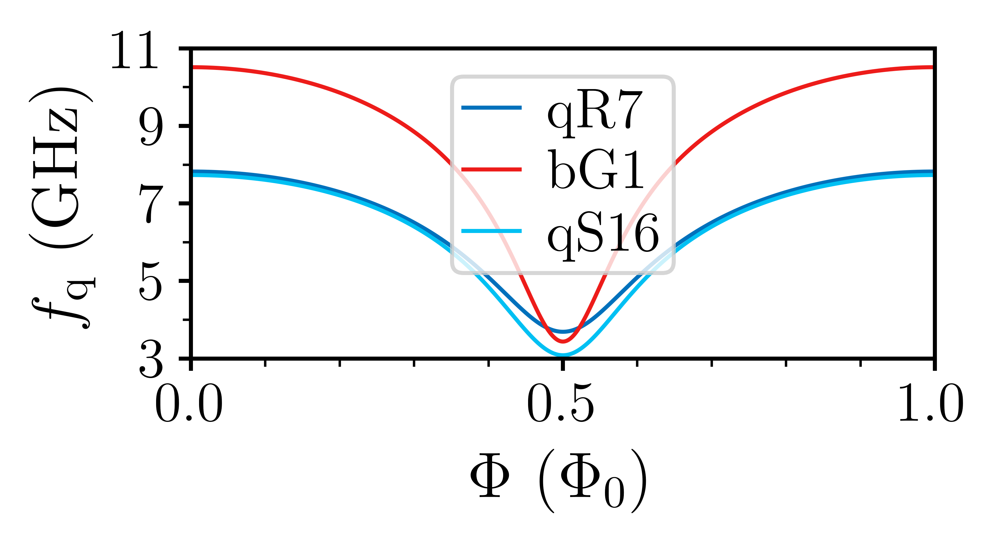

In [219]:

LWidth_Frame = 1
TickLength  = 3
TickLabelPad = 3

TextSize_Labels = 16
TextSize_Legend = 14
TextSize_Ticks = 14

LWidth_fit = 1

mm = 0.1/2.54
fig = plt.figure(figsize=(90*mm, 50*mm), dpi=1000)
### create grid for different subplots ###
spec = gridspec.GridSpec(ncols=1, nrows=1,width_ratios=[1], height_ratios=[1], wspace=0.0, hspace=0)

## Add coresponding subplots
# left parts of plot
ax0 = fig.add_subplot(spec[0])

### change axes thickness ###
axes=[ax0]
for ax in axes:
    for ax_loc in ['top','bottom','left','right']:
        ax.spines[ax_loc].set_linewidth(LWidth_Frame)

ax0.plot(phi_lookup, fq_q1_fit__vs__flux, color=darkblue, label='qR7', lw=LWidth_fit)
ax0.plot(phi_lookup, fq_c2_fit__vs__flux, color=red, label='bG1', lw=LWidth_fit)
ax0.plot(phi_lookup, fq_q3_fit__vs__flux, color=lightblue, label='qS16', lw=LWidth_fit)

positions_x_major = np.arange(0,1.01,0.5)
ax0.xaxis.set_major_locator(ticker.FixedLocator(positions_x_major))
#labels_x_major = ['$0.0$', '$0.5$', '$1.0$']
#ax0.xaxis.set_major_formatter(ticker.FixedFormatter(labels_x_major))
positions_x_minor = np.arange(0,1.01,0.1)
ax0.xaxis.set_minor_locator(ticker.FixedLocator(positions_x_minor))
ax0.tick_params(axis='x', labelsize=TextSize_Ticks, width=LWidth_Frame, length=TickLength, pad=TickLabelPad, color=black, labelcolor=black)

positions_y_major = np.arange(3,11.01,2)
ax0.yaxis.set_major_locator(ticker.FixedLocator(positions_y_major))
#labels_y_major = ['$0.0$', '$0.5$', '$1.0$']
#ax0.yaxis.set_major_formatter(ticker.FixedFormatter(labels_y_major))
positions_y_minor = np.arange(3,11,1)
ax0.yaxis.set_minor_locator(ticker.FixedLocator(positions_y_minor))
ax0.tick_params(axis='y', labelsize=TextSize_Ticks, width=LWidth_Frame, length=TickLength, pad=TickLabelPad, color=black, labelcolor=black)


ax0.set_xlabel(r'$\Phi\ (\Phi_0)$',size=TextSize_Labels)
ax0.set_ylabel(r'$f_{\rm{q}}\ (\rm{GHz})$',size=TextSize_Labels)

ax0.legend(fontsize=TextSize_Legend,frameon=True,borderpad=0.2,labelspacing=0.2,handletextpad=0.5,handlelength=1.0)
#ax0.grid()

ax0.set_xlim([0,1.0])
ax0.set_ylim([3,11])
plt.tight_layout()

#plt.savefig('calibrated_Qubits__qR7_bG1_qS16.jpg')
plt.show()

# Coupling Anticrossings

In [184]:
data_dir = url_to_GFQ_folder
cooldown_dir = '\\CS_BF_TH__2024_03_07__qR7_bG1_qS16__Coupling__Isolation__Paper2'
measurement_dir = '\\Messdaten\\'

url = data_dir + cooldown_dir + measurement_dir

## 3 Level Anticrossing

### ON RES: TT on q1, q2 on res, sweep q3 trough

In [185]:
# a1= 0.02
a_0p02 = r'S9ZEOY_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.04
a_0p04 = r'S9ZF5M_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.06
a_0p06 = r'S9ZD9I_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.08
a_0p08 = r'S9ZDZA_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.10
a_0p10 = r'S9ZFMC_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.12
a_0p12 = r'S9ZG30_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.14
a_0p14 = r'S9ZGJQ_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.16
a_0p16 = r'S9ZHE3_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.18
a_0p18 = r'S9ZHUU_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.20
a_0p20 = r'S9ZIBJ_QM_experiment_qubit_spectroscopy_sim_calib.h5'

measurement_files = [a_0p02,a_0p04,a_0p06,a_0p08,a_0p10,a_0p12,a_0p14,a_0p16,a_0p18,a_0p20]

LoadFiles, I1__list, Q1__list = [], [], []
for ii in range(0,len(measurement_files)):
    url = data_dir + cooldown_dir + measurement_dir + measurement_files[ii]
    LoadFiles.append(glob2.glob(url)[0])
    
    
    h5 = Data(LoadFiles[ii])
    
    I1__list.append(h5.data.i1_avg[:])
    Q1__list.append(h5.data.q1_avg[:])

fq3_set_vec = np.linspace(3.61,3.66,50+1,True)
fq1_sweep_vec = fq_q1_fit*1e9 - 180e6 + np.linspace(169*1e6, 195*1e6,  52+1, True)

In [187]:
window_length = 9
polyorder = 2

for ii in range(0,len(measurement_files)):
    if ii==0:
        I1__norm_list = I1__list[ii] / np.max(I1__list[ii])
        Q1__norm_list = Q1__list[ii] / np.max(Q1__list[ii])
        Amplitude1__norm_list = np.sqrt(I1__list[ii]**2+Q1__list[ii]**2) / np.max(np.sqrt(I1__list[ii]**2+Q1__list[ii]**2))
        Angle1__norm_list = np.angle(I1__list[ii]+1j*Q1__list[ii]) / np.max(np.angle(I1__list[ii]+1j*Q1__list[ii]))
    else:
        I1__norm_list = I1__norm_list + I1__list[ii]/np.max(I1__list[ii])
        Q1__norm_list = Q1__norm_list + Q1__list[ii]/np.max(Q1__list[ii])
        Amplitude1__norm_list = Amplitude1__norm_list  + np.sqrt(I1__list[ii]**2+Q1__list[ii]**2) / np.max(np.sqrt(I1__list[ii]**2+Q1__list[ii]**2))
        Angle1__norm_list = Angle1__norm_list + np.angle(I1__list[ii]+1j*Q1__list[ii]) / np.max(np.angle(I1__list[ii]+1j*Q1__list[ii]))
   
I1__avg_norm_list = I1__norm_list/len(I1__norm_list)
Q1__avg_norm_list = Q1__norm_list/len(Q1__norm_list)
Amplitude1__avg_norm_list = Amplitude1__norm_list/len(Amplitude1__norm_list)
Angle1__avg_norm_list = Angle1__norm_list/len(Angle1__norm_list)
avg_norm_list = [I1__avg_norm_list,Q1__avg_norm_list,Amplitude1__avg_norm_list,Angle1__avg_norm_list]

I1__savg_avg_norm_list = savgol_filter(I1__avg_norm_list, window_length, polyorder)
Q1__savg_avg_norm_list = savgol_filter(Q1__avg_norm_list, window_length, polyorder)
Amplitude1__savg_avg_norm_list = savgol_filter(Amplitude1__avg_norm_list, window_length, polyorder)
Angle1__savg_avg_norm_list = savgol_filter(Angle1__avg_norm_list, window_length, polyorder)
savg_avg_norm_list = [I1__savg_avg_norm_list,Q1__savg_avg_norm_list,Amplitude1__savg_avg_norm_list,Angle1__savg_avg_norm_list]


In [188]:
if False:
    
    for ii in range(0,len(I1_avg__mean_norm)):

        fig, ax = plt.subplots(1, 4, figsize = (20, 4))

        for jj in range(0,4):
            ax[jj].plot(fq1_sweep_vec, savg_avg_norm_list[jj][ii] )


        Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
        for i in range(0,4):
            ax[i].text(s=Label_Colorscale[i],x=ax[i].get_xlim()[0],y=ax[i].get_ylim()[1],ha='left',va='top',color='red',size=20)
            ax[i].set_xlabel('fq3_set_vec')
            ax[i].set_ylabel('fq1_vec')

        plt.show()
    

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/255376192.py:12: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )


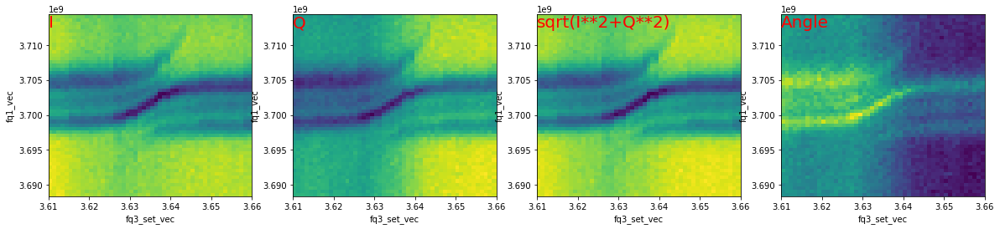

In [189]:
fig, ax = plt.subplots(1, 4, figsize = (20, 4))

b1,t1=0,15
b2,t2=15,40
b3,t3=40,-1

for jj in range(0,4):
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b1:t1], avg_norm_list[jj][:,b1:t1].T )
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b2:t2], avg_norm_list[jj][:,b2:t2].T )
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b3:t3], avg_norm_list[jj][:,b3:t3].T )
    
    ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )

Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    #ax[jj].axvline(3.71, color = 'red',ls='--')
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('fq3_set_vec')
    ax[jj].set_ylabel('fq1_vec')
plt.show()


#### Extract Points

In [190]:
Extract_Points = False
kk=1

In [191]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(fq3_set_vec, fq1_sweep_vec, np.abs(avg_norm_list[kk].T) )

    xtract.set_points()

In [192]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)
    
    
else:
    
    x0__tt_3LevAC = np.array([3.623,3.6258,3.6275,3.63,3.632,3.636,3.63817862,3.64274851,3.64762306,3.65219295,3.65747372])
    y0__tt_3LevAC = 1e-9*np.array([3.68882872e+09,3.69061619e+09,3.69280990e+09,3.69484111e+09,3.696e+09, 3.69725e+09,3.69775e+09,3.69825354e+09,3.69841604e+09,3.69841604e+09,3.69841604e+09])
    
    x1__tt_3LevAC = np.array([3.6107592617385844,3.614821388381356,3.6192897276884053,3.622437875836553,3.6255860239847015,3.6283279594685722,3.6314761076167206,3.6342180431005917,3.636553765920185,3.638889488739779,3.641834530555789,3.644678019205729,3.6486385926824316,3.6517867408305795,3.655036442144797,3.657879930794737,3.6597078877839846])
    y1__tt_3LevAC = 1e-9*np.array([3698903530.117032,3698741033.183012,3698903530.117032,3698984778.584042,3699147275.518062,3699797263.2541428,3700447250.9902234,3701422232.594344,3702397214.1984644,3703128450.401555,3703615941.2036157,3703859686.6046457,3704103432.005676,3704103432.005676,3704184680.472686,3704184680.472686,3704184680.472686])
    
    x2__tt_3LevAC = np.array([3.611267027568931,3.6159384732081183,3.619188174522336,3.6225394290026225,3.6261953429811173,3.630257469623889,3.6338118304363145,3.636756872252324,3.6396003609022642,3.642,3.645])
    y2__tt_3LevAC = 1e-9*np.array([3704428425.873716,3704347177.406706,3704347177.406706,3704509674.340726,3704590922.807736,3705078413.6097965,3705972146.746907,3707190873.752058,3709140836.9602995,3711659539.437611,3713853248.0468826])
    
x__tt_3LevAC = [x0__tt_3LevAC, x1__tt_3LevAC, x2__tt_3LevAC]
y__tt_3LevAC = [y0__tt_3LevAC, y1__tt_3LevAC, y2__tt_3LevAC]


#### Plot 3Lev AC again with extracted points

C:\Users\Simon Geisert\miniconda3\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/2840901352.py:48: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )
C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/2840901352.py:48: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gourau

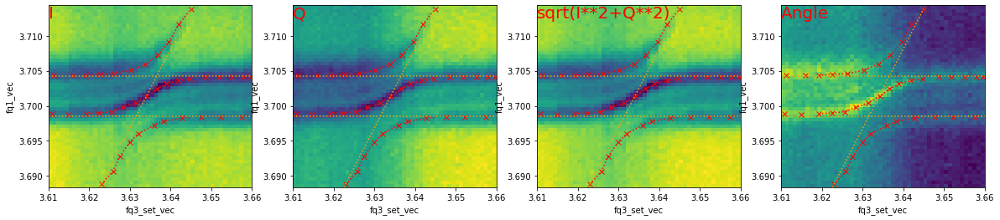

In [199]:
def lin_fit(x,m,n):
    return(x*m+n)

X__lin_fit_of_AC = np.array([x0__tt_3LevAC[0],x2__tt_3LevAC[-1]])
Y__lin_fit_of_AC = np.array([y0__tt_3LevAC[0],y2__tt_3LevAC[-1]])
popt,pcov = curve_fit(lin_fit,X__lin_fit_of_AC,Y__lin_fit_of_AC)
m_3LevAC = popt[0]
n_3LevAC = popt[1]



b1,t1=0,15
b2,t2=15,40
b3,t3=40,-1

f_lower = 3.6985
f_upper = 3.70425

X__min__fitting_AC = 3.62
X__max__fitting_AC = 3.645
X__fitting_AC = np.linspace(X__min__fitting_AC,X__max__fitting_AC,101,True)
spl=[]
k_order = [5]*3
for ii in range(0,len(x__tt_3LevAC)):
    if ii==0: 
        X__lin0 = np.linspace(X__min__fitting_AC, np.min(x__tt_3LevAC[ii]), 11, True)
        Y__lin0 = lin_fit(X__lin0,*popt) 
        spl0 = interp1d(np.append(X__lin0,x__tt_3LevAC[ii]), np.append(Y__lin0,y__tt_3LevAC[ii]))
        #spl.append(UnivariateSpline(np.append(X__lin0,x__tt_3LevAC[ii]), np.append(Y__lin0,y__tt_3LevAC[ii]),k=k_order[ii]))
    elif ii==2:
        X__lin2 = np.linspace(np.max(x__tt_3LevAC[ii]), X__max__fitting_AC, 11, True)
        Y__lin2 = lin_fit(X__lin2,*popt) 
        spl2 = interp1d(np.append(x__tt_3LevAC[ii],X__lin2), np.append(y__tt_3LevAC[ii],Y__lin2))
        #spl.append(UnivariateSpline(np.append(x__tt_3LevAC[ii],X__lin2), np.append(y__tt_3LevAC[ii],Y__lin2),k=k_order[ii]))
    else:
        spl1 = interp1d(x__tt_3LevAC[ii], y__tt_3LevAC[ii])
        #spl.append(UnivariateSpline(x__tt_3LevAC[ii], y__tt_3LevAC[ii],k=k_order[ii]))
spl=[spl0,spl1,spl2]        

%matplotlib inline
fig, ax = plt.subplots(1, 4, figsize = (20, 4))

for jj in range(0,4):
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b1:t1], avg_norm_list[jj][:,b1:t1].T )
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b2:t2], avg_norm_list[jj][:,b2:t2].T )
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b3:t3], avg_norm_list[jj][:,b3:t3].T )
    
    ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )
    
    for ii in range (0,len(x__tt_3LevAC)):
        ax[jj].plot(x__tt_3LevAC[ii], y__tt_3LevAC[ii], color='red',ls='',marker='x')
        ax[jj].plot(X__fitting_AC, spl[ii](X__fitting_AC), color='red',ls=':',marker='')
        
        
    ax[jj].axhline(y=f_lower,color='orange',ls=':')
    ax[jj].axhline(y=f_upper,color='orange',ls=':')
    ax[jj].plot(X__fitting_AC,lin_fit(X__fitting_AC,*popt),color='orange',ls=':')

Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    #ax[jj].set_ylim([3.65,3.75])
    ax[jj].set_ylim([np.min(fq1_sweep_vec)*1e-9,np.max(fq1_sweep_vec)*1e-9])
    
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('fq3_set_vec')
    ax[jj].set_ylabel('fq1_vec')
    
plt.show()


In [201]:
with open('x__tt_3LevAC.pkl', 'wb') as f:
    pickle.dump(x__tt_3LevAC , f)
with open('y__tt_3LevAC.pkl', 'wb') as f:
    pickle.dump(y__tt_3LevAC , f)

#### Make the fit

In [202]:
def H_coupled(f0, f1, f2, g01, g12, g02):
    H = np.array([
        [f0, -g01, -g02], 
        [-g01, f1, -g12], 
        [-g02, -g12, f2]
    ])   
    return H

def cost_function(g, f0_guess, f1_guess, f2_guess, f0_sim, f1_sim, f2_sim):
    g01 = g[0]
    g12 = g[1]
    g02 = g[2]
    
    E, v = Sweep_f0(f0_guess, f1_guess, f2_guess, g01, g12, g02)
    
    return np.sum( np.abs((f0_sim-E[:,0])) + np.abs((f1_sim-E[:,1])) + np.abs((f2_sim-E[:,2]))  )

def Sweep_f0(f0_sweep, f1, f2, g01, g12, g02):
    E_sweep = []
    v_sweep = []
    for f in f0_sweep:
        H = H_coupled(f, f1, f2, g01, g12, g02)
        #print(H)
        w, v = np.linalg.eig(H)
        E = np.real(w)
        E = np.array(E)
        v = np.array(v)
        perm = E.argsort()
        E = E[perm]
        v = v[perm]
        E_sweep.append(E)
        v_sweep.append(v)
    return np.array(E_sweep), np.array(v_sweep)

In [203]:
g0 = [0.001,0.01,0.001]
g_bounds = ((0,0.1),(0,0.1),(0,0.1))

res = minimize(cost_function, g0, args = (lin_fit(X__fitting_AC, m_3LevAC, n_3LevAC),f_lower,f_upper,
                                         spl[0](X__fitting_AC),spl[1](X__fitting_AC),spl[2](X__fitting_AC)),
                   method = 'Nelder-Mead', bounds = g_bounds, tol = 1e-6, options = {'maxiter': 1000})

In [204]:
X__plotting_AC = np.linspace(3.60,3.67,101,True)

print(res.x*1000)
g_vec = res.x
E, v = Sweep_f0(lin_fit(X__plotting_AC, m_3LevAC, n_3LevAC), f_lower, f_upper, g_vec[0],g_vec[1],g_vec[2])

[2.4116925 0.        2.3754539]


#### Show fitted 3 Level AC

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/2844862716.py:21: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(fq3_set_vec, fq1_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )


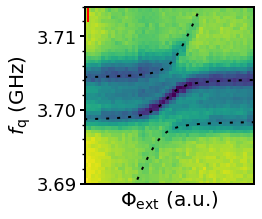

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/2844862716.py:21: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(fq3_set_vec, fq1_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )


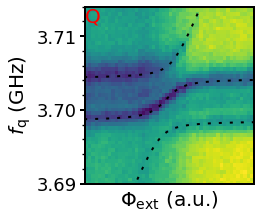

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/2844862716.py:21: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(fq3_set_vec, fq1_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )


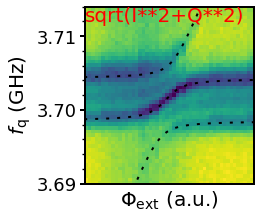

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/2844862716.py:21: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax.pcolor(fq3_set_vec, fq1_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )


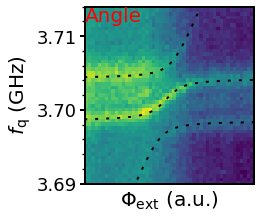

In [205]:
#%mathplotlib widgets
%matplotlib inline

TextSize_Label=20
TextSize_Ticks=18

LWidth_Frame = 2

TickLength = 5
TickLabelPad = 3

mm = 0.1/2.54
Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4): 
    
    fig, ax = plt.subplots(1,1 , figsize = (95*mm, 80*mm))
    
    for ax_loc in ['top','bottom','left','right']:
        ax.spines[ax_loc].set_linewidth(LWidth_Frame)

    ax.pcolor(fq3_set_vec, fq1_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )
    
    ax.set_xlim([3.61,3.66])
    ax.tick_params(axis='x', labelsize=0, width=0, length=0, pad=0, color='white', labelcolor='white')
    ax.set_xlabel('$\Phi_\mathrm{ext}$ (a.u.)',size=TextSize_Label, labelpad=5)
    
    ax.set_ylim([3.69,3.714])
    positions_y_major = np.arange(3.69,3.711,0.01)
    ax.yaxis.set_major_locator(ticker.FixedLocator(positions_y_major))
    #labels_y_major = ['$0.0$', '$0.5$', '$1.0$']
    #ax0.yaxis.set_major_formatter(ticker.FixedFormatter(labels_y_major))
    positions_y_minor = np.arange(3.69,3.741,0.002)
    ax.yaxis.set_minor_locator(ticker.FixedLocator(positions_y_minor))
    ax.tick_params(axis='y', which='major', labelsize=TextSize_Ticks, width=LWidth_Frame, length=TickLength, pad=TickLabelPad, color=black, labelcolor=black)
    ax.tick_params(axis='y', which='minor', labelsize=TextSize_Ticks, width=2*LWidth_Frame/3, length=2*TickLength/3, pad=TickLabelPad, color=black, labelcolor=black)
    ax.set_ylabel('$f_\mathrm{q}$ (GHz)',size=TextSize_Label)

    ax.plot(X__plotting_AC, E, dashes=[1.5, 4], lw= 2, color = 'black')
    
    ax.text(s=Label_Colorscale[jj],x=ax.get_xlim()[0],y=ax.get_ylim()[1],ha='left',va='top',color='red',size=20)

    plt.tight_layout()
    plt.show()






### OFF RES: Ramsey on q1 & q1 on res, q2 at SS, sweep q3 trough

In [206]:
#data_dir = 'C:\\Users\\soere\\Soeren\\GFQ\\Messungen'
#cooldown_dir = '\\CS_BF_TH__2023-02-08_*'
#measurement_dir = '\\Messdaten\\qO19'

measurement_files = 'Ramsey_on_q1_sweeping_q3_through\\*\\*.h5'

url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

h5 = Data(LoadFiles[0]) 
curr_vec = h5.data.flux[:]
t_us = h5.data.t_wait[:]

i1 = np.zeros(( len(LoadFiles), len(curr_vec), len(t_us) ))
q1 = np.zeros(( len(LoadFiles), len(curr_vec), len(t_us) ))
amplitude1 = np.zeros(( len(LoadFiles), len(curr_vec), len(t_us) ))
angle1 = np.zeros(( len(LoadFiles), len(curr_vec), len(t_us) ))

for ii,File in enumerate (LoadFiles):
        
    h5 = Data(File)  
        
    i1[ii] = h5.data.i_avg[:]
    q1[ii] = h5.data.q_avg[:]
    amplitude1[ii] = np.sqrt(i1[ii]**2+q1[ii]**2)
    angle1[ii] = np.angle(i1[ii] + 1j*q1[ii])

i1__mean = np.mean(i1, axis=0)    
q1__mean = np.mean(q1, axis=0)  
amplitude1__mean = np.mean(amplitude1, axis=0)  
angle1__mean = np.mean(angle1, axis=0)  

mean = [i1__mean, q1__mean, amplitude1__mean, angle1__mean]

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/3550309999.py:5: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[jj].pcolor(curr_vec*1000, t_us, mean[jj].T )


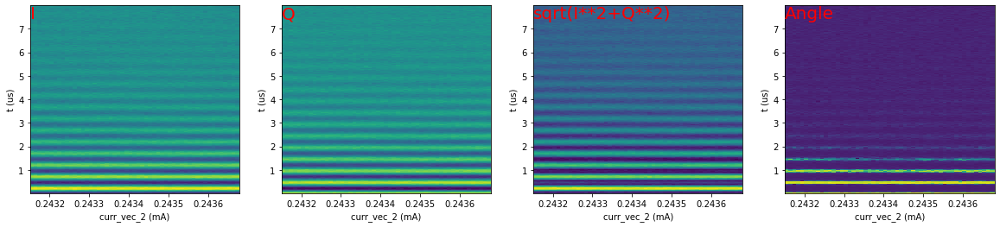

In [207]:
fig, ax = plt.subplots(1, 4, figsize = (20, 4))

for jj in range(0,4):
    
    ax[jj].pcolor(curr_vec*1000, t_us, mean[jj].T )

Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('curr_vec_2 (mA)')
    ax[jj].set_ylabel('t (us)')
plt.show()

#### Make FFT of Data

In [208]:
FFT_theo = np.zeros((4, len(curr_vec), len(t_us)))
#delta_vec = np.zeros((4,len(curr_vec)))

n = len(t_us)
timestep = t_us[1] - t_us[0]
freq = np.fft.fftfreq(n, d=timestep)

mask = freq > 0
for ii in range(0,4):
    FFT_theo[ii] = 2*np.abs(np.fft.fft(mean[ii])/n)
    #FFT_pos[ii] = FFT[ii,:,1:-FFT[ii].shape[1]//2]
    #delta_vec[ii]= freq_pos[np.argmax(FFT_pos[ii], axis = 1)]

3.517359673258351


C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/2309146487.py:7: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[jj].pcolor(curr_vec*1000, f_plot_vec+freq[mask]*1e-3, FFT_theo[jj][:,mask].T, cmap = 'magma')


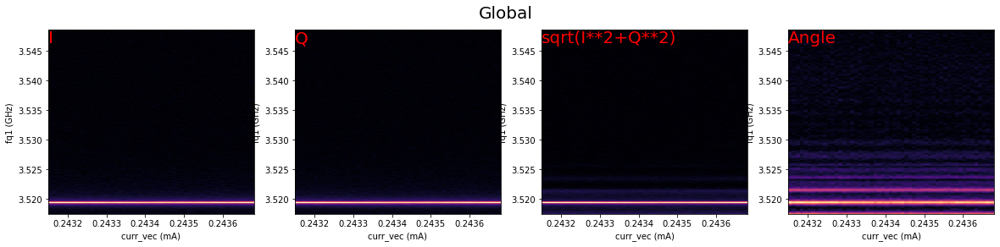

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/2309146487.py:20: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[jj].pcolor(curr_vec*1000, freq[mask], FFT_theo[jj][:,mask].T, cmap = 'magma')


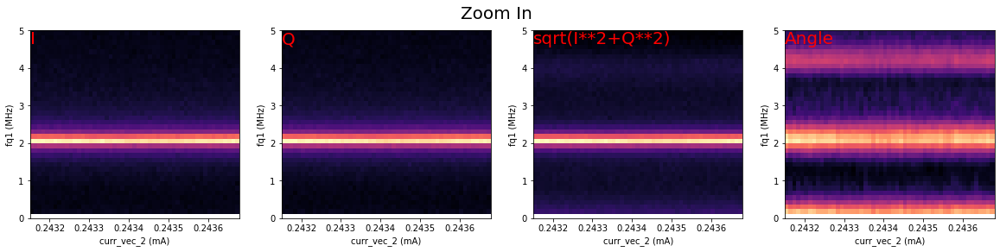

In [209]:
f_plot_vec = (fq_q1_fit*1e9 - 180e6 - 2*1e6)*1e-9 # 180 MHz is IF-freq, +2MHz detuning
print(f_plot_vec)

fig, ax = plt.subplots(1, 4, figsize = (20, 4))
plt.suptitle("Global", fontsize=20)
for jj in range(0,4):
    ax[jj].pcolor(curr_vec*1000, f_plot_vec+freq[mask]*1e-3, FFT_theo[jj][:,mask].T, cmap = 'magma')

Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    #ax[jj].set_ylim([-4, 1])
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('curr_vec (mA)')
    ax[jj].set_ylabel('fq1 (GHz)')
plt.show()

fig, ax = plt.subplots(1, 4, figsize = (20, 4))
plt.suptitle("Zoom In", fontsize=20)
for jj in range(0,4):
    ax[jj].pcolor(curr_vec*1000, freq[mask], FFT_theo[jj][:,mask].T, cmap = 'magma')

Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    ax[jj].set_ylim([0, 5])
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('curr_vec_2 (mA)')
    ax[jj].set_ylabel('fq1 (MHz)')
plt.show()

#### Fit Ramsey

In [210]:
def damped_oscillation(t, A, tau, f, phase, off):
    return A * np.exp(- t / tau) * np.cos(2 * np.pi * f * t + phase) + off
def damped_oscillation_gauss(t, A, tau, f, phase, off):
    return A * np.exp(- t**2 / tau**2) * np.cos(2 * np.pi * f * t + phase) + off

T2_vec = np.zeros((4,len(curr_vec)))
f_vec = np.zeros((4,len(curr_vec)))

for ii in range(0,4):
    for jj in range(0,len(curr_vec)):
   
        A = 0
        tau = 5
        f = 2
        Offset = 0.5

        try:
            popt, pcov = curve_fit(damped_oscillation, t_us, mean[ii][jj], p0=[A, tau, f, np.pi, Offset])
            T2_vec[ii][jj] = popt[1]
            f_vec[ii][jj] = popt[2]
        except:
            print('fail')

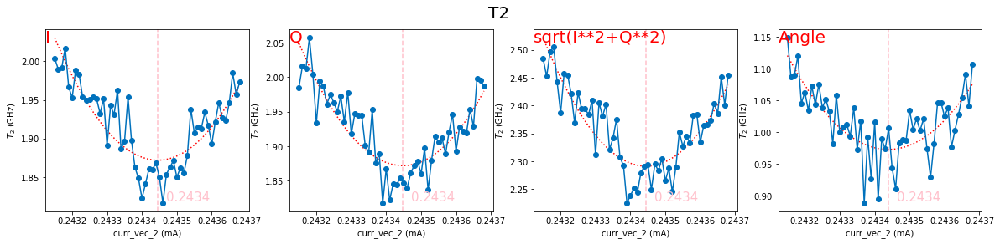

In [211]:
fig, ax = plt.subplots(1, 4, figsize = (20, 4))
plt.suptitle("T2", fontsize=20)

spl_T2=[]
idx_min_T2=[]
curr_vec__plot = np.linspace(np.min(curr_vec),np.max(curr_vec),1001,True)
for jj in range(0,4):
    #spl_T2.append(interp1d(curr_vec, T2_vec[jj], kind='quadratic'))
    spl_T2.append(UnivariateSpline(curr_vec, T2_vec[jj],k=2))
    idx_min_T2.append(np.argmin(spl_T2[jj](curr_vec__plot)))
    ax[jj].axvline(x=curr_vec__plot[idx_min_T2[jj]]*1000,ls='--',color='pink')
    ax[jj].text(s=round(curr_vec__plot[idx_min_T2[jj]]*1000,4) ,x=curr_vec__plot[idx_min_T2[jj]]*1000*1.0001,y=np.min(T2_vec[jj]),va='bottom',ha='left',size=15,color='pink')
    ax[jj].plot(curr_vec__plot*1000, spl_T2[jj](curr_vec__plot), color='red',ls=':',marker='')
    ax[jj].plot(curr_vec*1000, T2_vec[jj],marker='o',color=darkblue)

Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    #ax[jj].set_ylim([-4, 1])
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('curr_vec_2 (mA)')
    ax[jj].set_ylabel('$T_\mathrm{2}$ (GHz)')
plt.show()

C:\Users\Simon Geisert\miniconda3\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


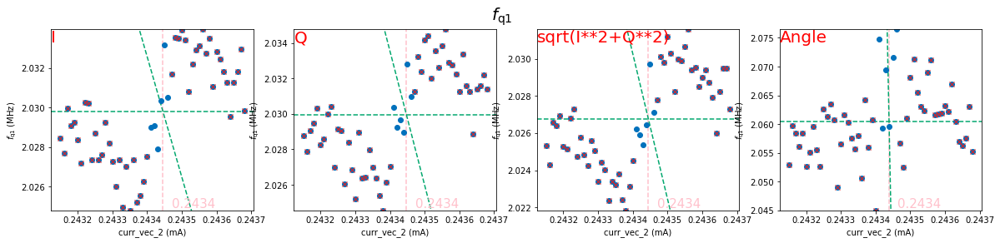

In [212]:
def lin_fit(x,m,n):
    return(x*m+n)

idx_min_points, idx_max_points, fq1_mean_val, X__for_lin_fit, Y__for_lin_fit, m__lin_fit, n__lin_fit, m__m_lin_fit, n__m_lin_fit = [],[],[],[],[],[],[],[],[]

for jj in range(0,4):
    idx_min_pt = np.argsort(f_vec[jj])[0]
    idx_max_pt = np.argsort(f_vec[jj])[-2]
    
    X__for_lin_fit.append(curr_vec[idx_min_pt])
    Y__for_lin_fit.append(f_vec[jj][idx_min_pt])
    X__for_lin_fit.append(curr_vec[idx_max_pt])
    Y__for_lin_fit.append(f_vec[jj][idx_max_pt])
    
    X_pt_extracted = [X__for_lin_fit[2*jj],X__for_lin_fit[2*jj+1]]
    Y_pt_extracted = [Y__for_lin_fit[2*jj],Y__for_lin_fit[2*jj+1]]
    
    
    popt,pcov = curve_fit(lin_fit,X_pt_extracted, Y_pt_extracted)
    m__lin_fit.append(popt[0])
    m__m_lin_fit.append(-m__lin_fit[jj])
    
    fq1_mean_val.append(np.mean(f_vec[jj]))
    n__lin_fit.append(popt[-1])
    #n__m_lin_fit.append(np.mean(Y_pt_extracted)-m__m_lin_fit[jj]*np.mean(X_pt_extracted)) 
    n__m_lin_fit.append(fq1_mean_val[jj] - m__m_lin_fit[jj]*curr_vec__plot[idx_min_T2[jj]])

    
X__plot_lin_fit = np.linspace(0.2433/1e3,0.2436/1e3,101,True)

b,t = 26,-22

fig, ax = plt.subplots(1, 4, figsize = (20, 4))
plt.suptitle("$f_\mathrm{q1}$", fontsize=20)
for jj in range(0,4):
    
    ax[jj].axvline(x=curr_vec__plot[idx_min_T2[jj]]*1000,ls='--',color='pink')
    ax[jj].text(s=round(curr_vec__plot[idx_min_T2[jj]]*1000,4) ,x=curr_vec__plot[idx_min_T2[jj]]*1000*1.0001,y=np.min(f_vec[jj]),va='bottom',ha='left',size=15,color='pink')
    
    
    ax[jj].axhline(y=fq1_mean_val[jj],ls='--',color=green)
    ax[jj].plot(X__plot_lin_fit*1e3, lin_fit(X__plot_lin_fit, m__m_lin_fit[jj], n__m_lin_fit[jj]),color=green,ls='--')
    
    ax[jj].plot(curr_vec*1000, f_vec[jj],ls='',marker='o',color=darkblue)

    ax[jj].plot(curr_vec[:b]*1000, f_vec[jj][:b], ls='', marker='x', color=red)
    ax[jj].plot(curr_vec[t:]*1000, f_vec[jj][t:], ls='', marker='x', color=red)
    
    
Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    ax[jj].set_ylim([np.min(f_vec[jj]), np.max(f_vec[jj])])
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('curr_vec_2 (mA)')
    ax[jj].set_ylabel('$f_\mathrm{q1}$ (MHz)')
plt.show()

In [217]:
with open('curr_vec_Ramsey_offres_q1.pkl', 'wb') as f:
    pickle.dump(curr_vec , f)
with open('f_vec_Ramsey_offres_q1.pkl', 'wb') as f:
    pickle.dump(f_vec , f)

#### Fit AC that we get from Ramsey

In [218]:
def H_coupled(f0, f1, g01):
    H = np.array([
        [f0, -g01], 
        [-g01, f1], 
    ])   
    return H

def cost_function(g, f0_guess, f1_guess, f0_sim, f1_sim):
    g01 = g[0]
    
    E, v = Sweep_f0(f0_guess, f1_guess, g01)
    
    return np.sum( np.abs((f0_sim-E[:,0])) )# + np.abs((f1_sim-E[:,1])) )

def Sweep_f0(f0_sweep, f1, g01):
    E_sweep = []
    v_sweep = []
    for f in f0_sweep:
        H = H_coupled(f, f1, g01)
        #print(H)
        w, v = np.linalg.eig(H)
        E = np.real(w)
        E = np.array(E)
        v = np.array(v)
        perm = E.argsort()
        E = E[perm]
        v = v[perm]
        E_sweep.append(E)
        v_sweep.append(v)
    return np.array(E_sweep), np.array(v_sweep)

In [219]:
curr_vec__plot = np.linspace(np.min(curr_vec),np.max(curr_vec),1001,True)

g0 = [0.0001]
g_bounds = [(0,0.1)]
res__list,E__list,v__list = [],[],[]

for jj in range(0,4):
    res = minimize(cost_function, g0, args = (lin_fit(curr_vec[:b], m__m_lin_fit[jj], n__m_lin_fit[jj]), fq1_mean_val[jj], f_vec[jj][:b], f_vec[jj][t:]),
                    method = 'Nelder-Mead', bounds = g_bounds, tol = 1e-6, options = {'maxiter': 1000} )
    
    res__list.append(res)

    
    E, v = Sweep_f0(lin_fit(curr_vec__plot, m__m_lin_fit[jj], n__m_lin_fit[jj]), fq1_mean_val[jj], res__list[jj].x[0])
    E__list.append(E)
    v__list.append(v)

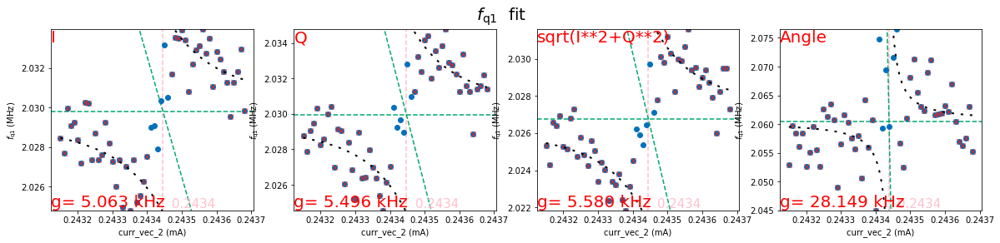

In [220]:
fig, ax = plt.subplots(1, 4, figsize = (20, 4))
plt.suptitle("$f_\mathrm{q1}$  fit", fontsize=20)

for jj in range(0,4):
    
    ax[jj].axvline(x=curr_vec__plot[idx_min_T2[jj]]*1000,ls='--',color='pink')
    ax[jj].text(s=round(curr_vec__plot[idx_min_T2[jj]]*1000,4) ,x=curr_vec__plot[idx_min_T2[jj]]*1000*1.0001,y=np.min(f_vec[jj]),va='bottom',ha='left',size=15,color='pink')
    
    fq1_mean_val.append(np.mean(f_vec[jj])*0.99977)
    ax[jj].axhline(y=fq1_mean_val[jj],ls='--',color=green)
    ax[jj].plot(X__plot_lin_fit*1e3, lin_fit(X__plot_lin_fit, m__m_lin_fit[jj], n__m_lin_fit[jj]),color=green,ls='--')
    
    ax[jj].plot(curr_vec*1000, f_vec[jj],ls='',marker='o',color=darkblue)

    ax[jj].plot(curr_vec[:b]*1000, f_vec[jj][:b], ls='', marker='x', color=red)
    ax[jj].plot(curr_vec[t:]*1000, f_vec[jj][t:], ls='', marker='x', color=red)
    
    ax[jj].plot(curr_vec__plot*1000, E__list[jj], dashes=[1.5, 4], lw= 2, color = 'black')
    
Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    ax[jj].set_ylim([np.min(f_vec[jj]), np.max(f_vec[jj])])
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].text(s='g= {:.3f} kHz'.format(res__list[jj].x[0]*1000), x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[0],ha='left',va='bottom',color='red',size=20)
    ax[jj].set_xlabel('curr_vec_2 (mA)')
    ax[jj].set_ylabel('$f_\mathrm{q1}$ (MHz)')
plt.show()

### OFF RES: q1 on res, q2 at SS, TT on q3 & sweep q3 trough

In [221]:
measurement_files = '\\Two_Tone_on_q3_while_sweeping_q3_through_q1\\*\\*.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

File, curr_vec, f_vec, list_4er = [],[],[],[]
i1, q1, amplitude, angle = [np.empty((19,54,201)) for i in range(0,4)]

for ii in range(0,len(LoadFiles)):
    File.append(LoadFiles[ii])
    h5 = Data(File[ii]) 
    
    curr_vec.append(h5.data.flux[:])
    f_vec.append(h5.data.qubit_if_freq[:])
    
    i1[ii] = h5.data.i_avg[:]
    q1[ii] = h5.data.q_avg[:]
    amplitude[ii] = np.sqrt(i1[ii]**2+q1[ii]**2)
    angle[ii] = np.angle(i1[ii]+1j*q1[ii])

curr_vec_0 = curr_vec[0]   
f_vec_0 = f_vec[0]
list_mean = [np.mean(i1, axis=0), np.mean(q1, axis=0), np.mean(amplitude, axis=0), np.mean(angle, axis=0)]

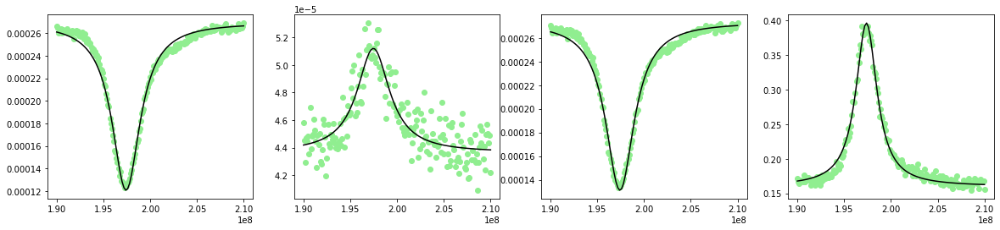

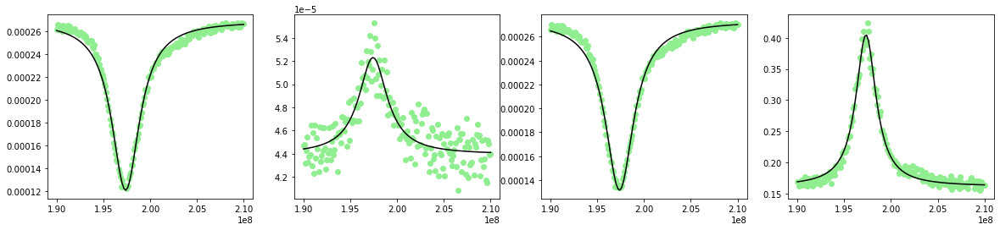

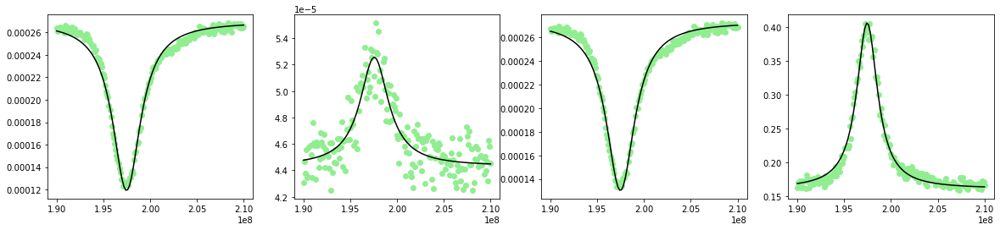

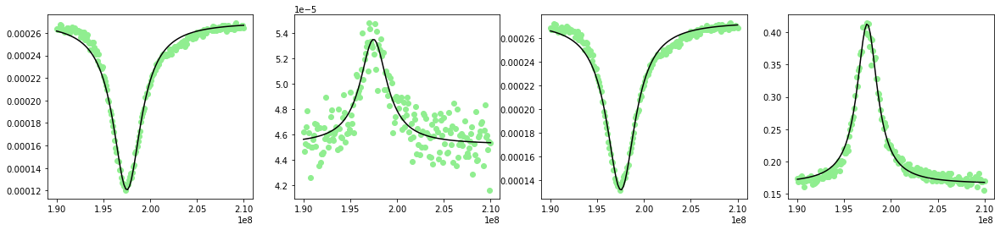

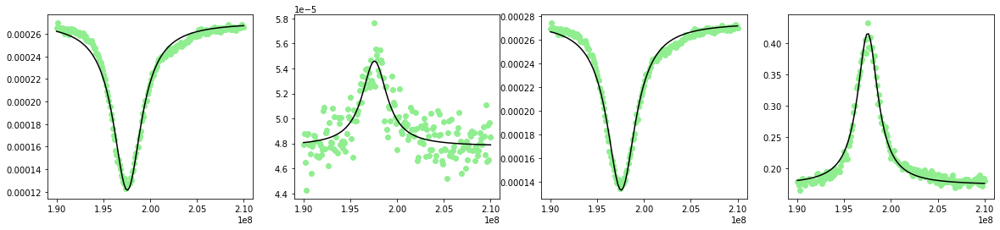

...

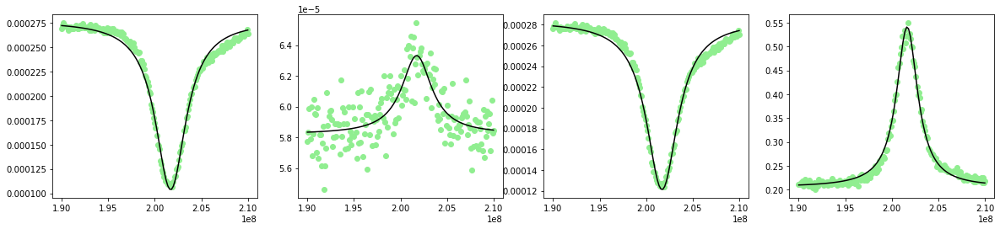

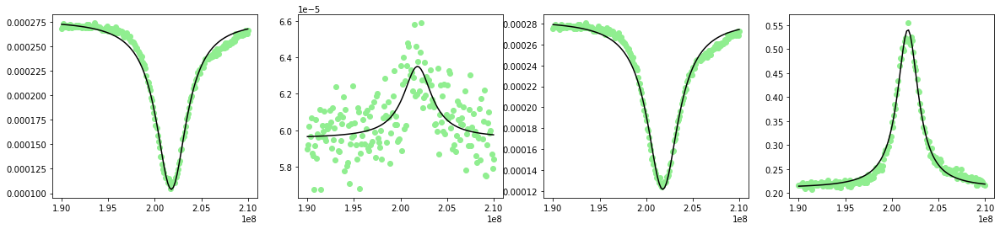

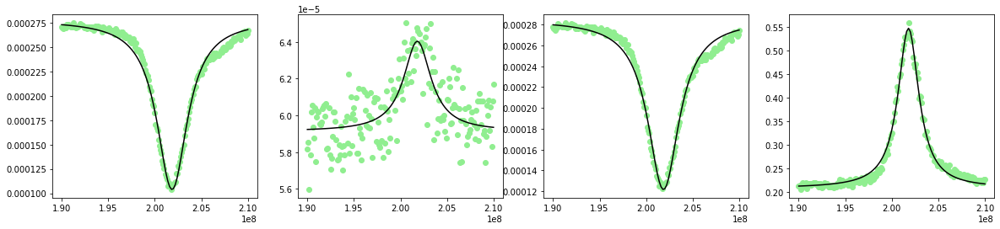

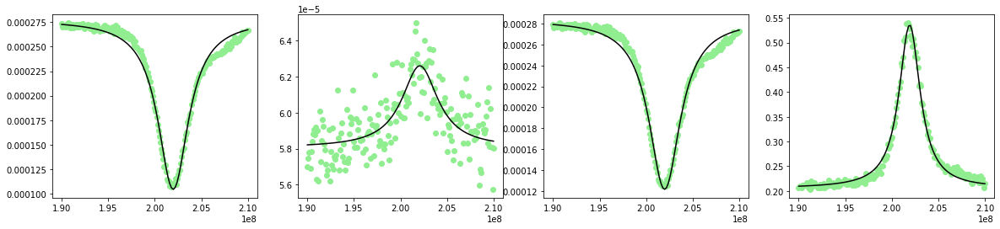

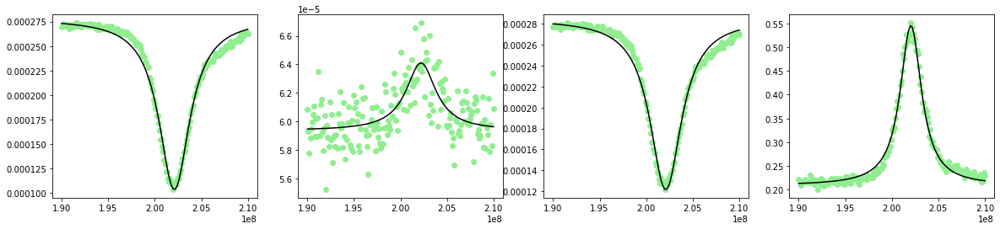

In [222]:
def lorentzian(x, x0, a, gam, off):
    return a * gam**2 / ( gam**2 + ( x - x0 )**2) + off
#
#for ii in range(0,len(LoadFiles)):
#    for jj in
 
f_vec_plot = np.linspace(np.min(f_vec_0), np.max(f_vec_0), 101)

popt_vec = np.empty((len(curr_vec_0),4,4))
#for ii in range(0,len(LoadFiles)):
for jj in range(0,len(curr_vec_0)):
        
    fig, ax = plt.subplots(1, 4, figsize = (20, 4))

    p0_13 = [2*1e8, -0.0001, 0.01e8, 0.00026]
    p0_4 = [2*1e8, 0.1, 0.01e8, 0.2]
    
    for ll in range(0,4):
        if ll<3: 
            p0 = p0_13
        else: 
            p0 = p0_4
            
        popt, pcov = curve_fit(lorentzian,f_vec_0, list_mean[ll][jj],p0)
        popt_vec[jj,ll]=popt
        
        ax[ll].plot(f_vec_0, list_mean[ll][jj],color='lightgreen',marker='o',ls='')
        #ax[ll].plot(f_vec_plot, lorentzian(f_vec_plot, *p0),color='brown',ls='-')
        ax[ll].plot(f_vec_plot, lorentzian(f_vec_plot, *popt),color='black',ls='-')

    plt.show()


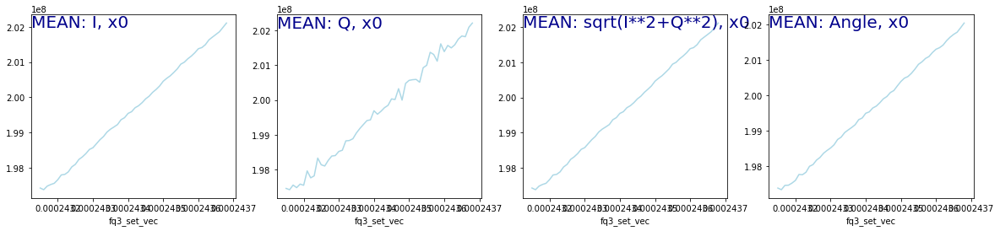

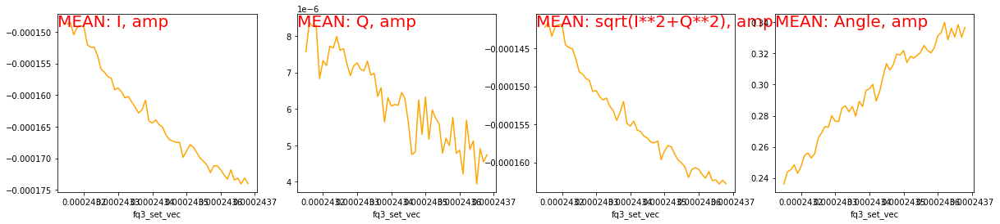

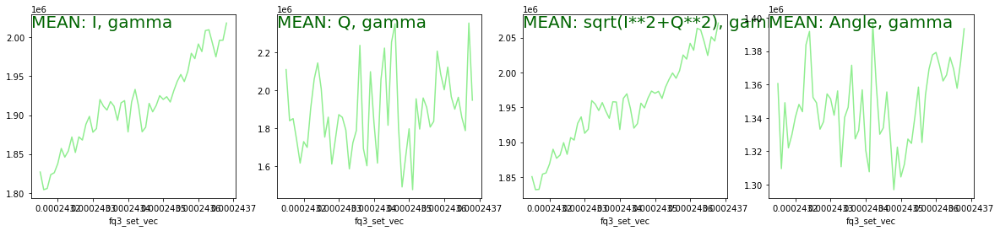

In [223]:
Label_Colorscale = ['MEAN: I, x0','MEAN: Q, x0','MEAN: sqrt(I**2+Q**2), x0','MEAN: Angle, x0']
fig, ax = plt.subplots(1, 4, figsize = (20, 4))
for jj in range(0,4):
    ax[jj].plot(curr_vec_0, popt_vec[:,jj,0].T, color='lightblue')
for jj in range(0,4):
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='darkblue',size=20)
    ax[jj].set_xlabel('fq3_set_vec')
    #ax[jj].set_ylabel('fq1_vec')
plt.show()

Label_Colorscale = ['MEAN: I, amp','MEAN: Q, amp','MEAN: sqrt(I**2+Q**2), amp','MEAN: Angle, amp']
fig, ax = plt.subplots(1, 4, figsize = (20, 4))
for jj in range(0,4):
    ax[jj].plot(curr_vec_0, popt_vec[:,jj,1].T, color='orange')
for jj in range(0,4):
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('fq3_set_vec')
    #ax[jj].set_ylabel('fq1_vec')
plt.show()

Label_Colorscale = ['MEAN: I, gamma','MEAN: Q, gamma','MEAN: sqrt(I**2+Q**2), gamma','MEAN: Angle, gamma']
fig, ax = plt.subplots(1, 4, figsize = (20, 4))
for jj in range(0,4):
    ax[jj].plot(curr_vec_0, np.abs(popt_vec[:,jj,2]).T, color='lightgreen')
for jj in range(0,4):
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='darkgreen',size=20)
    ax[jj].set_xlabel('fq3_set_vec')
    #ax[jj].set_ylabel('fq1_vec')
plt.show()

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/312706479.py:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[jj].pcolor(curr_vec_0, f_vec_0, list_mean[jj].T)
C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/312706479.py:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[jj].pcolor(curr_vec_0, f_vec_0, list_mean[jj].T)
C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/312706479.py:6: MatplotlibDeprecationWarning: shading='flat' when X and Y h

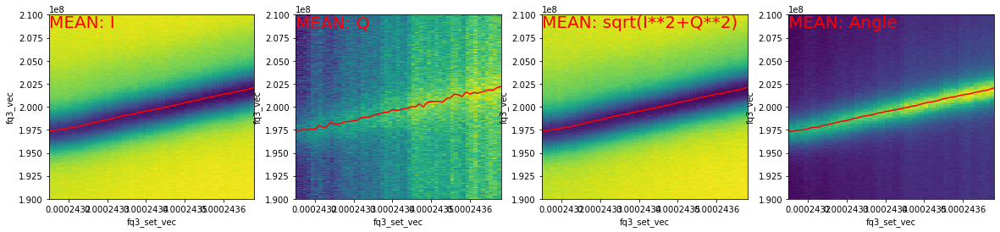

In [224]:
Label_Colorscale = ['MEAN: I','MEAN: Q','MEAN: sqrt(I**2+Q**2)','MEAN: Angle']

fig, ax = plt.subplots(1, 4, figsize = (20, 4))

for jj in range(0,4):
    ax[jj].pcolor(curr_vec_0, f_vec_0, list_mean[jj].T)
    ax[jj].plot(curr_vec_0, popt_vec[:,jj,0].T, color='red')

for jj in range(0,4):
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('fq3_set_vec')
    ax[jj].set_ylabel('fq3_vec')
plt.show()


In [229]:
with open('curr_vec_tt_offres_q3.pkl', 'wb') as f:
    pickle.dump(curr_vec_0 , f)
with open('f_vec_tt_offres_q3.pkl', 'wb') as f:
    pickle.dump(popt_vec[:,0,0] , f)

### OFF RES  PI/noPI:  q1 on res, q2 at SS, q3 on res

#### NO pi Pulse on q3

In [230]:
measurement_files = '\\T2_on_q1_while_q3_onres_nopi\\*\\*.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

File, t_us_vec, list_4er = [],[],[]
i1, q1, amplitude, angle = [np.empty((19,198)) for i in range(0,4)]

for ii in range(0,len(LoadFiles)):
    File.append(LoadFiles[ii])
    h5 = Data(File[ii]) 
    
    t_us_vec.append(h5.data.t_wait[:])

    i1[ii] = h5.data.i_avg[:]
    q1[ii] = h5.data.q_avg[:]
    amplitude[ii] = np.sqrt(i1[ii]**2+q1[ii]**2)
    angle[ii] = np.angle(i1[ii]+1j*q1[ii])

t_us_vec_0 = t_us_vec[0]
list_mean = [np.mean(i1, axis=0), np.mean(q1, axis=0), np.mean(amplitude, axis=0), np.mean(angle, axis=0)]
list_single = [i1, q1, amplitude, angle]

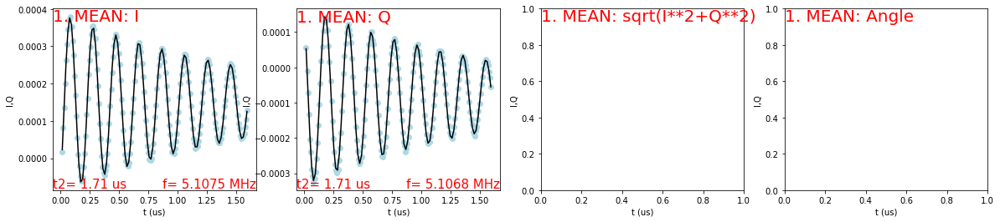

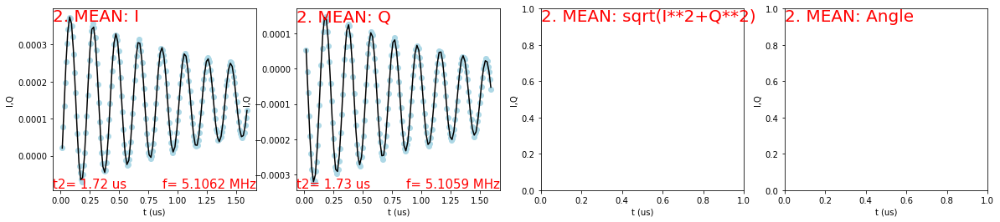

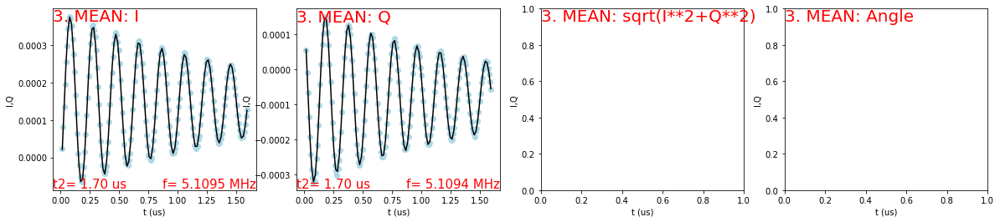

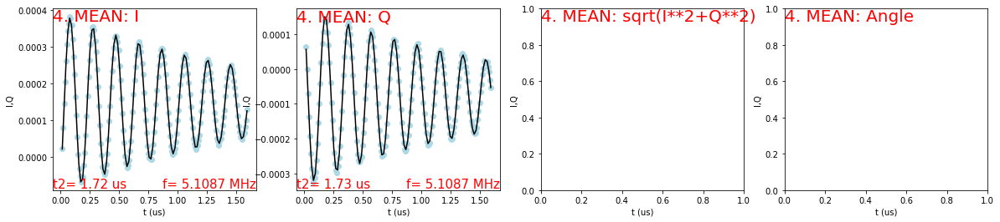

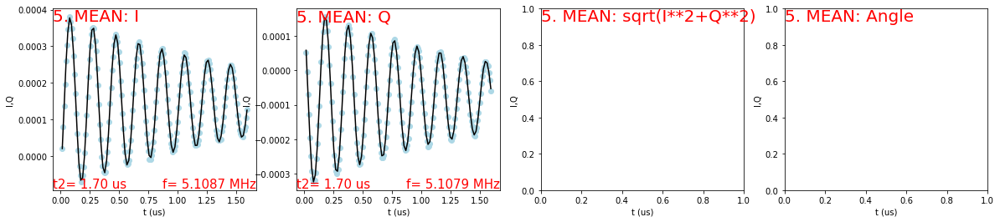

...

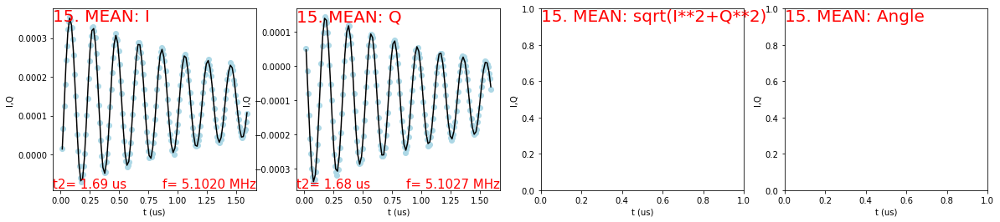

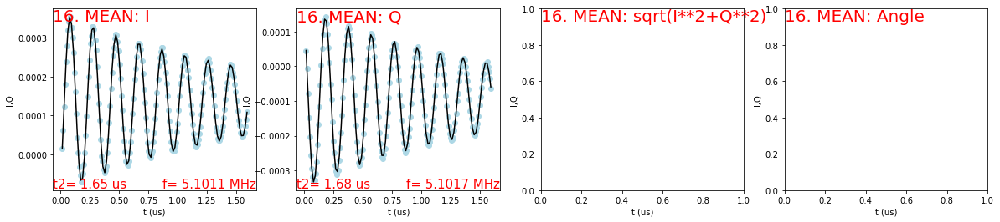

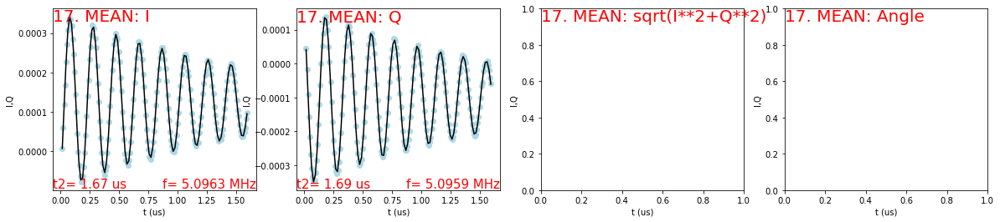

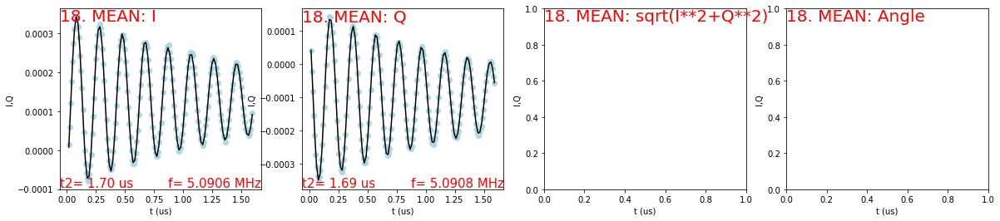

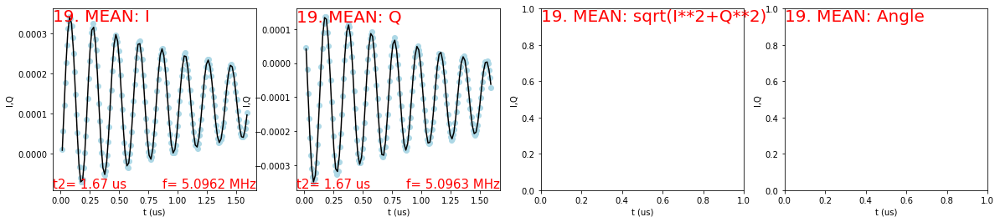

In [231]:
def damped_oscillation(t, A, tau, f, phase, off):
    return A * np.exp(- t / tau) * np.cos(2 * np.pi * f * t + phase) + off

q1_q3__no_pi = np.empty((len(LoadFiles),2,2))
t_us_vec_plot = np.linspace(np.min(t_us_vec_0), np.max(t_us_vec_0), 101, True)

Label_Colorscale = ['MEAN: I','MEAN: Q','MEAN: sqrt(I**2+Q**2)','MEAN: Angle']
for ii in range(0,len(LoadFiles)):
    fig, ax = plt.subplots(1, 4, figsize = (20, 4))
    for jj in range(0,2):
        ax[jj].plot(t_us_vec_0, list_single[jj][ii].T, color='lightblue', ls='', marker='o')
        P0 = [0.0003, 0.5, 3, 1, 0.0001]
        try:
            popt, pcov = curve_fit(damped_oscillation, t_us_vec_0, list_single[jj][ii].T, p0=P0)
            t2 = popt[1]
            f_detuning = popt[2]
            q1_q3__no_pi[ii][jj][0] = t2
            q1_q3__no_pi[ii][jj][1] = f_detuning 
            ax[jj].plot(t_us_vec_plot, damped_oscillation(t_us_vec_plot, *popt), color='black',ls='-') 
            #ax[jj].plot(t_us_vec_plot, damped_oscillation(t_us_vec_plot, *P0), color='brown',ls=':')
            ax[jj].text(s='t2= {:.2f} us'.format(q1_q3__no_pi[ii][jj][0]), x=ax[jj].get_xlim()[0], y=ax[jj].get_ylim()[0], ha='left', va='bottom', size=15, color='red')
            ax[jj].text(s='f= {:.4f} MHz'.format(q1_q3__no_pi[ii][jj][1]), x=ax[jj].get_xlim()[1], y=ax[jj].get_ylim()[0], ha='right', va='bottom', size=15, color='red')
        except:
            q1_p2__T2__vec[0] = 0
            q1_p2__T2__vec[1] = 0
            ax[jj].plot(t_us_vec_plot, damped_oscillation(t_us_vec_plot, *P0), color='brown',ls=':')



    for jj in range(0,4):
        ax[jj].text(s=str(ii+1)+'. '+str(Label_Colorscale[jj]),x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
        ax[jj].set_xlabel('t (us)')
        ax[jj].set_ylabel('I,Q')
    plt.show()

#### YES pi Pulse on q3

In [232]:
measurement_files = '\\T2_on_q1_while_q3_onres_pi\\*\\*.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)

File, t_us_vec, list_4er = [],[],[]
i1, q1, amplitude, angle = [np.empty((19,198)) for i in range(0,4)]

for ii in range(0,len(LoadFiles)):
    File.append(LoadFiles[ii])
    h5 = Data(File[ii]) 
    
    t_us_vec.append(h5.data.t_wait[:])

    i1[ii] = h5.data.i_avg[:]
    q1[ii] = h5.data.q_avg[:]
    amplitude[ii] = np.sqrt(i1[ii]**2+q1[ii]**2)
    angle[ii] = np.angle(i1[ii]+1j*q1[ii])

t_us_vec_0 = t_us_vec[0]
list_mean = [np.mean(i1, axis=0), np.mean(q1, axis=0), np.mean(amplitude, axis=0), np.mean(angle, axis=0)]
list_single = [i1, q1, amplitude, angle]

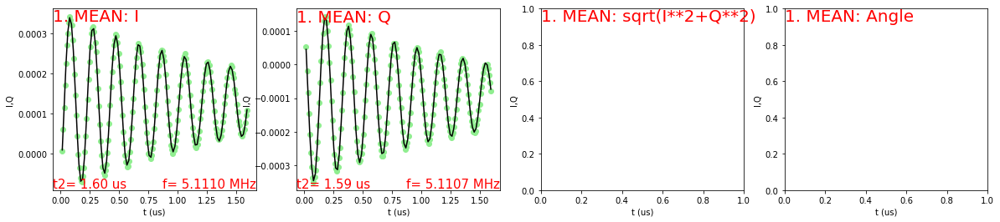

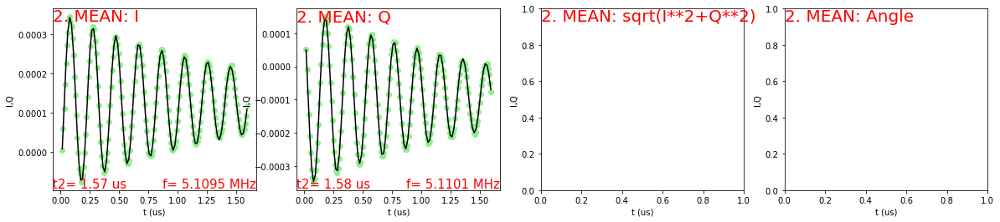

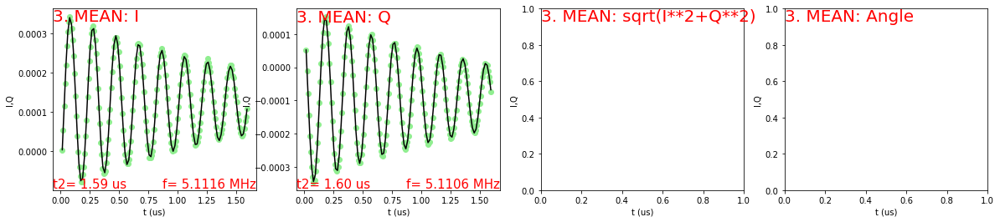

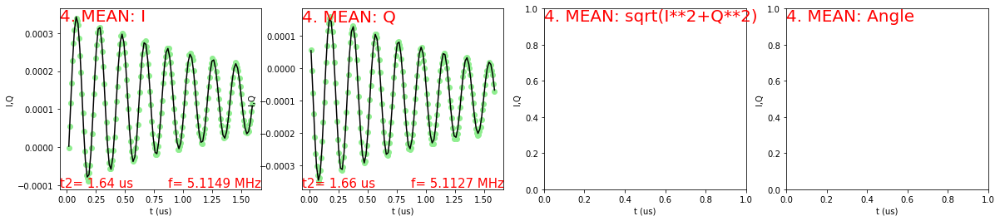

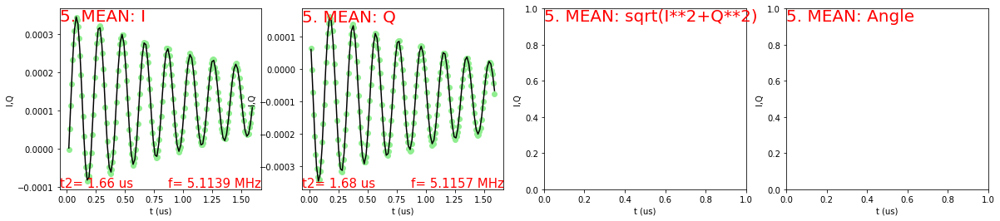

...

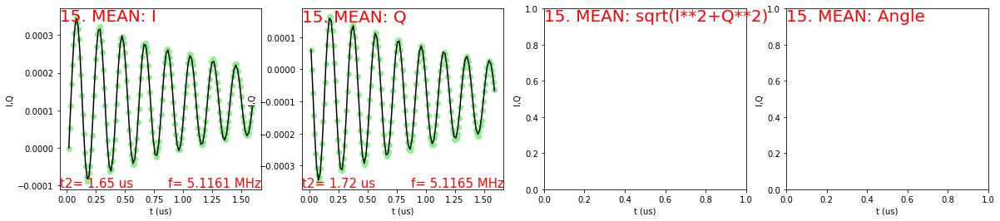

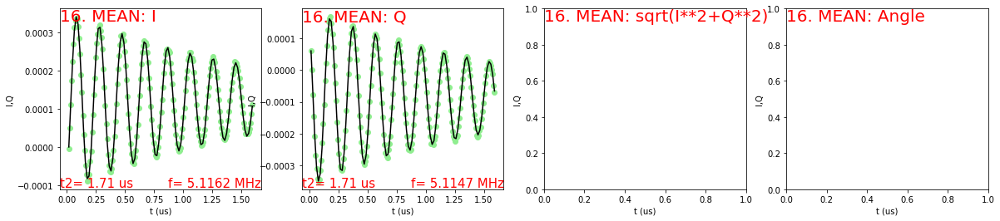

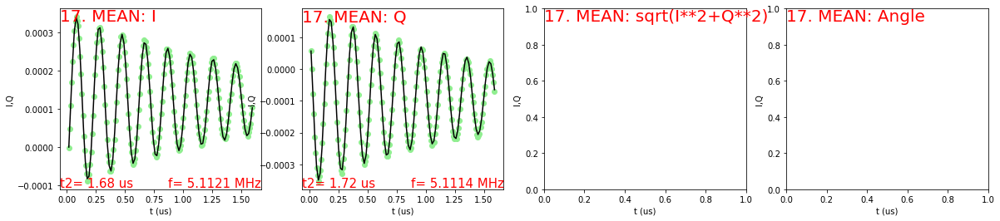

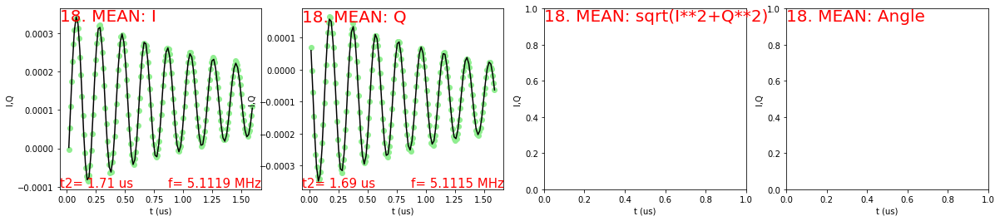

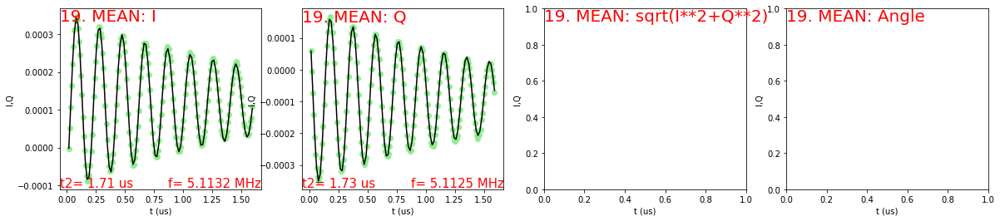

In [233]:
def damped_oscillation(t, A, tau, f, phase, off):
    return A * np.exp(- t / tau) * np.cos(2 * np.pi * f * t + phase) + off

q1_q3__yes_pi = np.empty((len(LoadFiles),2,2))
t_us_vec_plot = np.linspace(np.min(t_us_vec_0), np.max(t_us_vec_0), 101, True)

Label_Colorscale = ['MEAN: I','MEAN: Q','MEAN: sqrt(I**2+Q**2)','MEAN: Angle']
for ii in range(0,len(LoadFiles)):
    fig, ax = plt.subplots(1, 4, figsize = (20, 4))
    for jj in range(0,2):
        ax[jj].plot(t_us_vec_0, list_single[jj][ii].T, color='lightgreen', ls='', marker='o')
        P0 = [0.0003, 0.5, 3, 1, 0.0001]
        try:
            popt, pcov = curve_fit(damped_oscillation, t_us_vec_0, list_single[jj][ii].T, p0=P0)
            t2 = popt[1]
            f_detuning = popt[2]
            q1_q3__yes_pi[ii][jj][0] = t2
            q1_q3__yes_pi[ii][jj][1] = f_detuning 
            ax[jj].plot(t_us_vec_plot, damped_oscillation(t_us_vec_plot, *popt), color='black',ls='-') 
            #ax[jj].plot(t_us_vec_plot, damped_oscillation(t_us_vec_plot, *P0), color='brown',ls=':')
            ax[jj].text(s='t2= {:.2f} us'.format(q1_q3__yes_pi[ii][jj][0]), x=ax[jj].get_xlim()[0], y=ax[jj].get_ylim()[0], ha='left', va='bottom', size=15, color='red')
            ax[jj].text(s='f= {:.4f} MHz'.format(q1_q3__yes_pi[ii][jj][1]), x=ax[jj].get_xlim()[1], y=ax[jj].get_ylim()[0], ha='right', va='bottom', size=15, color='red')
        except:
            q1_p2__T2__vec[ii][jj][0] = 0
            q1_p2__T2__vec[ii][jj][0] = 0
            ax[jj].plot(t_us_vec_plot, damped_oscillation(t_us_vec_plot, *P0), color='brown',ls=':')



    for jj in range(0,4):
        ax[jj].text(s=str(ii+1)+'. '+str(Label_Colorscale[jj]),x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
        ax[jj].set_xlabel('t (us)')
        ax[jj].set_ylabel('I,Q')
    plt.show()

#### Difference pi / no_pi

mean (noPI)= 5.10693 MHz +- 6.75578 kHz
mean (yesPI)= 5.11430 MHz +- 2.44461 kHz
mean (yesPI-noPI)= 0.00738 kHz



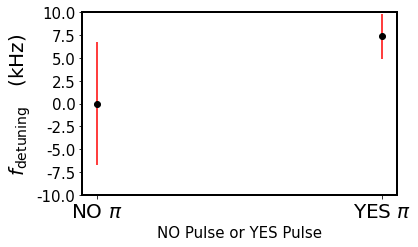

In [234]:
IQ_mean__difference__noPI = np.mean(np.append(q1_q3__no_pi[:,:,1].T,q1_q3__no_pi[:,:,1].T))
IQ_mean__difference__yesPI = np.mean(np.append(q1_q3__yes_pi[:,:,1].T,q1_q3__yes_pi[:,:,1].T))
IQ_std__difference__noPI = np.std(np.append(q1_q3__no_pi[:,:,1].T,q1_q3__no_pi[:,:,1].T))
IQ_std__difference__yesPI = np.std(np.append(q1_q3__yes_pi[:,:,1].T,q1_q3__yes_pi[:,:,1].T))

print('mean (noPI)= {:.5f} MHz +- {:.5f} kHz'.format(IQ_mean__difference__noPI, IQ_std__difference__noPI*1e3))
print('mean (yesPI)= {:.5f} MHz +- {:.5f} kHz'.format(IQ_mean__difference__yesPI, IQ_std__difference__yesPI*1e3))
print('mean (yesPI-noPI)= {:.5f} kHz'.format(IQ_mean__difference__yesPI-IQ_mean__difference__noPI, np.sqrt(IQ_std__difference__yesPI**2+IQ_std__difference__noPI**2)))

print('')

fig, ax = plt.subplots(1,1 , figsize = (150*mm, 90*mm))
    
for ax_loc in ['top','bottom','left','right']:
    ax.spines[ax_loc].set_linewidth(2)

ax.errorbar(np.array([0, 1]) , np.array([IQ_mean__difference__noPI - IQ_mean__difference__noPI, IQ_mean__difference__yesPI - IQ_mean__difference__noPI])*1e3, np.array([IQ_std__difference__noPI, IQ_std__difference__yesPI])*1e3,
           ls='',marker='o',color='black', ecolor='red')
    
ax.set_xticks([0,1])
ax.set_xticklabels(['NO $\pi$', 'YES $\pi$'],size=20)
ax.set_xlabel('NO Pulse or YES Pulse',size = 15)

ax.set_ylim([-10,10])
ax.set_yticks(np.arange(-10,11,2.5))
ax.set_yticklabels(labels=np.arange(-10,11,2.5),size=15)
ax.set_ylabel('$f_\mathrm{detuning}\ \ $ (kHz)',size=20)

plt.tight_layout()
plt.show()

#### Ramsey chevron with/without pi pulse within one measurement

In [235]:
measurement_files = 'T2_Chevron_on_qubit1_while_q3_onres_pi_nopi\\*_QM_experiment_T2_ramsey\\*.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)


File = []
i0, q0, amplitude0, angle0, i1, q1, amplitude1, angle1 = [np.empty((78,241,98)) for i in range(0,8)]
f_vec = np.empty((78,241))
t_us = np.empty((78,98))

for ii in range(0,len(LoadFiles)):
    File.append(LoadFiles[ii])
    h5 = Data(File[ii])   

    #print(File[ii])
    #print(ii+1, h5.data.__dict__)
    
    #0: No PI pulse
    i0[ii] = np.array(h5.data.i0_avg[:])
    q0[ii] = np.array(h5.data.q0_avg[:])
    amplitude0[ii] = np.sqrt(i0[ii]**2+q0[ii]**2)
    angle0[ii] = np.angle(i0[ii]+1j*q0[ii])
    
    #1: Yes PI puls
    i1[ii] = np.array(h5.data.i1_avg[:])
    q1[ii] = np.array(h5.data.q1_avg[:])
    amplitude1[ii] = np.sqrt(i1[ii]**2+q1[ii]**2)
    angle1[ii] = np.angle(i1[ii]+1j*q1[ii])
    
    
    
    f_vec[ii] = h5.data.f_vec[:]
    t_us[ii] = h5.data.t_wait[:]
    

list_ = [i0,q0,i1,q1]
i0_mean = np.mean(i0,axis=0)
q0_mean = np.mean(q0,axis=0)
i1_mean = np.mean(i1,axis=0)
q1_mean = np.mean(q1,axis=0)
list_mean = [i0_mean,q0_mean,i1_mean,q1_mean]
    
t_us_0 = t_us[0]
f_vec_0 = f_vec[0]

In [236]:
#plt.pcolor(t_us_0,f_vec_0,i0_mean)
#plt.show()
#plt.pcolor(t_us_0,f_vec_0,i1_mean)
#plt.show()

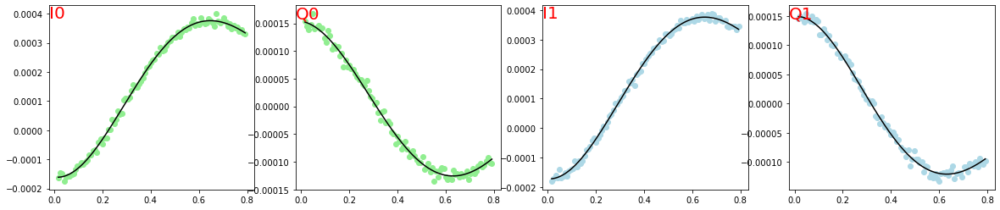

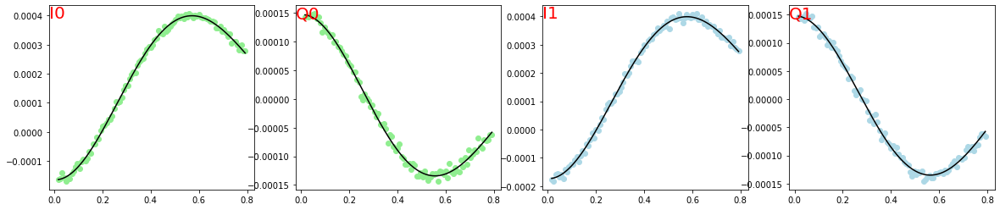

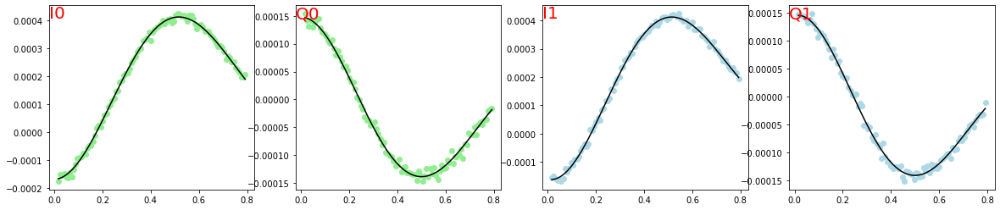

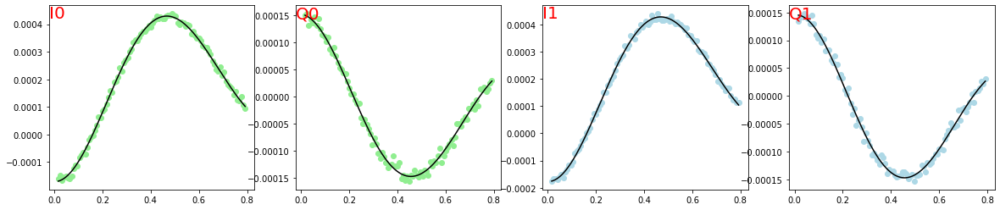

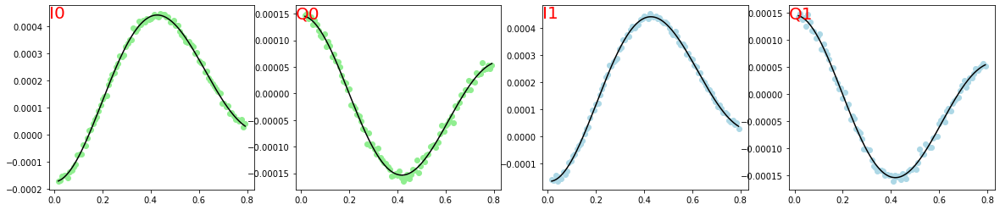

...

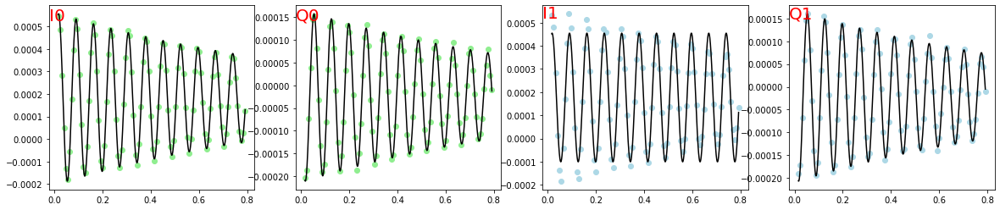

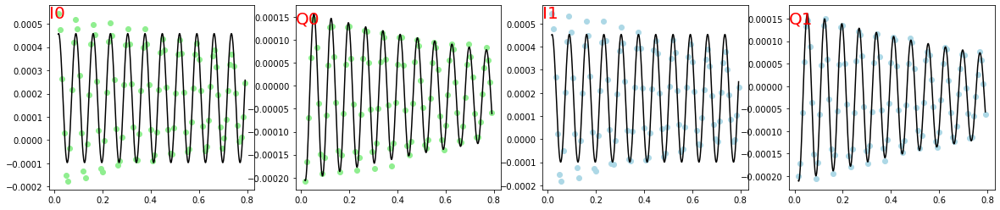

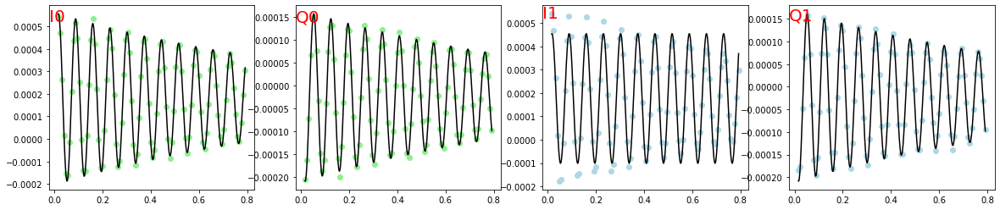

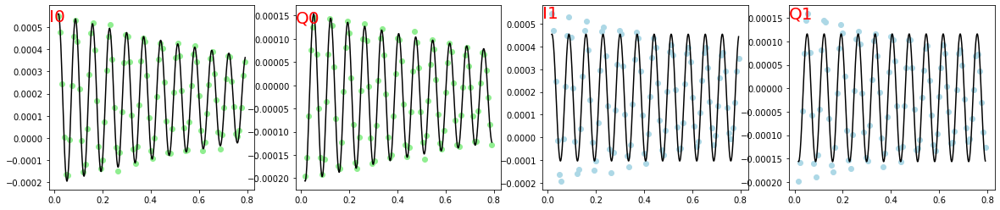

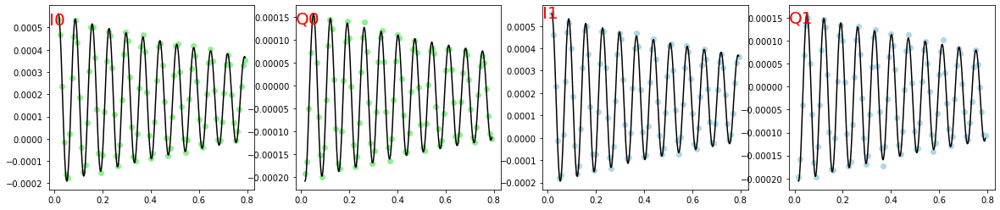

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/902471964.py:2: RuntimeWarning: overflow encountered in exp
  return A * np.exp(- t / tau) * np.cos(2 * np.pi * f * t + phase) + off


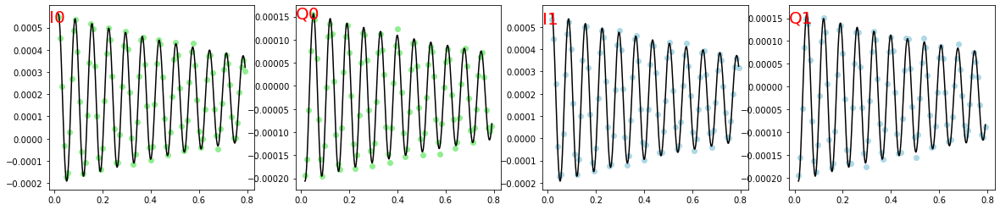

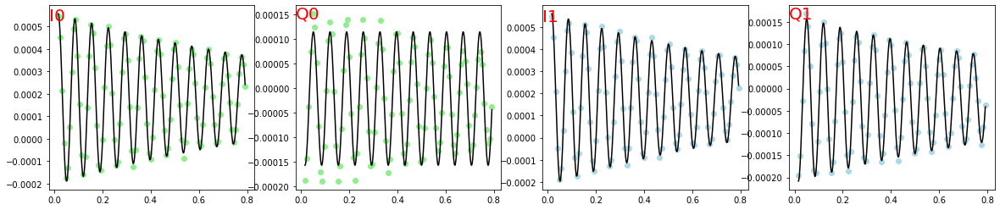

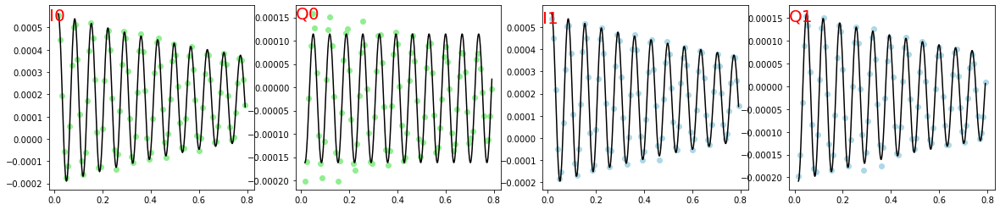

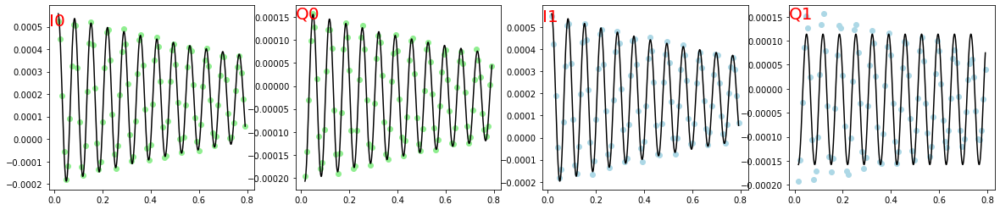

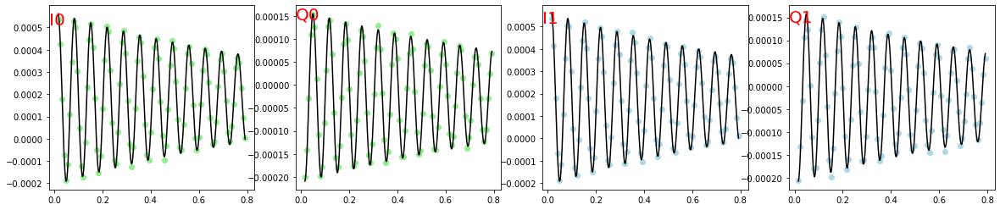

...

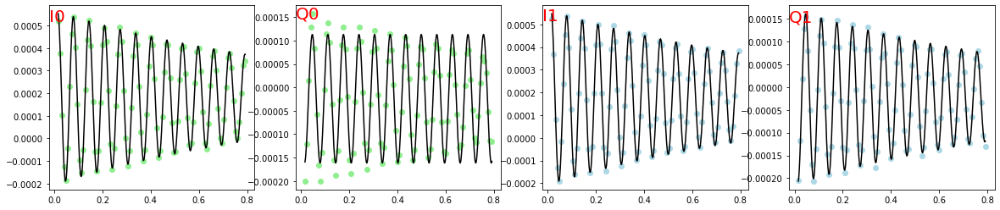

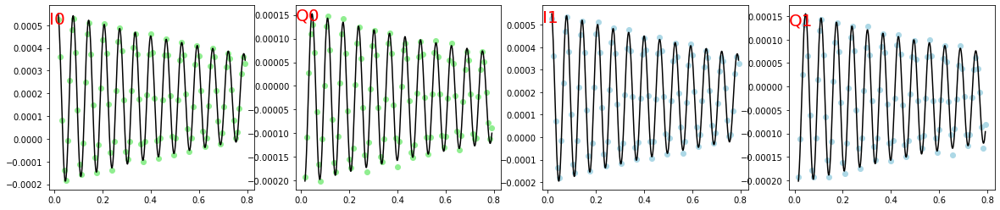

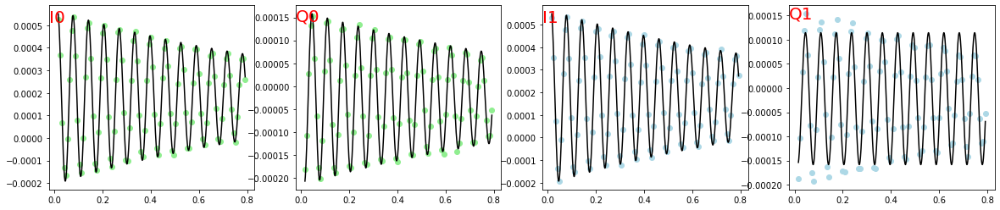

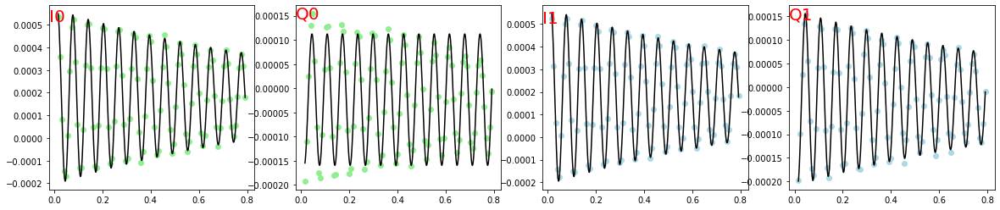

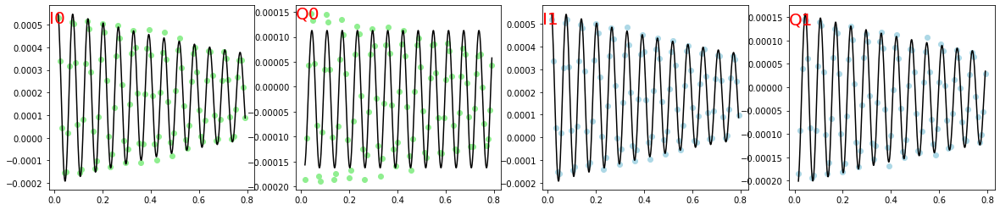

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/902471964.py:2: RuntimeWarning: overflow encountered in exp
  return A * np.exp(- t / tau) * np.cos(2 * np.pi * f * t + phase) + off


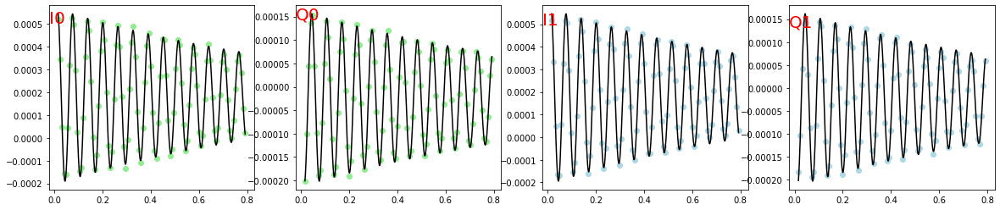

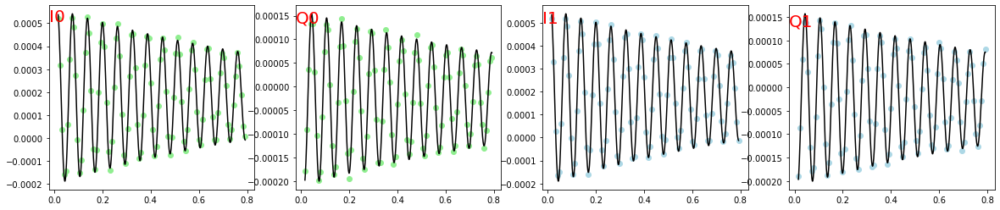

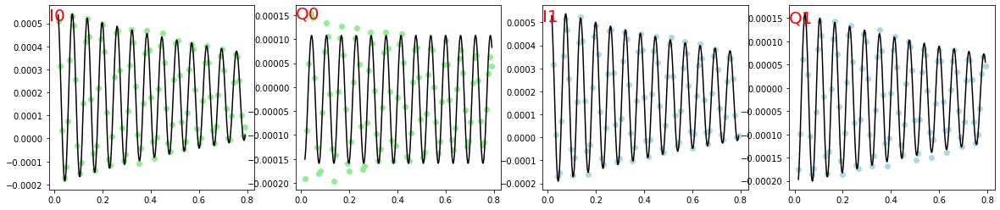

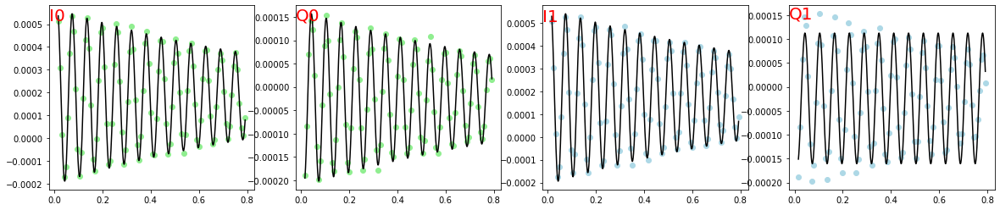

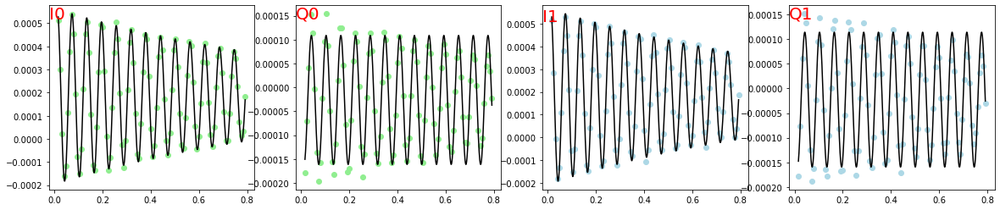

...

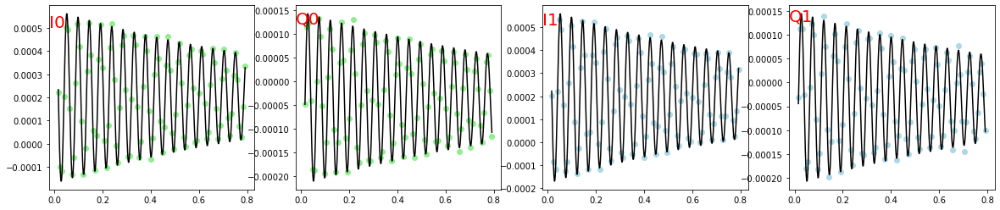

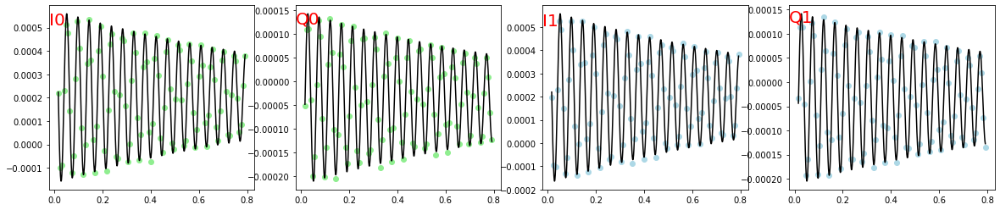

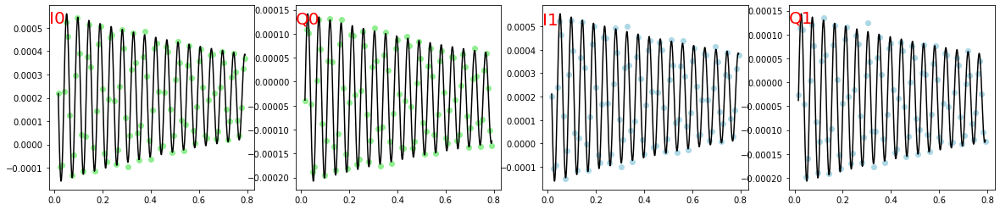

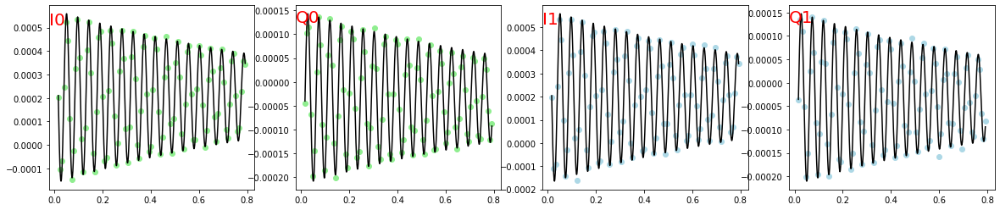

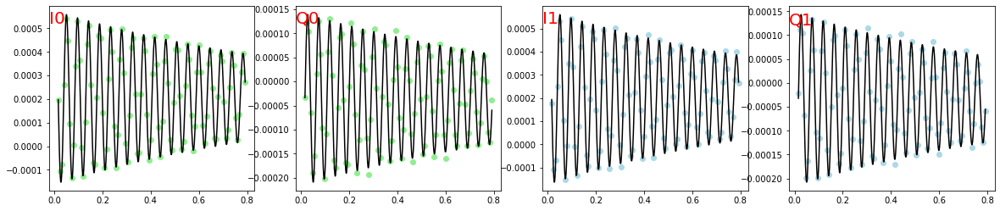

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/902471964.py:2: RuntimeWarning: overflow encountered in exp
  return A * np.exp(- t / tau) * np.cos(2 * np.pi * f * t + phase) + off


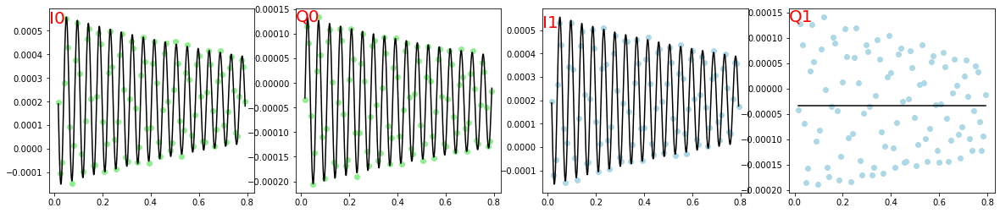

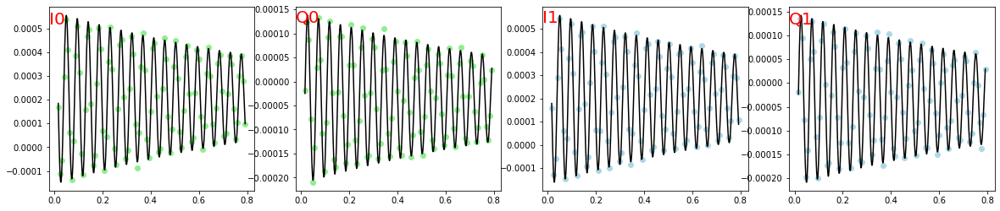

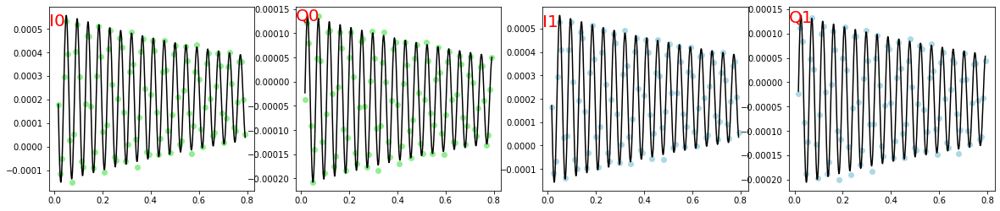

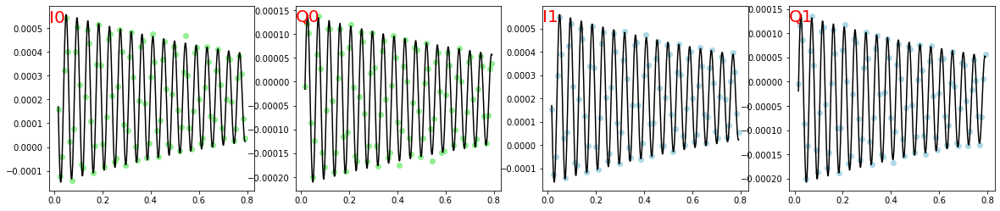

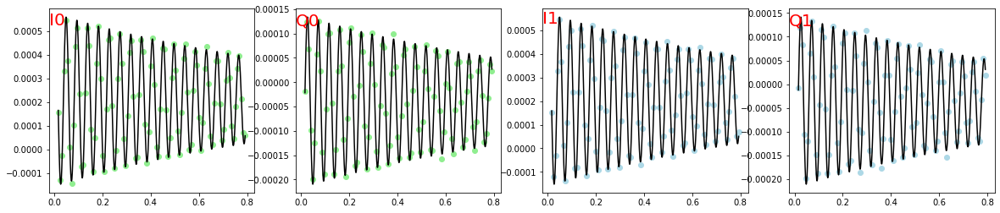

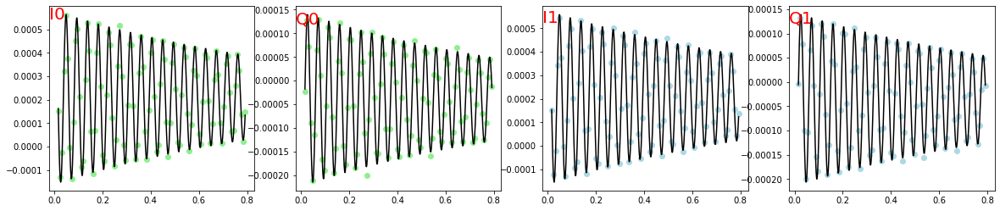

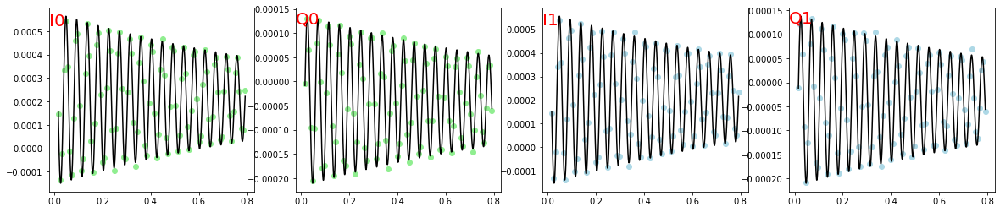

C:\Users\Simon Geisert\miniconda3\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


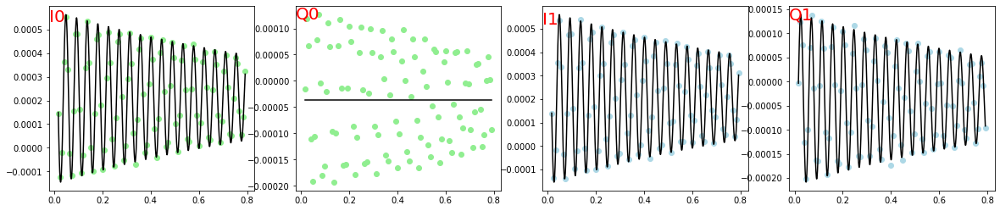

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/902471964.py:2: RuntimeWarning: overflow encountered in exp
  return A * np.exp(- t / tau) * np.cos(2 * np.pi * f * t + phase) + off
C:\Users\Simon Geisert\miniconda3\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


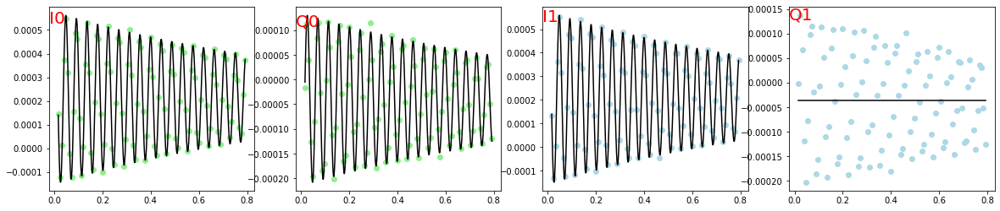

C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/902471964.py:2: RuntimeWarning: overflow encountered in exp
  return A * np.exp(- t / tau) * np.cos(2 * np.pi * f * t + phase) + off
C:\Users\Simon Geisert\miniconda3\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


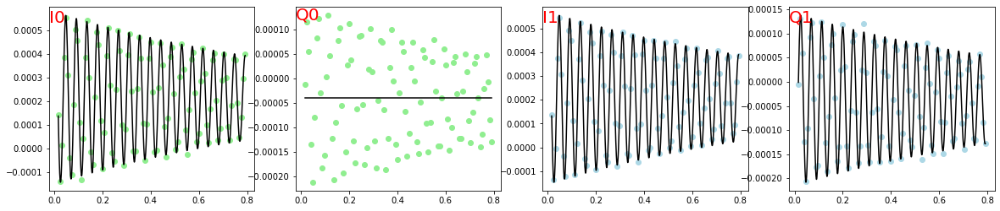

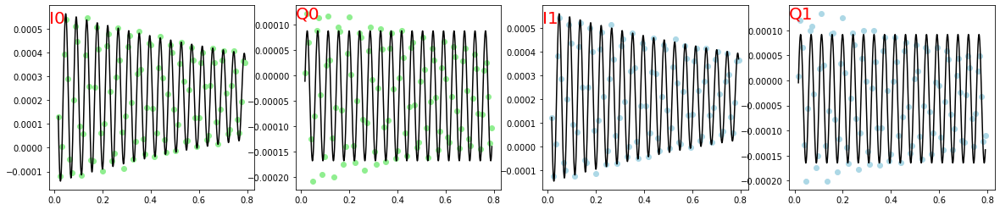

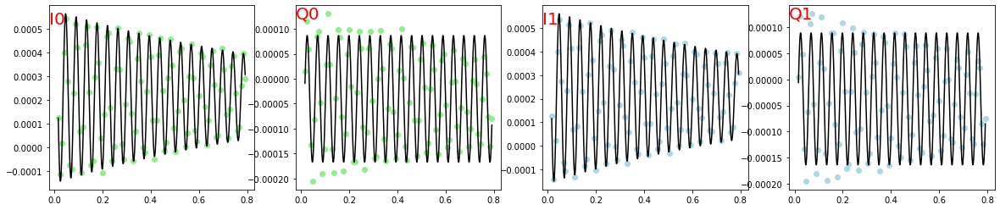

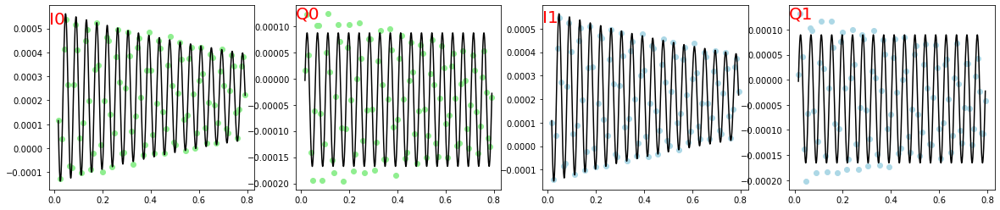

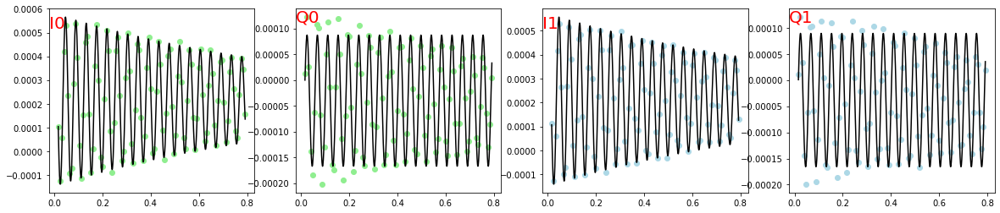

...

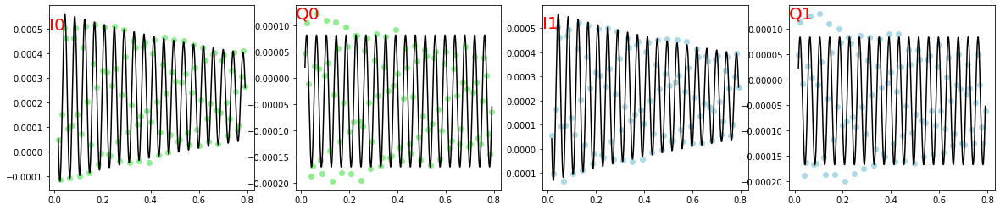

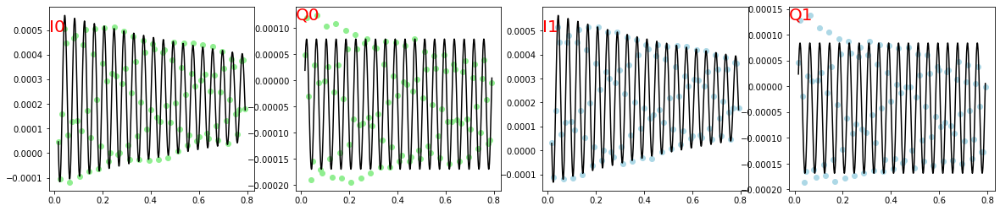

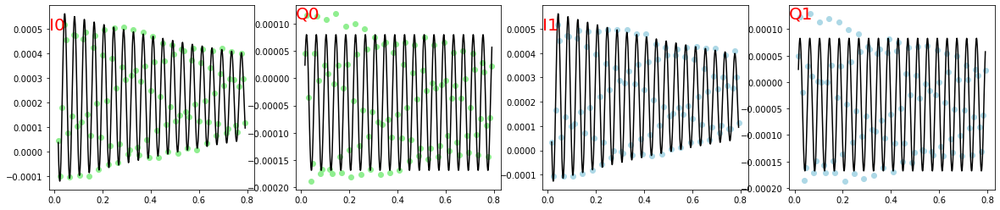

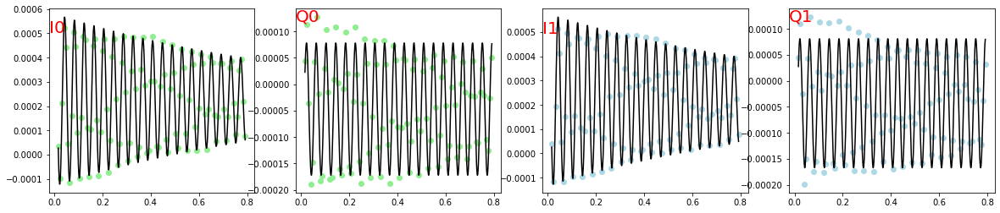

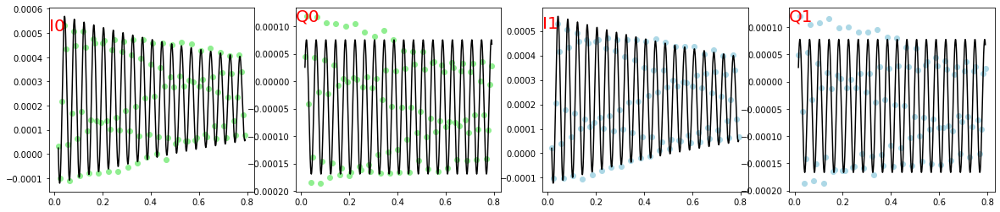

In [237]:
def damped_oscillation(t, A, tau, f, phase, off):
    return A * np.exp(- t / tau) * np.cos(2 * np.pi * f * t + phase) + off

T2_vec, f_res_vec = [np.zeros((241, 4)) for ii in range(0,2)]

Label_Colorscale = ['I0','Q0','I1','Q1']
Colors_list = ['lightgreen','lightgreen','lightblue','lightblue']
#for ii in range(0,len(LoadFiles)):

Make_Plots = True
t_us_0__plot = np.linspace(np.min(t_us_0),np.max(t_us_0),1001,True)

for jj in range(0,len(f_vec_0)):    
        
        if Make_Plots: fig, ax = plt.subplots(1, 4, figsize = (20, 4))
        for kk in range(0,4):
            if Make_Plots: ax[kk].plot(t_us_0, list_mean[kk][jj,:], color=Colors_list[kk], ls='', marker='o')
            if Make_Plots: ax[kk].text(s=Label_Colorscale[kk],x=ax[kk].get_xlim()[0],y=ax[kk].get_ylim()[1],color='red',size=20,ha='left',va='top')

            if list_mean[kk][jj,0]>0: A = np.max(list_mean[kk][jj,:])-np.min(list_mean[kk][jj,:])
            else: A = (-1)*np.max(list_mean[kk][jj,:])-np.min(list_mean[kk][jj,:])
            tau = 1.0
            f = np.abs(f_vec_0[jj]*1e-6 - 180)
            phase = 0
            Offset = np.mean(list_mean[kk][jj,:])
            P0 = [A,tau,f,phase,Offset]
            
            try:
                popt, pcov = curve_fit(damped_oscillation, t_us_0, list_mean[kk][jj,:], p0=P0, maxfev = 5_000)
                T2_vec[jj,kk] = popt[1]
                f_res_vec[jj,kk] = popt[2]
                if Make_Plots: ax[kk].plot(t_us_0__plot,damped_oscillation(t_us_0__plot,*popt),ls='-',color='black')
            except:
                print('{}. fail: {}'.format(jj,Label_Colorscale[kk]))
                if Make_Plots: ax[kk].plot(t_us_0__plot,damped_oscillation(t_us_0__plot,*P0),ls='-',color='brown')
            
        if Make_Plots: plt.show()

In [238]:
df_in_i, df_in_q = [np.zeros(241) for ii in range(0,2)]

for jj in range(0,len(f_vec_0)):    
    df_in_i[jj] = f_res_vec[jj,0]-f_res_vec[jj,2]
    df_in_q[jj] = f_res_vec[jj,1]-f_res_vec[jj,3]
        
df_in_all = np.append(df_in_i, df_in_q)

#mask = np.ones(len(df_in_all), dtype=bool)
#for ii in range(0,len(df_in_all)):
#    if np.abs(df_in_all[ii])>50*1e-3: 
#        #mask[ii]=False
#        df_in_all[ii] = 0

In [261]:
df_in_i.shape

(241,)

0.031472907029562326 35.03769466166376 1.3983822518893692 5.923700734458698


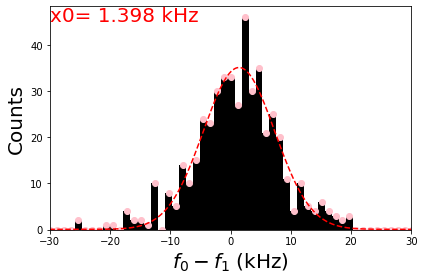

In [240]:
def gauss(x, H, A, x0, sigma): 
    return H + A * np.exp(-(x - x0) ** 2 / (2 * sigma ** 2))
gauss_fit = np.linspace(-50,50,1001,True)


TextSize=20
Number_of_bins = 1000

# Creating subplots with multiple histograms
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 4))
 
data_hist = ax.hist(df_in_all*1e3, bins=Number_of_bins, color='black', edgecolor=None)

X_data = data_hist[1]
bin_size = (np.max(X_data)-np.min(X_data))/(Number_of_bins)
X_data = X_data + bin_size/2
X_data = X_data[0:-1]
Y_data = data_hist[0]

X_data__restricted, Y_data__restricted = [],[]
for ii in range(0,len(X_data)):
    if np.abs(X_data[ii])<10000:
        X_data__restricted.append(X_data[ii])
        Y_data__restricted.append(Y_data[ii])
X_data__restricted = np.array(X_data__restricted)
Y_data__restricted = np.array(Y_data__restricted)

try:
    H=0
    A=np.max(Y_data__restricted)
    x0=1
    sigma=10
    P0 = [H,A,x0,sigma]
    popt,pcov = curve_fit(gauss,X_data__restricted,Y_data__restricted,p0=P0, maxfev = 1_000)
    ax.plot(X_data__restricted,Y_data__restricted,color='pink',ls='',marker='o')
    ax.plot(gauss_fit,gauss(gauss_fit,*popt),color='red',ls='--')
    print(*popt)
    
except:
    ax.plot(X_data,Y_data,color='purple',ls='',marker='o')
    print('fail')
    
ax.set_xlabel('$f_\mathrm{0}-f_\mathrm{1}$ (kHz)',size=TextSize)
ax.set_ylabel('Counts',size=TextSize)

ax.set_xlim([-30,30])
#ax.set_xticks(np.arange(-20,20.2,5))
#ax.set_xticklabels(np.arange(-20,20.2,5), fontsize=20)

ax.text(s='x0= {:.3f} kHz'.format(popt[2]),x=ax.get_xlim()[0], y=ax.get_ylim()[1],va='top',ha='left',size=TextSize,color='red')

# Adjusting layout for better spacing
plt.tight_layout()
# Display the figure
plt.show()

In [270]:
df_filtered = df_in_i[np.logical_and(df_in_i < 0.02, df_in_i > -0.02)]

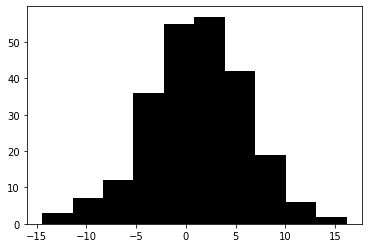

In [276]:
data_hist = plt.hist(df_filtered*1e3, bins=10, color='black', edgecolor=None)

In [264]:
np.mean(df_filtered)

0.0008983339137945018

In [265]:
np.std(df_filtered)

0.005424497746521383

## 2 Level Anitcrossing

### q1&c2: saturation TT

In [277]:
# a1= 0.01
a_0p01 = r'SA1BRQ_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.02
a_0p02 = r'SA1CMG_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.03
a_0p03 = r'SA1DH5_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.04
a_0p04 = r'SA1EBU_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.05
a_0p05 = r'SA1F6K_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.06
a_0p06 = r'SA1G19_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.07
a_0p07 = r'SA1GVY_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.08
a_0p08 = r'SA1HQN_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.09
a_0p09 = r'SA1ILC_QM_experiment_qubit_spectroscopy_sim_calib.h5'

measurement_files = [a_0p01,a_0p02,a_0p03,a_0p04,a_0p05,a_0p06,a_0p07,a_0p08,a_0p09]

LoadFiles, I1__list, Q1__list = [], [], []
for ii in range(0,len(measurement_files)):
    url = data_dir + cooldown_dir + measurement_dir + measurement_files[ii]
    LoadFiles.append(glob2.glob(url)[0])
    
    
    h5 = Data(LoadFiles[ii])
    
    I1__list.append(h5.data.i1_avg[:])
    Q1__list.append(h5.data.q1_avg[:])

fq3_set_vec = fq2_set_vec = np.linspace(3.62,3.70,81, True)
fq1_sweep_vec = fq_q1_fit*1e9 - 180e6 + np.linspace(174*1e6, 190*1e6, 61, True)

In [279]:
window_length = 9
polyorder = 2

for ii in range(0,len(measurement_files)):
    if ii==0:
        I1__norm_list = I1__list[ii] / np.max(I1__list[ii])
        Q1__norm_list = Q1__list[ii] / np.max(Q1__list[ii])
        Amplitude1__norm_list = np.sqrt(I1__list[ii]**2+Q1__list[ii]**2) / np.max(np.sqrt(I1__list[ii]**2+Q1__list[ii]**2))
        Angle1__norm_list = np.angle(I1__list[ii]+1j*Q1__list[ii]) / np.max(np.angle(I1__list[ii]+1j*Q1__list[ii]))
    else:
        I1__norm_list = I1__norm_list + I1__list[ii]/np.max(I1__list[ii])
        Q1__norm_list = Q1__norm_list + Q1__list[ii]/np.max(Q1__list[ii])
        Amplitude1__norm_list = Amplitude1__norm_list  + np.sqrt(I1__list[ii]**2+Q1__list[ii]**2) / np.max(np.sqrt(I1__list[ii]**2+Q1__list[ii]**2))
        Angle1__norm_list = Angle1__norm_list + np.angle(I1__list[ii]+1j*Q1__list[ii]) / np.max(np.angle(I1__list[ii]+1j*Q1__list[ii]))
   
I1__avg_norm_list = I1__norm_list/len(I1__norm_list)
Q1__avg_norm_list = Q1__norm_list/len(Q1__norm_list)
Amplitude1__avg_norm_list = Amplitude1__norm_list/len(Amplitude1__norm_list)
Angle1__avg_norm_list = Angle1__norm_list/len(Angle1__norm_list)
avg_norm_list = [I1__avg_norm_list,Q1__avg_norm_list,Amplitude1__avg_norm_list,Angle1__avg_norm_list]

I1__savg_avg_norm_list = savgol_filter(I1__avg_norm_list, window_length, polyorder)
Q1__savg_avg_norm_list = savgol_filter(Q1__avg_norm_list, window_length, polyorder)
Amplitude1__savg_avg_norm_list = savgol_filter(Amplitude1__avg_norm_list, window_length, polyorder)
Angle1__savg_avg_norm_list = savgol_filter(Angle1__avg_norm_list, window_length, polyorder)
savg_avg_norm_list = [I1__savg_avg_norm_list,Q1__savg_avg_norm_list,Amplitude1__savg_avg_norm_list,Angle1__savg_avg_norm_list]


C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/2437796622.py:12: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )


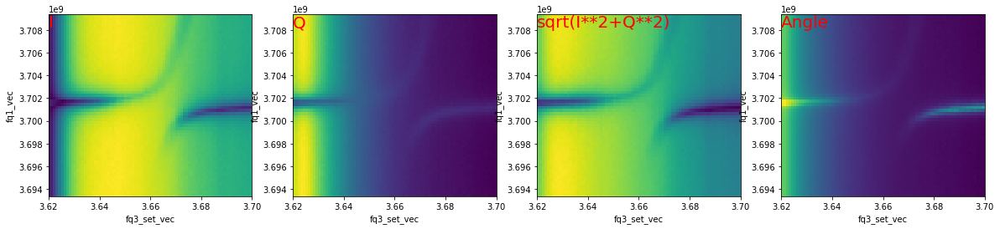

In [280]:
fig, ax = plt.subplots(1, 4, figsize = (20, 4))

b1,t1=0,15
b2,t2=15,40
b3,t3=40,-1

for jj in range(0,4):
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b1:t1], avg_norm_list[jj][:,b1:t1].T )
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b2:t2], avg_norm_list[jj][:,b2:t2].T )
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b3:t3], avg_norm_list[jj][:,b3:t3].T )
    
    ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )

Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    #ax[jj].axvline(3.71, color = 'red',ls='--')
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[i].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('fq3_set_vec')
    ax[jj].set_ylabel('fq1_vec')
plt.show()

#### Extract Points

In [281]:
Extract_Points = False
kk=0

In [282]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(fq3_set_vec, fq1_sweep_vec, np.abs(avg_norm_list[kk].T) )

    xtract.set_points()

In [283]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)
    
    
else:
          
    x0__tt_2LevAC = np.array([3.66024194,3.6625,3.66540323,3.66782258,3.67120968,3.67427419,3.67766129,3.68266129,3.68846774,3.69346774,3.6975])
    y0__tt_2LevAC = 1e-9*np.array([3.69484057e+09,3.69628690e+09,3.69773322e+09,3.69883043e+09,3.69957853e+09,3.70022689e+09,3.70052612e+09,3.70077549e+09,3.70087524e+09,3.70092511e+09,3.70092511e+09])
    
    x1__tt_2LevAC = np.array([3.62120968,3.62733871,3.63427419,3.64008065,3.64669355,3.6525,3.65927419,3.66282258,3.66604839,3.66846774,3.66975807,3.67104839,3.67185484])
    y1__tt_2LevAC = 1e-9*np.array([3.70157845e+09,3.70157845e+09,3.70152858e+09,3.70147870e+09,3.70157845e+09,3.70172807e+09,3.70232655e+09,3.70312452e+09,3.70407211e+09,3.70521920e+09,3.70636628e+09,3.70786248e+09,3.70885995e+09])

    
x__tt_2LevAC = [x0__tt_2LevAC, x1__tt_2LevAC]
y__tt_2LevAC = [y0__tt_2LevAC, y1__tt_2LevAC]


#### Plot 2Lev AC again with extracted points

C:\Users\Simon Geisert\miniconda3\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/1683941054.py:45: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )
C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/1683941054.py:45: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gourau

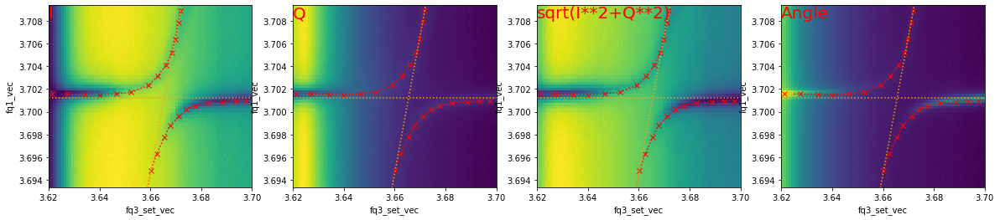

In [284]:
def lin_fit(x,m,n):
    return(x*m+n)

X__lin_fit_of_AC = np.array([x0__tt_2LevAC[0],x1__tt_2LevAC[-1]])
Y__lin_fit_of_AC = np.array([y0__tt_2LevAC[0],y1__tt_2LevAC[-1]])
popt,pcov = curve_fit(lin_fit,X__lin_fit_of_AC,Y__lin_fit_of_AC)
m_2LevAC = popt[0]
n_2LevAC = popt[1]



b1,t1=0,15
b2,t2=40,-1

f_fix = 3.70125

X__min__fitting_AC = 3.625
X__max__fitting_AC = 3.695
X__fitting_AC = np.linspace(X__min__fitting_AC,X__max__fitting_AC,101,True)
spl=[]
k_order = [5]*3
for ii in range(0,len(x__tt_2LevAC)):
    if ii==0: 
        X__lin0 = np.linspace(X__min__fitting_AC, np.min(x__tt_2LevAC[ii]), 11, True)
        Y__lin0 = lin_fit(X__lin0,*popt) 
        spl0 = interp1d(np.append(X__lin0,x__tt_2LevAC[ii]), np.append(Y__lin0,y__tt_2LevAC[ii]))
        #spl.append(UnivariateSpline(np.append(X__lin0,x__tt_3LevAC[ii]), np.append(Y__lin0,y__tt_3LevAC[ii]),k=k_order[ii]))
    elif ii==1:
        X__lin2 = np.linspace(np.max(x__tt_2LevAC[ii]), X__max__fitting_AC, 11, True)
        Y__lin2 = lin_fit(X__lin2,*popt) 
        spl2 = interp1d(np.append(x__tt_2LevAC[ii],X__lin2), np.append(y__tt_2LevAC[ii],Y__lin2))
        #spl.append(UnivariateSpline(np.append(x__tt_3LevAC[ii],X__lin2), np.append(y__tt_3LevAC[ii],Y__lin2),k=k_order[ii]))
    else:
        spl1 = interp1d(x__tt_2LevAC[ii], y__tt_2LevAC[ii])
        #spl.append(UnivariateSpline(x__tt_3LevAC[ii], y__tt_3LevAC[ii],k=k_order[ii]))
spl=[spl0,spl2]        

%matplotlib inline
fig, ax = plt.subplots(1, 4, figsize = (20, 4))

for jj in range(0,4):
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b1:t1], avg_norm_list[jj][:,b1:t1].T )
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b2:t2], avg_norm_list[jj][:,b2:t2].T )
    
    ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )
    
    for ii in range (0,len(x__tt_2LevAC)):
        ax[jj].plot(x__tt_2LevAC[ii], y__tt_2LevAC[ii], color='red',ls='',marker='x')
        ax[jj].plot(X__fitting_AC, spl[ii](X__fitting_AC), color='red',ls=':',marker='')
        
        
    ax[jj].axhline(y=f_fix,color='orange',ls=':')
    ax[jj].plot(X__fitting_AC,lin_fit(X__fitting_AC,*popt),color='orange',ls=':')

Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    #ax[jj].set_ylim([3.65,3.75])
    ax[jj].set_ylim([np.min(fq1_sweep_vec)*1e-9,np.max(fq1_sweep_vec)*1e-9])
    
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('fq3_set_vec')
    ax[jj].set_ylabel('fq1_vec')
    
plt.show()


In [285]:
with open('x__tt_q1_q2.pkl', 'wb') as f:
    pickle.dump(x__tt_2LevAC , f)
with open('y__tt_q1_q2.pkl', 'wb') as f:
    pickle.dump(y__tt_2LevAC , f)

#### Make the fit

In [287]:
def H_coupled(f0, f1, g01):
    H = np.array([
        [f0, -g01], 
        [-g01, f1], 
    ])   
    return H

def cost_function(g, f0_guess, f1_guess, f0_sim, f1_sim):
    g01 = g[0]
    
    E, v = Sweep_f0(f0_guess, f1_guess, g01)
    
    return np.sum( np.abs((f0_sim-E[:,0])) + np.abs((f1_sim-E[:,1])) )

def Sweep_f0(f0_sweep, f1, g01):
    E_sweep = []
    v_sweep = []
    for f in f0_sweep:
        H = H_coupled(f, f1, g01)
        #print(H)
        w, v = np.linalg.eig(H)
        E = np.real(w)
        E = np.array(E)
        v = np.array(v)
        perm = E.argsort()
        E = E[perm]
        v = v[perm]
        E_sweep.append(E)
        v_sweep.append(v)
    return np.array(E_sweep), np.array(v_sweep)

In [288]:
g0 = [0.002]
g_bounds = [(0,0.1)]

res = minimize(cost_function, g0, args = (lin_fit(X__fitting_AC, m_2LevAC, n_2LevAC),f_fix,
                                         spl[0](X__fitting_AC),spl[1](X__fitting_AC)),
                   method = 'Nelder-Mead', bounds = g_bounds, tol = 1e-6, options = {'maxiter': 1000})

0.06647819142569755 0.06791808298684421
0.06293709583157847 0.06515158311716274
0.06378816603188131 0.061185053207499784
0.06293709583157847 0.061185053207499784
0.061424973322985466 0.060930425324579485
0.06108668384885663 0.060930425324579485
0.060989315268940025 0.060930425324579485
0.060933605886166475 0.06092708889917331
0.060930425324579485 0.06092651567173624
0.06092708889917331 0.060925845167771
0.060926465017312914 0.060925845167771


In [289]:
X__plotting_AC = np.linspace(3.61,3.71,101,True)

print(res.x*1000)
g_vec = res.x
E, v = Sweep_f0(lin_fit(X__plotting_AC, m_2LevAC, n_2LevAC), f_fix, g_vec[0])

[2.790625]


#### Show fitted 2 Level AC

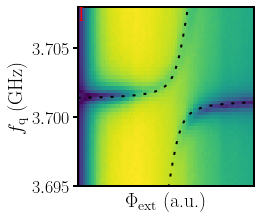

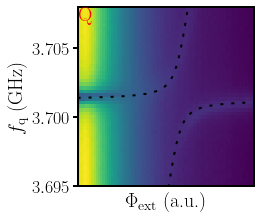

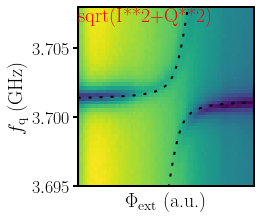

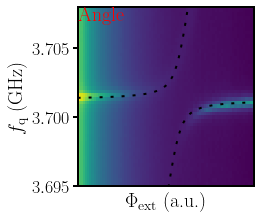

In [290]:
#%mathplotlib widgets
%matplotlib inline

TextSize_Label=20
TextSize_Ticks=18

LWidth_Frame = 2

TickLength = 5
TickLabelPad = 3

mm = 0.1/2.54
Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4): 
    
    fig, ax = plt.subplots(1,1 , figsize = (95*mm, 80*mm))
    
    for ax_loc in ['top','bottom','left','right']:
        ax.spines[ax_loc].set_linewidth(LWidth_Frame)

    ax.pcolor(fq3_set_vec, fq1_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )
    
    ax.set_xlim([3.62,3.70])
    ax.tick_params(axis='x', labelsize=0, width=0, length=0, pad=0, color='white', labelcolor='white')
    ax.set_xlabel('$\Phi_\mathrm{ext}$ (a.u.)',size=TextSize_Label, labelpad=5)
    
    ax.set_ylim([3.695,3.708])
    positions_y_major = np.arange(3.695,3.706,0.005)
    ax.yaxis.set_major_locator(ticker.FixedLocator(positions_y_major))
    #labels_y_major = ['$0.0$', '$0.5$', '$1.0$']
    #ax0.yaxis.set_major_formatter(ticker.FixedFormatter(labels_y_major))
    positions_y_minor = np.arange(3.695,3.708,0.025)
    ax.yaxis.set_minor_locator(ticker.FixedLocator(positions_y_minor))
    ax.tick_params(axis='y', which='major', labelsize=TextSize_Ticks, width=LWidth_Frame, length=TickLength, pad=TickLabelPad, color=black, labelcolor=black)
    ax.tick_params(axis='y', which='minor', labelsize=TextSize_Ticks, width=2*LWidth_Frame/3, length=2*TickLength/3, pad=TickLabelPad, color=black, labelcolor=black)
    ax.set_ylabel('$f_\mathrm{q}$ (GHz)',size=TextSize_Label)

    ax.plot(X__plotting_AC, E, dashes=[1.5, 4], lw= 2, color = 'black')
    
    ax.text(s=Label_Colorscale[jj],x=ax.get_xlim()[0],y=ax.get_ylim()[1],ha='left',va='top',color='red',size=20)

    plt.tight_layout()
    plt.show()






### c2 & q3: saturation TT

In [286]:
# a1= 0.0025
a_0p0025 = r'SA1JAC_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.005
a_0p005 = r'SA1JZ8_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.0075
a_0p0075 = r'SA1KO3_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.01
a_0p01 = r'SA1LCZ_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.0125
a_0p0125 = r'SA1M1U_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.015
a_0p015 = r'SA1MQQ_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.0175
a_0p0175 = r'SA1NFL_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.002
a_0p002 = r'SA1O4I_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.025
a_0p025 = r'SA1OTD_QM_experiment_qubit_spectroscopy_sim_calib.h5'
# a1= 0.03
a_0p03 = r'SA1PI9_QM_experiment_qubit_spectroscopy_sim_calib.h5'

measurement_files = [a_0p0025,a_0p005,a_0p0075,a_0p01,a_0p0125,a_0p015,a_0p0175,a_0p025,a_0p03]

LoadFiles, I3__list, Q3__list = [], [], []
for ii in range(0,len(measurement_files)):
    url = data_dir + cooldown_dir + measurement_dir + measurement_files[ii]
    LoadFiles.append(glob2.glob(url)[0])
    
    
    h5 = Data(LoadFiles[ii])
    
    I3__list.append(np.array(h5.data.i3_avg[:]))
    Q3__list.append(h5.data.q3_avg[:])

fq2_set_vec = np.linspace(3.67,3.76,81, True)
fq3_sweep_vec = fq_q1_fit*1e9-169e6+np.linspace(158.5*1e6, 182.5*1e6, 48+1, True)

In [288]:
window_length = 9
polyorder = 2

for ii in range(0,len(measurement_files)):
    if ii==0:
        I3__norm_list = I3__list[ii] / np.max(I3__list[ii])
        Q3__norm_list = Q3__list[ii] / np.max(Q3__list[ii])
        Amplitude3__norm_list = np.sqrt(I3__list[ii]**2+Q3__list[ii]**2) / np.max(np.sqrt(I3__list[ii]**2+Q3__list[ii]**2))
        Angle3_norm_list = np.angle(I3__list[ii]+1j*Q3__list[ii]) / np.max(np.angle(I3__list[ii]+1j*Q3__list[ii]))
    else:
        I3__norm_list = I3__norm_list + I3__list[ii]/np.max(I3__list[ii])
        Q3__norm_list = Q3__norm_list + Q3__list[ii]/np.max(Q3__list[ii])
        Amplitude3__norm_list = Amplitude3__norm_list  + np.sqrt(I3__list[ii]**2+Q3__list[ii]**2) / np.max(np.sqrt(I3__list[ii]**2+Q3__list[ii]**2))
        Angle3_norm_list = Angle3_norm_list + np.angle(I3__list[ii]+1j*Q3__list[ii]) / np.max(np.angle(I3__list[ii]+1j*Q3__list[ii]))
   
I3__avg_norm_list = I3__norm_list/len(I3__norm_list)
Q3__avg_norm_list = Q3__norm_list/len(Q3__norm_list)
Amplitude3__avg_norm_list = Amplitude3__norm_list/len(Amplitude3__norm_list)
Angle3_avg_norm_list = Angle3_norm_list/len(Angle3_norm_list)
avg_norm_list = [I3__avg_norm_list,Q3__avg_norm_list,Amplitude3__avg_norm_list,Angle3_avg_norm_list]

I3__savg_avg_norm_list = savgol_filter(I3__avg_norm_list, window_length, polyorder)
Q3__savg_avg_norm_list = savgol_filter(Q3__avg_norm_list, window_length, polyorder)
Amplitude3__savg_avg_norm_list = savgol_filter(Amplitude3__avg_norm_list, window_length, polyorder)
Angle3_savg_avg_norm_list = savgol_filter(Angle3_avg_norm_list, window_length, polyorder)
savg_avg_norm_list = [I3__savg_avg_norm_list,Q3__savg_avg_norm_list,Amplitude3__savg_avg_norm_list,Angle3_savg_avg_norm_list]


C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/3391792733.py:14: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[jj].pcolor(fq2_set_vec, fq3_sweep_vec, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )


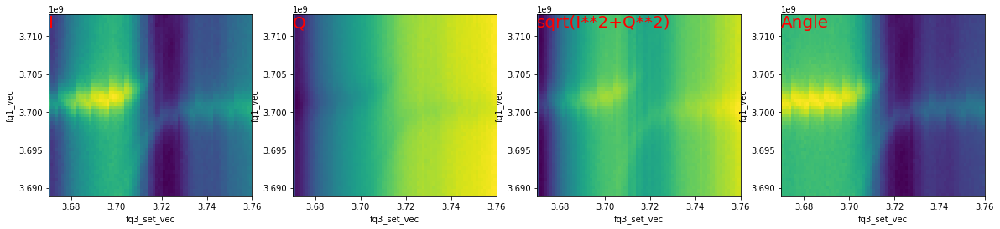

In [289]:
%matplotlib inline

fig, ax = plt.subplots(1, 4, figsize = (20, 4))

b1,t1=0,15
b2,t2=15,40
b3,t3=40,-1

for jj in range(0,4):
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b1:t1], avg_norm_list[jj][:,b1:t1].T )
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b2:t2], avg_norm_list[jj][:,b2:t2].T )
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b3:t3], avg_norm_list[jj][:,b3:t3].T )
    
    ax[jj].pcolor(fq2_set_vec, fq3_sweep_vec, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )

Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    #ax[jj].axvline(3.71, color = 'red',ls='--')
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[i].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('fq3_set_vec')
    ax[jj].set_ylabel('fq1_vec')
plt.show()

#### Extract Points

In [290]:
Extract_Points = False
kk=3

In [291]:
if Extract_Points :
    
    %matplotlib widget
    
    xtract = CurveXtractor()
    xtract.set_data(fq2_set_vec, fq3_sweep_vec, avg_norm_list[kk].T) 

    xtract.set_points()

In [292]:
%matplotlib inline

if Extract_Points:
    x = np.array(xtract._curve_x[:]).flatten()
    y = np.array(xtract._curve_y[:]).flatten()

    x_txt = str(copy.deepcopy(x))
    y_txt = str(copy.deepcopy(y))

    x_txt=x_txt.replace(' ',',')
    while ',,' in x_txt: x_txt = x_txt.replace(',,',',')
    y_txt=y_txt.replace(' ',',')
    while ',,' in y_txt: y_txt = y_txt.replace(',,',',')

    print(x_txt)
    print('--------------')
    print(y_txt)
    
    
else:
        
    x0__tt_2LevAC = np.array([3.70547379,3.71019153,3.71672379,3.72289315,3.73323589,3.74394153,3.75319557])
    y0__tt_2LevAC = 1e-9*np.array([3.69173828e+09,3.69511852e+09,3.69797295e+09,3.69940016e+09,3.70015132e+09,3.70030156e+09,3.70037667e+09])

    x1__tt_2LevAC = np.array([3.67027218,3.67861895,3.68678428,3.69404234,3.70257057,3.71001008,3.71654234,3.72071573])
    y1__tt_2LevAC = 1e-9*np.array([3.7006e+09,3.70067714e+09,3.70067714e+09,3.70097761e+09,3.70180389e+09,3.70323110e+09,3.70570995e+09,3.70901507e+09])
    
    
    
x__tt_2LevAC = [x0__tt_2LevAC, x1__tt_2LevAC]
y__tt_2LevAC = [y0__tt_2LevAC, y1__tt_2LevAC]


#### Plot 2Lev AC again with extracted points

C:\Users\Simon Geisert\miniconda3\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/3807016919.py:45: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[jj].pcolor(fq2_set_vec, fq3_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )
C:\Users\SIMONG~1\AppData\Local\Temp/ipykernel_39440/3807016919.py:45: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gourau

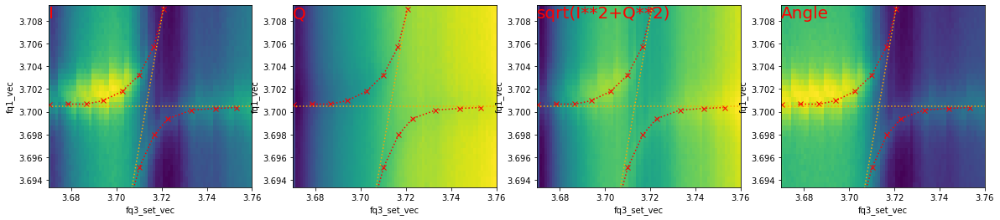

In [293]:
def lin_fit(x,m,n):
    return(x*m+n)

X__lin_fit_of_AC = np.array([x0__tt_2LevAC[0],x1__tt_2LevAC[-1]])
Y__lin_fit_of_AC = np.array([y0__tt_2LevAC[0],y1__tt_2LevAC[-1]])
popt,pcov = curve_fit(lin_fit,X__lin_fit_of_AC,Y__lin_fit_of_AC)
m_2LevAC = popt[0]
n_2LevAC = popt[1]



b1,t1=0,15
b2,t2=40,-1

f_fix = 3.7005

X__min__fitting_AC = 3.6775
X__max__fitting_AC = 3.7525
X__fitting_AC = np.linspace(X__min__fitting_AC,X__max__fitting_AC,101,True)
spl=[]
k_order = [5]*3
for ii in range(0,len(x__tt_2LevAC)):
    if ii==0: 
        X__lin0 = np.linspace(X__min__fitting_AC, np.min(x__tt_2LevAC[ii]), 11, True)
        Y__lin0 = lin_fit(X__lin0,*popt) 
        spl0 = interp1d(np.append(X__lin0,x__tt_2LevAC[ii]), np.append(Y__lin0,y__tt_2LevAC[ii]))
        #spl.append(UnivariateSpline(np.append(X__lin0,x__tt_3LevAC[ii]), np.append(Y__lin0,y__tt_3LevAC[ii]),k=k_order[ii]))
    elif ii==1:
        X__lin2 = np.linspace(np.max(x__tt_2LevAC[ii]), X__max__fitting_AC, 11, True)
        Y__lin2 = lin_fit(X__lin2,*popt) 
        spl2 = interp1d(np.append(x__tt_2LevAC[ii],X__lin2), np.append(y__tt_2LevAC[ii],Y__lin2))
        #spl.append(UnivariateSpline(np.append(x__tt_3LevAC[ii],X__lin2), np.append(y__tt_3LevAC[ii],Y__lin2),k=k_order[ii]))
    else:
        spl1 = interp1d(x__tt_2LevAC[ii], y__tt_2LevAC[ii])
        #spl.append(UnivariateSpline(x__tt_3LevAC[ii], y__tt_3LevAC[ii],k=k_order[ii]))
spl=[spl0,spl2]        

%matplotlib inline
fig, ax = plt.subplots(1, 4, figsize = (20, 4))

for jj in range(0,4):
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b1:t1], avg_norm_list[jj][:,b1:t1].T )
    #ax[jj].pcolor(fq3_set_vec, fq1_sweep_vec[b2:t2], avg_norm_list[jj][:,b2:t2].T )
    
    ax[jj].pcolor(fq2_set_vec, fq3_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )
    
    for ii in range (0,len(x__tt_2LevAC)):
        ax[jj].plot(x__tt_2LevAC[ii], y__tt_2LevAC[ii], color='red',ls='',marker='x')
        ax[jj].plot(X__fitting_AC, spl[ii](X__fitting_AC), color='red',ls=':',marker='')
        
        
    ax[jj].axhline(y=f_fix,color='orange',ls=':')
    ax[jj].plot(X__fitting_AC,lin_fit(X__fitting_AC,*popt),color='orange',ls=':')

Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4):
    #ax[jj].set_ylim([3.65,3.75])
    ax[jj].set_ylim([np.min(fq1_sweep_vec)*1e-9,np.max(fq1_sweep_vec)*1e-9])
    
    ax[jj].text(s=Label_Colorscale[jj],x=ax[jj].get_xlim()[0],y=ax[jj].get_ylim()[1],ha='left',va='top',color='red',size=20)
    ax[jj].set_xlabel('fq3_set_vec')
    ax[jj].set_ylabel('fq1_vec')
    
plt.show()


#### Make the fit

In [298]:
def H_coupled(f0, f1, g01):
    H = np.array([
        [f0, -g01], 
        [-g01, f1], 
    ])   
    return H

def cost_function(g, f0_guess, f1_guess, f0_sim, f1_sim):
    g01 = g[0]
    
    E, v = Sweep_f0(f0_guess, f1_guess, g01)
    
    return np.sum( np.abs((f0_sim-E[:,0])) + np.abs((f1_sim-E[:,1])) )

def Sweep_f0(f0_sweep, f1, g01):
    E_sweep = []
    v_sweep = []
    for f in f0_sweep:
        H = H_coupled(f, f1, g01)
        #print(H)
        w, v = np.linalg.eig(H)
        E = np.real(w)
        E = np.array(E)
        v = np.array(v)
        perm = E.argsort()
        E = E[perm]
        v = v[perm]
        E_sweep.append(E)
        v_sweep.append(v)
    return np.array(E_sweep), np.array(v_sweep)

In [299]:
g0 = [0.002]
g_bounds = [(0,0.1)]

res = minimize(cost_function, g0, args = (lin_fit(X__fitting_AC, m_2LevAC, n_2LevAC),f_fix,
                                         spl[0](X__fitting_AC),spl[1](X__fitting_AC)),
                   method = 'Nelder-Mead', bounds = g_bounds, tol = 1e-6, options = {'maxiter': 1000})

0.08944491277584721 0.09190872886887869
0.08244479701113594 0.08701773264712687
0.07745712178379138 0.07925317027876444
0.08091679016518372 0.07745712178379138
0.07856133658896125 0.07745712178379138
0.07767358930877144 0.0774400747212094
0.07745712178379138 0.07740301309615161
0.0774400747212094 0.07740043279326692
0.07740301309615161 0.07739668127797339
0.07740043279326692 0.0773961294291503
0.0773959240226545 0.0773961294291503
0.07740043279326692 0.0773959240226545
0.07739805083927953 0.0773959240226545


In [300]:
X__plotting_AC = np.linspace(3.68,3.75,101,True)

print(res.x*1000)
g_vec = res.x
E, v = Sweep_f0(lin_fit(X__plotting_AC, m_2LevAC, n_2LevAC), f_fix, g_vec[0])

[3.028125]


#### Show fitted 3 Level AC

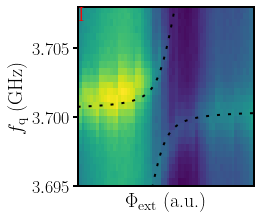

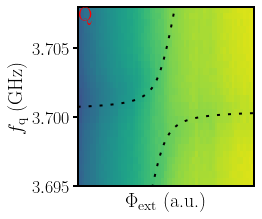

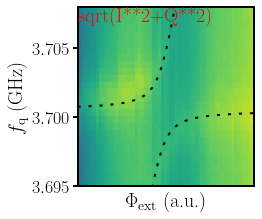

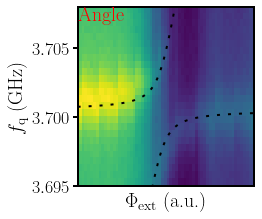

In [302]:
#%mathplotlib widgets
%matplotlib inline

TextSize_Label=20
TextSize_Ticks=18

LWidth_Frame = 2

TickLength = 5
TickLabelPad = 3

mm = 0.1/2.54
Label_Colorscale = ['I','Q','sqrt(I**2+Q**2)','Angle']
for jj in range(0,4): 
    
    fig, ax = plt.subplots(1,1 , figsize = (95*mm, 80*mm))
    
    for ax_loc in ['top','bottom','left','right']:
        ax.spines[ax_loc].set_linewidth(LWidth_Frame)

    ax.pcolor(fq2_set_vec, fq3_sweep_vec*1e-9, np.abs(avg_norm_list[jj].T))#,vmin=0.05,vmax=0.17 )
    
    ax.set_xlim([3.68,3.75])
    ax.tick_params(axis='x', labelsize=0, width=0, length=0, pad=0, color='white', labelcolor='white')
    ax.set_xlabel('$\Phi_\mathrm{ext}$ (a.u.)',size=TextSize_Label, labelpad=5)
    
    ax.set_ylim([3.695,3.708])
    positions_y_major = np.arange(3.695,3.706,0.005)
    ax.yaxis.set_major_locator(ticker.FixedLocator(positions_y_major))
    #labels_y_major = ['$0.0$', '$0.5$', '$1.0$']
    #ax0.yaxis.set_major_formatter(ticker.FixedFormatter(labels_y_major))
    positions_y_minor = np.arange(3.695,3.708,0.025)
    ax.yaxis.set_minor_locator(ticker.FixedLocator(positions_y_minor))
    ax.tick_params(axis='y', which='major', labelsize=TextSize_Ticks, width=LWidth_Frame, length=TickLength, pad=TickLabelPad, color=black, labelcolor=black)
    ax.tick_params(axis='y', which='minor', labelsize=TextSize_Ticks, width=2*LWidth_Frame/3, length=2*TickLength/3, pad=TickLabelPad, color=black, labelcolor=black)
    ax.set_ylabel('$f_\mathrm{q}$ (GHz)',size=TextSize_Label)

    ax.plot(X__plotting_AC, E, dashes=[1.5, 4], lw= 2, color = 'black')
    
    ax.text(s=Label_Colorscale[jj],x=ax.get_xlim()[0],y=ax.get_ylim()[1],ha='left',va='top',color='red',size=20)

    plt.tight_layout()
    plt.show()






# Coupling DC Swaps

## Gauge average position of states in IQ plane

### q1: sat pulse

Pos 1 =  [0.905207   0.20511412]
Pos 2 =  [-0.84762489  0.03950377]
ground state probability = 0.704
excited state probability = 0.296


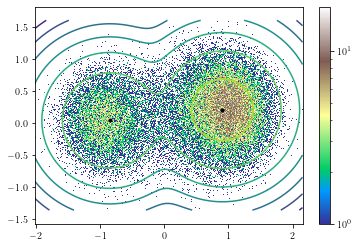

In [303]:
iqcloud_q1satP = qkit.analysis.iq_cloud_analysis.IQCloudAnalysis()
iqcloud_q1satP.set_up_gaussian_mixture_model(n_states=2)


measurement_files = 'SAC3D0_QM_experiment_iq_clouds.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
h5 = Data(LoadFiles[0]) 

fig = plt.figure()
ax = fig.add_subplot(111)
iqcloud_q1satP.set_axes(ax) 
iqcloud_q1satP.analyse_qubit_clouds(h5.data.i[:], h5.data.q[:], fq = -1, pos_init = [[-1, -0.5], [1, -0.5]] )

ref_pos_q1satP = iqcloud_q1satP.positions[0]
ref_covar_q1satP = iqcloud_q1satP.covariances[0]
print("Pos 1 = ", ref_pos_q1satP[0, :])
print("Pos 2 = ", ref_pos_q1satP[1, :])

g_prob_q1satP = np.max(iqcloud_q1satP.weights)
e_prob_q1satP = np.min(iqcloud_q1satP.weights)
print("ground state probability = {:.3f}".format(g_prob_q1satP))
print("excited state probability = {:.3f}".format(e_prob_q1satP))

dist_q1satP = iqcloud_q1satP.dist_avg

#print(iqcloud_q1satP.temp)
iqcloud_q1satP.ax.clear()
H = iqcloud_q1satP.plot_clouds()
fig.colorbar(H, ax = ax)
plt.show()

### q3: sat pulse

Pos 1 =  [0.91548608 0.09321801]
Pos 2 =  [-0.63363981  0.12305558]
ground state probability = 0.697
excited state probability = 0.303


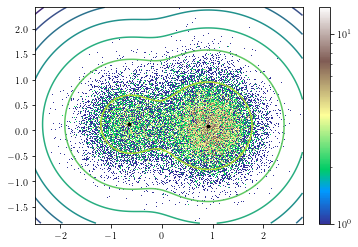

In [304]:
iqcloud_q3satP = qkit.analysis.iq_cloud_analysis.IQCloudAnalysis()
iqcloud_q3satP.set_up_gaussian_mixture_model(n_states=2)


measurement_files = 'SAC35P_QM_experiment_iq_clouds.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
h5 = Data(LoadFiles[0])  

fig = plt.figure()
ax = fig.add_subplot(111)
iqcloud_q3satP.set_axes(ax) 
iqcloud_q3satP.analyse_qubit_clouds(h5.data.i[:], h5.data.q[:], fq = -1, pos_init = [[-1, -0.5], [1, -0.5]] )

ref_pos_q3satP = iqcloud_q3satP.positions[0]
ref_covar_q3satP = iqcloud_q3satP.covariances[0]
print("Pos 1 = ", ref_pos_q3satP[0, :])
print("Pos 2 = ", ref_pos_q3satP[1, :])

g_prob_q3satP = np.max(iqcloud_q3satP.weights)
e_prob_q3satP = np.min(iqcloud_q3satP.weights)
print("ground state probability = {:.3f}".format(g_prob_q3satP))
print("excited state probability = {:.3f}".format(e_prob_q3satP))

dist_q3satP = iqcloud_q3satP.dist_avg

#print(iqcloud_q3satP.temp)
iqcloud_q3satP.ax.clear()
H = iqcloud_q3satP.plot_clouds()
fig.colorbar(H, ax = ax)
plt.show()

## Gauge Rabi with individual IQ blobs for each measurment

### q1

ii= 0


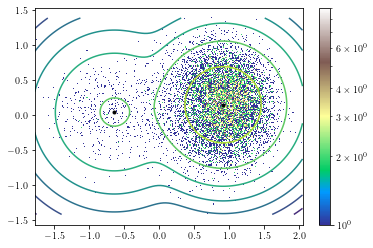

q1: ground state probability = 94.702 %
q1: excited state probability = 5.298 %

-------------------
ii= 99


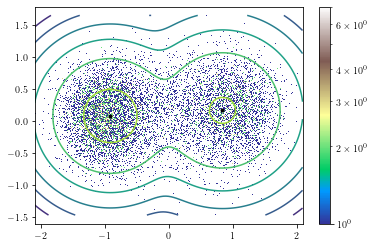

q1: ground state probability = 41.564 %
q1: excited state probability = 58.436 %

-------------------


In [305]:
def pop_1(I):
    return (I - q1__state_ref_ground) / q1__state_ref_dist


iqcloud_rabi_q1 = qkit.analysis.iq_cloud_analysis.IQCloudAnalysis()
iqcloud_rabi_q1.set_up_gaussian_mixture_model(n_states=2)


measurement_files = 'SAC3PU_QM_experiment_power_rabi.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)


h5 = Data(LoadFiles[0]) 
a_vec = h5.data.amp[:]
I_q1 = h5.data.i[:]
Q_q1 = h5.data.q[:]
I_avg_q1 = h5.data.i_avg[:]
Q_avg_q1 = h5.data.q_avg[:]
I_avg_norm_q1 = I_avg/dist_q1satP
Q_avg_norm_q1 = Q_avg/dist_q1satP


g_prob_q1,e_prob_q1 = [np.empty(len(I_avg_q1)) for ii in range(0,2)]


for ii in range(0,len(I_avg_q1)):
    
    iqcloud_rabi_q1.set_axes(ax) 
    iqcloud_rabi_q1.analyse_qubit_clouds(I_q1[ii,:], Q_q1[ii,:], fq = -1, pos_init = [[-1, 0], [1, 0]] )
    
    ref_pos_rabi_q1 = iqcloud_rabi_q1.positions[0]
    
    g_more_pop = np.sum([np.abs(ref_pos_rabi_q1[0,:]-ref_pos_q1satP[0,:]), np.abs(ref_pos_rabi_q1[1,:]-ref_pos_q1satP[1,:])])  
    e_more_pop = np.sum([np.abs(ref_pos_rabi_q1[1,:]-ref_pos_q1satP[0,:]), np.abs(ref_pos_rabi_q1[0,:]-ref_pos_q1satP[1,:])])  
    
    #print(iqcloud_rabi_q1.weights)
    
    if g_more_pop < e_more_pop:
        g_prob_q1[ii] = np.max(iqcloud_rabi_q1.weights)
        e_prob_q1[ii] = np.min(iqcloud_rabi_q1.weights)
        
    else:
        g_prob_q1[ii] = np.min(iqcloud_rabi_q1.weights)
        e_prob_q1[ii] = np.max(iqcloud_rabi_q1.weights)
        
        
    if ii==0 or ii==len(I_avg_q1)-1:
        print('ii= {}'.format(ii))
        fig = plt.figure()
        ax = fig.add_subplot(111)
        iqcloud_rabi_q1.set_axes(ax) 
        iqcloud_rabi_q1.ax.clear()
        H = iqcloud_rabi_q1.plot_clouds()
        fig.colorbar(H, ax = ax)
        plt.show()
        print("q1: ground state probability = {:.3f} %".format(g_prob_q1[ii]*100))
        print("q1: excited state probability = {:.3f} %".format(e_prob_q1[ii]*100))
        print('')
        print('-------------------')
        

idx_q1_min = np.argmin(I_avg_q1)        
idx_sort_q1 = np.argsort(I_avg_q1[0:idx_q1_min])   


i_ref_dist_q1 = np.max(I_avg_q1) - np.min(I_avg_q1)
i__0_to_1_norm_q1 = (I_avg_q1[idx_sort_q1]-np.min(I_avg_q1))/i_ref_dist_q1
#print(i__0_to_1_norm_q1)

spl__g_q1 = UnivariateSpline(I_avg_q1[idx_sort_q1], g_prob_q1[idx_sort_q1])
spl__e_q1 = UnivariateSpline(I_avg_q1[idx_sort_q1], e_prob_q1[idx_sort_q1])

spl__g_q1_norm = UnivariateSpline(i__0_to_1_norm_q1, g_prob_q1[idx_sort_q1])
spl__e_q1_norm = UnivariateSpline(i__0_to_1_norm_q1, e_prob_q1[idx_sort_q1])

i__lin_q1 = np.linspace(np.min(I_avg_q1), np.max(I_avg_q1), 1001, True)
i__lin_q1_norm = np.linspace(0, 1, 1001, True)


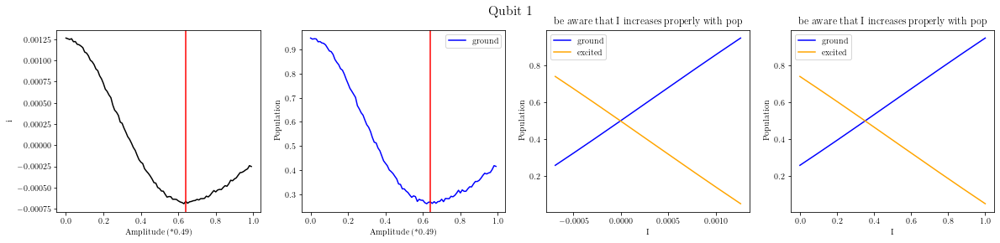

In [306]:
fig, ax = plt.subplots(1, 4, figsize = (20, 4))

fig.suptitle('Qubit 1', fontsize=16)

ax[0].plot(a_vec, I_avg_q1, color='black')
ax[0].axvline(0.64, color = 'red')
ax[0].set_xlabel('Amplitude (*0.49)')
ax[0].set_ylabel('i')

ax[1].plot(a_vec, g_prob_q1, color='blue', label='ground')
#ax[1].plot(a_vec, e_prob_q1, color='orange', label='excited')
ax[1].axvline(0.64, color = 'red')
ax[1].legend()
ax[1].set_xlabel('Amplitude (*0.49)')
ax[1].set_ylabel('Population')

ax[2].set_title('be aware that I increases properly with pop')
ax[2].plot(i__lin_q1, spl__g_q1(i__lin_q1), label='ground', color='blue')
ax[2].plot(i__lin_q1, spl__e_q1(i__lin_q1), label='excited', color='orange')
ax[2].set_xlabel('I')
ax[2].set_ylabel('Population')
ax[2].legend()

ax[3].set_title('be aware that I increases properly with pop')
ax[3].plot(i__lin_q1_norm, spl__g_q1_norm(i__lin_q1_norm), label='ground', color='blue')
ax[3].plot(i__lin_q1_norm, spl__e_q1_norm(i__lin_q1_norm), label='excited', color='orange')
ax[3].set_xlabel('I')
ax[3].set_ylabel('Population')
ax[3].legend()

plt.show()

### q3

ii= 0


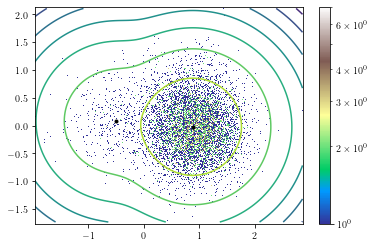

q3: ground state probability = 94.089 %
q3: excited state probability = 5.911 %

-------------------
ii= 99


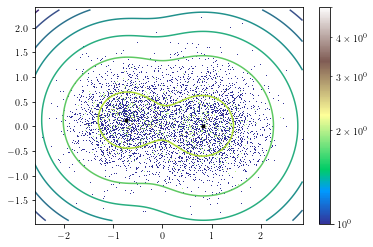

q3: ground state probability = 52.148 %
q3: excited state probability = 47.852 %

-------------------


In [307]:
def pop_3(i):
    return (i - q3__state_ref_ground) / q3__state_ref_dist


iqcloud_rabi_q3 = qkit.analysis.iq_cloud_analysis.IQCloudAnalysis()
iqcloud_rabi_q3.set_up_gaussian_mixture_model(n_states=2)


measurement_files = 'SAC3SZ_QM_experiment_power_rabi.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)


h5 = Data(LoadFiles[0]) 
a_vec = h5.data.amp[:]
I_q3 = h5.data.i[:]
Q_q3 = h5.data.q[:]
I_avg_q3 = h5.data.i_avg[:]
Q_avg_q3 = h5.data.q_avg[:]
I_avg_norm_q3 = I_avg/dist_q3satP
Q_avg_norm_q3 = Q_avg/dist_q3satP


g_prob_q3,e_prob_q3 = [np.empty(len(I_avg_q3)) for ii in range(0,2)]


for ii in range(0,len(I_avg_q3)):
    
    iqcloud_rabi_q3.set_axes(ax) 
    iqcloud_rabi_q3.analyse_qubit_clouds(I_q3[ii,:], Q_q3[ii,:], fq = -1, pos_init = [[-1, 0], [1, 0]] )
    
    ref_pos_rabi_q3 = iqcloud_rabi_q3.positions[0]
    
    g_more_pop = np.sum([np.abs(ref_pos_rabi_q3[0,:]-ref_pos_q3satP[0,:]), np.abs(ref_pos_rabi_q3[1,:]-ref_pos_q3satP[1,:])])  
    e_more_pop = np.sum([np.abs(ref_pos_rabi_q3[1,:]-ref_pos_q3satP[0,:]), np.abs(ref_pos_rabi_q3[0,:]-ref_pos_q3satP[1,:])])  
    
    #print(iqcloud_rabi_q1.weights)
    
    if g_more_pop < e_more_pop:
        g_prob_q3[ii] = np.max(iqcloud_rabi_q3.weights)
        e_prob_q3[ii] = np.min(iqcloud_rabi_q3.weights)
        
    else:
        g_prob_q3[ii] = np.min(iqcloud_rabi_q3.weights)
        e_prob_q3[ii] = np.max(iqcloud_rabi_q3.weights)
        
        
    if ii==0 or ii==len(I_avg_q3)-1:
        print('ii= {}'.format(ii))
        fig = plt.figure()
        ax = fig.add_subplot(111)
        iqcloud_rabi_q3.set_axes(ax) 
        iqcloud_rabi_q3.ax.clear()
        H = iqcloud_rabi_q3.plot_clouds()
        fig.colorbar(H, ax = ax)
        plt.show()
        print("q3: ground state probability = {:.3f} %".format(g_prob_q3[ii]*100))
        print("q3: excited state probability = {:.3f} %".format(e_prob_q3[ii]*100))
        print('')
        print('-------------------')
        
idx_q3_min = np.argmin(I_avg_q3)        
idx_sort_q3 = np.argsort(I_avg_q3[0:idx_q3_min])   


i_ref_dist_q3 = np.max(I_avg_q3) - np.min(I_avg_q3)
i__0_to_1_norm_q3 = (I_avg_q3[idx_sort_q3]-np.min(I_avg_q3))/i_ref_dist_q3
#print(i__0_to_1_norm_q1)

spl__g_q3 = UnivariateSpline(I_avg_q3[idx_sort_q3], g_prob_q3[idx_sort_q3])
spl__e_q3 = UnivariateSpline(I_avg_q3[idx_sort_q3], e_prob_q3[idx_sort_q3])

spl__g_q3_norm = UnivariateSpline(i__0_to_1_norm_q3, g_prob_q3[idx_sort_q3])
spl__e_q3_norm = UnivariateSpline(i__0_to_1_norm_q3, e_prob_q3[idx_sort_q3])

i__lin_q3 = np.linspace(np.min(I_avg_q3), np.max(I_avg_q3), 1001, True)
i__lin_q3_norm = np.linspace(0, 1, 1001, True)


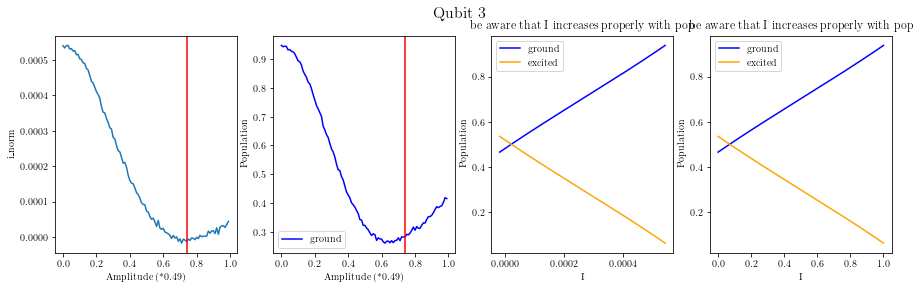

In [308]:
fig, ax = plt.subplots(1, 4, figsize = (15, 4))

fig.suptitle('Qubit 3', fontsize=16)

ax[0].plot(a_vec, I_avg_q3)
ax[0].axvline(0.74, color = 'red')
ax[0].set_xlabel('Amplitude (*0.49)')
ax[0].set_ylabel('i_norm')

#ax[1].plot(a_vec, e_prob_q3, color='orange', ls='-', label='excited')
ax[1].plot(a_vec, g_prob_q1, color='blue', ls='-', label='ground')
ax[1].axvline(0.74, color = 'red')
ax[1].set_xlabel('Amplitude (*0.49)')
ax[1].set_ylabel('Population')
ax[1].legend()

ax[2].set_title('be aware that I increases properly with pop')
ax[2].plot(i__lin_q3, spl__g_q3(i__lin_q3), label='ground', color='blue')
ax[2].plot(i__lin_q3, spl__e_q3(i__lin_q3), label='excited', color='orange')
ax[2].set_xlabel('I')
ax[2].set_ylabel('Population')
ax[2].legend()

ax[3].set_title('be aware that I increases properly with pop')
ax[3].plot(i__lin_q3_norm, spl__g_q3_norm(i__lin_q3_norm), label='ground', color='blue')
ax[3].plot(i__lin_q3_norm, spl__e_q3_norm(i__lin_q3_norm), label='excited', color='orange')
ax[3].set_xlabel('I')
ax[3].set_ylabel('Population')
ax[3].legend()



plt.show()

## From q1 to q3 [1,0]

In [309]:
measurement_files = 'Rabi_FBL_dc_1_0\\*\\*.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
File = []



i1__10, q1__10, i3__10, q3__10 = [np.empty((168,90)) for i in range(0,4)]
q1_state__10, q3_state__10 = [np.empty(168) for i in range(0,2)]

for ii in range(0,len(LoadFiles)):
    File.append(LoadFiles[ii])
    h5 = Data(File[ii])   
    
    i1__10[ii] = h5.data.i1_z_avg[:]
    q1__10[ii] = h5.data.q1_z_avg[:]
    i3__10[ii] = h5.data.i3_z_avg[:]
    q3__10[ii] = h5.data.q3_z_avg[:]

    q1_state__10[ii] = h5.data.qubit_1_state[:]
    q3_state__10[ii] = h5.data.qubit_3_state[:]

t_FBL_dc_vec__10 = np.arange(16, 688, 4)
a_vec__10 = np.arange(0.4, 0.49, 0.001)

In [310]:
print('t_FBL_dc_vec__10, shape= {}'.format(t_FBL_dc_vec__10.shape))
print('a_vec__10, shape= {}'.format(a_vec__10.shape))
print('i1__10, shape= {}'.format(i1__10.shape))

t_FBL_dc_vec__10, shape= (168,)
a_vec__10, shape= (90,)
i1__10, shape= (168, 90)


In [311]:
q1__state_ref_ground__10 = np.min(i1__10)
q1__state_ref_exc__10 = np.max(i1__10)
q1__state_ref_dist__10 = q1__state_ref_exc__10 - q1__state_ref_ground__10 

q3__state_ref_ground__10 = np.min(i3__10)
q3__state_ref_exc__10 = np.max(i3__10)
q3__state_ref_dist__10 = q3__state_ref_exc__10 - q3__state_ref_ground__10


def pop_1__10(i):
    i_norm__10 = np.abs((i - q1__state_ref_ground__10) / q1__state_ref_dist__10)
    return (spl__e_q1_norm(i_norm__10))
def pop_3__10(i):
    i_norm__10 = np.abs((i - q3__state_ref_ground__10) / q3__state_ref_dist__10)
    return (spl__e_q3_norm(i_norm__10))

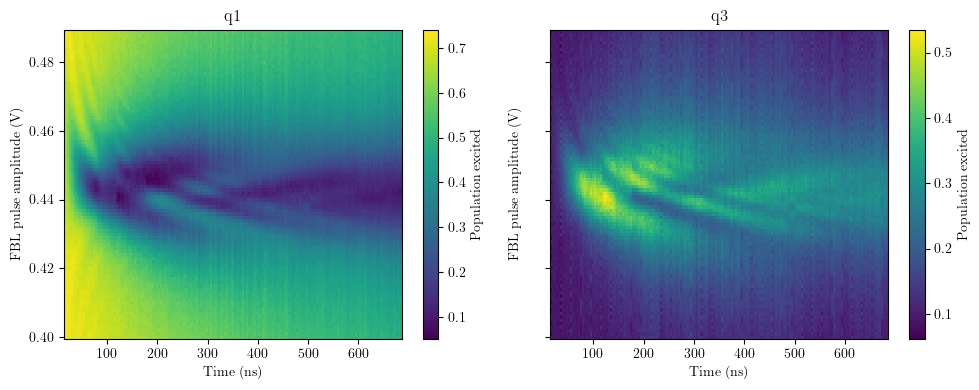

In [312]:
fig, ax = plt.subplots(1, 2, sharex = True, sharey = True, figsize = (10, 4), dpi = 100)

ax[0].set_title('q1')
c = ax[0].pcolor(t_FBL_dc_vec__10, a_vec__10, pop_1__10(i1__10).T, shading = 'auto', cmap = 'viridis')
fig.colorbar(c, ax = ax[0], label = 'Population excited')
ax[0].set_ylabel('FBL pulse amplitude (V)')
ax[0].set_xlabel('Time (ns)')

ax[1].set_title('q3')
c = ax[1].pcolor(t_FBL_dc_vec__10, a_vec__10, pop_3__10(i3__10).T, shading = 'auto', cmap = 'viridis')
fig.colorbar(c, ax = ax[1], label = 'Population excited')
ax[1].set_ylabel('FBL pulse amplitude (V)', labelpad=20)
ax[1].set_xlabel('Time (ns)')

fig.tight_layout()
plt.show()

## From q3 to q1 [0,1]

In [313]:
measurement_files = 'Rabi_FBL_dc_0_1\\*\\*.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles = glob2.glob(url)
File = []



i1__01, q1__01, i3__01, q3__01 = [np.empty((168,90)) for i in range(0,4)]
q1_state__01, q3_state__01 = [np.empty(168) for i in range(0,2)]

for ii in range(0,len(LoadFiles)):
    File.append(LoadFiles[ii])
    h5 = Data(File[ii])   
    
    i1__01[ii] = h5.data.i1_z_avg[:]
    q1__01[ii] = h5.data.q1_z_avg[:]
    i3__01[ii] = h5.data.i3_z_avg[:]
    q3__01[ii] = h5.data.q3_z_avg[:]

    q1_state__01[ii] = h5.data.qubit_1_state[:]
    q3_state__01[ii] = h5.data.qubit_3_state[:]

t_FBL_dc_vec__01 = np.arange(16, 688, 4)
a_vec__01 = np.arange(0.4, 0.49, 0.001)

In [314]:
print('t_FBL_dc_vec__01, shape= {}'.format(t_FBL_dc_vec__01.shape))
print('a_vec__01, shape= {}'.format(a_vec__01.shape))
print('i1__01, shape= {}'.format(i1__01.shape))

t_FBL_dc_vec__01, shape= (168,)
a_vec__01, shape= (90,)
i1__01, shape= (168, 90)


In [315]:
q1__state_ref_ground__01 = np.min(i1__01)
q1__state_ref_exc__01 = np.max(i1__01)
q1__state_ref_dist__01 = q1__state_ref_exc__01 - q1__state_ref_ground__01 

q3__state_ref_ground__01 = np.min(i3__01)
q3__state_ref_exc__01 = np.max(i3__01)
q3__state_ref_dist__01 = q3__state_ref_exc__01 - q3__state_ref_ground__01


def pop_1__01(i):
    i_norm__01 = np.abs((i - q1__state_ref_ground__01) / q1__state_ref_dist__01)
    return (spl__e_q1_norm(i_norm__01))
def pop_3__01(i):
    i_norm__01 = np.abs((i - q3__state_ref_ground__01) / q3__state_ref_dist__01)
    return (spl__e_q3_norm(i_norm__01))

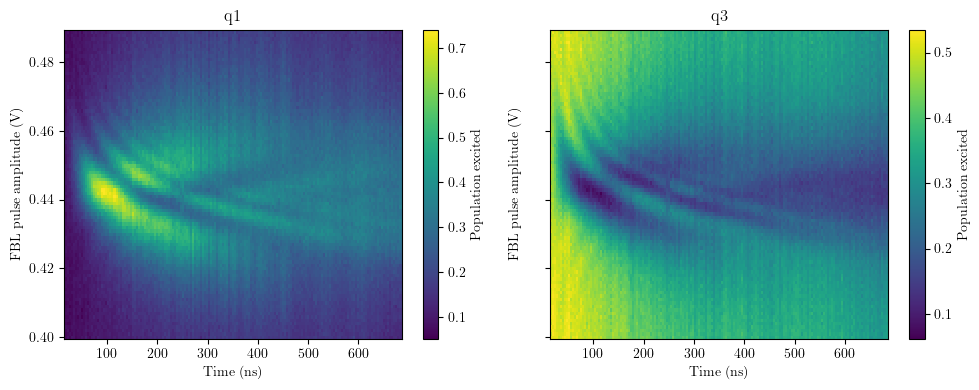

In [316]:
fig, ax = plt.subplots(1, 2, sharex = True, sharey = True, figsize = (10, 4), dpi = 100)

ax[0].set_title('q1')
c = ax[0].pcolor(t_FBL_dc_vec__01, a_vec__01, pop_1__01(i1__01).T, shading = 'auto', cmap = 'viridis')
fig.colorbar(c, ax = ax[0], label = 'Population excited')
ax[0].set_ylabel('FBL pulse amplitude (V)')
ax[0].set_xlabel('Time (ns)')

ax[1].set_title('q3')
c = ax[1].pcolor(t_FBL_dc_vec__01, a_vec__01, pop_3__01(i3__01).T, shading = 'auto', cmap = 'viridis')
fig.colorbar(c, ax = ax[1], label = 'Population excited')
ax[1].set_ylabel('FBL pulse amplitude (V)', labelpad=20)
ax[1].set_xlabel('Time (ns)')

fig.tight_layout()
plt.show()

## Swap fidelity

In [317]:
# 10
measurement_files = 'SACH5M_QM_experiment_Swap_dc_fidelity__t_FBL_dc_684_ns.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles_01 = glob2.glob(url)
h5_10 = Data(LoadFiles_01[0])

# 01
measurement_files = 'SACHFD_QM_experiment_Swap_dc_fidelity__t_FBL_dc_684_ns.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles_01 = glob2.glob(url)
h5_01 = Data(LoadFiles_01[0])

# 00
measurement_files = 'SACHWT_QM_experiment_Swap_dc_fidelity__t_FBL_dc_684_ns.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles_00 = glob2.glob(url)
h5_00 = Data(LoadFiles_00[0])

# 11
measurement_files = 'SACI9Y_QM_experiment_Swap_dc_fidelity__t_FBL_dc_684_ns.h5'
url = data_dir + cooldown_dir + measurement_dir + measurement_files
LoadFiles_11 = glob2.glob(url)
h5_11 = Data(LoadFiles_11[0])

h5_list = [h5_10, h5_01, h5_00, h5_11]

In [318]:
state_ref_ground_1 = np.min(h5_00.data.i1_z_avg[:])
state_ref_exc_1 = h5_10.data.i1_z_avg[0]
state_ref_dist_1 = state_ref_exc_1 - state_ref_ground_1 

state_ref_ground_3 = np.min(h5_00.data.i3_z_avg[:])
state_ref_exc_3 = h5_01.data.i3_z_avg[0]
state_ref_dist_3 = state_ref_exc_3 - state_ref_ground_3 

def pop_1(i):
    return (i - state_ref_ground_1) / state_ref_dist_1

def pop_3(i):
    return (i - state_ref_ground_3) / state_ref_dist_3

In [319]:
P_00_00 = ((1-pop_1(h5_00.data.i1_z_avg[1]))*(1-pop_3(h5_00.data.i3_z_avg[1])) )
P_00_01 = ((1-pop_1(h5_00.data.i1_z_avg[1]))*(pop_3(h5_00.data.i3_z_avg[1])) )
P_00_10 = ((pop_1(h5_00.data.i1_z_avg[1]))*(1-pop_3(h5_00.data.i3_z_avg[1])) )
P_00_11 = ((pop_1(h5_00.data.i1_z_avg[1]))*(pop_3(h5_00.data.i3_z_avg[1])) )

P_01_00 = ((1-pop_1(h5_01.data.i1_z_avg[1]))*(1-pop_3(h5_01.data.i3_z_avg[1])) )
P_01_01 = ((1-pop_1(h5_01.data.i1_z_avg[1]))*(pop_3(h5_01.data.i3_z_avg[1])) )
P_01_10 = ((pop_1(h5_01.data.i1_z_avg[1]))*(1-pop_3(h5_01.data.i3_z_avg[1])) )
P_01_11 = ((pop_1(h5_01.data.i1_z_avg[1]))*(pop_3(h5_01.data.i3_z_avg[1])) )

P_10_00 = ((1-pop_1(h5_10.data.i1_z_avg[1]))*(1-pop_3(h5_10.data.i3_z_avg[1])) )
P_10_01 = ((1-pop_1(h5_10.data.i1_z_avg[1]))*(pop_3(h5_10.data.i3_z_avg[1])) )
P_10_10 = ((pop_1(h5_10.data.i1_z_avg[1]))*(1-pop_3(h5_10.data.i3_z_avg[1])) )
P_10_11 = ((pop_1(h5_10.data.i1_z_avg[1]))*(pop_3(h5_10.data.i3_z_avg[1])) )

P_11_00 = ((1-pop_1(h5_11.data.i1_z_avg[1]))*(1-pop_3(h5_11.data.i3_z_avg[1])) )
P_11_01 = ((1-pop_1(h5_11.data.i1_z_avg[1]))*(pop_3(h5_11.data.i3_z_avg[1])) )
P_11_10 = ((pop_1(h5_11.data.i1_z_avg[1]))*(1-pop_3(h5_11.data.i3_z_avg[1])) )
P_11_11 = ((pop_1(h5_11.data.i1_z_avg[1]))*(pop_3(h5_11.data.i3_z_avg[1])) )

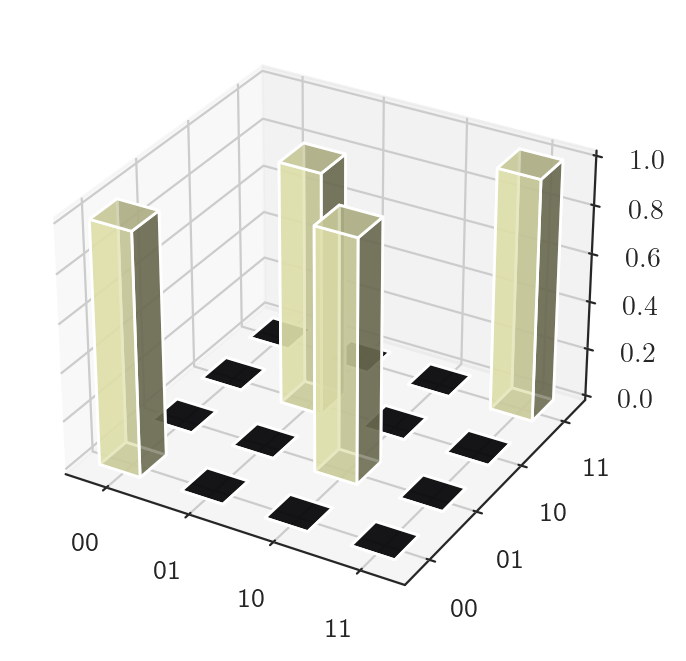

In [320]:
xedges = np.array([0., 1., 2., 3., 4.])
yedges = np.array([0., 1., 2., 3., 4.])


hist = np.array([ [1, 0, 0, 0], [0, 0, 1, 0], [0, 1, 0, 0], [0, 0, 0, 1] ])
sns.set_style('ticks')
#sns.set_theme('notebook')
fig = plt.figure(dpi = 200)
ax = fig.add_subplot(111, projection='3d')

dz = hist.flatten()
cmap = cm.get_cmap('magma') # Get desired colormap - you can change this!
max_height = np.max(dz)   # get range of colorbars so we can normalize
min_height = np.min(dz)
# scale each z to [0,1], and get their rgb values
rgba = [cmap((k-min_height)/max_height) for k in dz] 


# Construct arrays for the anchor positions of the 16 bars.
xpos, ypos = np.meshgrid(xedges[:-1] + 0.25, yedges[:-1] + 0.25, indexing="ij")
xpos = xpos.ravel()
ypos = ypos.ravel()
zpos = 0

# Construct arrays with the dimensions for the 16 bars.
dx = dy = 0.5 * np.ones_like(zpos)
dz = hist.ravel()

ax.bar3d(xpos, ypos, zpos, dx, dy, dz, color = rgba, alpha = 0.7)

ax.set_xticks([0.5, 1.5, 2.5, 3.5])
ax.set_yticks([0.5, 1.5, 2.5, 3.5])

ax.set_xticklabels(['00', '01', '10', '11'])
ax.set_yticklabels(['00', '01', '10', '11'])

plt.show()

In [321]:
hist = np.array([ [P_00_00, P_00_01, P_00_10, P_00_11],
                [P_01_00, P_01_01, P_01_10, P_01_11], 
                [P_10_00, P_10_01, P_10_10, P_10_11], 
                [P_11_00, P_11_01, P_11_10, P_11_11]])

xedges = np.array([0., 1., 2., 3., 4.])
yedges = np.array([0., 1., 2., 3., 4.])

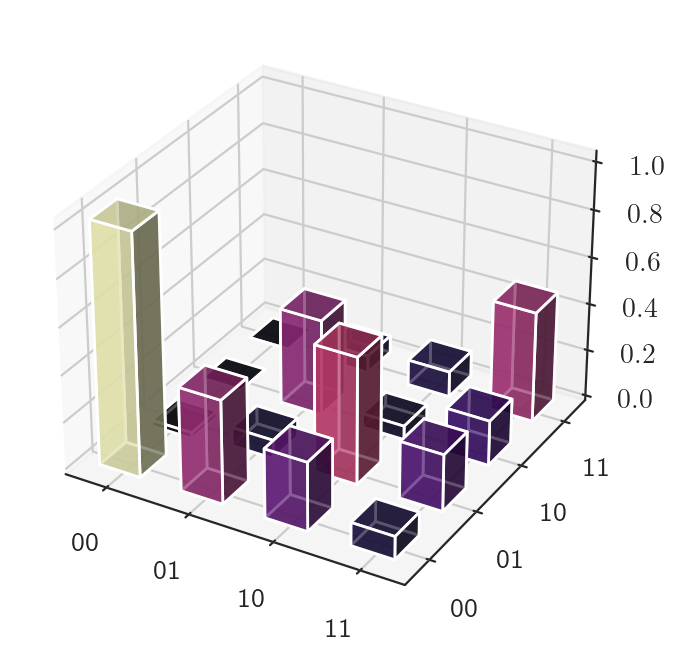

In [322]:

sns.set_style('ticks')
#sns.set_theme('notebook')
fig = plt.figure(dpi = 200)
ax = fig.add_subplot(111, projection='3d')

dz = hist.flatten()
cmap = cm.get_cmap('magma') # Get desired colormap - you can change this!
max_height = np.max(dz)   # get range of colorbars so we can normalize
min_height = np.min(dz)
# scale each z to [0,1], and get their rgb values
rgba = [cmap((k-min_height)/max_height) for k in dz] 


# Construct arrays for the anchor positions of the 16 bars.
xpos, ypos = np.meshgrid(xedges[:-1] + 0.25, yedges[:-1] + 0.25, indexing="ij")
xpos = xpos.ravel()
ypos = ypos.ravel()
zpos = 0

# Construct arrays with the dimensions for the 16 bars.
dx = dy = 0.5 * np.ones_like(zpos)
dz = hist.ravel()

ax.bar3d(xpos, ypos, zpos, dx, dy, dz, color = rgba, alpha = 0.7)

ax.set_xticks([0.5, 1.5, 2.5, 3.5])
ax.set_yticks([0.5, 1.5, 2.5, 3.5])

ax.set_xticklabels(['00', '01', '10', '11'])
ax.set_yticklabels(['00', '01', '10', '11'])

plt.show()